In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier,plot_importance,DMatrix,cv
import xgboost as xgb
from sklearn.metrics import f1_score,recall_score,confusion_matrix,accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from lightgbm import LGBMClassifier
from sklearn.utils import shuffle
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import roc_auc_score, roc_curve, auc
import warnings, gc
warnings.filterwarnings("ignore")
import plotly.express as px
import plotly.graph_objects as go
from catboost import CatBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier
import tensorflow as tf
from sklearn.cluster import KMeans 
from scipy.spatial.distance import cdist 
from sklearn.neighbors import KNeighborsClassifier

from sklearn.preprocessing import MinMaxScaler,StandardScaler,LabelEncoder

In [2]:
# train_df = pd.read_parquet('C:/Users/kojun/Desktop/ML/kaggle/American Express - Default Prediction/new_data4/train.parquet',engine='pyarrow')
# test_df = pd.read_parquet('C:/Users/kojun/Desktop/ML/kaggle/American Express - Default Prediction/new_data4/test.parquet',engine='pyarrow')

In [3]:
train_df = pd.read_parquet('train.parquet',engine='pyarrow')
test_df = pd.read_parquet('test.parquet',engine='pyarrow')

In [4]:
cat_features = ["B_30","B_38","D_114","D_116","D_117","D_120","D_126","D_63","D_64","D_66","D_68"]
cat_features_light = ["B_30_last","B_38_last","D_114_last","D_116_last","D_117_last","D_120_last","D_126_last","D_63_last","D_64_last","D_66_last","D_68_last",
                     "B_30_last_2","B_38_last_2","D_114_last_2","D_116_last_2","D_117_last_2","D_120_last_2","D_126_last_2","D_63_last_2","D_64_last_2","D_66_last_2","D_68_last_2",
                     "B_30_last_3","B_38_last_3","D_114_last_3","D_116_last_3","D_117_last_3","D_120_last_3","D_126_last_3","D_63_last_3","D_64_last_3","D_66_last_3","D_68_last_3"]
num_cols = [x for x in train_df.columns if (x not in cat_features_light) & (x not in ['customer_ID','S_2','target'])]

# check feature

In [5]:
print('train的特徵數:',len(train_df.columns))
print('test的特徵數:',len(test_df.columns))
print('train的最小值:',train_df.min().min())
print('test的最小值:',test_df.min().min())

train的特徵數: 2213
test的特徵數: 2212
train的最小值: -9103.230091108475
test的最小值: -31679.20527486957


# 第一層Stacking

## &nbsp;&nbsp;a.GBDT

## &nbsp;&nbsp;a.1 lightGBM

In [6]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':2000,'learning_rate':0.01, 'reg_lambda':50,'min_child_samples':2400,'num_leaves':95,
              'colsample_bytree':0.19,'max_bins':511, 'random_state':1} 
    
    gbm = LGBMClassifier(**params).fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)],
                                       eval_metric=['auc','binary_logloss'])
    
    #預測validation機率
    pred = gbm.predict_proba(X_val)[:,1]  
    preds.append(pred)
    
    
    
    #預測test機率
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()
    
del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_light = pd.DataFrame({'pred_light':pred_train},index=va_indexs)
test_meta_light = pd.DataFrame({'pred_light':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)

[1]	training's auc: 0.932304	training's binary_logloss: 0.566743	valid_1's auc: 0.930388	valid_1's binary_logloss: 0.566773
[2]	training's auc: 0.941234	training's binary_logloss: 0.56183	valid_1's auc: 0.93908	valid_1's binary_logloss: 0.561895
[3]	training's auc: 0.943839	training's binary_logloss: 0.556999	valid_1's auc: 0.941923	valid_1's binary_logloss: 0.557111
[4]	training's auc: 0.945408	training's binary_logloss: 0.552032	valid_1's auc: 0.943553	valid_1's binary_logloss: 0.552176
[5]	training's auc: 0.946759	training's binary_logloss: 0.5473	valid_1's auc: 0.944845	valid_1's binary_logloss: 0.54749
[6]	training's auc: 0.947396	training's binary_logloss: 0.542743	valid_1's auc: 0.945426	valid_1's binary_logloss: 0.542978
[7]	training's auc: 0.947649	training's binary_logloss: 0.538055	valid_1's auc: 0.945698	valid_1's binary_logloss: 0.538318
[8]	training's auc: 0.947738	training's binary_logl

[67]	training's auc: 0.952163	training's binary_logloss: 0.374626	valid_1's auc: 0.950154	valid_1's binary_logloss: 0.376332
[68]	training's auc: 0.952214	training's binary_logloss: 0.372998	valid_1's auc: 0.950209	valid_1's binary_logloss: 0.374718
[69]	training's auc: 0.952247	training's binary_logloss: 0.371389	valid_1's auc: 0.95023	valid_1's binary_logloss: 0.373135
[70]	training's auc: 0.952296	training's binary_logloss: 0.369839	valid_1's auc: 0.950291	valid_1's binary_logloss: 0.3716
[71]	training's auc: 0.952325	training's binary_logloss: 0.368244	valid_1's auc: 0.950302	valid_1's binary_logloss: 0.370035
[72]	training's auc: 0.952373	training's binary_logloss: 0.366688	valid_1's auc: 0.950355	valid_1's binary_logloss: 0.368499
[73]	training's auc: 0.952389	training's binary_logloss: 0.365129	valid_1's auc: 0.950364	valid_1's binary_logloss: 0.366967
[74]	training's auc: 0.952425	training's binary_logloss: 0.363623	valid_1's auc: 0.950391	valid_1's binary_logloss: 0.365487
[75

[133]	training's auc: 0.954443	training's binary_logloss: 0.299644	valid_1's auc: 0.952167	valid_1's binary_logloss: 0.302646
[134]	training's auc: 0.95447	training's binary_logloss: 0.298883	valid_1's auc: 0.952187	valid_1's binary_logloss: 0.301902
[135]	training's auc: 0.954491	training's binary_logloss: 0.298172	valid_1's auc: 0.952205	valid_1's binary_logloss: 0.301205
[136]	training's auc: 0.954517	training's binary_logloss: 0.297425	valid_1's auc: 0.952224	valid_1's binary_logloss: 0.300479
[137]	training's auc: 0.954555	training's binary_logloss: 0.296667	valid_1's auc: 0.952264	valid_1's binary_logloss: 0.299732
[138]	training's auc: 0.954573	training's binary_logloss: 0.295942	valid_1's auc: 0.952281	valid_1's binary_logloss: 0.299023
[139]	training's auc: 0.954597	training's binary_logloss: 0.29525	valid_1's auc: 0.952306	valid_1's binary_logloss: 0.298345
[140]	training's auc: 0.954617	training's binary_logloss: 0.294539	valid_1's auc: 0.952329	valid_1's binary_logloss: 0.2

[200]	training's auc: 0.956255	training's binary_logloss: 0.263508	valid_1's auc: 0.953843	valid_1's binary_logloss: 0.267551
[201]	training's auc: 0.956285	training's binary_logloss: 0.263122	valid_1's auc: 0.953862	valid_1's binary_logloss: 0.26719
[202]	training's auc: 0.95631	training's binary_logloss: 0.262732	valid_1's auc: 0.953888	valid_1's binary_logloss: 0.266812
[203]	training's auc: 0.956332	training's binary_logloss: 0.262355	valid_1's auc: 0.953908	valid_1's binary_logloss: 0.266449
[204]	training's auc: 0.956356	training's binary_logloss: 0.261993	valid_1's auc: 0.95393	valid_1's binary_logloss: 0.266099
[205]	training's auc: 0.956376	training's binary_logloss: 0.26163	valid_1's auc: 0.953944	valid_1's binary_logloss: 0.265753
[206]	training's auc: 0.95641	training's binary_logloss: 0.261268	valid_1's auc: 0.953977	valid_1's binary_logloss: 0.2654
[207]	training's auc: 0.956433	training's binary_logloss: 0.260923	valid_1's auc: 0.953995	valid_1's binary_logloss: 0.265074

[268]	training's auc: 0.957856	training's binary_logloss: 0.244321	valid_1's auc: 0.955186	valid_1's binary_logloss: 0.249416
[269]	training's auc: 0.957882	training's binary_logloss: 0.244108	valid_1's auc: 0.955207	valid_1's binary_logloss: 0.249216
[270]	training's auc: 0.957902	training's binary_logloss: 0.243894	valid_1's auc: 0.955224	valid_1's binary_logloss: 0.249017
[271]	training's auc: 0.95792	training's binary_logloss: 0.243696	valid_1's auc: 0.95524	valid_1's binary_logloss: 0.24883
[272]	training's auc: 0.957941	training's binary_logloss: 0.243492	valid_1's auc: 0.955254	valid_1's binary_logloss: 0.248645
[273]	training's auc: 0.957964	training's binary_logloss: 0.243287	valid_1's auc: 0.955274	valid_1's binary_logloss: 0.248451
[274]	training's auc: 0.957986	training's binary_logloss: 0.243083	valid_1's auc: 0.955292	valid_1's binary_logloss: 0.248261
[275]	training's auc: 0.958013	training's binary_logloss: 0.242883	valid_1's auc: 0.955314	valid_1's binary_logloss: 0.24

[334]	training's auc: 0.959191	training's binary_logloss: 0.233599	valid_1's auc: 0.956235	valid_1's binary_logloss: 0.239732
[335]	training's auc: 0.959214	training's binary_logloss: 0.233467	valid_1's auc: 0.956254	valid_1's binary_logloss: 0.239616
[336]	training's auc: 0.959234	training's binary_logloss: 0.233339	valid_1's auc: 0.956274	valid_1's binary_logloss: 0.239498
[337]	training's auc: 0.959251	training's binary_logloss: 0.233216	valid_1's auc: 0.956286	valid_1's binary_logloss: 0.239391
[338]	training's auc: 0.95927	training's binary_logloss: 0.2331	valid_1's auc: 0.9563	valid_1's binary_logloss: 0.23929
[339]	training's auc: 0.959287	training's binary_logloss: 0.232979	valid_1's auc: 0.956312	valid_1's binary_logloss: 0.239186
[340]	training's auc: 0.959306	training's binary_logloss: 0.232855	valid_1's auc: 0.95633	valid_1's binary_logloss: 0.239072
[341]	training's auc: 0.959328	training's binary_logloss: 0.23273	valid_1's auc: 0.956345	valid_1's binary_logloss: 0.238968


[400]	training's auc: 0.960397	training's binary_logloss: 0.226703	valid_1's auc: 0.957119	valid_1's binary_logloss: 0.233892
[401]	training's auc: 0.960415	training's binary_logloss: 0.226616	valid_1's auc: 0.957131	valid_1's binary_logloss: 0.233821
[402]	training's auc: 0.960434	training's binary_logloss: 0.226525	valid_1's auc: 0.957145	valid_1's binary_logloss: 0.233747
[403]	training's auc: 0.96045	training's binary_logloss: 0.226442	valid_1's auc: 0.957157	valid_1's binary_logloss: 0.233679
[404]	training's auc: 0.96047	training's binary_logloss: 0.226351	valid_1's auc: 0.957171	valid_1's binary_logloss: 0.233607
[405]	training's auc: 0.960488	training's binary_logloss: 0.226264	valid_1's auc: 0.957185	valid_1's binary_logloss: 0.233533
[406]	training's auc: 0.960503	training's binary_logloss: 0.226186	valid_1's auc: 0.957197	valid_1's binary_logloss: 0.233466
[407]	training's auc: 0.960521	training's binary_logloss: 0.226104	valid_1's auc: 0.957213	valid_1's binary_logloss: 0.2

[466]	training's auc: 0.961501	training's binary_logloss: 0.22177	valid_1's auc: 0.957891	valid_1's binary_logloss: 0.230024
[467]	training's auc: 0.961517	training's binary_logloss: 0.221705	valid_1's auc: 0.957902	valid_1's binary_logloss: 0.229974
[468]	training's auc: 0.961532	training's binary_logloss: 0.221642	valid_1's auc: 0.957912	valid_1's binary_logloss: 0.229927
[469]	training's auc: 0.96155	training's binary_logloss: 0.221577	valid_1's auc: 0.957925	valid_1's binary_logloss: 0.229876
[470]	training's auc: 0.961566	training's binary_logloss: 0.221511	valid_1's auc: 0.957937	valid_1's binary_logloss: 0.229826
[471]	training's auc: 0.961583	training's binary_logloss: 0.221446	valid_1's auc: 0.957948	valid_1's binary_logloss: 0.229777
[472]	training's auc: 0.961597	training's binary_logloss: 0.221384	valid_1's auc: 0.957958	valid_1's binary_logloss: 0.229731
[473]	training's auc: 0.961611	training's binary_logloss: 0.221319	valid_1's auc: 0.957966	valid_1's binary_logloss: 0.2

[532]	training's auc: 0.962489	training's binary_logloss: 0.217978	valid_1's auc: 0.958512	valid_1's binary_logloss: 0.227357
[533]	training's auc: 0.962502	training's binary_logloss: 0.217932	valid_1's auc: 0.958518	valid_1's binary_logloss: 0.227328
[534]	training's auc: 0.962516	training's binary_logloss: 0.217881	valid_1's auc: 0.958528	valid_1's binary_logloss: 0.227292
[535]	training's auc: 0.962529	training's binary_logloss: 0.217831	valid_1's auc: 0.958538	valid_1's binary_logloss: 0.227257
[536]	training's auc: 0.962543	training's binary_logloss: 0.217781	valid_1's auc: 0.958546	valid_1's binary_logloss: 0.227225
[537]	training's auc: 0.962559	training's binary_logloss: 0.217728	valid_1's auc: 0.958558	valid_1's binary_logloss: 0.227187
[538]	training's auc: 0.962572	training's binary_logloss: 0.217681	valid_1's auc: 0.958566	valid_1's binary_logloss: 0.227155
[539]	training's auc: 0.962587	training's binary_logloss: 0.217629	valid_1's auc: 0.958575	valid_1's binary_logloss: 0

[598]	training's auc: 0.963377	training's binary_logloss: 0.214908	valid_1's auc: 0.958996	valid_1's binary_logloss: 0.225501
[599]	training's auc: 0.96339	training's binary_logloss: 0.214865	valid_1's auc: 0.959003	valid_1's binary_logloss: 0.225475
[600]	training's auc: 0.963402	training's binary_logloss: 0.214823	valid_1's auc: 0.959013	valid_1's binary_logloss: 0.225443
[601]	training's auc: 0.963414	training's binary_logloss: 0.214782	valid_1's auc: 0.959019	valid_1's binary_logloss: 0.22542
[602]	training's auc: 0.963427	training's binary_logloss: 0.214739	valid_1's auc: 0.959027	valid_1's binary_logloss: 0.225394
[603]	training's auc: 0.963439	training's binary_logloss: 0.214698	valid_1's auc: 0.959034	valid_1's binary_logloss: 0.22537
[604]	training's auc: 0.963452	training's binary_logloss: 0.214658	valid_1's auc: 0.959039	valid_1's binary_logloss: 0.225352
[605]	training's auc: 0.963464	training's binary_logloss: 0.214618	valid_1's auc: 0.959045	valid_1's binary_logloss: 0.22

[664]	training's auc: 0.964185	training's binary_logloss: 0.212287	valid_1's auc: 0.959412	valid_1's binary_logloss: 0.224052
[665]	training's auc: 0.964196	training's binary_logloss: 0.212251	valid_1's auc: 0.959416	valid_1's binary_logloss: 0.224039
[666]	training's auc: 0.964208	training's binary_logloss: 0.212214	valid_1's auc: 0.959422	valid_1's binary_logloss: 0.224021
[667]	training's auc: 0.96422	training's binary_logloss: 0.212178	valid_1's auc: 0.959425	valid_1's binary_logloss: 0.224009
[668]	training's auc: 0.964231	training's binary_logloss: 0.212144	valid_1's auc: 0.959431	valid_1's binary_logloss: 0.223991
[669]	training's auc: 0.964243	training's binary_logloss: 0.212106	valid_1's auc: 0.959434	valid_1's binary_logloss: 0.223976
[670]	training's auc: 0.964256	training's binary_logloss: 0.212066	valid_1's auc: 0.95944	valid_1's binary_logloss: 0.223957
[671]	training's auc: 0.964267	training's binary_logloss: 0.212031	valid_1's auc: 0.959447	valid_1's binary_logloss: 0.2

[730]	training's auc: 0.964919	training's binary_logloss: 0.209988	valid_1's auc: 0.959737	valid_1's binary_logloss: 0.222971
[731]	training's auc: 0.964929	training's binary_logloss: 0.209955	valid_1's auc: 0.959743	valid_1's binary_logloss: 0.222954
[732]	training's auc: 0.964939	training's binary_logloss: 0.209925	valid_1's auc: 0.959745	valid_1's binary_logloss: 0.222943
[733]	training's auc: 0.96495	training's binary_logloss: 0.209891	valid_1's auc: 0.959751	valid_1's binary_logloss: 0.222927
[734]	training's auc: 0.964961	training's binary_logloss: 0.209856	valid_1's auc: 0.959755	valid_1's binary_logloss: 0.222911
[735]	training's auc: 0.964973	training's binary_logloss: 0.209821	valid_1's auc: 0.959759	valid_1's binary_logloss: 0.222899
[736]	training's auc: 0.964984	training's binary_logloss: 0.209789	valid_1's auc: 0.959762	valid_1's binary_logloss: 0.222888
[737]	training's auc: 0.964994	training's binary_logloss: 0.209757	valid_1's auc: 0.959765	valid_1's binary_logloss: 0.

[796]	training's auc: 0.965607	training's binary_logloss: 0.207891	valid_1's auc: 0.960007	valid_1's binary_logloss: 0.222105
[797]	training's auc: 0.965618	training's binary_logloss: 0.20786	valid_1's auc: 0.960012	valid_1's binary_logloss: 0.22209
[798]	training's auc: 0.965627	training's binary_logloss: 0.20783	valid_1's auc: 0.960016	valid_1's binary_logloss: 0.222078
[799]	training's auc: 0.965637	training's binary_logloss: 0.207798	valid_1's auc: 0.96002	valid_1's binary_logloss: 0.222063
[800]	training's auc: 0.965647	training's binary_logloss: 0.207769	valid_1's auc: 0.960024	valid_1's binary_logloss: 0.222051
[801]	training's auc: 0.965657	training's binary_logloss: 0.207738	valid_1's auc: 0.960029	valid_1's binary_logloss: 0.222035
[802]	training's auc: 0.965667	training's binary_logloss: 0.207708	valid_1's auc: 0.960033	valid_1's binary_logloss: 0.222022
[803]	training's auc: 0.965677	training's binary_logloss: 0.207679	valid_1's auc: 0.960038	valid_1's binary_logloss: 0.222

[862]	training's auc: 0.96625	training's binary_logloss: 0.205973	valid_1's auc: 0.960241	valid_1's binary_logloss: 0.221386
[863]	training's auc: 0.96626	training's binary_logloss: 0.205944	valid_1's auc: 0.960244	valid_1's binary_logloss: 0.221376
[864]	training's auc: 0.966269	training's binary_logloss: 0.205916	valid_1's auc: 0.960247	valid_1's binary_logloss: 0.221364
[865]	training's auc: 0.966279	training's binary_logloss: 0.205887	valid_1's auc: 0.960252	valid_1's binary_logloss: 0.22135
[866]	training's auc: 0.966288	training's binary_logloss: 0.205858	valid_1's auc: 0.960256	valid_1's binary_logloss: 0.221337
[867]	training's auc: 0.966298	training's binary_logloss: 0.20583	valid_1's auc: 0.960258	valid_1's binary_logloss: 0.221331
[868]	training's auc: 0.966308	training's binary_logloss: 0.205801	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221319
[869]	training's auc: 0.966317	training's binary_logloss: 0.205774	valid_1's auc: 0.960264	valid_1's binary_logloss: 0.221

[928]	training's auc: 0.966859	training's binary_logloss: 0.204173	valid_1's auc: 0.960436	valid_1's binary_logloss: 0.220787
[929]	training's auc: 0.966867	training's binary_logloss: 0.204148	valid_1's auc: 0.96044	valid_1's binary_logloss: 0.220776
[930]	training's auc: 0.966876	training's binary_logloss: 0.204122	valid_1's auc: 0.960443	valid_1's binary_logloss: 0.220767
[931]	training's auc: 0.966885	training's binary_logloss: 0.204096	valid_1's auc: 0.960446	valid_1's binary_logloss: 0.220762
[932]	training's auc: 0.966894	training's binary_logloss: 0.204068	valid_1's auc: 0.960449	valid_1's binary_logloss: 0.220751
[933]	training's auc: 0.966904	training's binary_logloss: 0.204042	valid_1's auc: 0.960453	valid_1's binary_logloss: 0.220741
[934]	training's auc: 0.966912	training's binary_logloss: 0.204017	valid_1's auc: 0.960456	valid_1's binary_logloss: 0.220731
[935]	training's auc: 0.966921	training's binary_logloss: 0.203991	valid_1's auc: 0.960459	valid_1's binary_logloss: 0.

[994]	training's auc: 0.967435	training's binary_logloss: 0.202486	valid_1's auc: 0.960617	valid_1's binary_logloss: 0.22025
[995]	training's auc: 0.967443	training's binary_logloss: 0.20246	valid_1's auc: 0.960621	valid_1's binary_logloss: 0.220239
[996]	training's auc: 0.967452	training's binary_logloss: 0.202435	valid_1's auc: 0.960623	valid_1's binary_logloss: 0.220233
[997]	training's auc: 0.96746	training's binary_logloss: 0.202411	valid_1's auc: 0.960626	valid_1's binary_logloss: 0.220225
[998]	training's auc: 0.967469	training's binary_logloss: 0.202386	valid_1's auc: 0.96063	valid_1's binary_logloss: 0.220216
[999]	training's auc: 0.967478	training's binary_logloss: 0.202361	valid_1's auc: 0.960631	valid_1's binary_logloss: 0.22021
[1000]	training's auc: 0.967486	training's binary_logloss: 0.202336	valid_1's auc: 0.960631	valid_1's binary_logloss: 0.220208
[1001]	training's auc: 0.967495	training's binary_logloss: 0.202311	valid_1's auc: 0.960634	valid_1's binary_logloss: 0.22

[1060]	training's auc: 0.967983	training's binary_logloss: 0.200888	valid_1's auc: 0.960757	valid_1's binary_logloss: 0.219836
[1061]	training's auc: 0.967991	training's binary_logloss: 0.200864	valid_1's auc: 0.96076	valid_1's binary_logloss: 0.219828
[1062]	training's auc: 0.967999	training's binary_logloss: 0.200841	valid_1's auc: 0.960761	valid_1's binary_logloss: 0.219823
[1063]	training's auc: 0.968007	training's binary_logloss: 0.200817	valid_1's auc: 0.960764	valid_1's binary_logloss: 0.219816
[1064]	training's auc: 0.968015	training's binary_logloss: 0.200793	valid_1's auc: 0.960766	valid_1's binary_logloss: 0.21981
[1065]	training's auc: 0.968023	training's binary_logloss: 0.20077	valid_1's auc: 0.960768	valid_1's binary_logloss: 0.219805
[1066]	training's auc: 0.968031	training's binary_logloss: 0.200747	valid_1's auc: 0.960769	valid_1's binary_logloss: 0.2198
[1067]	training's auc: 0.96804	training's binary_logloss: 0.200723	valid_1's auc: 0.960769	valid_1's binary_logloss:

[1126]	training's auc: 0.968513	training's binary_logloss: 0.199355	valid_1's auc: 0.960882	valid_1's binary_logloss: 0.219473
[1127]	training's auc: 0.968521	training's binary_logloss: 0.199331	valid_1's auc: 0.960884	valid_1's binary_logloss: 0.219467
[1128]	training's auc: 0.968529	training's binary_logloss: 0.199308	valid_1's auc: 0.960886	valid_1's binary_logloss: 0.219461
[1129]	training's auc: 0.968536	training's binary_logloss: 0.199286	valid_1's auc: 0.960886	valid_1's binary_logloss: 0.219457
[1130]	training's auc: 0.968544	training's binary_logloss: 0.199263	valid_1's auc: 0.960889	valid_1's binary_logloss: 0.21945
[1131]	training's auc: 0.968552	training's binary_logloss: 0.199241	valid_1's auc: 0.960891	valid_1's binary_logloss: 0.219443
[1132]	training's auc: 0.96856	training's binary_logloss: 0.199218	valid_1's auc: 0.960894	valid_1's binary_logloss: 0.219435
[1133]	training's auc: 0.968568	training's binary_logloss: 0.199195	valid_1's auc: 0.960895	valid_1's binary_logl

[1192]	training's auc: 0.969031	training's binary_logloss: 0.197858	valid_1's auc: 0.961003	valid_1's binary_logloss: 0.219127
[1193]	training's auc: 0.969039	training's binary_logloss: 0.197836	valid_1's auc: 0.961005	valid_1's binary_logloss: 0.21912
[1194]	training's auc: 0.969046	training's binary_logloss: 0.197814	valid_1's auc: 0.961006	valid_1's binary_logloss: 0.219116
[1195]	training's auc: 0.969054	training's binary_logloss: 0.197791	valid_1's auc: 0.961007	valid_1's binary_logloss: 0.219114
[1196]	training's auc: 0.969061	training's binary_logloss: 0.197769	valid_1's auc: 0.961008	valid_1's binary_logloss: 0.21911
[1197]	training's auc: 0.969068	training's binary_logloss: 0.197748	valid_1's auc: 0.96101	valid_1's binary_logloss: 0.219103
[1198]	training's auc: 0.969076	training's binary_logloss: 0.197725	valid_1's auc: 0.961011	valid_1's binary_logloss: 0.219099
[1199]	training's auc: 0.969084	training's binary_logloss: 0.197703	valid_1's auc: 0.961014	valid_1's binary_loglo

[1258]	training's auc: 0.969529	training's binary_logloss: 0.196417	valid_1's auc: 0.961105	valid_1's binary_logloss: 0.218829
[1259]	training's auc: 0.969537	training's binary_logloss: 0.196394	valid_1's auc: 0.961108	valid_1's binary_logloss: 0.218822
[1260]	training's auc: 0.969544	training's binary_logloss: 0.196374	valid_1's auc: 0.961109	valid_1's binary_logloss: 0.218819
[1261]	training's auc: 0.969551	training's binary_logloss: 0.196352	valid_1's auc: 0.96111	valid_1's binary_logloss: 0.218815
[1262]	training's auc: 0.969559	training's binary_logloss: 0.19633	valid_1's auc: 0.961112	valid_1's binary_logloss: 0.218812
[1263]	training's auc: 0.969567	training's binary_logloss: 0.196309	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.218808
[1264]	training's auc: 0.969574	training's binary_logloss: 0.196289	valid_1's auc: 0.961115	valid_1's binary_logloss: 0.218804
[1265]	training's auc: 0.969582	training's binary_logloss: 0.196266	valid_1's auc: 0.961116	valid_1's binary_logl

[1324]	training's auc: 0.970012	training's binary_logloss: 0.195029	valid_1's auc: 0.961207	valid_1's binary_logloss: 0.218539
[1325]	training's auc: 0.97002	training's binary_logloss: 0.195009	valid_1's auc: 0.961208	valid_1's binary_logloss: 0.218535
[1326]	training's auc: 0.970027	training's binary_logloss: 0.194988	valid_1's auc: 0.96121	valid_1's binary_logloss: 0.218528
[1327]	training's auc: 0.970034	training's binary_logloss: 0.194967	valid_1's auc: 0.961212	valid_1's binary_logloss: 0.218524
[1328]	training's auc: 0.970041	training's binary_logloss: 0.194947	valid_1's auc: 0.961213	valid_1's binary_logloss: 0.218522
[1329]	training's auc: 0.970049	training's binary_logloss: 0.194926	valid_1's auc: 0.961214	valid_1's binary_logloss: 0.21852
[1330]	training's auc: 0.970056	training's binary_logloss: 0.194906	valid_1's auc: 0.961216	valid_1's binary_logloss: 0.218515
[1331]	training's auc: 0.970063	training's binary_logloss: 0.194886	valid_1's auc: 0.961216	valid_1's binary_loglo

[1390]	training's auc: 0.970489	training's binary_logloss: 0.193665	valid_1's auc: 0.961287	valid_1's binary_logloss: 0.218301
[1391]	training's auc: 0.970497	training's binary_logloss: 0.193644	valid_1's auc: 0.961289	valid_1's binary_logloss: 0.218297
[1392]	training's auc: 0.970504	training's binary_logloss: 0.193624	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218293
[1393]	training's auc: 0.970511	training's binary_logloss: 0.193603	valid_1's auc: 0.96129	valid_1's binary_logloss: 0.218291
[1394]	training's auc: 0.970518	training's binary_logloss: 0.193583	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218289
[1395]	training's auc: 0.970526	training's binary_logloss: 0.193562	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218288
[1396]	training's auc: 0.970533	training's binary_logloss: 0.193542	valid_1's auc: 0.961293	valid_1's binary_logloss: 0.218285
[1397]	training's auc: 0.97054	training's binary_logloss: 0.193521	valid_1's auc: 0.961295	valid_1's binary_logl

[1456]	training's auc: 0.970953	training's binary_logloss: 0.192328	valid_1's auc: 0.961362	valid_1's binary_logloss: 0.218081
[1457]	training's auc: 0.97096	training's binary_logloss: 0.192307	valid_1's auc: 0.961363	valid_1's binary_logloss: 0.218079
[1458]	training's auc: 0.970967	training's binary_logloss: 0.192287	valid_1's auc: 0.961365	valid_1's binary_logloss: 0.218075
[1459]	training's auc: 0.970974	training's binary_logloss: 0.192267	valid_1's auc: 0.961367	valid_1's binary_logloss: 0.218071
[1460]	training's auc: 0.970981	training's binary_logloss: 0.192247	valid_1's auc: 0.961369	valid_1's binary_logloss: 0.218065
[1461]	training's auc: 0.970987	training's binary_logloss: 0.192227	valid_1's auc: 0.96137	valid_1's binary_logloss: 0.218062
[1462]	training's auc: 0.970994	training's binary_logloss: 0.192207	valid_1's auc: 0.961371	valid_1's binary_logloss: 0.21806
[1463]	training's auc: 0.971001	training's binary_logloss: 0.192188	valid_1's auc: 0.961371	valid_1's binary_loglo

[1522]	training's auc: 0.971407	training's binary_logloss: 0.191016	valid_1's auc: 0.961435	valid_1's binary_logloss: 0.217878
[1523]	training's auc: 0.971414	training's binary_logloss: 0.190996	valid_1's auc: 0.961437	valid_1's binary_logloss: 0.217873
[1524]	training's auc: 0.971421	training's binary_logloss: 0.190977	valid_1's auc: 0.961437	valid_1's binary_logloss: 0.217872
[1525]	training's auc: 0.971427	training's binary_logloss: 0.190958	valid_1's auc: 0.961437	valid_1's binary_logloss: 0.217872
[1526]	training's auc: 0.971434	training's binary_logloss: 0.190938	valid_1's auc: 0.961438	valid_1's binary_logloss: 0.217871
[1527]	training's auc: 0.97144	training's binary_logloss: 0.190919	valid_1's auc: 0.961439	valid_1's binary_logloss: 0.217866
[1528]	training's auc: 0.971447	training's binary_logloss: 0.190899	valid_1's auc: 0.961442	valid_1's binary_logloss: 0.217858
[1529]	training's auc: 0.971453	training's binary_logloss: 0.190879	valid_1's auc: 0.961444	valid_1's binary_log

[1588]	training's auc: 0.971853	training's binary_logloss: 0.189733	valid_1's auc: 0.961491	valid_1's binary_logloss: 0.217708
[1589]	training's auc: 0.971859	training's binary_logloss: 0.189715	valid_1's auc: 0.961493	valid_1's binary_logloss: 0.217703
[1590]	training's auc: 0.971866	training's binary_logloss: 0.189696	valid_1's auc: 0.961494	valid_1's binary_logloss: 0.217701
[1591]	training's auc: 0.971873	training's binary_logloss: 0.189677	valid_1's auc: 0.961494	valid_1's binary_logloss: 0.217699
[1592]	training's auc: 0.971879	training's binary_logloss: 0.189657	valid_1's auc: 0.961494	valid_1's binary_logloss: 0.217699
[1593]	training's auc: 0.971886	training's binary_logloss: 0.189637	valid_1's auc: 0.961495	valid_1's binary_logloss: 0.217695
[1594]	training's auc: 0.971894	training's binary_logloss: 0.189616	valid_1's auc: 0.961497	valid_1's binary_logloss: 0.21769
[1595]	training's auc: 0.9719	training's binary_logloss: 0.189597	valid_1's auc: 0.961499	valid_1's binary_loglo

[1654]	training's auc: 0.972291	training's binary_logloss: 0.188469	valid_1's auc: 0.961548	valid_1's binary_logloss: 0.217551
[1655]	training's auc: 0.972298	training's binary_logloss: 0.188449	valid_1's auc: 0.961549	valid_1's binary_logloss: 0.217547
[1656]	training's auc: 0.972304	training's binary_logloss: 0.188431	valid_1's auc: 0.961549	valid_1's binary_logloss: 0.217545
[1657]	training's auc: 0.972311	training's binary_logloss: 0.188411	valid_1's auc: 0.961551	valid_1's binary_logloss: 0.217542
[1658]	training's auc: 0.972318	training's binary_logloss: 0.188391	valid_1's auc: 0.961552	valid_1's binary_logloss: 0.217538
[1659]	training's auc: 0.972324	training's binary_logloss: 0.188372	valid_1's auc: 0.961552	valid_1's binary_logloss: 0.217539
[1660]	training's auc: 0.972331	training's binary_logloss: 0.188353	valid_1's auc: 0.961552	valid_1's binary_logloss: 0.217537
[1661]	training's auc: 0.972338	training's binary_logloss: 0.188334	valid_1's auc: 0.961553	valid_1's binary_lo

[1720]	training's auc: 0.972724	training's binary_logloss: 0.187221	valid_1's auc: 0.961598	valid_1's binary_logloss: 0.217409
[1721]	training's auc: 0.97273	training's binary_logloss: 0.187203	valid_1's auc: 0.961598	valid_1's binary_logloss: 0.217407
[1722]	training's auc: 0.972736	training's binary_logloss: 0.187184	valid_1's auc: 0.961598	valid_1's binary_logloss: 0.217407
[1723]	training's auc: 0.972743	training's binary_logloss: 0.187165	valid_1's auc: 0.9616	valid_1's binary_logloss: 0.217403
[1724]	training's auc: 0.97275	training's binary_logloss: 0.187146	valid_1's auc: 0.9616	valid_1's binary_logloss: 0.217402
[1725]	training's auc: 0.972757	training's binary_logloss: 0.187127	valid_1's auc: 0.961601	valid_1's binary_logloss: 0.217403
[1726]	training's auc: 0.972763	training's binary_logloss: 0.187108	valid_1's auc: 0.961602	valid_1's binary_logloss: 0.217398
[1727]	training's auc: 0.97277	training's binary_logloss: 0.187089	valid_1's auc: 0.961603	valid_1's binary_logloss: 

[1786]	training's auc: 0.973147	training's binary_logloss: 0.185994	valid_1's auc: 0.961646	valid_1's binary_logloss: 0.217273
[1787]	training's auc: 0.973154	training's binary_logloss: 0.185975	valid_1's auc: 0.961645	valid_1's binary_logloss: 0.217274
[1788]	training's auc: 0.97316	training's binary_logloss: 0.185957	valid_1's auc: 0.961646	valid_1's binary_logloss: 0.217272
[1789]	training's auc: 0.973166	training's binary_logloss: 0.185939	valid_1's auc: 0.961647	valid_1's binary_logloss: 0.217267
[1790]	training's auc: 0.973172	training's binary_logloss: 0.18592	valid_1's auc: 0.961647	valid_1's binary_logloss: 0.217265
[1791]	training's auc: 0.973179	training's binary_logloss: 0.185902	valid_1's auc: 0.961649	valid_1's binary_logloss: 0.217262
[1792]	training's auc: 0.973185	training's binary_logloss: 0.185884	valid_1's auc: 0.961649	valid_1's binary_logloss: 0.217262
[1793]	training's auc: 0.973192	training's binary_logloss: 0.185866	valid_1's auc: 0.96165	valid_1's binary_loglo

[1852]	training's auc: 0.973564	training's binary_logloss: 0.184789	valid_1's auc: 0.961702	valid_1's binary_logloss: 0.217107
[1853]	training's auc: 0.97357	training's binary_logloss: 0.184771	valid_1's auc: 0.961703	valid_1's binary_logloss: 0.217105
[1854]	training's auc: 0.973576	training's binary_logloss: 0.184753	valid_1's auc: 0.961703	valid_1's binary_logloss: 0.217104
[1855]	training's auc: 0.973583	training's binary_logloss: 0.184734	valid_1's auc: 0.961704	valid_1's binary_logloss: 0.217102
[1856]	training's auc: 0.973589	training's binary_logloss: 0.184717	valid_1's auc: 0.961704	valid_1's binary_logloss: 0.217101
[1857]	training's auc: 0.973594	training's binary_logloss: 0.184699	valid_1's auc: 0.961704	valid_1's binary_logloss: 0.217098
[1858]	training's auc: 0.973601	training's binary_logloss: 0.184681	valid_1's auc: 0.961706	valid_1's binary_logloss: 0.217096
[1859]	training's auc: 0.973607	training's binary_logloss: 0.184663	valid_1's auc: 0.961706	valid_1's binary_log

[1918]	training's auc: 0.973978	training's binary_logloss: 0.183593	valid_1's auc: 0.961745	valid_1's binary_logloss: 0.216986
[1919]	training's auc: 0.973984	training's binary_logloss: 0.183574	valid_1's auc: 0.961747	valid_1's binary_logloss: 0.216982
[1920]	training's auc: 0.97399	training's binary_logloss: 0.183557	valid_1's auc: 0.961746	valid_1's binary_logloss: 0.216983
[1921]	training's auc: 0.973996	training's binary_logloss: 0.183538	valid_1's auc: 0.961747	valid_1's binary_logloss: 0.21698
[1922]	training's auc: 0.974002	training's binary_logloss: 0.183521	valid_1's auc: 0.961747	valid_1's binary_logloss: 0.216979
[1923]	training's auc: 0.974009	training's binary_logloss: 0.183503	valid_1's auc: 0.961748	valid_1's binary_logloss: 0.216978
[1924]	training's auc: 0.974015	training's binary_logloss: 0.183484	valid_1's auc: 0.961749	valid_1's binary_logloss: 0.216976
[1925]	training's auc: 0.974021	training's binary_logloss: 0.183466	valid_1's auc: 0.961749	valid_1's binary_logl

[1984]	training's auc: 0.974385	training's binary_logloss: 0.182411	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.216875
[1985]	training's auc: 0.974392	training's binary_logloss: 0.182394	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.216873
[1986]	training's auc: 0.974397	training's binary_logloss: 0.182376	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.216873
[1987]	training's auc: 0.974403	training's binary_logloss: 0.182358	valid_1's auc: 0.961783	valid_1's binary_logloss: 0.216872
[1988]	training's auc: 0.974409	training's binary_logloss: 0.182341	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.216875
[1989]	training's auc: 0.974415	training's binary_logloss: 0.182323	valid_1's auc: 0.961783	valid_1's binary_logloss: 0.216873
[1990]	training's auc: 0.974421	training's binary_logloss: 0.182306	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.216873
[1991]	training's auc: 0.974427	training's binary_logloss: 0.182288	valid_1's auc: 0.961782	valid_1's binary_lo

[49]	training's auc: 0.951249	training's binary_logloss: 0.408558	valid_1's auc: 0.950682	valid_1's binary_logloss: 0.408979
[50]	training's auc: 0.951276	training's binary_logloss: 0.406422	valid_1's auc: 0.950721	valid_1's binary_logloss: 0.406846
[51]	training's auc: 0.951317	training's binary_logloss: 0.404329	valid_1's auc: 0.950768	valid_1's binary_logloss: 0.40475
[52]	training's auc: 0.951359	training's binary_logloss: 0.402319	valid_1's auc: 0.950804	valid_1's binary_logloss: 0.402749
[53]	training's auc: 0.951412	training's binary_logloss: 0.400232	valid_1's auc: 0.950866	valid_1's binary_logloss: 0.40066
[54]	training's auc: 0.951471	training's binary_logloss: 0.398232	valid_1's auc: 0.950922	valid_1's binary_logloss: 0.398669
[55]	training's auc: 0.951593	training's binary_logloss: 0.396245	valid_1's auc: 0.95105	valid_1's binary_logloss: 0.396693
[56]	training's auc: 0.951675	training's binary_logloss: 0.394358	valid_1's auc: 0.951126	valid_1's binary_logloss: 0.394816
[57

[115]	training's auc: 0.953851	training's binary_logloss: 0.314875	valid_1's auc: 0.953066	valid_1's binary_logloss: 0.315925
[116]	training's auc: 0.953892	training's binary_logloss: 0.313937	valid_1's auc: 0.953113	valid_1's binary_logloss: 0.314986
[117]	training's auc: 0.953919	training's binary_logloss: 0.313035	valid_1's auc: 0.953132	valid_1's binary_logloss: 0.314096
[118]	training's auc: 0.953951	training's binary_logloss: 0.312117	valid_1's auc: 0.95315	valid_1's binary_logloss: 0.313198
[119]	training's auc: 0.954001	training's binary_logloss: 0.311269	valid_1's auc: 0.953194	valid_1's binary_logloss: 0.312355
[120]	training's auc: 0.954047	training's binary_logloss: 0.310372	valid_1's auc: 0.953235	valid_1's binary_logloss: 0.311471
[121]	training's auc: 0.954077	training's binary_logloss: 0.309493	valid_1's auc: 0.95326	valid_1's binary_logloss: 0.310601
[122]	training's auc: 0.954109	training's binary_logloss: 0.308626	valid_1's auc: 0.953291	valid_1's binary_logloss: 0.3

[181]	training's auc: 0.95573	training's binary_logloss: 0.271641	valid_1's auc: 0.954712	valid_1's binary_logloss: 0.27335
[182]	training's auc: 0.955754	training's binary_logloss: 0.271181	valid_1's auc: 0.954738	valid_1's binary_logloss: 0.272891
[183]	training's auc: 0.955777	training's binary_logloss: 0.270725	valid_1's auc: 0.954763	valid_1's binary_logloss: 0.272438
[184]	training's auc: 0.955808	training's binary_logloss: 0.27028	valid_1's auc: 0.954787	valid_1's binary_logloss: 0.272005
[185]	training's auc: 0.955843	training's binary_logloss: 0.269833	valid_1's auc: 0.954818	valid_1's binary_logloss: 0.271572
[186]	training's auc: 0.955874	training's binary_logloss: 0.269396	valid_1's auc: 0.954845	valid_1's binary_logloss: 0.271146
[187]	training's auc: 0.9559	training's binary_logloss: 0.268972	valid_1's auc: 0.954868	valid_1's binary_logloss: 0.270734
[188]	training's auc: 0.95593	training's binary_logloss: 0.268518	valid_1's auc: 0.954901	valid_1's binary_logloss: 0.27027

[248]	training's auc: 0.957383	training's binary_logloss: 0.24897	valid_1's auc: 0.956183	valid_1's binary_logloss: 0.251315
[249]	training's auc: 0.957408	training's binary_logloss: 0.248725	valid_1's auc: 0.956205	valid_1's binary_logloss: 0.25108
[250]	training's auc: 0.957431	training's binary_logloss: 0.248475	valid_1's auc: 0.956224	valid_1's binary_logloss: 0.25084
[251]	training's auc: 0.957452	training's binary_logloss: 0.248239	valid_1's auc: 0.956243	valid_1's binary_logloss: 0.250615
[252]	training's auc: 0.957476	training's binary_logloss: 0.248003	valid_1's auc: 0.956263	valid_1's binary_logloss: 0.250389
[253]	training's auc: 0.957499	training's binary_logloss: 0.247771	valid_1's auc: 0.956285	valid_1's binary_logloss: 0.250166
[254]	training's auc: 0.957518	training's binary_logloss: 0.247547	valid_1's auc: 0.956299	valid_1's binary_logloss: 0.249954
[255]	training's auc: 0.957536	training's binary_logloss: 0.247318	valid_1's auc: 0.956312	valid_1's binary_logloss: 0.24

[314]	training's auc: 0.958724	training's binary_logloss: 0.23657	valid_1's auc: 0.957296	valid_1's binary_logloss: 0.239604
[315]	training's auc: 0.958745	training's binary_logloss: 0.236424	valid_1's auc: 0.957314	valid_1's binary_logloss: 0.239467
[316]	training's auc: 0.958766	training's binary_logloss: 0.236273	valid_1's auc: 0.957329	valid_1's binary_logloss: 0.239329
[317]	training's auc: 0.958787	training's binary_logloss: 0.236135	valid_1's auc: 0.957345	valid_1's binary_logloss: 0.239204
[318]	training's auc: 0.958804	training's binary_logloss: 0.235992	valid_1's auc: 0.957363	valid_1's binary_logloss: 0.239066
[319]	training's auc: 0.958821	training's binary_logloss: 0.235852	valid_1's auc: 0.957377	valid_1's binary_logloss: 0.238935
[320]	training's auc: 0.958841	training's binary_logloss: 0.23571	valid_1's auc: 0.957393	valid_1's binary_logloss: 0.238805
[321]	training's auc: 0.958859	training's binary_logloss: 0.235572	valid_1's auc: 0.957407	valid_1's binary_logloss: 0.2

[380]	training's auc: 0.959941	training's binary_logloss: 0.228827	valid_1's auc: 0.958245	valid_1's binary_logloss: 0.232629
[381]	training's auc: 0.959961	training's binary_logloss: 0.228725	valid_1's auc: 0.95826	valid_1's binary_logloss: 0.232541
[382]	training's auc: 0.959979	training's binary_logloss: 0.228627	valid_1's auc: 0.958273	valid_1's binary_logloss: 0.232456
[383]	training's auc: 0.959994	training's binary_logloss: 0.228537	valid_1's auc: 0.958284	valid_1's binary_logloss: 0.232382
[384]	training's auc: 0.960011	training's binary_logloss: 0.228441	valid_1's auc: 0.958297	valid_1's binary_logloss: 0.232298
[385]	training's auc: 0.960028	training's binary_logloss: 0.228353	valid_1's auc: 0.95831	valid_1's binary_logloss: 0.232221
[386]	training's auc: 0.960046	training's binary_logloss: 0.22826	valid_1's auc: 0.958326	valid_1's binary_logloss: 0.232138
[387]	training's auc: 0.960066	training's binary_logloss: 0.228162	valid_1's auc: 0.958342	valid_1's binary_logloss: 0.23

[446]	training's auc: 0.961054	training's binary_logloss: 0.22346	valid_1's auc: 0.95905	valid_1's binary_logloss: 0.228132
[447]	training's auc: 0.961069	training's binary_logloss: 0.223392	valid_1's auc: 0.95906	valid_1's binary_logloss: 0.228078
[448]	training's auc: 0.961082	training's binary_logloss: 0.223326	valid_1's auc: 0.959071	valid_1's binary_logloss: 0.228021
[449]	training's auc: 0.961099	training's binary_logloss: 0.223259	valid_1's auc: 0.959083	valid_1's binary_logloss: 0.227966
[450]	training's auc: 0.961114	training's binary_logloss: 0.223189	valid_1's auc: 0.959093	valid_1's binary_logloss: 0.227908
[451]	training's auc: 0.961128	training's binary_logloss: 0.223124	valid_1's auc: 0.959102	valid_1's binary_logloss: 0.227858
[452]	training's auc: 0.961146	training's binary_logloss: 0.223053	valid_1's auc: 0.959113	valid_1's binary_logloss: 0.227804
[453]	training's auc: 0.961161	training's binary_logloss: 0.222988	valid_1's auc: 0.959125	valid_1's binary_logloss: 0.22

[512]	training's auc: 0.962063	training's binary_logloss: 0.219408	valid_1's auc: 0.959729	valid_1's binary_logloss: 0.225008
[513]	training's auc: 0.962077	training's binary_logloss: 0.219355	valid_1's auc: 0.959736	valid_1's binary_logloss: 0.224972
[514]	training's auc: 0.96209	training's binary_logloss: 0.219304	valid_1's auc: 0.959743	valid_1's binary_logloss: 0.224937
[515]	training's auc: 0.962106	training's binary_logloss: 0.219248	valid_1's auc: 0.959752	valid_1's binary_logloss: 0.224899
[516]	training's auc: 0.96212	training's binary_logloss: 0.219195	valid_1's auc: 0.959761	valid_1's binary_logloss: 0.224862
[517]	training's auc: 0.962136	training's binary_logloss: 0.219138	valid_1's auc: 0.959773	valid_1's binary_logloss: 0.224818
[518]	training's auc: 0.962151	training's binary_logloss: 0.219083	valid_1's auc: 0.959783	valid_1's binary_logloss: 0.224781
[519]	training's auc: 0.962167	training's binary_logloss: 0.219029	valid_1's auc: 0.959794	valid_1's binary_logloss: 0.2

[578]	training's auc: 0.962962	training's binary_logloss: 0.216195	valid_1's auc: 0.960243	valid_1's binary_logloss: 0.222874
[579]	training's auc: 0.962975	training's binary_logloss: 0.216152	valid_1's auc: 0.960251	valid_1's binary_logloss: 0.222847
[580]	training's auc: 0.962987	training's binary_logloss: 0.21611	valid_1's auc: 0.960256	valid_1's binary_logloss: 0.222824
[581]	training's auc: 0.963	training's binary_logloss: 0.216064	valid_1's auc: 0.960264	valid_1's binary_logloss: 0.222794
[582]	training's auc: 0.963013	training's binary_logloss: 0.216021	valid_1's auc: 0.960272	valid_1's binary_logloss: 0.222767
[583]	training's auc: 0.963025	training's binary_logloss: 0.215979	valid_1's auc: 0.96028	valid_1's binary_logloss: 0.222739
[584]	training's auc: 0.963038	training's binary_logloss: 0.215934	valid_1's auc: 0.960287	valid_1's binary_logloss: 0.22271
[585]	training's auc: 0.963051	training's binary_logloss: 0.215893	valid_1's auc: 0.960293	valid_1's binary_logloss: 0.22268

[644]	training's auc: 0.963782	training's binary_logloss: 0.213485	valid_1's auc: 0.960675	valid_1's binary_logloss: 0.221274
[645]	training's auc: 0.963793	training's binary_logloss: 0.213449	valid_1's auc: 0.96068	valid_1's binary_logloss: 0.221255
[646]	training's auc: 0.963805	training's binary_logloss: 0.21341	valid_1's auc: 0.960688	valid_1's binary_logloss: 0.221229
[647]	training's auc: 0.963817	training's binary_logloss: 0.213372	valid_1's auc: 0.960695	valid_1's binary_logloss: 0.221206
[648]	training's auc: 0.963828	training's binary_logloss: 0.213336	valid_1's auc: 0.960701	valid_1's binary_logloss: 0.221187
[649]	training's auc: 0.963841	training's binary_logloss: 0.213296	valid_1's auc: 0.960709	valid_1's binary_logloss: 0.22116
[650]	training's auc: 0.963854	training's binary_logloss: 0.213255	valid_1's auc: 0.960716	valid_1's binary_logloss: 0.221135
[651]	training's auc: 0.963866	training's binary_logloss: 0.213215	valid_1's auc: 0.960724	valid_1's binary_logloss: 0.22

[710]	training's auc: 0.964545	training's binary_logloss: 0.211084	valid_1's auc: 0.961056	valid_1's binary_logloss: 0.219966
[711]	training's auc: 0.964556	training's binary_logloss: 0.211051	valid_1's auc: 0.96106	valid_1's binary_logloss: 0.219953
[712]	training's auc: 0.964567	training's binary_logloss: 0.211017	valid_1's auc: 0.961063	valid_1's binary_logloss: 0.219941
[713]	training's auc: 0.964577	training's binary_logloss: 0.210984	valid_1's auc: 0.961067	valid_1's binary_logloss: 0.219925
[714]	training's auc: 0.964588	training's binary_logloss: 0.210951	valid_1's auc: 0.96107	valid_1's binary_logloss: 0.219916
[715]	training's auc: 0.964599	training's binary_logloss: 0.210917	valid_1's auc: 0.961074	valid_1's binary_logloss: 0.219901
[716]	training's auc: 0.96461	training's binary_logloss: 0.210883	valid_1's auc: 0.961078	valid_1's binary_logloss: 0.219886
[717]	training's auc: 0.964622	training's binary_logloss: 0.210847	valid_1's auc: 0.961084	valid_1's binary_logloss: 0.21

[776]	training's auc: 0.965238	training's binary_logloss: 0.208962	valid_1's auc: 0.961354	valid_1's binary_logloss: 0.218973
[777]	training's auc: 0.965248	training's binary_logloss: 0.208931	valid_1's auc: 0.96136	valid_1's binary_logloss: 0.218955
[778]	training's auc: 0.965259	training's binary_logloss: 0.208899	valid_1's auc: 0.961366	valid_1's binary_logloss: 0.218935
[779]	training's auc: 0.96527	training's binary_logloss: 0.208867	valid_1's auc: 0.961369	valid_1's binary_logloss: 0.218923
[780]	training's auc: 0.965281	training's binary_logloss: 0.208834	valid_1's auc: 0.961375	valid_1's binary_logloss: 0.218904
[781]	training's auc: 0.965291	training's binary_logloss: 0.208802	valid_1's auc: 0.961378	valid_1's binary_logloss: 0.218892
[782]	training's auc: 0.965301	training's binary_logloss: 0.208772	valid_1's auc: 0.961384	valid_1's binary_logloss: 0.218874
[783]	training's auc: 0.965311	training's binary_logloss: 0.208741	valid_1's auc: 0.96139	valid_1's binary_logloss: 0.21

[842]	training's auc: 0.965892	training's binary_logloss: 0.206999	valid_1's auc: 0.961617	valid_1's binary_logloss: 0.21813
[843]	training's auc: 0.965902	training's binary_logloss: 0.206969	valid_1's auc: 0.961621	valid_1's binary_logloss: 0.218114
[844]	training's auc: 0.965912	training's binary_logloss: 0.20694	valid_1's auc: 0.961624	valid_1's binary_logloss: 0.218103
[845]	training's auc: 0.965921	training's binary_logloss: 0.206913	valid_1's auc: 0.961625	valid_1's binary_logloss: 0.218098
[846]	training's auc: 0.965931	training's binary_logloss: 0.206884	valid_1's auc: 0.961629	valid_1's binary_logloss: 0.218086
[847]	training's auc: 0.965941	training's binary_logloss: 0.206856	valid_1's auc: 0.961634	valid_1's binary_logloss: 0.218073
[848]	training's auc: 0.965951	training's binary_logloss: 0.206827	valid_1's auc: 0.961635	valid_1's binary_logloss: 0.218067
[849]	training's auc: 0.965961	training's binary_logloss: 0.206799	valid_1's auc: 0.961639	valid_1's binary_logloss: 0.2

[908]	training's auc: 0.96651	training's binary_logloss: 0.205173	valid_1's auc: 0.961836	valid_1's binary_logloss: 0.217428
[909]	training's auc: 0.96652	training's binary_logloss: 0.205147	valid_1's auc: 0.96184	valid_1's binary_logloss: 0.217417
[910]	training's auc: 0.966529	training's binary_logloss: 0.205119	valid_1's auc: 0.961843	valid_1's binary_logloss: 0.217409
[911]	training's auc: 0.966539	training's binary_logloss: 0.205092	valid_1's auc: 0.961846	valid_1's binary_logloss: 0.217399
[912]	training's auc: 0.966548	training's binary_logloss: 0.205065	valid_1's auc: 0.961849	valid_1's binary_logloss: 0.21739
[913]	training's auc: 0.966557	training's binary_logloss: 0.205037	valid_1's auc: 0.961855	valid_1's binary_logloss: 0.217376
[914]	training's auc: 0.966566	training's binary_logloss: 0.205012	valid_1's auc: 0.961858	valid_1's binary_logloss: 0.217368
[915]	training's auc: 0.966575	training's binary_logloss: 0.204985	valid_1's auc: 0.961861	valid_1's binary_logloss: 0.217

[974]	training's auc: 0.967097	training's binary_logloss: 0.203448	valid_1's auc: 0.962043	valid_1's binary_logloss: 0.2168
[975]	training's auc: 0.967106	training's binary_logloss: 0.203424	valid_1's auc: 0.962043	valid_1's binary_logloss: 0.216797
[976]	training's auc: 0.967114	training's binary_logloss: 0.203399	valid_1's auc: 0.962046	valid_1's binary_logloss: 0.216788
[977]	training's auc: 0.967124	training's binary_logloss: 0.203373	valid_1's auc: 0.96205	valid_1's binary_logloss: 0.216777
[978]	training's auc: 0.967133	training's binary_logloss: 0.203346	valid_1's auc: 0.962054	valid_1's binary_logloss: 0.216768
[979]	training's auc: 0.967141	training's binary_logloss: 0.20332	valid_1's auc: 0.962058	valid_1's binary_logloss: 0.216754
[980]	training's auc: 0.967151	training's binary_logloss: 0.203294	valid_1's auc: 0.962062	valid_1's binary_logloss: 0.216743
[981]	training's auc: 0.96716	training's binary_logloss: 0.203267	valid_1's auc: 0.962063	valid_1's binary_logloss: 0.2167

[1040]	training's auc: 0.967661	training's binary_logloss: 0.201811	valid_1's auc: 0.962217	valid_1's binary_logloss: 0.216259
[1041]	training's auc: 0.967669	training's binary_logloss: 0.201787	valid_1's auc: 0.962219	valid_1's binary_logloss: 0.216253
[1042]	training's auc: 0.967677	training's binary_logloss: 0.201764	valid_1's auc: 0.962223	valid_1's binary_logloss: 0.216244
[1043]	training's auc: 0.967686	training's binary_logloss: 0.201739	valid_1's auc: 0.962226	valid_1's binary_logloss: 0.216235
[1044]	training's auc: 0.967694	training's binary_logloss: 0.201715	valid_1's auc: 0.962229	valid_1's binary_logloss: 0.216226
[1045]	training's auc: 0.967702	training's binary_logloss: 0.20169	valid_1's auc: 0.962231	valid_1's binary_logloss: 0.216218
[1046]	training's auc: 0.967711	training's binary_logloss: 0.201666	valid_1's auc: 0.962233	valid_1's binary_logloss: 0.216213
[1047]	training's auc: 0.967719	training's binary_logloss: 0.201641	valid_1's auc: 0.962234	valid_1's binary_log

[1106]	training's auc: 0.968203	training's binary_logloss: 0.200244	valid_1's auc: 0.962361	valid_1's binary_logloss: 0.21582
[1107]	training's auc: 0.968211	training's binary_logloss: 0.20022	valid_1's auc: 0.962364	valid_1's binary_logloss: 0.215812
[1108]	training's auc: 0.968219	training's binary_logloss: 0.200196	valid_1's auc: 0.962367	valid_1's binary_logloss: 0.215804
[1109]	training's auc: 0.968227	training's binary_logloss: 0.200173	valid_1's auc: 0.96237	valid_1's binary_logloss: 0.215796
[1110]	training's auc: 0.968235	training's binary_logloss: 0.20015	valid_1's auc: 0.962371	valid_1's binary_logloss: 0.215792
[1111]	training's auc: 0.968243	training's binary_logloss: 0.200127	valid_1's auc: 0.962373	valid_1's binary_logloss: 0.215787
[1112]	training's auc: 0.968251	training's binary_logloss: 0.200103	valid_1's auc: 0.962373	valid_1's binary_logloss: 0.215784
[1113]	training's auc: 0.968259	training's binary_logloss: 0.200081	valid_1's auc: 0.962374	valid_1's binary_loglos

[1172]	training's auc: 0.968725	training's binary_logloss: 0.198735	valid_1's auc: 0.962497	valid_1's binary_logloss: 0.21541
[1173]	training's auc: 0.968733	training's binary_logloss: 0.198712	valid_1's auc: 0.962499	valid_1's binary_logloss: 0.215405
[1174]	training's auc: 0.96874	training's binary_logloss: 0.198691	valid_1's auc: 0.962501	valid_1's binary_logloss: 0.215399
[1175]	training's auc: 0.968748	training's binary_logloss: 0.19867	valid_1's auc: 0.962502	valid_1's binary_logloss: 0.215397
[1176]	training's auc: 0.968756	training's binary_logloss: 0.198647	valid_1's auc: 0.962503	valid_1's binary_logloss: 0.215394
[1177]	training's auc: 0.968763	training's binary_logloss: 0.198624	valid_1's auc: 0.962505	valid_1's binary_logloss: 0.215389
[1178]	training's auc: 0.968771	training's binary_logloss: 0.198603	valid_1's auc: 0.962507	valid_1's binary_logloss: 0.215382
[1179]	training's auc: 0.968779	training's binary_logloss: 0.198579	valid_1's auc: 0.962507	valid_1's binary_loglo

[1238]	training's auc: 0.96923	training's binary_logloss: 0.197284	valid_1's auc: 0.962623	valid_1's binary_logloss: 0.215036
[1239]	training's auc: 0.969238	training's binary_logloss: 0.197262	valid_1's auc: 0.962625	valid_1's binary_logloss: 0.21503
[1240]	training's auc: 0.969246	training's binary_logloss: 0.19724	valid_1's auc: 0.962626	valid_1's binary_logloss: 0.215026
[1241]	training's auc: 0.969254	training's binary_logloss: 0.197219	valid_1's auc: 0.962628	valid_1's binary_logloss: 0.215021
[1242]	training's auc: 0.969261	training's binary_logloss: 0.197198	valid_1's auc: 0.962631	valid_1's binary_logloss: 0.215015
[1243]	training's auc: 0.969268	training's binary_logloss: 0.197176	valid_1's auc: 0.962633	valid_1's binary_logloss: 0.215007
[1244]	training's auc: 0.969276	training's binary_logloss: 0.197154	valid_1's auc: 0.962634	valid_1's binary_logloss: 0.215003
[1245]	training's auc: 0.969284	training's binary_logloss: 0.197132	valid_1's auc: 0.962636	valid_1's binary_loglo

[1304]	training's auc: 0.969722	training's binary_logloss: 0.195873	valid_1's auc: 0.962732	valid_1's binary_logloss: 0.214713
[1305]	training's auc: 0.969729	training's binary_logloss: 0.195853	valid_1's auc: 0.962734	valid_1's binary_logloss: 0.214707
[1306]	training's auc: 0.969737	training's binary_logloss: 0.195832	valid_1's auc: 0.962735	valid_1's binary_logloss: 0.214702
[1307]	training's auc: 0.969744	training's binary_logloss: 0.19581	valid_1's auc: 0.962736	valid_1's binary_logloss: 0.214698
[1308]	training's auc: 0.969752	training's binary_logloss: 0.195789	valid_1's auc: 0.962738	valid_1's binary_logloss: 0.214692
[1309]	training's auc: 0.969759	training's binary_logloss: 0.195768	valid_1's auc: 0.962742	valid_1's binary_logloss: 0.214684
[1310]	training's auc: 0.969766	training's binary_logloss: 0.195747	valid_1's auc: 0.962742	valid_1's binary_logloss: 0.214683
[1311]	training's auc: 0.969773	training's binary_logloss: 0.195726	valid_1's auc: 0.962744	valid_1's binary_log

[1370]	training's auc: 0.9702	training's binary_logloss: 0.194507	valid_1's auc: 0.962832	valid_1's binary_logloss: 0.214416
[1371]	training's auc: 0.970206	training's binary_logloss: 0.194487	valid_1's auc: 0.962833	valid_1's binary_logloss: 0.214413
[1372]	training's auc: 0.970213	training's binary_logloss: 0.194468	valid_1's auc: 0.962835	valid_1's binary_logloss: 0.214407
[1373]	training's auc: 0.970221	training's binary_logloss: 0.194447	valid_1's auc: 0.962837	valid_1's binary_logloss: 0.214404
[1374]	training's auc: 0.970227	training's binary_logloss: 0.194427	valid_1's auc: 0.962839	valid_1's binary_logloss: 0.214399
[1375]	training's auc: 0.970235	training's binary_logloss: 0.194407	valid_1's auc: 0.962841	valid_1's binary_logloss: 0.214392
[1376]	training's auc: 0.970242	training's binary_logloss: 0.194387	valid_1's auc: 0.962842	valid_1's binary_logloss: 0.214392
[1377]	training's auc: 0.970249	training's binary_logloss: 0.194366	valid_1's auc: 0.962842	valid_1's binary_logl

[1436]	training's auc: 0.970667	training's binary_logloss: 0.193171	valid_1's auc: 0.962922	valid_1's binary_logloss: 0.214149
[1437]	training's auc: 0.970674	training's binary_logloss: 0.193152	valid_1's auc: 0.962922	valid_1's binary_logloss: 0.214147
[1438]	training's auc: 0.970681	training's binary_logloss: 0.193132	valid_1's auc: 0.962923	valid_1's binary_logloss: 0.214144
[1439]	training's auc: 0.970688	training's binary_logloss: 0.193111	valid_1's auc: 0.962925	valid_1's binary_logloss: 0.214139
[1440]	training's auc: 0.970694	training's binary_logloss: 0.193092	valid_1's auc: 0.962927	valid_1's binary_logloss: 0.214133
[1441]	training's auc: 0.970701	training's binary_logloss: 0.193073	valid_1's auc: 0.962928	valid_1's binary_logloss: 0.214132
[1442]	training's auc: 0.970708	training's binary_logloss: 0.193053	valid_1's auc: 0.962929	valid_1's binary_logloss: 0.214128
[1443]	training's auc: 0.970715	training's binary_logloss: 0.193034	valid_1's auc: 0.962929	valid_1's binary_lo

[1502]	training's auc: 0.971124	training's binary_logloss: 0.191861	valid_1's auc: 0.962991	valid_1's binary_logloss: 0.213941
[1503]	training's auc: 0.97113	training's binary_logloss: 0.191842	valid_1's auc: 0.962992	valid_1's binary_logloss: 0.213937
[1504]	training's auc: 0.971137	training's binary_logloss: 0.191822	valid_1's auc: 0.962993	valid_1's binary_logloss: 0.213934
[1505]	training's auc: 0.971143	training's binary_logloss: 0.191804	valid_1's auc: 0.962994	valid_1's binary_logloss: 0.213932
[1506]	training's auc: 0.971151	training's binary_logloss: 0.191785	valid_1's auc: 0.962995	valid_1's binary_logloss: 0.213928
[1507]	training's auc: 0.971157	training's binary_logloss: 0.191765	valid_1's auc: 0.962996	valid_1's binary_logloss: 0.213925
[1508]	training's auc: 0.971164	training's binary_logloss: 0.191746	valid_1's auc: 0.962995	valid_1's binary_logloss: 0.213927
[1509]	training's auc: 0.971171	training's binary_logloss: 0.191725	valid_1's auc: 0.962995	valid_1's binary_log

[1568]	training's auc: 0.971568	training's binary_logloss: 0.190579	valid_1's auc: 0.963062	valid_1's binary_logloss: 0.213732
[1569]	training's auc: 0.971575	training's binary_logloss: 0.19056	valid_1's auc: 0.963063	valid_1's binary_logloss: 0.21373
[1570]	training's auc: 0.971582	training's binary_logloss: 0.19054	valid_1's auc: 0.963064	valid_1's binary_logloss: 0.213726
[1571]	training's auc: 0.971588	training's binary_logloss: 0.190521	valid_1's auc: 0.963063	valid_1's binary_logloss: 0.213727
[1572]	training's auc: 0.971595	training's binary_logloss: 0.190501	valid_1's auc: 0.963064	valid_1's binary_logloss: 0.213725
[1573]	training's auc: 0.971602	training's binary_logloss: 0.190482	valid_1's auc: 0.963065	valid_1's binary_logloss: 0.213723
[1574]	training's auc: 0.971609	training's binary_logloss: 0.190464	valid_1's auc: 0.963066	valid_1's binary_logloss: 0.213719
[1575]	training's auc: 0.971616	training's binary_logloss: 0.190444	valid_1's auc: 0.963069	valid_1's binary_loglo

[1634]	training's auc: 0.972012	training's binary_logloss: 0.18931	valid_1's auc: 0.96313	valid_1's binary_logloss: 0.213528
[1635]	training's auc: 0.972019	training's binary_logloss: 0.18929	valid_1's auc: 0.963131	valid_1's binary_logloss: 0.213526
[1636]	training's auc: 0.972025	training's binary_logloss: 0.189271	valid_1's auc: 0.963133	valid_1's binary_logloss: 0.213518
[1637]	training's auc: 0.972031	training's binary_logloss: 0.189253	valid_1's auc: 0.963133	valid_1's binary_logloss: 0.213518
[1638]	training's auc: 0.972038	training's binary_logloss: 0.189234	valid_1's auc: 0.963136	valid_1's binary_logloss: 0.213512
[1639]	training's auc: 0.972045	training's binary_logloss: 0.189215	valid_1's auc: 0.963136	valid_1's binary_logloss: 0.213509
[1640]	training's auc: 0.972051	training's binary_logloss: 0.189196	valid_1's auc: 0.963137	valid_1's binary_logloss: 0.213505
[1641]	training's auc: 0.972058	training's binary_logloss: 0.189177	valid_1's auc: 0.963137	valid_1's binary_loglo

[1700]	training's auc: 0.972448	training's binary_logloss: 0.188059	valid_1's auc: 0.963186	valid_1's binary_logloss: 0.213358
[1701]	training's auc: 0.972455	training's binary_logloss: 0.188041	valid_1's auc: 0.963188	valid_1's binary_logloss: 0.213356
[1702]	training's auc: 0.972461	training's binary_logloss: 0.188022	valid_1's auc: 0.963186	valid_1's binary_logloss: 0.213357
[1703]	training's auc: 0.972468	training's binary_logloss: 0.188003	valid_1's auc: 0.963187	valid_1's binary_logloss: 0.213355
[1704]	training's auc: 0.972474	training's binary_logloss: 0.187984	valid_1's auc: 0.963189	valid_1's binary_logloss: 0.213349
[1705]	training's auc: 0.97248	training's binary_logloss: 0.187966	valid_1's auc: 0.963189	valid_1's binary_logloss: 0.21335
[1706]	training's auc: 0.972487	training's binary_logloss: 0.187947	valid_1's auc: 0.963189	valid_1's binary_logloss: 0.21335
[1707]	training's auc: 0.972494	training's binary_logloss: 0.187928	valid_1's auc: 0.963189	valid_1's binary_loglo

[1766]	training's auc: 0.972877	training's binary_logloss: 0.186826	valid_1's auc: 0.963222	valid_1's binary_logloss: 0.213252
[1767]	training's auc: 0.972884	training's binary_logloss: 0.186808	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213248
[1768]	training's auc: 0.97289	training's binary_logloss: 0.186789	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213246
[1769]	training's auc: 0.972896	training's binary_logloss: 0.186771	valid_1's auc: 0.963224	valid_1's binary_logloss: 0.213245
[1770]	training's auc: 0.972903	training's binary_logloss: 0.186751	valid_1's auc: 0.963224	valid_1's binary_logloss: 0.213244
[1771]	training's auc: 0.97291	training's binary_logloss: 0.186732	valid_1's auc: 0.963225	valid_1's binary_logloss: 0.21324
[1772]	training's auc: 0.972916	training's binary_logloss: 0.186713	valid_1's auc: 0.963225	valid_1's binary_logloss: 0.213241
[1773]	training's auc: 0.972922	training's binary_logloss: 0.186694	valid_1's auc: 0.963227	valid_1's binary_loglo

[1832]	training's auc: 0.973295	training's binary_logloss: 0.185617	valid_1's auc: 0.963264	valid_1's binary_logloss: 0.213122
[1833]	training's auc: 0.973302	training's binary_logloss: 0.185598	valid_1's auc: 0.963264	valid_1's binary_logloss: 0.213121
[1834]	training's auc: 0.973308	training's binary_logloss: 0.18558	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.213124
[1835]	training's auc: 0.973314	training's binary_logloss: 0.185561	valid_1's auc: 0.963262	valid_1's binary_logloss: 0.213123
[1836]	training's auc: 0.973321	training's binary_logloss: 0.185542	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.21312
[1837]	training's auc: 0.973327	training's binary_logloss: 0.185523	valid_1's auc: 0.963264	valid_1's binary_logloss: 0.213119
[1838]	training's auc: 0.973334	training's binary_logloss: 0.185504	valid_1's auc: 0.963265	valid_1's binary_logloss: 0.213117
[1839]	training's auc: 0.97334	training's binary_logloss: 0.185486	valid_1's auc: 0.963267	valid_1's binary_loglo

[1898]	training's auc: 0.973709	training's binary_logloss: 0.184424	valid_1's auc: 0.963301	valid_1's binary_logloss: 0.213011
[1899]	training's auc: 0.973715	training's binary_logloss: 0.184406	valid_1's auc: 0.963302	valid_1's binary_logloss: 0.213007
[1900]	training's auc: 0.973721	training's binary_logloss: 0.184389	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213006
[1901]	training's auc: 0.973727	training's binary_logloss: 0.184373	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.213003
[1902]	training's auc: 0.973733	training's binary_logloss: 0.184355	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.213
[1903]	training's auc: 0.973739	training's binary_logloss: 0.184337	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.212999
[1904]	training's auc: 0.973745	training's binary_logloss: 0.184319	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.212999
[1905]	training's auc: 0.973752	training's binary_logloss: 0.1843	valid_1's auc: 0.963305	valid_1's binary_logloss

[1964]	training's auc: 0.974121	training's binary_logloss: 0.183244	valid_1's auc: 0.96334	valid_1's binary_logloss: 0.212898
[1965]	training's auc: 0.974127	training's binary_logloss: 0.183226	valid_1's auc: 0.96334	valid_1's binary_logloss: 0.212897
[1966]	training's auc: 0.974133	training's binary_logloss: 0.183209	valid_1's auc: 0.963341	valid_1's binary_logloss: 0.212895
[1967]	training's auc: 0.974139	training's binary_logloss: 0.183191	valid_1's auc: 0.96334	valid_1's binary_logloss: 0.212897
[1968]	training's auc: 0.974145	training's binary_logloss: 0.183173	valid_1's auc: 0.963341	valid_1's binary_logloss: 0.212894
[1969]	training's auc: 0.974151	training's binary_logloss: 0.183156	valid_1's auc: 0.963341	valid_1's binary_logloss: 0.212893
[1970]	training's auc: 0.974157	training's binary_logloss: 0.183138	valid_1's auc: 0.963341	valid_1's binary_logloss: 0.212895
[1971]	training's auc: 0.974164	training's binary_logloss: 0.183119	valid_1's auc: 0.963341	valid_1's binary_loglo

[29]	training's auc: 0.949801	training's binary_logloss: 0.458922	valid_1's auc: 0.951516	valid_1's binary_logloss: 0.458211
[30]	training's auc: 0.949821	training's binary_logloss: 0.45594	valid_1's auc: 0.951535	valid_1's binary_logloss: 0.45521
[31]	training's auc: 0.949865	training's binary_logloss: 0.452964	valid_1's auc: 0.951588	valid_1's binary_logloss: 0.452209
[32]	training's auc: 0.949849	training's binary_logloss: 0.450068	valid_1's auc: 0.951591	valid_1's binary_logloss: 0.449289
[33]	training's auc: 0.949959	training's binary_logloss: 0.447351	valid_1's auc: 0.951681	valid_1's binary_logloss: 0.446557
[34]	training's auc: 0.950012	training's binary_logloss: 0.444611	valid_1's auc: 0.951719	valid_1's binary_logloss: 0.443811
[35]	training's auc: 0.950047	training's binary_logloss: 0.441939	valid_1's auc: 0.951743	valid_1's binary_logloss: 0.44112
[36]	training's auc: 0.950066	training's binary_logloss: 0.439332	valid_1's auc: 0.951761	valid_1's binary_logloss: 0.438493
[37

[95]	training's auc: 0.952852	training's binary_logloss: 0.336102	valid_1's auc: 0.954008	valid_1's binary_logloss: 0.334832
[96]	training's auc: 0.952884	training's binary_logloss: 0.334944	valid_1's auc: 0.954042	valid_1's binary_logloss: 0.333663
[97]	training's auc: 0.952925	training's binary_logloss: 0.333741	valid_1's auc: 0.954082	valid_1's binary_logloss: 0.332454
[98]	training's auc: 0.95295	training's binary_logloss: 0.332568	valid_1's auc: 0.954103	valid_1's binary_logloss: 0.331278
[99]	training's auc: 0.952999	training's binary_logloss: 0.33145	valid_1's auc: 0.954145	valid_1's binary_logloss: 0.330161
[100]	training's auc: 0.953056	training's binary_logloss: 0.330327	valid_1's auc: 0.954187	valid_1's binary_logloss: 0.329042
[101]	training's auc: 0.953102	training's binary_logloss: 0.329248	valid_1's auc: 0.954233	valid_1's binary_logloss: 0.327955
[102]	training's auc: 0.953133	training's binary_logloss: 0.328137	valid_1's auc: 0.954267	valid_1's binary_logloss: 0.326836

[162]	training's auc: 0.954891	training's binary_logloss: 0.281466	valid_1's auc: 0.955692	valid_1's binary_logloss: 0.280196
[163]	training's auc: 0.954922	training's binary_logloss: 0.280907	valid_1's auc: 0.955719	valid_1's binary_logloss: 0.279635
[164]	training's auc: 0.954939	training's binary_logloss: 0.280386	valid_1's auc: 0.955734	valid_1's binary_logloss: 0.279115
[165]	training's auc: 0.954961	training's binary_logloss: 0.279861	valid_1's auc: 0.955758	valid_1's binary_logloss: 0.278586
[166]	training's auc: 0.954985	training's binary_logloss: 0.279321	valid_1's auc: 0.955778	valid_1's binary_logloss: 0.27805
[167]	training's auc: 0.955012	training's binary_logloss: 0.27878	valid_1's auc: 0.955801	valid_1's binary_logloss: 0.277513
[168]	training's auc: 0.95504	training's binary_logloss: 0.278272	valid_1's auc: 0.95582	valid_1's binary_logloss: 0.277011
[169]	training's auc: 0.955064	training's binary_logloss: 0.277781	valid_1's auc: 0.955833	valid_1's binary_logloss: 0.276

[230]	training's auc: 0.956744	training's binary_logloss: 0.254212	valid_1's auc: 0.957098	valid_1's binary_logloss: 0.253371
[231]	training's auc: 0.956767	training's binary_logloss: 0.253927	valid_1's auc: 0.957113	valid_1's binary_logloss: 0.2531
[232]	training's auc: 0.956788	training's binary_logloss: 0.25365	valid_1's auc: 0.957131	valid_1's binary_logloss: 0.252827
[233]	training's auc: 0.956808	training's binary_logloss: 0.253376	valid_1's auc: 0.957144	valid_1's binary_logloss: 0.252561
[234]	training's auc: 0.956839	training's binary_logloss: 0.253096	valid_1's auc: 0.957171	valid_1's binary_logloss: 0.252292
[235]	training's auc: 0.956859	training's binary_logloss: 0.252822	valid_1's auc: 0.957189	valid_1's binary_logloss: 0.25202
[236]	training's auc: 0.956878	training's binary_logloss: 0.252543	valid_1's auc: 0.957204	valid_1's binary_logloss: 0.251745
[237]	training's auc: 0.956903	training's binary_logloss: 0.252281	valid_1's auc: 0.957229	valid_1's binary_logloss: 0.251

[296]	training's auc: 0.958222	training's binary_logloss: 0.239723	valid_1's auc: 0.958184	valid_1's binary_logloss: 0.239499
[297]	training's auc: 0.958242	training's binary_logloss: 0.239562	valid_1's auc: 0.958195	valid_1's binary_logloss: 0.239349
[298]	training's auc: 0.958258	training's binary_logloss: 0.23941	valid_1's auc: 0.958208	valid_1's binary_logloss: 0.239203
[299]	training's auc: 0.958277	training's binary_logloss: 0.239241	valid_1's auc: 0.958225	valid_1's binary_logloss: 0.239039
[300]	training's auc: 0.958297	training's binary_logloss: 0.239081	valid_1's auc: 0.958238	valid_1's binary_logloss: 0.238892
[301]	training's auc: 0.958322	training's binary_logloss: 0.238912	valid_1's auc: 0.958257	valid_1's binary_logloss: 0.238736
[302]	training's auc: 0.958342	training's binary_logloss: 0.238754	valid_1's auc: 0.958272	valid_1's binary_logloss: 0.238589
[303]	training's auc: 0.958363	training's binary_logloss: 0.238594	valid_1's auc: 0.958285	valid_1's binary_logloss: 0.

[363]	training's auc: 0.959518	training's binary_logloss: 0.230855	valid_1's auc: 0.959116	valid_1's binary_logloss: 0.231396
[364]	training's auc: 0.959538	training's binary_logloss: 0.23075	valid_1's auc: 0.959126	valid_1's binary_logloss: 0.231308
[365]	training's auc: 0.959556	training's binary_logloss: 0.230644	valid_1's auc: 0.959139	valid_1's binary_logloss: 0.231215
[366]	training's auc: 0.959573	training's binary_logloss: 0.230542	valid_1's auc: 0.959151	valid_1's binary_logloss: 0.231122
[367]	training's auc: 0.959593	training's binary_logloss: 0.230436	valid_1's auc: 0.959162	valid_1's binary_logloss: 0.231035
[368]	training's auc: 0.95961	training's binary_logloss: 0.230335	valid_1's auc: 0.959174	valid_1's binary_logloss: 0.230946
[369]	training's auc: 0.959628	training's binary_logloss: 0.230234	valid_1's auc: 0.959185	valid_1's binary_logloss: 0.230863
[370]	training's auc: 0.959644	training's binary_logloss: 0.230136	valid_1's auc: 0.959194	valid_1's binary_logloss: 0.2

[429]	training's auc: 0.960675	training's binary_logloss: 0.224973	valid_1's auc: 0.959854	valid_1's binary_logloss: 0.226482
[430]	training's auc: 0.960693	training's binary_logloss: 0.224896	valid_1's auc: 0.959864	valid_1's binary_logloss: 0.226423
[431]	training's auc: 0.960709	training's binary_logloss: 0.224823	valid_1's auc: 0.959874	valid_1's binary_logloss: 0.226365
[432]	training's auc: 0.960727	training's binary_logloss: 0.224745	valid_1's auc: 0.959887	valid_1's binary_logloss: 0.226301
[433]	training's auc: 0.960744	training's binary_logloss: 0.224668	valid_1's auc: 0.959899	valid_1's binary_logloss: 0.226238
[434]	training's auc: 0.960761	training's binary_logloss: 0.224595	valid_1's auc: 0.959909	valid_1's binary_logloss: 0.22618
[435]	training's auc: 0.960775	training's binary_logloss: 0.224525	valid_1's auc: 0.95992	valid_1's binary_logloss: 0.226121
[436]	training's auc: 0.960791	training's binary_logloss: 0.224453	valid_1's auc: 0.959929	valid_1's binary_logloss: 0.2

[495]	training's auc: 0.961717	training's binary_logloss: 0.22063	valid_1's auc: 0.960488	valid_1's binary_logloss: 0.223173
[496]	training's auc: 0.961731	training's binary_logloss: 0.220574	valid_1's auc: 0.960497	valid_1's binary_logloss: 0.223129
[497]	training's auc: 0.961745	training's binary_logloss: 0.220517	valid_1's auc: 0.960503	valid_1's binary_logloss: 0.223094
[498]	training's auc: 0.961761	training's binary_logloss: 0.220457	valid_1's auc: 0.960514	valid_1's binary_logloss: 0.223048
[499]	training's auc: 0.961777	training's binary_logloss: 0.220397	valid_1's auc: 0.960523	valid_1's binary_logloss: 0.223008
[500]	training's auc: 0.961794	training's binary_logloss: 0.220336	valid_1's auc: 0.960534	valid_1's binary_logloss: 0.22296
[501]	training's auc: 0.961808	training's binary_logloss: 0.22028	valid_1's auc: 0.960541	valid_1's binary_logloss: 0.222919
[502]	training's auc: 0.961821	training's binary_logloss: 0.220227	valid_1's auc: 0.960549	valid_1's binary_logloss: 0.22

[561]	training's auc: 0.962666	training's binary_logloss: 0.217175	valid_1's auc: 0.961002	valid_1's binary_logloss: 0.220868
[562]	training's auc: 0.96268	training's binary_logloss: 0.217127	valid_1's auc: 0.961009	valid_1's binary_logloss: 0.220838
[563]	training's auc: 0.962692	training's binary_logloss: 0.217083	valid_1's auc: 0.961014	valid_1's binary_logloss: 0.220811
[564]	training's auc: 0.962705	training's binary_logloss: 0.217037	valid_1's auc: 0.961019	valid_1's binary_logloss: 0.220787
[565]	training's auc: 0.96272	training's binary_logloss: 0.216987	valid_1's auc: 0.961027	valid_1's binary_logloss: 0.220755
[566]	training's auc: 0.962733	training's binary_logloss: 0.21694	valid_1's auc: 0.961033	valid_1's binary_logloss: 0.220726
[567]	training's auc: 0.962747	training's binary_logloss: 0.216893	valid_1's auc: 0.96104	valid_1's binary_logloss: 0.220694
[568]	training's auc: 0.962762	training's binary_logloss: 0.216843	valid_1's auc: 0.961049	valid_1's binary_logloss: 0.220

[627]	training's auc: 0.96351	training's binary_logloss: 0.214342	valid_1's auc: 0.961408	valid_1's binary_logloss: 0.21921
[628]	training's auc: 0.963523	training's binary_logloss: 0.214302	valid_1's auc: 0.961413	valid_1's binary_logloss: 0.219186
[629]	training's auc: 0.963535	training's binary_logloss: 0.214261	valid_1's auc: 0.96142	valid_1's binary_logloss: 0.219162
[630]	training's auc: 0.963548	training's binary_logloss: 0.214221	valid_1's auc: 0.961427	valid_1's binary_logloss: 0.219139
[631]	training's auc: 0.96356	training's binary_logloss: 0.214181	valid_1's auc: 0.961432	valid_1's binary_logloss: 0.219119
[632]	training's auc: 0.963572	training's binary_logloss: 0.21414	valid_1's auc: 0.961439	valid_1's binary_logloss: 0.219092
[633]	training's auc: 0.963584	training's binary_logloss: 0.2141	valid_1's auc: 0.961445	valid_1's binary_logloss: 0.219068
[634]	training's auc: 0.963597	training's binary_logloss: 0.214059	valid_1's auc: 0.961451	valid_1's binary_logloss: 0.219045

[693]	training's auc: 0.964289	training's binary_logloss: 0.211859	valid_1's auc: 0.961754	valid_1's binary_logloss: 0.217911
[694]	training's auc: 0.9643	training's binary_logloss: 0.211824	valid_1's auc: 0.96176	valid_1's binary_logloss: 0.217894
[695]	training's auc: 0.964312	training's binary_logloss: 0.211786	valid_1's auc: 0.961765	valid_1's binary_logloss: 0.217875
[696]	training's auc: 0.964322	training's binary_logloss: 0.211753	valid_1's auc: 0.961768	valid_1's binary_logloss: 0.217862
[697]	training's auc: 0.964332	training's binary_logloss: 0.211721	valid_1's auc: 0.961773	valid_1's binary_logloss: 0.217849
[698]	training's auc: 0.964344	training's binary_logloss: 0.211686	valid_1's auc: 0.961778	valid_1's binary_logloss: 0.217834
[699]	training's auc: 0.964356	training's binary_logloss: 0.21165	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.217817
[700]	training's auc: 0.964367	training's binary_logloss: 0.211616	valid_1's auc: 0.961786	valid_1's binary_logloss: 0.217

[759]	training's auc: 0.965002	training's binary_logloss: 0.209665	valid_1's auc: 0.962039	valid_1's binary_logloss: 0.216921
[760]	training's auc: 0.965014	training's binary_logloss: 0.209632	valid_1's auc: 0.962042	valid_1's binary_logloss: 0.216909
[761]	training's auc: 0.965024	training's binary_logloss: 0.209602	valid_1's auc: 0.962046	valid_1's binary_logloss: 0.216897
[762]	training's auc: 0.965034	training's binary_logloss: 0.209571	valid_1's auc: 0.962048	valid_1's binary_logloss: 0.216886
[763]	training's auc: 0.965044	training's binary_logloss: 0.20954	valid_1's auc: 0.962053	valid_1's binary_logloss: 0.216873
[764]	training's auc: 0.965055	training's binary_logloss: 0.209508	valid_1's auc: 0.962057	valid_1's binary_logloss: 0.216856
[765]	training's auc: 0.965065	training's binary_logloss: 0.209476	valid_1's auc: 0.962062	valid_1's binary_logloss: 0.216842
[766]	training's auc: 0.965076	training's binary_logloss: 0.209444	valid_1's auc: 0.962067	valid_1's binary_logloss: 0.

[825]	training's auc: 0.965674	training's binary_logloss: 0.207651	valid_1's auc: 0.962282	valid_1's binary_logloss: 0.216112
[826]	training's auc: 0.965684	training's binary_logloss: 0.207621	valid_1's auc: 0.962287	valid_1's binary_logloss: 0.216096
[827]	training's auc: 0.965693	training's binary_logloss: 0.207592	valid_1's auc: 0.962291	valid_1's binary_logloss: 0.216082
[828]	training's auc: 0.965703	training's binary_logloss: 0.207563	valid_1's auc: 0.962293	valid_1's binary_logloss: 0.216074
[829]	training's auc: 0.965712	training's binary_logloss: 0.207533	valid_1's auc: 0.962297	valid_1's binary_logloss: 0.216061
[830]	training's auc: 0.965722	training's binary_logloss: 0.207506	valid_1's auc: 0.9623	valid_1's binary_logloss: 0.216053
[831]	training's auc: 0.965731	training's binary_logloss: 0.207476	valid_1's auc: 0.962305	valid_1's binary_logloss: 0.216038
[832]	training's auc: 0.965741	training's binary_logloss: 0.207446	valid_1's auc: 0.962308	valid_1's binary_logloss: 0.2

[891]	training's auc: 0.966303	training's binary_logloss: 0.205791	valid_1's auc: 0.962497	valid_1's binary_logloss: 0.215419
[892]	training's auc: 0.966312	training's binary_logloss: 0.205764	valid_1's auc: 0.962499	valid_1's binary_logloss: 0.215413
[893]	training's auc: 0.966321	training's binary_logloss: 0.205736	valid_1's auc: 0.962502	valid_1's binary_logloss: 0.215404
[894]	training's auc: 0.96633	training's binary_logloss: 0.20571	valid_1's auc: 0.962504	valid_1's binary_logloss: 0.215396
[895]	training's auc: 0.966339	training's binary_logloss: 0.205684	valid_1's auc: 0.962506	valid_1's binary_logloss: 0.215388
[896]	training's auc: 0.966348	training's binary_logloss: 0.205657	valid_1's auc: 0.962512	valid_1's binary_logloss: 0.215374
[897]	training's auc: 0.966357	training's binary_logloss: 0.20563	valid_1's auc: 0.962515	valid_1's binary_logloss: 0.215362
[898]	training's auc: 0.966367	training's binary_logloss: 0.205602	valid_1's auc: 0.962519	valid_1's binary_logloss: 0.21

[957]	training's auc: 0.966897	training's binary_logloss: 0.204047	valid_1's auc: 0.962675	valid_1's binary_logloss: 0.214852
[958]	training's auc: 0.966906	training's binary_logloss: 0.204023	valid_1's auc: 0.962676	valid_1's binary_logloss: 0.214848
[959]	training's auc: 0.966915	training's binary_logloss: 0.203997	valid_1's auc: 0.962678	valid_1's binary_logloss: 0.214842
[960]	training's auc: 0.966923	training's binary_logloss: 0.203971	valid_1's auc: 0.96268	valid_1's binary_logloss: 0.214837
[961]	training's auc: 0.966932	training's binary_logloss: 0.203945	valid_1's auc: 0.962679	valid_1's binary_logloss: 0.214833
[962]	training's auc: 0.966941	training's binary_logloss: 0.20392	valid_1's auc: 0.962684	valid_1's binary_logloss: 0.214821
[963]	training's auc: 0.96695	training's binary_logloss: 0.203895	valid_1's auc: 0.962686	valid_1's binary_logloss: 0.214813
[964]	training's auc: 0.966958	training's binary_logloss: 0.203869	valid_1's auc: 0.962689	valid_1's binary_logloss: 0.21

[1023]	training's auc: 0.967461	training's binary_logloss: 0.202407	valid_1's auc: 0.962825	valid_1's binary_logloss: 0.21438
[1024]	training's auc: 0.967469	training's binary_logloss: 0.202384	valid_1's auc: 0.962827	valid_1's binary_logloss: 0.214376
[1025]	training's auc: 0.967477	training's binary_logloss: 0.202359	valid_1's auc: 0.962829	valid_1's binary_logloss: 0.214368
[1026]	training's auc: 0.967486	training's binary_logloss: 0.202333	valid_1's auc: 0.962833	valid_1's binary_logloss: 0.214355
[1027]	training's auc: 0.967494	training's binary_logloss: 0.202309	valid_1's auc: 0.962834	valid_1's binary_logloss: 0.214351
[1028]	training's auc: 0.967503	training's binary_logloss: 0.202285	valid_1's auc: 0.962836	valid_1's binary_logloss: 0.214346
[1029]	training's auc: 0.967511	training's binary_logloss: 0.20226	valid_1's auc: 0.962838	valid_1's binary_logloss: 0.214342
[1030]	training's auc: 0.967519	training's binary_logloss: 0.202237	valid_1's auc: 0.96284	valid_1's binary_loglo

[1089]	training's auc: 0.968006	training's binary_logloss: 0.200831	valid_1's auc: 0.96296	valid_1's binary_logloss: 0.213967
[1090]	training's auc: 0.968015	training's binary_logloss: 0.200808	valid_1's auc: 0.962961	valid_1's binary_logloss: 0.213966
[1091]	training's auc: 0.968023	training's binary_logloss: 0.200784	valid_1's auc: 0.962961	valid_1's binary_logloss: 0.213963
[1092]	training's auc: 0.968031	training's binary_logloss: 0.200759	valid_1's auc: 0.962964	valid_1's binary_logloss: 0.213955
[1093]	training's auc: 0.968039	training's binary_logloss: 0.200735	valid_1's auc: 0.962965	valid_1's binary_logloss: 0.213949
[1094]	training's auc: 0.968048	training's binary_logloss: 0.200712	valid_1's auc: 0.962967	valid_1's binary_logloss: 0.213944
[1095]	training's auc: 0.968056	training's binary_logloss: 0.200689	valid_1's auc: 0.962969	valid_1's binary_logloss: 0.21394
[1096]	training's auc: 0.968063	training's binary_logloss: 0.200667	valid_1's auc: 0.96297	valid_1's binary_loglo

[1155]	training's auc: 0.968532	training's binary_logloss: 0.199317	valid_1's auc: 0.963072	valid_1's binary_logloss: 0.213625
[1156]	training's auc: 0.968539	training's binary_logloss: 0.199294	valid_1's auc: 0.963076	valid_1's binary_logloss: 0.213614
[1157]	training's auc: 0.968548	training's binary_logloss: 0.199271	valid_1's auc: 0.963077	valid_1's binary_logloss: 0.213609
[1158]	training's auc: 0.968556	training's binary_logloss: 0.199247	valid_1's auc: 0.963078	valid_1's binary_logloss: 0.213606
[1159]	training's auc: 0.968564	training's binary_logloss: 0.199224	valid_1's auc: 0.96308	valid_1's binary_logloss: 0.213601
[1160]	training's auc: 0.968572	training's binary_logloss: 0.199202	valid_1's auc: 0.963083	valid_1's binary_logloss: 0.213593
[1161]	training's auc: 0.968579	training's binary_logloss: 0.199181	valid_1's auc: 0.963084	valid_1's binary_logloss: 0.21359
[1162]	training's auc: 0.968587	training's binary_logloss: 0.199159	valid_1's auc: 0.963084	valid_1's binary_logl

[1221]	training's auc: 0.969042	training's binary_logloss: 0.197852	valid_1's auc: 0.963172	valid_1's binary_logloss: 0.213312
[1222]	training's auc: 0.969049	training's binary_logloss: 0.197831	valid_1's auc: 0.963174	valid_1's binary_logloss: 0.213306
[1223]	training's auc: 0.969056	training's binary_logloss: 0.197809	valid_1's auc: 0.963175	valid_1's binary_logloss: 0.213302
[1224]	training's auc: 0.969064	training's binary_logloss: 0.197787	valid_1's auc: 0.963177	valid_1's binary_logloss: 0.213296
[1225]	training's auc: 0.969071	training's binary_logloss: 0.197766	valid_1's auc: 0.963177	valid_1's binary_logloss: 0.213294
[1226]	training's auc: 0.969079	training's binary_logloss: 0.197744	valid_1's auc: 0.963178	valid_1's binary_logloss: 0.21329
[1227]	training's auc: 0.969086	training's binary_logloss: 0.197723	valid_1's auc: 0.963181	valid_1's binary_logloss: 0.213283
[1228]	training's auc: 0.969094	training's binary_logloss: 0.197701	valid_1's auc: 0.963184	valid_1's binary_log

[1287]	training's auc: 0.969532	training's binary_logloss: 0.196443	valid_1's auc: 0.963257	valid_1's binary_logloss: 0.213042
[1288]	training's auc: 0.969539	training's binary_logloss: 0.196421	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.213037
[1289]	training's auc: 0.969546	training's binary_logloss: 0.196401	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.213031
[1290]	training's auc: 0.969554	training's binary_logloss: 0.19638	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.213027
[1291]	training's auc: 0.969561	training's binary_logloss: 0.196359	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.213028
[1292]	training's auc: 0.969569	training's binary_logloss: 0.196337	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.213025
[1293]	training's auc: 0.969576	training's binary_logloss: 0.196315	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.213023
[1294]	training's auc: 0.969584	training's binary_logloss: 0.196295	valid_1's auc: 0.963264	valid_1's binary_log

[1353]	training's auc: 0.970016	training's binary_logloss: 0.195061	valid_1's auc: 0.963338	valid_1's binary_logloss: 0.212794
[1354]	training's auc: 0.970023	training's binary_logloss: 0.19504	valid_1's auc: 0.96334	valid_1's binary_logloss: 0.212787
[1355]	training's auc: 0.97003	training's binary_logloss: 0.195019	valid_1's auc: 0.963342	valid_1's binary_logloss: 0.212783
[1356]	training's auc: 0.970038	training's binary_logloss: 0.194998	valid_1's auc: 0.963343	valid_1's binary_logloss: 0.212779
[1357]	training's auc: 0.970045	training's binary_logloss: 0.194978	valid_1's auc: 0.963344	valid_1's binary_logloss: 0.212774
[1358]	training's auc: 0.970052	training's binary_logloss: 0.194957	valid_1's auc: 0.963346	valid_1's binary_logloss: 0.212769
[1359]	training's auc: 0.970059	training's binary_logloss: 0.194937	valid_1's auc: 0.963349	valid_1's binary_logloss: 0.212761
[1360]	training's auc: 0.970066	training's binary_logloss: 0.194916	valid_1's auc: 0.96335	valid_1's binary_loglos

[1419]	training's auc: 0.970492	training's binary_logloss: 0.193698	valid_1's auc: 0.963415	valid_1's binary_logloss: 0.212559
[1420]	training's auc: 0.970499	training's binary_logloss: 0.193678	valid_1's auc: 0.963416	valid_1's binary_logloss: 0.212557
[1421]	training's auc: 0.970506	training's binary_logloss: 0.193657	valid_1's auc: 0.963419	valid_1's binary_logloss: 0.21255
[1422]	training's auc: 0.970514	training's binary_logloss: 0.193637	valid_1's auc: 0.96342	valid_1's binary_logloss: 0.212546
[1423]	training's auc: 0.970521	training's binary_logloss: 0.193617	valid_1's auc: 0.963422	valid_1's binary_logloss: 0.212542
[1424]	training's auc: 0.970528	training's binary_logloss: 0.193597	valid_1's auc: 0.963423	valid_1's binary_logloss: 0.212538
[1425]	training's auc: 0.970534	training's binary_logloss: 0.193577	valid_1's auc: 0.963424	valid_1's binary_logloss: 0.212534
[1426]	training's auc: 0.970542	training's binary_logloss: 0.193555	valid_1's auc: 0.963425	valid_1's binary_logl

[1485]	training's auc: 0.970954	training's binary_logloss: 0.192369	valid_1's auc: 0.963484	valid_1's binary_logloss: 0.212346
[1486]	training's auc: 0.97096	training's binary_logloss: 0.192349	valid_1's auc: 0.963486	valid_1's binary_logloss: 0.212343
[1487]	training's auc: 0.970968	training's binary_logloss: 0.192329	valid_1's auc: 0.963488	valid_1's binary_logloss: 0.21234
[1488]	training's auc: 0.970975	training's binary_logloss: 0.192309	valid_1's auc: 0.963488	valid_1's binary_logloss: 0.212338
[1489]	training's auc: 0.970982	training's binary_logloss: 0.192289	valid_1's auc: 0.963488	valid_1's binary_logloss: 0.212337
[1490]	training's auc: 0.970989	training's binary_logloss: 0.192269	valid_1's auc: 0.963488	valid_1's binary_logloss: 0.212335
[1491]	training's auc: 0.970996	training's binary_logloss: 0.192249	valid_1's auc: 0.963489	valid_1's binary_logloss: 0.212333
[1492]	training's auc: 0.971002	training's binary_logloss: 0.19223	valid_1's auc: 0.963488	valid_1's binary_loglo

[1551]	training's auc: 0.97141	training's binary_logloss: 0.191063	valid_1's auc: 0.963551	valid_1's binary_logloss: 0.212152
[1552]	training's auc: 0.971417	training's binary_logloss: 0.191044	valid_1's auc: 0.963553	valid_1's binary_logloss: 0.212149
[1553]	training's auc: 0.971424	training's binary_logloss: 0.191024	valid_1's auc: 0.963554	valid_1's binary_logloss: 0.212145
[1554]	training's auc: 0.971431	training's binary_logloss: 0.191004	valid_1's auc: 0.963555	valid_1's binary_logloss: 0.212143
[1555]	training's auc: 0.971438	training's binary_logloss: 0.190984	valid_1's auc: 0.963555	valid_1's binary_logloss: 0.212141
[1556]	training's auc: 0.971445	training's binary_logloss: 0.190964	valid_1's auc: 0.963556	valid_1's binary_logloss: 0.212138
[1557]	training's auc: 0.971452	training's binary_logloss: 0.190944	valid_1's auc: 0.963558	valid_1's binary_logloss: 0.212135
[1558]	training's auc: 0.971459	training's binary_logloss: 0.190924	valid_1's auc: 0.96356	valid_1's binary_logl

[1617]	training's auc: 0.971862	training's binary_logloss: 0.189779	valid_1's auc: 0.963602	valid_1's binary_logloss: 0.212002
[1618]	training's auc: 0.971869	training's binary_logloss: 0.18976	valid_1's auc: 0.963602	valid_1's binary_logloss: 0.212001
[1619]	training's auc: 0.971875	training's binary_logloss: 0.189742	valid_1's auc: 0.963603	valid_1's binary_logloss: 0.211998
[1620]	training's auc: 0.971881	training's binary_logloss: 0.189724	valid_1's auc: 0.963605	valid_1's binary_logloss: 0.211995
[1621]	training's auc: 0.971888	training's binary_logloss: 0.189705	valid_1's auc: 0.963606	valid_1's binary_logloss: 0.211992
[1622]	training's auc: 0.971894	training's binary_logloss: 0.189686	valid_1's auc: 0.963607	valid_1's binary_logloss: 0.211988
[1623]	training's auc: 0.971901	training's binary_logloss: 0.189668	valid_1's auc: 0.963608	valid_1's binary_logloss: 0.211985
[1624]	training's auc: 0.971908	training's binary_logloss: 0.189649	valid_1's auc: 0.963608	valid_1's binary_log

[1683]	training's auc: 0.972298	training's binary_logloss: 0.188526	valid_1's auc: 0.96365	valid_1's binary_logloss: 0.211857
[1684]	training's auc: 0.972304	training's binary_logloss: 0.188508	valid_1's auc: 0.963651	valid_1's binary_logloss: 0.211856
[1685]	training's auc: 0.972311	training's binary_logloss: 0.188489	valid_1's auc: 0.963652	valid_1's binary_logloss: 0.211853
[1686]	training's auc: 0.972318	training's binary_logloss: 0.188469	valid_1's auc: 0.963653	valid_1's binary_logloss: 0.21185
[1687]	training's auc: 0.972325	training's binary_logloss: 0.188451	valid_1's auc: 0.963652	valid_1's binary_logloss: 0.211849
[1688]	training's auc: 0.972331	training's binary_logloss: 0.188432	valid_1's auc: 0.963654	valid_1's binary_logloss: 0.211846
[1689]	training's auc: 0.972338	training's binary_logloss: 0.188414	valid_1's auc: 0.963653	valid_1's binary_logloss: 0.211846
[1690]	training's auc: 0.972345	training's binary_logloss: 0.188394	valid_1's auc: 0.963655	valid_1's binary_logl

[1749]	training's auc: 0.972728	training's binary_logloss: 0.187293	valid_1's auc: 0.963701	valid_1's binary_logloss: 0.211708
[1750]	training's auc: 0.972734	training's binary_logloss: 0.187274	valid_1's auc: 0.963703	valid_1's binary_logloss: 0.211702
[1751]	training's auc: 0.972741	training's binary_logloss: 0.187254	valid_1's auc: 0.963705	valid_1's binary_logloss: 0.211697
[1752]	training's auc: 0.972747	training's binary_logloss: 0.187236	valid_1's auc: 0.963706	valid_1's binary_logloss: 0.211695
[1753]	training's auc: 0.972754	training's binary_logloss: 0.187217	valid_1's auc: 0.963706	valid_1's binary_logloss: 0.211694
[1754]	training's auc: 0.972759	training's binary_logloss: 0.187199	valid_1's auc: 0.963707	valid_1's binary_logloss: 0.21169
[1755]	training's auc: 0.972766	training's binary_logloss: 0.18718	valid_1's auc: 0.963708	valid_1's binary_logloss: 0.21169
[1756]	training's auc: 0.972773	training's binary_logloss: 0.187162	valid_1's auc: 0.963707	valid_1's binary_loglo

[1815]	training's auc: 0.973148	training's binary_logloss: 0.186079	valid_1's auc: 0.963744	valid_1's binary_logloss: 0.21158
[1816]	training's auc: 0.973154	training's binary_logloss: 0.18606	valid_1's auc: 0.963745	valid_1's binary_logloss: 0.211577
[1817]	training's auc: 0.97316	training's binary_logloss: 0.186042	valid_1's auc: 0.963747	valid_1's binary_logloss: 0.211573
[1818]	training's auc: 0.973167	training's binary_logloss: 0.186024	valid_1's auc: 0.963747	valid_1's binary_logloss: 0.211571
[1819]	training's auc: 0.973173	training's binary_logloss: 0.186005	valid_1's auc: 0.963747	valid_1's binary_logloss: 0.211569
[1820]	training's auc: 0.973179	training's binary_logloss: 0.185988	valid_1's auc: 0.963747	valid_1's binary_logloss: 0.21157
[1821]	training's auc: 0.973185	training's binary_logloss: 0.185969	valid_1's auc: 0.963749	valid_1's binary_logloss: 0.211564
[1822]	training's auc: 0.973192	training's binary_logloss: 0.18595	valid_1's auc: 0.963751	valid_1's binary_logloss

[1881]	training's auc: 0.973565	training's binary_logloss: 0.184884	valid_1's auc: 0.963786	valid_1's binary_logloss: 0.211455
[1882]	training's auc: 0.973572	training's binary_logloss: 0.184866	valid_1's auc: 0.963787	valid_1's binary_logloss: 0.211452
[1883]	training's auc: 0.973578	training's binary_logloss: 0.184849	valid_1's auc: 0.963786	valid_1's binary_logloss: 0.211453
[1884]	training's auc: 0.973584	training's binary_logloss: 0.18483	valid_1's auc: 0.963786	valid_1's binary_logloss: 0.211454
[1885]	training's auc: 0.97359	training's binary_logloss: 0.184813	valid_1's auc: 0.963786	valid_1's binary_logloss: 0.211454
[1886]	training's auc: 0.973596	training's binary_logloss: 0.184795	valid_1's auc: 0.963787	valid_1's binary_logloss: 0.21145
[1887]	training's auc: 0.973603	training's binary_logloss: 0.184777	valid_1's auc: 0.963787	valid_1's binary_logloss: 0.21145
[1888]	training's auc: 0.973609	training's binary_logloss: 0.184758	valid_1's auc: 0.963787	valid_1's binary_loglos

[1947]	training's auc: 0.973978	training's binary_logloss: 0.183698	valid_1's auc: 0.963815	valid_1's binary_logloss: 0.211366
[1948]	training's auc: 0.973985	training's binary_logloss: 0.18368	valid_1's auc: 0.963815	valid_1's binary_logloss: 0.211365
[1949]	training's auc: 0.973991	training's binary_logloss: 0.183661	valid_1's auc: 0.963815	valid_1's binary_logloss: 0.211364
[1950]	training's auc: 0.973998	training's binary_logloss: 0.183642	valid_1's auc: 0.963815	valid_1's binary_logloss: 0.211365
[1951]	training's auc: 0.974004	training's binary_logloss: 0.183624	valid_1's auc: 0.963815	valid_1's binary_logloss: 0.211365
[1952]	training's auc: 0.97401	training's binary_logloss: 0.183606	valid_1's auc: 0.963816	valid_1's binary_logloss: 0.211361
[1953]	training's auc: 0.974015	training's binary_logloss: 0.183589	valid_1's auc: 0.963817	valid_1's binary_logloss: 0.211359
[1954]	training's auc: 0.974022	training's binary_logloss: 0.18357	valid_1's auc: 0.963818	valid_1's binary_loglo

[13]	training's auc: 0.947905	training's binary_logloss: 0.512882	valid_1's auc: 0.947205	valid_1's binary_logloss: 0.513062
[14]	training's auc: 0.948429	training's binary_logloss: 0.509033	valid_1's auc: 0.947644	valid_1's binary_logloss: 0.509242
[15]	training's auc: 0.948367	training's binary_logloss: 0.505263	valid_1's auc: 0.947516	valid_1's binary_logloss: 0.505491
[16]	training's auc: 0.948322	training's binary_logloss: 0.501525	valid_1's auc: 0.94749	valid_1's binary_logloss: 0.50176
[17]	training's auc: 0.948395	training's binary_logloss: 0.497779	valid_1's auc: 0.947537	valid_1's binary_logloss: 0.498027
[18]	training's auc: 0.948713	training's binary_logloss: 0.4943	valid_1's auc: 0.947879	valid_1's binary_logloss: 0.494558
[19]	training's auc: 0.948618	training's binary_logloss: 0.490745	valid_1's auc: 0.9478	valid_1's binary_logloss: 0.49101
[20]	training's auc: 0.948934	training's binary_logloss: 0.487326	valid_1's auc: 0.948183	valid_1's binary_logloss: 0.487585
[21]	tr

[79]	training's auc: 0.952441	training's binary_logloss: 0.356479	valid_1's auc: 0.951441	valid_1's binary_logloss: 0.357418
[80]	training's auc: 0.952484	training's binary_logloss: 0.355065	valid_1's auc: 0.951472	valid_1's binary_logloss: 0.356024
[81]	training's auc: 0.95252	training's binary_logloss: 0.353629	valid_1's auc: 0.951507	valid_1's binary_logloss: 0.354602
[82]	training's auc: 0.952572	training's binary_logloss: 0.352202	valid_1's auc: 0.951549	valid_1's binary_logloss: 0.353187
[83]	training's auc: 0.952602	training's binary_logloss: 0.35084	valid_1's auc: 0.951585	valid_1's binary_logloss: 0.351828
[84]	training's auc: 0.95267	training's binary_logloss: 0.349535	valid_1's auc: 0.951646	valid_1's binary_logloss: 0.350533
[85]	training's auc: 0.952712	training's binary_logloss: 0.348146	valid_1's auc: 0.951686	valid_1's binary_logloss: 0.349155
[86]	training's auc: 0.952734	training's binary_logloss: 0.346819	valid_1's auc: 0.951693	valid_1's binary_logloss: 0.347854
[87

[145]	training's auc: 0.954589	training's binary_logloss: 0.291339	valid_1's auc: 0.953381	valid_1's binary_logloss: 0.293037
[146]	training's auc: 0.95461	training's binary_logloss: 0.290683	valid_1's auc: 0.953401	valid_1's binary_logloss: 0.292387
[147]	training's auc: 0.954635	training's binary_logloss: 0.290037	valid_1's auc: 0.953426	valid_1's binary_logloss: 0.291747
[148]	training's auc: 0.954656	training's binary_logloss: 0.289394	valid_1's auc: 0.953447	valid_1's binary_logloss: 0.29111
[149]	training's auc: 0.954674	training's binary_logloss: 0.288758	valid_1's auc: 0.953461	valid_1's binary_logloss: 0.290485
[150]	training's auc: 0.954712	training's binary_logloss: 0.288134	valid_1's auc: 0.953495	valid_1's binary_logloss: 0.289875
[151]	training's auc: 0.954736	training's binary_logloss: 0.287503	valid_1's auc: 0.953513	valid_1's binary_logloss: 0.289257
[152]	training's auc: 0.954775	training's binary_logloss: 0.286904	valid_1's auc: 0.953549	valid_1's binary_logloss: 0.2

[213]	training's auc: 0.956467	training's binary_logloss: 0.259071	valid_1's auc: 0.95507	valid_1's binary_logloss: 0.26144
[214]	training's auc: 0.956486	training's binary_logloss: 0.258757	valid_1's auc: 0.955087	valid_1's binary_logloss: 0.261135
[215]	training's auc: 0.956508	training's binary_logloss: 0.258437	valid_1's auc: 0.955103	valid_1's binary_logloss: 0.260827
[216]	training's auc: 0.956536	training's binary_logloss: 0.258104	valid_1's auc: 0.955119	valid_1's binary_logloss: 0.260513
[217]	training's auc: 0.956559	training's binary_logloss: 0.257782	valid_1's auc: 0.955141	valid_1's binary_logloss: 0.260204
[218]	training's auc: 0.95658	training's binary_logloss: 0.257461	valid_1's auc: 0.955161	valid_1's binary_logloss: 0.25989
[219]	training's auc: 0.956608	training's binary_logloss: 0.257154	valid_1's auc: 0.955183	valid_1's binary_logloss: 0.259596
[220]	training's auc: 0.956632	training's binary_logloss: 0.256839	valid_1's auc: 0.955202	valid_1's binary_logloss: 0.259

[279]	training's auc: 0.95798	training's binary_logloss: 0.242389	valid_1's auc: 0.956325	valid_1's binary_logloss: 0.245564
[280]	training's auc: 0.958	training's binary_logloss: 0.242194	valid_1's auc: 0.956341	valid_1's binary_logloss: 0.245381
[281]	training's auc: 0.958025	training's binary_logloss: 0.242001	valid_1's auc: 0.956361	valid_1's binary_logloss: 0.245203
[282]	training's auc: 0.958043	training's binary_logloss: 0.241816	valid_1's auc: 0.956374	valid_1's binary_logloss: 0.245031
[283]	training's auc: 0.958059	training's binary_logloss: 0.241635	valid_1's auc: 0.956386	valid_1's binary_logloss: 0.244861
[284]	training's auc: 0.95808	training's binary_logloss: 0.241445	valid_1's auc: 0.956403	valid_1's binary_logloss: 0.244685
[285]	training's auc: 0.958101	training's binary_logloss: 0.241258	valid_1's auc: 0.956423	valid_1's binary_logloss: 0.244501
[286]	training's auc: 0.95812	training's binary_logloss: 0.241081	valid_1's auc: 0.956437	valid_1's binary_logloss: 0.24434

[345]	training's auc: 0.959284	training's binary_logloss: 0.232531	valid_1's auc: 0.957333	valid_1's binary_logloss: 0.236563
[346]	training's auc: 0.959303	training's binary_logloss: 0.232413	valid_1's auc: 0.957348	valid_1's binary_logloss: 0.236457
[347]	training's auc: 0.959322	training's binary_logloss: 0.232298	valid_1's auc: 0.957363	valid_1's binary_logloss: 0.236354
[348]	training's auc: 0.959338	training's binary_logloss: 0.232186	valid_1's auc: 0.957373	valid_1's binary_logloss: 0.236256
[349]	training's auc: 0.959354	training's binary_logloss: 0.232071	valid_1's auc: 0.957387	valid_1's binary_logloss: 0.236152
[350]	training's auc: 0.959374	training's binary_logloss: 0.231956	valid_1's auc: 0.957399	valid_1's binary_logloss: 0.236051
[351]	training's auc: 0.959395	training's binary_logloss: 0.231834	valid_1's auc: 0.957417	valid_1's binary_logloss: 0.23594
[352]	training's auc: 0.959415	training's binary_logloss: 0.231718	valid_1's auc: 0.957433	valid_1's binary_logloss: 0.

[411]	training's auc: 0.96046	training's binary_logloss: 0.226086	valid_1's auc: 0.958201	valid_1's binary_logloss: 0.231031
[412]	training's auc: 0.960478	training's binary_logloss: 0.226	valid_1's auc: 0.958216	valid_1's binary_logloss: 0.230958
[413]	training's auc: 0.960495	training's binary_logloss: 0.225919	valid_1's auc: 0.958224	valid_1's binary_logloss: 0.230897
[414]	training's auc: 0.960513	training's binary_logloss: 0.225836	valid_1's auc: 0.958234	valid_1's binary_logloss: 0.230834
[415]	training's auc: 0.96053	training's binary_logloss: 0.225755	valid_1's auc: 0.958243	valid_1's binary_logloss: 0.230772
[416]	training's auc: 0.960547	training's binary_logloss: 0.225673	valid_1's auc: 0.958254	valid_1's binary_logloss: 0.230706
[417]	training's auc: 0.960563	training's binary_logloss: 0.225599	valid_1's auc: 0.95826	valid_1's binary_logloss: 0.230651
[418]	training's auc: 0.960579	training's binary_logloss: 0.22552	valid_1's auc: 0.958272	valid_1's binary_logloss: 0.230588

[477]	training's auc: 0.961537	training's binary_logloss: 0.221407	valid_1's auc: 0.958924	valid_1's binary_logloss: 0.227367
[478]	training's auc: 0.961552	training's binary_logloss: 0.221347	valid_1's auc: 0.958933	valid_1's binary_logloss: 0.227323
[479]	training's auc: 0.961568	training's binary_logloss: 0.221283	valid_1's auc: 0.958943	valid_1's binary_logloss: 0.227276
[480]	training's auc: 0.961583	training's binary_logloss: 0.221224	valid_1's auc: 0.958952	valid_1's binary_logloss: 0.227237
[481]	training's auc: 0.961598	training's binary_logloss: 0.221164	valid_1's auc: 0.958959	valid_1's binary_logloss: 0.227196
[482]	training's auc: 0.961614	training's binary_logloss: 0.221101	valid_1's auc: 0.958971	valid_1's binary_logloss: 0.227143
[483]	training's auc: 0.96163	training's binary_logloss: 0.221038	valid_1's auc: 0.958985	valid_1's binary_logloss: 0.227091
[484]	training's auc: 0.961646	training's binary_logloss: 0.220977	valid_1's auc: 0.958996	valid_1's binary_logloss: 0.

[543]	training's auc: 0.962513	training's binary_logloss: 0.21776	valid_1's auc: 0.959564	valid_1's binary_logloss: 0.224748
[544]	training's auc: 0.962528	training's binary_logloss: 0.217709	valid_1's auc: 0.959574	valid_1's binary_logloss: 0.224706
[545]	training's auc: 0.962542	training's binary_logloss: 0.217658	valid_1's auc: 0.959582	valid_1's binary_logloss: 0.224675
[546]	training's auc: 0.962554	training's binary_logloss: 0.217612	valid_1's auc: 0.959589	valid_1's binary_logloss: 0.224644
[547]	training's auc: 0.96257	training's binary_logloss: 0.217561	valid_1's auc: 0.959596	valid_1's binary_logloss: 0.224616
[548]	training's auc: 0.962585	training's binary_logloss: 0.217511	valid_1's auc: 0.959607	valid_1's binary_logloss: 0.224582
[549]	training's auc: 0.962598	training's binary_logloss: 0.217464	valid_1's auc: 0.959613	valid_1's binary_logloss: 0.224553
[550]	training's auc: 0.962612	training's binary_logloss: 0.217416	valid_1's auc: 0.959619	valid_1's binary_logloss: 0.2

[609]	training's auc: 0.963385	training's binary_logloss: 0.21479	valid_1's auc: 0.96008	valid_1's binary_logloss: 0.222853
[610]	training's auc: 0.963397	training's binary_logloss: 0.214752	valid_1's auc: 0.960087	valid_1's binary_logloss: 0.222831
[611]	training's auc: 0.963409	training's binary_logloss: 0.214713	valid_1's auc: 0.960091	valid_1's binary_logloss: 0.222813
[612]	training's auc: 0.963421	training's binary_logloss: 0.214672	valid_1's auc: 0.960098	valid_1's binary_logloss: 0.222787
[613]	training's auc: 0.963433	training's binary_logloss: 0.214631	valid_1's auc: 0.960104	valid_1's binary_logloss: 0.222765
[614]	training's auc: 0.963446	training's binary_logloss: 0.214588	valid_1's auc: 0.960112	valid_1's binary_logloss: 0.222737
[615]	training's auc: 0.963458	training's binary_logloss: 0.21455	valid_1's auc: 0.960116	valid_1's binary_logloss: 0.222721
[616]	training's auc: 0.963472	training's binary_logloss: 0.214508	valid_1's auc: 0.960125	valid_1's binary_logloss: 0.22

[675]	training's auc: 0.964175	training's binary_logloss: 0.212236	valid_1's auc: 0.960495	valid_1's binary_logloss: 0.221419
[676]	training's auc: 0.964186	training's binary_logloss: 0.2122	valid_1's auc: 0.9605	valid_1's binary_logloss: 0.221401
[677]	training's auc: 0.964197	training's binary_logloss: 0.212164	valid_1's auc: 0.960505	valid_1's binary_logloss: 0.221382
[678]	training's auc: 0.964209	training's binary_logloss: 0.212129	valid_1's auc: 0.960513	valid_1's binary_logloss: 0.221358
[679]	training's auc: 0.964221	training's binary_logloss: 0.212091	valid_1's auc: 0.960519	valid_1's binary_logloss: 0.221341
[680]	training's auc: 0.964233	training's binary_logloss: 0.212056	valid_1's auc: 0.960522	valid_1's binary_logloss: 0.221326
[681]	training's auc: 0.964242	training's binary_logloss: 0.212023	valid_1's auc: 0.960527	valid_1's binary_logloss: 0.22131
[682]	training's auc: 0.964254	training's binary_logloss: 0.211986	valid_1's auc: 0.960533	valid_1's binary_logloss: 0.2212

[741]	training's auc: 0.964896	training's binary_logloss: 0.209996	valid_1's auc: 0.960834	valid_1's binary_logloss: 0.220304
[742]	training's auc: 0.964907	training's binary_logloss: 0.209963	valid_1's auc: 0.960839	valid_1's binary_logloss: 0.220291
[743]	training's auc: 0.964919	training's binary_logloss: 0.209928	valid_1's auc: 0.960846	valid_1's binary_logloss: 0.220274
[744]	training's auc: 0.96493	training's binary_logloss: 0.209896	valid_1's auc: 0.96085	valid_1's binary_logloss: 0.220261
[745]	training's auc: 0.964941	training's binary_logloss: 0.209863	valid_1's auc: 0.960854	valid_1's binary_logloss: 0.220246
[746]	training's auc: 0.964951	training's binary_logloss: 0.209833	valid_1's auc: 0.960858	valid_1's binary_logloss: 0.220232
[747]	training's auc: 0.964961	training's binary_logloss: 0.209801	valid_1's auc: 0.960862	valid_1's binary_logloss: 0.220218
[748]	training's auc: 0.964972	training's binary_logloss: 0.209768	valid_1's auc: 0.960867	valid_1's binary_logloss: 0.2

[807]	training's auc: 0.965576	training's binary_logloss: 0.207938	valid_1's auc: 0.961143	valid_1's binary_logloss: 0.219338
[808]	training's auc: 0.965587	training's binary_logloss: 0.207907	valid_1's auc: 0.961146	valid_1's binary_logloss: 0.219329
[809]	training's auc: 0.965596	training's binary_logloss: 0.207879	valid_1's auc: 0.961151	valid_1's binary_logloss: 0.219313
[810]	training's auc: 0.965605	training's binary_logloss: 0.207851	valid_1's auc: 0.961156	valid_1's binary_logloss: 0.219298
[811]	training's auc: 0.965615	training's binary_logloss: 0.207821	valid_1's auc: 0.961159	valid_1's binary_logloss: 0.219288
[812]	training's auc: 0.965626	training's binary_logloss: 0.207791	valid_1's auc: 0.961165	valid_1's binary_logloss: 0.219273
[813]	training's auc: 0.965636	training's binary_logloss: 0.207762	valid_1's auc: 0.961171	valid_1's binary_logloss: 0.219256
[814]	training's auc: 0.965646	training's binary_logloss: 0.207731	valid_1's auc: 0.961176	valid_1's binary_logloss: 0

[873]	training's auc: 0.966214	training's binary_logloss: 0.206039	valid_1's auc: 0.961394	valid_1's binary_logloss: 0.218562
[874]	training's auc: 0.966223	training's binary_logloss: 0.206011	valid_1's auc: 0.961398	valid_1's binary_logloss: 0.21855
[875]	training's auc: 0.966231	training's binary_logloss: 0.205985	valid_1's auc: 0.961402	valid_1's binary_logloss: 0.218535
[876]	training's auc: 0.966241	training's binary_logloss: 0.205958	valid_1's auc: 0.961406	valid_1's binary_logloss: 0.218525
[877]	training's auc: 0.96625	training's binary_logloss: 0.205932	valid_1's auc: 0.961408	valid_1's binary_logloss: 0.21852
[878]	training's auc: 0.966259	training's binary_logloss: 0.205904	valid_1's auc: 0.961411	valid_1's binary_logloss: 0.218509
[879]	training's auc: 0.966268	training's binary_logloss: 0.205876	valid_1's auc: 0.961416	valid_1's binary_logloss: 0.218496
[880]	training's auc: 0.966278	training's binary_logloss: 0.205848	valid_1's auc: 0.96142	valid_1's binary_logloss: 0.218

[939]	training's auc: 0.966811	training's binary_logloss: 0.204278	valid_1's auc: 0.961601	valid_1's binary_logloss: 0.217929
[940]	training's auc: 0.96682	training's binary_logloss: 0.204252	valid_1's auc: 0.961605	valid_1's binary_logloss: 0.217918
[941]	training's auc: 0.966829	training's binary_logloss: 0.204226	valid_1's auc: 0.961609	valid_1's binary_logloss: 0.217907
[942]	training's auc: 0.966837	training's binary_logloss: 0.204201	valid_1's auc: 0.961615	valid_1's binary_logloss: 0.217892
[943]	training's auc: 0.966846	training's binary_logloss: 0.204175	valid_1's auc: 0.961617	valid_1's binary_logloss: 0.217885
[944]	training's auc: 0.966855	training's binary_logloss: 0.204148	valid_1's auc: 0.96162	valid_1's binary_logloss: 0.217874
[945]	training's auc: 0.966864	training's binary_logloss: 0.204122	valid_1's auc: 0.961623	valid_1's binary_logloss: 0.217865
[946]	training's auc: 0.966872	training's binary_logloss: 0.204096	valid_1's auc: 0.961625	valid_1's binary_logloss: 0.2

[1005]	training's auc: 0.967384	training's binary_logloss: 0.20261	valid_1's auc: 0.961786	valid_1's binary_logloss: 0.217367
[1006]	training's auc: 0.967393	training's binary_logloss: 0.202585	valid_1's auc: 0.961789	valid_1's binary_logloss: 0.217359
[1007]	training's auc: 0.967401	training's binary_logloss: 0.202559	valid_1's auc: 0.961791	valid_1's binary_logloss: 0.217354
[1008]	training's auc: 0.967409	training's binary_logloss: 0.202536	valid_1's auc: 0.961795	valid_1's binary_logloss: 0.217345
[1009]	training's auc: 0.967417	training's binary_logloss: 0.202512	valid_1's auc: 0.961797	valid_1's binary_logloss: 0.217339
[1010]	training's auc: 0.967426	training's binary_logloss: 0.202488	valid_1's auc: 0.961799	valid_1's binary_logloss: 0.217333
[1011]	training's auc: 0.967434	training's binary_logloss: 0.202463	valid_1's auc: 0.9618	valid_1's binary_logloss: 0.217326
[1012]	training's auc: 0.967443	training's binary_logloss: 0.202437	valid_1's auc: 0.961804	valid_1's binary_loglo

[1071]	training's auc: 0.967932	training's binary_logloss: 0.201019	valid_1's auc: 0.961933	valid_1's binary_logloss: 0.216927
[1072]	training's auc: 0.96794	training's binary_logloss: 0.200995	valid_1's auc: 0.961933	valid_1's binary_logloss: 0.216925
[1073]	training's auc: 0.967948	training's binary_logloss: 0.200972	valid_1's auc: 0.961935	valid_1's binary_logloss: 0.216919
[1074]	training's auc: 0.967957	training's binary_logloss: 0.200948	valid_1's auc: 0.961937	valid_1's binary_logloss: 0.216912
[1075]	training's auc: 0.967965	training's binary_logloss: 0.200924	valid_1's auc: 0.961939	valid_1's binary_logloss: 0.216906
[1076]	training's auc: 0.967973	training's binary_logloss: 0.200901	valid_1's auc: 0.961942	valid_1's binary_logloss: 0.216899
[1077]	training's auc: 0.96798	training's binary_logloss: 0.200878	valid_1's auc: 0.961944	valid_1's binary_logloss: 0.216891
[1078]	training's auc: 0.967989	training's binary_logloss: 0.200855	valid_1's auc: 0.961946	valid_1's binary_logl

[1137]	training's auc: 0.968458	training's binary_logloss: 0.199497	valid_1's auc: 0.962062	valid_1's binary_logloss: 0.216531
[1138]	training's auc: 0.968466	training's binary_logloss: 0.199474	valid_1's auc: 0.962065	valid_1's binary_logloss: 0.216523
[1139]	training's auc: 0.968474	training's binary_logloss: 0.199451	valid_1's auc: 0.962068	valid_1's binary_logloss: 0.216514
[1140]	training's auc: 0.968481	training's binary_logloss: 0.19943	valid_1's auc: 0.962069	valid_1's binary_logloss: 0.216511
[1141]	training's auc: 0.968489	training's binary_logloss: 0.199407	valid_1's auc: 0.96207	valid_1's binary_logloss: 0.216507
[1142]	training's auc: 0.968497	training's binary_logloss: 0.199385	valid_1's auc: 0.962072	valid_1's binary_logloss: 0.216502
[1143]	training's auc: 0.968504	training's binary_logloss: 0.199363	valid_1's auc: 0.962073	valid_1's binary_logloss: 0.216498
[1144]	training's auc: 0.968512	training's binary_logloss: 0.199341	valid_1's auc: 0.962075	valid_1's binary_logl

[1203]	training's auc: 0.968972	training's binary_logloss: 0.198019	valid_1's auc: 0.962183	valid_1's binary_logloss: 0.216174
[1204]	training's auc: 0.968979	training's binary_logloss: 0.197998	valid_1's auc: 0.962183	valid_1's binary_logloss: 0.216173
[1205]	training's auc: 0.968987	training's binary_logloss: 0.197975	valid_1's auc: 0.962186	valid_1's binary_logloss: 0.216165
[1206]	training's auc: 0.968994	training's binary_logloss: 0.197954	valid_1's auc: 0.962189	valid_1's binary_logloss: 0.216157
[1207]	training's auc: 0.969002	training's binary_logloss: 0.197933	valid_1's auc: 0.962191	valid_1's binary_logloss: 0.216149
[1208]	training's auc: 0.969009	training's binary_logloss: 0.197911	valid_1's auc: 0.962195	valid_1's binary_logloss: 0.216141
[1209]	training's auc: 0.969016	training's binary_logloss: 0.197889	valid_1's auc: 0.962197	valid_1's binary_logloss: 0.216133
[1210]	training's auc: 0.969024	training's binary_logloss: 0.197868	valid_1's auc: 0.962199	valid_1's binary_lo

[1269]	training's auc: 0.96947	training's binary_logloss: 0.196589	valid_1's auc: 0.962284	valid_1's binary_logloss: 0.215868
[1270]	training's auc: 0.969478	training's binary_logloss: 0.196568	valid_1's auc: 0.962285	valid_1's binary_logloss: 0.215865
[1271]	training's auc: 0.969486	training's binary_logloss: 0.196546	valid_1's auc: 0.962286	valid_1's binary_logloss: 0.215861
[1272]	training's auc: 0.969493	training's binary_logloss: 0.196525	valid_1's auc: 0.962288	valid_1's binary_logloss: 0.215856
[1273]	training's auc: 0.9695	training's binary_logloss: 0.196504	valid_1's auc: 0.962289	valid_1's binary_logloss: 0.215855
[1274]	training's auc: 0.969507	training's binary_logloss: 0.196482	valid_1's auc: 0.962291	valid_1's binary_logloss: 0.21585
[1275]	training's auc: 0.969514	training's binary_logloss: 0.196462	valid_1's auc: 0.962292	valid_1's binary_logloss: 0.215847
[1276]	training's auc: 0.969521	training's binary_logloss: 0.196441	valid_1's auc: 0.962293	valid_1's binary_loglos

[1335]	training's auc: 0.969953	training's binary_logloss: 0.195201	valid_1's auc: 0.962364	valid_1's binary_logloss: 0.215625
[1336]	training's auc: 0.96996	training's binary_logloss: 0.19518	valid_1's auc: 0.962363	valid_1's binary_logloss: 0.215622
[1337]	training's auc: 0.969967	training's binary_logloss: 0.19516	valid_1's auc: 0.962365	valid_1's binary_logloss: 0.215617
[1338]	training's auc: 0.969974	training's binary_logloss: 0.195139	valid_1's auc: 0.962368	valid_1's binary_logloss: 0.215611
[1339]	training's auc: 0.969981	training's binary_logloss: 0.195119	valid_1's auc: 0.96237	valid_1's binary_logloss: 0.215604
[1340]	training's auc: 0.969988	training's binary_logloss: 0.195098	valid_1's auc: 0.962371	valid_1's binary_logloss: 0.215601
[1341]	training's auc: 0.969996	training's binary_logloss: 0.195078	valid_1's auc: 0.962373	valid_1's binary_logloss: 0.215598
[1342]	training's auc: 0.970003	training's binary_logloss: 0.195057	valid_1's auc: 0.962373	valid_1's binary_loglos

[1401]	training's auc: 0.970427	training's binary_logloss: 0.193841	valid_1's auc: 0.962447	valid_1's binary_logloss: 0.215378
[1402]	training's auc: 0.970434	training's binary_logloss: 0.19382	valid_1's auc: 0.962449	valid_1's binary_logloss: 0.215373
[1403]	training's auc: 0.970441	training's binary_logloss: 0.193799	valid_1's auc: 0.962449	valid_1's binary_logloss: 0.215371
[1404]	training's auc: 0.970448	training's binary_logloss: 0.193779	valid_1's auc: 0.96245	valid_1's binary_logloss: 0.21537
[1405]	training's auc: 0.970455	training's binary_logloss: 0.193759	valid_1's auc: 0.96245	valid_1's binary_logloss: 0.215366
[1406]	training's auc: 0.970462	training's binary_logloss: 0.193739	valid_1's auc: 0.962452	valid_1's binary_logloss: 0.215363
[1407]	training's auc: 0.970469	training's binary_logloss: 0.193719	valid_1's auc: 0.962452	valid_1's binary_logloss: 0.215361
[1408]	training's auc: 0.970476	training's binary_logloss: 0.193699	valid_1's auc: 0.962452	valid_1's binary_loglos

[1467]	training's auc: 0.970891	training's binary_logloss: 0.192508	valid_1's auc: 0.962527	valid_1's binary_logloss: 0.215147
[1468]	training's auc: 0.970898	training's binary_logloss: 0.192488	valid_1's auc: 0.962528	valid_1's binary_logloss: 0.215144
[1469]	training's auc: 0.970905	training's binary_logloss: 0.192468	valid_1's auc: 0.962529	valid_1's binary_logloss: 0.215141
[1470]	training's auc: 0.970911	training's binary_logloss: 0.192448	valid_1's auc: 0.96253	valid_1's binary_logloss: 0.215138
[1471]	training's auc: 0.970918	training's binary_logloss: 0.192428	valid_1's auc: 0.96253	valid_1's binary_logloss: 0.215137
[1472]	training's auc: 0.970925	training's binary_logloss: 0.192408	valid_1's auc: 0.962531	valid_1's binary_logloss: 0.215135
[1473]	training's auc: 0.970932	training's binary_logloss: 0.192388	valid_1's auc: 0.962532	valid_1's binary_logloss: 0.215132
[1474]	training's auc: 0.970939	training's binary_logloss: 0.192367	valid_1's auc: 0.962532	valid_1's binary_logl

[1533]	training's auc: 0.971343	training's binary_logloss: 0.191204	valid_1's auc: 0.962596	valid_1's binary_logloss: 0.214943
[1534]	training's auc: 0.971349	training's binary_logloss: 0.191185	valid_1's auc: 0.962598	valid_1's binary_logloss: 0.214937
[1535]	training's auc: 0.971356	training's binary_logloss: 0.191166	valid_1's auc: 0.962598	valid_1's binary_logloss: 0.214936
[1536]	training's auc: 0.971363	training's binary_logloss: 0.191146	valid_1's auc: 0.9626	valid_1's binary_logloss: 0.214931
[1537]	training's auc: 0.97137	training's binary_logloss: 0.191126	valid_1's auc: 0.962601	valid_1's binary_logloss: 0.21493
[1538]	training's auc: 0.971377	training's binary_logloss: 0.191105	valid_1's auc: 0.962601	valid_1's binary_logloss: 0.21493
[1539]	training's auc: 0.971383	training's binary_logloss: 0.191087	valid_1's auc: 0.962601	valid_1's binary_logloss: 0.214928
[1540]	training's auc: 0.971391	training's binary_logloss: 0.191068	valid_1's auc: 0.962603	valid_1's binary_logloss

[1599]	training's auc: 0.971789	training's binary_logloss: 0.189929	valid_1's auc: 0.962663	valid_1's binary_logloss: 0.214748
[1600]	training's auc: 0.971796	training's binary_logloss: 0.189909	valid_1's auc: 0.962665	valid_1's binary_logloss: 0.214742
[1601]	training's auc: 0.971803	training's binary_logloss: 0.18989	valid_1's auc: 0.962666	valid_1's binary_logloss: 0.21474
[1602]	training's auc: 0.971809	training's binary_logloss: 0.189871	valid_1's auc: 0.962666	valid_1's binary_logloss: 0.214739
[1603]	training's auc: 0.971816	training's binary_logloss: 0.189851	valid_1's auc: 0.962667	valid_1's binary_logloss: 0.214735
[1604]	training's auc: 0.971822	training's binary_logloss: 0.189831	valid_1's auc: 0.962669	valid_1's binary_logloss: 0.214732
[1605]	training's auc: 0.971829	training's binary_logloss: 0.189811	valid_1's auc: 0.96267	valid_1's binary_logloss: 0.214729
[1606]	training's auc: 0.971836	training's binary_logloss: 0.189793	valid_1's auc: 0.96267	valid_1's binary_loglos

[1665]	training's auc: 0.972228	training's binary_logloss: 0.188672	valid_1's auc: 0.962722	valid_1's binary_logloss: 0.214584
[1666]	training's auc: 0.972234	training's binary_logloss: 0.188653	valid_1's auc: 0.962722	valid_1's binary_logloss: 0.214584
[1667]	training's auc: 0.972241	training's binary_logloss: 0.188635	valid_1's auc: 0.962722	valid_1's binary_logloss: 0.214582
[1668]	training's auc: 0.972247	training's binary_logloss: 0.188615	valid_1's auc: 0.962723	valid_1's binary_logloss: 0.214581
[1669]	training's auc: 0.972254	training's binary_logloss: 0.188595	valid_1's auc: 0.962724	valid_1's binary_logloss: 0.214577
[1670]	training's auc: 0.97226	training's binary_logloss: 0.188577	valid_1's auc: 0.962726	valid_1's binary_logloss: 0.214574
[1671]	training's auc: 0.972267	training's binary_logloss: 0.188559	valid_1's auc: 0.962727	valid_1's binary_logloss: 0.214571
[1672]	training's auc: 0.972274	training's binary_logloss: 0.18854	valid_1's auc: 0.962727	valid_1's binary_logl

[1731]	training's auc: 0.972656	training's binary_logloss: 0.187437	valid_1's auc: 0.962763	valid_1's binary_logloss: 0.214458
[1732]	training's auc: 0.972662	training's binary_logloss: 0.187419	valid_1's auc: 0.962763	valid_1's binary_logloss: 0.214457
[1733]	training's auc: 0.972669	training's binary_logloss: 0.187399	valid_1's auc: 0.962766	valid_1's binary_logloss: 0.214451
[1734]	training's auc: 0.972675	training's binary_logloss: 0.187382	valid_1's auc: 0.962767	valid_1's binary_logloss: 0.214449
[1735]	training's auc: 0.972682	training's binary_logloss: 0.187363	valid_1's auc: 0.962768	valid_1's binary_logloss: 0.214445
[1736]	training's auc: 0.972688	training's binary_logloss: 0.187343	valid_1's auc: 0.962769	valid_1's binary_logloss: 0.214442
[1737]	training's auc: 0.972694	training's binary_logloss: 0.187324	valid_1's auc: 0.96277	valid_1's binary_logloss: 0.214438
[1738]	training's auc: 0.972701	training's binary_logloss: 0.187304	valid_1's auc: 0.962771	valid_1's binary_log

[1797]	training's auc: 0.973082	training's binary_logloss: 0.186206	valid_1's auc: 0.962818	valid_1's binary_logloss: 0.214305
[1798]	training's auc: 0.973089	training's binary_logloss: 0.186188	valid_1's auc: 0.962819	valid_1's binary_logloss: 0.214302
[1799]	training's auc: 0.973095	training's binary_logloss: 0.186169	valid_1's auc: 0.96282	valid_1's binary_logloss: 0.214299
[1800]	training's auc: 0.973102	training's binary_logloss: 0.18615	valid_1's auc: 0.96282	valid_1's binary_logloss: 0.214299
[1801]	training's auc: 0.973108	training's binary_logloss: 0.186132	valid_1's auc: 0.96282	valid_1's binary_logloss: 0.2143
[1802]	training's auc: 0.973114	training's binary_logloss: 0.186113	valid_1's auc: 0.96282	valid_1's binary_logloss: 0.214298
[1803]	training's auc: 0.97312	training's binary_logloss: 0.186096	valid_1's auc: 0.962821	valid_1's binary_logloss: 0.214295
[1804]	training's auc: 0.973127	training's binary_logloss: 0.186078	valid_1's auc: 0.962823	valid_1's binary_logloss: 0

[1863]	training's auc: 0.973502	training's binary_logloss: 0.185001	valid_1's auc: 0.962868	valid_1's binary_logloss: 0.214166
[1864]	training's auc: 0.973509	training's binary_logloss: 0.184982	valid_1's auc: 0.962868	valid_1's binary_logloss: 0.214165
[1865]	training's auc: 0.973514	training's binary_logloss: 0.184964	valid_1's auc: 0.96287	valid_1's binary_logloss: 0.214162
[1866]	training's auc: 0.973521	training's binary_logloss: 0.184946	valid_1's auc: 0.96287	valid_1's binary_logloss: 0.21416
[1867]	training's auc: 0.973527	training's binary_logloss: 0.184929	valid_1's auc: 0.96287	valid_1's binary_logloss: 0.214162
[1868]	training's auc: 0.973533	training's binary_logloss: 0.18491	valid_1's auc: 0.96287	valid_1's binary_logloss: 0.21416
[1869]	training's auc: 0.973539	training's binary_logloss: 0.184892	valid_1's auc: 0.962871	valid_1's binary_logloss: 0.214157
[1870]	training's auc: 0.973545	training's binary_logloss: 0.184874	valid_1's auc: 0.962873	valid_1's binary_logloss: 

[1929]	training's auc: 0.973915	training's binary_logloss: 0.1838	valid_1's auc: 0.962899	valid_1's binary_logloss: 0.214075
[1930]	training's auc: 0.973922	training's binary_logloss: 0.183782	valid_1's auc: 0.9629	valid_1's binary_logloss: 0.214074
[1931]	training's auc: 0.973928	training's binary_logloss: 0.183763	valid_1's auc: 0.962899	valid_1's binary_logloss: 0.214074
[1932]	training's auc: 0.973934	training's binary_logloss: 0.183745	valid_1's auc: 0.9629	valid_1's binary_logloss: 0.214072
[1933]	training's auc: 0.973941	training's binary_logloss: 0.183729	valid_1's auc: 0.962901	valid_1's binary_logloss: 0.21407
[1934]	training's auc: 0.973947	training's binary_logloss: 0.183711	valid_1's auc: 0.962901	valid_1's binary_logloss: 0.214068
[1935]	training's auc: 0.973954	training's binary_logloss: 0.183693	valid_1's auc: 0.962902	valid_1's binary_logloss: 0.214064
[1936]	training's auc: 0.97396	training's binary_logloss: 0.183675	valid_1's auc: 0.962903	valid_1's binary_logloss: 0

[1995]	training's auc: 0.974328	training's binary_logloss: 0.182623	valid_1's auc: 0.962929	valid_1's binary_logloss: 0.213986
[1996]	training's auc: 0.974335	training's binary_logloss: 0.182605	valid_1's auc: 0.96293	valid_1's binary_logloss: 0.213982
[1997]	training's auc: 0.97434	training's binary_logloss: 0.182588	valid_1's auc: 0.962931	valid_1's binary_logloss: 0.213981
[1998]	training's auc: 0.974347	training's binary_logloss: 0.18257	valid_1's auc: 0.962932	valid_1's binary_logloss: 0.213979
[1999]	training's auc: 0.974353	training's binary_logloss: 0.182554	valid_1's auc: 0.962933	valid_1's binary_logloss: 0.213976
[2000]	training's auc: 0.974359	training's binary_logloss: 0.182536	valid_1's auc: 0.962933	valid_1's binary_logloss: 0.213975

Fold 5
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

[1]	training's auc: 0.932383	training's binary_logloss: 0.566749	valid_1's auc: 0.931826	valid_1's binary_logloss: 0.566743
[2]	training's auc: 0.941434	tr

[61]	training's auc: 0.951863	training's binary_logloss: 0.385235	valid_1's auc: 0.950245	valid_1's binary_logloss: 0.386313
[62]	training's auc: 0.951902	training's binary_logloss: 0.383384	valid_1's auc: 0.950279	valid_1's binary_logloss: 0.384477
[63]	training's auc: 0.951983	training's binary_logloss: 0.381599	valid_1's auc: 0.950362	valid_1's binary_logloss: 0.382706
[64]	training's auc: 0.952	training's binary_logloss: 0.379842	valid_1's auc: 0.950365	valid_1's binary_logloss: 0.380971
[65]	training's auc: 0.952068	training's binary_logloss: 0.378119	valid_1's auc: 0.950425	valid_1's binary_logloss: 0.379267
[66]	training's auc: 0.952114	training's binary_logloss: 0.376369	valid_1's auc: 0.950469	valid_1's binary_logloss: 0.377531
[67]	training's auc: 0.952166	training's binary_logloss: 0.374705	valid_1's auc: 0.950522	valid_1's binary_logloss: 0.375882
[68]	training's auc: 0.952216	training's binary_logloss: 0.373079	valid_1's auc: 0.950581	valid_1's binary_logloss: 0.374261
[69

[127]	training's auc: 0.95424	training's binary_logloss: 0.304407	valid_1's auc: 0.952262	valid_1's binary_logloss: 0.306567
[128]	training's auc: 0.954257	training's binary_logloss: 0.303611	valid_1's auc: 0.952277	valid_1's binary_logloss: 0.305783
[129]	training's auc: 0.954306	training's binary_logloss: 0.302801	valid_1's auc: 0.952317	valid_1's binary_logloss: 0.304997
[130]	training's auc: 0.95433	training's binary_logloss: 0.302011	valid_1's auc: 0.952342	valid_1's binary_logloss: 0.304214
[131]	training's auc: 0.954365	training's binary_logloss: 0.301249	valid_1's auc: 0.952367	valid_1's binary_logloss: 0.303476
[132]	training's auc: 0.954392	training's binary_logloss: 0.300483	valid_1's auc: 0.952395	valid_1's binary_logloss: 0.302722
[133]	training's auc: 0.954423	training's binary_logloss: 0.299749	valid_1's auc: 0.952437	valid_1's binary_logloss: 0.301999
[134]	training's auc: 0.954452	training's binary_logloss: 0.298984	valid_1's auc: 0.952461	valid_1's binary_logloss: 0.3

[193]	training's auc: 0.95606	training's binary_logloss: 0.266319	valid_1's auc: 0.953713	valid_1's binary_logloss: 0.269637
[194]	training's auc: 0.956097	training's binary_logloss: 0.265908	valid_1's auc: 0.95374	valid_1's binary_logloss: 0.269252
[195]	training's auc: 0.956128	training's binary_logloss: 0.265508	valid_1's auc: 0.953763	valid_1's binary_logloss: 0.268871
[196]	training's auc: 0.956161	training's binary_logloss: 0.265113	valid_1's auc: 0.953784	valid_1's binary_logloss: 0.268499
[197]	training's auc: 0.956187	training's binary_logloss: 0.264729	valid_1's auc: 0.953812	valid_1's binary_logloss: 0.268134
[198]	training's auc: 0.956217	training's binary_logloss: 0.26433	valid_1's auc: 0.953837	valid_1's binary_logloss: 0.267751
[199]	training's auc: 0.956237	training's binary_logloss: 0.263945	valid_1's auc: 0.953848	valid_1's binary_logloss: 0.267388
[200]	training's auc: 0.956257	training's binary_logloss: 0.263561	valid_1's auc: 0.953866	valid_1's binary_logloss: 0.26

[259]	training's auc: 0.95769	training's binary_logloss: 0.24628	valid_1's auc: 0.95498	valid_1's binary_logloss: 0.250787
[260]	training's auc: 0.957711	training's binary_logloss: 0.246054	valid_1's auc: 0.954996	valid_1's binary_logloss: 0.25058
[261]	training's auc: 0.957727	training's binary_logloss: 0.245842	valid_1's auc: 0.955009	valid_1's binary_logloss: 0.250383
[262]	training's auc: 0.957751	training's binary_logloss: 0.245617	valid_1's auc: 0.95503	valid_1's binary_logloss: 0.250177
[263]	training's auc: 0.957775	training's binary_logloss: 0.245395	valid_1's auc: 0.955049	valid_1's binary_logloss: 0.249972
[264]	training's auc: 0.957795	training's binary_logloss: 0.245189	valid_1's auc: 0.955062	valid_1's binary_logloss: 0.249786
[265]	training's auc: 0.957814	training's binary_logloss: 0.244984	valid_1's auc: 0.955078	valid_1's binary_logloss: 0.249597
[266]	training's auc: 0.957833	training's binary_logloss: 0.244776	valid_1's auc: 0.955091	valid_1's binary_logloss: 0.2494

[325]	training's auc: 0.959058	training's binary_logloss: 0.234764	valid_1's auc: 0.955972	valid_1's binary_logloss: 0.240512
[326]	training's auc: 0.959075	training's binary_logloss: 0.234629	valid_1's auc: 0.955983	valid_1's binary_logloss: 0.240398
[327]	training's auc: 0.959096	training's binary_logloss: 0.234488	valid_1's auc: 0.955997	valid_1's binary_logloss: 0.240279
[328]	training's auc: 0.959114	training's binary_logloss: 0.234356	valid_1's auc: 0.956008	valid_1's binary_logloss: 0.240167
[329]	training's auc: 0.95913	training's binary_logloss: 0.234231	valid_1's auc: 0.95602	valid_1's binary_logloss: 0.240056
[330]	training's auc: 0.959149	training's binary_logloss: 0.234105	valid_1's auc: 0.956035	valid_1's binary_logloss: 0.239946
[331]	training's auc: 0.959166	training's binary_logloss: 0.233977	valid_1's auc: 0.956049	valid_1's binary_logloss: 0.239831
[332]	training's auc: 0.959184	training's binary_logloss: 0.233851	valid_1's auc: 0.956066	valid_1's binary_logloss: 0.2

[392]	training's auc: 0.960289	training's binary_logloss: 0.227378	valid_1's auc: 0.956802	valid_1's binary_logloss: 0.234441
[393]	training's auc: 0.960307	training's binary_logloss: 0.227286	valid_1's auc: 0.956816	valid_1's binary_logloss: 0.234371
[394]	training's auc: 0.960326	training's binary_logloss: 0.227195	valid_1's auc: 0.956829	valid_1's binary_logloss: 0.234299
[395]	training's auc: 0.960342	training's binary_logloss: 0.227107	valid_1's auc: 0.956838	valid_1's binary_logloss: 0.23423
[396]	training's auc: 0.960359	training's binary_logloss: 0.227023	valid_1's auc: 0.956849	valid_1's binary_logloss: 0.234166
[397]	training's auc: 0.960375	training's binary_logloss: 0.226939	valid_1's auc: 0.956859	valid_1's binary_logloss: 0.234106
[398]	training's auc: 0.960392	training's binary_logloss: 0.226856	valid_1's auc: 0.956872	valid_1's binary_logloss: 0.234036
[399]	training's auc: 0.96041	training's binary_logloss: 0.226766	valid_1's auc: 0.956883	valid_1's binary_logloss: 0.2

[459]	training's auc: 0.96142	training's binary_logloss: 0.222187	valid_1's auc: 0.957567	valid_1's binary_logloss: 0.23055
[460]	training's auc: 0.961436	training's binary_logloss: 0.222119	valid_1's auc: 0.957577	valid_1's binary_logloss: 0.230502
[461]	training's auc: 0.961451	training's binary_logloss: 0.222056	valid_1's auc: 0.957586	valid_1's binary_logloss: 0.230457
[462]	training's auc: 0.961465	training's binary_logloss: 0.221995	valid_1's auc: 0.957595	valid_1's binary_logloss: 0.230414
[463]	training's auc: 0.961482	training's binary_logloss: 0.221929	valid_1's auc: 0.957607	valid_1's binary_logloss: 0.230367
[464]	training's auc: 0.961498	training's binary_logloss: 0.221861	valid_1's auc: 0.957617	valid_1's binary_logloss: 0.230317
[465]	training's auc: 0.961512	training's binary_logloss: 0.221798	valid_1's auc: 0.957626	valid_1's binary_logloss: 0.230273
[466]	training's auc: 0.961527	training's binary_logloss: 0.221734	valid_1's auc: 0.957633	valid_1's binary_logloss: 0.2

[525]	training's auc: 0.962417	training's binary_logloss: 0.218288	valid_1's auc: 0.958201	valid_1's binary_logloss: 0.227882
[526]	training's auc: 0.962431	training's binary_logloss: 0.218234	valid_1's auc: 0.958207	valid_1's binary_logloss: 0.227852
[527]	training's auc: 0.962446	training's binary_logloss: 0.218182	valid_1's auc: 0.958215	valid_1's binary_logloss: 0.22782
[528]	training's auc: 0.962462	training's binary_logloss: 0.218125	valid_1's auc: 0.958226	valid_1's binary_logloss: 0.227782
[529]	training's auc: 0.962477	training's binary_logloss: 0.218074	valid_1's auc: 0.958232	valid_1's binary_logloss: 0.227753
[530]	training's auc: 0.962489	training's binary_logloss: 0.218026	valid_1's auc: 0.958239	valid_1's binary_logloss: 0.227725
[531]	training's auc: 0.962502	training's binary_logloss: 0.217977	valid_1's auc: 0.958246	valid_1's binary_logloss: 0.227694
[532]	training's auc: 0.962516	training's binary_logloss: 0.217928	valid_1's auc: 0.958253	valid_1's binary_logloss: 0.

[591]	training's auc: 0.963306	training's binary_logloss: 0.215165	valid_1's auc: 0.958692	valid_1's binary_logloss: 0.226032
[592]	training's auc: 0.963319	training's binary_logloss: 0.21512	valid_1's auc: 0.958698	valid_1's binary_logloss: 0.22601
[593]	training's auc: 0.963331	training's binary_logloss: 0.215079	valid_1's auc: 0.958704	valid_1's binary_logloss: 0.225991
[594]	training's auc: 0.963343	training's binary_logloss: 0.215039	valid_1's auc: 0.95871	valid_1's binary_logloss: 0.225968
[595]	training's auc: 0.963355	training's binary_logloss: 0.214997	valid_1's auc: 0.958716	valid_1's binary_logloss: 0.225948
[596]	training's auc: 0.963369	training's binary_logloss: 0.214954	valid_1's auc: 0.958724	valid_1's binary_logloss: 0.225921
[597]	training's auc: 0.963382	training's binary_logloss: 0.21491	valid_1's auc: 0.958727	valid_1's binary_logloss: 0.225905
[598]	training's auc: 0.963394	training's binary_logloss: 0.214868	valid_1's auc: 0.958732	valid_1's binary_logloss: 0.225

[657]	training's auc: 0.964113	training's binary_logloss: 0.212526	valid_1's auc: 0.959108	valid_1's binary_logloss: 0.224634
[658]	training's auc: 0.964125	training's binary_logloss: 0.212489	valid_1's auc: 0.959115	valid_1's binary_logloss: 0.224613
[659]	training's auc: 0.964136	training's binary_logloss: 0.212452	valid_1's auc: 0.959121	valid_1's binary_logloss: 0.224593
[660]	training's auc: 0.964148	training's binary_logloss: 0.212413	valid_1's auc: 0.959125	valid_1's binary_logloss: 0.224578
[661]	training's auc: 0.96416	training's binary_logloss: 0.212374	valid_1's auc: 0.959133	valid_1's binary_logloss: 0.224555
[662]	training's auc: 0.964171	training's binary_logloss: 0.212338	valid_1's auc: 0.959137	valid_1's binary_logloss: 0.22454
[663]	training's auc: 0.964183	training's binary_logloss: 0.2123	valid_1's auc: 0.959144	valid_1's binary_logloss: 0.22452
[664]	training's auc: 0.964197	training's binary_logloss: 0.212258	valid_1's auc: 0.95915	valid_1's binary_logloss: 0.22449

[723]	training's auc: 0.964851	training's binary_logloss: 0.210197	valid_1's auc: 0.959448	valid_1's binary_logloss: 0.223535
[724]	training's auc: 0.964861	training's binary_logloss: 0.210165	valid_1's auc: 0.959452	valid_1's binary_logloss: 0.22352
[725]	training's auc: 0.964873	training's binary_logloss: 0.21013	valid_1's auc: 0.959456	valid_1's binary_logloss: 0.223507
[726]	training's auc: 0.964883	training's binary_logloss: 0.210098	valid_1's auc: 0.95946	valid_1's binary_logloss: 0.223494
[727]	training's auc: 0.964895	training's binary_logloss: 0.210063	valid_1's auc: 0.959466	valid_1's binary_logloss: 0.223476
[728]	training's auc: 0.964905	training's binary_logloss: 0.210029	valid_1's auc: 0.959471	valid_1's binary_logloss: 0.223461
[729]	training's auc: 0.964916	training's binary_logloss: 0.209996	valid_1's auc: 0.959476	valid_1's binary_logloss: 0.223448
[730]	training's auc: 0.964926	training's binary_logloss: 0.209965	valid_1's auc: 0.95948	valid_1's binary_logloss: 0.223

[789]	training's auc: 0.965533	training's binary_logloss: 0.208105	valid_1's auc: 0.959725	valid_1's binary_logloss: 0.222668
[790]	training's auc: 0.965542	training's binary_logloss: 0.208076	valid_1's auc: 0.959727	valid_1's binary_logloss: 0.222658
[791]	training's auc: 0.965553	training's binary_logloss: 0.208045	valid_1's auc: 0.959731	valid_1's binary_logloss: 0.222647
[792]	training's auc: 0.965563	training's binary_logloss: 0.208015	valid_1's auc: 0.959736	valid_1's binary_logloss: 0.222634
[793]	training's auc: 0.965573	training's binary_logloss: 0.207984	valid_1's auc: 0.959743	valid_1's binary_logloss: 0.222618
[794]	training's auc: 0.965583	training's binary_logloss: 0.207953	valid_1's auc: 0.959746	valid_1's binary_logloss: 0.222608
[795]	training's auc: 0.965593	training's binary_logloss: 0.207923	valid_1's auc: 0.959749	valid_1's binary_logloss: 0.222597
[796]	training's auc: 0.965603	training's binary_logloss: 0.207893	valid_1's auc: 0.959755	valid_1's binary_logloss: 0

[855]	training's auc: 0.966175	training's binary_logloss: 0.206175	valid_1's auc: 0.959961	valid_1's binary_logloss: 0.221961
[856]	training's auc: 0.966184	training's binary_logloss: 0.206147	valid_1's auc: 0.959964	valid_1's binary_logloss: 0.221951
[857]	training's auc: 0.966194	training's binary_logloss: 0.206117	valid_1's auc: 0.959967	valid_1's binary_logloss: 0.221942
[858]	training's auc: 0.966203	training's binary_logloss: 0.20609	valid_1's auc: 0.95997	valid_1's binary_logloss: 0.221933
[859]	training's auc: 0.966213	training's binary_logloss: 0.206062	valid_1's auc: 0.959973	valid_1's binary_logloss: 0.221923
[860]	training's auc: 0.966223	training's binary_logloss: 0.206033	valid_1's auc: 0.959975	valid_1's binary_logloss: 0.221915
[861]	training's auc: 0.966232	training's binary_logloss: 0.206006	valid_1's auc: 0.95998	valid_1's binary_logloss: 0.221902
[862]	training's auc: 0.966241	training's binary_logloss: 0.205978	valid_1's auc: 0.959984	valid_1's binary_logloss: 0.22

[921]	training's auc: 0.966782	training's binary_logloss: 0.204381	valid_1's auc: 0.960174	valid_1's binary_logloss: 0.221343
[922]	training's auc: 0.966791	training's binary_logloss: 0.204355	valid_1's auc: 0.960177	valid_1's binary_logloss: 0.221336
[923]	training's auc: 0.9668	training's binary_logloss: 0.204328	valid_1's auc: 0.960181	valid_1's binary_logloss: 0.221324
[924]	training's auc: 0.966809	training's binary_logloss: 0.204302	valid_1's auc: 0.960184	valid_1's binary_logloss: 0.221315
[925]	training's auc: 0.966817	training's binary_logloss: 0.204276	valid_1's auc: 0.960187	valid_1's binary_logloss: 0.221305
[926]	training's auc: 0.966826	training's binary_logloss: 0.20425	valid_1's auc: 0.960191	valid_1's binary_logloss: 0.221295
[927]	training's auc: 0.966835	training's binary_logloss: 0.204224	valid_1's auc: 0.960194	valid_1's binary_logloss: 0.221287
[928]	training's auc: 0.966843	training's binary_logloss: 0.204198	valid_1's auc: 0.960196	valid_1's binary_logloss: 0.22

[987]	training's auc: 0.96736	training's binary_logloss: 0.202681	valid_1's auc: 0.960359	valid_1's binary_logloss: 0.220816
[988]	training's auc: 0.967369	training's binary_logloss: 0.202655	valid_1's auc: 0.960361	valid_1's binary_logloss: 0.22081
[989]	training's auc: 0.967378	training's binary_logloss: 0.202631	valid_1's auc: 0.960363	valid_1's binary_logloss: 0.220803
[990]	training's auc: 0.967387	training's binary_logloss: 0.202605	valid_1's auc: 0.960368	valid_1's binary_logloss: 0.220792
[991]	training's auc: 0.967396	training's binary_logloss: 0.20258	valid_1's auc: 0.960371	valid_1's binary_logloss: 0.220783
[992]	training's auc: 0.967404	training's binary_logloss: 0.202555	valid_1's auc: 0.960374	valid_1's binary_logloss: 0.220772
[993]	training's auc: 0.967412	training's binary_logloss: 0.202531	valid_1's auc: 0.960375	valid_1's binary_logloss: 0.220769
[994]	training's auc: 0.967421	training's binary_logloss: 0.202506	valid_1's auc: 0.96038	valid_1's binary_logloss: 0.220

[1053]	training's auc: 0.967908	training's binary_logloss: 0.201078	valid_1's auc: 0.960504	valid_1's binary_logloss: 0.220393
[1054]	training's auc: 0.967916	training's binary_logloss: 0.201054	valid_1's auc: 0.960505	valid_1's binary_logloss: 0.220392
[1055]	training's auc: 0.967924	training's binary_logloss: 0.20103	valid_1's auc: 0.960506	valid_1's binary_logloss: 0.220387
[1056]	training's auc: 0.967933	training's binary_logloss: 0.201007	valid_1's auc: 0.960509	valid_1's binary_logloss: 0.220379
[1057]	training's auc: 0.967942	training's binary_logloss: 0.200981	valid_1's auc: 0.960511	valid_1's binary_logloss: 0.220371
[1058]	training's auc: 0.96795	training's binary_logloss: 0.200957	valid_1's auc: 0.960513	valid_1's binary_logloss: 0.220369
[1059]	training's auc: 0.967958	training's binary_logloss: 0.200933	valid_1's auc: 0.960515	valid_1's binary_logloss: 0.220365
[1060]	training's auc: 0.967967	training's binary_logloss: 0.20091	valid_1's auc: 0.960515	valid_1's binary_loglo

[1119]	training's auc: 0.968442	training's binary_logloss: 0.19953	valid_1's auc: 0.960628	valid_1's binary_logloss: 0.220042
[1120]	training's auc: 0.96845	training's binary_logloss: 0.199507	valid_1's auc: 0.96063	valid_1's binary_logloss: 0.220036
[1121]	training's auc: 0.968458	training's binary_logloss: 0.199484	valid_1's auc: 0.960631	valid_1's binary_logloss: 0.220035
[1122]	training's auc: 0.968466	training's binary_logloss: 0.199462	valid_1's auc: 0.960632	valid_1's binary_logloss: 0.220031
[1123]	training's auc: 0.968473	training's binary_logloss: 0.19944	valid_1's auc: 0.960633	valid_1's binary_logloss: 0.220027
[1124]	training's auc: 0.968481	training's binary_logloss: 0.199418	valid_1's auc: 0.960634	valid_1's binary_logloss: 0.220025
[1125]	training's auc: 0.968489	training's binary_logloss: 0.199395	valid_1's auc: 0.960637	valid_1's binary_logloss: 0.220017
[1126]	training's auc: 0.968497	training's binary_logloss: 0.199372	valid_1's auc: 0.960638	valid_1's binary_loglos

[1185]	training's auc: 0.968961	training's binary_logloss: 0.198032	valid_1's auc: 0.960747	valid_1's binary_logloss: 0.219711
[1186]	training's auc: 0.968968	training's binary_logloss: 0.198011	valid_1's auc: 0.960748	valid_1's binary_logloss: 0.219707
[1187]	training's auc: 0.968975	training's binary_logloss: 0.197989	valid_1's auc: 0.96075	valid_1's binary_logloss: 0.219702
[1188]	training's auc: 0.968983	training's binary_logloss: 0.197967	valid_1's auc: 0.96075	valid_1's binary_logloss: 0.219702
[1189]	training's auc: 0.968991	training's binary_logloss: 0.197946	valid_1's auc: 0.960751	valid_1's binary_logloss: 0.219699
[1190]	training's auc: 0.968998	training's binary_logloss: 0.197923	valid_1's auc: 0.960753	valid_1's binary_logloss: 0.219694
[1191]	training's auc: 0.969006	training's binary_logloss: 0.197901	valid_1's auc: 0.960753	valid_1's binary_logloss: 0.219693
[1192]	training's auc: 0.969013	training's binary_logloss: 0.19788	valid_1's auc: 0.960753	valid_1's binary_loglo

[1251]	training's auc: 0.969459	training's binary_logloss: 0.196591	valid_1's auc: 0.960852	valid_1's binary_logloss: 0.219421
[1252]	training's auc: 0.969467	training's binary_logloss: 0.196569	valid_1's auc: 0.960854	valid_1's binary_logloss: 0.219413
[1253]	training's auc: 0.969474	training's binary_logloss: 0.196547	valid_1's auc: 0.960855	valid_1's binary_logloss: 0.219411
[1254]	training's auc: 0.969482	training's binary_logloss: 0.196525	valid_1's auc: 0.960857	valid_1's binary_logloss: 0.219406
[1255]	training's auc: 0.969489	training's binary_logloss: 0.196503	valid_1's auc: 0.960859	valid_1's binary_logloss: 0.219402
[1256]	training's auc: 0.969497	training's binary_logloss: 0.196482	valid_1's auc: 0.96086	valid_1's binary_logloss: 0.219399
[1257]	training's auc: 0.969504	training's binary_logloss: 0.196461	valid_1's auc: 0.96086	valid_1's binary_logloss: 0.219396
[1258]	training's auc: 0.969511	training's binary_logloss: 0.19644	valid_1's auc: 0.960862	valid_1's binary_loglo

[1317]	training's auc: 0.969947	training's binary_logloss: 0.195184	valid_1's auc: 0.960944	valid_1's binary_logloss: 0.219157
[1318]	training's auc: 0.969955	training's binary_logloss: 0.195162	valid_1's auc: 0.960944	valid_1's binary_logloss: 0.219158
[1319]	training's auc: 0.969962	training's binary_logloss: 0.195141	valid_1's auc: 0.960944	valid_1's binary_logloss: 0.219157
[1320]	training's auc: 0.96997	training's binary_logloss: 0.19512	valid_1's auc: 0.960945	valid_1's binary_logloss: 0.219154
[1321]	training's auc: 0.969977	training's binary_logloss: 0.195098	valid_1's auc: 0.960947	valid_1's binary_logloss: 0.219149
[1322]	training's auc: 0.969984	training's binary_logloss: 0.195077	valid_1's auc: 0.960949	valid_1's binary_logloss: 0.219144
[1323]	training's auc: 0.969992	training's binary_logloss: 0.195057	valid_1's auc: 0.96095	valid_1's binary_logloss: 0.219141
[1324]	training's auc: 0.969999	training's binary_logloss: 0.195036	valid_1's auc: 0.960951	valid_1's binary_loglo

[1383]	training's auc: 0.970427	training's binary_logloss: 0.193817	valid_1's auc: 0.961033	valid_1's binary_logloss: 0.218913
[1384]	training's auc: 0.970435	training's binary_logloss: 0.193796	valid_1's auc: 0.961036	valid_1's binary_logloss: 0.218907
[1385]	training's auc: 0.970441	training's binary_logloss: 0.193775	valid_1's auc: 0.961037	valid_1's binary_logloss: 0.218904
[1386]	training's auc: 0.970449	training's binary_logloss: 0.193754	valid_1's auc: 0.961038	valid_1's binary_logloss: 0.2189
[1387]	training's auc: 0.970456	training's binary_logloss: 0.193735	valid_1's auc: 0.961038	valid_1's binary_logloss: 0.218899
[1388]	training's auc: 0.970464	training's binary_logloss: 0.193713	valid_1's auc: 0.96104	valid_1's binary_logloss: 0.218895
[1389]	training's auc: 0.970471	training's binary_logloss: 0.193692	valid_1's auc: 0.96104	valid_1's binary_logloss: 0.218893
[1390]	training's auc: 0.970478	training's binary_logloss: 0.193671	valid_1's auc: 0.961042	valid_1's binary_loglos

[1449]	training's auc: 0.970899	training's binary_logloss: 0.192467	valid_1's auc: 0.961111	valid_1's binary_logloss: 0.218695
[1450]	training's auc: 0.970906	training's binary_logloss: 0.192446	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.218692
[1451]	training's auc: 0.970913	training's binary_logloss: 0.192427	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.21869
[1452]	training's auc: 0.970921	training's binary_logloss: 0.192406	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.218687
[1453]	training's auc: 0.970928	training's binary_logloss: 0.192386	valid_1's auc: 0.961115	valid_1's binary_logloss: 0.218682
[1454]	training's auc: 0.970935	training's binary_logloss: 0.192366	valid_1's auc: 0.961116	valid_1's binary_logloss: 0.218679
[1455]	training's auc: 0.970942	training's binary_logloss: 0.192346	valid_1's auc: 0.961118	valid_1's binary_logloss: 0.218675
[1456]	training's auc: 0.970948	training's binary_logloss: 0.192326	valid_1's auc: 0.961119	valid_1's binary_log

[1515]	training's auc: 0.971357	training's binary_logloss: 0.19115	valid_1's auc: 0.96118	valid_1's binary_logloss: 0.218502
[1516]	training's auc: 0.971364	training's binary_logloss: 0.19113	valid_1's auc: 0.961182	valid_1's binary_logloss: 0.218498
[1517]	training's auc: 0.97137	training's binary_logloss: 0.191111	valid_1's auc: 0.961184	valid_1's binary_logloss: 0.218492
[1518]	training's auc: 0.971377	training's binary_logloss: 0.191092	valid_1's auc: 0.961185	valid_1's binary_logloss: 0.218488
[1519]	training's auc: 0.971384	training's binary_logloss: 0.191072	valid_1's auc: 0.961186	valid_1's binary_logloss: 0.218487
[1520]	training's auc: 0.97139	training's binary_logloss: 0.191052	valid_1's auc: 0.961187	valid_1's binary_logloss: 0.218485
[1521]	training's auc: 0.971397	training's binary_logloss: 0.191031	valid_1's auc: 0.961188	valid_1's binary_logloss: 0.218481
[1522]	training's auc: 0.971405	training's binary_logloss: 0.19101	valid_1's auc: 0.961188	valid_1's binary_logloss:

[1581]	training's auc: 0.971802	training's binary_logloss: 0.189861	valid_1's auc: 0.961234	valid_1's binary_logloss: 0.218348
[1582]	training's auc: 0.971809	training's binary_logloss: 0.189841	valid_1's auc: 0.961236	valid_1's binary_logloss: 0.218344
[1583]	training's auc: 0.971816	training's binary_logloss: 0.18982	valid_1's auc: 0.961235	valid_1's binary_logloss: 0.218345
[1584]	training's auc: 0.971823	training's binary_logloss: 0.189801	valid_1's auc: 0.961236	valid_1's binary_logloss: 0.218342
[1585]	training's auc: 0.971829	training's binary_logloss: 0.189782	valid_1's auc: 0.961237	valid_1's binary_logloss: 0.218339
[1586]	training's auc: 0.971836	training's binary_logloss: 0.189763	valid_1's auc: 0.961238	valid_1's binary_logloss: 0.218337
[1587]	training's auc: 0.971843	training's binary_logloss: 0.189744	valid_1's auc: 0.96124	valid_1's binary_logloss: 0.218333
[1588]	training's auc: 0.971849	training's binary_logloss: 0.189726	valid_1's auc: 0.961242	valid_1's binary_logl

[1647]	training's auc: 0.972239	training's binary_logloss: 0.188599	valid_1's auc: 0.961287	valid_1's binary_logloss: 0.218198
[1648]	training's auc: 0.972246	training's binary_logloss: 0.18858	valid_1's auc: 0.96129	valid_1's binary_logloss: 0.218192
[1649]	training's auc: 0.972253	training's binary_logloss: 0.188561	valid_1's auc: 0.96129	valid_1's binary_logloss: 0.218189
[1650]	training's auc: 0.972259	training's binary_logloss: 0.188542	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218189
[1651]	training's auc: 0.972265	training's binary_logloss: 0.188525	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218187
[1652]	training's auc: 0.972272	training's binary_logloss: 0.188506	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218186
[1653]	training's auc: 0.972278	training's binary_logloss: 0.188488	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218185
[1654]	training's auc: 0.972285	training's binary_logloss: 0.18847	valid_1's auc: 0.961293	valid_1's binary_loglos

[1713]	training's auc: 0.97267	training's binary_logloss: 0.187356	valid_1's auc: 0.961335	valid_1's binary_logloss: 0.218061
[1714]	training's auc: 0.972676	training's binary_logloss: 0.187337	valid_1's auc: 0.961338	valid_1's binary_logloss: 0.218055
[1715]	training's auc: 0.972683	training's binary_logloss: 0.187318	valid_1's auc: 0.961338	valid_1's binary_logloss: 0.218054
[1716]	training's auc: 0.972689	training's binary_logloss: 0.187298	valid_1's auc: 0.96134	valid_1's binary_logloss: 0.218049
[1717]	training's auc: 0.972696	training's binary_logloss: 0.187279	valid_1's auc: 0.96134	valid_1's binary_logloss: 0.218048
[1718]	training's auc: 0.972702	training's binary_logloss: 0.18726	valid_1's auc: 0.961342	valid_1's binary_logloss: 0.218045
[1719]	training's auc: 0.972709	training's binary_logloss: 0.187242	valid_1's auc: 0.961342	valid_1's binary_logloss: 0.218042
[1720]	training's auc: 0.972715	training's binary_logloss: 0.187223	valid_1's auc: 0.961344	valid_1's binary_loglos

[1779]	training's auc: 0.973095	training's binary_logloss: 0.186126	valid_1's auc: 0.961377	valid_1's binary_logloss: 0.217943
[1780]	training's auc: 0.973101	training's binary_logloss: 0.186108	valid_1's auc: 0.961377	valid_1's binary_logloss: 0.217942
[1781]	training's auc: 0.973107	training's binary_logloss: 0.18609	valid_1's auc: 0.961378	valid_1's binary_logloss: 0.21794
[1782]	training's auc: 0.973114	training's binary_logloss: 0.186071	valid_1's auc: 0.961379	valid_1's binary_logloss: 0.217939
[1783]	training's auc: 0.973121	training's binary_logloss: 0.186051	valid_1's auc: 0.961381	valid_1's binary_logloss: 0.217934
[1784]	training's auc: 0.973127	training's binary_logloss: 0.186033	valid_1's auc: 0.961381	valid_1's binary_logloss: 0.217932
[1785]	training's auc: 0.973133	training's binary_logloss: 0.186017	valid_1's auc: 0.961382	valid_1's binary_logloss: 0.21793
[1786]	training's auc: 0.97314	training's binary_logloss: 0.185998	valid_1's auc: 0.961383	valid_1's binary_loglos

[1845]	training's auc: 0.973509	training's binary_logloss: 0.18492	valid_1's auc: 0.961421	valid_1's binary_logloss: 0.217822
[1846]	training's auc: 0.973515	training's binary_logloss: 0.184903	valid_1's auc: 0.96142	valid_1's binary_logloss: 0.217823
[1847]	training's auc: 0.973521	training's binary_logloss: 0.184885	valid_1's auc: 0.961419	valid_1's binary_logloss: 0.217824
[1848]	training's auc: 0.973527	training's binary_logloss: 0.184868	valid_1's auc: 0.96142	valid_1's binary_logloss: 0.217822
[1849]	training's auc: 0.973533	training's binary_logloss: 0.18485	valid_1's auc: 0.961421	valid_1's binary_logloss: 0.217821
[1850]	training's auc: 0.97354	training's binary_logloss: 0.184832	valid_1's auc: 0.961422	valid_1's binary_logloss: 0.217819
[1851]	training's auc: 0.973546	training's binary_logloss: 0.184813	valid_1's auc: 0.961421	valid_1's binary_logloss: 0.217821
[1852]	training's auc: 0.973553	training's binary_logloss: 0.184795	valid_1's auc: 0.961421	valid_1's binary_logloss

[1911]	training's auc: 0.973921	training's binary_logloss: 0.183728	valid_1's auc: 0.96145	valid_1's binary_logloss: 0.217744
[1912]	training's auc: 0.973927	training's binary_logloss: 0.18371	valid_1's auc: 0.96145	valid_1's binary_logloss: 0.217742
[1913]	training's auc: 0.973933	training's binary_logloss: 0.183693	valid_1's auc: 0.961452	valid_1's binary_logloss: 0.217739
[1914]	training's auc: 0.973939	training's binary_logloss: 0.183674	valid_1's auc: 0.961453	valid_1's binary_logloss: 0.217736
[1915]	training's auc: 0.973945	training's binary_logloss: 0.183655	valid_1's auc: 0.961454	valid_1's binary_logloss: 0.217732
[1916]	training's auc: 0.973952	training's binary_logloss: 0.183637	valid_1's auc: 0.961454	valid_1's binary_logloss: 0.217731
[1917]	training's auc: 0.973958	training's binary_logloss: 0.183619	valid_1's auc: 0.961455	valid_1's binary_logloss: 0.217728
[1918]	training's auc: 0.973964	training's binary_logloss: 0.183601	valid_1's auc: 0.961457	valid_1's binary_loglo

[1977]	training's auc: 0.974329	training's binary_logloss: 0.182546	valid_1's auc: 0.961484	valid_1's binary_logloss: 0.217652
[1978]	training's auc: 0.974335	training's binary_logloss: 0.182529	valid_1's auc: 0.961485	valid_1's binary_logloss: 0.217652
[1979]	training's auc: 0.974341	training's binary_logloss: 0.18251	valid_1's auc: 0.961486	valid_1's binary_logloss: 0.21765
[1980]	training's auc: 0.974347	training's binary_logloss: 0.182493	valid_1's auc: 0.961486	valid_1's binary_logloss: 0.217649
[1981]	training's auc: 0.974353	training's binary_logloss: 0.182474	valid_1's auc: 0.961487	valid_1's binary_logloss: 0.217646
[1982]	training's auc: 0.97436	training's binary_logloss: 0.182457	valid_1's auc: 0.961487	valid_1's binary_logloss: 0.217648
[1983]	training's auc: 0.974366	training's binary_logloss: 0.182438	valid_1's auc: 0.961487	valid_1's binary_logloss: 0.217647
[1984]	training's auc: 0.974371	training's binary_logloss: 0.182422	valid_1's auc: 0.961487	valid_1's binary_loglo

[44]	training's auc: 0.950838	training's binary_logloss: 0.42016	valid_1's auc: 0.951218	valid_1's binary_logloss: 0.420087
[45]	training's auc: 0.950933	training's binary_logloss: 0.417893	valid_1's auc: 0.951284	valid_1's binary_logloss: 0.417822
[46]	training's auc: 0.950975	training's binary_logloss: 0.415574	valid_1's auc: 0.951318	valid_1's binary_logloss: 0.415506
[47]	training's auc: 0.95097	training's binary_logloss: 0.413371	valid_1's auc: 0.951309	valid_1's binary_logloss: 0.413295
[48]	training's auc: 0.95102	training's binary_logloss: 0.411191	valid_1's auc: 0.951345	valid_1's binary_logloss: 0.411127
[49]	training's auc: 0.951107	training's binary_logloss: 0.409034	valid_1's auc: 0.951409	valid_1's binary_logloss: 0.408974
[50]	training's auc: 0.951131	training's binary_logloss: 0.406848	valid_1's auc: 0.951445	valid_1's binary_logloss: 0.406779
[51]	training's auc: 0.951236	training's binary_logloss: 0.404807	valid_1's auc: 0.951548	valid_1's binary_logloss: 0.404728
[52

[110]	training's auc: 0.953448	training's binary_logloss: 0.319794	valid_1's auc: 0.953662	valid_1's binary_logloss: 0.319641
[111]	training's auc: 0.953461	training's binary_logloss: 0.318822	valid_1's auc: 0.953669	valid_1's binary_logloss: 0.318676
[112]	training's auc: 0.953495	training's binary_logloss: 0.317867	valid_1's auc: 0.953701	valid_1's binary_logloss: 0.317724
[113]	training's auc: 0.95352	training's binary_logloss: 0.316897	valid_1's auc: 0.953728	valid_1's binary_logloss: 0.316753
[114]	training's auc: 0.953552	training's binary_logloss: 0.315986	valid_1's auc: 0.953763	valid_1's binary_logloss: 0.31584
[115]	training's auc: 0.95359	training's binary_logloss: 0.315059	valid_1's auc: 0.953794	valid_1's binary_logloss: 0.314917
[116]	training's auc: 0.953626	training's binary_logloss: 0.314129	valid_1's auc: 0.953829	valid_1's binary_logloss: 0.313981
[117]	training's auc: 0.953673	training's binary_logloss: 0.313243	valid_1's auc: 0.953869	valid_1's binary_logloss: 0.31

[177]	training's auc: 0.955315	training's binary_logloss: 0.273724	valid_1's auc: 0.955308	valid_1's binary_logloss: 0.273814
[178]	training's auc: 0.955338	training's binary_logloss: 0.273249	valid_1's auc: 0.955333	valid_1's binary_logloss: 0.27334
[179]	training's auc: 0.955377	training's binary_logloss: 0.272773	valid_1's auc: 0.955368	valid_1's binary_logloss: 0.272874
[180]	training's auc: 0.955411	training's binary_logloss: 0.272314	valid_1's auc: 0.955397	valid_1's binary_logloss: 0.272414
[181]	training's auc: 0.955439	training's binary_logloss: 0.27187	valid_1's auc: 0.955424	valid_1's binary_logloss: 0.271969
[182]	training's auc: 0.955467	training's binary_logloss: 0.271411	valid_1's auc: 0.95545	valid_1's binary_logloss: 0.271515
[183]	training's auc: 0.955492	training's binary_logloss: 0.27097	valid_1's auc: 0.95547	valid_1's binary_logloss: 0.271081
[184]	training's auc: 0.955512	training's binary_logloss: 0.270548	valid_1's auc: 0.955482	valid_1's binary_logloss: 0.2706

[243]	training's auc: 0.957059	training's binary_logloss: 0.250594	valid_1's auc: 0.956862	valid_1's binary_logloss: 0.25103
[244]	training's auc: 0.957085	training's binary_logloss: 0.250351	valid_1's auc: 0.956882	valid_1's binary_logloss: 0.250798
[245]	training's auc: 0.95711	training's binary_logloss: 0.250091	valid_1's auc: 0.956906	valid_1's binary_logloss: 0.250542
[246]	training's auc: 0.95713	training's binary_logloss: 0.249857	valid_1's auc: 0.956924	valid_1's binary_logloss: 0.250313
[247]	training's auc: 0.957155	training's binary_logloss: 0.249605	valid_1's auc: 0.956948	valid_1's binary_logloss: 0.250065
[248]	training's auc: 0.957175	training's binary_logloss: 0.249369	valid_1's auc: 0.956965	valid_1's binary_logloss: 0.249837
[249]	training's auc: 0.957197	training's binary_logloss: 0.249123	valid_1's auc: 0.956984	valid_1's binary_logloss: 0.249597
[250]	training's auc: 0.957216	training's binary_logloss: 0.248882	valid_1's auc: 0.956998	valid_1's binary_logloss: 0.24

[309]	training's auc: 0.958472	training's binary_logloss: 0.237622	valid_1's auc: 0.958024	valid_1's binary_logloss: 0.238605
[310]	training's auc: 0.958498	training's binary_logloss: 0.237461	valid_1's auc: 0.958044	valid_1's binary_logloss: 0.238455
[311]	training's auc: 0.958517	training's binary_logloss: 0.237313	valid_1's auc: 0.958062	valid_1's binary_logloss: 0.238313
[312]	training's auc: 0.958535	training's binary_logloss: 0.237165	valid_1's auc: 0.958073	valid_1's binary_logloss: 0.238177
[313]	training's auc: 0.958557	training's binary_logloss: 0.237015	valid_1's auc: 0.958093	valid_1's binary_logloss: 0.238037
[314]	training's auc: 0.958579	training's binary_logloss: 0.236859	valid_1's auc: 0.958111	valid_1's binary_logloss: 0.23789
[315]	training's auc: 0.958601	training's binary_logloss: 0.236706	valid_1's auc: 0.958128	valid_1's binary_logloss: 0.237745
[316]	training's auc: 0.958615	training's binary_logloss: 0.236572	valid_1's auc: 0.958139	valid_1's binary_logloss: 0.

[375]	training's auc: 0.959732	training's binary_logloss: 0.229566	valid_1's auc: 0.958981	valid_1's binary_logloss: 0.231274
[376]	training's auc: 0.95975	training's binary_logloss: 0.229466	valid_1's auc: 0.958992	valid_1's binary_logloss: 0.231187
[377]	training's auc: 0.959768	training's binary_logloss: 0.229365	valid_1's auc: 0.959003	valid_1's binary_logloss: 0.231101
[378]	training's auc: 0.959785	training's binary_logloss: 0.229271	valid_1's auc: 0.959017	valid_1's binary_logloss: 0.231016
[379]	training's auc: 0.959802	training's binary_logloss: 0.229176	valid_1's auc: 0.959028	valid_1's binary_logloss: 0.230937
[380]	training's auc: 0.95982	training's binary_logloss: 0.22908	valid_1's auc: 0.959039	valid_1's binary_logloss: 0.230857
[381]	training's auc: 0.959841	training's binary_logloss: 0.228976	valid_1's auc: 0.959053	valid_1's binary_logloss: 0.230767
[382]	training's auc: 0.959857	training's binary_logloss: 0.228884	valid_1's auc: 0.959065	valid_1's binary_logloss: 0.23

[441]	training's auc: 0.960868	training's binary_logloss: 0.224036	valid_1's auc: 0.959728	valid_1's binary_logloss: 0.226692
[442]	training's auc: 0.960886	training's binary_logloss: 0.223961	valid_1's auc: 0.959739	valid_1's binary_logloss: 0.226633
[443]	training's auc: 0.960901	training's binary_logloss: 0.223892	valid_1's auc: 0.95975	valid_1's binary_logloss: 0.226576
[444]	training's auc: 0.960916	training's binary_logloss: 0.223824	valid_1's auc: 0.959759	valid_1's binary_logloss: 0.226524
[445]	training's auc: 0.960933	training's binary_logloss: 0.223752	valid_1's auc: 0.959771	valid_1's binary_logloss: 0.226463
[446]	training's auc: 0.96095	training's binary_logloss: 0.223681	valid_1's auc: 0.959782	valid_1's binary_logloss: 0.22641
[447]	training's auc: 0.960967	training's binary_logloss: 0.223611	valid_1's auc: 0.959792	valid_1's binary_logloss: 0.226358
[448]	training's auc: 0.960982	training's binary_logloss: 0.223542	valid_1's auc: 0.959804	valid_1's binary_logloss: 0.22

[507]	training's auc: 0.961902	training's binary_logloss: 0.219874	valid_1's auc: 0.960385	valid_1's binary_logloss: 0.223526
[508]	training's auc: 0.961918	training's binary_logloss: 0.219817	valid_1's auc: 0.960393	valid_1's binary_logloss: 0.223487
[509]	training's auc: 0.961933	training's binary_logloss: 0.219761	valid_1's auc: 0.960401	valid_1's binary_logloss: 0.22345
[510]	training's auc: 0.961947	training's binary_logloss: 0.219707	valid_1's auc: 0.960412	valid_1's binary_logloss: 0.223408
[511]	training's auc: 0.961963	training's binary_logloss: 0.219649	valid_1's auc: 0.960423	valid_1's binary_logloss: 0.223363
[512]	training's auc: 0.961976	training's binary_logloss: 0.219596	valid_1's auc: 0.960428	valid_1's binary_logloss: 0.223331
[513]	training's auc: 0.961993	training's binary_logloss: 0.219538	valid_1's auc: 0.960439	valid_1's binary_logloss: 0.223287
[514]	training's auc: 0.962008	training's binary_logloss: 0.219481	valid_1's auc: 0.960449	valid_1's binary_logloss: 0.

[573]	training's auc: 0.96284	training's binary_logloss: 0.216543	valid_1's auc: 0.960934	valid_1's binary_logloss: 0.221243
[574]	training's auc: 0.962855	training's binary_logloss: 0.216498	valid_1's auc: 0.96094	valid_1's binary_logloss: 0.22122
[575]	training's auc: 0.962869	training's binary_logloss: 0.216451	valid_1's auc: 0.96095	valid_1's binary_logloss: 0.221184
[576]	training's auc: 0.962882	training's binary_logloss: 0.216405	valid_1's auc: 0.96096	valid_1's binary_logloss: 0.221149
[577]	training's auc: 0.962896	training's binary_logloss: 0.216359	valid_1's auc: 0.96097	valid_1's binary_logloss: 0.221113
[578]	training's auc: 0.962909	training's binary_logloss: 0.216315	valid_1's auc: 0.960974	valid_1's binary_logloss: 0.221093
[579]	training's auc: 0.962921	training's binary_logloss: 0.216272	valid_1's auc: 0.96098	valid_1's binary_logloss: 0.221065
[580]	training's auc: 0.962934	training's binary_logloss: 0.216228	valid_1's auc: 0.960986	valid_1's binary_logloss: 0.221039

[639]	training's auc: 0.963671	training's binary_logloss: 0.213798	valid_1's auc: 0.961353	valid_1's binary_logloss: 0.219628
[640]	training's auc: 0.963683	training's binary_logloss: 0.213759	valid_1's auc: 0.961357	valid_1's binary_logloss: 0.219611
[641]	training's auc: 0.963696	training's binary_logloss: 0.213718	valid_1's auc: 0.961363	valid_1's binary_logloss: 0.219587
[642]	training's auc: 0.963708	training's binary_logloss: 0.213681	valid_1's auc: 0.961371	valid_1's binary_logloss: 0.219562
[643]	training's auc: 0.96372	training's binary_logloss: 0.213643	valid_1's auc: 0.961376	valid_1's binary_logloss: 0.219543
[644]	training's auc: 0.963733	training's binary_logloss: 0.213603	valid_1's auc: 0.961383	valid_1's binary_logloss: 0.219519
[645]	training's auc: 0.963745	training's binary_logloss: 0.213564	valid_1's auc: 0.961389	valid_1's binary_logloss: 0.219497
[646]	training's auc: 0.963757	training's binary_logloss: 0.213525	valid_1's auc: 0.961394	valid_1's binary_logloss: 0.

[705]	training's auc: 0.96444	training's binary_logloss: 0.211383	valid_1's auc: 0.961702	valid_1's binary_logloss: 0.218363
[706]	training's auc: 0.964451	training's binary_logloss: 0.21135	valid_1's auc: 0.961708	valid_1's binary_logloss: 0.218344
[707]	training's auc: 0.964461	training's binary_logloss: 0.211316	valid_1's auc: 0.961713	valid_1's binary_logloss: 0.218327
[708]	training's auc: 0.964472	training's binary_logloss: 0.211284	valid_1's auc: 0.961718	valid_1's binary_logloss: 0.218311
[709]	training's auc: 0.964484	training's binary_logloss: 0.211247	valid_1's auc: 0.961725	valid_1's binary_logloss: 0.218289
[710]	training's auc: 0.964495	training's binary_logloss: 0.211213	valid_1's auc: 0.961731	valid_1's binary_logloss: 0.218269
[711]	training's auc: 0.964505	training's binary_logloss: 0.211181	valid_1's auc: 0.961736	valid_1's binary_logloss: 0.218253
[712]	training's auc: 0.964515	training's binary_logloss: 0.211149	valid_1's auc: 0.961737	valid_1's binary_logloss: 0.2

[771]	training's auc: 0.965139	training's binary_logloss: 0.209238	valid_1's auc: 0.96198	valid_1's binary_logloss: 0.217393
[772]	training's auc: 0.96515	training's binary_logloss: 0.209206	valid_1's auc: 0.961983	valid_1's binary_logloss: 0.21738
[773]	training's auc: 0.96516	training's binary_logloss: 0.209173	valid_1's auc: 0.961988	valid_1's binary_logloss: 0.217366
[774]	training's auc: 0.96517	training's binary_logloss: 0.209142	valid_1's auc: 0.961992	valid_1's binary_logloss: 0.217351
[775]	training's auc: 0.965181	training's binary_logloss: 0.20911	valid_1's auc: 0.961996	valid_1's binary_logloss: 0.217337
[776]	training's auc: 0.965191	training's binary_logloss: 0.209079	valid_1's auc: 0.962001	valid_1's binary_logloss: 0.21732
[777]	training's auc: 0.965202	training's binary_logloss: 0.209048	valid_1's auc: 0.962006	valid_1's binary_logloss: 0.217305
[778]	training's auc: 0.965212	training's binary_logloss: 0.209017	valid_1's auc: 0.96201	valid_1's binary_logloss: 0.217291


[837]	training's auc: 0.965806	training's binary_logloss: 0.207248	valid_1's auc: 0.962219	valid_1's binary_logloss: 0.216594
[838]	training's auc: 0.965817	training's binary_logloss: 0.207217	valid_1's auc: 0.962223	valid_1's binary_logloss: 0.216582
[839]	training's auc: 0.965826	training's binary_logloss: 0.207188	valid_1's auc: 0.962224	valid_1's binary_logloss: 0.216576
[840]	training's auc: 0.965836	training's binary_logloss: 0.207159	valid_1's auc: 0.962228	valid_1's binary_logloss: 0.216564
[841]	training's auc: 0.965847	training's binary_logloss: 0.207129	valid_1's auc: 0.962232	valid_1's binary_logloss: 0.216551
[842]	training's auc: 0.965856	training's binary_logloss: 0.207101	valid_1's auc: 0.962236	valid_1's binary_logloss: 0.21654
[843]	training's auc: 0.965866	training's binary_logloss: 0.207072	valid_1's auc: 0.962238	valid_1's binary_logloss: 0.216531
[844]	training's auc: 0.965875	training's binary_logloss: 0.207044	valid_1's auc: 0.962242	valid_1's binary_logloss: 0.

[903]	training's auc: 0.966432	training's binary_logloss: 0.2054	valid_1's auc: 0.962414	valid_1's binary_logloss: 0.215959
[904]	training's auc: 0.966441	training's binary_logloss: 0.205373	valid_1's auc: 0.962416	valid_1's binary_logloss: 0.215954
[905]	training's auc: 0.96645	training's binary_logloss: 0.205345	valid_1's auc: 0.96242	valid_1's binary_logloss: 0.215943
[906]	training's auc: 0.966459	training's binary_logloss: 0.205318	valid_1's auc: 0.962423	valid_1's binary_logloss: 0.215934
[907]	training's auc: 0.966468	training's binary_logloss: 0.205292	valid_1's auc: 0.962424	valid_1's binary_logloss: 0.215927
[908]	training's auc: 0.966477	training's binary_logloss: 0.205266	valid_1's auc: 0.962426	valid_1's binary_logloss: 0.215921
[909]	training's auc: 0.966485	training's binary_logloss: 0.205239	valid_1's auc: 0.962429	valid_1's binary_logloss: 0.215911
[910]	training's auc: 0.966495	training's binary_logloss: 0.205212	valid_1's auc: 0.962432	valid_1's binary_logloss: 0.215

[969]	training's auc: 0.96702	training's binary_logloss: 0.203669	valid_1's auc: 0.962575	valid_1's binary_logloss: 0.215436
[970]	training's auc: 0.967029	training's binary_logloss: 0.203642	valid_1's auc: 0.962579	valid_1's binary_logloss: 0.215425
[971]	training's auc: 0.967038	training's binary_logloss: 0.203618	valid_1's auc: 0.962579	valid_1's binary_logloss: 0.215424
[972]	training's auc: 0.967046	training's binary_logloss: 0.203594	valid_1's auc: 0.962581	valid_1's binary_logloss: 0.215418
[973]	training's auc: 0.967055	training's binary_logloss: 0.203568	valid_1's auc: 0.962583	valid_1's binary_logloss: 0.21541
[974]	training's auc: 0.967064	training's binary_logloss: 0.203542	valid_1's auc: 0.962585	valid_1's binary_logloss: 0.215403
[975]	training's auc: 0.967072	training's binary_logloss: 0.203517	valid_1's auc: 0.962587	valid_1's binary_logloss: 0.215396
[976]	training's auc: 0.967081	training's binary_logloss: 0.203492	valid_1's auc: 0.962589	valid_1's binary_logloss: 0.2

[1035]	training's auc: 0.967584	training's binary_logloss: 0.202027	valid_1's auc: 0.962713	valid_1's binary_logloss: 0.215003
[1036]	training's auc: 0.967592	training's binary_logloss: 0.202004	valid_1's auc: 0.962714	valid_1's binary_logloss: 0.214998
[1037]	training's auc: 0.9676	training's binary_logloss: 0.201981	valid_1's auc: 0.962716	valid_1's binary_logloss: 0.214991
[1038]	training's auc: 0.967608	training's binary_logloss: 0.201957	valid_1's auc: 0.962719	valid_1's binary_logloss: 0.214982
[1039]	training's auc: 0.967616	training's binary_logloss: 0.201933	valid_1's auc: 0.962719	valid_1's binary_logloss: 0.21498
[1040]	training's auc: 0.967625	training's binary_logloss: 0.201909	valid_1's auc: 0.96272	valid_1's binary_logloss: 0.214979
[1041]	training's auc: 0.967633	training's binary_logloss: 0.201885	valid_1's auc: 0.962722	valid_1's binary_logloss: 0.214973
[1042]	training's auc: 0.967641	training's binary_logloss: 0.201861	valid_1's auc: 0.962724	valid_1's binary_loglos

[1101]	training's auc: 0.968128	training's binary_logloss: 0.200457	valid_1's auc: 0.962832	valid_1's binary_logloss: 0.214627
[1102]	training's auc: 0.968136	training's binary_logloss: 0.200435	valid_1's auc: 0.962833	valid_1's binary_logloss: 0.214621
[1103]	training's auc: 0.968145	training's binary_logloss: 0.200411	valid_1's auc: 0.962834	valid_1's binary_logloss: 0.214617
[1104]	training's auc: 0.968153	training's binary_logloss: 0.200388	valid_1's auc: 0.962837	valid_1's binary_logloss: 0.214609
[1105]	training's auc: 0.968161	training's binary_logloss: 0.200364	valid_1's auc: 0.96284	valid_1's binary_logloss: 0.2146
[1106]	training's auc: 0.968169	training's binary_logloss: 0.200342	valid_1's auc: 0.962841	valid_1's binary_logloss: 0.214596
[1107]	training's auc: 0.968176	training's binary_logloss: 0.200319	valid_1's auc: 0.962842	valid_1's binary_logloss: 0.214593
[1108]	training's auc: 0.968184	training's binary_logloss: 0.200296	valid_1's auc: 0.962843	valid_1's binary_loglo

[1167]	training's auc: 0.968651	training's binary_logloss: 0.198955	valid_1's auc: 0.962932	valid_1's binary_logloss: 0.214306
[1168]	training's auc: 0.968659	training's binary_logloss: 0.198932	valid_1's auc: 0.962933	valid_1's binary_logloss: 0.214303
[1169]	training's auc: 0.968667	training's binary_logloss: 0.19891	valid_1's auc: 0.962936	valid_1's binary_logloss: 0.214292
[1170]	training's auc: 0.968675	training's binary_logloss: 0.198887	valid_1's auc: 0.962939	valid_1's binary_logloss: 0.214287
[1171]	training's auc: 0.968683	training's binary_logloss: 0.198863	valid_1's auc: 0.962941	valid_1's binary_logloss: 0.214282
[1172]	training's auc: 0.968692	training's binary_logloss: 0.198841	valid_1's auc: 0.962942	valid_1's binary_logloss: 0.214276
[1173]	training's auc: 0.9687	training's binary_logloss: 0.198817	valid_1's auc: 0.962945	valid_1's binary_logloss: 0.214269
[1174]	training's auc: 0.968707	training's binary_logloss: 0.198795	valid_1's auc: 0.962945	valid_1's binary_loglo

[1233]	training's auc: 0.969161	training's binary_logloss: 0.197492	valid_1's auc: 0.963027	valid_1's binary_logloss: 0.214015
[1234]	training's auc: 0.969169	training's binary_logloss: 0.197469	valid_1's auc: 0.963029	valid_1's binary_logloss: 0.214008
[1235]	training's auc: 0.969176	training's binary_logloss: 0.197449	valid_1's auc: 0.963032	valid_1's binary_logloss: 0.214001
[1236]	training's auc: 0.969184	training's binary_logloss: 0.197426	valid_1's auc: 0.963033	valid_1's binary_logloss: 0.213995
[1237]	training's auc: 0.969191	training's binary_logloss: 0.197405	valid_1's auc: 0.963033	valid_1's binary_logloss: 0.213995
[1238]	training's auc: 0.969199	training's binary_logloss: 0.197383	valid_1's auc: 0.963034	valid_1's binary_logloss: 0.213991
[1239]	training's auc: 0.969207	training's binary_logloss: 0.197362	valid_1's auc: 0.963036	valid_1's binary_logloss: 0.213986
[1240]	training's auc: 0.969214	training's binary_logloss: 0.19734	valid_1's auc: 0.963039	valid_1's binary_log

[1299]	training's auc: 0.969653	training's binary_logloss: 0.196084	valid_1's auc: 0.96311	valid_1's binary_logloss: 0.213759
[1300]	training's auc: 0.969661	training's binary_logloss: 0.196061	valid_1's auc: 0.96311	valid_1's binary_logloss: 0.213757
[1301]	training's auc: 0.969668	training's binary_logloss: 0.19604	valid_1's auc: 0.963111	valid_1's binary_logloss: 0.213754
[1302]	training's auc: 0.969675	training's binary_logloss: 0.196018	valid_1's auc: 0.963112	valid_1's binary_logloss: 0.213751
[1303]	training's auc: 0.969682	training's binary_logloss: 0.195997	valid_1's auc: 0.963113	valid_1's binary_logloss: 0.213748
[1304]	training's auc: 0.969689	training's binary_logloss: 0.195976	valid_1's auc: 0.963114	valid_1's binary_logloss: 0.213743
[1305]	training's auc: 0.969697	training's binary_logloss: 0.195955	valid_1's auc: 0.963114	valid_1's binary_logloss: 0.213742
[1306]	training's auc: 0.969704	training's binary_logloss: 0.195935	valid_1's auc: 0.963114	valid_1's binary_loglo

[1365]	training's auc: 0.970131	training's binary_logloss: 0.194711	valid_1's auc: 0.963175	valid_1's binary_logloss: 0.213551
[1366]	training's auc: 0.970138	training's binary_logloss: 0.19469	valid_1's auc: 0.963177	valid_1's binary_logloss: 0.213547
[1367]	training's auc: 0.970144	training's binary_logloss: 0.194671	valid_1's auc: 0.963176	valid_1's binary_logloss: 0.213547
[1368]	training's auc: 0.970152	training's binary_logloss: 0.194649	valid_1's auc: 0.963177	valid_1's binary_logloss: 0.213544
[1369]	training's auc: 0.970159	training's binary_logloss: 0.194628	valid_1's auc: 0.963178	valid_1's binary_logloss: 0.213542
[1370]	training's auc: 0.970166	training's binary_logloss: 0.194607	valid_1's auc: 0.963178	valid_1's binary_logloss: 0.213539
[1371]	training's auc: 0.970174	training's binary_logloss: 0.194586	valid_1's auc: 0.96318	valid_1's binary_logloss: 0.213534
[1372]	training's auc: 0.97018	training's binary_logloss: 0.194566	valid_1's auc: 0.96318	valid_1's binary_loglos

[1431]	training's auc: 0.970604	training's binary_logloss: 0.193351	valid_1's auc: 0.963247	valid_1's binary_logloss: 0.213329
[1432]	training's auc: 0.970611	training's binary_logloss: 0.19333	valid_1's auc: 0.963248	valid_1's binary_logloss: 0.213325
[1433]	training's auc: 0.970618	training's binary_logloss: 0.19331	valid_1's auc: 0.963249	valid_1's binary_logloss: 0.21332
[1434]	training's auc: 0.970624	training's binary_logloss: 0.19329	valid_1's auc: 0.963251	valid_1's binary_logloss: 0.213316
[1435]	training's auc: 0.970632	training's binary_logloss: 0.19327	valid_1's auc: 0.963253	valid_1's binary_logloss: 0.21331
[1436]	training's auc: 0.970639	training's binary_logloss: 0.19325	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.213307
[1437]	training's auc: 0.970646	training's binary_logloss: 0.193229	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.213307
[1438]	training's auc: 0.970653	training's binary_logloss: 0.193209	valid_1's auc: 0.963256	valid_1's binary_logloss: 

[1497]	training's auc: 0.971063	training's binary_logloss: 0.192031	valid_1's auc: 0.963308	valid_1's binary_logloss: 0.213137
[1498]	training's auc: 0.97107	training's binary_logloss: 0.192011	valid_1's auc: 0.963308	valid_1's binary_logloss: 0.213135
[1499]	training's auc: 0.971077	training's binary_logloss: 0.191991	valid_1's auc: 0.96331	valid_1's binary_logloss: 0.213132
[1500]	training's auc: 0.971084	training's binary_logloss: 0.191971	valid_1's auc: 0.96331	valid_1's binary_logloss: 0.21313
[1501]	training's auc: 0.971091	training's binary_logloss: 0.191951	valid_1's auc: 0.963312	valid_1's binary_logloss: 0.213125
[1502]	training's auc: 0.971099	training's binary_logloss: 0.191931	valid_1's auc: 0.963313	valid_1's binary_logloss: 0.213122
[1503]	training's auc: 0.971106	training's binary_logloss: 0.19191	valid_1's auc: 0.963315	valid_1's binary_logloss: 0.213119
[1504]	training's auc: 0.971113	training's binary_logloss: 0.191889	valid_1's auc: 0.963315	valid_1's binary_logloss

[1563]	training's auc: 0.971515	training's binary_logloss: 0.190734	valid_1's auc: 0.963371	valid_1's binary_logloss: 0.212946
[1564]	training's auc: 0.971522	training's binary_logloss: 0.190714	valid_1's auc: 0.963371	valid_1's binary_logloss: 0.212945
[1565]	training's auc: 0.971528	training's binary_logloss: 0.190695	valid_1's auc: 0.963373	valid_1's binary_logloss: 0.21294
[1566]	training's auc: 0.971535	training's binary_logloss: 0.190676	valid_1's auc: 0.963374	valid_1's binary_logloss: 0.212938
[1567]	training's auc: 0.971542	training's binary_logloss: 0.190657	valid_1's auc: 0.963374	valid_1's binary_logloss: 0.212938
[1568]	training's auc: 0.971548	training's binary_logloss: 0.190639	valid_1's auc: 0.963376	valid_1's binary_logloss: 0.212933
[1569]	training's auc: 0.971555	training's binary_logloss: 0.19062	valid_1's auc: 0.963376	valid_1's binary_logloss: 0.212932
[1570]	training's auc: 0.971562	training's binary_logloss: 0.190601	valid_1's auc: 0.963377	valid_1's binary_logl

[1629]	training's auc: 0.971961	training's binary_logloss: 0.189461	valid_1's auc: 0.963423	valid_1's binary_logloss: 0.212793
[1630]	training's auc: 0.971967	training's binary_logloss: 0.189442	valid_1's auc: 0.963423	valid_1's binary_logloss: 0.212791
[1631]	training's auc: 0.971974	training's binary_logloss: 0.189423	valid_1's auc: 0.963424	valid_1's binary_logloss: 0.212787
[1632]	training's auc: 0.97198	training's binary_logloss: 0.189405	valid_1's auc: 0.963425	valid_1's binary_logloss: 0.212786
[1633]	training's auc: 0.971987	training's binary_logloss: 0.189387	valid_1's auc: 0.963425	valid_1's binary_logloss: 0.212785
[1634]	training's auc: 0.971994	training's binary_logloss: 0.189368	valid_1's auc: 0.963424	valid_1's binary_logloss: 0.212785
[1635]	training's auc: 0.972001	training's binary_logloss: 0.189349	valid_1's auc: 0.963425	valid_1's binary_logloss: 0.212785
[1636]	training's auc: 0.972007	training's binary_logloss: 0.18933	valid_1's auc: 0.963427	valid_1's binary_logl

[1695]	training's auc: 0.972398	training's binary_logloss: 0.188205	valid_1's auc: 0.963476	valid_1's binary_logloss: 0.212635
[1696]	training's auc: 0.972404	training's binary_logloss: 0.188186	valid_1's auc: 0.963475	valid_1's binary_logloss: 0.212637
[1697]	training's auc: 0.972411	training's binary_logloss: 0.188167	valid_1's auc: 0.963475	valid_1's binary_logloss: 0.212636
[1698]	training's auc: 0.972417	training's binary_logloss: 0.188149	valid_1's auc: 0.963477	valid_1's binary_logloss: 0.212632
[1699]	training's auc: 0.972424	training's binary_logloss: 0.188131	valid_1's auc: 0.963478	valid_1's binary_logloss: 0.212629
[1700]	training's auc: 0.97243	training's binary_logloss: 0.188114	valid_1's auc: 0.963478	valid_1's binary_logloss: 0.212629
[1701]	training's auc: 0.972436	training's binary_logloss: 0.188095	valid_1's auc: 0.96348	valid_1's binary_logloss: 0.212624
[1702]	training's auc: 0.972443	training's binary_logloss: 0.188076	valid_1's auc: 0.963481	valid_1's binary_logl

[1761]	training's auc: 0.972825	training's binary_logloss: 0.186975	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.212531
[1762]	training's auc: 0.972831	training's binary_logloss: 0.186957	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.21253
[1763]	training's auc: 0.972837	training's binary_logloss: 0.186938	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.212529
[1764]	training's auc: 0.972843	training's binary_logloss: 0.18692	valid_1's auc: 0.963512	valid_1's binary_logloss: 0.212527
[1765]	training's auc: 0.97285	training's binary_logloss: 0.186901	valid_1's auc: 0.963512	valid_1's binary_logloss: 0.212527
[1766]	training's auc: 0.972856	training's binary_logloss: 0.186881	valid_1's auc: 0.963512	valid_1's binary_logloss: 0.212527
[1767]	training's auc: 0.972863	training's binary_logloss: 0.186862	valid_1's auc: 0.963512	valid_1's binary_logloss: 0.212527
[1768]	training's auc: 0.972869	training's binary_logloss: 0.186844	valid_1's auc: 0.963512	valid_1's binary_loglo

[1827]	training's auc: 0.973244	training's binary_logloss: 0.185763	valid_1's auc: 0.963538	valid_1's binary_logloss: 0.212441
[1828]	training's auc: 0.97325	training's binary_logloss: 0.185744	valid_1's auc: 0.963538	valid_1's binary_logloss: 0.212441
[1829]	training's auc: 0.973256	training's binary_logloss: 0.185726	valid_1's auc: 0.963538	valid_1's binary_logloss: 0.212439
[1830]	training's auc: 0.973263	training's binary_logloss: 0.185707	valid_1's auc: 0.963539	valid_1's binary_logloss: 0.212439
[1831]	training's auc: 0.97327	training's binary_logloss: 0.185688	valid_1's auc: 0.963538	valid_1's binary_logloss: 0.21244
[1832]	training's auc: 0.973276	training's binary_logloss: 0.185671	valid_1's auc: 0.963539	valid_1's binary_logloss: 0.212437
[1833]	training's auc: 0.973282	training's binary_logloss: 0.185654	valid_1's auc: 0.96354	valid_1's binary_logloss: 0.212433
[1834]	training's auc: 0.973288	training's binary_logloss: 0.185636	valid_1's auc: 0.963541	valid_1's binary_loglos

[1893]	training's auc: 0.973657	training's binary_logloss: 0.184573	valid_1's auc: 0.963575	valid_1's binary_logloss: 0.212336
[1894]	training's auc: 0.973663	training's binary_logloss: 0.184555	valid_1's auc: 0.963576	valid_1's binary_logloss: 0.212335
[1895]	training's auc: 0.973669	training's binary_logloss: 0.184537	valid_1's auc: 0.963577	valid_1's binary_logloss: 0.212333
[1896]	training's auc: 0.973676	training's binary_logloss: 0.184519	valid_1's auc: 0.963577	valid_1's binary_logloss: 0.212332
[1897]	training's auc: 0.973683	training's binary_logloss: 0.1845	valid_1's auc: 0.963577	valid_1's binary_logloss: 0.212329
[1898]	training's auc: 0.973689	training's binary_logloss: 0.184482	valid_1's auc: 0.963579	valid_1's binary_logloss: 0.212327
[1899]	training's auc: 0.973695	training's binary_logloss: 0.184465	valid_1's auc: 0.963579	valid_1's binary_logloss: 0.212325
[1900]	training's auc: 0.973701	training's binary_logloss: 0.184447	valid_1's auc: 0.963579	valid_1's binary_logl

[1959]	training's auc: 0.974067	training's binary_logloss: 0.183387	valid_1's auc: 0.963601	valid_1's binary_logloss: 0.212253
[1960]	training's auc: 0.974074	training's binary_logloss: 0.183369	valid_1's auc: 0.9636	valid_1's binary_logloss: 0.212254
[1961]	training's auc: 0.97408	training's binary_logloss: 0.183351	valid_1's auc: 0.9636	valid_1's binary_logloss: 0.212254
[1962]	training's auc: 0.974086	training's binary_logloss: 0.183334	valid_1's auc: 0.963601	valid_1's binary_logloss: 0.212252
[1963]	training's auc: 0.974093	training's binary_logloss: 0.183316	valid_1's auc: 0.963602	valid_1's binary_logloss: 0.21225
[1964]	training's auc: 0.974099	training's binary_logloss: 0.183298	valid_1's auc: 0.963601	valid_1's binary_logloss: 0.21225
[1965]	training's auc: 0.974105	training's binary_logloss: 0.183281	valid_1's auc: 0.963601	valid_1's binary_logloss: 0.212252
[1966]	training's auc: 0.974111	training's binary_logloss: 0.183264	valid_1's auc: 0.963602	valid_1's binary_logloss: 

[25]	training's auc: 0.949618	training's binary_logloss: 0.470704	valid_1's auc: 0.948031	valid_1's binary_logloss: 0.47145
[26]	training's auc: 0.949641	training's binary_logloss: 0.467552	valid_1's auc: 0.948047	valid_1's binary_logloss: 0.468327
[27]	training's auc: 0.949827	training's binary_logloss: 0.464577	valid_1's auc: 0.948247	valid_1's binary_logloss: 0.465362
[28]	training's auc: 0.949836	training's binary_logloss: 0.46153	valid_1's auc: 0.94824	valid_1's binary_logloss: 0.462349
[29]	training's auc: 0.95002	training's binary_logloss: 0.458713	valid_1's auc: 0.948406	valid_1's binary_logloss: 0.459561
[30]	training's auc: 0.950046	training's binary_logloss: 0.455734	valid_1's auc: 0.948422	valid_1's binary_logloss: 0.456613
[31]	training's auc: 0.950076	training's binary_logloss: 0.452763	valid_1's auc: 0.948482	valid_1's binary_logloss: 0.453651
[32]	training's auc: 0.950048	training's binary_logloss: 0.449874	valid_1's auc: 0.948467	valid_1's binary_logloss: 0.450779
[33]

[91]	training's auc: 0.952925	training's binary_logloss: 0.340479	valid_1's auc: 0.951179	valid_1's binary_logloss: 0.342545
[92]	training's auc: 0.952982	training's binary_logloss: 0.339268	valid_1's auc: 0.951211	valid_1's binary_logloss: 0.341364
[93]	training's auc: 0.953009	training's binary_logloss: 0.338067	valid_1's auc: 0.951235	valid_1's binary_logloss: 0.340178
[94]	training's auc: 0.953044	training's binary_logloss: 0.336893	valid_1's auc: 0.951276	valid_1's binary_logloss: 0.339015
[95]	training's auc: 0.953073	training's binary_logloss: 0.335711	valid_1's auc: 0.951311	valid_1's binary_logloss: 0.337845
[96]	training's auc: 0.953106	training's binary_logloss: 0.334548	valid_1's auc: 0.95134	valid_1's binary_logloss: 0.336704
[97]	training's auc: 0.953147	training's binary_logloss: 0.333344	valid_1's auc: 0.951385	valid_1's binary_logloss: 0.335509
[98]	training's auc: 0.95317	training's binary_logloss: 0.332169	valid_1's auc: 0.951405	valid_1's binary_logloss: 0.334352
[9

[157]	training's auc: 0.954978	training's binary_logloss: 0.283838	valid_1's auc: 0.952988	valid_1's binary_logloss: 0.286997
[158]	training's auc: 0.955008	training's binary_logloss: 0.283278	valid_1's auc: 0.953027	valid_1's binary_logloss: 0.286452
[159]	training's auc: 0.955039	training's binary_logloss: 0.282705	valid_1's auc: 0.953054	valid_1's binary_logloss: 0.285895
[160]	training's auc: 0.955071	training's binary_logloss: 0.282112	valid_1's auc: 0.953085	valid_1's binary_logloss: 0.285318
[161]	training's auc: 0.955102	training's binary_logloss: 0.281536	valid_1's auc: 0.953112	valid_1's binary_logloss: 0.28476
[162]	training's auc: 0.955121	training's binary_logloss: 0.280978	valid_1's auc: 0.953127	valid_1's binary_logloss: 0.284221
[163]	training's auc: 0.955151	training's binary_logloss: 0.280422	valid_1's auc: 0.953153	valid_1's binary_logloss: 0.283679
[164]	training's auc: 0.955171	training's binary_logloss: 0.279897	valid_1's auc: 0.953171	valid_1's binary_logloss: 0.

[224]	training's auc: 0.956823	training's binary_logloss: 0.255427	valid_1's auc: 0.954635	valid_1's binary_logloss: 0.259616
[225]	training's auc: 0.956847	training's binary_logloss: 0.255125	valid_1's auc: 0.954657	valid_1's binary_logloss: 0.259326
[226]	training's auc: 0.956864	training's binary_logloss: 0.254838	valid_1's auc: 0.95467	valid_1's binary_logloss: 0.259052
[227]	training's auc: 0.956885	training's binary_logloss: 0.254543	valid_1's auc: 0.954685	valid_1's binary_logloss: 0.258777
[228]	training's auc: 0.956908	training's binary_logloss: 0.254249	valid_1's auc: 0.954705	valid_1's binary_logloss: 0.258497
[229]	training's auc: 0.956929	training's binary_logloss: 0.253959	valid_1's auc: 0.954725	valid_1's binary_logloss: 0.258219
[230]	training's auc: 0.956955	training's binary_logloss: 0.253671	valid_1's auc: 0.954748	valid_1's binary_logloss: 0.257942
[231]	training's auc: 0.95698	training's binary_logloss: 0.253383	valid_1's auc: 0.954774	valid_1's binary_logloss: 0.2

[291]	training's auc: 0.958328	training's binary_logloss: 0.239973	valid_1's auc: 0.955886	valid_1's binary_logloss: 0.2451
[292]	training's auc: 0.958352	training's binary_logloss: 0.23979	valid_1's auc: 0.955904	valid_1's binary_logloss: 0.244936
[293]	training's auc: 0.958373	training's binary_logloss: 0.239629	valid_1's auc: 0.955921	valid_1's binary_logloss: 0.244791
[294]	training's auc: 0.958389	training's binary_logloss: 0.239468	valid_1's auc: 0.955933	valid_1's binary_logloss: 0.244642
[295]	training's auc: 0.958413	training's binary_logloss: 0.239298	valid_1's auc: 0.955951	valid_1's binary_logloss: 0.244492
[296]	training's auc: 0.958431	training's binary_logloss: 0.239137	valid_1's auc: 0.955964	valid_1's binary_logloss: 0.244346
[297]	training's auc: 0.958451	training's binary_logloss: 0.238975	valid_1's auc: 0.955981	valid_1's binary_logloss: 0.244193
[298]	training's auc: 0.958469	training's binary_logloss: 0.23882	valid_1's auc: 0.955992	valid_1's binary_logloss: 0.244

[358]	training's auc: 0.95962	training's binary_logloss: 0.230808	valid_1's auc: 0.956833	valid_1's binary_logloss: 0.236993
[359]	training's auc: 0.959638	training's binary_logloss: 0.230703	valid_1's auc: 0.956843	valid_1's binary_logloss: 0.236912
[360]	training's auc: 0.959659	training's binary_logloss: 0.230592	valid_1's auc: 0.956858	valid_1's binary_logloss: 0.236815
[361]	training's auc: 0.959675	training's binary_logloss: 0.230491	valid_1's auc: 0.956871	valid_1's binary_logloss: 0.236725
[362]	training's auc: 0.959696	training's binary_logloss: 0.230378	valid_1's auc: 0.956887	valid_1's binary_logloss: 0.236628
[363]	training's auc: 0.959716	training's binary_logloss: 0.230268	valid_1's auc: 0.956903	valid_1's binary_logloss: 0.236531
[364]	training's auc: 0.959735	training's binary_logloss: 0.230164	valid_1's auc: 0.956918	valid_1's binary_logloss: 0.23644
[365]	training's auc: 0.959751	training's binary_logloss: 0.230059	valid_1's auc: 0.956928	valid_1's binary_logloss: 0.2

[424]	training's auc: 0.96079	training's binary_logloss: 0.224776	valid_1's auc: 0.957649	valid_1's binary_logloss: 0.232007
[425]	training's auc: 0.960808	training's binary_logloss: 0.224694	valid_1's auc: 0.95766	valid_1's binary_logloss: 0.231945
[426]	training's auc: 0.960823	training's binary_logloss: 0.224622	valid_1's auc: 0.957665	valid_1's binary_logloss: 0.231895
[427]	training's auc: 0.960842	training's binary_logloss: 0.224541	valid_1's auc: 0.957679	valid_1's binary_logloss: 0.23183
[428]	training's auc: 0.960858	training's binary_logloss: 0.224467	valid_1's auc: 0.95769	valid_1's binary_logloss: 0.231772
[429]	training's auc: 0.960876	training's binary_logloss: 0.224394	valid_1's auc: 0.957701	valid_1's binary_logloss: 0.231714
[430]	training's auc: 0.960893	training's binary_logloss: 0.224318	valid_1's auc: 0.957715	valid_1's binary_logloss: 0.231652
[431]	training's auc: 0.96091	training's binary_logloss: 0.224242	valid_1's auc: 0.957727	valid_1's binary_logloss: 0.2315

[490]	training's auc: 0.96184	training's binary_logloss: 0.220349	valid_1's auc: 0.958327	valid_1's binary_logloss: 0.228665
[491]	training's auc: 0.961855	training's binary_logloss: 0.22029	valid_1's auc: 0.958338	valid_1's binary_logloss: 0.22862
[492]	training's auc: 0.96187	training's binary_logloss: 0.220229	valid_1's auc: 0.958348	valid_1's binary_logloss: 0.228579
[493]	training's auc: 0.961885	training's binary_logloss: 0.220171	valid_1's auc: 0.958357	valid_1's binary_logloss: 0.228536
[494]	training's auc: 0.961898	training's binary_logloss: 0.220116	valid_1's auc: 0.958365	valid_1's binary_logloss: 0.228497
[495]	training's auc: 0.961913	training's binary_logloss: 0.220058	valid_1's auc: 0.958374	valid_1's binary_logloss: 0.228457
[496]	training's auc: 0.961927	training's binary_logloss: 0.220001	valid_1's auc: 0.958382	valid_1's binary_logloss: 0.228419
[497]	training's auc: 0.961942	training's binary_logloss: 0.219944	valid_1's auc: 0.958393	valid_1's binary_logloss: 0.228

[556]	training's auc: 0.962798	training's binary_logloss: 0.216837	valid_1's auc: 0.95891	valid_1's binary_logloss: 0.226266
[557]	training's auc: 0.962811	training's binary_logloss: 0.216791	valid_1's auc: 0.958917	valid_1's binary_logloss: 0.226239
[558]	training's auc: 0.962824	training's binary_logloss: 0.216749	valid_1's auc: 0.958923	valid_1's binary_logloss: 0.226215
[559]	training's auc: 0.962837	training's binary_logloss: 0.216702	valid_1's auc: 0.958931	valid_1's binary_logloss: 0.226185
[560]	training's auc: 0.962851	training's binary_logloss: 0.216654	valid_1's auc: 0.958941	valid_1's binary_logloss: 0.226151
[561]	training's auc: 0.962865	training's binary_logloss: 0.216605	valid_1's auc: 0.958949	valid_1's binary_logloss: 0.226119
[562]	training's auc: 0.962879	training's binary_logloss: 0.216558	valid_1's auc: 0.958957	valid_1's binary_logloss: 0.22609
[563]	training's auc: 0.962891	training's binary_logloss: 0.216514	valid_1's auc: 0.958964	valid_1's binary_logloss: 0.2

[622]	training's auc: 0.963646	training's binary_logloss: 0.213979	valid_1's auc: 0.959374	valid_1's binary_logloss: 0.22454
[623]	training's auc: 0.96366	training's binary_logloss: 0.213936	valid_1's auc: 0.959383	valid_1's binary_logloss: 0.224514
[624]	training's auc: 0.963672	training's binary_logloss: 0.213897	valid_1's auc: 0.959389	valid_1's binary_logloss: 0.224492
[625]	training's auc: 0.963684	training's binary_logloss: 0.213859	valid_1's auc: 0.959395	valid_1's binary_logloss: 0.224472
[626]	training's auc: 0.963696	training's binary_logloss: 0.213821	valid_1's auc: 0.9594	valid_1's binary_logloss: 0.224453
[627]	training's auc: 0.963708	training's binary_logloss: 0.213781	valid_1's auc: 0.959407	valid_1's binary_logloss: 0.224427
[628]	training's auc: 0.963721	training's binary_logloss: 0.213741	valid_1's auc: 0.959415	valid_1's binary_logloss: 0.224403
[629]	training's auc: 0.963733	training's binary_logloss: 0.213702	valid_1's auc: 0.959421	valid_1's binary_logloss: 0.224

[688]	training's auc: 0.964426	training's binary_logloss: 0.211494	valid_1's auc: 0.95977	valid_1's binary_logloss: 0.223183
[689]	training's auc: 0.964438	training's binary_logloss: 0.211459	valid_1's auc: 0.959778	valid_1's binary_logloss: 0.223161
[690]	training's auc: 0.964449	training's binary_logloss: 0.211421	valid_1's auc: 0.959785	valid_1's binary_logloss: 0.223138
[691]	training's auc: 0.96446	training's binary_logloss: 0.211387	valid_1's auc: 0.959788	valid_1's binary_logloss: 0.223124
[692]	training's auc: 0.964471	training's binary_logloss: 0.211352	valid_1's auc: 0.959794	valid_1's binary_logloss: 0.223106
[693]	training's auc: 0.964483	training's binary_logloss: 0.211316	valid_1's auc: 0.959799	valid_1's binary_logloss: 0.223088
[694]	training's auc: 0.964495	training's binary_logloss: 0.211282	valid_1's auc: 0.959803	valid_1's binary_logloss: 0.223074
[695]	training's auc: 0.964507	training's binary_logloss: 0.211243	valid_1's auc: 0.959809	valid_1's binary_logloss: 0.2

[754]	training's auc: 0.965143	training's binary_logloss: 0.209281	valid_1's auc: 0.960098	valid_1's binary_logloss: 0.222109
[755]	training's auc: 0.965154	training's binary_logloss: 0.20925	valid_1's auc: 0.960102	valid_1's binary_logloss: 0.222095
[756]	training's auc: 0.965164	training's binary_logloss: 0.209218	valid_1's auc: 0.960107	valid_1's binary_logloss: 0.222079
[757]	training's auc: 0.965174	training's binary_logloss: 0.209187	valid_1's auc: 0.960109	valid_1's binary_logloss: 0.222069
[758]	training's auc: 0.965184	training's binary_logloss: 0.209155	valid_1's auc: 0.960112	valid_1's binary_logloss: 0.222057
[759]	training's auc: 0.965194	training's binary_logloss: 0.209124	valid_1's auc: 0.960116	valid_1's binary_logloss: 0.222047
[760]	training's auc: 0.965204	training's binary_logloss: 0.209092	valid_1's auc: 0.96012	valid_1's binary_logloss: 0.222031
[761]	training's auc: 0.965214	training's binary_logloss: 0.209062	valid_1's auc: 0.960126	valid_1's binary_logloss: 0.2

[820]	training's auc: 0.965807	training's binary_logloss: 0.207272	valid_1's auc: 0.960365	valid_1's binary_logloss: 0.221244
[821]	training's auc: 0.965816	training's binary_logloss: 0.207244	valid_1's auc: 0.960368	valid_1's binary_logloss: 0.221235
[822]	training's auc: 0.965826	training's binary_logloss: 0.207215	valid_1's auc: 0.960371	valid_1's binary_logloss: 0.221225
[823]	training's auc: 0.965836	training's binary_logloss: 0.207185	valid_1's auc: 0.960374	valid_1's binary_logloss: 0.221211
[824]	training's auc: 0.965845	training's binary_logloss: 0.207157	valid_1's auc: 0.960375	valid_1's binary_logloss: 0.221205
[825]	training's auc: 0.965856	training's binary_logloss: 0.207128	valid_1's auc: 0.96038	valid_1's binary_logloss: 0.221192
[826]	training's auc: 0.965865	training's binary_logloss: 0.207099	valid_1's auc: 0.960384	valid_1's binary_logloss: 0.221181
[827]	training's auc: 0.965874	training's binary_logloss: 0.207071	valid_1's auc: 0.960387	valid_1's binary_logloss: 0.

[886]	training's auc: 0.966434	training's binary_logloss: 0.205407	valid_1's auc: 0.960571	valid_1's binary_logloss: 0.220581
[887]	training's auc: 0.966443	training's binary_logloss: 0.20538	valid_1's auc: 0.960574	valid_1's binary_logloss: 0.220573
[888]	training's auc: 0.966453	training's binary_logloss: 0.205353	valid_1's auc: 0.960578	valid_1's binary_logloss: 0.220561
[889]	training's auc: 0.966462	training's binary_logloss: 0.205325	valid_1's auc: 0.960581	valid_1's binary_logloss: 0.220552
[890]	training's auc: 0.966471	training's binary_logloss: 0.205298	valid_1's auc: 0.960584	valid_1's binary_logloss: 0.220543
[891]	training's auc: 0.966481	training's binary_logloss: 0.20527	valid_1's auc: 0.960589	valid_1's binary_logloss: 0.220528
[892]	training's auc: 0.966489	training's binary_logloss: 0.205244	valid_1's auc: 0.960591	valid_1's binary_logloss: 0.22052
[893]	training's auc: 0.966499	training's binary_logloss: 0.205217	valid_1's auc: 0.960594	valid_1's binary_logloss: 0.22

[952]	training's auc: 0.967023	training's binary_logloss: 0.203666	valid_1's auc: 0.96076	valid_1's binary_logloss: 0.220002
[953]	training's auc: 0.967032	training's binary_logloss: 0.203641	valid_1's auc: 0.960762	valid_1's binary_logloss: 0.219996
[954]	training's auc: 0.96704	training's binary_logloss: 0.203616	valid_1's auc: 0.960764	valid_1's binary_logloss: 0.219988
[955]	training's auc: 0.967049	training's binary_logloss: 0.203591	valid_1's auc: 0.960766	valid_1's binary_logloss: 0.21998
[956]	training's auc: 0.967057	training's binary_logloss: 0.203565	valid_1's auc: 0.960768	valid_1's binary_logloss: 0.219974
[957]	training's auc: 0.967066	training's binary_logloss: 0.20354	valid_1's auc: 0.960771	valid_1's binary_logloss: 0.219964
[958]	training's auc: 0.967074	training's binary_logloss: 0.203516	valid_1's auc: 0.960774	valid_1's binary_logloss: 0.219956
[959]	training's auc: 0.967083	training's binary_logloss: 0.203492	valid_1's auc: 0.960777	valid_1's binary_logloss: 0.219

[1018]	training's auc: 0.967585	training's binary_logloss: 0.202025	valid_1's auc: 0.960927	valid_1's binary_logloss: 0.219487
[1019]	training's auc: 0.967593	training's binary_logloss: 0.202001	valid_1's auc: 0.960928	valid_1's binary_logloss: 0.219483
[1020]	training's auc: 0.967602	training's binary_logloss: 0.201975	valid_1's auc: 0.960932	valid_1's binary_logloss: 0.219474
[1021]	training's auc: 0.967611	training's binary_logloss: 0.201952	valid_1's auc: 0.960936	valid_1's binary_logloss: 0.219464
[1022]	training's auc: 0.967619	training's binary_logloss: 0.201927	valid_1's auc: 0.960938	valid_1's binary_logloss: 0.219457
[1023]	training's auc: 0.967627	training's binary_logloss: 0.201904	valid_1's auc: 0.96094	valid_1's binary_logloss: 0.219452
[1024]	training's auc: 0.967635	training's binary_logloss: 0.20188	valid_1's auc: 0.960943	valid_1's binary_logloss: 0.219442
[1025]	training's auc: 0.967644	training's binary_logloss: 0.201856	valid_1's auc: 0.960945	valid_1's binary_logl

[1084]	training's auc: 0.968126	training's binary_logloss: 0.200458	valid_1's auc: 0.961071	valid_1's binary_logloss: 0.219052
[1085]	training's auc: 0.968134	training's binary_logloss: 0.200436	valid_1's auc: 0.961074	valid_1's binary_logloss: 0.219046
[1086]	training's auc: 0.968142	training's binary_logloss: 0.200413	valid_1's auc: 0.961076	valid_1's binary_logloss: 0.219041
[1087]	training's auc: 0.96815	training's binary_logloss: 0.20039	valid_1's auc: 0.961077	valid_1's binary_logloss: 0.219035
[1088]	training's auc: 0.968158	training's binary_logloss: 0.200366	valid_1's auc: 0.961081	valid_1's binary_logloss: 0.219025
[1089]	training's auc: 0.968166	training's binary_logloss: 0.200342	valid_1's auc: 0.961082	valid_1's binary_logloss: 0.219021
[1090]	training's auc: 0.968174	training's binary_logloss: 0.200319	valid_1's auc: 0.961082	valid_1's binary_logloss: 0.219019
[1091]	training's auc: 0.968182	training's binary_logloss: 0.200296	valid_1's auc: 0.961084	valid_1's binary_logl

[1150]	training's auc: 0.968653	training's binary_logloss: 0.198938	valid_1's auc: 0.961196	valid_1's binary_logloss: 0.218683
[1151]	training's auc: 0.96866	training's binary_logloss: 0.198914	valid_1's auc: 0.9612	valid_1's binary_logloss: 0.218673
[1152]	training's auc: 0.968668	training's binary_logloss: 0.198892	valid_1's auc: 0.961203	valid_1's binary_logloss: 0.218666
[1153]	training's auc: 0.968676	training's binary_logloss: 0.19887	valid_1's auc: 0.961205	valid_1's binary_logloss: 0.21866
[1154]	training's auc: 0.968684	training's binary_logloss: 0.198846	valid_1's auc: 0.961208	valid_1's binary_logloss: 0.218651
[1155]	training's auc: 0.968692	training's binary_logloss: 0.198824	valid_1's auc: 0.961211	valid_1's binary_logloss: 0.218644
[1156]	training's auc: 0.9687	training's binary_logloss: 0.198801	valid_1's auc: 0.961211	valid_1's binary_logloss: 0.218642
[1157]	training's auc: 0.968708	training's binary_logloss: 0.198778	valid_1's auc: 0.961213	valid_1's binary_logloss: 

[1216]	training's auc: 0.969159	training's binary_logloss: 0.197471	valid_1's auc: 0.96132	valid_1's binary_logloss: 0.218323
[1217]	training's auc: 0.969166	training's binary_logloss: 0.197449	valid_1's auc: 0.961322	valid_1's binary_logloss: 0.218317
[1218]	training's auc: 0.969174	training's binary_logloss: 0.197428	valid_1's auc: 0.961324	valid_1's binary_logloss: 0.218311
[1219]	training's auc: 0.969181	training's binary_logloss: 0.197407	valid_1's auc: 0.961324	valid_1's binary_logloss: 0.21831
[1220]	training's auc: 0.969189	training's binary_logloss: 0.197386	valid_1's auc: 0.961326	valid_1's binary_logloss: 0.218305
[1221]	training's auc: 0.969196	training's binary_logloss: 0.197364	valid_1's auc: 0.961328	valid_1's binary_logloss: 0.218298
[1222]	training's auc: 0.969204	training's binary_logloss: 0.197343	valid_1's auc: 0.96133	valid_1's binary_logloss: 0.218294
[1223]	training's auc: 0.969212	training's binary_logloss: 0.19732	valid_1's auc: 0.961332	valid_1's binary_loglos

[1282]	training's auc: 0.969654	training's binary_logloss: 0.19605	valid_1's auc: 0.961423	valid_1's binary_logloss: 0.218021
[1283]	training's auc: 0.969661	training's binary_logloss: 0.196029	valid_1's auc: 0.961422	valid_1's binary_logloss: 0.218021
[1284]	training's auc: 0.969669	training's binary_logloss: 0.196008	valid_1's auc: 0.961424	valid_1's binary_logloss: 0.218016
[1285]	training's auc: 0.969676	training's binary_logloss: 0.195987	valid_1's auc: 0.961424	valid_1's binary_logloss: 0.218015
[1286]	training's auc: 0.969683	training's binary_logloss: 0.195966	valid_1's auc: 0.961427	valid_1's binary_logloss: 0.218007
[1287]	training's auc: 0.969691	training's binary_logloss: 0.195945	valid_1's auc: 0.961428	valid_1's binary_logloss: 0.218004
[1288]	training's auc: 0.969698	training's binary_logloss: 0.195923	valid_1's auc: 0.96143	valid_1's binary_logloss: 0.217997
[1289]	training's auc: 0.969706	training's binary_logloss: 0.195901	valid_1's auc: 0.961433	valid_1's binary_logl

[1348]	training's auc: 0.970138	training's binary_logloss: 0.194664	valid_1's auc: 0.961518	valid_1's binary_logloss: 0.217741
[1349]	training's auc: 0.970145	training's binary_logloss: 0.194644	valid_1's auc: 0.961519	valid_1's binary_logloss: 0.21774
[1350]	training's auc: 0.970153	training's binary_logloss: 0.194621	valid_1's auc: 0.961519	valid_1's binary_logloss: 0.217737
[1351]	training's auc: 0.970161	training's binary_logloss: 0.1946	valid_1's auc: 0.96152	valid_1's binary_logloss: 0.217735
[1352]	training's auc: 0.970168	training's binary_logloss: 0.194579	valid_1's auc: 0.961522	valid_1's binary_logloss: 0.21773
[1353]	training's auc: 0.970176	training's binary_logloss: 0.194558	valid_1's auc: 0.961523	valid_1's binary_logloss: 0.217727
[1354]	training's auc: 0.970183	training's binary_logloss: 0.194538	valid_1's auc: 0.961523	valid_1's binary_logloss: 0.217728
[1355]	training's auc: 0.97019	training's binary_logloss: 0.194517	valid_1's auc: 0.961524	valid_1's binary_logloss:

[1414]	training's auc: 0.970611	training's binary_logloss: 0.19331	valid_1's auc: 0.961598	valid_1's binary_logloss: 0.217508
[1415]	training's auc: 0.970619	training's binary_logloss: 0.19329	valid_1's auc: 0.9616	valid_1's binary_logloss: 0.217502
[1416]	training's auc: 0.970626	training's binary_logloss: 0.19327	valid_1's auc: 0.961601	valid_1's binary_logloss: 0.2175
[1417]	training's auc: 0.970633	training's binary_logloss: 0.193249	valid_1's auc: 0.961603	valid_1's binary_logloss: 0.217495
[1418]	training's auc: 0.970641	training's binary_logloss: 0.193228	valid_1's auc: 0.961604	valid_1's binary_logloss: 0.217493
[1419]	training's auc: 0.970647	training's binary_logloss: 0.193209	valid_1's auc: 0.961604	valid_1's binary_logloss: 0.217493
[1420]	training's auc: 0.970655	training's binary_logloss: 0.193188	valid_1's auc: 0.961604	valid_1's binary_logloss: 0.217492
[1421]	training's auc: 0.970662	training's binary_logloss: 0.193168	valid_1's auc: 0.961607	valid_1's binary_logloss: 

[1480]	training's auc: 0.971069	training's binary_logloss: 0.191987	valid_1's auc: 0.961668	valid_1's binary_logloss: 0.217301
[1481]	training's auc: 0.971076	training's binary_logloss: 0.191967	valid_1's auc: 0.961669	valid_1's binary_logloss: 0.217298
[1482]	training's auc: 0.971084	training's binary_logloss: 0.191946	valid_1's auc: 0.96167	valid_1's binary_logloss: 0.217295
[1483]	training's auc: 0.971091	training's binary_logloss: 0.191926	valid_1's auc: 0.961672	valid_1's binary_logloss: 0.217291
[1484]	training's auc: 0.971097	training's binary_logloss: 0.191907	valid_1's auc: 0.961673	valid_1's binary_logloss: 0.217287
[1485]	training's auc: 0.971104	training's binary_logloss: 0.191886	valid_1's auc: 0.961675	valid_1's binary_logloss: 0.217283
[1486]	training's auc: 0.971111	training's binary_logloss: 0.191866	valid_1's auc: 0.961677	valid_1's binary_logloss: 0.217278
[1487]	training's auc: 0.971118	training's binary_logloss: 0.191846	valid_1's auc: 0.961679	valid_1's binary_log

[1546]	training's auc: 0.971523	training's binary_logloss: 0.190682	valid_1's auc: 0.961734	valid_1's binary_logloss: 0.217097
[1547]	training's auc: 0.97153	training's binary_logloss: 0.190664	valid_1's auc: 0.961737	valid_1's binary_logloss: 0.217091
[1548]	training's auc: 0.971537	training's binary_logloss: 0.190644	valid_1's auc: 0.961737	valid_1's binary_logloss: 0.217089
[1549]	training's auc: 0.971543	training's binary_logloss: 0.190624	valid_1's auc: 0.961737	valid_1's binary_logloss: 0.21709
[1550]	training's auc: 0.97155	training's binary_logloss: 0.190605	valid_1's auc: 0.961738	valid_1's binary_logloss: 0.217087
[1551]	training's auc: 0.971557	training's binary_logloss: 0.190586	valid_1's auc: 0.961739	valid_1's binary_logloss: 0.217085
[1552]	training's auc: 0.971563	training's binary_logloss: 0.190567	valid_1's auc: 0.961738	valid_1's binary_logloss: 0.217085
[1553]	training's auc: 0.971571	training's binary_logloss: 0.190548	valid_1's auc: 0.961739	valid_1's binary_loglo

[1612]	training's auc: 0.971967	training's binary_logloss: 0.189407	valid_1's auc: 0.961792	valid_1's binary_logloss: 0.216928
[1613]	training's auc: 0.971973	training's binary_logloss: 0.189387	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.216924
[1614]	training's auc: 0.97198	training's binary_logloss: 0.189367	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.216925
[1615]	training's auc: 0.971986	training's binary_logloss: 0.189348	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.216923
[1616]	training's auc: 0.971993	training's binary_logloss: 0.189329	valid_1's auc: 0.961794	valid_1's binary_logloss: 0.21692
[1617]	training's auc: 0.972	training's binary_logloss: 0.18931	valid_1's auc: 0.961795	valid_1's binary_logloss: 0.216918
[1618]	training's auc: 0.972007	training's binary_logloss: 0.189291	valid_1's auc: 0.961796	valid_1's binary_logloss: 0.216914
[1619]	training's auc: 0.972013	training's binary_logloss: 0.189271	valid_1's auc: 0.961797	valid_1's binary_logloss:

[1678]	training's auc: 0.972399	training's binary_logloss: 0.188159	valid_1's auc: 0.961842	valid_1's binary_logloss: 0.216784
[1679]	training's auc: 0.972406	training's binary_logloss: 0.18814	valid_1's auc: 0.961843	valid_1's binary_logloss: 0.216782
[1680]	training's auc: 0.972412	training's binary_logloss: 0.188121	valid_1's auc: 0.961844	valid_1's binary_logloss: 0.216778
[1681]	training's auc: 0.972419	training's binary_logloss: 0.188103	valid_1's auc: 0.961845	valid_1's binary_logloss: 0.216777
[1682]	training's auc: 0.972425	training's binary_logloss: 0.188084	valid_1's auc: 0.961846	valid_1's binary_logloss: 0.216774
[1683]	training's auc: 0.972432	training's binary_logloss: 0.188065	valid_1's auc: 0.961847	valid_1's binary_logloss: 0.216769
[1684]	training's auc: 0.972439	training's binary_logloss: 0.188046	valid_1's auc: 0.961849	valid_1's binary_logloss: 0.216764
[1685]	training's auc: 0.972445	training's binary_logloss: 0.188027	valid_1's auc: 0.961849	valid_1's binary_log

[1744]	training's auc: 0.972829	training's binary_logloss: 0.186923	valid_1's auc: 0.961884	valid_1's binary_logloss: 0.21666
[1745]	training's auc: 0.972835	training's binary_logloss: 0.186905	valid_1's auc: 0.961884	valid_1's binary_logloss: 0.21666
[1746]	training's auc: 0.972842	training's binary_logloss: 0.186886	valid_1's auc: 0.961885	valid_1's binary_logloss: 0.216657
[1747]	training's auc: 0.972848	training's binary_logloss: 0.186869	valid_1's auc: 0.961886	valid_1's binary_logloss: 0.216652
[1748]	training's auc: 0.972855	training's binary_logloss: 0.186849	valid_1's auc: 0.961887	valid_1's binary_logloss: 0.216649
[1749]	training's auc: 0.972862	training's binary_logloss: 0.18683	valid_1's auc: 0.961889	valid_1's binary_logloss: 0.216644
[1750]	training's auc: 0.972869	training's binary_logloss: 0.186811	valid_1's auc: 0.961889	valid_1's binary_logloss: 0.216643
[1751]	training's auc: 0.972876	training's binary_logloss: 0.186792	valid_1's auc: 0.96189	valid_1's binary_loglos

[1810]	training's auc: 0.973252	training's binary_logloss: 0.185702	valid_1's auc: 0.961925	valid_1's binary_logloss: 0.216534
[1811]	training's auc: 0.973259	training's binary_logloss: 0.185684	valid_1's auc: 0.961926	valid_1's binary_logloss: 0.216532
[1812]	training's auc: 0.973265	training's binary_logloss: 0.185666	valid_1's auc: 0.961927	valid_1's binary_logloss: 0.216529
[1813]	training's auc: 0.973271	training's binary_logloss: 0.185647	valid_1's auc: 0.961928	valid_1's binary_logloss: 0.216526
[1814]	training's auc: 0.973278	training's binary_logloss: 0.185628	valid_1's auc: 0.96193	valid_1's binary_logloss: 0.216522
[1815]	training's auc: 0.973284	training's binary_logloss: 0.18561	valid_1's auc: 0.96193	valid_1's binary_logloss: 0.216521
[1816]	training's auc: 0.97329	training's binary_logloss: 0.185592	valid_1's auc: 0.96193	valid_1's binary_logloss: 0.21652
[1817]	training's auc: 0.973297	training's binary_logloss: 0.185573	valid_1's auc: 0.96193	valid_1's binary_logloss: 

[1876]	training's auc: 0.973665	training's binary_logloss: 0.184506	valid_1's auc: 0.961958	valid_1's binary_logloss: 0.216427
[1877]	training's auc: 0.973671	training's binary_logloss: 0.184489	valid_1's auc: 0.961957	valid_1's binary_logloss: 0.216427
[1878]	training's auc: 0.973677	training's binary_logloss: 0.18447	valid_1's auc: 0.961959	valid_1's binary_logloss: 0.216425
[1879]	training's auc: 0.973684	training's binary_logloss: 0.184452	valid_1's auc: 0.961959	valid_1's binary_logloss: 0.216423
[1880]	training's auc: 0.97369	training's binary_logloss: 0.184433	valid_1's auc: 0.96196	valid_1's binary_logloss: 0.216422
[1881]	training's auc: 0.973695	training's binary_logloss: 0.184415	valid_1's auc: 0.961959	valid_1's binary_logloss: 0.216421
[1882]	training's auc: 0.973702	training's binary_logloss: 0.184397	valid_1's auc: 0.961961	valid_1's binary_logloss: 0.216419
[1883]	training's auc: 0.973707	training's binary_logloss: 0.18438	valid_1's auc: 0.961961	valid_1's binary_loglos

[1942]	training's auc: 0.974076	training's binary_logloss: 0.183314	valid_1's auc: 0.961998	valid_1's binary_logloss: 0.216315
[1943]	training's auc: 0.974082	training's binary_logloss: 0.183296	valid_1's auc: 0.961998	valid_1's binary_logloss: 0.216315
[1944]	training's auc: 0.974089	training's binary_logloss: 0.183278	valid_1's auc: 0.961999	valid_1's binary_logloss: 0.216311
[1945]	training's auc: 0.974094	training's binary_logloss: 0.183261	valid_1's auc: 0.962001	valid_1's binary_logloss: 0.216306
[1946]	training's auc: 0.9741	training's binary_logloss: 0.183244	valid_1's auc: 0.962002	valid_1's binary_logloss: 0.216304
[1947]	training's auc: 0.974106	training's binary_logloss: 0.183226	valid_1's auc: 0.962002	valid_1's binary_logloss: 0.216303
[1948]	training's auc: 0.974113	training's binary_logloss: 0.183208	valid_1's auc: 0.962003	valid_1's binary_logloss: 0.2163
[1949]	training's auc: 0.974119	training's binary_logloss: 0.183189	valid_1's auc: 0.962004	valid_1's binary_loglos

[7]	training's auc: 0.947809	training's binary_logloss: 0.53813	valid_1's auc: 0.946478	valid_1's binary_logloss: 0.538364
[8]	training's auc: 0.947717	training's binary_logloss: 0.533854	valid_1's auc: 0.946309	valid_1's binary_logloss: 0.534114
[9]	training's auc: 0.947812	training's binary_logloss: 0.529567	valid_1's auc: 0.946421	valid_1's binary_logloss: 0.529845
[10]	training's auc: 0.947857	training's binary_logloss: 0.525387	valid_1's auc: 0.94649	valid_1's binary_logloss: 0.525698
[11]	training's auc: 0.948068	training's binary_logloss: 0.521224	valid_1's auc: 0.946708	valid_1's binary_logloss: 0.521566
[12]	training's auc: 0.948226	training's binary_logloss: 0.51708	valid_1's auc: 0.946832	valid_1's binary_logloss: 0.51745
[13]	training's auc: 0.948298	training's binary_logloss: 0.513056	valid_1's auc: 0.946872	valid_1's binary_logloss: 0.513456
[14]	training's auc: 0.948725	training's binary_logloss: 0.509213	valid_1's auc: 0.947417	valid_1's binary_logloss: 0.509608
[15]	tr

[73]	training's auc: 0.952409	training's binary_logloss: 0.365198	valid_1's auc: 0.950855	valid_1's binary_logloss: 0.366669
[74]	training's auc: 0.952441	training's binary_logloss: 0.363692	valid_1's auc: 0.950873	valid_1's binary_logloss: 0.365181
[75]	training's auc: 0.952454	training's binary_logloss: 0.362201	valid_1's auc: 0.950875	valid_1's binary_logloss: 0.363711
[76]	training's auc: 0.952504	training's binary_logloss: 0.36071	valid_1's auc: 0.95094	valid_1's binary_logloss: 0.36222
[77]	training's auc: 0.95255	training's binary_logloss: 0.359258	valid_1's auc: 0.950963	valid_1's binary_logloss: 0.360798
[78]	training's auc: 0.952601	training's binary_logloss: 0.357855	valid_1's auc: 0.951022	valid_1's binary_logloss: 0.359395
[79]	training's auc: 0.952616	training's binary_logloss: 0.356371	valid_1's auc: 0.95103	valid_1's binary_logloss: 0.357929
[80]	training's auc: 0.952651	training's binary_logloss: 0.354956	valid_1's auc: 0.951064	valid_1's binary_logloss: 0.356526
[81]	

[139]	training's auc: 0.954579	training's binary_logloss: 0.295298	valid_1's auc: 0.95279	valid_1's binary_logloss: 0.297732
[140]	training's auc: 0.954598	training's binary_logloss: 0.294583	valid_1's auc: 0.952807	valid_1's binary_logloss: 0.297028
[141]	training's auc: 0.954617	training's binary_logloss: 0.293884	valid_1's auc: 0.952821	valid_1's binary_logloss: 0.296347
[142]	training's auc: 0.954633	training's binary_logloss: 0.293187	valid_1's auc: 0.952841	valid_1's binary_logloss: 0.295657
[143]	training's auc: 0.954661	training's binary_logloss: 0.292487	valid_1's auc: 0.952867	valid_1's binary_logloss: 0.294968
[144]	training's auc: 0.954694	training's binary_logloss: 0.29182	valid_1's auc: 0.952899	valid_1's binary_logloss: 0.294319
[145]	training's auc: 0.95471	training's binary_logloss: 0.291176	valid_1's auc: 0.952917	valid_1's binary_logloss: 0.293684
[146]	training's auc: 0.954725	training's binary_logloss: 0.290522	valid_1's auc: 0.952923	valid_1's binary_logloss: 0.29

[207]	training's auc: 0.956411	training's binary_logloss: 0.260981	valid_1's auc: 0.95432	valid_1's binary_logloss: 0.264398
[208]	training's auc: 0.956439	training's binary_logloss: 0.260608	valid_1's auc: 0.954347	valid_1's binary_logloss: 0.26404
[209]	training's auc: 0.956461	training's binary_logloss: 0.260268	valid_1's auc: 0.954361	valid_1's binary_logloss: 0.263717
[210]	training's auc: 0.956495	training's binary_logloss: 0.259919	valid_1's auc: 0.9544	valid_1's binary_logloss: 0.26338
[211]	training's auc: 0.956522	training's binary_logloss: 0.259571	valid_1's auc: 0.95443	valid_1's binary_logloss: 0.263035
[212]	training's auc: 0.956545	training's binary_logloss: 0.259221	valid_1's auc: 0.954448	valid_1's binary_logloss: 0.262698
[213]	training's auc: 0.956579	training's binary_logloss: 0.258884	valid_1's auc: 0.954478	valid_1's binary_logloss: 0.262373
[214]	training's auc: 0.956598	training's binary_logloss: 0.258565	valid_1's auc: 0.954489	valid_1's binary_logloss: 0.26206

[273]	training's auc: 0.957953	training's binary_logloss: 0.243343	valid_1's auc: 0.955592	valid_1's binary_logloss: 0.247725
[274]	training's auc: 0.957972	training's binary_logloss: 0.243145	valid_1's auc: 0.955605	valid_1's binary_logloss: 0.247543
[275]	training's auc: 0.957998	training's binary_logloss: 0.24295	valid_1's auc: 0.955621	valid_1's binary_logloss: 0.247371
[276]	training's auc: 0.958021	training's binary_logloss: 0.242743	valid_1's auc: 0.955638	valid_1's binary_logloss: 0.247181
[277]	training's auc: 0.958046	training's binary_logloss: 0.242547	valid_1's auc: 0.95566	valid_1's binary_logloss: 0.246998
[278]	training's auc: 0.958069	training's binary_logloss: 0.242362	valid_1's auc: 0.955679	valid_1's binary_logloss: 0.246827
[279]	training's auc: 0.958091	training's binary_logloss: 0.242174	valid_1's auc: 0.955697	valid_1's binary_logloss: 0.246652
[280]	training's auc: 0.958112	training's binary_logloss: 0.241979	valid_1's auc: 0.955712	valid_1's binary_logloss: 0.2

[340]	training's auc: 0.959297	training's binary_logloss: 0.232901	valid_1's auc: 0.95663	valid_1's binary_logloss: 0.238312
[341]	training's auc: 0.959317	training's binary_logloss: 0.232782	valid_1's auc: 0.956643	valid_1's binary_logloss: 0.238213
[342]	training's auc: 0.959336	training's binary_logloss: 0.232665	valid_1's auc: 0.956659	valid_1's binary_logloss: 0.238108
[343]	training's auc: 0.959354	training's binary_logloss: 0.232542	valid_1's auc: 0.956674	valid_1's binary_logloss: 0.238002
[344]	training's auc: 0.959373	training's binary_logloss: 0.232418	valid_1's auc: 0.956688	valid_1's binary_logloss: 0.237894
[345]	training's auc: 0.959391	training's binary_logloss: 0.232303	valid_1's auc: 0.956698	valid_1's binary_logloss: 0.237798
[346]	training's auc: 0.959411	training's binary_logloss: 0.232181	valid_1's auc: 0.956713	valid_1's binary_logloss: 0.237694
[347]	training's auc: 0.95943	training's binary_logloss: 0.232065	valid_1's auc: 0.956726	valid_1's binary_logloss: 0.2

[406]	training's auc: 0.960491	training's binary_logloss: 0.226218	valid_1's auc: 0.957481	valid_1's binary_logloss: 0.232718
[407]	training's auc: 0.960509	training's binary_logloss: 0.226136	valid_1's auc: 0.957498	valid_1's binary_logloss: 0.232646
[408]	training's auc: 0.960527	training's binary_logloss: 0.22605	valid_1's auc: 0.95751	valid_1's binary_logloss: 0.232578
[409]	training's auc: 0.960542	training's binary_logloss: 0.22597	valid_1's auc: 0.957518	valid_1's binary_logloss: 0.23252
[410]	training's auc: 0.960559	training's binary_logloss: 0.225891	valid_1's auc: 0.957531	valid_1's binary_logloss: 0.232456
[411]	training's auc: 0.960576	training's binary_logloss: 0.225809	valid_1's auc: 0.957544	valid_1's binary_logloss: 0.23239
[412]	training's auc: 0.960594	training's binary_logloss: 0.225722	valid_1's auc: 0.957554	valid_1's binary_logloss: 0.232325
[413]	training's auc: 0.96061	training's binary_logloss: 0.225645	valid_1's auc: 0.957564	valid_1's binary_logloss: 0.23226

[472]	training's auc: 0.961574	training's binary_logloss: 0.221435	valid_1's auc: 0.958256	valid_1's binary_logloss: 0.228981
[473]	training's auc: 0.961588	training's binary_logloss: 0.221373	valid_1's auc: 0.958265	valid_1's binary_logloss: 0.228938
[474]	training's auc: 0.961603	training's binary_logloss: 0.221313	valid_1's auc: 0.958274	valid_1's binary_logloss: 0.228895
[475]	training's auc: 0.961619	training's binary_logloss: 0.221249	valid_1's auc: 0.958286	valid_1's binary_logloss: 0.228848
[476]	training's auc: 0.961634	training's binary_logloss: 0.221189	valid_1's auc: 0.958296	valid_1's binary_logloss: 0.228803
[477]	training's auc: 0.961649	training's binary_logloss: 0.221129	valid_1's auc: 0.958305	valid_1's binary_logloss: 0.228761
[478]	training's auc: 0.961663	training's binary_logloss: 0.22107	valid_1's auc: 0.958313	valid_1's binary_logloss: 0.228719
[479]	training's auc: 0.961679	training's binary_logloss: 0.221007	valid_1's auc: 0.958322	valid_1's binary_logloss: 0.

[538]	training's auc: 0.962536	training's binary_logloss: 0.217745	valid_1's auc: 0.958877	valid_1's binary_logloss: 0.226425
[539]	training's auc: 0.96255	training's binary_logloss: 0.217693	valid_1's auc: 0.958886	valid_1's binary_logloss: 0.226391
[540]	training's auc: 0.962565	training's binary_logloss: 0.217642	valid_1's auc: 0.958895	valid_1's binary_logloss: 0.226359
[541]	training's auc: 0.962579	training's binary_logloss: 0.21759	valid_1's auc: 0.958906	valid_1's binary_logloss: 0.226321
[542]	training's auc: 0.962593	training's binary_logloss: 0.217539	valid_1's auc: 0.958915	valid_1's binary_logloss: 0.226288
[543]	training's auc: 0.962608	training's binary_logloss: 0.21749	valid_1's auc: 0.958923	valid_1's binary_logloss: 0.226256
[544]	training's auc: 0.962622	training's binary_logloss: 0.217438	valid_1's auc: 0.958934	valid_1's binary_logloss: 0.226216
[545]	training's auc: 0.962638	training's binary_logloss: 0.217386	valid_1's auc: 0.958944	valid_1's binary_logloss: 0.22

[604]	training's auc: 0.963411	training's binary_logloss: 0.214727	valid_1's auc: 0.959404	valid_1's binary_logloss: 0.224512
[605]	training's auc: 0.963422	training's binary_logloss: 0.214688	valid_1's auc: 0.95941	valid_1's binary_logloss: 0.224491
[606]	training's auc: 0.963433	training's binary_logloss: 0.214651	valid_1's auc: 0.959418	valid_1's binary_logloss: 0.224464
[607]	training's auc: 0.963446	training's binary_logloss: 0.214607	valid_1's auc: 0.959427	valid_1's binary_logloss: 0.224438
[608]	training's auc: 0.963457	training's binary_logloss: 0.214568	valid_1's auc: 0.959434	valid_1's binary_logloss: 0.224413
[609]	training's auc: 0.963469	training's binary_logloss: 0.214529	valid_1's auc: 0.959441	valid_1's binary_logloss: 0.224387
[610]	training's auc: 0.963482	training's binary_logloss: 0.214489	valid_1's auc: 0.959447	valid_1's binary_logloss: 0.224365
[611]	training's auc: 0.963493	training's binary_logloss: 0.21445	valid_1's auc: 0.959453	valid_1's binary_logloss: 0.2

[670]	training's auc: 0.964206	training's binary_logloss: 0.212161	valid_1's auc: 0.959839	valid_1's binary_logloss: 0.223068
[671]	training's auc: 0.964218	training's binary_logloss: 0.212124	valid_1's auc: 0.959845	valid_1's binary_logloss: 0.22305
[672]	training's auc: 0.964229	training's binary_logloss: 0.212087	valid_1's auc: 0.959852	valid_1's binary_logloss: 0.223026
[673]	training's auc: 0.964241	training's binary_logloss: 0.212048	valid_1's auc: 0.959859	valid_1's binary_logloss: 0.223004
[674]	training's auc: 0.964252	training's binary_logloss: 0.212011	valid_1's auc: 0.959864	valid_1's binary_logloss: 0.222985
[675]	training's auc: 0.964263	training's binary_logloss: 0.211976	valid_1's auc: 0.95987	valid_1's binary_logloss: 0.222968
[676]	training's auc: 0.964275	training's binary_logloss: 0.211938	valid_1's auc: 0.959875	valid_1's binary_logloss: 0.22295
[677]	training's auc: 0.964286	training's binary_logloss: 0.211902	valid_1's auc: 0.95988	valid_1's binary_logloss: 0.222

[736]	training's auc: 0.964931	training's binary_logloss: 0.209896	valid_1's auc: 0.960197	valid_1's binary_logloss: 0.22193
[737]	training's auc: 0.964941	training's binary_logloss: 0.209865	valid_1's auc: 0.960202	valid_1's binary_logloss: 0.221916
[738]	training's auc: 0.964951	training's binary_logloss: 0.209834	valid_1's auc: 0.960206	valid_1's binary_logloss: 0.2219
[739]	training's auc: 0.964962	training's binary_logloss: 0.209799	valid_1's auc: 0.960213	valid_1's binary_logloss: 0.221881
[740]	training's auc: 0.964972	training's binary_logloss: 0.209768	valid_1's auc: 0.960216	valid_1's binary_logloss: 0.221871
[741]	training's auc: 0.964984	training's binary_logloss: 0.209733	valid_1's auc: 0.960222	valid_1's binary_logloss: 0.221853
[742]	training's auc: 0.964995	training's binary_logloss: 0.2097	valid_1's auc: 0.960227	valid_1's binary_logloss: 0.221838
[743]	training's auc: 0.965006	training's binary_logloss: 0.209664	valid_1's auc: 0.960233	valid_1's binary_logloss: 0.2218

[802]	training's auc: 0.965606	training's binary_logloss: 0.207842	valid_1's auc: 0.960518	valid_1's binary_logloss: 0.220961
[803]	training's auc: 0.965615	training's binary_logloss: 0.207813	valid_1's auc: 0.960521	valid_1's binary_logloss: 0.220951
[804]	training's auc: 0.965625	training's binary_logloss: 0.207784	valid_1's auc: 0.960525	valid_1's binary_logloss: 0.220939
[805]	training's auc: 0.965634	training's binary_logloss: 0.207755	valid_1's auc: 0.960529	valid_1's binary_logloss: 0.220928
[806]	training's auc: 0.965644	training's binary_logloss: 0.207726	valid_1's auc: 0.960532	valid_1's binary_logloss: 0.220918
[807]	training's auc: 0.965654	training's binary_logloss: 0.207697	valid_1's auc: 0.960536	valid_1's binary_logloss: 0.220908
[808]	training's auc: 0.965664	training's binary_logloss: 0.207667	valid_1's auc: 0.96054	valid_1's binary_logloss: 0.220897
[809]	training's auc: 0.965674	training's binary_logloss: 0.207638	valid_1's auc: 0.960543	valid_1's binary_logloss: 0.

[868]	training's auc: 0.966247	training's binary_logloss: 0.205942	valid_1's auc: 0.960785	valid_1's binary_logloss: 0.220177
[869]	training's auc: 0.966256	training's binary_logloss: 0.205914	valid_1's auc: 0.960787	valid_1's binary_logloss: 0.22017
[870]	training's auc: 0.966266	training's binary_logloss: 0.205885	valid_1's auc: 0.96079	valid_1's binary_logloss: 0.22016
[871]	training's auc: 0.966275	training's binary_logloss: 0.205858	valid_1's auc: 0.960794	valid_1's binary_logloss: 0.220149
[872]	training's auc: 0.966284	training's binary_logloss: 0.205832	valid_1's auc: 0.960796	valid_1's binary_logloss: 0.220141
[873]	training's auc: 0.966293	training's binary_logloss: 0.205803	valid_1's auc: 0.960801	valid_1's binary_logloss: 0.220128
[874]	training's auc: 0.966302	training's binary_logloss: 0.205776	valid_1's auc: 0.960805	valid_1's binary_logloss: 0.220116
[875]	training's auc: 0.966312	training's binary_logloss: 0.205748	valid_1's auc: 0.96081	valid_1's binary_logloss: 0.220

[934]	training's auc: 0.966849	training's binary_logloss: 0.204161	valid_1's auc: 0.960995	valid_1's binary_logloss: 0.219558
[935]	training's auc: 0.966858	training's binary_logloss: 0.204136	valid_1's auc: 0.960998	valid_1's binary_logloss: 0.21955
[936]	training's auc: 0.966867	training's binary_logloss: 0.20411	valid_1's auc: 0.961002	valid_1's binary_logloss: 0.219539
[937]	training's auc: 0.966876	training's binary_logloss: 0.204083	valid_1's auc: 0.961005	valid_1's binary_logloss: 0.219527
[938]	training's auc: 0.966885	training's binary_logloss: 0.204058	valid_1's auc: 0.961009	valid_1's binary_logloss: 0.219517
[939]	training's auc: 0.966893	training's binary_logloss: 0.204032	valid_1's auc: 0.961011	valid_1's binary_logloss: 0.21951
[940]	training's auc: 0.966903	training's binary_logloss: 0.204006	valid_1's auc: 0.961014	valid_1's binary_logloss: 0.219502
[941]	training's auc: 0.966911	training's binary_logloss: 0.203982	valid_1's auc: 0.961016	valid_1's binary_logloss: 0.21

[1000]	training's auc: 0.967418	training's binary_logloss: 0.202494	valid_1's auc: 0.961186	valid_1's binary_logloss: 0.219004
[1001]	training's auc: 0.967426	training's binary_logloss: 0.20247	valid_1's auc: 0.961188	valid_1's binary_logloss: 0.219
[1002]	training's auc: 0.967435	training's binary_logloss: 0.202443	valid_1's auc: 0.96119	valid_1's binary_logloss: 0.218993
[1003]	training's auc: 0.967444	training's binary_logloss: 0.202417	valid_1's auc: 0.961192	valid_1's binary_logloss: 0.218988
[1004]	training's auc: 0.967453	training's binary_logloss: 0.202393	valid_1's auc: 0.961195	valid_1's binary_logloss: 0.21898
[1005]	training's auc: 0.967461	training's binary_logloss: 0.202369	valid_1's auc: 0.961197	valid_1's binary_logloss: 0.218973
[1006]	training's auc: 0.967469	training's binary_logloss: 0.202345	valid_1's auc: 0.961198	valid_1's binary_logloss: 0.218968
[1007]	training's auc: 0.967477	training's binary_logloss: 0.20232	valid_1's auc: 0.961199	valid_1's binary_logloss: 

[1066]	training's auc: 0.967968	training's binary_logloss: 0.200895	valid_1's auc: 0.961343	valid_1's binary_logloss: 0.218552
[1067]	training's auc: 0.967977	training's binary_logloss: 0.20087	valid_1's auc: 0.961345	valid_1's binary_logloss: 0.218548
[1068]	training's auc: 0.967984	training's binary_logloss: 0.200848	valid_1's auc: 0.961348	valid_1's binary_logloss: 0.218538
[1069]	training's auc: 0.967992	training's binary_logloss: 0.200824	valid_1's auc: 0.961351	valid_1's binary_logloss: 0.218529
[1070]	training's auc: 0.968001	training's binary_logloss: 0.2008	valid_1's auc: 0.961353	valid_1's binary_logloss: 0.218524
[1071]	training's auc: 0.968009	training's binary_logloss: 0.200776	valid_1's auc: 0.961356	valid_1's binary_logloss: 0.218518
[1072]	training's auc: 0.968017	training's binary_logloss: 0.200751	valid_1's auc: 0.961356	valid_1's binary_logloss: 0.218515
[1073]	training's auc: 0.968025	training's binary_logloss: 0.200729	valid_1's auc: 0.961357	valid_1's binary_loglo

[1132]	training's auc: 0.968499	training's binary_logloss: 0.199357	valid_1's auc: 0.961477	valid_1's binary_logloss: 0.218172
[1133]	training's auc: 0.968507	training's binary_logloss: 0.199335	valid_1's auc: 0.961479	valid_1's binary_logloss: 0.218169
[1134]	training's auc: 0.968514	training's binary_logloss: 0.199313	valid_1's auc: 0.961479	valid_1's binary_logloss: 0.218167
[1135]	training's auc: 0.968522	training's binary_logloss: 0.199291	valid_1's auc: 0.961481	valid_1's binary_logloss: 0.218161
[1136]	training's auc: 0.968529	training's binary_logloss: 0.199269	valid_1's auc: 0.961482	valid_1's binary_logloss: 0.218159
[1137]	training's auc: 0.968537	training's binary_logloss: 0.199247	valid_1's auc: 0.961483	valid_1's binary_logloss: 0.218155
[1138]	training's auc: 0.968545	training's binary_logloss: 0.199224	valid_1's auc: 0.961485	valid_1's binary_logloss: 0.218148
[1139]	training's auc: 0.968553	training's binary_logloss: 0.199201	valid_1's auc: 0.961487	valid_1's binary_lo

[1198]	training's auc: 0.969014	training's binary_logloss: 0.197874	valid_1's auc: 0.9616	valid_1's binary_logloss: 0.217824
[1199]	training's auc: 0.969022	training's binary_logloss: 0.197852	valid_1's auc: 0.961602	valid_1's binary_logloss: 0.21782
[1200]	training's auc: 0.969029	training's binary_logloss: 0.197829	valid_1's auc: 0.961603	valid_1's binary_logloss: 0.217817
[1201]	training's auc: 0.969036	training's binary_logloss: 0.197809	valid_1's auc: 0.961604	valid_1's binary_logloss: 0.217815
[1202]	training's auc: 0.969044	training's binary_logloss: 0.197787	valid_1's auc: 0.961606	valid_1's binary_logloss: 0.217808
[1203]	training's auc: 0.969051	training's binary_logloss: 0.197765	valid_1's auc: 0.961608	valid_1's binary_logloss: 0.217803
[1204]	training's auc: 0.969058	training's binary_logloss: 0.197744	valid_1's auc: 0.961609	valid_1's binary_logloss: 0.217799
[1205]	training's auc: 0.969065	training's binary_logloss: 0.197723	valid_1's auc: 0.96161	valid_1's binary_loglos

[1264]	training's auc: 0.969506	training's binary_logloss: 0.196447	valid_1's auc: 0.961707	valid_1's binary_logloss: 0.217514
[1265]	training's auc: 0.969514	training's binary_logloss: 0.196426	valid_1's auc: 0.961708	valid_1's binary_logloss: 0.21751
[1266]	training's auc: 0.969521	training's binary_logloss: 0.196405	valid_1's auc: 0.961709	valid_1's binary_logloss: 0.217508
[1267]	training's auc: 0.969529	training's binary_logloss: 0.196385	valid_1's auc: 0.961712	valid_1's binary_logloss: 0.217502
[1268]	training's auc: 0.969536	training's binary_logloss: 0.196365	valid_1's auc: 0.961712	valid_1's binary_logloss: 0.2175
[1269]	training's auc: 0.969544	training's binary_logloss: 0.196343	valid_1's auc: 0.961715	valid_1's binary_logloss: 0.217494
[1270]	training's auc: 0.969551	training's binary_logloss: 0.196323	valid_1's auc: 0.961716	valid_1's binary_logloss: 0.217488
[1271]	training's auc: 0.969558	training's binary_logloss: 0.196302	valid_1's auc: 0.961717	valid_1's binary_loglo

[1330]	training's auc: 0.969989	training's binary_logloss: 0.195061	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.217238
[1331]	training's auc: 0.969996	training's binary_logloss: 0.19504	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.217234
[1332]	training's auc: 0.970003	training's binary_logloss: 0.195019	valid_1's auc: 0.961808	valid_1's binary_logloss: 0.21723
[1333]	training's auc: 0.970011	training's binary_logloss: 0.194999	valid_1's auc: 0.96181	valid_1's binary_logloss: 0.217226
[1334]	training's auc: 0.970018	training's binary_logloss: 0.194979	valid_1's auc: 0.961811	valid_1's binary_logloss: 0.217223
[1335]	training's auc: 0.970025	training's binary_logloss: 0.194958	valid_1's auc: 0.961811	valid_1's binary_logloss: 0.21722
[1336]	training's auc: 0.970032	training's binary_logloss: 0.194938	valid_1's auc: 0.961812	valid_1's binary_logloss: 0.217217
[1337]	training's auc: 0.97004	training's binary_logloss: 0.194916	valid_1's auc: 0.961814	valid_1's binary_logloss

[1396]	training's auc: 0.970464	training's binary_logloss: 0.193702	valid_1's auc: 0.961891	valid_1's binary_logloss: 0.216993
[1397]	training's auc: 0.970472	training's binary_logloss: 0.193681	valid_1's auc: 0.961893	valid_1's binary_logloss: 0.216988
[1398]	training's auc: 0.970479	training's binary_logloss: 0.193661	valid_1's auc: 0.961895	valid_1's binary_logloss: 0.216984
[1399]	training's auc: 0.970485	training's binary_logloss: 0.19364	valid_1's auc: 0.961898	valid_1's binary_logloss: 0.216977
[1400]	training's auc: 0.970492	training's binary_logloss: 0.19362	valid_1's auc: 0.961899	valid_1's binary_logloss: 0.216975
[1401]	training's auc: 0.970499	training's binary_logloss: 0.193599	valid_1's auc: 0.9619	valid_1's binary_logloss: 0.21697
[1402]	training's auc: 0.970506	training's binary_logloss: 0.193579	valid_1's auc: 0.961901	valid_1's binary_logloss: 0.216969
[1403]	training's auc: 0.970513	training's binary_logloss: 0.19356	valid_1's auc: 0.961901	valid_1's binary_logloss:

[1462]	training's auc: 0.97093	training's binary_logloss: 0.192362	valid_1's auc: 0.961976	valid_1's binary_logloss: 0.216751
[1463]	training's auc: 0.970937	training's binary_logloss: 0.192343	valid_1's auc: 0.961977	valid_1's binary_logloss: 0.216748
[1464]	training's auc: 0.970943	training's binary_logloss: 0.192324	valid_1's auc: 0.961979	valid_1's binary_logloss: 0.216744
[1465]	training's auc: 0.97095	training's binary_logloss: 0.192305	valid_1's auc: 0.961981	valid_1's binary_logloss: 0.216738
[1466]	training's auc: 0.970956	training's binary_logloss: 0.192286	valid_1's auc: 0.961982	valid_1's binary_logloss: 0.216737
[1467]	training's auc: 0.970964	training's binary_logloss: 0.192265	valid_1's auc: 0.961983	valid_1's binary_logloss: 0.216732
[1468]	training's auc: 0.97097	training's binary_logloss: 0.192246	valid_1's auc: 0.961984	valid_1's binary_logloss: 0.216729
[1469]	training's auc: 0.970977	training's binary_logloss: 0.192226	valid_1's auc: 0.961984	valid_1's binary_loglo

[1528]	training's auc: 0.971382	training's binary_logloss: 0.191062	valid_1's auc: 0.962046	valid_1's binary_logloss: 0.216554
[1529]	training's auc: 0.971389	training's binary_logloss: 0.191043	valid_1's auc: 0.962046	valid_1's binary_logloss: 0.216554
[1530]	training's auc: 0.971396	training's binary_logloss: 0.191024	valid_1's auc: 0.962047	valid_1's binary_logloss: 0.216549
[1531]	training's auc: 0.971402	training's binary_logloss: 0.191005	valid_1's auc: 0.962048	valid_1's binary_logloss: 0.216546
[1532]	training's auc: 0.971409	training's binary_logloss: 0.190984	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.216545
[1533]	training's auc: 0.971416	training's binary_logloss: 0.190965	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.216543
[1534]	training's auc: 0.971423	training's binary_logloss: 0.190944	valid_1's auc: 0.96205	valid_1's binary_logloss: 0.21654
[1535]	training's auc: 0.971429	training's binary_logloss: 0.190925	valid_1's auc: 0.962051	valid_1's binary_logl

[1594]	training's auc: 0.971828	training's binary_logloss: 0.189782	valid_1's auc: 0.962104	valid_1's binary_logloss: 0.216392
[1595]	training's auc: 0.971835	training's binary_logloss: 0.189762	valid_1's auc: 0.962105	valid_1's binary_logloss: 0.216389
[1596]	training's auc: 0.971842	training's binary_logloss: 0.189743	valid_1's auc: 0.962106	valid_1's binary_logloss: 0.216387
[1597]	training's auc: 0.971848	training's binary_logloss: 0.189724	valid_1's auc: 0.962107	valid_1's binary_logloss: 0.216385
[1598]	training's auc: 0.971855	training's binary_logloss: 0.189705	valid_1's auc: 0.962108	valid_1's binary_logloss: 0.21638
[1599]	training's auc: 0.971862	training's binary_logloss: 0.189687	valid_1's auc: 0.962109	valid_1's binary_logloss: 0.216376
[1600]	training's auc: 0.971869	training's binary_logloss: 0.189667	valid_1's auc: 0.96211	valid_1's binary_logloss: 0.216376
[1601]	training's auc: 0.971876	training's binary_logloss: 0.189647	valid_1's auc: 0.962111	valid_1's binary_logl

[1660]	training's auc: 0.972269	training's binary_logloss: 0.188523	valid_1's auc: 0.962159	valid_1's binary_logloss: 0.216242
[1661]	training's auc: 0.972275	training's binary_logloss: 0.188504	valid_1's auc: 0.96216	valid_1's binary_logloss: 0.21624
[1662]	training's auc: 0.972281	training's binary_logloss: 0.188486	valid_1's auc: 0.962159	valid_1's binary_logloss: 0.216241
[1663]	training's auc: 0.972288	training's binary_logloss: 0.188467	valid_1's auc: 0.96216	valid_1's binary_logloss: 0.216239
[1664]	training's auc: 0.972294	training's binary_logloss: 0.188448	valid_1's auc: 0.96216	valid_1's binary_logloss: 0.216239
[1665]	training's auc: 0.972301	training's binary_logloss: 0.188429	valid_1's auc: 0.962162	valid_1's binary_logloss: 0.216235
[1666]	training's auc: 0.972307	training's binary_logloss: 0.188411	valid_1's auc: 0.962163	valid_1's binary_logloss: 0.216233
[1667]	training's auc: 0.972314	training's binary_logloss: 0.188392	valid_1's auc: 0.962163	valid_1's binary_loglos

[1726]	training's auc: 0.972696	training's binary_logloss: 0.187289	valid_1's auc: 0.962208	valid_1's binary_logloss: 0.216103
[1727]	training's auc: 0.972702	training's binary_logloss: 0.18727	valid_1's auc: 0.96221	valid_1's binary_logloss: 0.216099
[1728]	training's auc: 0.972708	training's binary_logloss: 0.187252	valid_1's auc: 0.962211	valid_1's binary_logloss: 0.216097
[1729]	training's auc: 0.972715	training's binary_logloss: 0.187234	valid_1's auc: 0.962211	valid_1's binary_logloss: 0.216096
[1730]	training's auc: 0.972721	training's binary_logloss: 0.187216	valid_1's auc: 0.962214	valid_1's binary_logloss: 0.216088
[1731]	training's auc: 0.972728	training's binary_logloss: 0.187197	valid_1's auc: 0.962213	valid_1's binary_logloss: 0.216089
[1732]	training's auc: 0.972734	training's binary_logloss: 0.187179	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.216086
[1733]	training's auc: 0.972741	training's binary_logloss: 0.187161	valid_1's auc: 0.962214	valid_1's binary_logl

[1792]	training's auc: 0.973118	training's binary_logloss: 0.186065	valid_1's auc: 0.962258	valid_1's binary_logloss: 0.215962
[1793]	training's auc: 0.973125	training's binary_logloss: 0.186046	valid_1's auc: 0.96226	valid_1's binary_logloss: 0.215956
[1794]	training's auc: 0.973131	training's binary_logloss: 0.186027	valid_1's auc: 0.962262	valid_1's binary_logloss: 0.21595
[1795]	training's auc: 0.973137	training's binary_logloss: 0.186008	valid_1's auc: 0.962263	valid_1's binary_logloss: 0.215947
[1796]	training's auc: 0.973143	training's binary_logloss: 0.18599	valid_1's auc: 0.962264	valid_1's binary_logloss: 0.215946
[1797]	training's auc: 0.97315	training's binary_logloss: 0.185971	valid_1's auc: 0.962264	valid_1's binary_logloss: 0.215946
[1798]	training's auc: 0.973157	training's binary_logloss: 0.185952	valid_1's auc: 0.962265	valid_1's binary_logloss: 0.215946
[1799]	training's auc: 0.973163	training's binary_logloss: 0.185934	valid_1's auc: 0.962265	valid_1's binary_loglos

[1857]	training's auc: 0.973531	training's binary_logloss: 0.184878	valid_1's auc: 0.962305	valid_1's binary_logloss: 0.21583
[1858]	training's auc: 0.973537	training's binary_logloss: 0.184859	valid_1's auc: 0.962306	valid_1's binary_logloss: 0.215825
[1859]	training's auc: 0.973544	training's binary_logloss: 0.184841	valid_1's auc: 0.962307	valid_1's binary_logloss: 0.215824
[1860]	training's auc: 0.97355	training's binary_logloss: 0.184823	valid_1's auc: 0.962308	valid_1's binary_logloss: 0.215822
[1861]	training's auc: 0.973557	training's binary_logloss: 0.184804	valid_1's auc: 0.962309	valid_1's binary_logloss: 0.215818
[1862]	training's auc: 0.973563	training's binary_logloss: 0.184786	valid_1's auc: 0.962309	valid_1's binary_logloss: 0.215816
[1863]	training's auc: 0.973569	training's binary_logloss: 0.184767	valid_1's auc: 0.96231	valid_1's binary_logloss: 0.215815
[1864]	training's auc: 0.973575	training's binary_logloss: 0.18475	valid_1's auc: 0.962309	valid_1's binary_loglos

[1923]	training's auc: 0.973942	training's binary_logloss: 0.183686	valid_1's auc: 0.962344	valid_1's binary_logloss: 0.215714
[1924]	training's auc: 0.973948	training's binary_logloss: 0.183668	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.21571
[1925]	training's auc: 0.973954	training's binary_logloss: 0.183651	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.21571
[1926]	training's auc: 0.97396	training's binary_logloss: 0.183633	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.215711
[1927]	training's auc: 0.973967	training's binary_logloss: 0.183615	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.215711
[1928]	training's auc: 0.973973	training's binary_logloss: 0.183597	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.215711
[1929]	training's auc: 0.973979	training's binary_logloss: 0.183579	valid_1's auc: 0.962345	valid_1's binary_logloss: 0.21571
[1930]	training's auc: 0.973985	training's binary_logloss: 0.183561	valid_1's auc: 0.962345	valid_1's binary_loglos

[1989]	training's auc: 0.974345	training's binary_logloss: 0.182509	valid_1's auc: 0.962374	valid_1's binary_logloss: 0.215628
[1990]	training's auc: 0.974351	training's binary_logloss: 0.182491	valid_1's auc: 0.962375	valid_1's binary_logloss: 0.215627
[1991]	training's auc: 0.974357	training's binary_logloss: 0.182473	valid_1's auc: 0.962374	valid_1's binary_logloss: 0.215629
[1992]	training's auc: 0.974363	training's binary_logloss: 0.182457	valid_1's auc: 0.962374	valid_1's binary_logloss: 0.215627
[1993]	training's auc: 0.974369	training's binary_logloss: 0.182438	valid_1's auc: 0.962375	valid_1's binary_logloss: 0.215626
[1994]	training's auc: 0.974375	training's binary_logloss: 0.182421	valid_1's auc: 0.962376	valid_1's binary_logloss: 0.215625
[1995]	training's auc: 0.974381	training's binary_logloss: 0.182404	valid_1's auc: 0.962376	valid_1's binary_logloss: 0.215626
[1996]	training's auc: 0.974387	training's binary_logloss: 0.182386	valid_1's auc: 0.962377	valid_1's binary_lo

[56]	training's auc: 0.951705	training's binary_logloss: 0.394579	valid_1's auc: 0.949292	valid_1's binary_logloss: 0.396328
[57]	training's auc: 0.951726	training's binary_logloss: 0.39266	valid_1's auc: 0.949319	valid_1's binary_logloss: 0.394432
[58]	training's auc: 0.951739	training's binary_logloss: 0.390768	valid_1's auc: 0.949349	valid_1's binary_logloss: 0.392556
[59]	training's auc: 0.951775	training's binary_logloss: 0.388904	valid_1's auc: 0.949378	valid_1's binary_logloss: 0.390724
[60]	training's auc: 0.951816	training's binary_logloss: 0.38708	valid_1's auc: 0.949436	valid_1's binary_logloss: 0.388918
[61]	training's auc: 0.951856	training's binary_logloss: 0.38517	valid_1's auc: 0.949476	valid_1's binary_logloss: 0.387031
[62]	training's auc: 0.951893	training's binary_logloss: 0.383319	valid_1's auc: 0.949522	valid_1's binary_logloss: 0.385197
[63]	training's auc: 0.951972	training's binary_logloss: 0.381535	valid_1's auc: 0.949593	valid_1's binary_logloss: 0.383445
[64

[122]	training's auc: 0.954083	training's binary_logloss: 0.308426	valid_1's auc: 0.951446	valid_1's binary_logloss: 0.311685
[123]	training's auc: 0.954135	training's binary_logloss: 0.30758	valid_1's auc: 0.951482	valid_1's binary_logloss: 0.310868
[124]	training's auc: 0.954167	training's binary_logloss: 0.306762	valid_1's auc: 0.951506	valid_1's binary_logloss: 0.310073
[125]	training's auc: 0.954214	training's binary_logloss: 0.305915	valid_1's auc: 0.95154	valid_1's binary_logloss: 0.309255
[126]	training's auc: 0.95424	training's binary_logloss: 0.305104	valid_1's auc: 0.951561	valid_1's binary_logloss: 0.308462
[127]	training's auc: 0.95426	training's binary_logloss: 0.304307	valid_1's auc: 0.951579	valid_1's binary_logloss: 0.307677
[128]	training's auc: 0.954278	training's binary_logloss: 0.303509	valid_1's auc: 0.951598	valid_1's binary_logloss: 0.306896
[129]	training's auc: 0.954326	training's binary_logloss: 0.302699	valid_1's auc: 0.951647	valid_1's binary_logloss: 0.306

[190]	training's auc: 0.956009	training's binary_logloss: 0.267452	valid_1's auc: 0.953014	valid_1's binary_logloss: 0.272087
[191]	training's auc: 0.956039	training's binary_logloss: 0.267042	valid_1's auc: 0.953036	valid_1's binary_logloss: 0.271703
[192]	training's auc: 0.956068	training's binary_logloss: 0.266621	valid_1's auc: 0.953057	valid_1's binary_logloss: 0.271309
[193]	training's auc: 0.956098	training's binary_logloss: 0.266213	valid_1's auc: 0.953086	valid_1's binary_logloss: 0.270918
[194]	training's auc: 0.956137	training's binary_logloss: 0.2658	valid_1's auc: 0.953116	valid_1's binary_logloss: 0.270531
[195]	training's auc: 0.956168	training's binary_logloss: 0.265401	valid_1's auc: 0.953144	valid_1's binary_logloss: 0.270154
[196]	training's auc: 0.956201	training's binary_logloss: 0.265006	valid_1's auc: 0.953165	valid_1's binary_logloss: 0.269788
[197]	training's auc: 0.956235	training's binary_logloss: 0.264615	valid_1's auc: 0.953188	valid_1's binary_logloss: 0.2

[256]	training's auc: 0.95767	training's binary_logloss: 0.246847	valid_1's auc: 0.954356	valid_1's binary_logloss: 0.252778
[257]	training's auc: 0.957694	training's binary_logloss: 0.246627	valid_1's auc: 0.954379	valid_1's binary_logloss: 0.252577
[258]	training's auc: 0.957713	training's binary_logloss: 0.246407	valid_1's auc: 0.9544	valid_1's binary_logloss: 0.252364
[259]	training's auc: 0.957737	training's binary_logloss: 0.246178	valid_1's auc: 0.954421	valid_1's binary_logloss: 0.252155
[260]	training's auc: 0.95776	training's binary_logloss: 0.245947	valid_1's auc: 0.954434	valid_1's binary_logloss: 0.25195
[261]	training's auc: 0.957779	training's binary_logloss: 0.24573	valid_1's auc: 0.95445	valid_1's binary_logloss: 0.251748
[262]	training's auc: 0.957802	training's binary_logloss: 0.2455	valid_1's auc: 0.954467	valid_1's binary_logloss: 0.251537
[263]	training's auc: 0.957828	training's binary_logloss: 0.245276	valid_1's auc: 0.954494	valid_1's binary_logloss: 0.251328
[

[323]	training's auc: 0.959074	training's binary_logloss: 0.234876	valid_1's auc: 0.955412	valid_1's binary_logloss: 0.242125
[324]	training's auc: 0.959096	training's binary_logloss: 0.234735	valid_1's auc: 0.955424	valid_1's binary_logloss: 0.242012
[325]	training's auc: 0.959119	training's binary_logloss: 0.234594	valid_1's auc: 0.955438	valid_1's binary_logloss: 0.241897
[326]	training's auc: 0.959137	training's binary_logloss: 0.234459	valid_1's auc: 0.95545	valid_1's binary_logloss: 0.241783
[327]	training's auc: 0.959158	training's binary_logloss: 0.234318	valid_1's auc: 0.955461	valid_1's binary_logloss: 0.241668
[328]	training's auc: 0.959179	training's binary_logloss: 0.234178	valid_1's auc: 0.95548	valid_1's binary_logloss: 0.241546
[329]	training's auc: 0.959195	training's binary_logloss: 0.234051	valid_1's auc: 0.955488	valid_1's binary_logloss: 0.241439
[330]	training's auc: 0.959213	training's binary_logloss: 0.233929	valid_1's auc: 0.9555	valid_1's binary_logloss: 0.241

[389]	training's auc: 0.960315	training's binary_logloss: 0.227442	valid_1's auc: 0.95626	valid_1's binary_logloss: 0.236039
[390]	training's auc: 0.960332	training's binary_logloss: 0.227351	valid_1's auc: 0.956274	valid_1's binary_logloss: 0.235965
[391]	training's auc: 0.960348	training's binary_logloss: 0.227258	valid_1's auc: 0.956283	valid_1's binary_logloss: 0.235891
[392]	training's auc: 0.960365	training's binary_logloss: 0.227164	valid_1's auc: 0.956295	valid_1's binary_logloss: 0.235819
[393]	training's auc: 0.960384	training's binary_logloss: 0.227072	valid_1's auc: 0.956306	valid_1's binary_logloss: 0.235747
[394]	training's auc: 0.960402	training's binary_logloss: 0.226982	valid_1's auc: 0.956321	valid_1's binary_logloss: 0.235674
[395]	training's auc: 0.960417	training's binary_logloss: 0.226897	valid_1's auc: 0.956328	valid_1's binary_logloss: 0.235615
[396]	training's auc: 0.960436	training's binary_logloss: 0.226809	valid_1's auc: 0.95634	valid_1's binary_logloss: 0.2

[455]	training's auc: 0.961425	training's binary_logloss: 0.222249	valid_1's auc: 0.956958	valid_1's binary_logloss: 0.23224
[456]	training's auc: 0.961443	training's binary_logloss: 0.222178	valid_1's auc: 0.956967	valid_1's binary_logloss: 0.232195
[457]	training's auc: 0.961458	training's binary_logloss: 0.222115	valid_1's auc: 0.956975	valid_1's binary_logloss: 0.232156
[458]	training's auc: 0.961473	training's binary_logloss: 0.22205	valid_1's auc: 0.956983	valid_1's binary_logloss: 0.232113
[459]	training's auc: 0.96149	training's binary_logloss: 0.221981	valid_1's auc: 0.956991	valid_1's binary_logloss: 0.232067
[460]	training's auc: 0.961506	training's binary_logloss: 0.221913	valid_1's auc: 0.956998	valid_1's binary_logloss: 0.232022
[461]	training's auc: 0.961521	training's binary_logloss: 0.22185	valid_1's auc: 0.957007	valid_1's binary_logloss: 0.231977
[462]	training's auc: 0.961535	training's binary_logloss: 0.221788	valid_1's auc: 0.957016	valid_1's binary_logloss: 0.231

[521]	training's auc: 0.962436	training's binary_logloss: 0.218279	valid_1's auc: 0.957541	valid_1's binary_logloss: 0.229658
[522]	training's auc: 0.962451	training's binary_logloss: 0.218224	valid_1's auc: 0.957552	valid_1's binary_logloss: 0.229623
[523]	training's auc: 0.962465	training's binary_logloss: 0.218173	valid_1's auc: 0.95756	valid_1's binary_logloss: 0.229591
[524]	training's auc: 0.962479	training's binary_logloss: 0.218122	valid_1's auc: 0.957567	valid_1's binary_logloss: 0.229559
[525]	training's auc: 0.962493	training's binary_logloss: 0.218071	valid_1's auc: 0.957574	valid_1's binary_logloss: 0.22953
[526]	training's auc: 0.962507	training's binary_logloss: 0.218016	valid_1's auc: 0.957584	valid_1's binary_logloss: 0.229495
[527]	training's auc: 0.962521	training's binary_logloss: 0.217965	valid_1's auc: 0.957591	valid_1's binary_logloss: 0.229465
[528]	training's auc: 0.962536	training's binary_logloss: 0.217911	valid_1's auc: 0.957601	valid_1's binary_logloss: 0.2

[587]	training's auc: 0.963339	training's binary_logloss: 0.215102	valid_1's auc: 0.958018	valid_1's binary_logloss: 0.227854
[588]	training's auc: 0.963351	training's binary_logloss: 0.215058	valid_1's auc: 0.958024	valid_1's binary_logloss: 0.227831
[589]	training's auc: 0.963363	training's binary_logloss: 0.215016	valid_1's auc: 0.958029	valid_1's binary_logloss: 0.227808
[590]	training's auc: 0.963375	training's binary_logloss: 0.214974	valid_1's auc: 0.958038	valid_1's binary_logloss: 0.227782
[591]	training's auc: 0.963388	training's binary_logloss: 0.214931	valid_1's auc: 0.958045	valid_1's binary_logloss: 0.227756
[592]	training's auc: 0.963401	training's binary_logloss: 0.214886	valid_1's auc: 0.958051	valid_1's binary_logloss: 0.227732
[593]	training's auc: 0.963415	training's binary_logloss: 0.214842	valid_1's auc: 0.958058	valid_1's binary_logloss: 0.22771
[594]	training's auc: 0.963427	training's binary_logloss: 0.214801	valid_1's auc: 0.958064	valid_1's binary_logloss: 0.

[653]	training's auc: 0.964154	training's binary_logloss: 0.212422	valid_1's auc: 0.958383	valid_1's binary_logloss: 0.226576
[654]	training's auc: 0.964167	training's binary_logloss: 0.212381	valid_1's auc: 0.958392	valid_1's binary_logloss: 0.22655
[655]	training's auc: 0.964179	training's binary_logloss: 0.21234	valid_1's auc: 0.958398	valid_1's binary_logloss: 0.22653
[656]	training's auc: 0.96419	training's binary_logloss: 0.212305	valid_1's auc: 0.9584	valid_1's binary_logloss: 0.226521
[657]	training's auc: 0.964202	training's binary_logloss: 0.212269	valid_1's auc: 0.958403	valid_1's binary_logloss: 0.22651
[658]	training's auc: 0.964214	training's binary_logloss: 0.21223	valid_1's auc: 0.958408	valid_1's binary_logloss: 0.226494
[659]	training's auc: 0.964225	training's binary_logloss: 0.212194	valid_1's auc: 0.958411	valid_1's binary_logloss: 0.22648
[660]	training's auc: 0.964237	training's binary_logloss: 0.212155	valid_1's auc: 0.958416	valid_1's binary_logloss: 0.226466
[

[719]	training's auc: 0.964906	training's binary_logloss: 0.210052	valid_1's auc: 0.958699	valid_1's binary_logloss: 0.225565
[720]	training's auc: 0.964917	training's binary_logloss: 0.210017	valid_1's auc: 0.958703	valid_1's binary_logloss: 0.225552
[721]	training's auc: 0.964928	training's binary_logloss: 0.209984	valid_1's auc: 0.958709	valid_1's binary_logloss: 0.225539
[722]	training's auc: 0.964938	training's binary_logloss: 0.20995	valid_1's auc: 0.958714	valid_1's binary_logloss: 0.225522
[723]	training's auc: 0.964949	training's binary_logloss: 0.209917	valid_1's auc: 0.958717	valid_1's binary_logloss: 0.225514
[724]	training's auc: 0.96496	training's binary_logloss: 0.209883	valid_1's auc: 0.958722	valid_1's binary_logloss: 0.225496
[725]	training's auc: 0.96497	training's binary_logloss: 0.20985	valid_1's auc: 0.958725	valid_1's binary_logloss: 0.225485
[726]	training's auc: 0.964981	training's binary_logloss: 0.209817	valid_1's auc: 0.958728	valid_1's binary_logloss: 0.225

[785]	training's auc: 0.965606	training's binary_logloss: 0.207912	valid_1's auc: 0.958972	valid_1's binary_logloss: 0.224739
[786]	training's auc: 0.965615	training's binary_logloss: 0.207882	valid_1's auc: 0.958975	valid_1's binary_logloss: 0.224728
[787]	training's auc: 0.965625	training's binary_logloss: 0.207852	valid_1's auc: 0.958978	valid_1's binary_logloss: 0.224718
[788]	training's auc: 0.965635	training's binary_logloss: 0.20782	valid_1's auc: 0.958985	valid_1's binary_logloss: 0.2247
[789]	training's auc: 0.965645	training's binary_logloss: 0.207791	valid_1's auc: 0.95899	valid_1's binary_logloss: 0.224687
[790]	training's auc: 0.965656	training's binary_logloss: 0.20776	valid_1's auc: 0.958993	valid_1's binary_logloss: 0.224677
[791]	training's auc: 0.965666	training's binary_logloss: 0.207728	valid_1's auc: 0.958997	valid_1's binary_logloss: 0.224667
[792]	training's auc: 0.965676	training's binary_logloss: 0.207698	valid_1's auc: 0.958998	valid_1's binary_logloss: 0.2246

[851]	training's auc: 0.96625	training's binary_logloss: 0.205963	valid_1's auc: 0.9592	valid_1's binary_logloss: 0.22407
[852]	training's auc: 0.966259	training's binary_logloss: 0.205935	valid_1's auc: 0.959203	valid_1's binary_logloss: 0.22406
[853]	training's auc: 0.966268	training's binary_logloss: 0.205908	valid_1's auc: 0.959206	valid_1's binary_logloss: 0.224051
[854]	training's auc: 0.966278	training's binary_logloss: 0.205879	valid_1's auc: 0.959211	valid_1's binary_logloss: 0.224039
[855]	training's auc: 0.966287	training's binary_logloss: 0.205852	valid_1's auc: 0.959213	valid_1's binary_logloss: 0.22403
[856]	training's auc: 0.966296	training's binary_logloss: 0.205824	valid_1's auc: 0.959216	valid_1's binary_logloss: 0.224023
[857]	training's auc: 0.966306	training's binary_logloss: 0.205794	valid_1's auc: 0.959218	valid_1's binary_logloss: 0.224013
[858]	training's auc: 0.966315	training's binary_logloss: 0.205766	valid_1's auc: 0.959221	valid_1's binary_logloss: 0.22400

[917]	training's auc: 0.966858	training's binary_logloss: 0.204157	valid_1's auc: 0.959371	valid_1's binary_logloss: 0.22356
[918]	training's auc: 0.966867	training's binary_logloss: 0.204131	valid_1's auc: 0.959374	valid_1's binary_logloss: 0.223551
[919]	training's auc: 0.966876	training's binary_logloss: 0.204103	valid_1's auc: 0.959376	valid_1's binary_logloss: 0.223545
[920]	training's auc: 0.966885	training's binary_logloss: 0.204077	valid_1's auc: 0.959379	valid_1's binary_logloss: 0.223537
[921]	training's auc: 0.966894	training's binary_logloss: 0.20405	valid_1's auc: 0.959381	valid_1's binary_logloss: 0.223529
[922]	training's auc: 0.966903	training's binary_logloss: 0.204024	valid_1's auc: 0.959383	valid_1's binary_logloss: 0.223523
[923]	training's auc: 0.966912	training's binary_logloss: 0.203996	valid_1's auc: 0.959387	valid_1's binary_logloss: 0.223513
[924]	training's auc: 0.966921	training's binary_logloss: 0.20397	valid_1's auc: 0.959388	valid_1's binary_logloss: 0.22

[983]	training's auc: 0.967439	training's binary_logloss: 0.202449	valid_1's auc: 0.959517	valid_1's binary_logloss: 0.223141
[984]	training's auc: 0.967447	training's binary_logloss: 0.202425	valid_1's auc: 0.95952	valid_1's binary_logloss: 0.223135
[985]	training's auc: 0.967455	training's binary_logloss: 0.2024	valid_1's auc: 0.959521	valid_1's binary_logloss: 0.223133
[986]	training's auc: 0.967464	training's binary_logloss: 0.202375	valid_1's auc: 0.959524	valid_1's binary_logloss: 0.223123
[987]	training's auc: 0.967473	training's binary_logloss: 0.202349	valid_1's auc: 0.959527	valid_1's binary_logloss: 0.223112
[988]	training's auc: 0.967482	training's binary_logloss: 0.202325	valid_1's auc: 0.959529	valid_1's binary_logloss: 0.223107
[989]	training's auc: 0.96749	training's binary_logloss: 0.2023	valid_1's auc: 0.959531	valid_1's binary_logloss: 0.223101
[990]	training's auc: 0.9675	training's binary_logloss: 0.202274	valid_1's auc: 0.959533	valid_1's binary_logloss: 0.223093


[1049]	training's auc: 0.967996	training's binary_logloss: 0.200829	valid_1's auc: 0.959658	valid_1's binary_logloss: 0.222748
[1050]	training's auc: 0.968004	training's binary_logloss: 0.200806	valid_1's auc: 0.959657	valid_1's binary_logloss: 0.222748
[1051]	training's auc: 0.968012	training's binary_logloss: 0.200782	valid_1's auc: 0.95966	valid_1's binary_logloss: 0.222741
[1052]	training's auc: 0.96802	training's binary_logloss: 0.200758	valid_1's auc: 0.959663	valid_1's binary_logloss: 0.222731
[1053]	training's auc: 0.968029	training's binary_logloss: 0.200733	valid_1's auc: 0.959666	valid_1's binary_logloss: 0.222721
[1054]	training's auc: 0.968037	training's binary_logloss: 0.200709	valid_1's auc: 0.959669	valid_1's binary_logloss: 0.222713
[1055]	training's auc: 0.968046	training's binary_logloss: 0.200685	valid_1's auc: 0.959672	valid_1's binary_logloss: 0.222705
[1056]	training's auc: 0.968054	training's binary_logloss: 0.20066	valid_1's auc: 0.959674	valid_1's binary_loglo

[1115]	training's auc: 0.968532	training's binary_logloss: 0.199277	valid_1's auc: 0.959773	valid_1's binary_logloss: 0.222432
[1116]	training's auc: 0.968539	training's binary_logloss: 0.199255	valid_1's auc: 0.959775	valid_1's binary_logloss: 0.222427
[1117]	training's auc: 0.968547	training's binary_logloss: 0.199233	valid_1's auc: 0.959776	valid_1's binary_logloss: 0.222424
[1118]	training's auc: 0.968555	training's binary_logloss: 0.19921	valid_1's auc: 0.959777	valid_1's binary_logloss: 0.222421
[1119]	training's auc: 0.968562	training's binary_logloss: 0.199186	valid_1's auc: 0.959778	valid_1's binary_logloss: 0.222418
[1120]	training's auc: 0.96857	training's binary_logloss: 0.199164	valid_1's auc: 0.95978	valid_1's binary_logloss: 0.222411
[1121]	training's auc: 0.968578	training's binary_logloss: 0.19914	valid_1's auc: 0.959783	valid_1's binary_logloss: 0.222406
[1122]	training's auc: 0.968586	training's binary_logloss: 0.199117	valid_1's auc: 0.959784	valid_1's binary_loglos

[1181]	training's auc: 0.969051	training's binary_logloss: 0.197773	valid_1's auc: 0.95987	valid_1's binary_logloss: 0.222162
[1182]	training's auc: 0.969059	training's binary_logloss: 0.197751	valid_1's auc: 0.959871	valid_1's binary_logloss: 0.22216
[1183]	training's auc: 0.969067	training's binary_logloss: 0.197728	valid_1's auc: 0.959871	valid_1's binary_logloss: 0.222159
[1184]	training's auc: 0.969075	training's binary_logloss: 0.197705	valid_1's auc: 0.959873	valid_1's binary_logloss: 0.222155
[1185]	training's auc: 0.969082	training's binary_logloss: 0.197683	valid_1's auc: 0.959874	valid_1's binary_logloss: 0.222151
[1186]	training's auc: 0.96909	training's binary_logloss: 0.197662	valid_1's auc: 0.959877	valid_1's binary_logloss: 0.222144
[1187]	training's auc: 0.969098	training's binary_logloss: 0.197638	valid_1's auc: 0.959879	valid_1's binary_logloss: 0.222138
[1188]	training's auc: 0.969106	training's binary_logloss: 0.197616	valid_1's auc: 0.95988	valid_1's binary_loglos

[1247]	training's auc: 0.96955	training's binary_logloss: 0.196332	valid_1's auc: 0.959958	valid_1's binary_logloss: 0.221929
[1248]	training's auc: 0.969557	training's binary_logloss: 0.196312	valid_1's auc: 0.95996	valid_1's binary_logloss: 0.221924
[1249]	training's auc: 0.969564	training's binary_logloss: 0.19629	valid_1's auc: 0.95996	valid_1's binary_logloss: 0.221924
[1250]	training's auc: 0.969571	training's binary_logloss: 0.196268	valid_1's auc: 0.959962	valid_1's binary_logloss: 0.221919
[1251]	training's auc: 0.96958	training's binary_logloss: 0.196246	valid_1's auc: 0.959966	valid_1's binary_logloss: 0.221909
[1252]	training's auc: 0.969586	training's binary_logloss: 0.196225	valid_1's auc: 0.959967	valid_1's binary_logloss: 0.221905
[1253]	training's auc: 0.969593	training's binary_logloss: 0.196204	valid_1's auc: 0.959969	valid_1's binary_logloss: 0.221902
[1254]	training's auc: 0.969601	training's binary_logloss: 0.196182	valid_1's auc: 0.959969	valid_1's binary_logloss

[1313]	training's auc: 0.970033	training's binary_logloss: 0.194934	valid_1's auc: 0.960024	valid_1's binary_logloss: 0.221747
[1314]	training's auc: 0.97004	training's binary_logloss: 0.194913	valid_1's auc: 0.960025	valid_1's binary_logloss: 0.221744
[1315]	training's auc: 0.970048	training's binary_logloss: 0.194891	valid_1's auc: 0.960026	valid_1's binary_logloss: 0.221741
[1316]	training's auc: 0.970055	training's binary_logloss: 0.19487	valid_1's auc: 0.960026	valid_1's binary_logloss: 0.221738
[1317]	training's auc: 0.970062	training's binary_logloss: 0.194849	valid_1's auc: 0.960028	valid_1's binary_logloss: 0.221734
[1318]	training's auc: 0.97007	training's binary_logloss: 0.194828	valid_1's auc: 0.960029	valid_1's binary_logloss: 0.221733
[1319]	training's auc: 0.970077	training's binary_logloss: 0.194806	valid_1's auc: 0.96003	valid_1's binary_logloss: 0.22173
[1320]	training's auc: 0.970084	training's binary_logloss: 0.194785	valid_1's auc: 0.96003	valid_1's binary_logloss:

[1379]	training's auc: 0.970509	training's binary_logloss: 0.193568	valid_1's auc: 0.960087	valid_1's binary_logloss: 0.221568
[1380]	training's auc: 0.970516	training's binary_logloss: 0.193547	valid_1's auc: 0.960089	valid_1's binary_logloss: 0.221562
[1381]	training's auc: 0.970524	training's binary_logloss: 0.193526	valid_1's auc: 0.960088	valid_1's binary_logloss: 0.221563
[1382]	training's auc: 0.970531	training's binary_logloss: 0.193505	valid_1's auc: 0.960089	valid_1's binary_logloss: 0.221562
[1383]	training's auc: 0.970538	training's binary_logloss: 0.193484	valid_1's auc: 0.960089	valid_1's binary_logloss: 0.221562
[1384]	training's auc: 0.970545	training's binary_logloss: 0.193463	valid_1's auc: 0.960089	valid_1's binary_logloss: 0.221559
[1385]	training's auc: 0.970553	training's binary_logloss: 0.193441	valid_1's auc: 0.960092	valid_1's binary_logloss: 0.221554
[1386]	training's auc: 0.970561	training's binary_logloss: 0.19342	valid_1's auc: 0.960094	valid_1's binary_log

[1445]	training's auc: 0.970977	training's binary_logloss: 0.192221	valid_1's auc: 0.960148	valid_1's binary_logloss: 0.221399
[1446]	training's auc: 0.970983	training's binary_logloss: 0.1922	valid_1's auc: 0.960149	valid_1's binary_logloss: 0.221396
[1447]	training's auc: 0.97099	training's binary_logloss: 0.192179	valid_1's auc: 0.96015	valid_1's binary_logloss: 0.221394
[1448]	training's auc: 0.970997	training's binary_logloss: 0.192161	valid_1's auc: 0.960151	valid_1's binary_logloss: 0.221391
[1449]	training's auc: 0.971004	training's binary_logloss: 0.192141	valid_1's auc: 0.960152	valid_1's binary_logloss: 0.221388
[1450]	training's auc: 0.971011	training's binary_logloss: 0.192121	valid_1's auc: 0.960154	valid_1's binary_logloss: 0.221385
[1451]	training's auc: 0.971018	training's binary_logloss: 0.192101	valid_1's auc: 0.960154	valid_1's binary_logloss: 0.221384
[1452]	training's auc: 0.971025	training's binary_logloss: 0.19208	valid_1's auc: 0.960153	valid_1's binary_logloss

[1511]	training's auc: 0.971433	training's binary_logloss: 0.190902	valid_1's auc: 0.960201	valid_1's binary_logloss: 0.221256
[1512]	training's auc: 0.97144	training's binary_logloss: 0.190882	valid_1's auc: 0.960202	valid_1's binary_logloss: 0.221253
[1513]	training's auc: 0.971446	training's binary_logloss: 0.190863	valid_1's auc: 0.960203	valid_1's binary_logloss: 0.221253
[1514]	training's auc: 0.971453	training's binary_logloss: 0.190843	valid_1's auc: 0.960204	valid_1's binary_logloss: 0.22125
[1515]	training's auc: 0.97146	training's binary_logloss: 0.190823	valid_1's auc: 0.960205	valid_1's binary_logloss: 0.221245
[1516]	training's auc: 0.971467	training's binary_logloss: 0.190803	valid_1's auc: 0.960207	valid_1's binary_logloss: 0.221242
[1517]	training's auc: 0.971474	training's binary_logloss: 0.190784	valid_1's auc: 0.960207	valid_1's binary_logloss: 0.221239
[1518]	training's auc: 0.97148	training's binary_logloss: 0.190763	valid_1's auc: 0.960208	valid_1's binary_loglos

[1577]	training's auc: 0.971878	training's binary_logloss: 0.189614	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221089
[1578]	training's auc: 0.971884	training's binary_logloss: 0.189596	valid_1's auc: 0.960263	valid_1's binary_logloss: 0.221085
[1579]	training's auc: 0.971892	training's binary_logloss: 0.189576	valid_1's auc: 0.960263	valid_1's binary_logloss: 0.221083
[1580]	training's auc: 0.971898	training's binary_logloss: 0.189556	valid_1's auc: 0.960264	valid_1's binary_logloss: 0.221081
[1581]	training's auc: 0.971905	training's binary_logloss: 0.189538	valid_1's auc: 0.960264	valid_1's binary_logloss: 0.221081
[1582]	training's auc: 0.971912	training's binary_logloss: 0.189519	valid_1's auc: 0.960264	valid_1's binary_logloss: 0.221081
[1583]	training's auc: 0.971919	training's binary_logloss: 0.189499	valid_1's auc: 0.960265	valid_1's binary_logloss: 0.221079
[1584]	training's auc: 0.971925	training's binary_logloss: 0.18948	valid_1's auc: 0.960267	valid_1's binary_log

[1643]	training's auc: 0.972314	training's binary_logloss: 0.188359	valid_1's auc: 0.960313	valid_1's binary_logloss: 0.220948
[1644]	training's auc: 0.972321	training's binary_logloss: 0.188341	valid_1's auc: 0.960315	valid_1's binary_logloss: 0.220944
[1645]	training's auc: 0.972327	training's binary_logloss: 0.188322	valid_1's auc: 0.960316	valid_1's binary_logloss: 0.220941
[1646]	training's auc: 0.972333	training's binary_logloss: 0.188303	valid_1's auc: 0.960315	valid_1's binary_logloss: 0.220942
[1647]	training's auc: 0.97234	training's binary_logloss: 0.188283	valid_1's auc: 0.960315	valid_1's binary_logloss: 0.220943
[1648]	training's auc: 0.972347	training's binary_logloss: 0.188264	valid_1's auc: 0.960314	valid_1's binary_logloss: 0.220945
[1649]	training's auc: 0.972353	training's binary_logloss: 0.188246	valid_1's auc: 0.960315	valid_1's binary_logloss: 0.220944
[1650]	training's auc: 0.97236	training's binary_logloss: 0.188228	valid_1's auc: 0.960315	valid_1's binary_logl

[1709]	training's auc: 0.972748	training's binary_logloss: 0.187112	valid_1's auc: 0.960353	valid_1's binary_logloss: 0.220834
[1710]	training's auc: 0.972755	training's binary_logloss: 0.187094	valid_1's auc: 0.960354	valid_1's binary_logloss: 0.220831
[1711]	training's auc: 0.972762	training's binary_logloss: 0.187074	valid_1's auc: 0.960352	valid_1's binary_logloss: 0.220836
[1712]	training's auc: 0.972768	training's binary_logloss: 0.187056	valid_1's auc: 0.960353	valid_1's binary_logloss: 0.220835
[1713]	training's auc: 0.972774	training's binary_logloss: 0.187037	valid_1's auc: 0.960353	valid_1's binary_logloss: 0.220833
[1714]	training's auc: 0.97278	training's binary_logloss: 0.18702	valid_1's auc: 0.960354	valid_1's binary_logloss: 0.220832
[1715]	training's auc: 0.972787	training's binary_logloss: 0.187001	valid_1's auc: 0.960354	valid_1's binary_logloss: 0.220832
[1716]	training's auc: 0.972793	training's binary_logloss: 0.186982	valid_1's auc: 0.960355	valid_1's binary_logl

[1775]	training's auc: 0.973169	training's binary_logloss: 0.185886	valid_1's auc: 0.960404	valid_1's binary_logloss: 0.220696
[1776]	training's auc: 0.973175	training's binary_logloss: 0.185868	valid_1's auc: 0.960404	valid_1's binary_logloss: 0.220697
[1777]	training's auc: 0.973182	training's binary_logloss: 0.185849	valid_1's auc: 0.960405	valid_1's binary_logloss: 0.220693
[1778]	training's auc: 0.973189	training's binary_logloss: 0.18583	valid_1's auc: 0.960405	valid_1's binary_logloss: 0.220693
[1779]	training's auc: 0.973195	training's binary_logloss: 0.185812	valid_1's auc: 0.960405	valid_1's binary_logloss: 0.220694
[1780]	training's auc: 0.973202	training's binary_logloss: 0.185793	valid_1's auc: 0.960405	valid_1's binary_logloss: 0.220692
[1781]	training's auc: 0.973208	training's binary_logloss: 0.185775	valid_1's auc: 0.960405	valid_1's binary_logloss: 0.220692
[1782]	training's auc: 0.973214	training's binary_logloss: 0.185758	valid_1's auc: 0.960405	valid_1's binary_log

[1841]	training's auc: 0.973587	training's binary_logloss: 0.184678	valid_1's auc: 0.960429	valid_1's binary_logloss: 0.220627
[1842]	training's auc: 0.973593	training's binary_logloss: 0.184659	valid_1's auc: 0.960431	valid_1's binary_logloss: 0.220622
[1843]	training's auc: 0.973599	training's binary_logloss: 0.184642	valid_1's auc: 0.960431	valid_1's binary_logloss: 0.220623
[1844]	training's auc: 0.973605	training's binary_logloss: 0.184624	valid_1's auc: 0.960432	valid_1's binary_logloss: 0.22062
[1845]	training's auc: 0.973611	training's binary_logloss: 0.184606	valid_1's auc: 0.960432	valid_1's binary_logloss: 0.220621
[1846]	training's auc: 0.973618	training's binary_logloss: 0.184588	valid_1's auc: 0.960433	valid_1's binary_logloss: 0.220619
[1847]	training's auc: 0.973624	training's binary_logloss: 0.184568	valid_1's auc: 0.960433	valid_1's binary_logloss: 0.220618
[1848]	training's auc: 0.97363	training's binary_logloss: 0.184551	valid_1's auc: 0.960434	valid_1's binary_logl

[1907]	training's auc: 0.974002	training's binary_logloss: 0.183473	valid_1's auc: 0.960472	valid_1's binary_logloss: 0.220525
[1908]	training's auc: 0.974009	training's binary_logloss: 0.183455	valid_1's auc: 0.960474	valid_1's binary_logloss: 0.220521
[1909]	training's auc: 0.974015	training's binary_logloss: 0.183437	valid_1's auc: 0.960474	valid_1's binary_logloss: 0.220518
[1910]	training's auc: 0.974021	training's binary_logloss: 0.18342	valid_1's auc: 0.960474	valid_1's binary_logloss: 0.22052
[1911]	training's auc: 0.974027	training's binary_logloss: 0.183401	valid_1's auc: 0.960475	valid_1's binary_logloss: 0.220518
[1912]	training's auc: 0.974034	training's binary_logloss: 0.183384	valid_1's auc: 0.960475	valid_1's binary_logloss: 0.220516
[1913]	training's auc: 0.97404	training's binary_logloss: 0.183366	valid_1's auc: 0.960475	valid_1's binary_logloss: 0.220515
[1914]	training's auc: 0.974046	training's binary_logloss: 0.183348	valid_1's auc: 0.960477	valid_1's binary_loglo

[1973]	training's auc: 0.974409	training's binary_logloss: 0.182283	valid_1's auc: 0.960501	valid_1's binary_logloss: 0.220446
[1974]	training's auc: 0.974414	training's binary_logloss: 0.182266	valid_1's auc: 0.960502	valid_1's binary_logloss: 0.220443
[1975]	training's auc: 0.97442	training's binary_logloss: 0.182249	valid_1's auc: 0.960504	valid_1's binary_logloss: 0.22044
[1976]	training's auc: 0.974426	training's binary_logloss: 0.182232	valid_1's auc: 0.960503	valid_1's binary_logloss: 0.220443
[1977]	training's auc: 0.974431	training's binary_logloss: 0.182214	valid_1's auc: 0.960504	valid_1's binary_logloss: 0.220438
[1978]	training's auc: 0.974438	training's binary_logloss: 0.182196	valid_1's auc: 0.960503	valid_1's binary_logloss: 0.220439
[1979]	training's auc: 0.974444	training's binary_logloss: 0.182178	valid_1's auc: 0.960503	valid_1's binary_logloss: 0.220441
[1980]	training's auc: 0.97445	training's binary_logloss: 0.18216	valid_1's auc: 0.960503	valid_1's binary_loglos

[38]	training's auc: 0.950607	training's binary_logloss: 0.434037	valid_1's auc: 0.947409	valid_1's binary_logloss: 0.435444
[39]	training's auc: 0.950725	training's binary_logloss: 0.43163	valid_1's auc: 0.947566	valid_1's binary_logloss: 0.43305
[40]	training's auc: 0.950793	training's binary_logloss: 0.429263	valid_1's auc: 0.947638	valid_1's binary_logloss: 0.430703
[41]	training's auc: 0.95091	training's binary_logloss: 0.426831	valid_1's auc: 0.947771	valid_1's binary_logloss: 0.428311
[42]	training's auc: 0.951032	training's binary_logloss: 0.42448	valid_1's auc: 0.94788	valid_1's binary_logloss: 0.426
[43]	training's auc: 0.951098	training's binary_logloss: 0.422114	valid_1's auc: 0.947945	valid_1's binary_logloss: 0.42366
[44]	training's auc: 0.951185	training's binary_logloss: 0.419844	valid_1's auc: 0.948047	valid_1's binary_logloss: 0.421415
[45]	training's auc: 0.95126	training's binary_logloss: 0.417596	valid_1's auc: 0.948144	valid_1's binary_logloss: 0.41918
[46]	traini

[104]	training's auc: 0.953567	training's binary_logloss: 0.325471	valid_1's auc: 0.950309	valid_1's binary_logloss: 0.328733
[105]	training's auc: 0.953591	training's binary_logloss: 0.324449	valid_1's auc: 0.950326	valid_1's binary_logloss: 0.327736
[106]	training's auc: 0.953611	training's binary_logloss: 0.323401	valid_1's auc: 0.950342	valid_1's binary_logloss: 0.326715
[107]	training's auc: 0.95365	training's binary_logloss: 0.322404	valid_1's auc: 0.950372	valid_1's binary_logloss: 0.325748
[108]	training's auc: 0.953684	training's binary_logloss: 0.321348	valid_1's auc: 0.950408	valid_1's binary_logloss: 0.324715
[109]	training's auc: 0.953727	training's binary_logloss: 0.320316	valid_1's auc: 0.950451	valid_1's binary_logloss: 0.323708
[110]	training's auc: 0.953745	training's binary_logloss: 0.319345	valid_1's auc: 0.950462	valid_1's binary_logloss: 0.322767
[111]	training's auc: 0.953756	training's binary_logloss: 0.318371	valid_1's auc: 0.950468	valid_1's binary_logloss: 0.

[170]	training's auc: 0.955444	training's binary_logloss: 0.276553	valid_1's auc: 0.952005	valid_1's binary_logloss: 0.281335
[171]	training's auc: 0.955465	training's binary_logloss: 0.276053	valid_1's auc: 0.952024	valid_1's binary_logloss: 0.280857
[172]	training's auc: 0.955488	training's binary_logloss: 0.275549	valid_1's auc: 0.952052	valid_1's binary_logloss: 0.280365
[173]	training's auc: 0.95551	training's binary_logloss: 0.275051	valid_1's auc: 0.952069	valid_1's binary_logloss: 0.27989
[174]	training's auc: 0.955537	training's binary_logloss: 0.274573	valid_1's auc: 0.952098	valid_1's binary_logloss: 0.279429
[175]	training's auc: 0.955555	training's binary_logloss: 0.274096	valid_1's auc: 0.952112	valid_1's binary_logloss: 0.278977
[176]	training's auc: 0.955584	training's binary_logloss: 0.273617	valid_1's auc: 0.952148	valid_1's binary_logloss: 0.278516
[177]	training's auc: 0.955609	training's binary_logloss: 0.273174	valid_1's auc: 0.952174	valid_1's binary_logloss: 0.2

[237]	training's auc: 0.957204	training's binary_logloss: 0.251568	valid_1's auc: 0.953597	valid_1's binary_logloss: 0.257682
[238]	training's auc: 0.95723	training's binary_logloss: 0.251292	valid_1's auc: 0.953623	valid_1's binary_logloss: 0.257423
[239]	training's auc: 0.95726	training's binary_logloss: 0.251011	valid_1's auc: 0.95365	valid_1's binary_logloss: 0.25716
[240]	training's auc: 0.957289	training's binary_logloss: 0.25074	valid_1's auc: 0.953679	valid_1's binary_logloss: 0.256903
[241]	training's auc: 0.957312	training's binary_logloss: 0.250481	valid_1's auc: 0.953696	valid_1's binary_logloss: 0.256664
[242]	training's auc: 0.957332	training's binary_logloss: 0.250233	valid_1's auc: 0.95372	valid_1's binary_logloss: 0.256428
[243]	training's auc: 0.957359	training's binary_logloss: 0.249968	valid_1's auc: 0.953747	valid_1's binary_logloss: 0.256184
[244]	training's auc: 0.957385	training's binary_logloss: 0.249722	valid_1's auc: 0.953773	valid_1's binary_logloss: 0.25595

[303]	training's auc: 0.958658	training's binary_logloss: 0.237837	valid_1's auc: 0.954842	valid_1's binary_logloss: 0.245177
[304]	training's auc: 0.958678	training's binary_logloss: 0.237679	valid_1's auc: 0.95486	valid_1's binary_logloss: 0.245035
[305]	training's auc: 0.958695	training's binary_logloss: 0.237531	valid_1's auc: 0.954873	valid_1's binary_logloss: 0.244905
[306]	training's auc: 0.958711	training's binary_logloss: 0.237385	valid_1's auc: 0.954881	valid_1's binary_logloss: 0.244781
[307]	training's auc: 0.958729	training's binary_logloss: 0.237239	valid_1's auc: 0.954896	valid_1's binary_logloss: 0.244652
[308]	training's auc: 0.958749	training's binary_logloss: 0.237085	valid_1's auc: 0.954911	valid_1's binary_logloss: 0.244519
[309]	training's auc: 0.958767	training's binary_logloss: 0.236934	valid_1's auc: 0.954929	valid_1's binary_logloss: 0.244382
[310]	training's auc: 0.958791	training's binary_logloss: 0.236775	valid_1's auc: 0.954953	valid_1's binary_logloss: 0.

[369]	training's auc: 0.9599	training's binary_logloss: 0.229495	valid_1's auc: 0.95584	valid_1's binary_logloss: 0.23801
[370]	training's auc: 0.959916	training's binary_logloss: 0.229393	valid_1's auc: 0.955852	valid_1's binary_logloss: 0.237929
[371]	training's auc: 0.959934	training's binary_logloss: 0.229291	valid_1's auc: 0.955866	valid_1's binary_logloss: 0.237841
[372]	training's auc: 0.959951	training's binary_logloss: 0.229191	valid_1's auc: 0.955879	valid_1's binary_logloss: 0.23776
[373]	training's auc: 0.959967	training's binary_logloss: 0.229089	valid_1's auc: 0.955889	valid_1's binary_logloss: 0.237682
[374]	training's auc: 0.959988	training's binary_logloss: 0.228983	valid_1's auc: 0.955907	valid_1's binary_logloss: 0.237594
[375]	training's auc: 0.960003	training's binary_logloss: 0.22889	valid_1's auc: 0.955916	valid_1's binary_logloss: 0.23752
[376]	training's auc: 0.96002	training's binary_logloss: 0.228793	valid_1's auc: 0.955929	valid_1's binary_logloss: 0.237439


[435]	training's auc: 0.961045	training's binary_logloss: 0.223786	valid_1's auc: 0.956712	valid_1's binary_logloss: 0.233443
[436]	training's auc: 0.96106	training's binary_logloss: 0.223715	valid_1's auc: 0.956724	valid_1's binary_logloss: 0.233385
[437]	training's auc: 0.961075	training's binary_logloss: 0.223643	valid_1's auc: 0.956734	valid_1's binary_logloss: 0.233332
[438]	training's auc: 0.961091	training's binary_logloss: 0.223568	valid_1's auc: 0.956747	valid_1's binary_logloss: 0.233277
[439]	training's auc: 0.961105	training's binary_logloss: 0.223501	valid_1's auc: 0.956759	valid_1's binary_logloss: 0.233224
[440]	training's auc: 0.961121	training's binary_logloss: 0.22343	valid_1's auc: 0.956773	valid_1's binary_logloss: 0.233165
[441]	training's auc: 0.961137	training's binary_logloss: 0.223359	valid_1's auc: 0.956782	valid_1's binary_logloss: 0.233115
[442]	training's auc: 0.961155	training's binary_logloss: 0.223283	valid_1's auc: 0.956792	valid_1's binary_logloss: 0.2

[501]	training's auc: 0.962083	training's binary_logloss: 0.219508	valid_1's auc: 0.957441	valid_1's binary_logloss: 0.230354
[502]	training's auc: 0.962097	training's binary_logloss: 0.219454	valid_1's auc: 0.957451	valid_1's binary_logloss: 0.23032
[503]	training's auc: 0.962113	training's binary_logloss: 0.219396	valid_1's auc: 0.95746	valid_1's binary_logloss: 0.230283
[504]	training's auc: 0.962127	training's binary_logloss: 0.219342	valid_1's auc: 0.957468	valid_1's binary_logloss: 0.230251
[505]	training's auc: 0.962144	training's binary_logloss: 0.219282	valid_1's auc: 0.957481	valid_1's binary_logloss: 0.230204
[506]	training's auc: 0.962157	training's binary_logloss: 0.219229	valid_1's auc: 0.95749	valid_1's binary_logloss: 0.230168
[507]	training's auc: 0.962172	training's binary_logloss: 0.219174	valid_1's auc: 0.957498	valid_1's binary_logloss: 0.230134
[508]	training's auc: 0.962187	training's binary_logloss: 0.219119	valid_1's auc: 0.957508	valid_1's binary_logloss: 0.23

[567]	training's auc: 0.963013	training's binary_logloss: 0.216141	valid_1's auc: 0.958052	valid_1's binary_logloss: 0.228149
[568]	training's auc: 0.963027	training's binary_logloss: 0.216094	valid_1's auc: 0.958061	valid_1's binary_logloss: 0.228117
[569]	training's auc: 0.963041	training's binary_logloss: 0.216047	valid_1's auc: 0.958068	valid_1's binary_logloss: 0.228093
[570]	training's auc: 0.963054	training's binary_logloss: 0.216	valid_1's auc: 0.958075	valid_1's binary_logloss: 0.228064
[571]	training's auc: 0.963068	training's binary_logloss: 0.215953	valid_1's auc: 0.958086	valid_1's binary_logloss: 0.228031
[572]	training's auc: 0.963081	training's binary_logloss: 0.215909	valid_1's auc: 0.958094	valid_1's binary_logloss: 0.228004
[573]	training's auc: 0.963094	training's binary_logloss: 0.215863	valid_1's auc: 0.958103	valid_1's binary_logloss: 0.227976
[574]	training's auc: 0.963107	training's binary_logloss: 0.215818	valid_1's auc: 0.958111	valid_1's binary_logloss: 0.22

[633]	training's auc: 0.963845	training's binary_logloss: 0.213356	valid_1's auc: 0.958526	valid_1's binary_logloss: 0.226577
[634]	training's auc: 0.963858	training's binary_logloss: 0.213316	valid_1's auc: 0.958533	valid_1's binary_logloss: 0.226555
[635]	training's auc: 0.963869	training's binary_logloss: 0.213278	valid_1's auc: 0.95854	valid_1's binary_logloss: 0.226534
[636]	training's auc: 0.963881	training's binary_logloss: 0.213239	valid_1's auc: 0.958546	valid_1's binary_logloss: 0.226515
[637]	training's auc: 0.963892	training's binary_logloss: 0.213201	valid_1's auc: 0.95855	valid_1's binary_logloss: 0.226497
[638]	training's auc: 0.963905	training's binary_logloss: 0.213162	valid_1's auc: 0.958558	valid_1's binary_logloss: 0.226474
[639]	training's auc: 0.963917	training's binary_logloss: 0.213122	valid_1's auc: 0.958566	valid_1's binary_logloss: 0.22645
[640]	training's auc: 0.963928	training's binary_logloss: 0.213084	valid_1's auc: 0.958572	valid_1's binary_logloss: 0.22

[699]	training's auc: 0.964613	training's binary_logloss: 0.2109	valid_1's auc: 0.958917	valid_1's binary_logloss: 0.225353
[700]	training's auc: 0.964625	training's binary_logloss: 0.210865	valid_1's auc: 0.958922	valid_1's binary_logloss: 0.225339
[701]	training's auc: 0.964636	training's binary_logloss: 0.210832	valid_1's auc: 0.958927	valid_1's binary_logloss: 0.225325
[702]	training's auc: 0.964647	training's binary_logloss: 0.210798	valid_1's auc: 0.958933	valid_1's binary_logloss: 0.225308
[703]	training's auc: 0.964658	training's binary_logloss: 0.210762	valid_1's auc: 0.958938	valid_1's binary_logloss: 0.225291
[704]	training's auc: 0.96467	training's binary_logloss: 0.210727	valid_1's auc: 0.958946	valid_1's binary_logloss: 0.22527
[705]	training's auc: 0.96468	training's binary_logloss: 0.210693	valid_1's auc: 0.95895	valid_1's binary_logloss: 0.225255
[706]	training's auc: 0.964691	training's binary_logloss: 0.210659	valid_1's auc: 0.958956	valid_1's binary_logloss: 0.22523

[765]	training's auc: 0.965316	training's binary_logloss: 0.208727	valid_1's auc: 0.959226	valid_1's binary_logloss: 0.224418
[766]	training's auc: 0.965327	training's binary_logloss: 0.208695	valid_1's auc: 0.959231	valid_1's binary_logloss: 0.224403
[767]	training's auc: 0.965338	training's binary_logloss: 0.208662	valid_1's auc: 0.959236	valid_1's binary_logloss: 0.224386
[768]	training's auc: 0.965348	training's binary_logloss: 0.208631	valid_1's auc: 0.959239	valid_1's binary_logloss: 0.224376
[769]	training's auc: 0.965358	training's binary_logloss: 0.208599	valid_1's auc: 0.959244	valid_1's binary_logloss: 0.224363
[770]	training's auc: 0.965369	training's binary_logloss: 0.208567	valid_1's auc: 0.959247	valid_1's binary_logloss: 0.224353
[771]	training's auc: 0.965379	training's binary_logloss: 0.208537	valid_1's auc: 0.959252	valid_1's binary_logloss: 0.224342
[772]	training's auc: 0.965389	training's binary_logloss: 0.208505	valid_1's auc: 0.959256	valid_1's binary_logloss: 0

[831]	training's auc: 0.965978	training's binary_logloss: 0.206732	valid_1's auc: 0.959488	valid_1's binary_logloss: 0.223651
[832]	training's auc: 0.965988	training's binary_logloss: 0.206702	valid_1's auc: 0.959493	valid_1's binary_logloss: 0.223636
[833]	training's auc: 0.965998	training's binary_logloss: 0.206672	valid_1's auc: 0.959497	valid_1's binary_logloss: 0.223623
[834]	training's auc: 0.966007	training's binary_logloss: 0.206644	valid_1's auc: 0.959502	valid_1's binary_logloss: 0.223609
[835]	training's auc: 0.966017	training's binary_logloss: 0.206614	valid_1's auc: 0.959506	valid_1's binary_logloss: 0.223597
[836]	training's auc: 0.966026	training's binary_logloss: 0.206585	valid_1's auc: 0.959509	valid_1's binary_logloss: 0.223587
[837]	training's auc: 0.966036	training's binary_logloss: 0.206556	valid_1's auc: 0.959513	valid_1's binary_logloss: 0.223576
[838]	training's auc: 0.966046	training's binary_logloss: 0.206528	valid_1's auc: 0.959514	valid_1's binary_logloss: 0

[897]	training's auc: 0.966596	training's binary_logloss: 0.204889	valid_1's auc: 0.959709	valid_1's binary_logloss: 0.223002
[898]	training's auc: 0.966606	training's binary_logloss: 0.204861	valid_1's auc: 0.959715	valid_1's binary_logloss: 0.222987
[899]	training's auc: 0.966615	training's binary_logloss: 0.204834	valid_1's auc: 0.959716	valid_1's binary_logloss: 0.222982
[900]	training's auc: 0.966624	training's binary_logloss: 0.204807	valid_1's auc: 0.959717	valid_1's binary_logloss: 0.222974
[901]	training's auc: 0.966633	training's binary_logloss: 0.20478	valid_1's auc: 0.95972	valid_1's binary_logloss: 0.222967
[902]	training's auc: 0.966642	training's binary_logloss: 0.204753	valid_1's auc: 0.959724	valid_1's binary_logloss: 0.222956
[903]	training's auc: 0.966651	training's binary_logloss: 0.204727	valid_1's auc: 0.959726	valid_1's binary_logloss: 0.222949
[904]	training's auc: 0.96666	training's binary_logloss: 0.2047	valid_1's auc: 0.95973	valid_1's binary_logloss: 0.22293

[963]	training's auc: 0.967186	training's binary_logloss: 0.203153	valid_1's auc: 0.959896	valid_1's binary_logloss: 0.222456
[964]	training's auc: 0.967195	training's binary_logloss: 0.203127	valid_1's auc: 0.959899	valid_1's binary_logloss: 0.222448
[965]	training's auc: 0.967203	training's binary_logloss: 0.203101	valid_1's auc: 0.959901	valid_1's binary_logloss: 0.222442
[966]	training's auc: 0.967213	training's binary_logloss: 0.203075	valid_1's auc: 0.959904	valid_1's binary_logloss: 0.222432
[967]	training's auc: 0.967221	training's binary_logloss: 0.203049	valid_1's auc: 0.959907	valid_1's binary_logloss: 0.222424
[968]	training's auc: 0.96723	training's binary_logloss: 0.203023	valid_1's auc: 0.959909	valid_1's binary_logloss: 0.222417
[969]	training's auc: 0.967239	training's binary_logloss: 0.202999	valid_1's auc: 0.959912	valid_1's binary_logloss: 0.222412
[970]	training's auc: 0.967248	training's binary_logloss: 0.202972	valid_1's auc: 0.959915	valid_1's binary_logloss: 0.

[1029]	training's auc: 0.967749	training's binary_logloss: 0.20151	valid_1's auc: 0.960061	valid_1's binary_logloss: 0.221986
[1030]	training's auc: 0.967757	training's binary_logloss: 0.201486	valid_1's auc: 0.960063	valid_1's binary_logloss: 0.221979
[1031]	training's auc: 0.967766	training's binary_logloss: 0.201461	valid_1's auc: 0.960067	valid_1's binary_logloss: 0.22197
[1032]	training's auc: 0.967775	training's binary_logloss: 0.201438	valid_1's auc: 0.960068	valid_1's binary_logloss: 0.221966
[1033]	training's auc: 0.967783	training's binary_logloss: 0.201414	valid_1's auc: 0.960069	valid_1's binary_logloss: 0.221962
[1034]	training's auc: 0.967792	training's binary_logloss: 0.201389	valid_1's auc: 0.960072	valid_1's binary_logloss: 0.221954
[1035]	training's auc: 0.9678	training's binary_logloss: 0.201366	valid_1's auc: 0.960074	valid_1's binary_logloss: 0.221949
[1036]	training's auc: 0.967808	training's binary_logloss: 0.201343	valid_1's auc: 0.960076	valid_1's binary_loglos

[1095]	training's auc: 0.968289	training's binary_logloss: 0.199944	valid_1's auc: 0.9602	valid_1's binary_logloss: 0.221588
[1096]	training's auc: 0.968297	training's binary_logloss: 0.199921	valid_1's auc: 0.960201	valid_1's binary_logloss: 0.221585
[1097]	training's auc: 0.968305	training's binary_logloss: 0.199898	valid_1's auc: 0.960201	valid_1's binary_logloss: 0.221582
[1098]	training's auc: 0.968314	training's binary_logloss: 0.199874	valid_1's auc: 0.960204	valid_1's binary_logloss: 0.221573
[1099]	training's auc: 0.968322	training's binary_logloss: 0.19985	valid_1's auc: 0.960208	valid_1's binary_logloss: 0.221562
[1100]	training's auc: 0.96833	training's binary_logloss: 0.199828	valid_1's auc: 0.96021	valid_1's binary_logloss: 0.221557
[1101]	training's auc: 0.968338	training's binary_logloss: 0.199805	valid_1's auc: 0.960213	valid_1's binary_logloss: 0.221548
[1102]	training's auc: 0.968346	training's binary_logloss: 0.199783	valid_1's auc: 0.960213	valid_1's binary_logloss

[1161]	training's auc: 0.968812	training's binary_logloss: 0.198424	valid_1's auc: 0.960335	valid_1's binary_logloss: 0.221208
[1162]	training's auc: 0.968819	training's binary_logloss: 0.198402	valid_1's auc: 0.960336	valid_1's binary_logloss: 0.221206
[1163]	training's auc: 0.968828	training's binary_logloss: 0.198379	valid_1's auc: 0.960338	valid_1's binary_logloss: 0.2212
[1164]	training's auc: 0.968835	training's binary_logloss: 0.198357	valid_1's auc: 0.960339	valid_1's binary_logloss: 0.221196
[1165]	training's auc: 0.968843	training's binary_logloss: 0.198335	valid_1's auc: 0.96034	valid_1's binary_logloss: 0.221193
[1166]	training's auc: 0.968851	training's binary_logloss: 0.198312	valid_1's auc: 0.960341	valid_1's binary_logloss: 0.221189
[1167]	training's auc: 0.968859	training's binary_logloss: 0.198291	valid_1's auc: 0.960342	valid_1's binary_logloss: 0.221184
[1168]	training's auc: 0.968866	training's binary_logloss: 0.198269	valid_1's auc: 0.960345	valid_1's binary_loglo

[1227]	training's auc: 0.969318	training's binary_logloss: 0.196968	valid_1's auc: 0.960437	valid_1's binary_logloss: 0.220923
[1228]	training's auc: 0.969326	training's binary_logloss: 0.196946	valid_1's auc: 0.960439	valid_1's binary_logloss: 0.220916
[1229]	training's auc: 0.969334	training's binary_logloss: 0.196924	valid_1's auc: 0.96044	valid_1's binary_logloss: 0.220912
[1230]	training's auc: 0.969341	training's binary_logloss: 0.196903	valid_1's auc: 0.960444	valid_1's binary_logloss: 0.220904
[1231]	training's auc: 0.969349	training's binary_logloss: 0.19688	valid_1's auc: 0.960446	valid_1's binary_logloss: 0.220899
[1232]	training's auc: 0.969357	training's binary_logloss: 0.196859	valid_1's auc: 0.960447	valid_1's binary_logloss: 0.220895
[1233]	training's auc: 0.969364	training's binary_logloss: 0.196837	valid_1's auc: 0.960447	valid_1's binary_logloss: 0.220893
[1234]	training's auc: 0.969372	training's binary_logloss: 0.196815	valid_1's auc: 0.960448	valid_1's binary_logl

[1293]	training's auc: 0.96981	training's binary_logloss: 0.195552	valid_1's auc: 0.960546	valid_1's binary_logloss: 0.220611
[1294]	training's auc: 0.969817	training's binary_logloss: 0.195531	valid_1's auc: 0.960547	valid_1's binary_logloss: 0.220609
[1295]	training's auc: 0.969824	training's binary_logloss: 0.19551	valid_1's auc: 0.960548	valid_1's binary_logloss: 0.220604
[1296]	training's auc: 0.969832	training's binary_logloss: 0.195489	valid_1's auc: 0.960551	valid_1's binary_logloss: 0.220598
[1297]	training's auc: 0.969839	training's binary_logloss: 0.195467	valid_1's auc: 0.960552	valid_1's binary_logloss: 0.220596
[1298]	training's auc: 0.969846	training's binary_logloss: 0.195447	valid_1's auc: 0.960552	valid_1's binary_logloss: 0.220593
[1299]	training's auc: 0.969853	training's binary_logloss: 0.195426	valid_1's auc: 0.960554	valid_1's binary_logloss: 0.220588
[1300]	training's auc: 0.96986	training's binary_logloss: 0.195405	valid_1's auc: 0.960555	valid_1's binary_loglo

[1359]	training's auc: 0.970286	training's binary_logloss: 0.194175	valid_1's auc: 0.96063	valid_1's binary_logloss: 0.220381
[1360]	training's auc: 0.970293	training's binary_logloss: 0.194155	valid_1's auc: 0.960632	valid_1's binary_logloss: 0.220376
[1361]	training's auc: 0.9703	training's binary_logloss: 0.194134	valid_1's auc: 0.960634	valid_1's binary_logloss: 0.22037
[1362]	training's auc: 0.970307	training's binary_logloss: 0.194113	valid_1's auc: 0.960636	valid_1's binary_logloss: 0.220368
[1363]	training's auc: 0.970315	training's binary_logloss: 0.194092	valid_1's auc: 0.960637	valid_1's binary_logloss: 0.220363
[1364]	training's auc: 0.970322	training's binary_logloss: 0.194072	valid_1's auc: 0.960639	valid_1's binary_logloss: 0.220358
[1365]	training's auc: 0.970328	training's binary_logloss: 0.194051	valid_1's auc: 0.96064	valid_1's binary_logloss: 0.220356
[1366]	training's auc: 0.970336	training's binary_logloss: 0.194031	valid_1's auc: 0.960641	valid_1's binary_logloss

[1425]	training's auc: 0.97076	training's binary_logloss: 0.192817	valid_1's auc: 0.96072	valid_1's binary_logloss: 0.220131
[1426]	training's auc: 0.970767	training's binary_logloss: 0.192797	valid_1's auc: 0.96072	valid_1's binary_logloss: 0.220129
[1427]	training's auc: 0.970773	training's binary_logloss: 0.192777	valid_1's auc: 0.960722	valid_1's binary_logloss: 0.220126
[1428]	training's auc: 0.97078	training's binary_logloss: 0.192756	valid_1's auc: 0.960723	valid_1's binary_logloss: 0.220121
[1429]	training's auc: 0.970787	training's binary_logloss: 0.192735	valid_1's auc: 0.960726	valid_1's binary_logloss: 0.220114
[1430]	training's auc: 0.970794	training's binary_logloss: 0.192713	valid_1's auc: 0.960727	valid_1's binary_logloss: 0.220109
[1431]	training's auc: 0.970801	training's binary_logloss: 0.192693	valid_1's auc: 0.960728	valid_1's binary_logloss: 0.220105
[1432]	training's auc: 0.970808	training's binary_logloss: 0.192673	valid_1's auc: 0.960729	valid_1's binary_loglos

[1491]	training's auc: 0.971221	training's binary_logloss: 0.191486	valid_1's auc: 0.960792	valid_1's binary_logloss: 0.219931
[1492]	training's auc: 0.971227	training's binary_logloss: 0.191468	valid_1's auc: 0.960792	valid_1's binary_logloss: 0.21993
[1493]	training's auc: 0.971234	training's binary_logloss: 0.191448	valid_1's auc: 0.960794	valid_1's binary_logloss: 0.219924
[1494]	training's auc: 0.971241	training's binary_logloss: 0.191428	valid_1's auc: 0.960796	valid_1's binary_logloss: 0.219919
[1495]	training's auc: 0.971248	training's binary_logloss: 0.191409	valid_1's auc: 0.960797	valid_1's binary_logloss: 0.219915
[1496]	training's auc: 0.971255	training's binary_logloss: 0.19139	valid_1's auc: 0.960799	valid_1's binary_logloss: 0.21991
[1497]	training's auc: 0.971261	training's binary_logloss: 0.19137	valid_1's auc: 0.960802	valid_1's binary_logloss: 0.219904
[1498]	training's auc: 0.971268	training's binary_logloss: 0.191351	valid_1's auc: 0.960803	valid_1's binary_loglos

[1557]	training's auc: 0.971671	training's binary_logloss: 0.190193	valid_1's auc: 0.960855	valid_1's binary_logloss: 0.219755
[1558]	training's auc: 0.971678	training's binary_logloss: 0.190173	valid_1's auc: 0.960857	valid_1's binary_logloss: 0.219749
[1559]	training's auc: 0.971685	training's binary_logloss: 0.190153	valid_1's auc: 0.960859	valid_1's binary_logloss: 0.219743
[1560]	training's auc: 0.971692	training's binary_logloss: 0.190134	valid_1's auc: 0.960859	valid_1's binary_logloss: 0.219744
[1561]	training's auc: 0.971698	training's binary_logloss: 0.190115	valid_1's auc: 0.96086	valid_1's binary_logloss: 0.219739
[1562]	training's auc: 0.971705	training's binary_logloss: 0.190096	valid_1's auc: 0.960861	valid_1's binary_logloss: 0.219735
[1563]	training's auc: 0.971712	training's binary_logloss: 0.190076	valid_1's auc: 0.960863	valid_1's binary_logloss: 0.219728
[1564]	training's auc: 0.971718	training's binary_logloss: 0.190057	valid_1's auc: 0.960864	valid_1's binary_log

[1623]	training's auc: 0.972113	training's binary_logloss: 0.188913	valid_1's auc: 0.960923	valid_1's binary_logloss: 0.219563
[1624]	training's auc: 0.97212	training's binary_logloss: 0.188895	valid_1's auc: 0.960924	valid_1's binary_logloss: 0.21956
[1625]	training's auc: 0.972126	training's binary_logloss: 0.188876	valid_1's auc: 0.960926	valid_1's binary_logloss: 0.219555
[1626]	training's auc: 0.972133	training's binary_logloss: 0.188857	valid_1's auc: 0.960927	valid_1's binary_logloss: 0.219552
[1627]	training's auc: 0.97214	training's binary_logloss: 0.188837	valid_1's auc: 0.960927	valid_1's binary_logloss: 0.219552
[1628]	training's auc: 0.972147	training's binary_logloss: 0.188819	valid_1's auc: 0.960927	valid_1's binary_logloss: 0.219551
[1629]	training's auc: 0.972154	training's binary_logloss: 0.188799	valid_1's auc: 0.960929	valid_1's binary_logloss: 0.219547
[1630]	training's auc: 0.97216	training's binary_logloss: 0.18878	valid_1's auc: 0.960929	valid_1's binary_logloss

[1689]	training's auc: 0.972548	training's binary_logloss: 0.187667	valid_1's auc: 0.96098	valid_1's binary_logloss: 0.2194
[1690]	training's auc: 0.972554	training's binary_logloss: 0.187648	valid_1's auc: 0.960983	valid_1's binary_logloss: 0.219395
[1691]	training's auc: 0.972561	training's binary_logloss: 0.187629	valid_1's auc: 0.960985	valid_1's binary_logloss: 0.219389
[1692]	training's auc: 0.972567	training's binary_logloss: 0.187609	valid_1's auc: 0.960986	valid_1's binary_logloss: 0.219386
[1693]	training's auc: 0.972574	training's binary_logloss: 0.187591	valid_1's auc: 0.960986	valid_1's binary_logloss: 0.219384
[1694]	training's auc: 0.97258	training's binary_logloss: 0.187572	valid_1's auc: 0.960987	valid_1's binary_logloss: 0.219381
[1695]	training's auc: 0.972587	training's binary_logloss: 0.187553	valid_1's auc: 0.960988	valid_1's binary_logloss: 0.21938
[1696]	training's auc: 0.972594	training's binary_logloss: 0.187535	valid_1's auc: 0.960989	valid_1's binary_logloss

[1755]	training's auc: 0.972974	training's binary_logloss: 0.186431	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.219262
[1756]	training's auc: 0.972981	training's binary_logloss: 0.186413	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.219263
[1757]	training's auc: 0.972988	training's binary_logloss: 0.186393	valid_1's auc: 0.961031	valid_1's binary_logloss: 0.219259
[1758]	training's auc: 0.972995	training's binary_logloss: 0.186375	valid_1's auc: 0.961031	valid_1's binary_logloss: 0.219258
[1759]	training's auc: 0.973	training's binary_logloss: 0.186357	valid_1's auc: 0.961032	valid_1's binary_logloss: 0.219257
[1760]	training's auc: 0.973006	training's binary_logloss: 0.18634	valid_1's auc: 0.961033	valid_1's binary_logloss: 0.219254
[1761]	training's auc: 0.973013	training's binary_logloss: 0.186322	valid_1's auc: 0.961033	valid_1's binary_logloss: 0.219253
[1762]	training's auc: 0.973019	training's binary_logloss: 0.186305	valid_1's auc: 0.961033	valid_1's binary_logloss:

[1821]	training's auc: 0.973397	training's binary_logloss: 0.185215	valid_1's auc: 0.961076	valid_1's binary_logloss: 0.219134
[1822]	training's auc: 0.973403	training's binary_logloss: 0.185198	valid_1's auc: 0.961076	valid_1's binary_logloss: 0.219134
[1823]	training's auc: 0.973409	training's binary_logloss: 0.18518	valid_1's auc: 0.961077	valid_1's binary_logloss: 0.219131
[1824]	training's auc: 0.973416	training's binary_logloss: 0.185162	valid_1's auc: 0.961077	valid_1's binary_logloss: 0.219131
[1825]	training's auc: 0.973422	training's binary_logloss: 0.185143	valid_1's auc: 0.961078	valid_1's binary_logloss: 0.21913
[1826]	training's auc: 0.973428	training's binary_logloss: 0.185124	valid_1's auc: 0.961078	valid_1's binary_logloss: 0.219128
[1827]	training's auc: 0.973435	training's binary_logloss: 0.185106	valid_1's auc: 0.961079	valid_1's binary_logloss: 0.219125
[1828]	training's auc: 0.973441	training's binary_logloss: 0.185088	valid_1's auc: 0.96108	valid_1's binary_loglo

[1887]	training's auc: 0.973817	training's binary_logloss: 0.184007	valid_1's auc: 0.961117	valid_1's binary_logloss: 0.219021
[1888]	training's auc: 0.973823	training's binary_logloss: 0.183989	valid_1's auc: 0.961118	valid_1's binary_logloss: 0.219016
[1889]	training's auc: 0.973829	training's binary_logloss: 0.183971	valid_1's auc: 0.961118	valid_1's binary_logloss: 0.219014
[1890]	training's auc: 0.973835	training's binary_logloss: 0.183952	valid_1's auc: 0.961121	valid_1's binary_logloss: 0.21901
[1891]	training's auc: 0.973841	training's binary_logloss: 0.183934	valid_1's auc: 0.961121	valid_1's binary_logloss: 0.219009
[1892]	training's auc: 0.973848	training's binary_logloss: 0.183916	valid_1's auc: 0.961123	valid_1's binary_logloss: 0.219006
[1893]	training's auc: 0.973854	training's binary_logloss: 0.183897	valid_1's auc: 0.961123	valid_1's binary_logloss: 0.219003
[1894]	training's auc: 0.97386	training's binary_logloss: 0.183879	valid_1's auc: 0.961124	valid_1's binary_logl

[1953]	training's auc: 0.974227	training's binary_logloss: 0.182813	valid_1's auc: 0.961162	valid_1's binary_logloss: 0.218894
[1954]	training's auc: 0.974233	training's binary_logloss: 0.182795	valid_1's auc: 0.961164	valid_1's binary_logloss: 0.218891
[1955]	training's auc: 0.974239	training's binary_logloss: 0.182779	valid_1's auc: 0.961164	valid_1's binary_logloss: 0.218889
[1956]	training's auc: 0.974245	training's binary_logloss: 0.182761	valid_1's auc: 0.961166	valid_1's binary_logloss: 0.218886
[1957]	training's auc: 0.974252	training's binary_logloss: 0.182742	valid_1's auc: 0.961166	valid_1's binary_logloss: 0.218884
[1958]	training's auc: 0.974258	training's binary_logloss: 0.182725	valid_1's auc: 0.961167	valid_1's binary_logloss: 0.218881
[1959]	training's auc: 0.974263	training's binary_logloss: 0.182707	valid_1's auc: 0.961169	valid_1's binary_logloss: 0.218878
[1960]	training's auc: 0.97427	training's binary_logloss: 0.182687	valid_1's auc: 0.96117	valid_1's binary_logl

In [7]:
train_meta_light.to_parquet('train_meta_light.parquet')
test_meta_light.to_parquet('test_meta_light.parquet')

In [8]:
del train_meta_light,test_meta_light,va_indexs,pred_train,preds_test

## &nbsp;&nbsp;a.2 xgboost

In [9]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':2000,
                      'seed':42,
                      'use_label_encoder':False,
                      'eval_metric':['auc','logloss'],
                      'tree_method':'gpu_hist',
                      'enable_categorical':True,
                    'learning_rate':0.01} 
    
    gbm = XGBClassifier(**params).fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)])
    
    #預測validation機率
    pred = gbm.predict_proba(X_val)[:,1]  
    preds.append(pred)
    
    
    
    #預測test機率
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()
    
del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_xg = pd.DataFrame({'pred_xg':pred_train},index=va_indexs)
test_meta_xg = pd.DataFrame({'pred_xg':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)

[0]	validation_0-auc:0.93861	validation_0-logloss:0.68655	validation_1-auc:0.93696	validation_1-logloss:0.68656
[1]	validation_0-auc:0.93933	validation_0-logloss:0.68008	validation_1-auc:0.93758	validation_1-logloss:0.68012
[2]	validation_0-auc:0.94093	validation_0-logloss:0.67374	validation_1-auc:0.93922	validation_1-logloss:0.67380
[3]	validation_0-auc:0.94130	validation_0-logloss:0.66752	validation_1-auc:0.93955	validation_1-logloss:0.66760
[4]	validation_0-auc:0.94180	validation_0-logloss:0.66141	validation_1-auc:0.93996	validation_1-logloss:0.66151
[5]	validation_0-auc:0.94194	validation_0-logloss:0.65543	validation_1-auc:0.94011	validation_1-logloss:0.65555
[6]	validation_0-auc:0.94230	validation_0-logloss:0.64954	validation_1-auc:0.94038	validation_1-logloss:0.64969
[7]	validation_0-auc:0.94246	validation_0-logloss:0.64378	validation_1-auc:0.94051	validation_1-logloss:0.64395
[8]	validation_0-a

[72]	validation_0-auc:0.95004	validation_0-logloss:0.41455	validation_1-auc:0.94774	validation_1-logloss:0.41635
[73]	validation_0-auc:0.95008	validation_0-logloss:0.41244	validation_1-auc:0.94777	validation_1-logloss:0.41426
[74]	validation_0-auc:0.95012	validation_0-logloss:0.41035	validation_1-auc:0.94781	validation_1-logloss:0.41220
[75]	validation_0-auc:0.95016	validation_0-logloss:0.40831	validation_1-auc:0.94784	validation_1-logloss:0.41018
[76]	validation_0-auc:0.95019	validation_0-logloss:0.40628	validation_1-auc:0.94788	validation_1-logloss:0.40817
[77]	validation_0-auc:0.95022	validation_0-logloss:0.40428	validation_1-auc:0.94790	validation_1-logloss:0.40619
[78]	validation_0-auc:0.95026	validation_0-logloss:0.40232	validation_1-auc:0.94794	validation_1-logloss:0.40424
[79]	validation_0-auc:0.95030	validation_0-logloss:0.40036	validation_1-auc:0.94799	validation_1-logloss:0.40231
[80]	validation_0-auc:0.95035	validation_0-logloss:0.39844	validation_1-auc:0.94805	validation_1

[145]	validation_0-auc:0.95318	validation_0-logloss:0.31261	validation_1-auc:0.95063	validation_1-logloss:0.31585
[146]	validation_0-auc:0.95322	validation_0-logloss:0.31173	validation_1-auc:0.95067	validation_1-logloss:0.31499
[147]	validation_0-auc:0.95326	validation_0-logloss:0.31086	validation_1-auc:0.95070	validation_1-logloss:0.31413
[148]	validation_0-auc:0.95330	validation_0-logloss:0.31000	validation_1-auc:0.95074	validation_1-logloss:0.31328
[149]	validation_0-auc:0.95334	validation_0-logloss:0.30915	validation_1-auc:0.95078	validation_1-logloss:0.31244
[150]	validation_0-auc:0.95336	validation_0-logloss:0.30831	validation_1-auc:0.95081	validation_1-logloss:0.31161
[151]	validation_0-auc:0.95340	validation_0-logloss:0.30748	validation_1-auc:0.95084	validation_1-logloss:0.31080
[152]	validation_0-auc:0.95343	validation_0-logloss:0.30666	validation_1-auc:0.95087	validation_1-logloss:0.31000
[153]	validation_0-auc:0.95346	validation_0-logloss:0.30585	validation_1-auc:0.95090	val

[217]	validation_0-auc:0.95550	validation_0-logloss:0.26809	validation_1-auc:0.95258	validation_1-logloss:0.27266
[218]	validation_0-auc:0.95553	validation_0-logloss:0.26767	validation_1-auc:0.95260	validation_1-logloss:0.27226
[219]	validation_0-auc:0.95556	validation_0-logloss:0.26726	validation_1-auc:0.95263	validation_1-logloss:0.27187
[220]	validation_0-auc:0.95559	validation_0-logloss:0.26685	validation_1-auc:0.95266	validation_1-logloss:0.27148
[221]	validation_0-auc:0.95562	validation_0-logloss:0.26644	validation_1-auc:0.95268	validation_1-logloss:0.27109
[222]	validation_0-auc:0.95565	validation_0-logloss:0.26604	validation_1-auc:0.95271	validation_1-logloss:0.27071
[223]	validation_0-auc:0.95568	validation_0-logloss:0.26564	validation_1-auc:0.95273	validation_1-logloss:0.27034
[224]	validation_0-auc:0.95570	validation_0-logloss:0.26525	validation_1-auc:0.95275	validation_1-logloss:0.26997
[225]	validation_0-auc:0.95574	validation_0-logloss:0.26486	validation_1-auc:0.95277	val

[289]	validation_0-auc:0.95738	validation_0-logloss:0.24598	validation_1-auc:0.95407	validation_1-logloss:0.25188
[290]	validation_0-auc:0.95740	validation_0-logloss:0.24576	validation_1-auc:0.95409	validation_1-logloss:0.25168
[291]	validation_0-auc:0.95742	validation_0-logloss:0.24554	validation_1-auc:0.95411	validation_1-logloss:0.25147
[292]	validation_0-auc:0.95745	validation_0-logloss:0.24532	validation_1-auc:0.95413	validation_1-logloss:0.25127
[293]	validation_0-auc:0.95748	validation_0-logloss:0.24510	validation_1-auc:0.95415	validation_1-logloss:0.25106
[294]	validation_0-auc:0.95750	validation_0-logloss:0.24490	validation_1-auc:0.95418	validation_1-logloss:0.25087
[295]	validation_0-auc:0.95752	validation_0-logloss:0.24469	validation_1-auc:0.95419	validation_1-logloss:0.25068
[296]	validation_0-auc:0.95754	validation_0-logloss:0.24449	validation_1-auc:0.95421	validation_1-logloss:0.25050
[297]	validation_0-auc:0.95756	validation_0-logloss:0.24429	validation_1-auc:0.95422	val

[361]	validation_0-auc:0.95887	validation_0-logloss:0.23411	validation_1-auc:0.95514	validation_1-logloss:0.24133
[362]	validation_0-auc:0.95888	validation_0-logloss:0.23399	validation_1-auc:0.95515	validation_1-logloss:0.24123
[363]	validation_0-auc:0.95890	validation_0-logloss:0.23387	validation_1-auc:0.95517	validation_1-logloss:0.24113
[364]	validation_0-auc:0.95892	validation_0-logloss:0.23375	validation_1-auc:0.95518	validation_1-logloss:0.24102
[365]	validation_0-auc:0.95894	validation_0-logloss:0.23363	validation_1-auc:0.95519	validation_1-logloss:0.24091
[366]	validation_0-auc:0.95896	validation_0-logloss:0.23351	validation_1-auc:0.95521	validation_1-logloss:0.24081
[367]	validation_0-auc:0.95897	validation_0-logloss:0.23339	validation_1-auc:0.95522	validation_1-logloss:0.24072
[368]	validation_0-auc:0.95899	validation_0-logloss:0.23327	validation_1-auc:0.95523	validation_1-logloss:0.24062
[369]	validation_0-auc:0.95901	validation_0-logloss:0.23316	validation_1-auc:0.95525	val

[433]	validation_0-auc:0.96016	validation_0-logloss:0.22692	validation_1-auc:0.95612	validation_1-logloss:0.23535
[434]	validation_0-auc:0.96018	validation_0-logloss:0.22684	validation_1-auc:0.95613	validation_1-logloss:0.23529
[435]	validation_0-auc:0.96019	validation_0-logloss:0.22676	validation_1-auc:0.95615	validation_1-logloss:0.23522
[436]	validation_0-auc:0.96021	validation_0-logloss:0.22668	validation_1-auc:0.95615	validation_1-logloss:0.23516
[437]	validation_0-auc:0.96022	validation_0-logloss:0.22660	validation_1-auc:0.95617	validation_1-logloss:0.23510
[438]	validation_0-auc:0.96024	validation_0-logloss:0.22652	validation_1-auc:0.95618	validation_1-logloss:0.23504
[439]	validation_0-auc:0.96026	validation_0-logloss:0.22644	validation_1-auc:0.95619	validation_1-logloss:0.23497
[440]	validation_0-auc:0.96027	validation_0-logloss:0.22636	validation_1-auc:0.95620	validation_1-logloss:0.23492
[441]	validation_0-auc:0.96029	validation_0-logloss:0.22629	validation_1-auc:0.95621	val

[505]	validation_0-auc:0.96131	validation_0-logloss:0.22197	validation_1-auc:0.95691	validation_1-logloss:0.23167
[506]	validation_0-auc:0.96133	validation_0-logloss:0.22191	validation_1-auc:0.95692	validation_1-logloss:0.23163
[507]	validation_0-auc:0.96134	validation_0-logloss:0.22185	validation_1-auc:0.95693	validation_1-logloss:0.23159
[508]	validation_0-auc:0.96136	validation_0-logloss:0.22179	validation_1-auc:0.95694	validation_1-logloss:0.23155
[509]	validation_0-auc:0.96137	validation_0-logloss:0.22173	validation_1-auc:0.95695	validation_1-logloss:0.23151
[510]	validation_0-auc:0.96139	validation_0-logloss:0.22167	validation_1-auc:0.95696	validation_1-logloss:0.23146
[511]	validation_0-auc:0.96140	validation_0-logloss:0.22162	validation_1-auc:0.95697	validation_1-logloss:0.23142
[512]	validation_0-auc:0.96142	validation_0-logloss:0.22156	validation_1-auc:0.95698	validation_1-logloss:0.23138
[513]	validation_0-auc:0.96143	validation_0-logloss:0.22150	validation_1-auc:0.95700	val

[577]	validation_0-auc:0.96236	validation_0-logloss:0.21812	validation_1-auc:0.95757	validation_1-logloss:0.22916
[578]	validation_0-auc:0.96237	validation_0-logloss:0.21807	validation_1-auc:0.95758	validation_1-logloss:0.22912
[579]	validation_0-auc:0.96239	validation_0-logloss:0.21802	validation_1-auc:0.95759	validation_1-logloss:0.22910
[580]	validation_0-auc:0.96240	validation_0-logloss:0.21797	validation_1-auc:0.95760	validation_1-logloss:0.22907
[581]	validation_0-auc:0.96242	validation_0-logloss:0.21793	validation_1-auc:0.95761	validation_1-logloss:0.22904
[582]	validation_0-auc:0.96243	validation_0-logloss:0.21788	validation_1-auc:0.95761	validation_1-logloss:0.22901
[583]	validation_0-auc:0.96244	validation_0-logloss:0.21783	validation_1-auc:0.95763	validation_1-logloss:0.22898
[584]	validation_0-auc:0.96246	validation_0-logloss:0.21778	validation_1-auc:0.95763	validation_1-logloss:0.22895
[585]	validation_0-auc:0.96247	validation_0-logloss:0.21774	validation_1-auc:0.95764	val

[649]	validation_0-auc:0.96328	validation_0-logloss:0.21503	validation_1-auc:0.95809	validation_1-logloss:0.22741
[650]	validation_0-auc:0.96329	validation_0-logloss:0.21500	validation_1-auc:0.95809	validation_1-logloss:0.22739
[651]	validation_0-auc:0.96330	validation_0-logloss:0.21495	validation_1-auc:0.95810	validation_1-logloss:0.22737
[652]	validation_0-auc:0.96331	validation_0-logloss:0.21491	validation_1-auc:0.95811	validation_1-logloss:0.22735
[653]	validation_0-auc:0.96333	validation_0-logloss:0.21488	validation_1-auc:0.95811	validation_1-logloss:0.22732
[654]	validation_0-auc:0.96334	validation_0-logloss:0.21483	validation_1-auc:0.95812	validation_1-logloss:0.22730
[655]	validation_0-auc:0.96335	validation_0-logloss:0.21479	validation_1-auc:0.95813	validation_1-logloss:0.22728
[656]	validation_0-auc:0.96336	validation_0-logloss:0.21476	validation_1-auc:0.95814	validation_1-logloss:0.22726
[657]	validation_0-auc:0.96337	validation_0-logloss:0.21472	validation_1-auc:0.95814	val

[721]	validation_0-auc:0.96410	validation_0-logloss:0.21243	validation_1-auc:0.95851	validation_1-logloss:0.22606
[722]	validation_0-auc:0.96411	validation_0-logloss:0.21239	validation_1-auc:0.95852	validation_1-logloss:0.22605
[723]	validation_0-auc:0.96412	validation_0-logloss:0.21236	validation_1-auc:0.95852	validation_1-logloss:0.22603
[724]	validation_0-auc:0.96413	validation_0-logloss:0.21233	validation_1-auc:0.95853	validation_1-logloss:0.22602
[725]	validation_0-auc:0.96414	validation_0-logloss:0.21229	validation_1-auc:0.95853	validation_1-logloss:0.22600
[726]	validation_0-auc:0.96415	validation_0-logloss:0.21225	validation_1-auc:0.95854	validation_1-logloss:0.22598
[727]	validation_0-auc:0.96416	validation_0-logloss:0.21222	validation_1-auc:0.95854	validation_1-logloss:0.22597
[728]	validation_0-auc:0.96418	validation_0-logloss:0.21218	validation_1-auc:0.95854	validation_1-logloss:0.22595
[729]	validation_0-auc:0.96419	validation_0-logloss:0.21215	validation_1-auc:0.95855	val

[793]	validation_0-auc:0.96483	validation_0-logloss:0.21018	validation_1-auc:0.95886	validation_1-logloss:0.22499
[794]	validation_0-auc:0.96484	validation_0-logloss:0.21015	validation_1-auc:0.95887	validation_1-logloss:0.22498
[795]	validation_0-auc:0.96485	validation_0-logloss:0.21012	validation_1-auc:0.95887	validation_1-logloss:0.22497
[796]	validation_0-auc:0.96486	validation_0-logloss:0.21009	validation_1-auc:0.95888	validation_1-logloss:0.22495
[797]	validation_0-auc:0.96487	validation_0-logloss:0.21006	validation_1-auc:0.95888	validation_1-logloss:0.22494
[798]	validation_0-auc:0.96488	validation_0-logloss:0.21003	validation_1-auc:0.95888	validation_1-logloss:0.22493
[799]	validation_0-auc:0.96489	validation_0-logloss:0.21000	validation_1-auc:0.95889	validation_1-logloss:0.22490
[800]	validation_0-auc:0.96490	validation_0-logloss:0.20996	validation_1-auc:0.95889	validation_1-logloss:0.22490
[801]	validation_0-auc:0.96491	validation_0-logloss:0.20994	validation_1-auc:0.95890	val

[865]	validation_0-auc:0.96550	validation_0-logloss:0.20815	validation_1-auc:0.95916	validation_1-logloss:0.22412
[866]	validation_0-auc:0.96551	validation_0-logloss:0.20812	validation_1-auc:0.95916	validation_1-logloss:0.22411
[867]	validation_0-auc:0.96552	validation_0-logloss:0.20810	validation_1-auc:0.95916	validation_1-logloss:0.22410
[868]	validation_0-auc:0.96552	validation_0-logloss:0.20808	validation_1-auc:0.95916	validation_1-logloss:0.22410
[869]	validation_0-auc:0.96553	validation_0-logloss:0.20806	validation_1-auc:0.95917	validation_1-logloss:0.22409
[870]	validation_0-auc:0.96554	validation_0-logloss:0.20804	validation_1-auc:0.95917	validation_1-logloss:0.22408
[871]	validation_0-auc:0.96555	validation_0-logloss:0.20801	validation_1-auc:0.95917	validation_1-logloss:0.22407
[872]	validation_0-auc:0.96555	validation_0-logloss:0.20798	validation_1-auc:0.95918	validation_1-logloss:0.22406
[873]	validation_0-auc:0.96557	validation_0-logloss:0.20795	validation_1-auc:0.95918	val

[937]	validation_0-auc:0.96609	validation_0-logloss:0.20636	validation_1-auc:0.95940	validation_1-logloss:0.22341
[938]	validation_0-auc:0.96610	validation_0-logloss:0.20634	validation_1-auc:0.95940	validation_1-logloss:0.22340
[939]	validation_0-auc:0.96611	validation_0-logloss:0.20632	validation_1-auc:0.95940	validation_1-logloss:0.22339
[940]	validation_0-auc:0.96611	validation_0-logloss:0.20630	validation_1-auc:0.95940	validation_1-logloss:0.22339
[941]	validation_0-auc:0.96612	validation_0-logloss:0.20627	validation_1-auc:0.95941	validation_1-logloss:0.22337
[942]	validation_0-auc:0.96613	validation_0-logloss:0.20625	validation_1-auc:0.95941	validation_1-logloss:0.22336
[943]	validation_0-auc:0.96614	validation_0-logloss:0.20622	validation_1-auc:0.95942	validation_1-logloss:0.22335
[944]	validation_0-auc:0.96615	validation_0-logloss:0.20620	validation_1-auc:0.95942	validation_1-logloss:0.22334
[945]	validation_0-auc:0.96616	validation_0-logloss:0.20617	validation_1-auc:0.95942	val

[1009]	validation_0-auc:0.96665	validation_0-logloss:0.20471	validation_1-auc:0.95959	validation_1-logloss:0.22284
[1010]	validation_0-auc:0.96666	validation_0-logloss:0.20468	validation_1-auc:0.95960	validation_1-logloss:0.22283
[1011]	validation_0-auc:0.96666	validation_0-logloss:0.20466	validation_1-auc:0.95960	validation_1-logloss:0.22282
[1012]	validation_0-auc:0.96667	validation_0-logloss:0.20464	validation_1-auc:0.95960	validation_1-logloss:0.22282
[1013]	validation_0-auc:0.96668	validation_0-logloss:0.20462	validation_1-auc:0.95960	validation_1-logloss:0.22281
[1014]	validation_0-auc:0.96669	validation_0-logloss:0.20460	validation_1-auc:0.95961	validation_1-logloss:0.22280
[1015]	validation_0-auc:0.96669	validation_0-logloss:0.20458	validation_1-auc:0.95961	validation_1-logloss:0.22279
[1016]	validation_0-auc:0.96670	validation_0-logloss:0.20456	validation_1-auc:0.95961	validation_1-logloss:0.22278
[1017]	validation_0-auc:0.96671	validation_0-logloss:0.20453	validation_1-auc:0.

[1081]	validation_0-auc:0.96719	validation_0-logloss:0.20312	validation_1-auc:0.95978	validation_1-logloss:0.22231
[1082]	validation_0-auc:0.96720	validation_0-logloss:0.20310	validation_1-auc:0.95978	validation_1-logloss:0.22231
[1083]	validation_0-auc:0.96721	validation_0-logloss:0.20308	validation_1-auc:0.95978	validation_1-logloss:0.22230
[1084]	validation_0-auc:0.96721	validation_0-logloss:0.20305	validation_1-auc:0.95978	validation_1-logloss:0.22229
[1085]	validation_0-auc:0.96722	validation_0-logloss:0.20303	validation_1-auc:0.95979	validation_1-logloss:0.22228
[1086]	validation_0-auc:0.96723	validation_0-logloss:0.20301	validation_1-auc:0.95979	validation_1-logloss:0.22228
[1087]	validation_0-auc:0.96724	validation_0-logloss:0.20299	validation_1-auc:0.95979	validation_1-logloss:0.22227
[1088]	validation_0-auc:0.96724	validation_0-logloss:0.20297	validation_1-auc:0.95979	validation_1-logloss:0.22226
[1089]	validation_0-auc:0.96725	validation_0-logloss:0.20295	validation_1-auc:0.

[1224]	validation_0-auc:0.96819	validation_0-logloss:0.20019	validation_1-auc:0.96008	validation_1-logloss:0.22145
[1225]	validation_0-auc:0.96820	validation_0-logloss:0.20016	validation_1-auc:0.96008	validation_1-logloss:0.22145
[1226]	validation_0-auc:0.96820	validation_0-logloss:0.20015	validation_1-auc:0.96008	validation_1-logloss:0.22145
[1227]	validation_0-auc:0.96821	validation_0-logloss:0.20012	validation_1-auc:0.96008	validation_1-logloss:0.22144
[1228]	validation_0-auc:0.96822	validation_0-logloss:0.20010	validation_1-auc:0.96008	validation_1-logloss:0.22144
[1229]	validation_0-auc:0.96822	validation_0-logloss:0.20009	validation_1-auc:0.96008	validation_1-logloss:0.22144
[1230]	validation_0-auc:0.96823	validation_0-logloss:0.20007	validation_1-auc:0.96008	validation_1-logloss:0.22144
[1231]	validation_0-auc:0.96824	validation_0-logloss:0.20005	validation_1-auc:0.96008	validation_1-logloss:0.22143
[1232]	validation_0-auc:0.96824	validation_0-logloss:0.20003	validation_1-auc:0.

[1296]	validation_0-auc:0.96867	validation_0-logloss:0.19879	validation_1-auc:0.96019	validation_1-logloss:0.22114
[1297]	validation_0-auc:0.96867	validation_0-logloss:0.19877	validation_1-auc:0.96019	validation_1-logloss:0.22114
[1298]	validation_0-auc:0.96868	validation_0-logloss:0.19875	validation_1-auc:0.96019	validation_1-logloss:0.22113
[1299]	validation_0-auc:0.96869	validation_0-logloss:0.19873	validation_1-auc:0.96019	validation_1-logloss:0.22112
[1300]	validation_0-auc:0.96869	validation_0-logloss:0.19872	validation_1-auc:0.96019	validation_1-logloss:0.22112
[1301]	validation_0-auc:0.96870	validation_0-logloss:0.19870	validation_1-auc:0.96019	validation_1-logloss:0.22112
[1302]	validation_0-auc:0.96870	validation_0-logloss:0.19868	validation_1-auc:0.96019	validation_1-logloss:0.22112
[1303]	validation_0-auc:0.96871	validation_0-logloss:0.19866	validation_1-auc:0.96020	validation_1-logloss:0.22111
[1304]	validation_0-auc:0.96872	validation_0-logloss:0.19864	validation_1-auc:0.

[1368]	validation_0-auc:0.96911	validation_0-logloss:0.19750	validation_1-auc:0.96029	validation_1-logloss:0.22086
[1369]	validation_0-auc:0.96912	validation_0-logloss:0.19748	validation_1-auc:0.96029	validation_1-logloss:0.22086
[1370]	validation_0-auc:0.96912	validation_0-logloss:0.19746	validation_1-auc:0.96029	validation_1-logloss:0.22085
[1371]	validation_0-auc:0.96913	validation_0-logloss:0.19744	validation_1-auc:0.96029	validation_1-logloss:0.22085
[1372]	validation_0-auc:0.96914	validation_0-logloss:0.19742	validation_1-auc:0.96029	validation_1-logloss:0.22084
[1373]	validation_0-auc:0.96914	validation_0-logloss:0.19741	validation_1-auc:0.96029	validation_1-logloss:0.22084
[1374]	validation_0-auc:0.96915	validation_0-logloss:0.19739	validation_1-auc:0.96030	validation_1-logloss:0.22084
[1375]	validation_0-auc:0.96915	validation_0-logloss:0.19737	validation_1-auc:0.96030	validation_1-logloss:0.22084
[1376]	validation_0-auc:0.96916	validation_0-logloss:0.19736	validation_1-auc:0.

[1440]	validation_0-auc:0.96954	validation_0-logloss:0.19626	validation_1-auc:0.96038	validation_1-logloss:0.22060
[1441]	validation_0-auc:0.96954	validation_0-logloss:0.19624	validation_1-auc:0.96038	validation_1-logloss:0.22059
[1442]	validation_0-auc:0.96955	validation_0-logloss:0.19623	validation_1-auc:0.96038	validation_1-logloss:0.22059
[1443]	validation_0-auc:0.96955	validation_0-logloss:0.19621	validation_1-auc:0.96038	validation_1-logloss:0.22058
[1444]	validation_0-auc:0.96956	validation_0-logloss:0.19619	validation_1-auc:0.96038	validation_1-logloss:0.22058
[1445]	validation_0-auc:0.96957	validation_0-logloss:0.19617	validation_1-auc:0.96039	validation_1-logloss:0.22058
[1446]	validation_0-auc:0.96957	validation_0-logloss:0.19615	validation_1-auc:0.96039	validation_1-logloss:0.22057
[1447]	validation_0-auc:0.96958	validation_0-logloss:0.19614	validation_1-auc:0.96039	validation_1-logloss:0.22057
[1448]	validation_0-auc:0.96959	validation_0-logloss:0.19612	validation_1-auc:0.

[1512]	validation_0-auc:0.96995	validation_0-logloss:0.19505	validation_1-auc:0.96045	validation_1-logloss:0.22038
[1513]	validation_0-auc:0.96996	validation_0-logloss:0.19504	validation_1-auc:0.96045	validation_1-logloss:0.22038
[1514]	validation_0-auc:0.96996	validation_0-logloss:0.19503	validation_1-auc:0.96046	validation_1-logloss:0.22038
[1515]	validation_0-auc:0.96996	validation_0-logloss:0.19501	validation_1-auc:0.96046	validation_1-logloss:0.22037
[1516]	validation_0-auc:0.96997	validation_0-logloss:0.19499	validation_1-auc:0.96046	validation_1-logloss:0.22037
[1517]	validation_0-auc:0.96998	validation_0-logloss:0.19498	validation_1-auc:0.96046	validation_1-logloss:0.22037
[1518]	validation_0-auc:0.96998	validation_0-logloss:0.19496	validation_1-auc:0.96046	validation_1-logloss:0.22036
[1519]	validation_0-auc:0.96999	validation_0-logloss:0.19495	validation_1-auc:0.96046	validation_1-logloss:0.22036
[1520]	validation_0-auc:0.96999	validation_0-logloss:0.19493	validation_1-auc:0.

[1584]	validation_0-auc:0.97035	validation_0-logloss:0.19389	validation_1-auc:0.96052	validation_1-logloss:0.22018
[1585]	validation_0-auc:0.97036	validation_0-logloss:0.19387	validation_1-auc:0.96053	validation_1-logloss:0.22018
[1586]	validation_0-auc:0.97037	validation_0-logloss:0.19385	validation_1-auc:0.96053	validation_1-logloss:0.22018
[1587]	validation_0-auc:0.97037	validation_0-logloss:0.19384	validation_1-auc:0.96053	validation_1-logloss:0.22018
[1588]	validation_0-auc:0.97037	validation_0-logloss:0.19383	validation_1-auc:0.96053	validation_1-logloss:0.22018
[1589]	validation_0-auc:0.97038	validation_0-logloss:0.19381	validation_1-auc:0.96053	validation_1-logloss:0.22018
[1590]	validation_0-auc:0.97039	validation_0-logloss:0.19379	validation_1-auc:0.96053	validation_1-logloss:0.22017
[1591]	validation_0-auc:0.97039	validation_0-logloss:0.19378	validation_1-auc:0.96053	validation_1-logloss:0.22017
[1592]	validation_0-auc:0.97040	validation_0-logloss:0.19376	validation_1-auc:0.

[1656]	validation_0-auc:0.97075	validation_0-logloss:0.19274	validation_1-auc:0.96060	validation_1-logloss:0.21999
[1657]	validation_0-auc:0.97075	validation_0-logloss:0.19273	validation_1-auc:0.96060	validation_1-logloss:0.21998
[1658]	validation_0-auc:0.97076	validation_0-logloss:0.19271	validation_1-auc:0.96060	validation_1-logloss:0.21998
[1659]	validation_0-auc:0.97076	validation_0-logloss:0.19270	validation_1-auc:0.96060	validation_1-logloss:0.21998
[1660]	validation_0-auc:0.97077	validation_0-logloss:0.19268	validation_1-auc:0.96060	validation_1-logloss:0.21998
[1661]	validation_0-auc:0.97077	validation_0-logloss:0.19267	validation_1-auc:0.96060	validation_1-logloss:0.21997
[1662]	validation_0-auc:0.97078	validation_0-logloss:0.19265	validation_1-auc:0.96060	validation_1-logloss:0.21997
[1663]	validation_0-auc:0.97079	validation_0-logloss:0.19264	validation_1-auc:0.96061	validation_1-logloss:0.21997
[1664]	validation_0-auc:0.97079	validation_0-logloss:0.19262	validation_1-auc:0.

[1728]	validation_0-auc:0.97113	validation_0-logloss:0.19164	validation_1-auc:0.96066	validation_1-logloss:0.21981
[1729]	validation_0-auc:0.97113	validation_0-logloss:0.19162	validation_1-auc:0.96066	validation_1-logloss:0.21980
[1730]	validation_0-auc:0.97114	validation_0-logloss:0.19161	validation_1-auc:0.96067	validation_1-logloss:0.21980
[1731]	validation_0-auc:0.97114	validation_0-logloss:0.19160	validation_1-auc:0.96067	validation_1-logloss:0.21980
[1732]	validation_0-auc:0.97115	validation_0-logloss:0.19158	validation_1-auc:0.96067	validation_1-logloss:0.21980
[1733]	validation_0-auc:0.97115	validation_0-logloss:0.19157	validation_1-auc:0.96067	validation_1-logloss:0.21980
[1734]	validation_0-auc:0.97116	validation_0-logloss:0.19155	validation_1-auc:0.96067	validation_1-logloss:0.21979
[1735]	validation_0-auc:0.97116	validation_0-logloss:0.19153	validation_1-auc:0.96067	validation_1-logloss:0.21979
[1736]	validation_0-auc:0.97117	validation_0-logloss:0.19152	validation_1-auc:0.

[1800]	validation_0-auc:0.97149	validation_0-logloss:0.19058	validation_1-auc:0.96071	validation_1-logloss:0.21967
[1801]	validation_0-auc:0.97150	validation_0-logloss:0.19056	validation_1-auc:0.96071	validation_1-logloss:0.21967
[1802]	validation_0-auc:0.97150	validation_0-logloss:0.19054	validation_1-auc:0.96072	validation_1-logloss:0.21967
[1803]	validation_0-auc:0.97151	validation_0-logloss:0.19052	validation_1-auc:0.96072	validation_1-logloss:0.21967
[1804]	validation_0-auc:0.97151	validation_0-logloss:0.19051	validation_1-auc:0.96072	validation_1-logloss:0.21967
[1805]	validation_0-auc:0.97152	validation_0-logloss:0.19049	validation_1-auc:0.96072	validation_1-logloss:0.21966
[1806]	validation_0-auc:0.97152	validation_0-logloss:0.19048	validation_1-auc:0.96072	validation_1-logloss:0.21967
[1807]	validation_0-auc:0.97153	validation_0-logloss:0.19046	validation_1-auc:0.96072	validation_1-logloss:0.21966
[1808]	validation_0-auc:0.97154	validation_0-logloss:0.19044	validation_1-auc:0.

[1872]	validation_0-auc:0.97185	validation_0-logloss:0.18953	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1873]	validation_0-auc:0.97186	validation_0-logloss:0.18951	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1874]	validation_0-auc:0.97186	validation_0-logloss:0.18951	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1875]	validation_0-auc:0.97187	validation_0-logloss:0.18949	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1876]	validation_0-auc:0.97187	validation_0-logloss:0.18947	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1877]	validation_0-auc:0.97188	validation_0-logloss:0.18946	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1878]	validation_0-auc:0.97188	validation_0-logloss:0.18944	validation_1-auc:0.96076	validation_1-logloss:0.21954
[1879]	validation_0-auc:0.97189	validation_0-logloss:0.18943	validation_1-auc:0.96076	validation_1-logloss:0.21953
[1880]	validation_0-auc:0.97189	validation_0-logloss:0.18942	validation_1-auc:0.

[1944]	validation_0-auc:0.97219	validation_0-logloss:0.18854	validation_1-auc:0.96081	validation_1-logloss:0.21940
[1945]	validation_0-auc:0.97220	validation_0-logloss:0.18853	validation_1-auc:0.96081	validation_1-logloss:0.21941
[1946]	validation_0-auc:0.97220	validation_0-logloss:0.18851	validation_1-auc:0.96081	validation_1-logloss:0.21940
[1947]	validation_0-auc:0.97221	validation_0-logloss:0.18849	validation_1-auc:0.96081	validation_1-logloss:0.21940
[1948]	validation_0-auc:0.97221	validation_0-logloss:0.18848	validation_1-auc:0.96081	validation_1-logloss:0.21940
[1949]	validation_0-auc:0.97222	validation_0-logloss:0.18847	validation_1-auc:0.96081	validation_1-logloss:0.21940
[1950]	validation_0-auc:0.97222	validation_0-logloss:0.18845	validation_1-auc:0.96082	validation_1-logloss:0.21940
[1951]	validation_0-auc:0.97223	validation_0-logloss:0.18844	validation_1-auc:0.96082	validation_1-logloss:0.21939
[1952]	validation_0-auc:0.97223	validation_0-logloss:0.18843	validation_1-auc:0.

[15]	validation_0-auc:0.94382	validation_0-logloss:0.60122	validation_1-auc:0.94311	validation_1-logloss:0.60122
[16]	validation_0-auc:0.94407	validation_0-logloss:0.59631	validation_1-auc:0.94335	validation_1-logloss:0.59631
[17]	validation_0-auc:0.94425	validation_0-logloss:0.59148	validation_1-auc:0.94353	validation_1-logloss:0.59149
[18]	validation_0-auc:0.94444	validation_0-logloss:0.58674	validation_1-auc:0.94372	validation_1-logloss:0.58675
[19]	validation_0-auc:0.94481	validation_0-logloss:0.58207	validation_1-auc:0.94430	validation_1-logloss:0.58208
[20]	validation_0-auc:0.94500	validation_0-logloss:0.57748	validation_1-auc:0.94453	validation_1-logloss:0.57750
[21]	validation_0-auc:0.94505	validation_0-logloss:0.57297	validation_1-auc:0.94457	validation_1-logloss:0.57299
[22]	validation_0-auc:0.94534	validation_0-logloss:0.56854	validation_1-auc:0.94484	validation_1-logloss:0.56858
[23]	validation_0-auc:0.94556	validation_0-logloss:0.56418	validation_1-auc:0.94507	validation_1

[88]	validation_0-auc:0.95060	validation_0-logloss:0.38399	validation_1-auc:0.94976	validation_1-logloss:0.38477
[89]	validation_0-auc:0.95064	validation_0-logloss:0.38228	validation_1-auc:0.94981	validation_1-logloss:0.38306
[90]	validation_0-auc:0.95070	validation_0-logloss:0.38058	validation_1-auc:0.94986	validation_1-logloss:0.38138
[91]	validation_0-auc:0.95073	validation_0-logloss:0.37890	validation_1-auc:0.94990	validation_1-logloss:0.37971
[92]	validation_0-auc:0.95079	validation_0-logloss:0.37724	validation_1-auc:0.94995	validation_1-logloss:0.37806
[93]	validation_0-auc:0.95084	validation_0-logloss:0.37561	validation_1-auc:0.94998	validation_1-logloss:0.37645
[94]	validation_0-auc:0.95089	validation_0-logloss:0.37400	validation_1-auc:0.95002	validation_1-logloss:0.37485
[95]	validation_0-auc:0.95093	validation_0-logloss:0.37240	validation_1-auc:0.95005	validation_1-logloss:0.37326
[96]	validation_0-auc:0.95098	validation_0-logloss:0.37083	validation_1-auc:0.95010	validation_1

[160]	validation_0-auc:0.95358	validation_0-logloss:0.30059	validation_1-auc:0.95225	validation_1-logloss:0.30234
[161]	validation_0-auc:0.95362	validation_0-logloss:0.29985	validation_1-auc:0.95229	validation_1-logloss:0.30160
[162]	validation_0-auc:0.95365	validation_0-logloss:0.29912	validation_1-auc:0.95232	validation_1-logloss:0.30088
[163]	validation_0-auc:0.95368	validation_0-logloss:0.29839	validation_1-auc:0.95235	validation_1-logloss:0.30016
[164]	validation_0-auc:0.95372	validation_0-logloss:0.29767	validation_1-auc:0.95237	validation_1-logloss:0.29945
[165]	validation_0-auc:0.95375	validation_0-logloss:0.29695	validation_1-auc:0.95240	validation_1-logloss:0.29875
[166]	validation_0-auc:0.95378	validation_0-logloss:0.29625	validation_1-auc:0.95242	validation_1-logloss:0.29806
[167]	validation_0-auc:0.95381	validation_0-logloss:0.29556	validation_1-auc:0.95245	validation_1-logloss:0.29739
[168]	validation_0-auc:0.95384	validation_0-logloss:0.29487	validation_1-auc:0.95247	val

[232]	validation_0-auc:0.95576	validation_0-logloss:0.26246	validation_1-auc:0.95418	validation_1-logloss:0.26513
[233]	validation_0-auc:0.95579	validation_0-logloss:0.26210	validation_1-auc:0.95420	validation_1-logloss:0.26479
[234]	validation_0-auc:0.95582	validation_0-logloss:0.26174	validation_1-auc:0.95422	validation_1-logloss:0.26444
[235]	validation_0-auc:0.95584	validation_0-logloss:0.26139	validation_1-auc:0.95424	validation_1-logloss:0.26410
[236]	validation_0-auc:0.95587	validation_0-logloss:0.26104	validation_1-auc:0.95426	validation_1-logloss:0.26378
[237]	validation_0-auc:0.95589	validation_0-logloss:0.26069	validation_1-auc:0.95429	validation_1-logloss:0.26344
[238]	validation_0-auc:0.95592	validation_0-logloss:0.26034	validation_1-auc:0.95431	validation_1-logloss:0.26310
[239]	validation_0-auc:0.95594	validation_0-logloss:0.26000	validation_1-auc:0.95432	validation_1-logloss:0.26279
[240]	validation_0-auc:0.95597	validation_0-logloss:0.25966	validation_1-auc:0.95435	val

[304]	validation_0-auc:0.95759	validation_0-logloss:0.24319	validation_1-auc:0.95568	validation_1-logloss:0.24684
[305]	validation_0-auc:0.95761	validation_0-logloss:0.24300	validation_1-auc:0.95570	validation_1-logloss:0.24666
[306]	validation_0-auc:0.95763	validation_0-logloss:0.24282	validation_1-auc:0.95571	validation_1-logloss:0.24649
[307]	validation_0-auc:0.95765	validation_0-logloss:0.24263	validation_1-auc:0.95573	validation_1-logloss:0.24632
[308]	validation_0-auc:0.95767	validation_0-logloss:0.24245	validation_1-auc:0.95575	validation_1-logloss:0.24614
[309]	validation_0-auc:0.95769	validation_0-logloss:0.24226	validation_1-auc:0.95576	validation_1-logloss:0.24597
[310]	validation_0-auc:0.95771	validation_0-logloss:0.24209	validation_1-auc:0.95578	validation_1-logloss:0.24580
[311]	validation_0-auc:0.95774	validation_0-logloss:0.24191	validation_1-auc:0.95580	validation_1-logloss:0.24564
[312]	validation_0-auc:0.95776	validation_0-logloss:0.24172	validation_1-auc:0.95582	val

[376]	validation_0-auc:0.95898	validation_0-logloss:0.23274	validation_1-auc:0.95681	validation_1-logloss:0.23731
[377]	validation_0-auc:0.95900	validation_0-logloss:0.23262	validation_1-auc:0.95683	validation_1-logloss:0.23721
[378]	validation_0-auc:0.95901	validation_0-logloss:0.23251	validation_1-auc:0.95684	validation_1-logloss:0.23711
[379]	validation_0-auc:0.95903	validation_0-logloss:0.23241	validation_1-auc:0.95685	validation_1-logloss:0.23702
[380]	validation_0-auc:0.95905	validation_0-logloss:0.23230	validation_1-auc:0.95686	validation_1-logloss:0.23692
[381]	validation_0-auc:0.95906	validation_0-logloss:0.23219	validation_1-auc:0.95688	validation_1-logloss:0.23683
[382]	validation_0-auc:0.95908	validation_0-logloss:0.23208	validation_1-auc:0.95689	validation_1-logloss:0.23673
[383]	validation_0-auc:0.95910	validation_0-logloss:0.23198	validation_1-auc:0.95690	validation_1-logloss:0.23665
[384]	validation_0-auc:0.95912	validation_0-logloss:0.23186	validation_1-auc:0.95692	val

[448]	validation_0-auc:0.96026	validation_0-logloss:0.22610	validation_1-auc:0.95774	validation_1-logloss:0.23173
[449]	validation_0-auc:0.96028	validation_0-logloss:0.22603	validation_1-auc:0.95775	validation_1-logloss:0.23167
[450]	validation_0-auc:0.96029	validation_0-logloss:0.22596	validation_1-auc:0.95776	validation_1-logloss:0.23161
[451]	validation_0-auc:0.96031	validation_0-logloss:0.22588	validation_1-auc:0.95778	validation_1-logloss:0.23155
[452]	validation_0-auc:0.96032	validation_0-logloss:0.22581	validation_1-auc:0.95778	validation_1-logloss:0.23150
[453]	validation_0-auc:0.96034	validation_0-logloss:0.22574	validation_1-auc:0.95779	validation_1-logloss:0.23144
[454]	validation_0-auc:0.96036	validation_0-logloss:0.22567	validation_1-auc:0.95780	validation_1-logloss:0.23139
[455]	validation_0-auc:0.96037	validation_0-logloss:0.22560	validation_1-auc:0.95781	validation_1-logloss:0.23133
[456]	validation_0-auc:0.96039	validation_0-logloss:0.22552	validation_1-auc:0.95783	val

[520]	validation_0-auc:0.96138	validation_0-logloss:0.22147	validation_1-auc:0.95851	validation_1-logloss:0.22816
[521]	validation_0-auc:0.96140	validation_0-logloss:0.22141	validation_1-auc:0.95852	validation_1-logloss:0.22811
[522]	validation_0-auc:0.96141	validation_0-logloss:0.22136	validation_1-auc:0.95853	validation_1-logloss:0.22807
[523]	validation_0-auc:0.96143	validation_0-logloss:0.22131	validation_1-auc:0.95854	validation_1-logloss:0.22803
[524]	validation_0-auc:0.96144	validation_0-logloss:0.22125	validation_1-auc:0.95855	validation_1-logloss:0.22799
[525]	validation_0-auc:0.96146	validation_0-logloss:0.22120	validation_1-auc:0.95856	validation_1-logloss:0.22796
[526]	validation_0-auc:0.96147	validation_0-logloss:0.22114	validation_1-auc:0.95857	validation_1-logloss:0.22792
[527]	validation_0-auc:0.96149	validation_0-logloss:0.22109	validation_1-auc:0.95858	validation_1-logloss:0.22788
[528]	validation_0-auc:0.96150	validation_0-logloss:0.22103	validation_1-auc:0.95859	val

[592]	validation_0-auc:0.96240	validation_0-logloss:0.21783	validation_1-auc:0.95921	validation_1-logloss:0.22558
[593]	validation_0-auc:0.96241	validation_0-logloss:0.21778	validation_1-auc:0.95922	validation_1-logloss:0.22555
[594]	validation_0-auc:0.96243	validation_0-logloss:0.21773	validation_1-auc:0.95922	validation_1-logloss:0.22553
[595]	validation_0-auc:0.96244	validation_0-logloss:0.21769	validation_1-auc:0.95923	validation_1-logloss:0.22550
[596]	validation_0-auc:0.96245	validation_0-logloss:0.21765	validation_1-auc:0.95924	validation_1-logloss:0.22547
[597]	validation_0-auc:0.96246	validation_0-logloss:0.21761	validation_1-auc:0.95925	validation_1-logloss:0.22545
[598]	validation_0-auc:0.96247	validation_0-logloss:0.21757	validation_1-auc:0.95925	validation_1-logloss:0.22542
[599]	validation_0-auc:0.96249	validation_0-logloss:0.21753	validation_1-auc:0.95926	validation_1-logloss:0.22539
[600]	validation_0-auc:0.96250	validation_0-logloss:0.21748	validation_1-auc:0.95927	val

[664]	validation_0-auc:0.96328	validation_0-logloss:0.21491	validation_1-auc:0.95973	validation_1-logloss:0.22378
[665]	validation_0-auc:0.96329	validation_0-logloss:0.21487	validation_1-auc:0.95973	validation_1-logloss:0.22376
[666]	validation_0-auc:0.96330	validation_0-logloss:0.21483	validation_1-auc:0.95974	validation_1-logloss:0.22374
[667]	validation_0-auc:0.96331	validation_0-logloss:0.21480	validation_1-auc:0.95975	validation_1-logloss:0.22372
[668]	validation_0-auc:0.96332	validation_0-logloss:0.21476	validation_1-auc:0.95975	validation_1-logloss:0.22370
[669]	validation_0-auc:0.96333	validation_0-logloss:0.21472	validation_1-auc:0.95976	validation_1-logloss:0.22368
[670]	validation_0-auc:0.96335	validation_0-logloss:0.21468	validation_1-auc:0.95976	validation_1-logloss:0.22365
[671]	validation_0-auc:0.96336	validation_0-logloss:0.21465	validation_1-auc:0.95977	validation_1-logloss:0.22363
[672]	validation_0-auc:0.96337	validation_0-logloss:0.21460	validation_1-auc:0.95978	val

[736]	validation_0-auc:0.96407	validation_0-logloss:0.21240	validation_1-auc:0.96015	validation_1-logloss:0.22237
[737]	validation_0-auc:0.96408	validation_0-logloss:0.21237	validation_1-auc:0.96016	validation_1-logloss:0.22235
[738]	validation_0-auc:0.96409	validation_0-logloss:0.21234	validation_1-auc:0.96017	validation_1-logloss:0.22233
[739]	validation_0-auc:0.96410	validation_0-logloss:0.21230	validation_1-auc:0.96017	validation_1-logloss:0.22231
[740]	validation_0-auc:0.96411	validation_0-logloss:0.21227	validation_1-auc:0.96018	validation_1-logloss:0.22230
[741]	validation_0-auc:0.96412	validation_0-logloss:0.21224	validation_1-auc:0.96018	validation_1-logloss:0.22228
[742]	validation_0-auc:0.96413	validation_0-logloss:0.21221	validation_1-auc:0.96019	validation_1-logloss:0.22226
[743]	validation_0-auc:0.96415	validation_0-logloss:0.21217	validation_1-auc:0.96020	validation_1-logloss:0.22224
[744]	validation_0-auc:0.96416	validation_0-logloss:0.21214	validation_1-auc:0.96020	val

[808]	validation_0-auc:0.96478	validation_0-logloss:0.21023	validation_1-auc:0.96049	validation_1-logloss:0.22128
[809]	validation_0-auc:0.96479	validation_0-logloss:0.21020	validation_1-auc:0.96050	validation_1-logloss:0.22127
[810]	validation_0-auc:0.96479	validation_0-logloss:0.21018	validation_1-auc:0.96050	validation_1-logloss:0.22125
[811]	validation_0-auc:0.96481	validation_0-logloss:0.21014	validation_1-auc:0.96051	validation_1-logloss:0.22124
[812]	validation_0-auc:0.96482	validation_0-logloss:0.21011	validation_1-auc:0.96051	validation_1-logloss:0.22123
[813]	validation_0-auc:0.96482	validation_0-logloss:0.21009	validation_1-auc:0.96052	validation_1-logloss:0.22121
[814]	validation_0-auc:0.96483	validation_0-logloss:0.21006	validation_1-auc:0.96052	validation_1-logloss:0.22120
[815]	validation_0-auc:0.96484	validation_0-logloss:0.21003	validation_1-auc:0.96052	validation_1-logloss:0.22118
[816]	validation_0-auc:0.96485	validation_0-logloss:0.21000	validation_1-auc:0.96053	val

[880]	validation_0-auc:0.96542	validation_0-logloss:0.20830	validation_1-auc:0.96078	validation_1-logloss:0.22038
[881]	validation_0-auc:0.96543	validation_0-logloss:0.20828	validation_1-auc:0.96078	validation_1-logloss:0.22037
[882]	validation_0-auc:0.96544	validation_0-logloss:0.20825	validation_1-auc:0.96079	validation_1-logloss:0.22036
[883]	validation_0-auc:0.96544	validation_0-logloss:0.20823	validation_1-auc:0.96079	validation_1-logloss:0.22035
[884]	validation_0-auc:0.96545	validation_0-logloss:0.20820	validation_1-auc:0.96079	validation_1-logloss:0.22034
[885]	validation_0-auc:0.96546	validation_0-logloss:0.20818	validation_1-auc:0.96079	validation_1-logloss:0.22033
[886]	validation_0-auc:0.96547	validation_0-logloss:0.20815	validation_1-auc:0.96080	validation_1-logloss:0.22032
[887]	validation_0-auc:0.96548	validation_0-logloss:0.20812	validation_1-auc:0.96080	validation_1-logloss:0.22030
[888]	validation_0-auc:0.96549	validation_0-logloss:0.20809	validation_1-auc:0.96081	val

[952]	validation_0-auc:0.96600	validation_0-logloss:0.20656	validation_1-auc:0.96102	validation_1-logloss:0.21962
[953]	validation_0-auc:0.96601	validation_0-logloss:0.20654	validation_1-auc:0.96103	validation_1-logloss:0.21961
[954]	validation_0-auc:0.96602	validation_0-logloss:0.20652	validation_1-auc:0.96103	validation_1-logloss:0.21960
[955]	validation_0-auc:0.96603	validation_0-logloss:0.20649	validation_1-auc:0.96103	validation_1-logloss:0.21959
[956]	validation_0-auc:0.96604	validation_0-logloss:0.20646	validation_1-auc:0.96103	validation_1-logloss:0.21958
[957]	validation_0-auc:0.96605	validation_0-logloss:0.20644	validation_1-auc:0.96104	validation_1-logloss:0.21957
[958]	validation_0-auc:0.96605	validation_0-logloss:0.20642	validation_1-auc:0.96104	validation_1-logloss:0.21956
[959]	validation_0-auc:0.96606	validation_0-logloss:0.20640	validation_1-auc:0.96105	validation_1-logloss:0.21956
[960]	validation_0-auc:0.96607	validation_0-logloss:0.20638	validation_1-auc:0.96105	val

[1024]	validation_0-auc:0.96654	validation_0-logloss:0.20497	validation_1-auc:0.96123	validation_1-logloss:0.21899
[1025]	validation_0-auc:0.96655	validation_0-logloss:0.20494	validation_1-auc:0.96123	validation_1-logloss:0.21898
[1026]	validation_0-auc:0.96656	validation_0-logloss:0.20492	validation_1-auc:0.96123	validation_1-logloss:0.21897
[1027]	validation_0-auc:0.96657	validation_0-logloss:0.20490	validation_1-auc:0.96124	validation_1-logloss:0.21896
[1028]	validation_0-auc:0.96657	validation_0-logloss:0.20488	validation_1-auc:0.96124	validation_1-logloss:0.21896
[1029]	validation_0-auc:0.96658	validation_0-logloss:0.20486	validation_1-auc:0.96124	validation_1-logloss:0.21895
[1030]	validation_0-auc:0.96659	validation_0-logloss:0.20484	validation_1-auc:0.96124	validation_1-logloss:0.21895
[1031]	validation_0-auc:0.96659	validation_0-logloss:0.20482	validation_1-auc:0.96125	validation_1-logloss:0.21894
[1032]	validation_0-auc:0.96660	validation_0-logloss:0.20480	validation_1-auc:0.

[1096]	validation_0-auc:0.96705	validation_0-logloss:0.20346	validation_1-auc:0.96141	validation_1-logloss:0.21842
[1097]	validation_0-auc:0.96706	validation_0-logloss:0.20343	validation_1-auc:0.96141	validation_1-logloss:0.21842
[1098]	validation_0-auc:0.96707	validation_0-logloss:0.20341	validation_1-auc:0.96142	validation_1-logloss:0.21841
[1099]	validation_0-auc:0.96708	validation_0-logloss:0.20339	validation_1-auc:0.96142	validation_1-logloss:0.21840
[1100]	validation_0-auc:0.96709	validation_0-logloss:0.20336	validation_1-auc:0.96142	validation_1-logloss:0.21839
[1101]	validation_0-auc:0.96710	validation_0-logloss:0.20334	validation_1-auc:0.96142	validation_1-logloss:0.21839
[1102]	validation_0-auc:0.96710	validation_0-logloss:0.20332	validation_1-auc:0.96142	validation_1-logloss:0.21838
[1103]	validation_0-auc:0.96711	validation_0-logloss:0.20330	validation_1-auc:0.96143	validation_1-logloss:0.21838
[1104]	validation_0-auc:0.96712	validation_0-logloss:0.20328	validation_1-auc:0.

[1168]	validation_0-auc:0.96757	validation_0-logloss:0.20197	validation_1-auc:0.96157	validation_1-logloss:0.21794
[1169]	validation_0-auc:0.96757	validation_0-logloss:0.20195	validation_1-auc:0.96157	validation_1-logloss:0.21793
[1170]	validation_0-auc:0.96758	validation_0-logloss:0.20193	validation_1-auc:0.96157	validation_1-logloss:0.21793
[1171]	validation_0-auc:0.96759	validation_0-logloss:0.20190	validation_1-auc:0.96157	validation_1-logloss:0.21792
[1172]	validation_0-auc:0.96759	validation_0-logloss:0.20188	validation_1-auc:0.96157	validation_1-logloss:0.21792
[1173]	validation_0-auc:0.96760	validation_0-logloss:0.20186	validation_1-auc:0.96157	validation_1-logloss:0.21791
[1174]	validation_0-auc:0.96761	validation_0-logloss:0.20184	validation_1-auc:0.96158	validation_1-logloss:0.21790
[1175]	validation_0-auc:0.96761	validation_0-logloss:0.20182	validation_1-auc:0.96158	validation_1-logloss:0.21790
[1176]	validation_0-auc:0.96762	validation_0-logloss:0.20180	validation_1-auc:0.

[1240]	validation_0-auc:0.96805	validation_0-logloss:0.20054	validation_1-auc:0.96170	validation_1-logloss:0.21754
[1241]	validation_0-auc:0.96806	validation_0-logloss:0.20052	validation_1-auc:0.96170	validation_1-logloss:0.21753
[1242]	validation_0-auc:0.96807	validation_0-logloss:0.20051	validation_1-auc:0.96170	validation_1-logloss:0.21752
[1243]	validation_0-auc:0.96807	validation_0-logloss:0.20049	validation_1-auc:0.96170	validation_1-logloss:0.21752
[1244]	validation_0-auc:0.96808	validation_0-logloss:0.20047	validation_1-auc:0.96170	validation_1-logloss:0.21751
[1245]	validation_0-auc:0.96809	validation_0-logloss:0.20045	validation_1-auc:0.96171	validation_1-logloss:0.21751
[1246]	validation_0-auc:0.96810	validation_0-logloss:0.20042	validation_1-auc:0.96171	validation_1-logloss:0.21750
[1247]	validation_0-auc:0.96810	validation_0-logloss:0.20041	validation_1-auc:0.96171	validation_1-logloss:0.21750
[1248]	validation_0-auc:0.96811	validation_0-logloss:0.20039	validation_1-auc:0.

[1312]	validation_0-auc:0.96852	validation_0-logloss:0.19920	validation_1-auc:0.96181	validation_1-logloss:0.21718
[1313]	validation_0-auc:0.96852	validation_0-logloss:0.19918	validation_1-auc:0.96182	validation_1-logloss:0.21717
[1314]	validation_0-auc:0.96853	validation_0-logloss:0.19915	validation_1-auc:0.96182	validation_1-logloss:0.21717
[1315]	validation_0-auc:0.96854	validation_0-logloss:0.19914	validation_1-auc:0.96182	validation_1-logloss:0.21717
[1316]	validation_0-auc:0.96855	validation_0-logloss:0.19912	validation_1-auc:0.96182	validation_1-logloss:0.21716
[1317]	validation_0-auc:0.96855	validation_0-logloss:0.19910	validation_1-auc:0.96182	validation_1-logloss:0.21716
[1318]	validation_0-auc:0.96856	validation_0-logloss:0.19909	validation_1-auc:0.96182	validation_1-logloss:0.21716
[1319]	validation_0-auc:0.96856	validation_0-logloss:0.19906	validation_1-auc:0.96182	validation_1-logloss:0.21716
[1320]	validation_0-auc:0.96857	validation_0-logloss:0.19905	validation_1-auc:0.

[1384]	validation_0-auc:0.96896	validation_0-logloss:0.19792	validation_1-auc:0.96193	validation_1-logloss:0.21684
[1385]	validation_0-auc:0.96897	validation_0-logloss:0.19790	validation_1-auc:0.96193	validation_1-logloss:0.21683
[1386]	validation_0-auc:0.96897	validation_0-logloss:0.19788	validation_1-auc:0.96193	validation_1-logloss:0.21683
[1387]	validation_0-auc:0.96898	validation_0-logloss:0.19787	validation_1-auc:0.96193	validation_1-logloss:0.21683
[1388]	validation_0-auc:0.96898	validation_0-logloss:0.19785	validation_1-auc:0.96193	validation_1-logloss:0.21682
[1389]	validation_0-auc:0.96899	validation_0-logloss:0.19783	validation_1-auc:0.96194	validation_1-logloss:0.21682
[1390]	validation_0-auc:0.96899	validation_0-logloss:0.19782	validation_1-auc:0.96194	validation_1-logloss:0.21681
[1391]	validation_0-auc:0.96900	validation_0-logloss:0.19781	validation_1-auc:0.96194	validation_1-logloss:0.21680
[1392]	validation_0-auc:0.96901	validation_0-logloss:0.19778	validation_1-auc:0.

[1456]	validation_0-auc:0.96937	validation_0-logloss:0.19674	validation_1-auc:0.96203	validation_1-logloss:0.21655
[1457]	validation_0-auc:0.96937	validation_0-logloss:0.19672	validation_1-auc:0.96203	validation_1-logloss:0.21654
[1458]	validation_0-auc:0.96938	validation_0-logloss:0.19670	validation_1-auc:0.96203	validation_1-logloss:0.21654
[1459]	validation_0-auc:0.96939	validation_0-logloss:0.19669	validation_1-auc:0.96203	validation_1-logloss:0.21653
[1460]	validation_0-auc:0.96939	validation_0-logloss:0.19667	validation_1-auc:0.96203	validation_1-logloss:0.21653
[1461]	validation_0-auc:0.96940	validation_0-logloss:0.19666	validation_1-auc:0.96204	validation_1-logloss:0.21652
[1462]	validation_0-auc:0.96940	validation_0-logloss:0.19664	validation_1-auc:0.96204	validation_1-logloss:0.21652
[1463]	validation_0-auc:0.96941	validation_0-logloss:0.19662	validation_1-auc:0.96204	validation_1-logloss:0.21651
[1464]	validation_0-auc:0.96942	validation_0-logloss:0.19660	validation_1-auc:0.

[1528]	validation_0-auc:0.96977	validation_0-logloss:0.19559	validation_1-auc:0.96210	validation_1-logloss:0.21632
[1529]	validation_0-auc:0.96977	validation_0-logloss:0.19558	validation_1-auc:0.96211	validation_1-logloss:0.21632
[1530]	validation_0-auc:0.96978	validation_0-logloss:0.19556	validation_1-auc:0.96211	validation_1-logloss:0.21631
[1531]	validation_0-auc:0.96979	validation_0-logloss:0.19554	validation_1-auc:0.96211	validation_1-logloss:0.21631
[1532]	validation_0-auc:0.96979	validation_0-logloss:0.19553	validation_1-auc:0.96211	validation_1-logloss:0.21631
[1533]	validation_0-auc:0.96980	validation_0-logloss:0.19551	validation_1-auc:0.96211	validation_1-logloss:0.21630
[1534]	validation_0-auc:0.96980	validation_0-logloss:0.19549	validation_1-auc:0.96211	validation_1-logloss:0.21630
[1535]	validation_0-auc:0.96981	validation_0-logloss:0.19548	validation_1-auc:0.96211	validation_1-logloss:0.21630
[1536]	validation_0-auc:0.96981	validation_0-logloss:0.19546	validation_1-auc:0.

[1600]	validation_0-auc:0.97016	validation_0-logloss:0.19446	validation_1-auc:0.96218	validation_1-logloss:0.21610
[1601]	validation_0-auc:0.97016	validation_0-logloss:0.19445	validation_1-auc:0.96218	validation_1-logloss:0.21610
[1602]	validation_0-auc:0.97017	validation_0-logloss:0.19443	validation_1-auc:0.96218	validation_1-logloss:0.21609
[1603]	validation_0-auc:0.97017	validation_0-logloss:0.19442	validation_1-auc:0.96218	validation_1-logloss:0.21609
[1604]	validation_0-auc:0.97018	validation_0-logloss:0.19441	validation_1-auc:0.96218	validation_1-logloss:0.21609
[1605]	validation_0-auc:0.97018	validation_0-logloss:0.19440	validation_1-auc:0.96218	validation_1-logloss:0.21608
[1606]	validation_0-auc:0.97019	validation_0-logloss:0.19438	validation_1-auc:0.96218	validation_1-logloss:0.21608
[1607]	validation_0-auc:0.97019	validation_0-logloss:0.19436	validation_1-auc:0.96219	validation_1-logloss:0.21607
[1608]	validation_0-auc:0.97020	validation_0-logloss:0.19434	validation_1-auc:0.

[1672]	validation_0-auc:0.97052	validation_0-logloss:0.19340	validation_1-auc:0.96225	validation_1-logloss:0.21589
[1673]	validation_0-auc:0.97053	validation_0-logloss:0.19338	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1674]	validation_0-auc:0.97053	validation_0-logloss:0.19337	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1675]	validation_0-auc:0.97054	validation_0-logloss:0.19335	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1676]	validation_0-auc:0.97054	validation_0-logloss:0.19334	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1677]	validation_0-auc:0.97055	validation_0-logloss:0.19333	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1678]	validation_0-auc:0.97055	validation_0-logloss:0.19331	validation_1-auc:0.96225	validation_1-logloss:0.21588
[1679]	validation_0-auc:0.97056	validation_0-logloss:0.19330	validation_1-auc:0.96225	validation_1-logloss:0.21587
[1680]	validation_0-auc:0.97056	validation_0-logloss:0.19328	validation_1-auc:0.

[1744]	validation_0-auc:0.97089	validation_0-logloss:0.19235	validation_1-auc:0.96231	validation_1-logloss:0.21570
[1745]	validation_0-auc:0.97089	validation_0-logloss:0.19233	validation_1-auc:0.96232	validation_1-logloss:0.21569
[1746]	validation_0-auc:0.97090	validation_0-logloss:0.19231	validation_1-auc:0.96232	validation_1-logloss:0.21569
[1747]	validation_0-auc:0.97090	validation_0-logloss:0.19230	validation_1-auc:0.96232	validation_1-logloss:0.21569
[1748]	validation_0-auc:0.97091	validation_0-logloss:0.19228	validation_1-auc:0.96232	validation_1-logloss:0.21568
[1749]	validation_0-auc:0.97091	validation_0-logloss:0.19227	validation_1-auc:0.96232	validation_1-logloss:0.21568
[1750]	validation_0-auc:0.97092	validation_0-logloss:0.19225	validation_1-auc:0.96232	validation_1-logloss:0.21568
[1751]	validation_0-auc:0.97092	validation_0-logloss:0.19224	validation_1-auc:0.96232	validation_1-logloss:0.21567
[1752]	validation_0-auc:0.97093	validation_0-logloss:0.19222	validation_1-auc:0.

[1816]	validation_0-auc:0.97123	validation_0-logloss:0.19135	validation_1-auc:0.96237	validation_1-logloss:0.21554
[1817]	validation_0-auc:0.97124	validation_0-logloss:0.19133	validation_1-auc:0.96237	validation_1-logloss:0.21553
[1818]	validation_0-auc:0.97124	validation_0-logloss:0.19132	validation_1-auc:0.96237	validation_1-logloss:0.21553
[1819]	validation_0-auc:0.97125	validation_0-logloss:0.19130	validation_1-auc:0.96237	validation_1-logloss:0.21553
[1820]	validation_0-auc:0.97125	validation_0-logloss:0.19129	validation_1-auc:0.96237	validation_1-logloss:0.21552
[1821]	validation_0-auc:0.97125	validation_0-logloss:0.19128	validation_1-auc:0.96237	validation_1-logloss:0.21552
[1822]	validation_0-auc:0.97126	validation_0-logloss:0.19127	validation_1-auc:0.96237	validation_1-logloss:0.21552
[1823]	validation_0-auc:0.97126	validation_0-logloss:0.19126	validation_1-auc:0.96237	validation_1-logloss:0.21552
[1824]	validation_0-auc:0.97127	validation_0-logloss:0.19125	validation_1-auc:0.

[1888]	validation_0-auc:0.97157	validation_0-logloss:0.19037	validation_1-auc:0.96242	validation_1-logloss:0.21540
[1889]	validation_0-auc:0.97157	validation_0-logloss:0.19036	validation_1-auc:0.96242	validation_1-logloss:0.21539
[1890]	validation_0-auc:0.97158	validation_0-logloss:0.19035	validation_1-auc:0.96242	validation_1-logloss:0.21539
[1891]	validation_0-auc:0.97158	validation_0-logloss:0.19033	validation_1-auc:0.96242	validation_1-logloss:0.21539
[1892]	validation_0-auc:0.97159	validation_0-logloss:0.19032	validation_1-auc:0.96242	validation_1-logloss:0.21538
[1893]	validation_0-auc:0.97159	validation_0-logloss:0.19030	validation_1-auc:0.96242	validation_1-logloss:0.21538
[1894]	validation_0-auc:0.97160	validation_0-logloss:0.19028	validation_1-auc:0.96242	validation_1-logloss:0.21538
[1895]	validation_0-auc:0.97160	validation_0-logloss:0.19027	validation_1-auc:0.96242	validation_1-logloss:0.21538
[1896]	validation_0-auc:0.97161	validation_0-logloss:0.19026	validation_1-auc:0.

[1960]	validation_0-auc:0.97190	validation_0-logloss:0.18939	validation_1-auc:0.96247	validation_1-logloss:0.21525
[1961]	validation_0-auc:0.97190	validation_0-logloss:0.18939	validation_1-auc:0.96247	validation_1-logloss:0.21524
[1962]	validation_0-auc:0.97191	validation_0-logloss:0.18937	validation_1-auc:0.96247	validation_1-logloss:0.21524
[1963]	validation_0-auc:0.97191	validation_0-logloss:0.18936	validation_1-auc:0.96247	validation_1-logloss:0.21524
[1964]	validation_0-auc:0.97191	validation_0-logloss:0.18935	validation_1-auc:0.96247	validation_1-logloss:0.21524
[1965]	validation_0-auc:0.97192	validation_0-logloss:0.18934	validation_1-auc:0.96247	validation_1-logloss:0.21524
[1966]	validation_0-auc:0.97193	validation_0-logloss:0.18932	validation_1-auc:0.96247	validation_1-logloss:0.21523
[1967]	validation_0-auc:0.97193	validation_0-logloss:0.18931	validation_1-auc:0.96247	validation_1-logloss:0.21523
[1968]	validation_0-auc:0.97194	validation_0-logloss:0.18929	validation_1-auc:0.

[32]	validation_0-auc:0.94695	validation_0-logloss:0.52808	validation_1-auc:0.94845	validation_1-logloss:0.52790
[33]	validation_0-auc:0.94699	validation_0-logloss:0.52437	validation_1-auc:0.94849	validation_1-logloss:0.52418
[34]	validation_0-auc:0.94711	validation_0-logloss:0.52072	validation_1-auc:0.94861	validation_1-logloss:0.52053
[35]	validation_0-auc:0.94718	validation_0-logloss:0.51712	validation_1-auc:0.94866	validation_1-logloss:0.51692
[36]	validation_0-auc:0.94730	validation_0-logloss:0.51358	validation_1-auc:0.94878	validation_1-logloss:0.51338
[37]	validation_0-auc:0.94738	validation_0-logloss:0.51010	validation_1-auc:0.94888	validation_1-logloss:0.50989
[38]	validation_0-auc:0.94744	validation_0-logloss:0.50665	validation_1-auc:0.94893	validation_1-logloss:0.50643
[39]	validation_0-auc:0.94751	validation_0-logloss:0.50327	validation_1-auc:0.94901	validation_1-logloss:0.50305
[40]	validation_0-auc:0.94758	validation_0-logloss:0.49994	validation_1-auc:0.94910	validation_1

[105]	validation_0-auc:0.95127	validation_0-logloss:0.35782	validation_1-auc:0.95232	validation_1-logloss:0.35739
[106]	validation_0-auc:0.95132	validation_0-logloss:0.35642	validation_1-auc:0.95237	validation_1-logloss:0.35598
[107]	validation_0-auc:0.95137	validation_0-logloss:0.35503	validation_1-auc:0.95241	validation_1-logloss:0.35459
[108]	validation_0-auc:0.95141	validation_0-logloss:0.35368	validation_1-auc:0.95244	validation_1-logloss:0.35324
[109]	validation_0-auc:0.95146	validation_0-logloss:0.35233	validation_1-auc:0.95248	validation_1-logloss:0.35189
[110]	validation_0-auc:0.95150	validation_0-logloss:0.35100	validation_1-auc:0.95252	validation_1-logloss:0.35056
[111]	validation_0-auc:0.95153	validation_0-logloss:0.34969	validation_1-auc:0.95255	validation_1-logloss:0.34925
[112]	validation_0-auc:0.95156	validation_0-logloss:0.34840	validation_1-auc:0.95258	validation_1-logloss:0.34796
[113]	validation_0-auc:0.95161	validation_0-logloss:0.34712	validation_1-auc:0.95262	val

[177]	validation_0-auc:0.95398	validation_0-logloss:0.28933	validation_1-auc:0.95439	validation_1-logloss:0.28915
[178]	validation_0-auc:0.95402	validation_0-logloss:0.28870	validation_1-auc:0.95442	validation_1-logloss:0.28854
[179]	validation_0-auc:0.95405	validation_0-logloss:0.28809	validation_1-auc:0.95444	validation_1-logloss:0.28793
[180]	validation_0-auc:0.95408	validation_0-logloss:0.28748	validation_1-auc:0.95445	validation_1-logloss:0.28734
[181]	validation_0-auc:0.95412	validation_0-logloss:0.28687	validation_1-auc:0.95448	validation_1-logloss:0.28673
[182]	validation_0-auc:0.95415	validation_0-logloss:0.28627	validation_1-auc:0.95450	validation_1-logloss:0.28614
[183]	validation_0-auc:0.95418	validation_0-logloss:0.28569	validation_1-auc:0.95453	validation_1-logloss:0.28555
[184]	validation_0-auc:0.95421	validation_0-logloss:0.28509	validation_1-auc:0.95456	validation_1-logloss:0.28496
[185]	validation_0-auc:0.95425	validation_0-logloss:0.28451	validation_1-auc:0.95458	val

[249]	validation_0-auc:0.95611	validation_0-logloss:0.25712	validation_1-auc:0.95607	validation_1-logloss:0.25741
[250]	validation_0-auc:0.95613	validation_0-logloss:0.25682	validation_1-auc:0.95608	validation_1-logloss:0.25712
[251]	validation_0-auc:0.95616	validation_0-logloss:0.25650	validation_1-auc:0.95611	validation_1-logloss:0.25681
[252]	validation_0-auc:0.95619	validation_0-logloss:0.25620	validation_1-auc:0.95613	validation_1-logloss:0.25651
[253]	validation_0-auc:0.95622	validation_0-logloss:0.25590	validation_1-auc:0.95616	validation_1-logloss:0.25621
[254]	validation_0-auc:0.95625	validation_0-logloss:0.25559	validation_1-auc:0.95618	validation_1-logloss:0.25592
[255]	validation_0-auc:0.95627	validation_0-logloss:0.25530	validation_1-auc:0.95620	validation_1-logloss:0.25564
[256]	validation_0-auc:0.95630	validation_0-logloss:0.25501	validation_1-auc:0.95622	validation_1-logloss:0.25535
[257]	validation_0-auc:0.95633	validation_0-logloss:0.25472	validation_1-auc:0.95624	val

[321]	validation_0-auc:0.95782	validation_0-logloss:0.24055	validation_1-auc:0.95729	validation_1-logloss:0.24163
[322]	validation_0-auc:0.95784	validation_0-logloss:0.24038	validation_1-auc:0.95730	validation_1-logloss:0.24147
[323]	validation_0-auc:0.95786	validation_0-logloss:0.24022	validation_1-auc:0.95731	validation_1-logloss:0.24132
[324]	validation_0-auc:0.95788	validation_0-logloss:0.24005	validation_1-auc:0.95733	validation_1-logloss:0.24116
[325]	validation_0-auc:0.95790	validation_0-logloss:0.23989	validation_1-auc:0.95734	validation_1-logloss:0.24101
[326]	validation_0-auc:0.95792	validation_0-logloss:0.23973	validation_1-auc:0.95736	validation_1-logloss:0.24085
[327]	validation_0-auc:0.95794	validation_0-logloss:0.23957	validation_1-auc:0.95737	validation_1-logloss:0.24071
[328]	validation_0-auc:0.95796	validation_0-logloss:0.23942	validation_1-auc:0.95738	validation_1-logloss:0.24057
[329]	validation_0-auc:0.95798	validation_0-logloss:0.23926	validation_1-auc:0.95740	val

[393]	validation_0-auc:0.95918	validation_0-logloss:0.23128	validation_1-auc:0.95817	validation_1-logloss:0.23321
[394]	validation_0-auc:0.95920	validation_0-logloss:0.23117	validation_1-auc:0.95818	validation_1-logloss:0.23312
[395]	validation_0-auc:0.95922	validation_0-logloss:0.23107	validation_1-auc:0.95819	validation_1-logloss:0.23303
[396]	validation_0-auc:0.95924	validation_0-logloss:0.23097	validation_1-auc:0.95820	validation_1-logloss:0.23295
[397]	validation_0-auc:0.95926	validation_0-logloss:0.23086	validation_1-auc:0.95822	validation_1-logloss:0.23285
[398]	validation_0-auc:0.95928	validation_0-logloss:0.23076	validation_1-auc:0.95823	validation_1-logloss:0.23277
[399]	validation_0-auc:0.95930	validation_0-logloss:0.23066	validation_1-auc:0.95824	validation_1-logloss:0.23269
[400]	validation_0-auc:0.95932	validation_0-logloss:0.23056	validation_1-auc:0.95825	validation_1-logloss:0.23260
[401]	validation_0-auc:0.95934	validation_0-logloss:0.23046	validation_1-auc:0.95827	val

[465]	validation_0-auc:0.96045	validation_0-logloss:0.22517	validation_1-auc:0.95893	validation_1-logloss:0.22825
[466]	validation_0-auc:0.96046	validation_0-logloss:0.22510	validation_1-auc:0.95894	validation_1-logloss:0.22819
[467]	validation_0-auc:0.96048	validation_0-logloss:0.22503	validation_1-auc:0.95895	validation_1-logloss:0.22814
[468]	validation_0-auc:0.96050	validation_0-logloss:0.22496	validation_1-auc:0.95896	validation_1-logloss:0.22809
[469]	validation_0-auc:0.96051	validation_0-logloss:0.22489	validation_1-auc:0.95897	validation_1-logloss:0.22803
[470]	validation_0-auc:0.96053	validation_0-logloss:0.22482	validation_1-auc:0.95898	validation_1-logloss:0.22798
[471]	validation_0-auc:0.96054	validation_0-logloss:0.22475	validation_1-auc:0.95899	validation_1-logloss:0.22793
[472]	validation_0-auc:0.96056	validation_0-logloss:0.22469	validation_1-auc:0.95900	validation_1-logloss:0.22787
[473]	validation_0-auc:0.96057	validation_0-logloss:0.22462	validation_1-auc:0.95901	val

[537]	validation_0-auc:0.96157	validation_0-logloss:0.22073	validation_1-auc:0.95961	validation_1-logloss:0.22500
[538]	validation_0-auc:0.96159	validation_0-logloss:0.22068	validation_1-auc:0.95961	validation_1-logloss:0.22498
[539]	validation_0-auc:0.96160	validation_0-logloss:0.22063	validation_1-auc:0.95962	validation_1-logloss:0.22494
[540]	validation_0-auc:0.96162	validation_0-logloss:0.22058	validation_1-auc:0.95963	validation_1-logloss:0.22490
[541]	validation_0-auc:0.96163	validation_0-logloss:0.22052	validation_1-auc:0.95964	validation_1-logloss:0.22486
[542]	validation_0-auc:0.96165	validation_0-logloss:0.22046	validation_1-auc:0.95965	validation_1-logloss:0.22482
[543]	validation_0-auc:0.96166	validation_0-logloss:0.22041	validation_1-auc:0.95966	validation_1-logloss:0.22478
[544]	validation_0-auc:0.96168	validation_0-logloss:0.22036	validation_1-auc:0.95967	validation_1-logloss:0.22475
[545]	validation_0-auc:0.96169	validation_0-logloss:0.22030	validation_1-auc:0.95968	val

[609]	validation_0-auc:0.96257	validation_0-logloss:0.21727	validation_1-auc:0.96016	validation_1-logloss:0.22279
[610]	validation_0-auc:0.96258	validation_0-logloss:0.21723	validation_1-auc:0.96016	validation_1-logloss:0.22277
[611]	validation_0-auc:0.96259	validation_0-logloss:0.21718	validation_1-auc:0.96017	validation_1-logloss:0.22274
[612]	validation_0-auc:0.96261	validation_0-logloss:0.21714	validation_1-auc:0.96017	validation_1-logloss:0.22272
[613]	validation_0-auc:0.96262	validation_0-logloss:0.21710	validation_1-auc:0.96018	validation_1-logloss:0.22269
[614]	validation_0-auc:0.96263	validation_0-logloss:0.21705	validation_1-auc:0.96019	validation_1-logloss:0.22267
[615]	validation_0-auc:0.96264	validation_0-logloss:0.21701	validation_1-auc:0.96019	validation_1-logloss:0.22265
[616]	validation_0-auc:0.96266	validation_0-logloss:0.21697	validation_1-auc:0.96020	validation_1-logloss:0.22262
[617]	validation_0-auc:0.96267	validation_0-logloss:0.21693	validation_1-auc:0.96021	val

[681]	validation_0-auc:0.96343	validation_0-logloss:0.21444	validation_1-auc:0.96057	validation_1-logloss:0.22122
[682]	validation_0-auc:0.96345	validation_0-logloss:0.21440	validation_1-auc:0.96058	validation_1-logloss:0.22120
[683]	validation_0-auc:0.96346	validation_0-logloss:0.21437	validation_1-auc:0.96058	validation_1-logloss:0.22118
[684]	validation_0-auc:0.96347	validation_0-logloss:0.21434	validation_1-auc:0.96059	validation_1-logloss:0.22116
[685]	validation_0-auc:0.96348	validation_0-logloss:0.21430	validation_1-auc:0.96059	validation_1-logloss:0.22114
[686]	validation_0-auc:0.96349	validation_0-logloss:0.21427	validation_1-auc:0.96060	validation_1-logloss:0.22112
[687]	validation_0-auc:0.96350	validation_0-logloss:0.21423	validation_1-auc:0.96060	validation_1-logloss:0.22110
[688]	validation_0-auc:0.96351	validation_0-logloss:0.21420	validation_1-auc:0.96061	validation_1-logloss:0.22108
[689]	validation_0-auc:0.96352	validation_0-logloss:0.21416	validation_1-auc:0.96061	val

[753]	validation_0-auc:0.96421	validation_0-logloss:0.21202	validation_1-auc:0.96092	validation_1-logloss:0.22003
[754]	validation_0-auc:0.96422	validation_0-logloss:0.21199	validation_1-auc:0.96092	validation_1-logloss:0.22001
[755]	validation_0-auc:0.96423	validation_0-logloss:0.21196	validation_1-auc:0.96093	validation_1-logloss:0.22000
[756]	validation_0-auc:0.96424	validation_0-logloss:0.21194	validation_1-auc:0.96093	validation_1-logloss:0.21999
[757]	validation_0-auc:0.96425	validation_0-logloss:0.21190	validation_1-auc:0.96093	validation_1-logloss:0.21998
[758]	validation_0-auc:0.96426	validation_0-logloss:0.21187	validation_1-auc:0.96094	validation_1-logloss:0.21996
[759]	validation_0-auc:0.96427	validation_0-logloss:0.21184	validation_1-auc:0.96094	validation_1-logloss:0.21995
[760]	validation_0-auc:0.96428	validation_0-logloss:0.21181	validation_1-auc:0.96095	validation_1-logloss:0.21994
[761]	validation_0-auc:0.96429	validation_0-logloss:0.21178	validation_1-auc:0.96095	val

[825]	validation_0-auc:0.96491	validation_0-logloss:0.20989	validation_1-auc:0.96121	validation_1-logloss:0.21906
[826]	validation_0-auc:0.96492	validation_0-logloss:0.20986	validation_1-auc:0.96121	validation_1-logloss:0.21905
[827]	validation_0-auc:0.96493	validation_0-logloss:0.20984	validation_1-auc:0.96122	validation_1-logloss:0.21905
[828]	validation_0-auc:0.96494	validation_0-logloss:0.20981	validation_1-auc:0.96122	validation_1-logloss:0.21904
[829]	validation_0-auc:0.96495	validation_0-logloss:0.20978	validation_1-auc:0.96122	validation_1-logloss:0.21903
[830]	validation_0-auc:0.96496	validation_0-logloss:0.20976	validation_1-auc:0.96122	validation_1-logloss:0.21901
[831]	validation_0-auc:0.96497	validation_0-logloss:0.20973	validation_1-auc:0.96123	validation_1-logloss:0.21900
[832]	validation_0-auc:0.96498	validation_0-logloss:0.20970	validation_1-auc:0.96123	validation_1-logloss:0.21898
[833]	validation_0-auc:0.96498	validation_0-logloss:0.20967	validation_1-auc:0.96123	val

[897]	validation_0-auc:0.96555	validation_0-logloss:0.20797	validation_1-auc:0.96145	validation_1-logloss:0.21829
[898]	validation_0-auc:0.96556	validation_0-logloss:0.20794	validation_1-auc:0.96145	validation_1-logloss:0.21827
[899]	validation_0-auc:0.96557	validation_0-logloss:0.20792	validation_1-auc:0.96145	validation_1-logloss:0.21827
[900]	validation_0-auc:0.96558	validation_0-logloss:0.20789	validation_1-auc:0.96145	validation_1-logloss:0.21826
[901]	validation_0-auc:0.96559	validation_0-logloss:0.20787	validation_1-auc:0.96146	validation_1-logloss:0.21826
[902]	validation_0-auc:0.96559	validation_0-logloss:0.20785	validation_1-auc:0.96146	validation_1-logloss:0.21824
[903]	validation_0-auc:0.96561	validation_0-logloss:0.20781	validation_1-auc:0.96147	validation_1-logloss:0.21823
[904]	validation_0-auc:0.96561	validation_0-logloss:0.20780	validation_1-auc:0.96147	validation_1-logloss:0.21822
[905]	validation_0-auc:0.96562	validation_0-logloss:0.20777	validation_1-auc:0.96147	val

[969]	validation_0-auc:0.96614	validation_0-logloss:0.20622	validation_1-auc:0.96165	validation_1-logloss:0.21764
[970]	validation_0-auc:0.96615	validation_0-logloss:0.20620	validation_1-auc:0.96165	validation_1-logloss:0.21764
[971]	validation_0-auc:0.96616	validation_0-logloss:0.20617	validation_1-auc:0.96166	validation_1-logloss:0.21763
[972]	validation_0-auc:0.96616	validation_0-logloss:0.20616	validation_1-auc:0.96166	validation_1-logloss:0.21762
[973]	validation_0-auc:0.96617	validation_0-logloss:0.20613	validation_1-auc:0.96166	validation_1-logloss:0.21762
[974]	validation_0-auc:0.96618	validation_0-logloss:0.20611	validation_1-auc:0.96166	validation_1-logloss:0.21761
[975]	validation_0-auc:0.96619	validation_0-logloss:0.20608	validation_1-auc:0.96167	validation_1-logloss:0.21760
[976]	validation_0-auc:0.96620	validation_0-logloss:0.20606	validation_1-auc:0.96167	validation_1-logloss:0.21759
[977]	validation_0-auc:0.96620	validation_0-logloss:0.20603	validation_1-auc:0.96167	val

[1041]	validation_0-auc:0.96669	validation_0-logloss:0.20462	validation_1-auc:0.96183	validation_1-logloss:0.21708
[1042]	validation_0-auc:0.96669	validation_0-logloss:0.20459	validation_1-auc:0.96183	validation_1-logloss:0.21707
[1043]	validation_0-auc:0.96671	validation_0-logloss:0.20456	validation_1-auc:0.96184	validation_1-logloss:0.21706
[1044]	validation_0-auc:0.96671	validation_0-logloss:0.20455	validation_1-auc:0.96184	validation_1-logloss:0.21706
[1045]	validation_0-auc:0.96672	validation_0-logloss:0.20452	validation_1-auc:0.96184	validation_1-logloss:0.21705
[1046]	validation_0-auc:0.96673	validation_0-logloss:0.20450	validation_1-auc:0.96184	validation_1-logloss:0.21704
[1047]	validation_0-auc:0.96674	validation_0-logloss:0.20447	validation_1-auc:0.96184	validation_1-logloss:0.21703
[1048]	validation_0-auc:0.96674	validation_0-logloss:0.20444	validation_1-auc:0.96185	validation_1-logloss:0.21703
[1049]	validation_0-auc:0.96675	validation_0-logloss:0.20442	validation_1-auc:0.

[1113]	validation_0-auc:0.96722	validation_0-logloss:0.20305	validation_1-auc:0.96200	validation_1-logloss:0.21657
[1114]	validation_0-auc:0.96723	validation_0-logloss:0.20303	validation_1-auc:0.96200	validation_1-logloss:0.21657
[1115]	validation_0-auc:0.96723	validation_0-logloss:0.20301	validation_1-auc:0.96200	validation_1-logloss:0.21656
[1116]	validation_0-auc:0.96724	validation_0-logloss:0.20299	validation_1-auc:0.96200	validation_1-logloss:0.21655
[1117]	validation_0-auc:0.96725	validation_0-logloss:0.20297	validation_1-auc:0.96201	validation_1-logloss:0.21654
[1118]	validation_0-auc:0.96726	validation_0-logloss:0.20294	validation_1-auc:0.96201	validation_1-logloss:0.21653
[1119]	validation_0-auc:0.96726	validation_0-logloss:0.20292	validation_1-auc:0.96201	validation_1-logloss:0.21653
[1120]	validation_0-auc:0.96727	validation_0-logloss:0.20290	validation_1-auc:0.96201	validation_1-logloss:0.21652
[1121]	validation_0-auc:0.96728	validation_0-logloss:0.20288	validation_1-auc:0.

[1185]	validation_0-auc:0.96774	validation_0-logloss:0.20152	validation_1-auc:0.96214	validation_1-logloss:0.21614
[1186]	validation_0-auc:0.96775	validation_0-logloss:0.20150	validation_1-auc:0.96215	validation_1-logloss:0.21613
[1187]	validation_0-auc:0.96776	validation_0-logloss:0.20148	validation_1-auc:0.96215	validation_1-logloss:0.21612
[1188]	validation_0-auc:0.96776	validation_0-logloss:0.20146	validation_1-auc:0.96215	validation_1-logloss:0.21612
[1189]	validation_0-auc:0.96777	validation_0-logloss:0.20144	validation_1-auc:0.96215	validation_1-logloss:0.21611
[1190]	validation_0-auc:0.96778	validation_0-logloss:0.20142	validation_1-auc:0.96215	validation_1-logloss:0.21610
[1191]	validation_0-auc:0.96778	validation_0-logloss:0.20140	validation_1-auc:0.96216	validation_1-logloss:0.21610
[1192]	validation_0-auc:0.96779	validation_0-logloss:0.20137	validation_1-auc:0.96216	validation_1-logloss:0.21609
[1193]	validation_0-auc:0.96780	validation_0-logloss:0.20136	validation_1-auc:0.

[1257]	validation_0-auc:0.96823	validation_0-logloss:0.20011	validation_1-auc:0.96226	validation_1-logloss:0.21578
[1258]	validation_0-auc:0.96823	validation_0-logloss:0.20009	validation_1-auc:0.96226	validation_1-logloss:0.21578
[1259]	validation_0-auc:0.96824	validation_0-logloss:0.20007	validation_1-auc:0.96227	validation_1-logloss:0.21577
[1260]	validation_0-auc:0.96825	validation_0-logloss:0.20005	validation_1-auc:0.96227	validation_1-logloss:0.21577
[1261]	validation_0-auc:0.96825	validation_0-logloss:0.20003	validation_1-auc:0.96227	validation_1-logloss:0.21576
[1262]	validation_0-auc:0.96826	validation_0-logloss:0.20001	validation_1-auc:0.96227	validation_1-logloss:0.21576
[1263]	validation_0-auc:0.96826	validation_0-logloss:0.20000	validation_1-auc:0.96227	validation_1-logloss:0.21575
[1264]	validation_0-auc:0.96827	validation_0-logloss:0.19998	validation_1-auc:0.96227	validation_1-logloss:0.21575
[1265]	validation_0-auc:0.96828	validation_0-logloss:0.19996	validation_1-auc:0.

[1329]	validation_0-auc:0.96867	validation_0-logloss:0.19881	validation_1-auc:0.96236	validation_1-logloss:0.21550
[1330]	validation_0-auc:0.96867	validation_0-logloss:0.19880	validation_1-auc:0.96236	validation_1-logloss:0.21550
[1331]	validation_0-auc:0.96868	validation_0-logloss:0.19878	validation_1-auc:0.96236	validation_1-logloss:0.21550
[1332]	validation_0-auc:0.96869	validation_0-logloss:0.19877	validation_1-auc:0.96236	validation_1-logloss:0.21549
[1333]	validation_0-auc:0.96869	validation_0-logloss:0.19875	validation_1-auc:0.96236	validation_1-logloss:0.21549
[1334]	validation_0-auc:0.96870	validation_0-logloss:0.19873	validation_1-auc:0.96236	validation_1-logloss:0.21549
[1335]	validation_0-auc:0.96871	validation_0-logloss:0.19871	validation_1-auc:0.96236	validation_1-logloss:0.21549
[1336]	validation_0-auc:0.96871	validation_0-logloss:0.19870	validation_1-auc:0.96237	validation_1-logloss:0.21548
[1337]	validation_0-auc:0.96871	validation_0-logloss:0.19868	validation_1-auc:0.

[1401]	validation_0-auc:0.96910	validation_0-logloss:0.19756	validation_1-auc:0.96245	validation_1-logloss:0.21523
[1402]	validation_0-auc:0.96911	validation_0-logloss:0.19754	validation_1-auc:0.96245	validation_1-logloss:0.21523
[1403]	validation_0-auc:0.96911	validation_0-logloss:0.19753	validation_1-auc:0.96245	validation_1-logloss:0.21523
[1404]	validation_0-auc:0.96912	validation_0-logloss:0.19751	validation_1-auc:0.96246	validation_1-logloss:0.21522
[1405]	validation_0-auc:0.96912	validation_0-logloss:0.19750	validation_1-auc:0.96246	validation_1-logloss:0.21522
[1406]	validation_0-auc:0.96913	validation_0-logloss:0.19749	validation_1-auc:0.96246	validation_1-logloss:0.21522
[1407]	validation_0-auc:0.96913	validation_0-logloss:0.19747	validation_1-auc:0.96246	validation_1-logloss:0.21521
[1408]	validation_0-auc:0.96914	validation_0-logloss:0.19745	validation_1-auc:0.96246	validation_1-logloss:0.21521
[1409]	validation_0-auc:0.96914	validation_0-logloss:0.19743	validation_1-auc:0.

[1473]	validation_0-auc:0.96952	validation_0-logloss:0.19635	validation_1-auc:0.96254	validation_1-logloss:0.21498
[1474]	validation_0-auc:0.96952	validation_0-logloss:0.19634	validation_1-auc:0.96254	validation_1-logloss:0.21497
[1475]	validation_0-auc:0.96953	validation_0-logloss:0.19632	validation_1-auc:0.96254	validation_1-logloss:0.21497
[1476]	validation_0-auc:0.96954	validation_0-logloss:0.19630	validation_1-auc:0.96254	validation_1-logloss:0.21496
[1477]	validation_0-auc:0.96954	validation_0-logloss:0.19629	validation_1-auc:0.96254	validation_1-logloss:0.21496
[1478]	validation_0-auc:0.96954	validation_0-logloss:0.19627	validation_1-auc:0.96255	validation_1-logloss:0.21496
[1479]	validation_0-auc:0.96955	validation_0-logloss:0.19626	validation_1-auc:0.96255	validation_1-logloss:0.21496
[1480]	validation_0-auc:0.96955	validation_0-logloss:0.19624	validation_1-auc:0.96255	validation_1-logloss:0.21496
[1481]	validation_0-auc:0.96956	validation_0-logloss:0.19622	validation_1-auc:0.

[1545]	validation_0-auc:0.96992	validation_0-logloss:0.19520	validation_1-auc:0.96262	validation_1-logloss:0.21474
[1546]	validation_0-auc:0.96992	validation_0-logloss:0.19518	validation_1-auc:0.96262	validation_1-logloss:0.21474
[1547]	validation_0-auc:0.96993	validation_0-logloss:0.19517	validation_1-auc:0.96262	validation_1-logloss:0.21474
[1548]	validation_0-auc:0.96993	validation_0-logloss:0.19514	validation_1-auc:0.96262	validation_1-logloss:0.21473
[1549]	validation_0-auc:0.96994	validation_0-logloss:0.19513	validation_1-auc:0.96262	validation_1-logloss:0.21473
[1550]	validation_0-auc:0.96995	validation_0-logloss:0.19511	validation_1-auc:0.96262	validation_1-logloss:0.21473
[1551]	validation_0-auc:0.96995	validation_0-logloss:0.19510	validation_1-auc:0.96262	validation_1-logloss:0.21472
[1552]	validation_0-auc:0.96996	validation_0-logloss:0.19508	validation_1-auc:0.96263	validation_1-logloss:0.21472
[1553]	validation_0-auc:0.96996	validation_0-logloss:0.19506	validation_1-auc:0.

[1617]	validation_0-auc:0.97031	validation_0-logloss:0.19405	validation_1-auc:0.96269	validation_1-logloss:0.21455
[1618]	validation_0-auc:0.97032	validation_0-logloss:0.19404	validation_1-auc:0.96269	validation_1-logloss:0.21455
[1619]	validation_0-auc:0.97032	validation_0-logloss:0.19402	validation_1-auc:0.96269	validation_1-logloss:0.21455
[1620]	validation_0-auc:0.97033	validation_0-logloss:0.19401	validation_1-auc:0.96269	validation_1-logloss:0.21455
[1621]	validation_0-auc:0.97033	validation_0-logloss:0.19400	validation_1-auc:0.96269	validation_1-logloss:0.21455
[1622]	validation_0-auc:0.97034	validation_0-logloss:0.19398	validation_1-auc:0.96269	validation_1-logloss:0.21454
[1623]	validation_0-auc:0.97034	validation_0-logloss:0.19397	validation_1-auc:0.96269	validation_1-logloss:0.21454
[1624]	validation_0-auc:0.97035	validation_0-logloss:0.19395	validation_1-auc:0.96269	validation_1-logloss:0.21454
[1625]	validation_0-auc:0.97035	validation_0-logloss:0.19394	validation_1-auc:0.

[1689]	validation_0-auc:0.97070	validation_0-logloss:0.19295	validation_1-auc:0.96274	validation_1-logloss:0.21440
[1690]	validation_0-auc:0.97070	validation_0-logloss:0.19293	validation_1-auc:0.96274	validation_1-logloss:0.21440
[1691]	validation_0-auc:0.97071	validation_0-logloss:0.19291	validation_1-auc:0.96274	validation_1-logloss:0.21440
[1692]	validation_0-auc:0.97071	validation_0-logloss:0.19290	validation_1-auc:0.96274	validation_1-logloss:0.21440
[1693]	validation_0-auc:0.97072	validation_0-logloss:0.19288	validation_1-auc:0.96274	validation_1-logloss:0.21440
[1694]	validation_0-auc:0.97072	validation_0-logloss:0.19287	validation_1-auc:0.96274	validation_1-logloss:0.21439
[1695]	validation_0-auc:0.97073	validation_0-logloss:0.19286	validation_1-auc:0.96274	validation_1-logloss:0.21439
[1696]	validation_0-auc:0.97073	validation_0-logloss:0.19284	validation_1-auc:0.96274	validation_1-logloss:0.21438
[1697]	validation_0-auc:0.97074	validation_0-logloss:0.19282	validation_1-auc:0.

[1761]	validation_0-auc:0.97108	validation_0-logloss:0.19186	validation_1-auc:0.96279	validation_1-logloss:0.21424
[1762]	validation_0-auc:0.97108	validation_0-logloss:0.19185	validation_1-auc:0.96279	validation_1-logloss:0.21424
[1763]	validation_0-auc:0.97108	validation_0-logloss:0.19184	validation_1-auc:0.96279	validation_1-logloss:0.21423
[1764]	validation_0-auc:0.97109	validation_0-logloss:0.19182	validation_1-auc:0.96279	validation_1-logloss:0.21423
[1765]	validation_0-auc:0.97110	validation_0-logloss:0.19180	validation_1-auc:0.96280	validation_1-logloss:0.21423
[1766]	validation_0-auc:0.97110	validation_0-logloss:0.19178	validation_1-auc:0.96280	validation_1-logloss:0.21423
[1767]	validation_0-auc:0.97111	validation_0-logloss:0.19177	validation_1-auc:0.96280	validation_1-logloss:0.21422
[1768]	validation_0-auc:0.97111	validation_0-logloss:0.19175	validation_1-auc:0.96280	validation_1-logloss:0.21422
[1769]	validation_0-auc:0.97112	validation_0-logloss:0.19173	validation_1-auc:0.

[1833]	validation_0-auc:0.97144	validation_0-logloss:0.19079	validation_1-auc:0.96283	validation_1-logloss:0.21411
[1834]	validation_0-auc:0.97145	validation_0-logloss:0.19078	validation_1-auc:0.96283	validation_1-logloss:0.21411
[1835]	validation_0-auc:0.97145	validation_0-logloss:0.19077	validation_1-auc:0.96283	validation_1-logloss:0.21411
[1836]	validation_0-auc:0.97146	validation_0-logloss:0.19075	validation_1-auc:0.96283	validation_1-logloss:0.21411
[1837]	validation_0-auc:0.97147	validation_0-logloss:0.19073	validation_1-auc:0.96284	validation_1-logloss:0.21410
[1838]	validation_0-auc:0.97147	validation_0-logloss:0.19071	validation_1-auc:0.96284	validation_1-logloss:0.21410
[1839]	validation_0-auc:0.97148	validation_0-logloss:0.19069	validation_1-auc:0.96284	validation_1-logloss:0.21409
[1840]	validation_0-auc:0.97148	validation_0-logloss:0.19068	validation_1-auc:0.96284	validation_1-logloss:0.21409
[1841]	validation_0-auc:0.97149	validation_0-logloss:0.19066	validation_1-auc:0.

[1905]	validation_0-auc:0.97182	validation_0-logloss:0.18971	validation_1-auc:0.96288	validation_1-logloss:0.21397
[1906]	validation_0-auc:0.97182	validation_0-logloss:0.18971	validation_1-auc:0.96288	validation_1-logloss:0.21396
[1907]	validation_0-auc:0.97183	validation_0-logloss:0.18969	validation_1-auc:0.96288	validation_1-logloss:0.21396
[1908]	validation_0-auc:0.97183	validation_0-logloss:0.18968	validation_1-auc:0.96288	validation_1-logloss:0.21396
[1909]	validation_0-auc:0.97184	validation_0-logloss:0.18966	validation_1-auc:0.96289	validation_1-logloss:0.21396
[1910]	validation_0-auc:0.97184	validation_0-logloss:0.18964	validation_1-auc:0.96289	validation_1-logloss:0.21396
[1911]	validation_0-auc:0.97184	validation_0-logloss:0.18963	validation_1-auc:0.96289	validation_1-logloss:0.21396
[1912]	validation_0-auc:0.97185	validation_0-logloss:0.18962	validation_1-auc:0.96289	validation_1-logloss:0.21396
[1913]	validation_0-auc:0.97186	validation_0-logloss:0.18960	validation_1-auc:0.

[1977]	validation_0-auc:0.97216	validation_0-logloss:0.18872	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1978]	validation_0-auc:0.97216	validation_0-logloss:0.18871	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1979]	validation_0-auc:0.97217	validation_0-logloss:0.18870	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1980]	validation_0-auc:0.97217	validation_0-logloss:0.18868	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1981]	validation_0-auc:0.97218	validation_0-logloss:0.18866	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1982]	validation_0-auc:0.97219	validation_0-logloss:0.18865	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1983]	validation_0-auc:0.97219	validation_0-logloss:0.18863	validation_1-auc:0.96293	validation_1-logloss:0.21383
[1984]	validation_0-auc:0.97219	validation_0-logloss:0.18862	validation_1-auc:0.96293	validation_1-logloss:0.21384
[1985]	validation_0-auc:0.97220	validation_0-logloss:0.18861	validation_1-auc:0.

[49]	validation_0-auc:0.94857	validation_0-logloss:0.47176	validation_1-auc:0.94721	validation_1-logloss:0.47269
[50]	validation_0-auc:0.94862	validation_0-logloss:0.46887	validation_1-auc:0.94726	validation_1-logloss:0.46982
[51]	validation_0-auc:0.94869	validation_0-logloss:0.46604	validation_1-auc:0.94731	validation_1-logloss:0.46702
[52]	validation_0-auc:0.94875	validation_0-logloss:0.46323	validation_1-auc:0.94737	validation_1-logloss:0.46422
[53]	validation_0-auc:0.94889	validation_0-logloss:0.46045	validation_1-auc:0.94752	validation_1-logloss:0.46147
[54]	validation_0-auc:0.94897	validation_0-logloss:0.45773	validation_1-auc:0.94759	validation_1-logloss:0.45877
[55]	validation_0-auc:0.94901	validation_0-logloss:0.45504	validation_1-auc:0.94763	validation_1-logloss:0.45610
[56]	validation_0-auc:0.94907	validation_0-logloss:0.45240	validation_1-auc:0.94769	validation_1-logloss:0.45347
[57]	validation_0-auc:0.94912	validation_0-logloss:0.44980	validation_1-auc:0.94774	validation_1

[122]	validation_0-auc:0.95220	validation_0-logloss:0.33591	validation_1-auc:0.95054	validation_1-logloss:0.33798
[123]	validation_0-auc:0.95223	validation_0-logloss:0.33477	validation_1-auc:0.95056	validation_1-logloss:0.33686
[124]	validation_0-auc:0.95227	validation_0-logloss:0.33365	validation_1-auc:0.95061	validation_1-logloss:0.33574
[125]	validation_0-auc:0.95231	validation_0-logloss:0.33254	validation_1-auc:0.95064	validation_1-logloss:0.33465
[126]	validation_0-auc:0.95237	validation_0-logloss:0.33143	validation_1-auc:0.95071	validation_1-logloss:0.33355
[127]	validation_0-auc:0.95242	validation_0-logloss:0.33035	validation_1-auc:0.95076	validation_1-logloss:0.33248
[128]	validation_0-auc:0.95247	validation_0-logloss:0.32927	validation_1-auc:0.95081	validation_1-logloss:0.33141
[129]	validation_0-auc:0.95252	validation_0-logloss:0.32821	validation_1-auc:0.95085	validation_1-logloss:0.33036
[130]	validation_0-auc:0.95256	validation_0-logloss:0.32715	validation_1-auc:0.95088	val

[194]	validation_0-auc:0.95471	validation_0-logloss:0.27907	validation_1-auc:0.95277	validation_1-logloss:0.28208
[195]	validation_0-auc:0.95474	validation_0-logloss:0.27853	validation_1-auc:0.95280	validation_1-logloss:0.28155
[196]	validation_0-auc:0.95478	validation_0-logloss:0.27802	validation_1-auc:0.95283	validation_1-logloss:0.28106
[197]	validation_0-auc:0.95480	validation_0-logloss:0.27751	validation_1-auc:0.95284	validation_1-logloss:0.28056
[198]	validation_0-auc:0.95483	validation_0-logloss:0.27700	validation_1-auc:0.95287	validation_1-logloss:0.28007
[199]	validation_0-auc:0.95486	validation_0-logloss:0.27650	validation_1-auc:0.95290	validation_1-logloss:0.27957
[200]	validation_0-auc:0.95489	validation_0-logloss:0.27599	validation_1-auc:0.95292	validation_1-logloss:0.27908
[201]	validation_0-auc:0.95492	validation_0-logloss:0.27550	validation_1-auc:0.95295	validation_1-logloss:0.27860
[202]	validation_0-auc:0.95495	validation_0-logloss:0.27501	validation_1-auc:0.95298	val

[266]	validation_0-auc:0.95674	validation_0-logloss:0.25170	validation_1-auc:0.95451	validation_1-logloss:0.25568
[267]	validation_0-auc:0.95676	validation_0-logloss:0.25144	validation_1-auc:0.95453	validation_1-logloss:0.25543
[268]	validation_0-auc:0.95678	validation_0-logloss:0.25118	validation_1-auc:0.95455	validation_1-logloss:0.25518
[269]	validation_0-auc:0.95681	validation_0-logloss:0.25091	validation_1-auc:0.95457	validation_1-logloss:0.25493
[270]	validation_0-auc:0.95683	validation_0-logloss:0.25066	validation_1-auc:0.95459	validation_1-logloss:0.25469
[271]	validation_0-auc:0.95686	validation_0-logloss:0.25040	validation_1-auc:0.95461	validation_1-logloss:0.25444
[272]	validation_0-auc:0.95688	validation_0-logloss:0.25014	validation_1-auc:0.95464	validation_1-logloss:0.25419
[273]	validation_0-auc:0.95691	validation_0-logloss:0.24989	validation_1-auc:0.95466	validation_1-logloss:0.25396
[274]	validation_0-auc:0.95693	validation_0-logloss:0.24963	validation_1-auc:0.95468	val

[338]	validation_0-auc:0.95834	validation_0-logloss:0.23741	validation_1-auc:0.95583	validation_1-logloss:0.24238
[339]	validation_0-auc:0.95836	validation_0-logloss:0.23727	validation_1-auc:0.95585	validation_1-logloss:0.24224
[340]	validation_0-auc:0.95838	validation_0-logloss:0.23712	validation_1-auc:0.95586	validation_1-logloss:0.24212
[341]	validation_0-auc:0.95840	validation_0-logloss:0.23698	validation_1-auc:0.95587	validation_1-logloss:0.24199
[342]	validation_0-auc:0.95842	validation_0-logloss:0.23683	validation_1-auc:0.95588	validation_1-logloss:0.24186
[343]	validation_0-auc:0.95844	validation_0-logloss:0.23670	validation_1-auc:0.95590	validation_1-logloss:0.24174
[344]	validation_0-auc:0.95845	validation_0-logloss:0.23657	validation_1-auc:0.95591	validation_1-logloss:0.24163
[345]	validation_0-auc:0.95847	validation_0-logloss:0.23643	validation_1-auc:0.95592	validation_1-logloss:0.24150
[346]	validation_0-auc:0.95849	validation_0-logloss:0.23628	validation_1-auc:0.95593	val

[410]	validation_0-auc:0.95967	validation_0-logloss:0.22919	validation_1-auc:0.95682	validation_1-logloss:0.23517
[411]	validation_0-auc:0.95969	validation_0-logloss:0.22909	validation_1-auc:0.95684	validation_1-logloss:0.23508
[412]	validation_0-auc:0.95970	validation_0-logloss:0.22900	validation_1-auc:0.95685	validation_1-logloss:0.23501
[413]	validation_0-auc:0.95972	validation_0-logloss:0.22891	validation_1-auc:0.95686	validation_1-logloss:0.23493
[414]	validation_0-auc:0.95974	validation_0-logloss:0.22882	validation_1-auc:0.95687	validation_1-logloss:0.23486
[415]	validation_0-auc:0.95975	validation_0-logloss:0.22873	validation_1-auc:0.95689	validation_1-logloss:0.23478
[416]	validation_0-auc:0.95977	validation_0-logloss:0.22864	validation_1-auc:0.95691	validation_1-logloss:0.23470
[417]	validation_0-auc:0.95979	validation_0-logloss:0.22855	validation_1-auc:0.95692	validation_1-logloss:0.23462
[418]	validation_0-auc:0.95981	validation_0-logloss:0.22846	validation_1-auc:0.95693	val

[482]	validation_0-auc:0.96084	validation_0-logloss:0.22369	validation_1-auc:0.95764	validation_1-logloss:0.23080
[483]	validation_0-auc:0.96086	validation_0-logloss:0.22362	validation_1-auc:0.95766	validation_1-logloss:0.23074
[484]	validation_0-auc:0.96087	validation_0-logloss:0.22356	validation_1-auc:0.95767	validation_1-logloss:0.23069
[485]	validation_0-auc:0.96089	validation_0-logloss:0.22349	validation_1-auc:0.95768	validation_1-logloss:0.23064
[486]	validation_0-auc:0.96090	validation_0-logloss:0.22343	validation_1-auc:0.95769	validation_1-logloss:0.23060
[487]	validation_0-auc:0.96092	validation_0-logloss:0.22337	validation_1-auc:0.95770	validation_1-logloss:0.23054
[488]	validation_0-auc:0.96093	validation_0-logloss:0.22331	validation_1-auc:0.95771	validation_1-logloss:0.23050
[489]	validation_0-auc:0.96095	validation_0-logloss:0.22325	validation_1-auc:0.95772	validation_1-logloss:0.23045
[490]	validation_0-auc:0.96096	validation_0-logloss:0.22318	validation_1-auc:0.95773	val

[554]	validation_0-auc:0.96190	validation_0-logloss:0.21959	validation_1-auc:0.95837	validation_1-logloss:0.22780
[555]	validation_0-auc:0.96192	validation_0-logloss:0.21954	validation_1-auc:0.95838	validation_1-logloss:0.22776
[556]	validation_0-auc:0.96193	validation_0-logloss:0.21949	validation_1-auc:0.95839	validation_1-logloss:0.22773
[557]	validation_0-auc:0.96195	validation_0-logloss:0.21944	validation_1-auc:0.95840	validation_1-logloss:0.22770
[558]	validation_0-auc:0.96196	validation_0-logloss:0.21940	validation_1-auc:0.95840	validation_1-logloss:0.22767
[559]	validation_0-auc:0.96197	validation_0-logloss:0.21935	validation_1-auc:0.95841	validation_1-logloss:0.22763
[560]	validation_0-auc:0.96199	validation_0-logloss:0.21929	validation_1-auc:0.95842	validation_1-logloss:0.22759
[561]	validation_0-auc:0.96200	validation_0-logloss:0.21924	validation_1-auc:0.95843	validation_1-logloss:0.22756
[562]	validation_0-auc:0.96201	validation_0-logloss:0.21919	validation_1-auc:0.95844	val

[626]	validation_0-auc:0.96287	validation_0-logloss:0.21630	validation_1-auc:0.95898	validation_1-logloss:0.22563
[627]	validation_0-auc:0.96288	validation_0-logloss:0.21626	validation_1-auc:0.95899	validation_1-logloss:0.22561
[628]	validation_0-auc:0.96289	validation_0-logloss:0.21622	validation_1-auc:0.95900	validation_1-logloss:0.22558
[629]	validation_0-auc:0.96291	validation_0-logloss:0.21618	validation_1-auc:0.95900	validation_1-logloss:0.22556
[630]	validation_0-auc:0.96292	validation_0-logloss:0.21614	validation_1-auc:0.95901	validation_1-logloss:0.22553
[631]	validation_0-auc:0.96293	validation_0-logloss:0.21610	validation_1-auc:0.95902	validation_1-logloss:0.22551
[632]	validation_0-auc:0.96294	validation_0-logloss:0.21606	validation_1-auc:0.95903	validation_1-logloss:0.22548
[633]	validation_0-auc:0.96296	validation_0-logloss:0.21602	validation_1-auc:0.95903	validation_1-logloss:0.22546
[634]	validation_0-auc:0.96296	validation_0-logloss:0.21598	validation_1-auc:0.95904	val

[698]	validation_0-auc:0.96370	validation_0-logloss:0.21360	validation_1-auc:0.95946	validation_1-logloss:0.22405
[699]	validation_0-auc:0.96371	validation_0-logloss:0.21357	validation_1-auc:0.95947	validation_1-logloss:0.22403
[700]	validation_0-auc:0.96372	validation_0-logloss:0.21353	validation_1-auc:0.95947	validation_1-logloss:0.22401
[701]	validation_0-auc:0.96374	validation_0-logloss:0.21349	validation_1-auc:0.95948	validation_1-logloss:0.22399
[702]	validation_0-auc:0.96375	validation_0-logloss:0.21346	validation_1-auc:0.95949	validation_1-logloss:0.22397
[703]	validation_0-auc:0.96376	validation_0-logloss:0.21342	validation_1-auc:0.95949	validation_1-logloss:0.22395
[704]	validation_0-auc:0.96377	validation_0-logloss:0.21339	validation_1-auc:0.95950	validation_1-logloss:0.22393
[705]	validation_0-auc:0.96378	validation_0-logloss:0.21335	validation_1-auc:0.95950	validation_1-logloss:0.22391
[706]	validation_0-auc:0.96379	validation_0-logloss:0.21332	validation_1-auc:0.95951	val

[770]	validation_0-auc:0.96446	validation_0-logloss:0.21127	validation_1-auc:0.95986	validation_1-logloss:0.22281
[771]	validation_0-auc:0.96447	validation_0-logloss:0.21124	validation_1-auc:0.95986	validation_1-logloss:0.22279
[772]	validation_0-auc:0.96447	validation_0-logloss:0.21121	validation_1-auc:0.95987	validation_1-logloss:0.22278
[773]	validation_0-auc:0.96449	validation_0-logloss:0.21118	validation_1-auc:0.95987	validation_1-logloss:0.22277
[774]	validation_0-auc:0.96449	validation_0-logloss:0.21114	validation_1-auc:0.95988	validation_1-logloss:0.22275
[775]	validation_0-auc:0.96450	validation_0-logloss:0.21112	validation_1-auc:0.95988	validation_1-logloss:0.22274
[776]	validation_0-auc:0.96451	validation_0-logloss:0.21109	validation_1-auc:0.95988	validation_1-logloss:0.22273
[777]	validation_0-auc:0.96452	validation_0-logloss:0.21105	validation_1-auc:0.95989	validation_1-logloss:0.22271
[778]	validation_0-auc:0.96453	validation_0-logloss:0.21103	validation_1-auc:0.95989	val

[842]	validation_0-auc:0.96513	validation_0-logloss:0.20921	validation_1-auc:0.96016	validation_1-logloss:0.22186
[843]	validation_0-auc:0.96514	validation_0-logloss:0.20918	validation_1-auc:0.96017	validation_1-logloss:0.22185
[844]	validation_0-auc:0.96515	validation_0-logloss:0.20915	validation_1-auc:0.96017	validation_1-logloss:0.22184
[845]	validation_0-auc:0.96516	validation_0-logloss:0.20912	validation_1-auc:0.96017	validation_1-logloss:0.22183
[846]	validation_0-auc:0.96517	validation_0-logloss:0.20909	validation_1-auc:0.96018	validation_1-logloss:0.22181
[847]	validation_0-auc:0.96518	validation_0-logloss:0.20907	validation_1-auc:0.96018	validation_1-logloss:0.22180
[848]	validation_0-auc:0.96519	validation_0-logloss:0.20904	validation_1-auc:0.96018	validation_1-logloss:0.22179
[849]	validation_0-auc:0.96520	validation_0-logloss:0.20902	validation_1-auc:0.96019	validation_1-logloss:0.22178
[850]	validation_0-auc:0.96521	validation_0-logloss:0.20899	validation_1-auc:0.96019	val

[914]	validation_0-auc:0.96575	validation_0-logloss:0.20736	validation_1-auc:0.96042	validation_1-logloss:0.22108
[915]	validation_0-auc:0.96575	validation_0-logloss:0.20734	validation_1-auc:0.96042	validation_1-logloss:0.22108
[916]	validation_0-auc:0.96576	validation_0-logloss:0.20731	validation_1-auc:0.96042	validation_1-logloss:0.22106
[917]	validation_0-auc:0.96577	validation_0-logloss:0.20729	validation_1-auc:0.96042	validation_1-logloss:0.22106
[918]	validation_0-auc:0.96578	validation_0-logloss:0.20726	validation_1-auc:0.96043	validation_1-logloss:0.22105
[919]	validation_0-auc:0.96579	validation_0-logloss:0.20724	validation_1-auc:0.96043	validation_1-logloss:0.22104
[920]	validation_0-auc:0.96579	validation_0-logloss:0.20722	validation_1-auc:0.96043	validation_1-logloss:0.22104
[921]	validation_0-auc:0.96580	validation_0-logloss:0.20719	validation_1-auc:0.96043	validation_1-logloss:0.22102
[922]	validation_0-auc:0.96581	validation_0-logloss:0.20717	validation_1-auc:0.96044	val

[986]	validation_0-auc:0.96632	validation_0-logloss:0.20565	validation_1-auc:0.96063	validation_1-logloss:0.22043
[987]	validation_0-auc:0.96633	validation_0-logloss:0.20563	validation_1-auc:0.96063	validation_1-logloss:0.22042
[988]	validation_0-auc:0.96634	validation_0-logloss:0.20561	validation_1-auc:0.96064	validation_1-logloss:0.22042
[989]	validation_0-auc:0.96634	validation_0-logloss:0.20559	validation_1-auc:0.96064	validation_1-logloss:0.22041
[990]	validation_0-auc:0.96635	validation_0-logloss:0.20557	validation_1-auc:0.96064	validation_1-logloss:0.22040
[991]	validation_0-auc:0.96636	validation_0-logloss:0.20555	validation_1-auc:0.96064	validation_1-logloss:0.22039
[992]	validation_0-auc:0.96637	validation_0-logloss:0.20553	validation_1-auc:0.96065	validation_1-logloss:0.22039
[993]	validation_0-auc:0.96638	validation_0-logloss:0.20550	validation_1-auc:0.96065	validation_1-logloss:0.22038
[994]	validation_0-auc:0.96638	validation_0-logloss:0.20548	validation_1-auc:0.96065	val

[1058]	validation_0-auc:0.96685	validation_0-logloss:0.20410	validation_1-auc:0.96081	validation_1-logloss:0.21990
[1059]	validation_0-auc:0.96685	validation_0-logloss:0.20408	validation_1-auc:0.96081	validation_1-logloss:0.21990
[1060]	validation_0-auc:0.96686	validation_0-logloss:0.20406	validation_1-auc:0.96081	validation_1-logloss:0.21989
[1061]	validation_0-auc:0.96686	validation_0-logloss:0.20404	validation_1-auc:0.96081	validation_1-logloss:0.21988
[1062]	validation_0-auc:0.96687	validation_0-logloss:0.20402	validation_1-auc:0.96081	validation_1-logloss:0.21988
[1063]	validation_0-auc:0.96688	validation_0-logloss:0.20400	validation_1-auc:0.96081	validation_1-logloss:0.21987
[1064]	validation_0-auc:0.96689	validation_0-logloss:0.20397	validation_1-auc:0.96082	validation_1-logloss:0.21986
[1065]	validation_0-auc:0.96689	validation_0-logloss:0.20395	validation_1-auc:0.96082	validation_1-logloss:0.21986
[1066]	validation_0-auc:0.96690	validation_0-logloss:0.20393	validation_1-auc:0.

[1130]	validation_0-auc:0.96734	validation_0-logloss:0.20263	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1131]	validation_0-auc:0.96735	validation_0-logloss:0.20262	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1132]	validation_0-auc:0.96735	validation_0-logloss:0.20261	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1133]	validation_0-auc:0.96736	validation_0-logloss:0.20258	validation_1-auc:0.96096	validation_1-logloss:0.21943
[1134]	validation_0-auc:0.96737	validation_0-logloss:0.20257	validation_1-auc:0.96096	validation_1-logloss:0.21943
[1135]	validation_0-auc:0.96737	validation_0-logloss:0.20255	validation_1-auc:0.96097	validation_1-logloss:0.21942
[1136]	validation_0-auc:0.96738	validation_0-logloss:0.20253	validation_1-auc:0.96097	validation_1-logloss:0.21941
[1137]	validation_0-auc:0.96739	validation_0-logloss:0.20250	validation_1-auc:0.96097	validation_1-logloss:0.21940
[1138]	validation_0-auc:0.96740	validation_0-logloss:0.20248	validation_1-auc:0.

[1202]	validation_0-auc:0.96783	validation_0-logloss:0.20119	validation_1-auc:0.96111	validation_1-logloss:0.21900
[1203]	validation_0-auc:0.96784	validation_0-logloss:0.20117	validation_1-auc:0.96111	validation_1-logloss:0.21899
[1204]	validation_0-auc:0.96785	validation_0-logloss:0.20115	validation_1-auc:0.96111	validation_1-logloss:0.21899
[1205]	validation_0-auc:0.96785	validation_0-logloss:0.20114	validation_1-auc:0.96112	validation_1-logloss:0.21899
[1206]	validation_0-auc:0.96786	validation_0-logloss:0.20112	validation_1-auc:0.96112	validation_1-logloss:0.21898
[1207]	validation_0-auc:0.96787	validation_0-logloss:0.20110	validation_1-auc:0.96112	validation_1-logloss:0.21897
[1208]	validation_0-auc:0.96787	validation_0-logloss:0.20108	validation_1-auc:0.96112	validation_1-logloss:0.21897
[1209]	validation_0-auc:0.96788	validation_0-logloss:0.20106	validation_1-auc:0.96112	validation_1-logloss:0.21896
[1210]	validation_0-auc:0.96789	validation_0-logloss:0.20103	validation_1-auc:0.

[1274]	validation_0-auc:0.96828	validation_0-logloss:0.19989	validation_1-auc:0.96124	validation_1-logloss:0.21863
[1275]	validation_0-auc:0.96829	validation_0-logloss:0.19987	validation_1-auc:0.96124	validation_1-logloss:0.21862
[1276]	validation_0-auc:0.96830	validation_0-logloss:0.19985	validation_1-auc:0.96124	validation_1-logloss:0.21862
[1277]	validation_0-auc:0.96830	validation_0-logloss:0.19984	validation_1-auc:0.96124	validation_1-logloss:0.21862
[1278]	validation_0-auc:0.96831	validation_0-logloss:0.19981	validation_1-auc:0.96125	validation_1-logloss:0.21861
[1279]	validation_0-auc:0.96832	validation_0-logloss:0.19980	validation_1-auc:0.96125	validation_1-logloss:0.21861
[1280]	validation_0-auc:0.96832	validation_0-logloss:0.19978	validation_1-auc:0.96125	validation_1-logloss:0.21860
[1281]	validation_0-auc:0.96833	validation_0-logloss:0.19976	validation_1-auc:0.96125	validation_1-logloss:0.21860
[1282]	validation_0-auc:0.96833	validation_0-logloss:0.19975	validation_1-auc:0.

[1346]	validation_0-auc:0.96872	validation_0-logloss:0.19861	validation_1-auc:0.96135	validation_1-logloss:0.21831
[1347]	validation_0-auc:0.96873	validation_0-logloss:0.19860	validation_1-auc:0.96135	validation_1-logloss:0.21830
[1348]	validation_0-auc:0.96873	validation_0-logloss:0.19858	validation_1-auc:0.96135	validation_1-logloss:0.21830
[1349]	validation_0-auc:0.96874	validation_0-logloss:0.19856	validation_1-auc:0.96135	validation_1-logloss:0.21830
[1350]	validation_0-auc:0.96874	validation_0-logloss:0.19854	validation_1-auc:0.96135	validation_1-logloss:0.21829
[1351]	validation_0-auc:0.96875	validation_0-logloss:0.19853	validation_1-auc:0.96136	validation_1-logloss:0.21829
[1352]	validation_0-auc:0.96876	validation_0-logloss:0.19851	validation_1-auc:0.96136	validation_1-logloss:0.21828
[1353]	validation_0-auc:0.96876	validation_0-logloss:0.19849	validation_1-auc:0.96136	validation_1-logloss:0.21828
[1354]	validation_0-auc:0.96877	validation_0-logloss:0.19847	validation_1-auc:0.

[1418]	validation_0-auc:0.96915	validation_0-logloss:0.19737	validation_1-auc:0.96145	validation_1-logloss:0.21801
[1419]	validation_0-auc:0.96915	validation_0-logloss:0.19736	validation_1-auc:0.96145	validation_1-logloss:0.21801
[1420]	validation_0-auc:0.96916	validation_0-logloss:0.19734	validation_1-auc:0.96145	validation_1-logloss:0.21800
[1421]	validation_0-auc:0.96917	validation_0-logloss:0.19732	validation_1-auc:0.96145	validation_1-logloss:0.21800
[1422]	validation_0-auc:0.96918	validation_0-logloss:0.19730	validation_1-auc:0.96145	validation_1-logloss:0.21799
[1423]	validation_0-auc:0.96918	validation_0-logloss:0.19728	validation_1-auc:0.96146	validation_1-logloss:0.21798
[1424]	validation_0-auc:0.96919	validation_0-logloss:0.19727	validation_1-auc:0.96146	validation_1-logloss:0.21798
[1425]	validation_0-auc:0.96919	validation_0-logloss:0.19725	validation_1-auc:0.96146	validation_1-logloss:0.21798
[1426]	validation_0-auc:0.96920	validation_0-logloss:0.19723	validation_1-auc:0.

[1490]	validation_0-auc:0.96955	validation_0-logloss:0.19619	validation_1-auc:0.96154	validation_1-logloss:0.21773
[1491]	validation_0-auc:0.96956	validation_0-logloss:0.19617	validation_1-auc:0.96154	validation_1-logloss:0.21773
[1492]	validation_0-auc:0.96957	validation_0-logloss:0.19615	validation_1-auc:0.96154	validation_1-logloss:0.21772
[1493]	validation_0-auc:0.96957	validation_0-logloss:0.19614	validation_1-auc:0.96154	validation_1-logloss:0.21772
[1494]	validation_0-auc:0.96958	validation_0-logloss:0.19612	validation_1-auc:0.96155	validation_1-logloss:0.21772
[1495]	validation_0-auc:0.96959	validation_0-logloss:0.19610	validation_1-auc:0.96155	validation_1-logloss:0.21771
[1496]	validation_0-auc:0.96959	validation_0-logloss:0.19609	validation_1-auc:0.96155	validation_1-logloss:0.21771
[1497]	validation_0-auc:0.96959	validation_0-logloss:0.19607	validation_1-auc:0.96155	validation_1-logloss:0.21771
[1498]	validation_0-auc:0.96960	validation_0-logloss:0.19606	validation_1-auc:0.

[1562]	validation_0-auc:0.96995	validation_0-logloss:0.19503	validation_1-auc:0.96162	validation_1-logloss:0.21750
[1563]	validation_0-auc:0.96996	validation_0-logloss:0.19501	validation_1-auc:0.96162	validation_1-logloss:0.21749
[1564]	validation_0-auc:0.96997	validation_0-logloss:0.19499	validation_1-auc:0.96162	validation_1-logloss:0.21749
[1565]	validation_0-auc:0.96997	validation_0-logloss:0.19497	validation_1-auc:0.96162	validation_1-logloss:0.21749
[1566]	validation_0-auc:0.96998	validation_0-logloss:0.19495	validation_1-auc:0.96162	validation_1-logloss:0.21749
[1567]	validation_0-auc:0.96999	validation_0-logloss:0.19494	validation_1-auc:0.96162	validation_1-logloss:0.21748
[1568]	validation_0-auc:0.96999	validation_0-logloss:0.19493	validation_1-auc:0.96163	validation_1-logloss:0.21748
[1569]	validation_0-auc:0.97000	validation_0-logloss:0.19491	validation_1-auc:0.96163	validation_1-logloss:0.21748
[1570]	validation_0-auc:0.97000	validation_0-logloss:0.19490	validation_1-auc:0.

[1634]	validation_0-auc:0.97035	validation_0-logloss:0.19390	validation_1-auc:0.96169	validation_1-logloss:0.21730
[1635]	validation_0-auc:0.97035	validation_0-logloss:0.19389	validation_1-auc:0.96169	validation_1-logloss:0.21730
[1636]	validation_0-auc:0.97035	validation_0-logloss:0.19387	validation_1-auc:0.96169	validation_1-logloss:0.21729
[1637]	validation_0-auc:0.97036	validation_0-logloss:0.19386	validation_1-auc:0.96169	validation_1-logloss:0.21729
[1638]	validation_0-auc:0.97037	validation_0-logloss:0.19385	validation_1-auc:0.96169	validation_1-logloss:0.21729
[1639]	validation_0-auc:0.97037	validation_0-logloss:0.19383	validation_1-auc:0.96169	validation_1-logloss:0.21728
[1640]	validation_0-auc:0.97038	validation_0-logloss:0.19381	validation_1-auc:0.96170	validation_1-logloss:0.21728
[1641]	validation_0-auc:0.97038	validation_0-logloss:0.19380	validation_1-auc:0.96170	validation_1-logloss:0.21727
[1642]	validation_0-auc:0.97039	validation_0-logloss:0.19378	validation_1-auc:0.

[1706]	validation_0-auc:0.97071	validation_0-logloss:0.19283	validation_1-auc:0.96175	validation_1-logloss:0.21713
[1707]	validation_0-auc:0.97072	validation_0-logloss:0.19282	validation_1-auc:0.96175	validation_1-logloss:0.21713
[1708]	validation_0-auc:0.97072	validation_0-logloss:0.19281	validation_1-auc:0.96175	validation_1-logloss:0.21713
[1709]	validation_0-auc:0.97073	validation_0-logloss:0.19279	validation_1-auc:0.96175	validation_1-logloss:0.21713
[1710]	validation_0-auc:0.97073	validation_0-logloss:0.19278	validation_1-auc:0.96175	validation_1-logloss:0.21712
[1711]	validation_0-auc:0.97074	validation_0-logloss:0.19276	validation_1-auc:0.96175	validation_1-logloss:0.21712
[1712]	validation_0-auc:0.97074	validation_0-logloss:0.19274	validation_1-auc:0.96175	validation_1-logloss:0.21712
[1713]	validation_0-auc:0.97075	validation_0-logloss:0.19273	validation_1-auc:0.96175	validation_1-logloss:0.21711
[1714]	validation_0-auc:0.97075	validation_0-logloss:0.19272	validation_1-auc:0.

[1778]	validation_0-auc:0.97109	validation_0-logloss:0.19173	validation_1-auc:0.96181	validation_1-logloss:0.21695
[1779]	validation_0-auc:0.97110	validation_0-logloss:0.19172	validation_1-auc:0.96181	validation_1-logloss:0.21695
[1780]	validation_0-auc:0.97110	validation_0-logloss:0.19170	validation_1-auc:0.96181	validation_1-logloss:0.21694
[1781]	validation_0-auc:0.97111	validation_0-logloss:0.19168	validation_1-auc:0.96181	validation_1-logloss:0.21694
[1782]	validation_0-auc:0.97112	validation_0-logloss:0.19167	validation_1-auc:0.96181	validation_1-logloss:0.21694
[1783]	validation_0-auc:0.97112	validation_0-logloss:0.19165	validation_1-auc:0.96181	validation_1-logloss:0.21694
[1784]	validation_0-auc:0.97113	validation_0-logloss:0.19164	validation_1-auc:0.96182	validation_1-logloss:0.21693
[1785]	validation_0-auc:0.97113	validation_0-logloss:0.19163	validation_1-auc:0.96182	validation_1-logloss:0.21693
[1786]	validation_0-auc:0.97113	validation_0-logloss:0.19162	validation_1-auc:0.

[1850]	validation_0-auc:0.97147	validation_0-logloss:0.19064	validation_1-auc:0.96186	validation_1-logloss:0.21679
[1851]	validation_0-auc:0.97147	validation_0-logloss:0.19063	validation_1-auc:0.96186	validation_1-logloss:0.21679
[1852]	validation_0-auc:0.97148	validation_0-logloss:0.19061	validation_1-auc:0.96186	validation_1-logloss:0.21679
[1853]	validation_0-auc:0.97148	validation_0-logloss:0.19060	validation_1-auc:0.96187	validation_1-logloss:0.21678
[1854]	validation_0-auc:0.97149	validation_0-logloss:0.19058	validation_1-auc:0.96187	validation_1-logloss:0.21678
[1855]	validation_0-auc:0.97149	validation_0-logloss:0.19057	validation_1-auc:0.96187	validation_1-logloss:0.21678
[1856]	validation_0-auc:0.97150	validation_0-logloss:0.19056	validation_1-auc:0.96187	validation_1-logloss:0.21678
[1857]	validation_0-auc:0.97150	validation_0-logloss:0.19054	validation_1-auc:0.96187	validation_1-logloss:0.21678
[1858]	validation_0-auc:0.97151	validation_0-logloss:0.19053	validation_1-auc:0.

[1922]	validation_0-auc:0.97181	validation_0-logloss:0.18965	validation_1-auc:0.96191	validation_1-logloss:0.21665
[1923]	validation_0-auc:0.97181	validation_0-logloss:0.18964	validation_1-auc:0.96191	validation_1-logloss:0.21665
[1924]	validation_0-auc:0.97182	validation_0-logloss:0.18963	validation_1-auc:0.96191	validation_1-logloss:0.21665
[1925]	validation_0-auc:0.97182	validation_0-logloss:0.18961	validation_1-auc:0.96191	validation_1-logloss:0.21665
[1926]	validation_0-auc:0.97183	validation_0-logloss:0.18960	validation_1-auc:0.96191	validation_1-logloss:0.21664
[1927]	validation_0-auc:0.97183	validation_0-logloss:0.18959	validation_1-auc:0.96191	validation_1-logloss:0.21664
[1928]	validation_0-auc:0.97183	validation_0-logloss:0.18957	validation_1-auc:0.96191	validation_1-logloss:0.21664
[1929]	validation_0-auc:0.97184	validation_0-logloss:0.18956	validation_1-auc:0.96191	validation_1-logloss:0.21663
[1930]	validation_0-auc:0.97184	validation_0-logloss:0.18955	validation_1-auc:0.

[1994]	validation_0-auc:0.97215	validation_0-logloss:0.18865	validation_1-auc:0.96195	validation_1-logloss:0.21654
[1995]	validation_0-auc:0.97216	validation_0-logloss:0.18863	validation_1-auc:0.96195	validation_1-logloss:0.21653
[1996]	validation_0-auc:0.97216	validation_0-logloss:0.18862	validation_1-auc:0.96195	validation_1-logloss:0.21653
[1997]	validation_0-auc:0.97217	validation_0-logloss:0.18861	validation_1-auc:0.96195	validation_1-logloss:0.21653
[1998]	validation_0-auc:0.97217	validation_0-logloss:0.18860	validation_1-auc:0.96195	validation_1-logloss:0.21653
[1999]	validation_0-auc:0.97218	validation_0-logloss:0.18858	validation_1-auc:0.96195	validation_1-logloss:0.21653

Fold 5
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

[0]	validation_0-auc:0.93866	validation_0-logloss:0.68655	validation_1-auc:0.93774	validation_1-logloss:0.68656
[1]	validation_0-auc:0.93959	validation_0-logloss:0.68008	validation_1-auc:0.93855	validation_1-logloss:0.68011


[66]	validation_0-auc:0.94967	validation_0-logloss:0.42783	validation_1-auc:0.94798	validation_1-logloss:0.42901
[67]	validation_0-auc:0.94972	validation_0-logloss:0.42556	validation_1-auc:0.94802	validation_1-logloss:0.42675
[68]	validation_0-auc:0.94991	validation_0-logloss:0.42331	validation_1-auc:0.94818	validation_1-logloss:0.42451
[69]	validation_0-auc:0.94996	validation_0-logloss:0.42107	validation_1-auc:0.94823	validation_1-logloss:0.42228
[70]	validation_0-auc:0.95001	validation_0-logloss:0.41890	validation_1-auc:0.94827	validation_1-logloss:0.42012
[71]	validation_0-auc:0.95005	validation_0-logloss:0.41672	validation_1-auc:0.94833	validation_1-logloss:0.41796
[72]	validation_0-auc:0.95010	validation_0-logloss:0.41458	validation_1-auc:0.94838	validation_1-logloss:0.41582
[73]	validation_0-auc:0.95015	validation_0-logloss:0.41249	validation_1-auc:0.94841	validation_1-logloss:0.41375
[74]	validation_0-auc:0.95018	validation_0-logloss:0.41041	validation_1-auc:0.94844	validation_1

[139]	validation_0-auc:0.95299	validation_0-logloss:0.31816	validation_1-auc:0.95075	validation_1-logloss:0.32059
[140]	validation_0-auc:0.95304	validation_0-logloss:0.31722	validation_1-auc:0.95079	validation_1-logloss:0.31966
[141]	validation_0-auc:0.95309	validation_0-logloss:0.31628	validation_1-auc:0.95082	validation_1-logloss:0.31875
[142]	validation_0-auc:0.95313	validation_0-logloss:0.31536	validation_1-auc:0.95085	validation_1-logloss:0.31785
[143]	validation_0-auc:0.95317	validation_0-logloss:0.31446	validation_1-auc:0.95088	validation_1-logloss:0.31697
[144]	validation_0-auc:0.95320	validation_0-logloss:0.31355	validation_1-auc:0.95089	validation_1-logloss:0.31609
[145]	validation_0-auc:0.95324	validation_0-logloss:0.31266	validation_1-auc:0.95092	validation_1-logloss:0.31523
[146]	validation_0-auc:0.95328	validation_0-logloss:0.31178	validation_1-auc:0.95094	validation_1-logloss:0.31438
[147]	validation_0-auc:0.95330	validation_0-logloss:0.31092	validation_1-auc:0.95097	val

[211]	validation_0-auc:0.95538	validation_0-logloss:0.27067	validation_1-auc:0.95258	validation_1-logloss:0.27465
[212]	validation_0-auc:0.95541	validation_0-logloss:0.27023	validation_1-auc:0.95261	validation_1-logloss:0.27422
[213]	validation_0-auc:0.95544	validation_0-logloss:0.26979	validation_1-auc:0.95263	validation_1-logloss:0.27380
[214]	validation_0-auc:0.95547	validation_0-logloss:0.26935	validation_1-auc:0.95266	validation_1-logloss:0.27339
[215]	validation_0-auc:0.95550	validation_0-logloss:0.26893	validation_1-auc:0.95268	validation_1-logloss:0.27298
[216]	validation_0-auc:0.95553	validation_0-logloss:0.26849	validation_1-auc:0.95271	validation_1-logloss:0.27256
[217]	validation_0-auc:0.95556	validation_0-logloss:0.26807	validation_1-auc:0.95273	validation_1-logloss:0.27216
[218]	validation_0-auc:0.95559	validation_0-logloss:0.26765	validation_1-auc:0.95276	validation_1-logloss:0.27176
[219]	validation_0-auc:0.95561	validation_0-logloss:0.26724	validation_1-auc:0.95278	val

[283]	validation_0-auc:0.95731	validation_0-logloss:0.24729	validation_1-auc:0.95397	validation_1-logloss:0.25281
[284]	validation_0-auc:0.95734	validation_0-logloss:0.24705	validation_1-auc:0.95399	validation_1-logloss:0.25259
[285]	validation_0-auc:0.95736	validation_0-logloss:0.24682	validation_1-auc:0.95400	validation_1-logloss:0.25239
[286]	validation_0-auc:0.95739	validation_0-logloss:0.24660	validation_1-auc:0.95402	validation_1-logloss:0.25218
[287]	validation_0-auc:0.95741	validation_0-logloss:0.24638	validation_1-auc:0.95404	validation_1-logloss:0.25199
[288]	validation_0-auc:0.95743	validation_0-logloss:0.24616	validation_1-auc:0.95406	validation_1-logloss:0.25179
[289]	validation_0-auc:0.95745	validation_0-logloss:0.24594	validation_1-auc:0.95407	validation_1-logloss:0.25159
[290]	validation_0-auc:0.95748	validation_0-logloss:0.24572	validation_1-auc:0.95409	validation_1-logloss:0.25139
[291]	validation_0-auc:0.95751	validation_0-logloss:0.24550	validation_1-auc:0.95410	val

[355]	validation_0-auc:0.95886	validation_0-logloss:0.23475	validation_1-auc:0.95500	validation_1-logloss:0.24190
[356]	validation_0-auc:0.95888	validation_0-logloss:0.23462	validation_1-auc:0.95500	validation_1-logloss:0.24180
[357]	validation_0-auc:0.95890	validation_0-logloss:0.23450	validation_1-auc:0.95501	validation_1-logloss:0.24170
[358]	validation_0-auc:0.95891	validation_0-logloss:0.23437	validation_1-auc:0.95502	validation_1-logloss:0.24159
[359]	validation_0-auc:0.95893	validation_0-logloss:0.23424	validation_1-auc:0.95505	validation_1-logloss:0.24147
[360]	validation_0-auc:0.95895	validation_0-logloss:0.23412	validation_1-auc:0.95505	validation_1-logloss:0.24137
[361]	validation_0-auc:0.95896	validation_0-logloss:0.23400	validation_1-auc:0.95507	validation_1-logloss:0.24127
[362]	validation_0-auc:0.95898	validation_0-logloss:0.23387	validation_1-auc:0.95508	validation_1-logloss:0.24118
[363]	validation_0-auc:0.95900	validation_0-logloss:0.23376	validation_1-auc:0.95509	val

[427]	validation_0-auc:0.96015	validation_0-logloss:0.22728	validation_1-auc:0.95595	validation_1-logloss:0.23584
[428]	validation_0-auc:0.96016	validation_0-logloss:0.22720	validation_1-auc:0.95596	validation_1-logloss:0.23578
[429]	validation_0-auc:0.96018	validation_0-logloss:0.22711	validation_1-auc:0.95597	validation_1-logloss:0.23572
[430]	validation_0-auc:0.96019	validation_0-logloss:0.22703	validation_1-auc:0.95598	validation_1-logloss:0.23565
[431]	validation_0-auc:0.96021	validation_0-logloss:0.22695	validation_1-auc:0.95600	validation_1-logloss:0.23558
[432]	validation_0-auc:0.96023	validation_0-logloss:0.22686	validation_1-auc:0.95601	validation_1-logloss:0.23552
[433]	validation_0-auc:0.96024	validation_0-logloss:0.22678	validation_1-auc:0.95602	validation_1-logloss:0.23546
[434]	validation_0-auc:0.96026	validation_0-logloss:0.22670	validation_1-auc:0.95603	validation_1-logloss:0.23540
[435]	validation_0-auc:0.96028	validation_0-logloss:0.22662	validation_1-auc:0.95605	val

[499]	validation_0-auc:0.96128	validation_0-logloss:0.22219	validation_1-auc:0.95674	validation_1-logloss:0.23216
[500]	validation_0-auc:0.96130	validation_0-logloss:0.22213	validation_1-auc:0.95675	validation_1-logloss:0.23211
[501]	validation_0-auc:0.96132	validation_0-logloss:0.22207	validation_1-auc:0.95676	validation_1-logloss:0.23207
[502]	validation_0-auc:0.96133	validation_0-logloss:0.22201	validation_1-auc:0.95677	validation_1-logloss:0.23203
[503]	validation_0-auc:0.96135	validation_0-logloss:0.22194	validation_1-auc:0.95678	validation_1-logloss:0.23198
[504]	validation_0-auc:0.96136	validation_0-logloss:0.22188	validation_1-auc:0.95679	validation_1-logloss:0.23194
[505]	validation_0-auc:0.96137	validation_0-logloss:0.22183	validation_1-auc:0.95680	validation_1-logloss:0.23190
[506]	validation_0-auc:0.96139	validation_0-logloss:0.22177	validation_1-auc:0.95681	validation_1-logloss:0.23186
[507]	validation_0-auc:0.96140	validation_0-logloss:0.22172	validation_1-auc:0.95682	val

[571]	validation_0-auc:0.96232	validation_0-logloss:0.21833	validation_1-auc:0.95736	validation_1-logloss:0.22971
[572]	validation_0-auc:0.96233	validation_0-logloss:0.21828	validation_1-auc:0.95737	validation_1-logloss:0.22968
[573]	validation_0-auc:0.96235	validation_0-logloss:0.21823	validation_1-auc:0.95738	validation_1-logloss:0.22965
[574]	validation_0-auc:0.96236	validation_0-logloss:0.21818	validation_1-auc:0.95739	validation_1-logloss:0.22962
[575]	validation_0-auc:0.96238	validation_0-logloss:0.21813	validation_1-auc:0.95739	validation_1-logloss:0.22959
[576]	validation_0-auc:0.96239	validation_0-logloss:0.21808	validation_1-auc:0.95740	validation_1-logloss:0.22955
[577]	validation_0-auc:0.96240	validation_0-logloss:0.21804	validation_1-auc:0.95741	validation_1-logloss:0.22953
[578]	validation_0-auc:0.96242	validation_0-logloss:0.21799	validation_1-auc:0.95742	validation_1-logloss:0.22950
[579]	validation_0-auc:0.96243	validation_0-logloss:0.21794	validation_1-auc:0.95743	val

[643]	validation_0-auc:0.96325	validation_0-logloss:0.21519	validation_1-auc:0.95787	validation_1-logloss:0.22796
[644]	validation_0-auc:0.96327	validation_0-logloss:0.21514	validation_1-auc:0.95788	validation_1-logloss:0.22793
[645]	validation_0-auc:0.96328	validation_0-logloss:0.21510	validation_1-auc:0.95788	validation_1-logloss:0.22791
[646]	validation_0-auc:0.96329	validation_0-logloss:0.21507	validation_1-auc:0.95789	validation_1-logloss:0.22789
[647]	validation_0-auc:0.96331	validation_0-logloss:0.21503	validation_1-auc:0.95790	validation_1-logloss:0.22787
[648]	validation_0-auc:0.96332	validation_0-logloss:0.21499	validation_1-auc:0.95790	validation_1-logloss:0.22784
[649]	validation_0-auc:0.96333	validation_0-logloss:0.21495	validation_1-auc:0.95791	validation_1-logloss:0.22782
[650]	validation_0-auc:0.96335	validation_0-logloss:0.21491	validation_1-auc:0.95792	validation_1-logloss:0.22779
[651]	validation_0-auc:0.96335	validation_0-logloss:0.21487	validation_1-auc:0.95792	val

[715]	validation_0-auc:0.96408	validation_0-logloss:0.21253	validation_1-auc:0.95830	validation_1-logloss:0.22659
[716]	validation_0-auc:0.96410	validation_0-logloss:0.21250	validation_1-auc:0.95830	validation_1-logloss:0.22658
[717]	validation_0-auc:0.96411	validation_0-logloss:0.21246	validation_1-auc:0.95830	validation_1-logloss:0.22657
[718]	validation_0-auc:0.96412	validation_0-logloss:0.21243	validation_1-auc:0.95831	validation_1-logloss:0.22655
[719]	validation_0-auc:0.96413	validation_0-logloss:0.21240	validation_1-auc:0.95831	validation_1-logloss:0.22654
[720]	validation_0-auc:0.96414	validation_0-logloss:0.21236	validation_1-auc:0.95832	validation_1-logloss:0.22653
[721]	validation_0-auc:0.96415	validation_0-logloss:0.21233	validation_1-auc:0.95832	validation_1-logloss:0.22652
[722]	validation_0-auc:0.96416	validation_0-logloss:0.21230	validation_1-auc:0.95832	validation_1-logloss:0.22650
[723]	validation_0-auc:0.96417	validation_0-logloss:0.21227	validation_1-auc:0.95833	val

[787]	validation_0-auc:0.96481	validation_0-logloss:0.21028	validation_1-auc:0.95862	validation_1-logloss:0.22558
[788]	validation_0-auc:0.96481	validation_0-logloss:0.21025	validation_1-auc:0.95862	validation_1-logloss:0.22558
[789]	validation_0-auc:0.96482	validation_0-logloss:0.21023	validation_1-auc:0.95862	validation_1-logloss:0.22556
[790]	validation_0-auc:0.96483	validation_0-logloss:0.21020	validation_1-auc:0.95863	validation_1-logloss:0.22556
[791]	validation_0-auc:0.96484	validation_0-logloss:0.21017	validation_1-auc:0.95863	validation_1-logloss:0.22554
[792]	validation_0-auc:0.96485	validation_0-logloss:0.21014	validation_1-auc:0.95864	validation_1-logloss:0.22553
[793]	validation_0-auc:0.96486	validation_0-logloss:0.21011	validation_1-auc:0.95864	validation_1-logloss:0.22552
[794]	validation_0-auc:0.96487	validation_0-logloss:0.21008	validation_1-auc:0.95864	validation_1-logloss:0.22551
[795]	validation_0-auc:0.96488	validation_0-logloss:0.21005	validation_1-auc:0.95865	val

[859]	validation_0-auc:0.96547	validation_0-logloss:0.20825	validation_1-auc:0.95890	validation_1-logloss:0.22474
[860]	validation_0-auc:0.96548	validation_0-logloss:0.20823	validation_1-auc:0.95890	validation_1-logloss:0.22473
[861]	validation_0-auc:0.96549	validation_0-logloss:0.20820	validation_1-auc:0.95890	validation_1-logloss:0.22473
[862]	validation_0-auc:0.96550	validation_0-logloss:0.20818	validation_1-auc:0.95890	validation_1-logloss:0.22472
[863]	validation_0-auc:0.96551	validation_0-logloss:0.20815	validation_1-auc:0.95891	validation_1-logloss:0.22471
[864]	validation_0-auc:0.96552	validation_0-logloss:0.20812	validation_1-auc:0.95891	validation_1-logloss:0.22470
[865]	validation_0-auc:0.96553	validation_0-logloss:0.20810	validation_1-auc:0.95891	validation_1-logloss:0.22469
[866]	validation_0-auc:0.96554	validation_0-logloss:0.20807	validation_1-auc:0.95892	validation_1-logloss:0.22468
[867]	validation_0-auc:0.96554	validation_0-logloss:0.20805	validation_1-auc:0.95892	val

[931]	validation_0-auc:0.96609	validation_0-logloss:0.20641	validation_1-auc:0.95914	validation_1-logloss:0.22404
[932]	validation_0-auc:0.96610	validation_0-logloss:0.20638	validation_1-auc:0.95914	validation_1-logloss:0.22404
[933]	validation_0-auc:0.96611	validation_0-logloss:0.20636	validation_1-auc:0.95914	validation_1-logloss:0.22403
[934]	validation_0-auc:0.96611	validation_0-logloss:0.20633	validation_1-auc:0.95915	validation_1-logloss:0.22402
[935]	validation_0-auc:0.96612	validation_0-logloss:0.20631	validation_1-auc:0.95915	validation_1-logloss:0.22401
[936]	validation_0-auc:0.96613	validation_0-logloss:0.20628	validation_1-auc:0.95915	validation_1-logloss:0.22400
[937]	validation_0-auc:0.96614	validation_0-logloss:0.20626	validation_1-auc:0.95916	validation_1-logloss:0.22399
[938]	validation_0-auc:0.96615	validation_0-logloss:0.20624	validation_1-auc:0.95916	validation_1-logloss:0.22398
[939]	validation_0-auc:0.96615	validation_0-logloss:0.20621	validation_1-auc:0.95916	val

[1003]	validation_0-auc:0.96667	validation_0-logloss:0.20469	validation_1-auc:0.95934	validation_1-logloss:0.22346
[1004]	validation_0-auc:0.96667	validation_0-logloss:0.20467	validation_1-auc:0.95934	validation_1-logloss:0.22345
[1005]	validation_0-auc:0.96668	validation_0-logloss:0.20465	validation_1-auc:0.95934	validation_1-logloss:0.22345
[1006]	validation_0-auc:0.96669	validation_0-logloss:0.20463	validation_1-auc:0.95934	validation_1-logloss:0.22344
[1007]	validation_0-auc:0.96670	validation_0-logloss:0.20461	validation_1-auc:0.95935	validation_1-logloss:0.22343
[1008]	validation_0-auc:0.96670	validation_0-logloss:0.20459	validation_1-auc:0.95935	validation_1-logloss:0.22343
[1009]	validation_0-auc:0.96671	validation_0-logloss:0.20456	validation_1-auc:0.95935	validation_1-logloss:0.22342
[1010]	validation_0-auc:0.96672	validation_0-logloss:0.20454	validation_1-auc:0.95936	validation_1-logloss:0.22341
[1011]	validation_0-auc:0.96673	validation_0-logloss:0.20451	validation_1-auc:0.

[1075]	validation_0-auc:0.96721	validation_0-logloss:0.20310	validation_1-auc:0.95952	validation_1-logloss:0.22296
[1076]	validation_0-auc:0.96722	validation_0-logloss:0.20308	validation_1-auc:0.95952	validation_1-logloss:0.22295
[1077]	validation_0-auc:0.96722	validation_0-logloss:0.20306	validation_1-auc:0.95952	validation_1-logloss:0.22295
[1078]	validation_0-auc:0.96723	validation_0-logloss:0.20304	validation_1-auc:0.95952	validation_1-logloss:0.22294
[1079]	validation_0-auc:0.96724	validation_0-logloss:0.20301	validation_1-auc:0.95952	validation_1-logloss:0.22293
[1080]	validation_0-auc:0.96725	validation_0-logloss:0.20299	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1081]	validation_0-auc:0.96725	validation_0-logloss:0.20297	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1082]	validation_0-auc:0.96726	validation_0-logloss:0.20295	validation_1-auc:0.95953	validation_1-logloss:0.22291
[1083]	validation_0-auc:0.96727	validation_0-logloss:0.20293	validation_1-auc:0.

[1147]	validation_0-auc:0.96771	validation_0-logloss:0.20161	validation_1-auc:0.95967	validation_1-logloss:0.22251
[1148]	validation_0-auc:0.96772	validation_0-logloss:0.20160	validation_1-auc:0.95967	validation_1-logloss:0.22251
[1149]	validation_0-auc:0.96772	validation_0-logloss:0.20158	validation_1-auc:0.95967	validation_1-logloss:0.22250
[1150]	validation_0-auc:0.96773	validation_0-logloss:0.20156	validation_1-auc:0.95967	validation_1-logloss:0.22250
[1151]	validation_0-auc:0.96774	validation_0-logloss:0.20154	validation_1-auc:0.95968	validation_1-logloss:0.22249
[1152]	validation_0-auc:0.96774	validation_0-logloss:0.20152	validation_1-auc:0.95968	validation_1-logloss:0.22249
[1153]	validation_0-auc:0.96775	validation_0-logloss:0.20149	validation_1-auc:0.95968	validation_1-logloss:0.22248
[1154]	validation_0-auc:0.96776	validation_0-logloss:0.20147	validation_1-auc:0.95968	validation_1-logloss:0.22248
[1155]	validation_0-auc:0.96777	validation_0-logloss:0.20145	validation_1-auc:0.

[1219]	validation_0-auc:0.96819	validation_0-logloss:0.20021	validation_1-auc:0.95979	validation_1-logloss:0.22216
[1220]	validation_0-auc:0.96820	validation_0-logloss:0.20019	validation_1-auc:0.95980	validation_1-logloss:0.22216
[1221]	validation_0-auc:0.96820	validation_0-logloss:0.20017	validation_1-auc:0.95980	validation_1-logloss:0.22215
[1222]	validation_0-auc:0.96821	validation_0-logloss:0.20015	validation_1-auc:0.95980	validation_1-logloss:0.22215
[1223]	validation_0-auc:0.96822	validation_0-logloss:0.20014	validation_1-auc:0.95980	validation_1-logloss:0.22214
[1224]	validation_0-auc:0.96822	validation_0-logloss:0.20012	validation_1-auc:0.95980	validation_1-logloss:0.22213
[1225]	validation_0-auc:0.96823	validation_0-logloss:0.20009	validation_1-auc:0.95981	validation_1-logloss:0.22213
[1226]	validation_0-auc:0.96824	validation_0-logloss:0.20007	validation_1-auc:0.95981	validation_1-logloss:0.22212
[1227]	validation_0-auc:0.96825	validation_0-logloss:0.20005	validation_1-auc:0.

[1291]	validation_0-auc:0.96865	validation_0-logloss:0.19886	validation_1-auc:0.95992	validation_1-logloss:0.22181
[1292]	validation_0-auc:0.96866	validation_0-logloss:0.19885	validation_1-auc:0.95992	validation_1-logloss:0.22181
[1293]	validation_0-auc:0.96866	validation_0-logloss:0.19883	validation_1-auc:0.95992	validation_1-logloss:0.22180
[1294]	validation_0-auc:0.96867	validation_0-logloss:0.19881	validation_1-auc:0.95993	validation_1-logloss:0.22179
[1295]	validation_0-auc:0.96868	validation_0-logloss:0.19879	validation_1-auc:0.95993	validation_1-logloss:0.22179
[1296]	validation_0-auc:0.96868	validation_0-logloss:0.19878	validation_1-auc:0.95993	validation_1-logloss:0.22179
[1297]	validation_0-auc:0.96869	validation_0-logloss:0.19876	validation_1-auc:0.95993	validation_1-logloss:0.22178
[1298]	validation_0-auc:0.96869	validation_0-logloss:0.19875	validation_1-auc:0.95993	validation_1-logloss:0.22178
[1299]	validation_0-auc:0.96870	validation_0-logloss:0.19873	validation_1-auc:0.

[1363]	validation_0-auc:0.96907	validation_0-logloss:0.19763	validation_1-auc:0.96001	validation_1-logloss:0.22156
[1364]	validation_0-auc:0.96908	validation_0-logloss:0.19761	validation_1-auc:0.96001	validation_1-logloss:0.22156
[1365]	validation_0-auc:0.96908	validation_0-logloss:0.19760	validation_1-auc:0.96001	validation_1-logloss:0.22156
[1366]	validation_0-auc:0.96909	validation_0-logloss:0.19758	validation_1-auc:0.96001	validation_1-logloss:0.22155
[1367]	validation_0-auc:0.96910	validation_0-logloss:0.19756	validation_1-auc:0.96001	validation_1-logloss:0.22155
[1368]	validation_0-auc:0.96910	validation_0-logloss:0.19754	validation_1-auc:0.96001	validation_1-logloss:0.22154
[1369]	validation_0-auc:0.96911	validation_0-logloss:0.19753	validation_1-auc:0.96001	validation_1-logloss:0.22154
[1370]	validation_0-auc:0.96911	validation_0-logloss:0.19751	validation_1-auc:0.96001	validation_1-logloss:0.22153
[1371]	validation_0-auc:0.96912	validation_0-logloss:0.19749	validation_1-auc:0.

[1435]	validation_0-auc:0.96950	validation_0-logloss:0.19637	validation_1-auc:0.96009	validation_1-logloss:0.22132
[1436]	validation_0-auc:0.96950	validation_0-logloss:0.19636	validation_1-auc:0.96009	validation_1-logloss:0.22132
[1437]	validation_0-auc:0.96951	validation_0-logloss:0.19634	validation_1-auc:0.96009	validation_1-logloss:0.22131
[1438]	validation_0-auc:0.96952	validation_0-logloss:0.19632	validation_1-auc:0.96010	validation_1-logloss:0.22131
[1439]	validation_0-auc:0.96952	validation_0-logloss:0.19630	validation_1-auc:0.96009	validation_1-logloss:0.22131
[1440]	validation_0-auc:0.96953	validation_0-logloss:0.19629	validation_1-auc:0.96010	validation_1-logloss:0.22130
[1441]	validation_0-auc:0.96953	validation_0-logloss:0.19627	validation_1-auc:0.96010	validation_1-logloss:0.22130
[1442]	validation_0-auc:0.96954	validation_0-logloss:0.19625	validation_1-auc:0.96010	validation_1-logloss:0.22129
[1443]	validation_0-auc:0.96955	validation_0-logloss:0.19623	validation_1-auc:0.

[1507]	validation_0-auc:0.96992	validation_0-logloss:0.19515	validation_1-auc:0.96018	validation_1-logloss:0.22108
[1508]	validation_0-auc:0.96993	validation_0-logloss:0.19513	validation_1-auc:0.96018	validation_1-logloss:0.22108
[1509]	validation_0-auc:0.96993	validation_0-logloss:0.19511	validation_1-auc:0.96018	validation_1-logloss:0.22108
[1510]	validation_0-auc:0.96994	validation_0-logloss:0.19509	validation_1-auc:0.96018	validation_1-logloss:0.22107
[1511]	validation_0-auc:0.96995	validation_0-logloss:0.19507	validation_1-auc:0.96018	validation_1-logloss:0.22107
[1512]	validation_0-auc:0.96995	validation_0-logloss:0.19505	validation_1-auc:0.96018	validation_1-logloss:0.22106
[1513]	validation_0-auc:0.96996	validation_0-logloss:0.19504	validation_1-auc:0.96018	validation_1-logloss:0.22106
[1514]	validation_0-auc:0.96996	validation_0-logloss:0.19503	validation_1-auc:0.96018	validation_1-logloss:0.22106
[1515]	validation_0-auc:0.96997	validation_0-logloss:0.19501	validation_1-auc:0.

[1579]	validation_0-auc:0.97033	validation_0-logloss:0.19397	validation_1-auc:0.96025	validation_1-logloss:0.22089
[1580]	validation_0-auc:0.97033	validation_0-logloss:0.19395	validation_1-auc:0.96025	validation_1-logloss:0.22089
[1581]	validation_0-auc:0.97034	validation_0-logloss:0.19394	validation_1-auc:0.96025	validation_1-logloss:0.22089
[1582]	validation_0-auc:0.97035	validation_0-logloss:0.19392	validation_1-auc:0.96025	validation_1-logloss:0.22088
[1583]	validation_0-auc:0.97035	validation_0-logloss:0.19390	validation_1-auc:0.96025	validation_1-logloss:0.22088
[1584]	validation_0-auc:0.97036	validation_0-logloss:0.19389	validation_1-auc:0.96025	validation_1-logloss:0.22088
[1585]	validation_0-auc:0.97036	validation_0-logloss:0.19387	validation_1-auc:0.96025	validation_1-logloss:0.22087
[1586]	validation_0-auc:0.97037	validation_0-logloss:0.19385	validation_1-auc:0.96025	validation_1-logloss:0.22088
[1587]	validation_0-auc:0.97037	validation_0-logloss:0.19384	validation_1-auc:0.

[1651]	validation_0-auc:0.97072	validation_0-logloss:0.19283	validation_1-auc:0.96029	validation_1-logloss:0.22075
[1652]	validation_0-auc:0.97073	validation_0-logloss:0.19281	validation_1-auc:0.96029	validation_1-logloss:0.22075
[1653]	validation_0-auc:0.97073	validation_0-logloss:0.19279	validation_1-auc:0.96029	validation_1-logloss:0.22075
[1654]	validation_0-auc:0.97074	validation_0-logloss:0.19277	validation_1-auc:0.96029	validation_1-logloss:0.22074
[1655]	validation_0-auc:0.97075	validation_0-logloss:0.19275	validation_1-auc:0.96030	validation_1-logloss:0.22074
[1656]	validation_0-auc:0.97075	validation_0-logloss:0.19274	validation_1-auc:0.96030	validation_1-logloss:0.22074
[1657]	validation_0-auc:0.97076	validation_0-logloss:0.19273	validation_1-auc:0.96030	validation_1-logloss:0.22074
[1658]	validation_0-auc:0.97076	validation_0-logloss:0.19271	validation_1-auc:0.96030	validation_1-logloss:0.22073
[1659]	validation_0-auc:0.97076	validation_0-logloss:0.19270	validation_1-auc:0.

[1723]	validation_0-auc:0.97110	validation_0-logloss:0.19175	validation_1-auc:0.96034	validation_1-logloss:0.22061
[1724]	validation_0-auc:0.97110	validation_0-logloss:0.19173	validation_1-auc:0.96035	validation_1-logloss:0.22060
[1725]	validation_0-auc:0.97110	validation_0-logloss:0.19172	validation_1-auc:0.96035	validation_1-logloss:0.22060
[1726]	validation_0-auc:0.97111	validation_0-logloss:0.19170	validation_1-auc:0.96035	validation_1-logloss:0.22060
[1727]	validation_0-auc:0.97111	validation_0-logloss:0.19169	validation_1-auc:0.96035	validation_1-logloss:0.22060
[1728]	validation_0-auc:0.97112	validation_0-logloss:0.19168	validation_1-auc:0.96035	validation_1-logloss:0.22060
[1729]	validation_0-auc:0.97112	validation_0-logloss:0.19166	validation_1-auc:0.96035	validation_1-logloss:0.22059
[1730]	validation_0-auc:0.97113	validation_0-logloss:0.19165	validation_1-auc:0.96035	validation_1-logloss:0.22059
[1731]	validation_0-auc:0.97113	validation_0-logloss:0.19163	validation_1-auc:0.

[1795]	validation_0-auc:0.97144	validation_0-logloss:0.19073	validation_1-auc:0.96039	validation_1-logloss:0.22049
[1796]	validation_0-auc:0.97145	validation_0-logloss:0.19072	validation_1-auc:0.96039	validation_1-logloss:0.22049
[1797]	validation_0-auc:0.97145	validation_0-logloss:0.19070	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1798]	validation_0-auc:0.97146	validation_0-logloss:0.19068	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1799]	validation_0-auc:0.97146	validation_0-logloss:0.19067	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1800]	validation_0-auc:0.97147	validation_0-logloss:0.19066	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1801]	validation_0-auc:0.97147	validation_0-logloss:0.19065	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1802]	validation_0-auc:0.97148	validation_0-logloss:0.19063	validation_1-auc:0.96039	validation_1-logloss:0.22048
[1803]	validation_0-auc:0.97148	validation_0-logloss:0.19062	validation_1-auc:0.

[1867]	validation_0-auc:0.97179	validation_0-logloss:0.18972	validation_1-auc:0.96043	validation_1-logloss:0.22036
[1868]	validation_0-auc:0.97180	validation_0-logloss:0.18970	validation_1-auc:0.96044	validation_1-logloss:0.22035
[1869]	validation_0-auc:0.97180	validation_0-logloss:0.18969	validation_1-auc:0.96044	validation_1-logloss:0.22035
[1870]	validation_0-auc:0.97181	validation_0-logloss:0.18967	validation_1-auc:0.96044	validation_1-logloss:0.22035
[1871]	validation_0-auc:0.97181	validation_0-logloss:0.18965	validation_1-auc:0.96044	validation_1-logloss:0.22035
[1872]	validation_0-auc:0.97181	validation_0-logloss:0.18965	validation_1-auc:0.96044	validation_1-logloss:0.22034
[1873]	validation_0-auc:0.97182	validation_0-logloss:0.18964	validation_1-auc:0.96044	validation_1-logloss:0.22034
[1874]	validation_0-auc:0.97182	validation_0-logloss:0.18963	validation_1-auc:0.96044	validation_1-logloss:0.22034
[1875]	validation_0-auc:0.97182	validation_0-logloss:0.18962	validation_1-auc:0.

[1939]	validation_0-auc:0.97213	validation_0-logloss:0.18872	validation_1-auc:0.96048	validation_1-logloss:0.22024
[1940]	validation_0-auc:0.97214	validation_0-logloss:0.18871	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1941]	validation_0-auc:0.97214	validation_0-logloss:0.18869	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1942]	validation_0-auc:0.97215	validation_0-logloss:0.18867	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1943]	validation_0-auc:0.97215	validation_0-logloss:0.18866	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1944]	validation_0-auc:0.97216	validation_0-logloss:0.18864	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1945]	validation_0-auc:0.97216	validation_0-logloss:0.18863	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1946]	validation_0-auc:0.97217	validation_0-logloss:0.18861	validation_1-auc:0.96048	validation_1-logloss:0.22023
[1947]	validation_0-auc:0.97217	validation_0-logloss:0.18860	validation_1-auc:0.

[10]	validation_0-auc:0.94288	validation_0-logloss:0.62713	validation_1-auc:0.94307	validation_1-logloss:0.62702
[11]	validation_0-auc:0.94308	validation_0-logloss:0.62177	validation_1-auc:0.94329	validation_1-logloss:0.62164
[12]	validation_0-auc:0.94314	validation_0-logloss:0.61650	validation_1-auc:0.94337	validation_1-logloss:0.61637
[13]	validation_0-auc:0.94337	validation_0-logloss:0.61132	validation_1-auc:0.94363	validation_1-logloss:0.61118
[14]	validation_0-auc:0.94377	validation_0-logloss:0.60624	validation_1-auc:0.94398	validation_1-logloss:0.60609
[15]	validation_0-auc:0.94397	validation_0-logloss:0.60125	validation_1-auc:0.94418	validation_1-logloss:0.60109
[16]	validation_0-auc:0.94409	validation_0-logloss:0.59635	validation_1-auc:0.94432	validation_1-logloss:0.59618
[17]	validation_0-auc:0.94435	validation_0-logloss:0.59152	validation_1-auc:0.94458	validation_1-logloss:0.59134
[18]	validation_0-auc:0.94453	validation_0-logloss:0.58678	validation_1-auc:0.94475	validation_1

[83]	validation_0-auc:0.95027	validation_0-logloss:0.39314	validation_1-auc:0.95039	validation_1-logloss:0.39280
[84]	validation_0-auc:0.95032	validation_0-logloss:0.39130	validation_1-auc:0.95045	validation_1-logloss:0.39097
[85]	validation_0-auc:0.95036	validation_0-logloss:0.38949	validation_1-auc:0.95048	validation_1-logloss:0.38917
[86]	validation_0-auc:0.95040	validation_0-logloss:0.38772	validation_1-auc:0.95051	validation_1-logloss:0.38740
[87]	validation_0-auc:0.95045	validation_0-logloss:0.38595	validation_1-auc:0.95055	validation_1-logloss:0.38564
[88]	validation_0-auc:0.95048	validation_0-logloss:0.38421	validation_1-auc:0.95058	validation_1-logloss:0.38390
[89]	validation_0-auc:0.95053	validation_0-logloss:0.38251	validation_1-auc:0.95064	validation_1-logloss:0.38219
[90]	validation_0-auc:0.95058	validation_0-logloss:0.38081	validation_1-auc:0.95068	validation_1-logloss:0.38050
[91]	validation_0-auc:0.95062	validation_0-logloss:0.37913	validation_1-auc:0.95075	validation_1

[156]	validation_0-auc:0.95338	validation_0-logloss:0.30381	validation_1-auc:0.95319	validation_1-logloss:0.30406
[157]	validation_0-auc:0.95341	validation_0-logloss:0.30303	validation_1-auc:0.95322	validation_1-logloss:0.30330
[158]	validation_0-auc:0.95345	validation_0-logloss:0.30227	validation_1-auc:0.95324	validation_1-logloss:0.30254
[159]	validation_0-auc:0.95348	validation_0-logloss:0.30151	validation_1-auc:0.95327	validation_1-logloss:0.30179
[160]	validation_0-auc:0.95352	validation_0-logloss:0.30075	validation_1-auc:0.95330	validation_1-logloss:0.30106
[161]	validation_0-auc:0.95355	validation_0-logloss:0.30001	validation_1-auc:0.95332	validation_1-logloss:0.30032
[162]	validation_0-auc:0.95358	validation_0-logloss:0.29927	validation_1-auc:0.95334	validation_1-logloss:0.29960
[163]	validation_0-auc:0.95362	validation_0-logloss:0.29854	validation_1-auc:0.95337	validation_1-logloss:0.29888
[164]	validation_0-auc:0.95365	validation_0-logloss:0.29782	validation_1-auc:0.95340	val

[228]	validation_0-auc:0.95566	validation_0-logloss:0.26404	validation_1-auc:0.95503	validation_1-logloss:0.26512
[229]	validation_0-auc:0.95569	validation_0-logloss:0.26366	validation_1-auc:0.95505	validation_1-logloss:0.26475
[230]	validation_0-auc:0.95571	validation_0-logloss:0.26329	validation_1-auc:0.95508	validation_1-logloss:0.26439
[231]	validation_0-auc:0.95574	validation_0-logloss:0.26293	validation_1-auc:0.95510	validation_1-logloss:0.26404
[232]	validation_0-auc:0.95576	validation_0-logloss:0.26256	validation_1-auc:0.95511	validation_1-logloss:0.26368
[233]	validation_0-auc:0.95579	validation_0-logloss:0.26218	validation_1-auc:0.95514	validation_1-logloss:0.26332
[234]	validation_0-auc:0.95581	validation_0-logloss:0.26183	validation_1-auc:0.95515	validation_1-logloss:0.26298
[235]	validation_0-auc:0.95584	validation_0-logloss:0.26147	validation_1-auc:0.95518	validation_1-logloss:0.26263
[236]	validation_0-auc:0.95587	validation_0-logloss:0.26112	validation_1-auc:0.95520	val

[300]	validation_0-auc:0.95745	validation_0-logloss:0.24410	validation_1-auc:0.95642	validation_1-logloss:0.24605
[301]	validation_0-auc:0.95747	validation_0-logloss:0.24390	validation_1-auc:0.95643	validation_1-logloss:0.24587
[302]	validation_0-auc:0.95749	validation_0-logloss:0.24371	validation_1-auc:0.95644	validation_1-logloss:0.24569
[303]	validation_0-auc:0.95751	validation_0-logloss:0.24352	validation_1-auc:0.95646	validation_1-logloss:0.24551
[304]	validation_0-auc:0.95754	validation_0-logloss:0.24333	validation_1-auc:0.95648	validation_1-logloss:0.24534
[305]	validation_0-auc:0.95756	validation_0-logloss:0.24314	validation_1-auc:0.95650	validation_1-logloss:0.24516
[306]	validation_0-auc:0.95758	validation_0-logloss:0.24295	validation_1-auc:0.95652	validation_1-logloss:0.24497
[307]	validation_0-auc:0.95760	validation_0-logloss:0.24275	validation_1-auc:0.95654	validation_1-logloss:0.24479
[308]	validation_0-auc:0.95762	validation_0-logloss:0.24257	validation_1-auc:0.95655	val

[372]	validation_0-auc:0.95888	validation_0-logloss:0.23327	validation_1-auc:0.95762	validation_1-logloss:0.23600
[373]	validation_0-auc:0.95889	validation_0-logloss:0.23316	validation_1-auc:0.95763	validation_1-logloss:0.23590
[374]	validation_0-auc:0.95891	validation_0-logloss:0.23305	validation_1-auc:0.95764	validation_1-logloss:0.23581
[375]	validation_0-auc:0.95893	validation_0-logloss:0.23293	validation_1-auc:0.95766	validation_1-logloss:0.23570
[376]	validation_0-auc:0.95895	validation_0-logloss:0.23282	validation_1-auc:0.95768	validation_1-logloss:0.23560
[377]	validation_0-auc:0.95897	validation_0-logloss:0.23271	validation_1-auc:0.95769	validation_1-logloss:0.23550
[378]	validation_0-auc:0.95898	validation_0-logloss:0.23260	validation_1-auc:0.95770	validation_1-logloss:0.23541
[379]	validation_0-auc:0.95900	validation_0-logloss:0.23249	validation_1-auc:0.95772	validation_1-logloss:0.23531
[380]	validation_0-auc:0.95902	validation_0-logloss:0.23239	validation_1-auc:0.95773	val

[444]	validation_0-auc:0.96015	validation_0-logloss:0.22653	validation_1-auc:0.95856	validation_1-logloss:0.23020
[445]	validation_0-auc:0.96017	validation_0-logloss:0.22646	validation_1-auc:0.95857	validation_1-logloss:0.23015
[446]	validation_0-auc:0.96018	validation_0-logloss:0.22638	validation_1-auc:0.95858	validation_1-logloss:0.23008
[447]	validation_0-auc:0.96020	validation_0-logloss:0.22631	validation_1-auc:0.95859	validation_1-logloss:0.23002
[448]	validation_0-auc:0.96021	validation_0-logloss:0.22623	validation_1-auc:0.95860	validation_1-logloss:0.22996
[449]	validation_0-auc:0.96023	validation_0-logloss:0.22616	validation_1-auc:0.95861	validation_1-logloss:0.22990
[450]	validation_0-auc:0.96025	validation_0-logloss:0.22609	validation_1-auc:0.95862	validation_1-logloss:0.22984
[451]	validation_0-auc:0.96026	validation_0-logloss:0.22601	validation_1-auc:0.95863	validation_1-logloss:0.22979
[452]	validation_0-auc:0.96028	validation_0-logloss:0.22594	validation_1-auc:0.95864	val

[516]	validation_0-auc:0.96127	validation_0-logloss:0.22182	validation_1-auc:0.95926	validation_1-logloss:0.22666
[517]	validation_0-auc:0.96128	validation_0-logloss:0.22176	validation_1-auc:0.95927	validation_1-logloss:0.22662
[518]	validation_0-auc:0.96130	validation_0-logloss:0.22170	validation_1-auc:0.95927	validation_1-logloss:0.22659
[519]	validation_0-auc:0.96131	validation_0-logloss:0.22165	validation_1-auc:0.95928	validation_1-logloss:0.22655
[520]	validation_0-auc:0.96133	validation_0-logloss:0.22160	validation_1-auc:0.95929	validation_1-logloss:0.22651
[521]	validation_0-auc:0.96134	validation_0-logloss:0.22154	validation_1-auc:0.95930	validation_1-logloss:0.22647
[522]	validation_0-auc:0.96136	validation_0-logloss:0.22148	validation_1-auc:0.95931	validation_1-logloss:0.22642
[523]	validation_0-auc:0.96137	validation_0-logloss:0.22142	validation_1-auc:0.95932	validation_1-logloss:0.22639
[524]	validation_0-auc:0.96139	validation_0-logloss:0.22137	validation_1-auc:0.95933	val

[588]	validation_0-auc:0.96228	validation_0-logloss:0.21814	validation_1-auc:0.95983	validation_1-logloss:0.22422
[589]	validation_0-auc:0.96230	validation_0-logloss:0.21809	validation_1-auc:0.95984	validation_1-logloss:0.22419
[590]	validation_0-auc:0.96231	validation_0-logloss:0.21805	validation_1-auc:0.95985	validation_1-logloss:0.22416
[591]	validation_0-auc:0.96232	validation_0-logloss:0.21801	validation_1-auc:0.95986	validation_1-logloss:0.22414
[592]	validation_0-auc:0.96234	validation_0-logloss:0.21796	validation_1-auc:0.95986	validation_1-logloss:0.22411
[593]	validation_0-auc:0.96235	validation_0-logloss:0.21791	validation_1-auc:0.95987	validation_1-logloss:0.22408
[594]	validation_0-auc:0.96237	validation_0-logloss:0.21786	validation_1-auc:0.95988	validation_1-logloss:0.22405
[595]	validation_0-auc:0.96238	validation_0-logloss:0.21782	validation_1-auc:0.95988	validation_1-logloss:0.22402
[596]	validation_0-auc:0.96239	validation_0-logloss:0.21778	validation_1-auc:0.95989	val

[660]	validation_0-auc:0.96318	validation_0-logloss:0.21517	validation_1-auc:0.96030	validation_1-logloss:0.22251
[661]	validation_0-auc:0.96319	validation_0-logloss:0.21514	validation_1-auc:0.96030	validation_1-logloss:0.22250
[662]	validation_0-auc:0.96320	validation_0-logloss:0.21510	validation_1-auc:0.96030	validation_1-logloss:0.22247
[663]	validation_0-auc:0.96322	validation_0-logloss:0.21506	validation_1-auc:0.96031	validation_1-logloss:0.22245
[664]	validation_0-auc:0.96323	validation_0-logloss:0.21503	validation_1-auc:0.96032	validation_1-logloss:0.22243
[665]	validation_0-auc:0.96324	validation_0-logloss:0.21499	validation_1-auc:0.96032	validation_1-logloss:0.22241
[666]	validation_0-auc:0.96325	validation_0-logloss:0.21495	validation_1-auc:0.96033	validation_1-logloss:0.22239
[667]	validation_0-auc:0.96326	validation_0-logloss:0.21491	validation_1-auc:0.96034	validation_1-logloss:0.22236
[668]	validation_0-auc:0.96327	validation_0-logloss:0.21487	validation_1-auc:0.96034	val

[732]	validation_0-auc:0.96400	validation_0-logloss:0.21261	validation_1-auc:0.96068	validation_1-logloss:0.22117
[733]	validation_0-auc:0.96401	validation_0-logloss:0.21258	validation_1-auc:0.96068	validation_1-logloss:0.22115
[734]	validation_0-auc:0.96401	validation_0-logloss:0.21255	validation_1-auc:0.96069	validation_1-logloss:0.22114
[735]	validation_0-auc:0.96403	validation_0-logloss:0.21251	validation_1-auc:0.96069	validation_1-logloss:0.22112
[736]	validation_0-auc:0.96404	validation_0-logloss:0.21248	validation_1-auc:0.96069	validation_1-logloss:0.22111
[737]	validation_0-auc:0.96405	validation_0-logloss:0.21246	validation_1-auc:0.96070	validation_1-logloss:0.22110
[738]	validation_0-auc:0.96406	validation_0-logloss:0.21242	validation_1-auc:0.96070	validation_1-logloss:0.22108
[739]	validation_0-auc:0.96407	validation_0-logloss:0.21239	validation_1-auc:0.96071	validation_1-logloss:0.22107
[740]	validation_0-auc:0.96408	validation_0-logloss:0.21236	validation_1-auc:0.96071	val

[804]	validation_0-auc:0.96472	validation_0-logloss:0.21039	validation_1-auc:0.96099	validation_1-logloss:0.22013
[805]	validation_0-auc:0.96473	validation_0-logloss:0.21036	validation_1-auc:0.96099	validation_1-logloss:0.22013
[806]	validation_0-auc:0.96474	validation_0-logloss:0.21033	validation_1-auc:0.96099	validation_1-logloss:0.22012
[807]	validation_0-auc:0.96476	validation_0-logloss:0.21030	validation_1-auc:0.96100	validation_1-logloss:0.22010
[808]	validation_0-auc:0.96476	validation_0-logloss:0.21027	validation_1-auc:0.96100	validation_1-logloss:0.22009
[809]	validation_0-auc:0.96477	validation_0-logloss:0.21025	validation_1-auc:0.96100	validation_1-logloss:0.22008
[810]	validation_0-auc:0.96478	validation_0-logloss:0.21022	validation_1-auc:0.96101	validation_1-logloss:0.22007
[811]	validation_0-auc:0.96479	validation_0-logloss:0.21020	validation_1-auc:0.96101	validation_1-logloss:0.22005
[812]	validation_0-auc:0.96480	validation_0-logloss:0.21017	validation_1-auc:0.96101	val

[876]	validation_0-auc:0.96538	validation_0-logloss:0.20841	validation_1-auc:0.96123	validation_1-logloss:0.21934
[877]	validation_0-auc:0.96539	validation_0-logloss:0.20838	validation_1-auc:0.96123	validation_1-logloss:0.21933
[878]	validation_0-auc:0.96540	validation_0-logloss:0.20836	validation_1-auc:0.96124	validation_1-logloss:0.21932
[879]	validation_0-auc:0.96541	validation_0-logloss:0.20833	validation_1-auc:0.96124	validation_1-logloss:0.21931
[880]	validation_0-auc:0.96542	validation_0-logloss:0.20831	validation_1-auc:0.96124	validation_1-logloss:0.21930
[881]	validation_0-auc:0.96543	validation_0-logloss:0.20828	validation_1-auc:0.96125	validation_1-logloss:0.21929
[882]	validation_0-auc:0.96544	validation_0-logloss:0.20825	validation_1-auc:0.96125	validation_1-logloss:0.21927
[883]	validation_0-auc:0.96544	validation_0-logloss:0.20822	validation_1-auc:0.96126	validation_1-logloss:0.21926
[884]	validation_0-auc:0.96545	validation_0-logloss:0.20820	validation_1-auc:0.96126	val

[948]	validation_0-auc:0.96599	validation_0-logloss:0.20661	validation_1-auc:0.96144	validation_1-logloss:0.21867
[949]	validation_0-auc:0.96599	validation_0-logloss:0.20659	validation_1-auc:0.96144	validation_1-logloss:0.21867
[950]	validation_0-auc:0.96600	validation_0-logloss:0.20656	validation_1-auc:0.96144	validation_1-logloss:0.21866
[951]	validation_0-auc:0.96601	validation_0-logloss:0.20654	validation_1-auc:0.96144	validation_1-logloss:0.21865
[952]	validation_0-auc:0.96602	validation_0-logloss:0.20651	validation_1-auc:0.96145	validation_1-logloss:0.21864
[953]	validation_0-auc:0.96603	validation_0-logloss:0.20649	validation_1-auc:0.96145	validation_1-logloss:0.21863
[954]	validation_0-auc:0.96604	validation_0-logloss:0.20646	validation_1-auc:0.96145	validation_1-logloss:0.21862
[955]	validation_0-auc:0.96605	validation_0-logloss:0.20644	validation_1-auc:0.96145	validation_1-logloss:0.21862
[956]	validation_0-auc:0.96605	validation_0-logloss:0.20641	validation_1-auc:0.96146	val

[1020]	validation_0-auc:0.96654	validation_0-logloss:0.20496	validation_1-auc:0.96160	validation_1-logloss:0.21814
[1021]	validation_0-auc:0.96655	validation_0-logloss:0.20494	validation_1-auc:0.96160	validation_1-logloss:0.21814
[1022]	validation_0-auc:0.96656	validation_0-logloss:0.20493	validation_1-auc:0.96160	validation_1-logloss:0.21813
[1023]	validation_0-auc:0.96656	validation_0-logloss:0.20490	validation_1-auc:0.96161	validation_1-logloss:0.21813
[1024]	validation_0-auc:0.96657	validation_0-logloss:0.20488	validation_1-auc:0.96161	validation_1-logloss:0.21812
[1025]	validation_0-auc:0.96658	validation_0-logloss:0.20486	validation_1-auc:0.96161	validation_1-logloss:0.21811
[1026]	validation_0-auc:0.96659	validation_0-logloss:0.20483	validation_1-auc:0.96161	validation_1-logloss:0.21810
[1027]	validation_0-auc:0.96660	validation_0-logloss:0.20481	validation_1-auc:0.96161	validation_1-logloss:0.21810
[1028]	validation_0-auc:0.96660	validation_0-logloss:0.20478	validation_1-auc:0.

[1092]	validation_0-auc:0.96706	validation_0-logloss:0.20344	validation_1-auc:0.96174	validation_1-logloss:0.21771
[1093]	validation_0-auc:0.96707	validation_0-logloss:0.20342	validation_1-auc:0.96174	validation_1-logloss:0.21771
[1094]	validation_0-auc:0.96708	validation_0-logloss:0.20340	validation_1-auc:0.96174	validation_1-logloss:0.21771
[1095]	validation_0-auc:0.96709	validation_0-logloss:0.20338	validation_1-auc:0.96174	validation_1-logloss:0.21770
[1096]	validation_0-auc:0.96709	validation_0-logloss:0.20336	validation_1-auc:0.96174	validation_1-logloss:0.21770
[1097]	validation_0-auc:0.96710	validation_0-logloss:0.20334	validation_1-auc:0.96174	validation_1-logloss:0.21769
[1098]	validation_0-auc:0.96711	validation_0-logloss:0.20331	validation_1-auc:0.96174	validation_1-logloss:0.21768
[1099]	validation_0-auc:0.96712	validation_0-logloss:0.20329	validation_1-auc:0.96175	validation_1-logloss:0.21767
[1100]	validation_0-auc:0.96712	validation_0-logloss:0.20327	validation_1-auc:0.

[1164]	validation_0-auc:0.96757	validation_0-logloss:0.20196	validation_1-auc:0.96185	validation_1-logloss:0.21735
[1165]	validation_0-auc:0.96758	validation_0-logloss:0.20193	validation_1-auc:0.96185	validation_1-logloss:0.21734
[1166]	validation_0-auc:0.96759	validation_0-logloss:0.20191	validation_1-auc:0.96185	validation_1-logloss:0.21734
[1167]	validation_0-auc:0.96760	validation_0-logloss:0.20189	validation_1-auc:0.96185	validation_1-logloss:0.21733
[1168]	validation_0-auc:0.96760	validation_0-logloss:0.20187	validation_1-auc:0.96185	validation_1-logloss:0.21733
[1169]	validation_0-auc:0.96761	validation_0-logloss:0.20185	validation_1-auc:0.96186	validation_1-logloss:0.21732
[1170]	validation_0-auc:0.96761	validation_0-logloss:0.20184	validation_1-auc:0.96186	validation_1-logloss:0.21732
[1171]	validation_0-auc:0.96762	validation_0-logloss:0.20181	validation_1-auc:0.96186	validation_1-logloss:0.21731
[1172]	validation_0-auc:0.96763	validation_0-logloss:0.20179	validation_1-auc:0.

[1236]	validation_0-auc:0.96807	validation_0-logloss:0.20053	validation_1-auc:0.96196	validation_1-logloss:0.21701
[1237]	validation_0-auc:0.96807	validation_0-logloss:0.20051	validation_1-auc:0.96196	validation_1-logloss:0.21701
[1238]	validation_0-auc:0.96808	validation_0-logloss:0.20049	validation_1-auc:0.96196	validation_1-logloss:0.21700
[1239]	validation_0-auc:0.96809	validation_0-logloss:0.20047	validation_1-auc:0.96196	validation_1-logloss:0.21699
[1240]	validation_0-auc:0.96809	validation_0-logloss:0.20045	validation_1-auc:0.96196	validation_1-logloss:0.21699
[1241]	validation_0-auc:0.96810	validation_0-logloss:0.20043	validation_1-auc:0.96196	validation_1-logloss:0.21699
[1242]	validation_0-auc:0.96811	validation_0-logloss:0.20041	validation_1-auc:0.96196	validation_1-logloss:0.21699
[1243]	validation_0-auc:0.96811	validation_0-logloss:0.20039	validation_1-auc:0.96197	validation_1-logloss:0.21698
[1244]	validation_0-auc:0.96812	validation_0-logloss:0.20038	validation_1-auc:0.

[1308]	validation_0-auc:0.96853	validation_0-logloss:0.19918	validation_1-auc:0.96206	validation_1-logloss:0.21668
[1309]	validation_0-auc:0.96854	validation_0-logloss:0.19916	validation_1-auc:0.96206	validation_1-logloss:0.21668
[1310]	validation_0-auc:0.96854	validation_0-logloss:0.19914	validation_1-auc:0.96207	validation_1-logloss:0.21667
[1311]	validation_0-auc:0.96855	validation_0-logloss:0.19912	validation_1-auc:0.96207	validation_1-logloss:0.21667
[1312]	validation_0-auc:0.96856	validation_0-logloss:0.19910	validation_1-auc:0.96207	validation_1-logloss:0.21667
[1313]	validation_0-auc:0.96856	validation_0-logloss:0.19908	validation_1-auc:0.96207	validation_1-logloss:0.21666
[1314]	validation_0-auc:0.96857	validation_0-logloss:0.19906	validation_1-auc:0.96207	validation_1-logloss:0.21666
[1315]	validation_0-auc:0.96858	validation_0-logloss:0.19904	validation_1-auc:0.96207	validation_1-logloss:0.21665
[1316]	validation_0-auc:0.96858	validation_0-logloss:0.19903	validation_1-auc:0.

[1380]	validation_0-auc:0.96896	validation_0-logloss:0.19792	validation_1-auc:0.96215	validation_1-logloss:0.21643
[1381]	validation_0-auc:0.96897	validation_0-logloss:0.19790	validation_1-auc:0.96215	validation_1-logloss:0.21643
[1382]	validation_0-auc:0.96897	validation_0-logloss:0.19789	validation_1-auc:0.96215	validation_1-logloss:0.21643
[1383]	validation_0-auc:0.96898	validation_0-logloss:0.19788	validation_1-auc:0.96215	validation_1-logloss:0.21642
[1384]	validation_0-auc:0.96898	validation_0-logloss:0.19786	validation_1-auc:0.96215	validation_1-logloss:0.21642
[1385]	validation_0-auc:0.96899	validation_0-logloss:0.19784	validation_1-auc:0.96215	validation_1-logloss:0.21642
[1386]	validation_0-auc:0.96899	validation_0-logloss:0.19782	validation_1-auc:0.96215	validation_1-logloss:0.21641
[1387]	validation_0-auc:0.96900	validation_0-logloss:0.19781	validation_1-auc:0.96215	validation_1-logloss:0.21641
[1388]	validation_0-auc:0.96901	validation_0-logloss:0.19778	validation_1-auc:0.

[1452]	validation_0-auc:0.96937	validation_0-logloss:0.19673	validation_1-auc:0.96222	validation_1-logloss:0.21621
[1453]	validation_0-auc:0.96937	validation_0-logloss:0.19671	validation_1-auc:0.96222	validation_1-logloss:0.21621
[1454]	validation_0-auc:0.96938	validation_0-logloss:0.19670	validation_1-auc:0.96222	validation_1-logloss:0.21620
[1455]	validation_0-auc:0.96939	validation_0-logloss:0.19668	validation_1-auc:0.96223	validation_1-logloss:0.21619
[1456]	validation_0-auc:0.96939	validation_0-logloss:0.19666	validation_1-auc:0.96223	validation_1-logloss:0.21619
[1457]	validation_0-auc:0.96940	validation_0-logloss:0.19665	validation_1-auc:0.96223	validation_1-logloss:0.21618
[1458]	validation_0-auc:0.96940	validation_0-logloss:0.19663	validation_1-auc:0.96223	validation_1-logloss:0.21618
[1459]	validation_0-auc:0.96941	validation_0-logloss:0.19662	validation_1-auc:0.96223	validation_1-logloss:0.21618
[1460]	validation_0-auc:0.96941	validation_0-logloss:0.19660	validation_1-auc:0.

[1524]	validation_0-auc:0.96978	validation_0-logloss:0.19555	validation_1-auc:0.96230	validation_1-logloss:0.21596
[1525]	validation_0-auc:0.96978	validation_0-logloss:0.19553	validation_1-auc:0.96230	validation_1-logloss:0.21596
[1526]	validation_0-auc:0.96979	validation_0-logloss:0.19552	validation_1-auc:0.96230	validation_1-logloss:0.21596
[1527]	validation_0-auc:0.96979	validation_0-logloss:0.19550	validation_1-auc:0.96230	validation_1-logloss:0.21596
[1528]	validation_0-auc:0.96980	validation_0-logloss:0.19548	validation_1-auc:0.96231	validation_1-logloss:0.21596
[1529]	validation_0-auc:0.96981	validation_0-logloss:0.19547	validation_1-auc:0.96230	validation_1-logloss:0.21596
[1530]	validation_0-auc:0.96981	validation_0-logloss:0.19545	validation_1-auc:0.96231	validation_1-logloss:0.21595
[1531]	validation_0-auc:0.96982	validation_0-logloss:0.19543	validation_1-auc:0.96231	validation_1-logloss:0.21595
[1532]	validation_0-auc:0.96982	validation_0-logloss:0.19542	validation_1-auc:0.

[1596]	validation_0-auc:0.97017	validation_0-logloss:0.19440	validation_1-auc:0.96237	validation_1-logloss:0.21577
[1597]	validation_0-auc:0.97018	validation_0-logloss:0.19439	validation_1-auc:0.96237	validation_1-logloss:0.21577
[1598]	validation_0-auc:0.97019	validation_0-logloss:0.19437	validation_1-auc:0.96237	validation_1-logloss:0.21576
[1599]	validation_0-auc:0.97019	validation_0-logloss:0.19435	validation_1-auc:0.96237	validation_1-logloss:0.21576
[1600]	validation_0-auc:0.97020	validation_0-logloss:0.19434	validation_1-auc:0.96237	validation_1-logloss:0.21576
[1601]	validation_0-auc:0.97020	validation_0-logloss:0.19432	validation_1-auc:0.96238	validation_1-logloss:0.21575
[1602]	validation_0-auc:0.97021	validation_0-logloss:0.19430	validation_1-auc:0.96238	validation_1-logloss:0.21574
[1603]	validation_0-auc:0.97021	validation_0-logloss:0.19429	validation_1-auc:0.96238	validation_1-logloss:0.21574
[1604]	validation_0-auc:0.97022	validation_0-logloss:0.19427	validation_1-auc:0.

[1668]	validation_0-auc:0.97055	validation_0-logloss:0.19330	validation_1-auc:0.96243	validation_1-logloss:0.21559
[1669]	validation_0-auc:0.97056	validation_0-logloss:0.19328	validation_1-auc:0.96243	validation_1-logloss:0.21558
[1670]	validation_0-auc:0.97056	validation_0-logloss:0.19327	validation_1-auc:0.96243	validation_1-logloss:0.21558
[1671]	validation_0-auc:0.97057	validation_0-logloss:0.19325	validation_1-auc:0.96244	validation_1-logloss:0.21557
[1672]	validation_0-auc:0.97058	validation_0-logloss:0.19323	validation_1-auc:0.96244	validation_1-logloss:0.21557
[1673]	validation_0-auc:0.97058	validation_0-logloss:0.19322	validation_1-auc:0.96244	validation_1-logloss:0.21557
[1674]	validation_0-auc:0.97059	validation_0-logloss:0.19321	validation_1-auc:0.96244	validation_1-logloss:0.21557
[1675]	validation_0-auc:0.97059	validation_0-logloss:0.19319	validation_1-auc:0.96244	validation_1-logloss:0.21557
[1676]	validation_0-auc:0.97060	validation_0-logloss:0.19317	validation_1-auc:0.

[1740]	validation_0-auc:0.97093	validation_0-logloss:0.19220	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1741]	validation_0-auc:0.97094	validation_0-logloss:0.19218	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1742]	validation_0-auc:0.97095	validation_0-logloss:0.19216	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1743]	validation_0-auc:0.97095	validation_0-logloss:0.19215	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1744]	validation_0-auc:0.97096	validation_0-logloss:0.19214	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1745]	validation_0-auc:0.97096	validation_0-logloss:0.19213	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1746]	validation_0-auc:0.97096	validation_0-logloss:0.19211	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1747]	validation_0-auc:0.97097	validation_0-logloss:0.19209	validation_1-auc:0.96250	validation_1-logloss:0.21538
[1748]	validation_0-auc:0.97098	validation_0-logloss:0.19208	validation_1-auc:0.

[1812]	validation_0-auc:0.97131	validation_0-logloss:0.19112	validation_1-auc:0.96254	validation_1-logloss:0.21524
[1813]	validation_0-auc:0.97131	validation_0-logloss:0.19111	validation_1-auc:0.96254	validation_1-logloss:0.21524
[1814]	validation_0-auc:0.97132	validation_0-logloss:0.19110	validation_1-auc:0.96254	validation_1-logloss:0.21524
[1815]	validation_0-auc:0.97132	validation_0-logloss:0.19109	validation_1-auc:0.96255	validation_1-logloss:0.21524
[1816]	validation_0-auc:0.97133	validation_0-logloss:0.19107	validation_1-auc:0.96255	validation_1-logloss:0.21524
[1817]	validation_0-auc:0.97133	validation_0-logloss:0.19106	validation_1-auc:0.96255	validation_1-logloss:0.21524
[1818]	validation_0-auc:0.97134	validation_0-logloss:0.19105	validation_1-auc:0.96255	validation_1-logloss:0.21524
[1819]	validation_0-auc:0.97134	validation_0-logloss:0.19103	validation_1-auc:0.96255	validation_1-logloss:0.21523
[1820]	validation_0-auc:0.97135	validation_0-logloss:0.19101	validation_1-auc:0.

[1884]	validation_0-auc:0.97167	validation_0-logloss:0.19007	validation_1-auc:0.96259	validation_1-logloss:0.21513
[1885]	validation_0-auc:0.97168	validation_0-logloss:0.19006	validation_1-auc:0.96259	validation_1-logloss:0.21512
[1886]	validation_0-auc:0.97168	validation_0-logloss:0.19005	validation_1-auc:0.96259	validation_1-logloss:0.21512
[1887]	validation_0-auc:0.97169	validation_0-logloss:0.19003	validation_1-auc:0.96259	validation_1-logloss:0.21512
[1888]	validation_0-auc:0.97169	validation_0-logloss:0.19001	validation_1-auc:0.96259	validation_1-logloss:0.21512
[1889]	validation_0-auc:0.97169	validation_0-logloss:0.19000	validation_1-auc:0.96259	validation_1-logloss:0.21511
[1890]	validation_0-auc:0.97170	validation_0-logloss:0.18999	validation_1-auc:0.96259	validation_1-logloss:0.21511
[1891]	validation_0-auc:0.97171	validation_0-logloss:0.18997	validation_1-auc:0.96259	validation_1-logloss:0.21511
[1892]	validation_0-auc:0.97171	validation_0-logloss:0.18996	validation_1-auc:0.

[1956]	validation_0-auc:0.97203	validation_0-logloss:0.18905	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1957]	validation_0-auc:0.97203	validation_0-logloss:0.18903	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1958]	validation_0-auc:0.97204	validation_0-logloss:0.18902	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1959]	validation_0-auc:0.97204	validation_0-logloss:0.18901	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1960]	validation_0-auc:0.97205	validation_0-logloss:0.18900	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1961]	validation_0-auc:0.97205	validation_0-logloss:0.18898	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1962]	validation_0-auc:0.97206	validation_0-logloss:0.18896	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1963]	validation_0-auc:0.97206	validation_0-logloss:0.18895	validation_1-auc:0.96262	validation_1-logloss:0.21502
[1964]	validation_0-auc:0.97207	validation_0-logloss:0.18893	validation_1-auc:0.

[28]	validation_0-auc:0.94630	validation_0-logloss:0.54335	validation_1-auc:0.94400	validation_1-logloss:0.54412
[29]	validation_0-auc:0.94645	validation_0-logloss:0.53940	validation_1-auc:0.94417	validation_1-logloss:0.54019
[30]	validation_0-auc:0.94650	validation_0-logloss:0.53550	validation_1-auc:0.94423	validation_1-logloss:0.53631
[31]	validation_0-auc:0.94655	validation_0-logloss:0.53166	validation_1-auc:0.94426	validation_1-logloss:0.53250
[32]	validation_0-auc:0.94669	validation_0-logloss:0.52789	validation_1-auc:0.94442	validation_1-logloss:0.52875
[33]	validation_0-auc:0.94679	validation_0-logloss:0.52418	validation_1-auc:0.94451	validation_1-logloss:0.52507
[34]	validation_0-auc:0.94690	validation_0-logloss:0.52052	validation_1-auc:0.94462	validation_1-logloss:0.52143
[35]	validation_0-auc:0.94701	validation_0-logloss:0.51693	validation_1-auc:0.94475	validation_1-logloss:0.51786
[36]	validation_0-auc:0.94707	validation_0-logloss:0.51337	validation_1-auc:0.94479	validation_1

[101]	validation_0-auc:0.95132	validation_0-logloss:0.36312	validation_1-auc:0.94904	validation_1-logloss:0.36564
[102]	validation_0-auc:0.95138	validation_0-logloss:0.36165	validation_1-auc:0.94910	validation_1-logloss:0.36418
[103]	validation_0-auc:0.95142	validation_0-logloss:0.36020	validation_1-auc:0.94912	validation_1-logloss:0.36276
[104]	validation_0-auc:0.95147	validation_0-logloss:0.35877	validation_1-auc:0.94917	validation_1-logloss:0.36135
[105]	validation_0-auc:0.95152	validation_0-logloss:0.35736	validation_1-auc:0.94921	validation_1-logloss:0.35997
[106]	validation_0-auc:0.95157	validation_0-logloss:0.35596	validation_1-auc:0.94925	validation_1-logloss:0.35859
[107]	validation_0-auc:0.95161	validation_0-logloss:0.35458	validation_1-auc:0.94929	validation_1-logloss:0.35723
[108]	validation_0-auc:0.95166	validation_0-logloss:0.35322	validation_1-auc:0.94932	validation_1-logloss:0.35591
[109]	validation_0-auc:0.95171	validation_0-logloss:0.35187	validation_1-auc:0.94936	val

[173]	validation_0-auc:0.95414	validation_0-logloss:0.29127	validation_1-auc:0.95134	validation_1-logloss:0.29545
[174]	validation_0-auc:0.95417	validation_0-logloss:0.29062	validation_1-auc:0.95136	validation_1-logloss:0.29482
[175]	validation_0-auc:0.95421	validation_0-logloss:0.28997	validation_1-auc:0.95140	validation_1-logloss:0.29419
[176]	validation_0-auc:0.95424	validation_0-logloss:0.28933	validation_1-auc:0.95143	validation_1-logloss:0.29357
[177]	validation_0-auc:0.95427	validation_0-logloss:0.28870	validation_1-auc:0.95146	validation_1-logloss:0.29296
[178]	validation_0-auc:0.95431	validation_0-logloss:0.28808	validation_1-auc:0.95150	validation_1-logloss:0.29235
[179]	validation_0-auc:0.95437	validation_0-logloss:0.28746	validation_1-auc:0.95157	validation_1-logloss:0.29175
[180]	validation_0-auc:0.95441	validation_0-logloss:0.28684	validation_1-auc:0.95159	validation_1-logloss:0.29116
[181]	validation_0-auc:0.95444	validation_0-logloss:0.28623	validation_1-auc:0.95163	val

[245]	validation_0-auc:0.95627	validation_0-logloss:0.25769	validation_1-auc:0.95315	validation_1-logloss:0.26337
[246]	validation_0-auc:0.95629	validation_0-logloss:0.25737	validation_1-auc:0.95317	validation_1-logloss:0.26306
[247]	validation_0-auc:0.95632	validation_0-logloss:0.25705	validation_1-auc:0.95319	validation_1-logloss:0.26276
[248]	validation_0-auc:0.95635	validation_0-logloss:0.25673	validation_1-auc:0.95322	validation_1-logloss:0.26245
[249]	validation_0-auc:0.95637	validation_0-logloss:0.25641	validation_1-auc:0.95324	validation_1-logloss:0.26216
[250]	validation_0-auc:0.95640	validation_0-logloss:0.25611	validation_1-auc:0.95325	validation_1-logloss:0.26187
[251]	validation_0-auc:0.95642	validation_0-logloss:0.25579	validation_1-auc:0.95327	validation_1-logloss:0.26158
[252]	validation_0-auc:0.95645	validation_0-logloss:0.25549	validation_1-auc:0.95330	validation_1-logloss:0.26128
[253]	validation_0-auc:0.95648	validation_0-logloss:0.25518	validation_1-auc:0.95332	val

[317]	validation_0-auc:0.95799	validation_0-logloss:0.24055	validation_1-auc:0.95449	validation_1-logloss:0.24748
[318]	validation_0-auc:0.95801	validation_0-logloss:0.24038	validation_1-auc:0.95451	validation_1-logloss:0.24733
[319]	validation_0-auc:0.95803	validation_0-logloss:0.24021	validation_1-auc:0.95452	validation_1-logloss:0.24718
[320]	validation_0-auc:0.95805	validation_0-logloss:0.24004	validation_1-auc:0.95454	validation_1-logloss:0.24702
[321]	validation_0-auc:0.95807	validation_0-logloss:0.23988	validation_1-auc:0.95455	validation_1-logloss:0.24688
[322]	validation_0-auc:0.95809	validation_0-logloss:0.23972	validation_1-auc:0.95456	validation_1-logloss:0.24673
[323]	validation_0-auc:0.95810	validation_0-logloss:0.23955	validation_1-auc:0.95458	validation_1-logloss:0.24659
[324]	validation_0-auc:0.95812	validation_0-logloss:0.23940	validation_1-auc:0.95459	validation_1-logloss:0.24644
[325]	validation_0-auc:0.95814	validation_0-logloss:0.23924	validation_1-auc:0.95460	val

[389]	validation_0-auc:0.95935	validation_0-logloss:0.23102	validation_1-auc:0.95552	validation_1-logloss:0.23910
[390]	validation_0-auc:0.95937	validation_0-logloss:0.23092	validation_1-auc:0.95554	validation_1-logloss:0.23901
[391]	validation_0-auc:0.95939	validation_0-logloss:0.23082	validation_1-auc:0.95555	validation_1-logloss:0.23893
[392]	validation_0-auc:0.95941	validation_0-logloss:0.23071	validation_1-auc:0.95557	validation_1-logloss:0.23883
[393]	validation_0-auc:0.95943	validation_0-logloss:0.23061	validation_1-auc:0.95558	validation_1-logloss:0.23875
[394]	validation_0-auc:0.95944	validation_0-logloss:0.23051	validation_1-auc:0.95559	validation_1-logloss:0.23866
[395]	validation_0-auc:0.95946	validation_0-logloss:0.23041	validation_1-auc:0.95561	validation_1-logloss:0.23858
[396]	validation_0-auc:0.95948	validation_0-logloss:0.23030	validation_1-auc:0.95563	validation_1-logloss:0.23848
[397]	validation_0-auc:0.95950	validation_0-logloss:0.23020	validation_1-auc:0.95564	val

[461]	validation_0-auc:0.96061	validation_0-logloss:0.22481	validation_1-auc:0.95648	validation_1-logloss:0.23407
[462]	validation_0-auc:0.96063	validation_0-logloss:0.22475	validation_1-auc:0.95649	validation_1-logloss:0.23402
[463]	validation_0-auc:0.96064	validation_0-logloss:0.22467	validation_1-auc:0.95650	validation_1-logloss:0.23395
[464]	validation_0-auc:0.96066	validation_0-logloss:0.22460	validation_1-auc:0.95651	validation_1-logloss:0.23391
[465]	validation_0-auc:0.96068	validation_0-logloss:0.22453	validation_1-auc:0.95652	validation_1-logloss:0.23385
[466]	validation_0-auc:0.96069	validation_0-logloss:0.22447	validation_1-auc:0.95654	validation_1-logloss:0.23380
[467]	validation_0-auc:0.96071	validation_0-logloss:0.22440	validation_1-auc:0.95655	validation_1-logloss:0.23375
[468]	validation_0-auc:0.96072	validation_0-logloss:0.22433	validation_1-auc:0.95656	validation_1-logloss:0.23370
[469]	validation_0-auc:0.96074	validation_0-logloss:0.22426	validation_1-auc:0.95657	val

[533]	validation_0-auc:0.96171	validation_0-logloss:0.22037	validation_1-auc:0.95724	validation_1-logloss:0.23084
[534]	validation_0-auc:0.96173	validation_0-logloss:0.22032	validation_1-auc:0.95725	validation_1-logloss:0.23081
[535]	validation_0-auc:0.96174	validation_0-logloss:0.22027	validation_1-auc:0.95726	validation_1-logloss:0.23077
[536]	validation_0-auc:0.96175	validation_0-logloss:0.22022	validation_1-auc:0.95727	validation_1-logloss:0.23074
[537]	validation_0-auc:0.96177	validation_0-logloss:0.22016	validation_1-auc:0.95728	validation_1-logloss:0.23071
[538]	validation_0-auc:0.96178	validation_0-logloss:0.22010	validation_1-auc:0.95729	validation_1-logloss:0.23067
[539]	validation_0-auc:0.96180	validation_0-logloss:0.22005	validation_1-auc:0.95729	validation_1-logloss:0.23064
[540]	validation_0-auc:0.96181	validation_0-logloss:0.22000	validation_1-auc:0.95730	validation_1-logloss:0.23060
[541]	validation_0-auc:0.96183	validation_0-logloss:0.21994	validation_1-auc:0.95731	val

[605]	validation_0-auc:0.96271	validation_0-logloss:0.21686	validation_1-auc:0.95784	validation_1-logloss:0.22864
[606]	validation_0-auc:0.96272	validation_0-logloss:0.21682	validation_1-auc:0.95785	validation_1-logloss:0.22862
[607]	validation_0-auc:0.96273	validation_0-logloss:0.21678	validation_1-auc:0.95786	validation_1-logloss:0.22859
[608]	validation_0-auc:0.96275	validation_0-logloss:0.21673	validation_1-auc:0.95786	validation_1-logloss:0.22856
[609]	validation_0-auc:0.96276	validation_0-logloss:0.21669	validation_1-auc:0.95787	validation_1-logloss:0.22854
[610]	validation_0-auc:0.96278	validation_0-logloss:0.21664	validation_1-auc:0.95788	validation_1-logloss:0.22851
[611]	validation_0-auc:0.96279	validation_0-logloss:0.21660	validation_1-auc:0.95789	validation_1-logloss:0.22848
[612]	validation_0-auc:0.96280	validation_0-logloss:0.21655	validation_1-auc:0.95790	validation_1-logloss:0.22845
[613]	validation_0-auc:0.96281	validation_0-logloss:0.21652	validation_1-auc:0.95790	val

[677]	validation_0-auc:0.96358	validation_0-logloss:0.21401	validation_1-auc:0.95834	validation_1-logloss:0.22698
[678]	validation_0-auc:0.96359	validation_0-logloss:0.21397	validation_1-auc:0.95834	validation_1-logloss:0.22695
[679]	validation_0-auc:0.96360	validation_0-logloss:0.21393	validation_1-auc:0.95835	validation_1-logloss:0.22694
[680]	validation_0-auc:0.96361	validation_0-logloss:0.21389	validation_1-auc:0.95836	validation_1-logloss:0.22691
[681]	validation_0-auc:0.96362	validation_0-logloss:0.21386	validation_1-auc:0.95836	validation_1-logloss:0.22689
[682]	validation_0-auc:0.96364	validation_0-logloss:0.21381	validation_1-auc:0.95837	validation_1-logloss:0.22687
[683]	validation_0-auc:0.96365	validation_0-logloss:0.21377	validation_1-auc:0.95838	validation_1-logloss:0.22685
[684]	validation_0-auc:0.96366	validation_0-logloss:0.21374	validation_1-auc:0.95838	validation_1-logloss:0.22683
[685]	validation_0-auc:0.96367	validation_0-logloss:0.21370	validation_1-auc:0.95839	val

[749]	validation_0-auc:0.96435	validation_0-logloss:0.21158	validation_1-auc:0.95875	validation_1-logloss:0.22569
[750]	validation_0-auc:0.96436	validation_0-logloss:0.21155	validation_1-auc:0.95876	validation_1-logloss:0.22568
[751]	validation_0-auc:0.96437	validation_0-logloss:0.21152	validation_1-auc:0.95876	validation_1-logloss:0.22566
[752]	validation_0-auc:0.96438	validation_0-logloss:0.21148	validation_1-auc:0.95877	validation_1-logloss:0.22564
[753]	validation_0-auc:0.96440	validation_0-logloss:0.21145	validation_1-auc:0.95877	validation_1-logloss:0.22562
[754]	validation_0-auc:0.96440	validation_0-logloss:0.21143	validation_1-auc:0.95878	validation_1-logloss:0.22561
[755]	validation_0-auc:0.96441	validation_0-logloss:0.21140	validation_1-auc:0.95878	validation_1-logloss:0.22559
[756]	validation_0-auc:0.96442	validation_0-logloss:0.21137	validation_1-auc:0.95879	validation_1-logloss:0.22558
[757]	validation_0-auc:0.96443	validation_0-logloss:0.21134	validation_1-auc:0.95879	val

[821]	validation_0-auc:0.96505	validation_0-logloss:0.20947	validation_1-auc:0.95908	validation_1-logloss:0.22467
[822]	validation_0-auc:0.96505	validation_0-logloss:0.20944	validation_1-auc:0.95909	validation_1-logloss:0.22466
[823]	validation_0-auc:0.96506	validation_0-logloss:0.20941	validation_1-auc:0.95909	validation_1-logloss:0.22464
[824]	validation_0-auc:0.96508	validation_0-logloss:0.20937	validation_1-auc:0.95910	validation_1-logloss:0.22462
[825]	validation_0-auc:0.96508	validation_0-logloss:0.20935	validation_1-auc:0.95910	validation_1-logloss:0.22461
[826]	validation_0-auc:0.96509	validation_0-logloss:0.20932	validation_1-auc:0.95910	validation_1-logloss:0.22460
[827]	validation_0-auc:0.96510	validation_0-logloss:0.20930	validation_1-auc:0.95911	validation_1-logloss:0.22459
[828]	validation_0-auc:0.96511	validation_0-logloss:0.20927	validation_1-auc:0.95911	validation_1-logloss:0.22458
[829]	validation_0-auc:0.96512	validation_0-logloss:0.20924	validation_1-auc:0.95912	val

[893]	validation_0-auc:0.96568	validation_0-logloss:0.20756	validation_1-auc:0.95936	validation_1-logloss:0.22383
[894]	validation_0-auc:0.96569	validation_0-logloss:0.20753	validation_1-auc:0.95936	validation_1-logloss:0.22382
[895]	validation_0-auc:0.96570	validation_0-logloss:0.20751	validation_1-auc:0.95937	validation_1-logloss:0.22382
[896]	validation_0-auc:0.96571	validation_0-logloss:0.20748	validation_1-auc:0.95937	validation_1-logloss:0.22380
[897]	validation_0-auc:0.96571	validation_0-logloss:0.20745	validation_1-auc:0.95937	validation_1-logloss:0.22379
[898]	validation_0-auc:0.96572	validation_0-logloss:0.20742	validation_1-auc:0.95938	validation_1-logloss:0.22378
[899]	validation_0-auc:0.96573	validation_0-logloss:0.20739	validation_1-auc:0.95938	validation_1-logloss:0.22377
[900]	validation_0-auc:0.96574	validation_0-logloss:0.20737	validation_1-auc:0.95939	validation_1-logloss:0.22376
[901]	validation_0-auc:0.96575	validation_0-logloss:0.20735	validation_1-auc:0.95939	val

[965]	validation_0-auc:0.96628	validation_0-logloss:0.20577	validation_1-auc:0.95959	validation_1-logloss:0.22315
[966]	validation_0-auc:0.96629	validation_0-logloss:0.20575	validation_1-auc:0.95959	validation_1-logloss:0.22315
[967]	validation_0-auc:0.96630	validation_0-logloss:0.20572	validation_1-auc:0.95959	validation_1-logloss:0.22314
[968]	validation_0-auc:0.96630	validation_0-logloss:0.20570	validation_1-auc:0.95960	validation_1-logloss:0.22313
[969]	validation_0-auc:0.96631	validation_0-logloss:0.20568	validation_1-auc:0.95960	validation_1-logloss:0.22312
[970]	validation_0-auc:0.96632	validation_0-logloss:0.20566	validation_1-auc:0.95960	validation_1-logloss:0.22312
[971]	validation_0-auc:0.96633	validation_0-logloss:0.20563	validation_1-auc:0.95960	validation_1-logloss:0.22312
[972]	validation_0-auc:0.96633	validation_0-logloss:0.20561	validation_1-auc:0.95960	validation_1-logloss:0.22311
[973]	validation_0-auc:0.96634	validation_0-logloss:0.20558	validation_1-auc:0.95961	val

[1037]	validation_0-auc:0.96683	validation_0-logloss:0.20415	validation_1-auc:0.95978	validation_1-logloss:0.22258
[1038]	validation_0-auc:0.96683	validation_0-logloss:0.20413	validation_1-auc:0.95978	validation_1-logloss:0.22258
[1039]	validation_0-auc:0.96684	validation_0-logloss:0.20411	validation_1-auc:0.95979	validation_1-logloss:0.22257
[1040]	validation_0-auc:0.96685	validation_0-logloss:0.20409	validation_1-auc:0.95979	validation_1-logloss:0.22256
[1041]	validation_0-auc:0.96685	validation_0-logloss:0.20407	validation_1-auc:0.95979	validation_1-logloss:0.22255
[1042]	validation_0-auc:0.96686	validation_0-logloss:0.20405	validation_1-auc:0.95979	validation_1-logloss:0.22254
[1043]	validation_0-auc:0.96687	validation_0-logloss:0.20402	validation_1-auc:0.95980	validation_1-logloss:0.22254
[1044]	validation_0-auc:0.96688	validation_0-logloss:0.20400	validation_1-auc:0.95980	validation_1-logloss:0.22252
[1045]	validation_0-auc:0.96689	validation_0-logloss:0.20397	validation_1-auc:0.

[1109]	validation_0-auc:0.96734	validation_0-logloss:0.20264	validation_1-auc:0.95996	validation_1-logloss:0.22207
[1110]	validation_0-auc:0.96735	validation_0-logloss:0.20262	validation_1-auc:0.95996	validation_1-logloss:0.22207
[1111]	validation_0-auc:0.96735	validation_0-logloss:0.20260	validation_1-auc:0.95996	validation_1-logloss:0.22206
[1112]	validation_0-auc:0.96736	validation_0-logloss:0.20258	validation_1-auc:0.95996	validation_1-logloss:0.22206
[1113]	validation_0-auc:0.96736	validation_0-logloss:0.20257	validation_1-auc:0.95996	validation_1-logloss:0.22206
[1114]	validation_0-auc:0.96737	validation_0-logloss:0.20255	validation_1-auc:0.95997	validation_1-logloss:0.22205
[1115]	validation_0-auc:0.96738	validation_0-logloss:0.20253	validation_1-auc:0.95997	validation_1-logloss:0.22204
[1116]	validation_0-auc:0.96738	validation_0-logloss:0.20251	validation_1-auc:0.95997	validation_1-logloss:0.22204
[1117]	validation_0-auc:0.96739	validation_0-logloss:0.20250	validation_1-auc:0.

[1181]	validation_0-auc:0.96783	validation_0-logloss:0.20119	validation_1-auc:0.96010	validation_1-logloss:0.22165
[1182]	validation_0-auc:0.96784	validation_0-logloss:0.20117	validation_1-auc:0.96010	validation_1-logloss:0.22165
[1183]	validation_0-auc:0.96785	validation_0-logloss:0.20115	validation_1-auc:0.96010	validation_1-logloss:0.22165
[1184]	validation_0-auc:0.96785	validation_0-logloss:0.20114	validation_1-auc:0.96010	validation_1-logloss:0.22164
[1185]	validation_0-auc:0.96786	validation_0-logloss:0.20111	validation_1-auc:0.96011	validation_1-logloss:0.22163
[1186]	validation_0-auc:0.96786	validation_0-logloss:0.20109	validation_1-auc:0.96011	validation_1-logloss:0.22163
[1187]	validation_0-auc:0.96787	validation_0-logloss:0.20107	validation_1-auc:0.96011	validation_1-logloss:0.22162
[1188]	validation_0-auc:0.96788	validation_0-logloss:0.20105	validation_1-auc:0.96011	validation_1-logloss:0.22162
[1189]	validation_0-auc:0.96788	validation_0-logloss:0.20103	validation_1-auc:0.

[1253]	validation_0-auc:0.96829	validation_0-logloss:0.19984	validation_1-auc:0.96022	validation_1-logloss:0.22129
[1254]	validation_0-auc:0.96830	validation_0-logloss:0.19982	validation_1-auc:0.96023	validation_1-logloss:0.22129
[1255]	validation_0-auc:0.96831	validation_0-logloss:0.19980	validation_1-auc:0.96023	validation_1-logloss:0.22128
[1256]	validation_0-auc:0.96831	validation_0-logloss:0.19978	validation_1-auc:0.96023	validation_1-logloss:0.22128
[1257]	validation_0-auc:0.96832	validation_0-logloss:0.19976	validation_1-auc:0.96023	validation_1-logloss:0.22127
[1258]	validation_0-auc:0.96833	validation_0-logloss:0.19975	validation_1-auc:0.96023	validation_1-logloss:0.22127
[1259]	validation_0-auc:0.96833	validation_0-logloss:0.19972	validation_1-auc:0.96023	validation_1-logloss:0.22126
[1260]	validation_0-auc:0.96834	validation_0-logloss:0.19970	validation_1-auc:0.96024	validation_1-logloss:0.22126
[1261]	validation_0-auc:0.96835	validation_0-logloss:0.19969	validation_1-auc:0.

[1325]	validation_0-auc:0.96875	validation_0-logloss:0.19850	validation_1-auc:0.96033	validation_1-logloss:0.22100
[1326]	validation_0-auc:0.96876	validation_0-logloss:0.19848	validation_1-auc:0.96033	validation_1-logloss:0.22100
[1327]	validation_0-auc:0.96876	validation_0-logloss:0.19847	validation_1-auc:0.96033	validation_1-logloss:0.22099
[1328]	validation_0-auc:0.96877	validation_0-logloss:0.19845	validation_1-auc:0.96033	validation_1-logloss:0.22099
[1329]	validation_0-auc:0.96878	validation_0-logloss:0.19843	validation_1-auc:0.96033	validation_1-logloss:0.22098
[1330]	validation_0-auc:0.96878	validation_0-logloss:0.19842	validation_1-auc:0.96033	validation_1-logloss:0.22098
[1331]	validation_0-auc:0.96879	validation_0-logloss:0.19840	validation_1-auc:0.96033	validation_1-logloss:0.22098
[1332]	validation_0-auc:0.96879	validation_0-logloss:0.19838	validation_1-auc:0.96034	validation_1-logloss:0.22097
[1333]	validation_0-auc:0.96880	validation_0-logloss:0.19836	validation_1-auc:0.

[1397]	validation_0-auc:0.96918	validation_0-logloss:0.19726	validation_1-auc:0.96044	validation_1-logloss:0.22068
[1398]	validation_0-auc:0.96918	validation_0-logloss:0.19724	validation_1-auc:0.96044	validation_1-logloss:0.22068
[1399]	validation_0-auc:0.96919	validation_0-logloss:0.19722	validation_1-auc:0.96044	validation_1-logloss:0.22068
[1400]	validation_0-auc:0.96919	validation_0-logloss:0.19721	validation_1-auc:0.96044	validation_1-logloss:0.22068
[1401]	validation_0-auc:0.96920	validation_0-logloss:0.19719	validation_1-auc:0.96044	validation_1-logloss:0.22068
[1402]	validation_0-auc:0.96920	validation_0-logloss:0.19717	validation_1-auc:0.96044	validation_1-logloss:0.22067
[1403]	validation_0-auc:0.96921	validation_0-logloss:0.19716	validation_1-auc:0.96044	validation_1-logloss:0.22067
[1404]	validation_0-auc:0.96922	validation_0-logloss:0.19714	validation_1-auc:0.96044	validation_1-logloss:0.22067
[1405]	validation_0-auc:0.96922	validation_0-logloss:0.19713	validation_1-auc:0.

[1469]	validation_0-auc:0.96959	validation_0-logloss:0.19606	validation_1-auc:0.96051	validation_1-logloss:0.22047
[1470]	validation_0-auc:0.96959	validation_0-logloss:0.19604	validation_1-auc:0.96051	validation_1-logloss:0.22047
[1471]	validation_0-auc:0.96960	validation_0-logloss:0.19603	validation_1-auc:0.96051	validation_1-logloss:0.22046
[1472]	validation_0-auc:0.96960	validation_0-logloss:0.19601	validation_1-auc:0.96052	validation_1-logloss:0.22046
[1473]	validation_0-auc:0.96961	validation_0-logloss:0.19600	validation_1-auc:0.96052	validation_1-logloss:0.22046
[1474]	validation_0-auc:0.96961	validation_0-logloss:0.19599	validation_1-auc:0.96052	validation_1-logloss:0.22046
[1475]	validation_0-auc:0.96962	validation_0-logloss:0.19597	validation_1-auc:0.96052	validation_1-logloss:0.22045
[1476]	validation_0-auc:0.96962	validation_0-logloss:0.19595	validation_1-auc:0.96052	validation_1-logloss:0.22045
[1477]	validation_0-auc:0.96963	validation_0-logloss:0.19594	validation_1-auc:0.

[1541]	validation_0-auc:0.96999	validation_0-logloss:0.19489	validation_1-auc:0.96059	validation_1-logloss:0.22026
[1542]	validation_0-auc:0.97000	validation_0-logloss:0.19487	validation_1-auc:0.96059	validation_1-logloss:0.22026
[1543]	validation_0-auc:0.97000	validation_0-logloss:0.19486	validation_1-auc:0.96059	validation_1-logloss:0.22025
[1544]	validation_0-auc:0.97001	validation_0-logloss:0.19484	validation_1-auc:0.96059	validation_1-logloss:0.22025
[1545]	validation_0-auc:0.97001	validation_0-logloss:0.19483	validation_1-auc:0.96059	validation_1-logloss:0.22024
[1546]	validation_0-auc:0.97001	validation_0-logloss:0.19482	validation_1-auc:0.96059	validation_1-logloss:0.22024
[1547]	validation_0-auc:0.97002	validation_0-logloss:0.19480	validation_1-auc:0.96059	validation_1-logloss:0.22024
[1548]	validation_0-auc:0.97002	validation_0-logloss:0.19479	validation_1-auc:0.96059	validation_1-logloss:0.22024
[1549]	validation_0-auc:0.97003	validation_0-logloss:0.19478	validation_1-auc:0.

[1613]	validation_0-auc:0.97038	validation_0-logloss:0.19375	validation_1-auc:0.96066	validation_1-logloss:0.22006
[1614]	validation_0-auc:0.97039	validation_0-logloss:0.19374	validation_1-auc:0.96066	validation_1-logloss:0.22006
[1615]	validation_0-auc:0.97039	validation_0-logloss:0.19372	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1616]	validation_0-auc:0.97039	validation_0-logloss:0.19371	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1617]	validation_0-auc:0.97040	validation_0-logloss:0.19370	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1618]	validation_0-auc:0.97040	validation_0-logloss:0.19368	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1619]	validation_0-auc:0.97041	validation_0-logloss:0.19367	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1620]	validation_0-auc:0.97041	validation_0-logloss:0.19365	validation_1-auc:0.96066	validation_1-logloss:0.22005
[1621]	validation_0-auc:0.97042	validation_0-logloss:0.19364	validation_1-auc:0.

[1685]	validation_0-auc:0.97076	validation_0-logloss:0.19265	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1686]	validation_0-auc:0.97076	validation_0-logloss:0.19263	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1687]	validation_0-auc:0.97077	validation_0-logloss:0.19262	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1688]	validation_0-auc:0.97077	validation_0-logloss:0.19260	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1689]	validation_0-auc:0.97078	validation_0-logloss:0.19259	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1690]	validation_0-auc:0.97078	validation_0-logloss:0.19257	validation_1-auc:0.96072	validation_1-logloss:0.21988
[1691]	validation_0-auc:0.97079	validation_0-logloss:0.19256	validation_1-auc:0.96072	validation_1-logloss:0.21987
[1692]	validation_0-auc:0.97079	validation_0-logloss:0.19255	validation_1-auc:0.96072	validation_1-logloss:0.21987
[1693]	validation_0-auc:0.97080	validation_0-logloss:0.19254	validation_1-auc:0.

[1757]	validation_0-auc:0.97112	validation_0-logloss:0.19161	validation_1-auc:0.96078	validation_1-logloss:0.21971
[1758]	validation_0-auc:0.97112	validation_0-logloss:0.19160	validation_1-auc:0.96078	validation_1-logloss:0.21971
[1759]	validation_0-auc:0.97113	validation_0-logloss:0.19159	validation_1-auc:0.96078	validation_1-logloss:0.21970
[1760]	validation_0-auc:0.97113	validation_0-logloss:0.19157	validation_1-auc:0.96078	validation_1-logloss:0.21970
[1761]	validation_0-auc:0.97114	validation_0-logloss:0.19155	validation_1-auc:0.96078	validation_1-logloss:0.21970
[1762]	validation_0-auc:0.97114	validation_0-logloss:0.19154	validation_1-auc:0.96078	validation_1-logloss:0.21970
[1763]	validation_0-auc:0.97115	validation_0-logloss:0.19153	validation_1-auc:0.96078	validation_1-logloss:0.21969
[1764]	validation_0-auc:0.97115	validation_0-logloss:0.19151	validation_1-auc:0.96078	validation_1-logloss:0.21969
[1765]	validation_0-auc:0.97116	validation_0-logloss:0.19150	validation_1-auc:0.

[1829]	validation_0-auc:0.97148	validation_0-logloss:0.19056	validation_1-auc:0.96083	validation_1-logloss:0.21955
[1830]	validation_0-auc:0.97149	validation_0-logloss:0.19054	validation_1-auc:0.96083	validation_1-logloss:0.21955
[1831]	validation_0-auc:0.97149	validation_0-logloss:0.19053	validation_1-auc:0.96084	validation_1-logloss:0.21955
[1832]	validation_0-auc:0.97150	validation_0-logloss:0.19051	validation_1-auc:0.96084	validation_1-logloss:0.21954
[1833]	validation_0-auc:0.97150	validation_0-logloss:0.19050	validation_1-auc:0.96084	validation_1-logloss:0.21954
[1834]	validation_0-auc:0.97151	validation_0-logloss:0.19048	validation_1-auc:0.96084	validation_1-logloss:0.21954
[1835]	validation_0-auc:0.97151	validation_0-logloss:0.19046	validation_1-auc:0.96084	validation_1-logloss:0.21954
[1836]	validation_0-auc:0.97152	validation_0-logloss:0.19045	validation_1-auc:0.96084	validation_1-logloss:0.21954
[1837]	validation_0-auc:0.97152	validation_0-logloss:0.19044	validation_1-auc:0.

[1901]	validation_0-auc:0.97185	validation_0-logloss:0.18947	validation_1-auc:0.96090	validation_1-logloss:0.21938
[1902]	validation_0-auc:0.97186	validation_0-logloss:0.18946	validation_1-auc:0.96090	validation_1-logloss:0.21938
[1903]	validation_0-auc:0.97186	validation_0-logloss:0.18944	validation_1-auc:0.96090	validation_1-logloss:0.21937
[1904]	validation_0-auc:0.97187	validation_0-logloss:0.18943	validation_1-auc:0.96090	validation_1-logloss:0.21937
[1905]	validation_0-auc:0.97187	validation_0-logloss:0.18942	validation_1-auc:0.96090	validation_1-logloss:0.21937
[1906]	validation_0-auc:0.97188	validation_0-logloss:0.18940	validation_1-auc:0.96090	validation_1-logloss:0.21937
[1907]	validation_0-auc:0.97188	validation_0-logloss:0.18939	validation_1-auc:0.96090	validation_1-logloss:0.21936
[1908]	validation_0-auc:0.97189	validation_0-logloss:0.18938	validation_1-auc:0.96090	validation_1-logloss:0.21936
[1909]	validation_0-auc:0.97189	validation_0-logloss:0.18936	validation_1-auc:0.

[1973]	validation_0-auc:0.97221	validation_0-logloss:0.18845	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1974]	validation_0-auc:0.97221	validation_0-logloss:0.18844	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1975]	validation_0-auc:0.97222	validation_0-logloss:0.18843	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1976]	validation_0-auc:0.97222	validation_0-logloss:0.18842	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1977]	validation_0-auc:0.97223	validation_0-logloss:0.18840	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1978]	validation_0-auc:0.97223	validation_0-logloss:0.18839	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1979]	validation_0-auc:0.97223	validation_0-logloss:0.18837	validation_1-auc:0.96095	validation_1-logloss:0.21924
[1980]	validation_0-auc:0.97224	validation_0-logloss:0.18836	validation_1-auc:0.96095	validation_1-logloss:0.21923
[1981]	validation_0-auc:0.97225	validation_0-logloss:0.18834	validation_1-auc:0.

[45]	validation_0-auc:0.94827	validation_0-logloss:0.48372	validation_1-auc:0.94567	validation_1-logloss:0.48505
[46]	validation_0-auc:0.94846	validation_0-logloss:0.48066	validation_1-auc:0.94589	validation_1-logloss:0.48201
[47]	validation_0-auc:0.94854	validation_0-logloss:0.47763	validation_1-auc:0.94597	validation_1-logloss:0.47901
[48]	validation_0-auc:0.94859	validation_0-logloss:0.47467	validation_1-auc:0.94600	validation_1-logloss:0.47608
[49]	validation_0-auc:0.94869	validation_0-logloss:0.47175	validation_1-auc:0.94611	validation_1-logloss:0.47317
[50]	validation_0-auc:0.94874	validation_0-logloss:0.46886	validation_1-auc:0.94615	validation_1-logloss:0.47031
[51]	validation_0-auc:0.94882	validation_0-logloss:0.46602	validation_1-auc:0.94623	validation_1-logloss:0.46750
[52]	validation_0-auc:0.94886	validation_0-logloss:0.46321	validation_1-auc:0.94626	validation_1-logloss:0.46471
[53]	validation_0-auc:0.94890	validation_0-logloss:0.46044	validation_1-auc:0.94632	validation_1

[118]	validation_0-auc:0.95202	validation_0-logloss:0.34055	validation_1-auc:0.94919	validation_1-logloss:0.34356
[119]	validation_0-auc:0.95206	validation_0-logloss:0.33935	validation_1-auc:0.94923	validation_1-logloss:0.34239
[120]	validation_0-auc:0.95210	validation_0-logloss:0.33817	validation_1-auc:0.94926	validation_1-logloss:0.34123
[121]	validation_0-auc:0.95215	validation_0-logloss:0.33701	validation_1-auc:0.94930	validation_1-logloss:0.34008
[122]	validation_0-auc:0.95222	validation_0-logloss:0.33587	validation_1-auc:0.94935	validation_1-logloss:0.33896
[123]	validation_0-auc:0.95227	validation_0-logloss:0.33473	validation_1-auc:0.94939	validation_1-logloss:0.33785
[124]	validation_0-auc:0.95231	validation_0-logloss:0.33360	validation_1-auc:0.94942	validation_1-logloss:0.33675
[125]	validation_0-auc:0.95236	validation_0-logloss:0.33249	validation_1-auc:0.94947	validation_1-logloss:0.33566
[126]	validation_0-auc:0.95241	validation_0-logloss:0.33139	validation_1-auc:0.94951	val

[190]	validation_0-auc:0.95461	validation_0-logloss:0.28121	validation_1-auc:0.95157	validation_1-logloss:0.28570
[191]	validation_0-auc:0.95465	validation_0-logloss:0.28066	validation_1-auc:0.95161	validation_1-logloss:0.28517
[192]	validation_0-auc:0.95468	validation_0-logloss:0.28011	validation_1-auc:0.95164	validation_1-logloss:0.28463
[193]	validation_0-auc:0.95472	validation_0-logloss:0.27958	validation_1-auc:0.95167	validation_1-logloss:0.28411
[194]	validation_0-auc:0.95475	validation_0-logloss:0.27904	validation_1-auc:0.95170	validation_1-logloss:0.28359
[195]	validation_0-auc:0.95478	validation_0-logloss:0.27852	validation_1-auc:0.95173	validation_1-logloss:0.28309
[196]	validation_0-auc:0.95481	validation_0-logloss:0.27799	validation_1-auc:0.95175	validation_1-logloss:0.28259
[197]	validation_0-auc:0.95484	validation_0-logloss:0.27748	validation_1-auc:0.95178	validation_1-logloss:0.28210
[198]	validation_0-auc:0.95487	validation_0-logloss:0.27697	validation_1-auc:0.95180	val

[262]	validation_0-auc:0.95665	validation_0-logloss:0.25278	validation_1-auc:0.95336	validation_1-logloss:0.25852
[263]	validation_0-auc:0.95668	validation_0-logloss:0.25250	validation_1-auc:0.95338	validation_1-logloss:0.25827
[264]	validation_0-auc:0.95671	validation_0-logloss:0.25223	validation_1-auc:0.95341	validation_1-logloss:0.25801
[265]	validation_0-auc:0.95673	validation_0-logloss:0.25197	validation_1-auc:0.95342	validation_1-logloss:0.25776
[266]	validation_0-auc:0.95675	validation_0-logloss:0.25171	validation_1-auc:0.95344	validation_1-logloss:0.25752
[267]	validation_0-auc:0.95678	validation_0-logloss:0.25143	validation_1-auc:0.95347	validation_1-logloss:0.25727
[268]	validation_0-auc:0.95680	validation_0-logloss:0.25117	validation_1-auc:0.95349	validation_1-logloss:0.25701
[269]	validation_0-auc:0.95683	validation_0-logloss:0.25090	validation_1-auc:0.95351	validation_1-logloss:0.25677
[270]	validation_0-auc:0.95685	validation_0-logloss:0.25063	validation_1-auc:0.95353	val

[334]	validation_0-auc:0.95830	validation_0-logloss:0.23792	validation_1-auc:0.95475	validation_1-logloss:0.24487
[335]	validation_0-auc:0.95833	validation_0-logloss:0.23777	validation_1-auc:0.95477	validation_1-logloss:0.24473
[336]	validation_0-auc:0.95834	validation_0-logloss:0.23762	validation_1-auc:0.95478	validation_1-logloss:0.24460
[337]	validation_0-auc:0.95836	validation_0-logloss:0.23747	validation_1-auc:0.95479	validation_1-logloss:0.24448
[338]	validation_0-auc:0.95838	validation_0-logloss:0.23733	validation_1-auc:0.95481	validation_1-logloss:0.24435
[339]	validation_0-auc:0.95840	validation_0-logloss:0.23718	validation_1-auc:0.95483	validation_1-logloss:0.24421
[340]	validation_0-auc:0.95842	validation_0-logloss:0.23704	validation_1-auc:0.95484	validation_1-logloss:0.24408
[341]	validation_0-auc:0.95844	validation_0-logloss:0.23689	validation_1-auc:0.95486	validation_1-logloss:0.24395
[342]	validation_0-auc:0.95846	validation_0-logloss:0.23675	validation_1-auc:0.95487	val

[406]	validation_0-auc:0.95966	validation_0-logloss:0.22938	validation_1-auc:0.95578	validation_1-logloss:0.23755
[407]	validation_0-auc:0.95969	validation_0-logloss:0.22928	validation_1-auc:0.95579	validation_1-logloss:0.23747
[408]	validation_0-auc:0.95970	validation_0-logloss:0.22920	validation_1-auc:0.95581	validation_1-logloss:0.23740
[409]	validation_0-auc:0.95972	validation_0-logloss:0.22911	validation_1-auc:0.95581	validation_1-logloss:0.23733
[410]	validation_0-auc:0.95974	validation_0-logloss:0.22901	validation_1-auc:0.95583	validation_1-logloss:0.23725
[411]	validation_0-auc:0.95975	validation_0-logloss:0.22892	validation_1-auc:0.95584	validation_1-logloss:0.23718
[412]	validation_0-auc:0.95977	validation_0-logloss:0.22883	validation_1-auc:0.95585	validation_1-logloss:0.23710
[413]	validation_0-auc:0.95979	validation_0-logloss:0.22874	validation_1-auc:0.95586	validation_1-logloss:0.23703
[414]	validation_0-auc:0.95981	validation_0-logloss:0.22865	validation_1-auc:0.95587	val

[478]	validation_0-auc:0.96083	validation_0-logloss:0.22383	validation_1-auc:0.95663	validation_1-logloss:0.23317
[479]	validation_0-auc:0.96084	validation_0-logloss:0.22376	validation_1-auc:0.95665	validation_1-logloss:0.23312
[480]	validation_0-auc:0.96086	validation_0-logloss:0.22370	validation_1-auc:0.95666	validation_1-logloss:0.23307
[481]	validation_0-auc:0.96087	validation_0-logloss:0.22364	validation_1-auc:0.95667	validation_1-logloss:0.23302
[482]	validation_0-auc:0.96088	validation_0-logloss:0.22357	validation_1-auc:0.95668	validation_1-logloss:0.23297
[483]	validation_0-auc:0.96090	validation_0-logloss:0.22350	validation_1-auc:0.95670	validation_1-logloss:0.23292
[484]	validation_0-auc:0.96092	validation_0-logloss:0.22344	validation_1-auc:0.95671	validation_1-logloss:0.23287
[485]	validation_0-auc:0.96093	validation_0-logloss:0.22338	validation_1-auc:0.95672	validation_1-logloss:0.23283
[486]	validation_0-auc:0.96095	validation_0-logloss:0.22331	validation_1-auc:0.95673	val

[550]	validation_0-auc:0.96190	validation_0-logloss:0.21968	validation_1-auc:0.95740	validation_1-logloss:0.23019
[551]	validation_0-auc:0.96192	validation_0-logloss:0.21963	validation_1-auc:0.95740	validation_1-logloss:0.23016
[552]	validation_0-auc:0.96193	validation_0-logloss:0.21958	validation_1-auc:0.95742	validation_1-logloss:0.23011
[553]	validation_0-auc:0.96195	validation_0-logloss:0.21953	validation_1-auc:0.95743	validation_1-logloss:0.23008
[554]	validation_0-auc:0.96196	validation_0-logloss:0.21948	validation_1-auc:0.95744	validation_1-logloss:0.23004
[555]	validation_0-auc:0.96197	validation_0-logloss:0.21942	validation_1-auc:0.95745	validation_1-logloss:0.23001
[556]	validation_0-auc:0.96199	validation_0-logloss:0.21937	validation_1-auc:0.95745	validation_1-logloss:0.22998
[557]	validation_0-auc:0.96200	validation_0-logloss:0.21932	validation_1-auc:0.95746	validation_1-logloss:0.22995
[558]	validation_0-auc:0.96201	validation_0-logloss:0.21927	validation_1-auc:0.95747	val

[622]	validation_0-auc:0.96288	validation_0-logloss:0.21633	validation_1-auc:0.95803	validation_1-logloss:0.22803
[623]	validation_0-auc:0.96289	validation_0-logloss:0.21629	validation_1-auc:0.95804	validation_1-logloss:0.22800
[624]	validation_0-auc:0.96290	validation_0-logloss:0.21625	validation_1-auc:0.95805	validation_1-logloss:0.22798
[625]	validation_0-auc:0.96291	validation_0-logloss:0.21621	validation_1-auc:0.95805	validation_1-logloss:0.22795
[626]	validation_0-auc:0.96293	validation_0-logloss:0.21617	validation_1-auc:0.95806	validation_1-logloss:0.22793
[627]	validation_0-auc:0.96294	validation_0-logloss:0.21613	validation_1-auc:0.95807	validation_1-logloss:0.22790
[628]	validation_0-auc:0.96295	validation_0-logloss:0.21608	validation_1-auc:0.95808	validation_1-logloss:0.22787
[629]	validation_0-auc:0.96296	validation_0-logloss:0.21604	validation_1-auc:0.95809	validation_1-logloss:0.22785
[630]	validation_0-auc:0.96298	validation_0-logloss:0.21600	validation_1-auc:0.95809	val

[694]	validation_0-auc:0.96372	validation_0-logloss:0.21358	validation_1-auc:0.95852	validation_1-logloss:0.22647
[695]	validation_0-auc:0.96373	validation_0-logloss:0.21355	validation_1-auc:0.95852	validation_1-logloss:0.22645
[696]	validation_0-auc:0.96374	validation_0-logloss:0.21351	validation_1-auc:0.95853	validation_1-logloss:0.22643
[697]	validation_0-auc:0.96375	validation_0-logloss:0.21348	validation_1-auc:0.95854	validation_1-logloss:0.22641
[698]	validation_0-auc:0.96376	validation_0-logloss:0.21345	validation_1-auc:0.95854	validation_1-logloss:0.22640
[699]	validation_0-auc:0.96377	validation_0-logloss:0.21341	validation_1-auc:0.95855	validation_1-logloss:0.22637
[700]	validation_0-auc:0.96379	validation_0-logloss:0.21337	validation_1-auc:0.95856	validation_1-logloss:0.22636
[701]	validation_0-auc:0.96379	validation_0-logloss:0.21334	validation_1-auc:0.95856	validation_1-logloss:0.22634
[702]	validation_0-auc:0.96381	validation_0-logloss:0.21330	validation_1-auc:0.95857	val

[766]	validation_0-auc:0.96449	validation_0-logloss:0.21119	validation_1-auc:0.95893	validation_1-logloss:0.22524
[767]	validation_0-auc:0.96450	validation_0-logloss:0.21116	validation_1-auc:0.95893	validation_1-logloss:0.22523
[768]	validation_0-auc:0.96451	validation_0-logloss:0.21113	validation_1-auc:0.95894	validation_1-logloss:0.22521
[769]	validation_0-auc:0.96452	validation_0-logloss:0.21109	validation_1-auc:0.95894	validation_1-logloss:0.22519
[770]	validation_0-auc:0.96453	validation_0-logloss:0.21107	validation_1-auc:0.95895	validation_1-logloss:0.22518
[771]	validation_0-auc:0.96454	validation_0-logloss:0.21104	validation_1-auc:0.95895	validation_1-logloss:0.22517
[772]	validation_0-auc:0.96455	validation_0-logloss:0.21101	validation_1-auc:0.95896	validation_1-logloss:0.22515
[773]	validation_0-auc:0.96456	validation_0-logloss:0.21098	validation_1-auc:0.95896	validation_1-logloss:0.22514
[774]	validation_0-auc:0.96456	validation_0-logloss:0.21096	validation_1-auc:0.95896	val

[838]	validation_0-auc:0.96517	validation_0-logloss:0.20910	validation_1-auc:0.95925	validation_1-logloss:0.22428
[839]	validation_0-auc:0.96518	validation_0-logloss:0.20907	validation_1-auc:0.95925	validation_1-logloss:0.22427
[840]	validation_0-auc:0.96519	validation_0-logloss:0.20904	validation_1-auc:0.95925	validation_1-logloss:0.22426
[841]	validation_0-auc:0.96520	validation_0-logloss:0.20902	validation_1-auc:0.95926	validation_1-logloss:0.22424
[842]	validation_0-auc:0.96521	validation_0-logloss:0.20898	validation_1-auc:0.95927	validation_1-logloss:0.22423
[843]	validation_0-auc:0.96522	validation_0-logloss:0.20896	validation_1-auc:0.95927	validation_1-logloss:0.22422
[844]	validation_0-auc:0.96523	validation_0-logloss:0.20893	validation_1-auc:0.95927	validation_1-logloss:0.22421
[845]	validation_0-auc:0.96524	validation_0-logloss:0.20891	validation_1-auc:0.95927	validation_1-logloss:0.22420
[846]	validation_0-auc:0.96525	validation_0-logloss:0.20888	validation_1-auc:0.95928	val

[910]	validation_0-auc:0.96582	validation_0-logloss:0.20716	validation_1-auc:0.95954	validation_1-logloss:0.22344
[911]	validation_0-auc:0.96583	validation_0-logloss:0.20713	validation_1-auc:0.95954	validation_1-logloss:0.22343
[912]	validation_0-auc:0.96584	validation_0-logloss:0.20711	validation_1-auc:0.95955	validation_1-logloss:0.22342
[913]	validation_0-auc:0.96585	validation_0-logloss:0.20709	validation_1-auc:0.95955	validation_1-logloss:0.22341
[914]	validation_0-auc:0.96585	validation_0-logloss:0.20707	validation_1-auc:0.95955	validation_1-logloss:0.22340
[915]	validation_0-auc:0.96586	validation_0-logloss:0.20704	validation_1-auc:0.95956	validation_1-logloss:0.22339
[916]	validation_0-auc:0.96587	validation_0-logloss:0.20702	validation_1-auc:0.95956	validation_1-logloss:0.22338
[917]	validation_0-auc:0.96588	validation_0-logloss:0.20699	validation_1-auc:0.95957	validation_1-logloss:0.22337
[918]	validation_0-auc:0.96588	validation_0-logloss:0.20697	validation_1-auc:0.95957	val

[982]	validation_0-auc:0.96640	validation_0-logloss:0.20544	validation_1-auc:0.95979	validation_1-logloss:0.22272
[983]	validation_0-auc:0.96641	validation_0-logloss:0.20542	validation_1-auc:0.95979	validation_1-logloss:0.22270
[984]	validation_0-auc:0.96641	validation_0-logloss:0.20539	validation_1-auc:0.95979	validation_1-logloss:0.22270
[985]	validation_0-auc:0.96642	validation_0-logloss:0.20537	validation_1-auc:0.95980	validation_1-logloss:0.22269
[986]	validation_0-auc:0.96643	validation_0-logloss:0.20534	validation_1-auc:0.95980	validation_1-logloss:0.22268
[987]	validation_0-auc:0.96644	validation_0-logloss:0.20532	validation_1-auc:0.95980	validation_1-logloss:0.22267
[988]	validation_0-auc:0.96645	validation_0-logloss:0.20530	validation_1-auc:0.95981	validation_1-logloss:0.22266
[989]	validation_0-auc:0.96645	validation_0-logloss:0.20528	validation_1-auc:0.95981	validation_1-logloss:0.22266
[990]	validation_0-auc:0.96646	validation_0-logloss:0.20525	validation_1-auc:0.95981	val

[1054]	validation_0-auc:0.96695	validation_0-logloss:0.20380	validation_1-auc:0.96001	validation_1-logloss:0.22208
[1055]	validation_0-auc:0.96696	validation_0-logloss:0.20377	validation_1-auc:0.96001	validation_1-logloss:0.22208
[1056]	validation_0-auc:0.96697	validation_0-logloss:0.20375	validation_1-auc:0.96002	validation_1-logloss:0.22207
[1057]	validation_0-auc:0.96698	validation_0-logloss:0.20373	validation_1-auc:0.96002	validation_1-logloss:0.22206
[1058]	validation_0-auc:0.96698	validation_0-logloss:0.20371	validation_1-auc:0.96002	validation_1-logloss:0.22205
[1059]	validation_0-auc:0.96699	validation_0-logloss:0.20369	validation_1-auc:0.96002	validation_1-logloss:0.22205
[1060]	validation_0-auc:0.96700	validation_0-logloss:0.20367	validation_1-auc:0.96003	validation_1-logloss:0.22204
[1061]	validation_0-auc:0.96701	validation_0-logloss:0.20365	validation_1-auc:0.96003	validation_1-logloss:0.22203
[1062]	validation_0-auc:0.96701	validation_0-logloss:0.20363	validation_1-auc:0.

[1126]	validation_0-auc:0.96748	validation_0-logloss:0.20226	validation_1-auc:0.96019	validation_1-logloss:0.22157
[1127]	validation_0-auc:0.96748	validation_0-logloss:0.20224	validation_1-auc:0.96020	validation_1-logloss:0.22156
[1128]	validation_0-auc:0.96749	validation_0-logloss:0.20222	validation_1-auc:0.96020	validation_1-logloss:0.22156
[1129]	validation_0-auc:0.96750	validation_0-logloss:0.20220	validation_1-auc:0.96020	validation_1-logloss:0.22155
[1130]	validation_0-auc:0.96750	validation_0-logloss:0.20218	validation_1-auc:0.96020	validation_1-logloss:0.22155
[1131]	validation_0-auc:0.96751	validation_0-logloss:0.20216	validation_1-auc:0.96020	validation_1-logloss:0.22154
[1132]	validation_0-auc:0.96752	validation_0-logloss:0.20214	validation_1-auc:0.96020	validation_1-logloss:0.22154
[1133]	validation_0-auc:0.96753	validation_0-logloss:0.20211	validation_1-auc:0.96021	validation_1-logloss:0.22153
[1134]	validation_0-auc:0.96753	validation_0-logloss:0.20209	validation_1-auc:0.

[1198]	validation_0-auc:0.96798	validation_0-logloss:0.20078	validation_1-auc:0.96034	validation_1-logloss:0.22116
[1199]	validation_0-auc:0.96799	validation_0-logloss:0.20075	validation_1-auc:0.96034	validation_1-logloss:0.22115
[1200]	validation_0-auc:0.96800	validation_0-logloss:0.20073	validation_1-auc:0.96034	validation_1-logloss:0.22114
[1201]	validation_0-auc:0.96800	validation_0-logloss:0.20072	validation_1-auc:0.96034	validation_1-logloss:0.22114
[1202]	validation_0-auc:0.96801	validation_0-logloss:0.20069	validation_1-auc:0.96035	validation_1-logloss:0.22113
[1203]	validation_0-auc:0.96802	validation_0-logloss:0.20067	validation_1-auc:0.96035	validation_1-logloss:0.22113
[1204]	validation_0-auc:0.96802	validation_0-logloss:0.20066	validation_1-auc:0.96035	validation_1-logloss:0.22112
[1205]	validation_0-auc:0.96803	validation_0-logloss:0.20064	validation_1-auc:0.96035	validation_1-logloss:0.22111
[1206]	validation_0-auc:0.96803	validation_0-logloss:0.20062	validation_1-auc:0.

[1270]	validation_0-auc:0.96845	validation_0-logloss:0.19940	validation_1-auc:0.96047	validation_1-logloss:0.22079
[1271]	validation_0-auc:0.96846	validation_0-logloss:0.19939	validation_1-auc:0.96047	validation_1-logloss:0.22079
[1272]	validation_0-auc:0.96846	validation_0-logloss:0.19937	validation_1-auc:0.96047	validation_1-logloss:0.22079
[1273]	validation_0-auc:0.96847	validation_0-logloss:0.19935	validation_1-auc:0.96047	validation_1-logloss:0.22078
[1274]	validation_0-auc:0.96847	validation_0-logloss:0.19933	validation_1-auc:0.96048	validation_1-logloss:0.22077
[1275]	validation_0-auc:0.96848	validation_0-logloss:0.19932	validation_1-auc:0.96048	validation_1-logloss:0.22077
[1276]	validation_0-auc:0.96849	validation_0-logloss:0.19930	validation_1-auc:0.96048	validation_1-logloss:0.22077
[1277]	validation_0-auc:0.96849	validation_0-logloss:0.19928	validation_1-auc:0.96048	validation_1-logloss:0.22076
[1278]	validation_0-auc:0.96850	validation_0-logloss:0.19926	validation_1-auc:0.

[1342]	validation_0-auc:0.96889	validation_0-logloss:0.19811	validation_1-auc:0.96058	validation_1-logloss:0.22049
[1343]	validation_0-auc:0.96890	validation_0-logloss:0.19809	validation_1-auc:0.96058	validation_1-logloss:0.22049
[1344]	validation_0-auc:0.96890	validation_0-logloss:0.19807	validation_1-auc:0.96058	validation_1-logloss:0.22049
[1345]	validation_0-auc:0.96891	validation_0-logloss:0.19805	validation_1-auc:0.96058	validation_1-logloss:0.22048
[1346]	validation_0-auc:0.96892	validation_0-logloss:0.19803	validation_1-auc:0.96059	validation_1-logloss:0.22048
[1347]	validation_0-auc:0.96893	validation_0-logloss:0.19801	validation_1-auc:0.96059	validation_1-logloss:0.22047
[1348]	validation_0-auc:0.96893	validation_0-logloss:0.19800	validation_1-auc:0.96059	validation_1-logloss:0.22047
[1349]	validation_0-auc:0.96894	validation_0-logloss:0.19798	validation_1-auc:0.96059	validation_1-logloss:0.22046
[1350]	validation_0-auc:0.96894	validation_0-logloss:0.19797	validation_1-auc:0.

[1414]	validation_0-auc:0.96933	validation_0-logloss:0.19684	validation_1-auc:0.96068	validation_1-logloss:0.22022
[1415]	validation_0-auc:0.96933	validation_0-logloss:0.19682	validation_1-auc:0.96068	validation_1-logloss:0.22022
[1416]	validation_0-auc:0.96934	validation_0-logloss:0.19680	validation_1-auc:0.96068	validation_1-logloss:0.22021
[1417]	validation_0-auc:0.96935	validation_0-logloss:0.19678	validation_1-auc:0.96068	validation_1-logloss:0.22021
[1418]	validation_0-auc:0.96935	validation_0-logloss:0.19677	validation_1-auc:0.96068	validation_1-logloss:0.22020
[1419]	validation_0-auc:0.96936	validation_0-logloss:0.19676	validation_1-auc:0.96068	validation_1-logloss:0.22020
[1420]	validation_0-auc:0.96936	validation_0-logloss:0.19674	validation_1-auc:0.96069	validation_1-logloss:0.22020
[1421]	validation_0-auc:0.96937	validation_0-logloss:0.19673	validation_1-auc:0.96068	validation_1-logloss:0.22020
[1422]	validation_0-auc:0.96937	validation_0-logloss:0.19671	validation_1-auc:0.

[1486]	validation_0-auc:0.96975	validation_0-logloss:0.19560	validation_1-auc:0.96077	validation_1-logloss:0.21996
[1487]	validation_0-auc:0.96976	validation_0-logloss:0.19559	validation_1-auc:0.96077	validation_1-logloss:0.21996
[1488]	validation_0-auc:0.96976	validation_0-logloss:0.19557	validation_1-auc:0.96077	validation_1-logloss:0.21995
[1489]	validation_0-auc:0.96977	validation_0-logloss:0.19556	validation_1-auc:0.96078	validation_1-logloss:0.21995
[1490]	validation_0-auc:0.96978	validation_0-logloss:0.19554	validation_1-auc:0.96078	validation_1-logloss:0.21995
[1491]	validation_0-auc:0.96978	validation_0-logloss:0.19552	validation_1-auc:0.96078	validation_1-logloss:0.21994
[1492]	validation_0-auc:0.96979	validation_0-logloss:0.19550	validation_1-auc:0.96078	validation_1-logloss:0.21993
[1493]	validation_0-auc:0.96979	validation_0-logloss:0.19549	validation_1-auc:0.96078	validation_1-logloss:0.21993
[1494]	validation_0-auc:0.96980	validation_0-logloss:0.19547	validation_1-auc:0.

[1558]	validation_0-auc:0.97017	validation_0-logloss:0.19438	validation_1-auc:0.96087	validation_1-logloss:0.21969
[1559]	validation_0-auc:0.97018	validation_0-logloss:0.19437	validation_1-auc:0.96087	validation_1-logloss:0.21969
[1560]	validation_0-auc:0.97018	validation_0-logloss:0.19435	validation_1-auc:0.96087	validation_1-logloss:0.21968
[1561]	validation_0-auc:0.97019	validation_0-logloss:0.19433	validation_1-auc:0.96088	validation_1-logloss:0.21968
[1562]	validation_0-auc:0.97020	validation_0-logloss:0.19431	validation_1-auc:0.96088	validation_1-logloss:0.21967
[1563]	validation_0-auc:0.97020	validation_0-logloss:0.19429	validation_1-auc:0.96088	validation_1-logloss:0.21966
[1564]	validation_0-auc:0.97021	validation_0-logloss:0.19428	validation_1-auc:0.96088	validation_1-logloss:0.21966
[1565]	validation_0-auc:0.97021	validation_0-logloss:0.19426	validation_1-auc:0.96088	validation_1-logloss:0.21965
[1566]	validation_0-auc:0.97022	validation_0-logloss:0.19425	validation_1-auc:0.

[1630]	validation_0-auc:0.97058	validation_0-logloss:0.19321	validation_1-auc:0.96096	validation_1-logloss:0.21945
[1631]	validation_0-auc:0.97059	validation_0-logloss:0.19319	validation_1-auc:0.96096	validation_1-logloss:0.21945
[1632]	validation_0-auc:0.97059	validation_0-logloss:0.19317	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1633]	validation_0-auc:0.97060	validation_0-logloss:0.19316	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1634]	validation_0-auc:0.97060	validation_0-logloss:0.19315	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1635]	validation_0-auc:0.97061	validation_0-logloss:0.19313	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1636]	validation_0-auc:0.97061	validation_0-logloss:0.19311	validation_1-auc:0.96096	validation_1-logloss:0.21944
[1637]	validation_0-auc:0.97062	validation_0-logloss:0.19310	validation_1-auc:0.96096	validation_1-logloss:0.21943
[1638]	validation_0-auc:0.97062	validation_0-logloss:0.19309	validation_1-auc:0.

[1702]	validation_0-auc:0.97098	validation_0-logloss:0.19204	validation_1-auc:0.96103	validation_1-logloss:0.21924
[1703]	validation_0-auc:0.97098	validation_0-logloss:0.19203	validation_1-auc:0.96103	validation_1-logloss:0.21924
[1704]	validation_0-auc:0.97099	validation_0-logloss:0.19201	validation_1-auc:0.96103	validation_1-logloss:0.21924
[1705]	validation_0-auc:0.97099	validation_0-logloss:0.19200	validation_1-auc:0.96103	validation_1-logloss:0.21924
[1706]	validation_0-auc:0.97100	validation_0-logloss:0.19199	validation_1-auc:0.96104	validation_1-logloss:0.21924
[1707]	validation_0-auc:0.97100	validation_0-logloss:0.19198	validation_1-auc:0.96104	validation_1-logloss:0.21924
[1708]	validation_0-auc:0.97101	validation_0-logloss:0.19197	validation_1-auc:0.96104	validation_1-logloss:0.21923
[1709]	validation_0-auc:0.97101	validation_0-logloss:0.19195	validation_1-auc:0.96104	validation_1-logloss:0.21923
[1710]	validation_0-auc:0.97102	validation_0-logloss:0.19193	validation_1-auc:0.

[1774]	validation_0-auc:0.97134	validation_0-logloss:0.19100	validation_1-auc:0.96109	validation_1-logloss:0.21910
[1775]	validation_0-auc:0.97135	validation_0-logloss:0.19099	validation_1-auc:0.96109	validation_1-logloss:0.21910
[1776]	validation_0-auc:0.97135	validation_0-logloss:0.19097	validation_1-auc:0.96109	validation_1-logloss:0.21910
[1777]	validation_0-auc:0.97135	validation_0-logloss:0.19096	validation_1-auc:0.96109	validation_1-logloss:0.21910
[1778]	validation_0-auc:0.97136	validation_0-logloss:0.19094	validation_1-auc:0.96109	validation_1-logloss:0.21909
[1779]	validation_0-auc:0.97137	validation_0-logloss:0.19093	validation_1-auc:0.96109	validation_1-logloss:0.21909
[1780]	validation_0-auc:0.97137	validation_0-logloss:0.19091	validation_1-auc:0.96109	validation_1-logloss:0.21909
[1781]	validation_0-auc:0.97137	validation_0-logloss:0.19090	validation_1-auc:0.96109	validation_1-logloss:0.21908
[1782]	validation_0-auc:0.97138	validation_0-logloss:0.19088	validation_1-auc:0.

[1846]	validation_0-auc:0.97171	validation_0-logloss:0.18994	validation_1-auc:0.96115	validation_1-logloss:0.21892
[1847]	validation_0-auc:0.97171	validation_0-logloss:0.18992	validation_1-auc:0.96115	validation_1-logloss:0.21892
[1848]	validation_0-auc:0.97172	validation_0-logloss:0.18991	validation_1-auc:0.96115	validation_1-logloss:0.21892
[1849]	validation_0-auc:0.97172	validation_0-logloss:0.18990	validation_1-auc:0.96115	validation_1-logloss:0.21892
[1850]	validation_0-auc:0.97173	validation_0-logloss:0.18989	validation_1-auc:0.96115	validation_1-logloss:0.21892
[1851]	validation_0-auc:0.97173	validation_0-logloss:0.18987	validation_1-auc:0.96115	validation_1-logloss:0.21891
[1852]	validation_0-auc:0.97174	validation_0-logloss:0.18985	validation_1-auc:0.96115	validation_1-logloss:0.21891
[1853]	validation_0-auc:0.97174	validation_0-logloss:0.18984	validation_1-auc:0.96115	validation_1-logloss:0.21891
[1854]	validation_0-auc:0.97175	validation_0-logloss:0.18982	validation_1-auc:0.

[1918]	validation_0-auc:0.97208	validation_0-logloss:0.18886	validation_1-auc:0.96121	validation_1-logloss:0.21875
[1919]	validation_0-auc:0.97208	validation_0-logloss:0.18884	validation_1-auc:0.96121	validation_1-logloss:0.21875
[1920]	validation_0-auc:0.97209	validation_0-logloss:0.18883	validation_1-auc:0.96121	validation_1-logloss:0.21875
[1921]	validation_0-auc:0.97209	validation_0-logloss:0.18882	validation_1-auc:0.96121	validation_1-logloss:0.21875
[1922]	validation_0-auc:0.97210	validation_0-logloss:0.18880	validation_1-auc:0.96121	validation_1-logloss:0.21874
[1923]	validation_0-auc:0.97210	validation_0-logloss:0.18879	validation_1-auc:0.96122	validation_1-logloss:0.21874
[1924]	validation_0-auc:0.97211	validation_0-logloss:0.18877	validation_1-auc:0.96122	validation_1-logloss:0.21874
[1925]	validation_0-auc:0.97211	validation_0-logloss:0.18876	validation_1-auc:0.96122	validation_1-logloss:0.21874
[1926]	validation_0-auc:0.97212	validation_0-logloss:0.18874	validation_1-auc:0.

[1990]	validation_0-auc:0.97244	validation_0-logloss:0.18782	validation_1-auc:0.96126	validation_1-logloss:0.21861
[1991]	validation_0-auc:0.97244	validation_0-logloss:0.18781	validation_1-auc:0.96126	validation_1-logloss:0.21861
[1992]	validation_0-auc:0.97245	validation_0-logloss:0.18780	validation_1-auc:0.96126	validation_1-logloss:0.21861
[1993]	validation_0-auc:0.97245	validation_0-logloss:0.18778	validation_1-auc:0.96126	validation_1-logloss:0.21861
[1994]	validation_0-auc:0.97245	validation_0-logloss:0.18777	validation_1-auc:0.96126	validation_1-logloss:0.21861
[1995]	validation_0-auc:0.97246	validation_0-logloss:0.18776	validation_1-auc:0.96126	validation_1-logloss:0.21860
[1996]	validation_0-auc:0.97246	validation_0-logloss:0.18774	validation_1-auc:0.96127	validation_1-logloss:0.21860
[1997]	validation_0-auc:0.97247	validation_0-logloss:0.18773	validation_1-auc:0.96127	validation_1-logloss:0.21860
[1998]	validation_0-auc:0.97247	validation_0-logloss:0.18771	validation_1-auc:0.

[62]	validation_0-auc:0.94955	validation_0-logloss:0.43720	validation_1-auc:0.94714	validation_1-logloss:0.43938
[63]	validation_0-auc:0.94961	validation_0-logloss:0.43479	validation_1-auc:0.94719	validation_1-logloss:0.43700
[64]	validation_0-auc:0.94967	validation_0-logloss:0.43241	validation_1-auc:0.94725	validation_1-logloss:0.43466
[65]	validation_0-auc:0.94971	validation_0-logloss:0.43007	validation_1-auc:0.94727	validation_1-logloss:0.43235
[66]	validation_0-auc:0.94976	validation_0-logloss:0.42776	validation_1-auc:0.94731	validation_1-logloss:0.43007
[67]	validation_0-auc:0.94982	validation_0-logloss:0.42547	validation_1-auc:0.94737	validation_1-logloss:0.42781
[68]	validation_0-auc:0.94988	validation_0-logloss:0.42323	validation_1-auc:0.94741	validation_1-logloss:0.42560
[69]	validation_0-auc:0.94991	validation_0-logloss:0.42101	validation_1-auc:0.94742	validation_1-logloss:0.42341
[70]	validation_0-auc:0.94996	validation_0-logloss:0.41881	validation_1-auc:0.94747	validation_1

[135]	validation_0-auc:0.95284	validation_0-logloss:0.32188	validation_1-auc:0.94983	validation_1-logloss:0.32610
[136]	validation_0-auc:0.95290	validation_0-logloss:0.32089	validation_1-auc:0.94986	validation_1-logloss:0.32514
[137]	validation_0-auc:0.95294	validation_0-logloss:0.31992	validation_1-auc:0.94988	validation_1-logloss:0.32419
[138]	validation_0-auc:0.95298	validation_0-logloss:0.31895	validation_1-auc:0.94992	validation_1-logloss:0.32324
[139]	validation_0-auc:0.95301	validation_0-logloss:0.31800	validation_1-auc:0.94996	validation_1-logloss:0.32231
[140]	validation_0-auc:0.95304	validation_0-logloss:0.31706	validation_1-auc:0.94998	validation_1-logloss:0.32139
[141]	validation_0-auc:0.95308	validation_0-logloss:0.31613	validation_1-auc:0.95002	validation_1-logloss:0.32048
[142]	validation_0-auc:0.95312	validation_0-logloss:0.31521	validation_1-auc:0.95006	validation_1-logloss:0.31957
[143]	validation_0-auc:0.95317	validation_0-logloss:0.31429	validation_1-auc:0.95009	val

[207]	validation_0-auc:0.95530	validation_0-logloss:0.27232	validation_1-auc:0.95183	validation_1-logloss:0.27823
[208]	validation_0-auc:0.95533	validation_0-logloss:0.27185	validation_1-auc:0.95185	validation_1-logloss:0.27779
[209]	validation_0-auc:0.95536	validation_0-logloss:0.27140	validation_1-auc:0.95188	validation_1-logloss:0.27736
[210]	validation_0-auc:0.95539	validation_0-logloss:0.27094	validation_1-auc:0.95190	validation_1-logloss:0.27692
[211]	validation_0-auc:0.95542	validation_0-logloss:0.27049	validation_1-auc:0.95192	validation_1-logloss:0.27650
[212]	validation_0-auc:0.95544	validation_0-logloss:0.27005	validation_1-auc:0.95194	validation_1-logloss:0.27608
[213]	validation_0-auc:0.95547	validation_0-logloss:0.26961	validation_1-auc:0.95197	validation_1-logloss:0.27565
[214]	validation_0-auc:0.95550	validation_0-logloss:0.26917	validation_1-auc:0.95199	validation_1-logloss:0.27525
[215]	validation_0-auc:0.95553	validation_0-logloss:0.26874	validation_1-auc:0.95201	val

[279]	validation_0-auc:0.95725	validation_0-logloss:0.24806	validation_1-auc:0.95332	validation_1-logloss:0.25551
[280]	validation_0-auc:0.95728	validation_0-logloss:0.24782	validation_1-auc:0.95334	validation_1-logloss:0.25530
[281]	validation_0-auc:0.95730	validation_0-logloss:0.24758	validation_1-auc:0.95336	validation_1-logloss:0.25508
[282]	validation_0-auc:0.95733	validation_0-logloss:0.24734	validation_1-auc:0.95338	validation_1-logloss:0.25486
[283]	validation_0-auc:0.95735	validation_0-logloss:0.24711	validation_1-auc:0.95340	validation_1-logloss:0.25466
[284]	validation_0-auc:0.95738	validation_0-logloss:0.24688	validation_1-auc:0.95342	validation_1-logloss:0.25444
[285]	validation_0-auc:0.95740	validation_0-logloss:0.24665	validation_1-auc:0.95343	validation_1-logloss:0.25424
[286]	validation_0-auc:0.95742	validation_0-logloss:0.24643	validation_1-auc:0.95345	validation_1-logloss:0.25405
[287]	validation_0-auc:0.95744	validation_0-logloss:0.24621	validation_1-auc:0.95347	val

[351]	validation_0-auc:0.95879	validation_0-logloss:0.23516	validation_1-auc:0.95444	validation_1-logloss:0.24405
[352]	validation_0-auc:0.95881	validation_0-logloss:0.23503	validation_1-auc:0.95446	validation_1-logloss:0.24393
[353]	validation_0-auc:0.95883	validation_0-logloss:0.23490	validation_1-auc:0.95447	validation_1-logloss:0.24382
[354]	validation_0-auc:0.95885	validation_0-logloss:0.23476	validation_1-auc:0.95449	validation_1-logloss:0.24371
[355]	validation_0-auc:0.95887	validation_0-logloss:0.23463	validation_1-auc:0.95451	validation_1-logloss:0.24359
[356]	validation_0-auc:0.95889	validation_0-logloss:0.23450	validation_1-auc:0.95452	validation_1-logloss:0.24348
[357]	validation_0-auc:0.95891	validation_0-logloss:0.23436	validation_1-auc:0.95453	validation_1-logloss:0.24337
[358]	validation_0-auc:0.95893	validation_0-logloss:0.23424	validation_1-auc:0.95454	validation_1-logloss:0.24327
[359]	validation_0-auc:0.95895	validation_0-logloss:0.23412	validation_1-auc:0.95456	val

[423]	validation_0-auc:0.96011	validation_0-logloss:0.22751	validation_1-auc:0.95536	validation_1-logloss:0.23775
[424]	validation_0-auc:0.96013	validation_0-logloss:0.22742	validation_1-auc:0.95536	validation_1-logloss:0.23769
[425]	validation_0-auc:0.96015	validation_0-logloss:0.22733	validation_1-auc:0.95537	validation_1-logloss:0.23762
[426]	validation_0-auc:0.96017	validation_0-logloss:0.22724	validation_1-auc:0.95539	validation_1-logloss:0.23755
[427]	validation_0-auc:0.96018	validation_0-logloss:0.22715	validation_1-auc:0.95540	validation_1-logloss:0.23749
[428]	validation_0-auc:0.96020	validation_0-logloss:0.22707	validation_1-auc:0.95541	validation_1-logloss:0.23743
[429]	validation_0-auc:0.96022	validation_0-logloss:0.22699	validation_1-auc:0.95542	validation_1-logloss:0.23736
[430]	validation_0-auc:0.96023	validation_0-logloss:0.22691	validation_1-auc:0.95543	validation_1-logloss:0.23730
[431]	validation_0-auc:0.96025	validation_0-logloss:0.22682	validation_1-auc:0.95544	val

[495]	validation_0-auc:0.96125	validation_0-logloss:0.22232	validation_1-auc:0.95605	validation_1-logloss:0.23403
[496]	validation_0-auc:0.96127	validation_0-logloss:0.22226	validation_1-auc:0.95606	validation_1-logloss:0.23398
[497]	validation_0-auc:0.96129	validation_0-logloss:0.22219	validation_1-auc:0.95607	validation_1-logloss:0.23394
[498]	validation_0-auc:0.96130	validation_0-logloss:0.22213	validation_1-auc:0.95608	validation_1-logloss:0.23390
[499]	validation_0-auc:0.96132	validation_0-logloss:0.22207	validation_1-auc:0.95609	validation_1-logloss:0.23385
[500]	validation_0-auc:0.96133	validation_0-logloss:0.22201	validation_1-auc:0.95610	validation_1-logloss:0.23381
[501]	validation_0-auc:0.96135	validation_0-logloss:0.22195	validation_1-auc:0.95611	validation_1-logloss:0.23378
[502]	validation_0-auc:0.96136	validation_0-logloss:0.22189	validation_1-auc:0.95612	validation_1-logloss:0.23374
[503]	validation_0-auc:0.96138	validation_0-logloss:0.22182	validation_1-auc:0.95613	val

[567]	validation_0-auc:0.96233	validation_0-logloss:0.21830	validation_1-auc:0.95667	validation_1-logloss:0.23157
[568]	validation_0-auc:0.96234	validation_0-logloss:0.21826	validation_1-auc:0.95667	validation_1-logloss:0.23155
[569]	validation_0-auc:0.96235	validation_0-logloss:0.21822	validation_1-auc:0.95668	validation_1-logloss:0.23152
[570]	validation_0-auc:0.96237	validation_0-logloss:0.21817	validation_1-auc:0.95669	validation_1-logloss:0.23150
[571]	validation_0-auc:0.96238	validation_0-logloss:0.21812	validation_1-auc:0.95669	validation_1-logloss:0.23147
[572]	validation_0-auc:0.96240	validation_0-logloss:0.21807	validation_1-auc:0.95670	validation_1-logloss:0.23144
[573]	validation_0-auc:0.96241	validation_0-logloss:0.21802	validation_1-auc:0.95671	validation_1-logloss:0.23142
[574]	validation_0-auc:0.96242	validation_0-logloss:0.21797	validation_1-auc:0.95672	validation_1-logloss:0.23139
[575]	validation_0-auc:0.96244	validation_0-logloss:0.21792	validation_1-auc:0.95673	val

[639]	validation_0-auc:0.96325	validation_0-logloss:0.21518	validation_1-auc:0.95714	validation_1-logloss:0.22990
[640]	validation_0-auc:0.96326	validation_0-logloss:0.21514	validation_1-auc:0.95715	validation_1-logloss:0.22988
[641]	validation_0-auc:0.96328	validation_0-logloss:0.21510	validation_1-auc:0.95716	validation_1-logloss:0.22986
[642]	validation_0-auc:0.96329	validation_0-logloss:0.21506	validation_1-auc:0.95716	validation_1-logloss:0.22984
[643]	validation_0-auc:0.96330	validation_0-logloss:0.21501	validation_1-auc:0.95717	validation_1-logloss:0.22982
[644]	validation_0-auc:0.96331	validation_0-logloss:0.21498	validation_1-auc:0.95717	validation_1-logloss:0.22980
[645]	validation_0-auc:0.96332	validation_0-logloss:0.21494	validation_1-auc:0.95718	validation_1-logloss:0.22978
[646]	validation_0-auc:0.96334	validation_0-logloss:0.21490	validation_1-auc:0.95719	validation_1-logloss:0.22976
[647]	validation_0-auc:0.96335	validation_0-logloss:0.21485	validation_1-auc:0.95719	val

[711]	validation_0-auc:0.96409	validation_0-logloss:0.21247	validation_1-auc:0.95756	validation_1-logloss:0.22858
[712]	validation_0-auc:0.96410	validation_0-logloss:0.21244	validation_1-auc:0.95756	validation_1-logloss:0.22856
[713]	validation_0-auc:0.96411	validation_0-logloss:0.21240	validation_1-auc:0.95757	validation_1-logloss:0.22854
[714]	validation_0-auc:0.96412	validation_0-logloss:0.21237	validation_1-auc:0.95757	validation_1-logloss:0.22853
[715]	validation_0-auc:0.96413	validation_0-logloss:0.21234	validation_1-auc:0.95757	validation_1-logloss:0.22851
[716]	validation_0-auc:0.96414	validation_0-logloss:0.21230	validation_1-auc:0.95758	validation_1-logloss:0.22850
[717]	validation_0-auc:0.96416	validation_0-logloss:0.21227	validation_1-auc:0.95759	validation_1-logloss:0.22848
[718]	validation_0-auc:0.96417	validation_0-logloss:0.21223	validation_1-auc:0.95759	validation_1-logloss:0.22846
[719]	validation_0-auc:0.96418	validation_0-logloss:0.21220	validation_1-auc:0.95760	val

[783]	validation_0-auc:0.96484	validation_0-logloss:0.21016	validation_1-auc:0.95788	validation_1-logloss:0.22759
[784]	validation_0-auc:0.96485	validation_0-logloss:0.21013	validation_1-auc:0.95789	validation_1-logloss:0.22758
[785]	validation_0-auc:0.96486	validation_0-logloss:0.21010	validation_1-auc:0.95789	validation_1-logloss:0.22757
[786]	validation_0-auc:0.96487	validation_0-logloss:0.21007	validation_1-auc:0.95789	validation_1-logloss:0.22756
[787]	validation_0-auc:0.96488	validation_0-logloss:0.21004	validation_1-auc:0.95790	validation_1-logloss:0.22756
[788]	validation_0-auc:0.96489	validation_0-logloss:0.21001	validation_1-auc:0.95790	validation_1-logloss:0.22754
[789]	validation_0-auc:0.96490	validation_0-logloss:0.20998	validation_1-auc:0.95791	validation_1-logloss:0.22753
[790]	validation_0-auc:0.96491	validation_0-logloss:0.20996	validation_1-auc:0.95791	validation_1-logloss:0.22752
[791]	validation_0-auc:0.96491	validation_0-logloss:0.20993	validation_1-auc:0.95791	val

[855]	validation_0-auc:0.96552	validation_0-logloss:0.20810	validation_1-auc:0.95813	validation_1-logloss:0.22685
[856]	validation_0-auc:0.96552	validation_0-logloss:0.20808	validation_1-auc:0.95813	validation_1-logloss:0.22684
[857]	validation_0-auc:0.96553	validation_0-logloss:0.20805	validation_1-auc:0.95813	validation_1-logloss:0.22684
[858]	validation_0-auc:0.96554	validation_0-logloss:0.20802	validation_1-auc:0.95813	validation_1-logloss:0.22683
[859]	validation_0-auc:0.96555	validation_0-logloss:0.20799	validation_1-auc:0.95814	validation_1-logloss:0.22682
[860]	validation_0-auc:0.96556	validation_0-logloss:0.20796	validation_1-auc:0.95814	validation_1-logloss:0.22681
[861]	validation_0-auc:0.96557	validation_0-logloss:0.20793	validation_1-auc:0.95815	validation_1-logloss:0.22680
[862]	validation_0-auc:0.96558	validation_0-logloss:0.20791	validation_1-auc:0.95815	validation_1-logloss:0.22679
[863]	validation_0-auc:0.96559	validation_0-logloss:0.20789	validation_1-auc:0.95815	val

[927]	validation_0-auc:0.96613	validation_0-logloss:0.20625	validation_1-auc:0.95833	validation_1-logloss:0.22626
[928]	validation_0-auc:0.96614	validation_0-logloss:0.20623	validation_1-auc:0.95834	validation_1-logloss:0.22625
[929]	validation_0-auc:0.96615	validation_0-logloss:0.20620	validation_1-auc:0.95834	validation_1-logloss:0.22624
[930]	validation_0-auc:0.96616	validation_0-logloss:0.20618	validation_1-auc:0.95834	validation_1-logloss:0.22623
[931]	validation_0-auc:0.96616	validation_0-logloss:0.20616	validation_1-auc:0.95835	validation_1-logloss:0.22622
[932]	validation_0-auc:0.96617	validation_0-logloss:0.20614	validation_1-auc:0.95835	validation_1-logloss:0.22621
[933]	validation_0-auc:0.96618	validation_0-logloss:0.20611	validation_1-auc:0.95835	validation_1-logloss:0.22621
[934]	validation_0-auc:0.96618	validation_0-logloss:0.20609	validation_1-auc:0.95835	validation_1-logloss:0.22620
[935]	validation_0-auc:0.96619	validation_0-logloss:0.20607	validation_1-auc:0.95835	val

[999]	validation_0-auc:0.96670	validation_0-logloss:0.20455	validation_1-auc:0.95852	validation_1-logloss:0.22572
[1000]	validation_0-auc:0.96671	validation_0-logloss:0.20453	validation_1-auc:0.95852	validation_1-logloss:0.22571
[1001]	validation_0-auc:0.96672	validation_0-logloss:0.20451	validation_1-auc:0.95853	validation_1-logloss:0.22571
[1002]	validation_0-auc:0.96672	validation_0-logloss:0.20449	validation_1-auc:0.95853	validation_1-logloss:0.22570
[1003]	validation_0-auc:0.96673	validation_0-logloss:0.20447	validation_1-auc:0.95853	validation_1-logloss:0.22570
[1004]	validation_0-auc:0.96674	validation_0-logloss:0.20444	validation_1-auc:0.95853	validation_1-logloss:0.22569
[1005]	validation_0-auc:0.96674	validation_0-logloss:0.20442	validation_1-auc:0.95854	validation_1-logloss:0.22568
[1006]	validation_0-auc:0.96675	validation_0-logloss:0.20440	validation_1-auc:0.95854	validation_1-logloss:0.22568
[1007]	validation_0-auc:0.96676	validation_0-logloss:0.20438	validation_1-auc:0.9

[1071]	validation_0-auc:0.96723	validation_0-logloss:0.20298	validation_1-auc:0.95868	validation_1-logloss:0.22527
[1072]	validation_0-auc:0.96724	validation_0-logloss:0.20296	validation_1-auc:0.95868	validation_1-logloss:0.22526
[1073]	validation_0-auc:0.96724	validation_0-logloss:0.20294	validation_1-auc:0.95869	validation_1-logloss:0.22526
[1074]	validation_0-auc:0.96725	validation_0-logloss:0.20292	validation_1-auc:0.95869	validation_1-logloss:0.22526
[1075]	validation_0-auc:0.96726	validation_0-logloss:0.20291	validation_1-auc:0.95869	validation_1-logloss:0.22525
[1076]	validation_0-auc:0.96727	validation_0-logloss:0.20288	validation_1-auc:0.95869	validation_1-logloss:0.22524
[1077]	validation_0-auc:0.96727	validation_0-logloss:0.20285	validation_1-auc:0.95869	validation_1-logloss:0.22524
[1078]	validation_0-auc:0.96728	validation_0-logloss:0.20283	validation_1-auc:0.95869	validation_1-logloss:0.22523
[1079]	validation_0-auc:0.96729	validation_0-logloss:0.20281	validation_1-auc:0.

[1143]	validation_0-auc:0.96774	validation_0-logloss:0.20148	validation_1-auc:0.95881	validation_1-logloss:0.22489
[1144]	validation_0-auc:0.96774	validation_0-logloss:0.20146	validation_1-auc:0.95882	validation_1-logloss:0.22488
[1145]	validation_0-auc:0.96775	validation_0-logloss:0.20144	validation_1-auc:0.95882	validation_1-logloss:0.22488
[1146]	validation_0-auc:0.96776	validation_0-logloss:0.20142	validation_1-auc:0.95882	validation_1-logloss:0.22488
[1147]	validation_0-auc:0.96777	validation_0-logloss:0.20139	validation_1-auc:0.95882	validation_1-logloss:0.22487
[1148]	validation_0-auc:0.96777	validation_0-logloss:0.20137	validation_1-auc:0.95882	validation_1-logloss:0.22487
[1149]	validation_0-auc:0.96778	validation_0-logloss:0.20135	validation_1-auc:0.95882	validation_1-logloss:0.22487
[1150]	validation_0-auc:0.96779	validation_0-logloss:0.20133	validation_1-auc:0.95882	validation_1-logloss:0.22486
[1151]	validation_0-auc:0.96780	validation_0-logloss:0.20131	validation_1-auc:0.

[1215]	validation_0-auc:0.96822	validation_0-logloss:0.20005	validation_1-auc:0.95892	validation_1-logloss:0.22459
[1216]	validation_0-auc:0.96823	validation_0-logloss:0.20003	validation_1-auc:0.95892	validation_1-logloss:0.22459
[1217]	validation_0-auc:0.96824	validation_0-logloss:0.20001	validation_1-auc:0.95892	validation_1-logloss:0.22458
[1218]	validation_0-auc:0.96825	validation_0-logloss:0.19999	validation_1-auc:0.95892	validation_1-logloss:0.22458
[1219]	validation_0-auc:0.96825	validation_0-logloss:0.19996	validation_1-auc:0.95892	validation_1-logloss:0.22457
[1220]	validation_0-auc:0.96826	validation_0-logloss:0.19994	validation_1-auc:0.95893	validation_1-logloss:0.22457
[1221]	validation_0-auc:0.96827	validation_0-logloss:0.19992	validation_1-auc:0.95893	validation_1-logloss:0.22456
[1222]	validation_0-auc:0.96827	validation_0-logloss:0.19990	validation_1-auc:0.95893	validation_1-logloss:0.22455
[1223]	validation_0-auc:0.96828	validation_0-logloss:0.19988	validation_1-auc:0.

[1287]	validation_0-auc:0.96868	validation_0-logloss:0.19870	validation_1-auc:0.95902	validation_1-logloss:0.22430
[1288]	validation_0-auc:0.96869	validation_0-logloss:0.19869	validation_1-auc:0.95902	validation_1-logloss:0.22429
[1289]	validation_0-auc:0.96869	validation_0-logloss:0.19867	validation_1-auc:0.95903	validation_1-logloss:0.22429
[1290]	validation_0-auc:0.96870	validation_0-logloss:0.19865	validation_1-auc:0.95903	validation_1-logloss:0.22428
[1291]	validation_0-auc:0.96871	validation_0-logloss:0.19863	validation_1-auc:0.95903	validation_1-logloss:0.22428
[1292]	validation_0-auc:0.96871	validation_0-logloss:0.19862	validation_1-auc:0.95903	validation_1-logloss:0.22428
[1293]	validation_0-auc:0.96872	validation_0-logloss:0.19860	validation_1-auc:0.95903	validation_1-logloss:0.22428
[1294]	validation_0-auc:0.96872	validation_0-logloss:0.19858	validation_1-auc:0.95903	validation_1-logloss:0.22427
[1295]	validation_0-auc:0.96873	validation_0-logloss:0.19856	validation_1-auc:0.

[1359]	validation_0-auc:0.96912	validation_0-logloss:0.19743	validation_1-auc:0.95911	validation_1-logloss:0.22405
[1360]	validation_0-auc:0.96912	validation_0-logloss:0.19742	validation_1-auc:0.95911	validation_1-logloss:0.22404
[1361]	validation_0-auc:0.96913	validation_0-logloss:0.19740	validation_1-auc:0.95911	validation_1-logloss:0.22404
[1362]	validation_0-auc:0.96913	validation_0-logloss:0.19739	validation_1-auc:0.95912	validation_1-logloss:0.22404
[1363]	validation_0-auc:0.96914	validation_0-logloss:0.19737	validation_1-auc:0.95912	validation_1-logloss:0.22404
[1364]	validation_0-auc:0.96915	validation_0-logloss:0.19734	validation_1-auc:0.95912	validation_1-logloss:0.22403
[1365]	validation_0-auc:0.96915	validation_0-logloss:0.19733	validation_1-auc:0.95912	validation_1-logloss:0.22403
[1366]	validation_0-auc:0.96916	validation_0-logloss:0.19731	validation_1-auc:0.95912	validation_1-logloss:0.22402
[1367]	validation_0-auc:0.96917	validation_0-logloss:0.19729	validation_1-auc:0.

[1431]	validation_0-auc:0.96955	validation_0-logloss:0.19618	validation_1-auc:0.95918	validation_1-logloss:0.22385
[1432]	validation_0-auc:0.96955	validation_0-logloss:0.19617	validation_1-auc:0.95918	validation_1-logloss:0.22385
[1433]	validation_0-auc:0.96956	validation_0-logloss:0.19615	validation_1-auc:0.95918	validation_1-logloss:0.22385
[1434]	validation_0-auc:0.96957	validation_0-logloss:0.19613	validation_1-auc:0.95918	validation_1-logloss:0.22384
[1435]	validation_0-auc:0.96957	validation_0-logloss:0.19611	validation_1-auc:0.95919	validation_1-logloss:0.22384
[1436]	validation_0-auc:0.96958	validation_0-logloss:0.19609	validation_1-auc:0.95919	validation_1-logloss:0.22384
[1437]	validation_0-auc:0.96959	validation_0-logloss:0.19607	validation_1-auc:0.95919	validation_1-logloss:0.22384
[1438]	validation_0-auc:0.96959	validation_0-logloss:0.19606	validation_1-auc:0.95919	validation_1-logloss:0.22384
[1439]	validation_0-auc:0.96959	validation_0-logloss:0.19604	validation_1-auc:0.

[1503]	validation_0-auc:0.96996	validation_0-logloss:0.19497	validation_1-auc:0.95924	validation_1-logloss:0.22368
[1504]	validation_0-auc:0.96997	validation_0-logloss:0.19495	validation_1-auc:0.95925	validation_1-logloss:0.22368
[1505]	validation_0-auc:0.96997	validation_0-logloss:0.19494	validation_1-auc:0.95924	validation_1-logloss:0.22368
[1506]	validation_0-auc:0.96998	validation_0-logloss:0.19493	validation_1-auc:0.95925	validation_1-logloss:0.22368
[1507]	validation_0-auc:0.96998	validation_0-logloss:0.19491	validation_1-auc:0.95925	validation_1-logloss:0.22367
[1508]	validation_0-auc:0.96999	validation_0-logloss:0.19489	validation_1-auc:0.95925	validation_1-logloss:0.22367
[1509]	validation_0-auc:0.97000	validation_0-logloss:0.19487	validation_1-auc:0.95925	validation_1-logloss:0.22367
[1510]	validation_0-auc:0.97000	validation_0-logloss:0.19485	validation_1-auc:0.95925	validation_1-logloss:0.22367
[1511]	validation_0-auc:0.97001	validation_0-logloss:0.19483	validation_1-auc:0.

[1575]	validation_0-auc:0.97037	validation_0-logloss:0.19380	validation_1-auc:0.95929	validation_1-logloss:0.22355
[1576]	validation_0-auc:0.97037	validation_0-logloss:0.19378	validation_1-auc:0.95929	validation_1-logloss:0.22355
[1577]	validation_0-auc:0.97038	validation_0-logloss:0.19376	validation_1-auc:0.95929	validation_1-logloss:0.22355
[1578]	validation_0-auc:0.97038	validation_0-logloss:0.19375	validation_1-auc:0.95929	validation_1-logloss:0.22355
[1579]	validation_0-auc:0.97039	validation_0-logloss:0.19373	validation_1-auc:0.95930	validation_1-logloss:0.22354
[1580]	validation_0-auc:0.97040	validation_0-logloss:0.19371	validation_1-auc:0.95930	validation_1-logloss:0.22354
[1581]	validation_0-auc:0.97040	validation_0-logloss:0.19370	validation_1-auc:0.95930	validation_1-logloss:0.22354
[1582]	validation_0-auc:0.97040	validation_0-logloss:0.19368	validation_1-auc:0.95930	validation_1-logloss:0.22354
[1583]	validation_0-auc:0.97041	validation_0-logloss:0.19367	validation_1-auc:0.

[1647]	validation_0-auc:0.97075	validation_0-logloss:0.19265	validation_1-auc:0.95934	validation_1-logloss:0.22343
[1648]	validation_0-auc:0.97076	validation_0-logloss:0.19264	validation_1-auc:0.95934	validation_1-logloss:0.22342
[1649]	validation_0-auc:0.97077	validation_0-logloss:0.19262	validation_1-auc:0.95934	validation_1-logloss:0.22343
[1650]	validation_0-auc:0.97077	validation_0-logloss:0.19260	validation_1-auc:0.95934	validation_1-logloss:0.22342
[1651]	validation_0-auc:0.97078	validation_0-logloss:0.19258	validation_1-auc:0.95934	validation_1-logloss:0.22342
[1652]	validation_0-auc:0.97079	validation_0-logloss:0.19256	validation_1-auc:0.95934	validation_1-logloss:0.22342
[1653]	validation_0-auc:0.97079	validation_0-logloss:0.19254	validation_1-auc:0.95934	validation_1-logloss:0.22341
[1654]	validation_0-auc:0.97080	validation_0-logloss:0.19252	validation_1-auc:0.95935	validation_1-logloss:0.22341
[1655]	validation_0-auc:0.97081	validation_0-logloss:0.19251	validation_1-auc:0.

[1719]	validation_0-auc:0.97114	validation_0-logloss:0.19153	validation_1-auc:0.95939	validation_1-logloss:0.22329
[1720]	validation_0-auc:0.97115	validation_0-logloss:0.19151	validation_1-auc:0.95939	validation_1-logloss:0.22329
[1721]	validation_0-auc:0.97115	validation_0-logloss:0.19150	validation_1-auc:0.95939	validation_1-logloss:0.22329
[1722]	validation_0-auc:0.97116	validation_0-logloss:0.19148	validation_1-auc:0.95939	validation_1-logloss:0.22329
[1723]	validation_0-auc:0.97116	validation_0-logloss:0.19147	validation_1-auc:0.95939	validation_1-logloss:0.22329
[1724]	validation_0-auc:0.97117	validation_0-logloss:0.19145	validation_1-auc:0.95939	validation_1-logloss:0.22328
[1725]	validation_0-auc:0.97118	validation_0-logloss:0.19144	validation_1-auc:0.95939	validation_1-logloss:0.22328
[1726]	validation_0-auc:0.97118	validation_0-logloss:0.19142	validation_1-auc:0.95939	validation_1-logloss:0.22328
[1727]	validation_0-auc:0.97119	validation_0-logloss:0.19140	validation_1-auc:0.

[1791]	validation_0-auc:0.97152	validation_0-logloss:0.19043	validation_1-auc:0.95943	validation_1-logloss:0.22317
[1792]	validation_0-auc:0.97152	validation_0-logloss:0.19042	validation_1-auc:0.95944	validation_1-logloss:0.22317
[1793]	validation_0-auc:0.97153	validation_0-logloss:0.19041	validation_1-auc:0.95944	validation_1-logloss:0.22317
[1794]	validation_0-auc:0.97153	validation_0-logloss:0.19039	validation_1-auc:0.95944	validation_1-logloss:0.22317
[1795]	validation_0-auc:0.97154	validation_0-logloss:0.19038	validation_1-auc:0.95944	validation_1-logloss:0.22316
[1796]	validation_0-auc:0.97154	validation_0-logloss:0.19037	validation_1-auc:0.95944	validation_1-logloss:0.22317
[1797]	validation_0-auc:0.97155	validation_0-logloss:0.19035	validation_1-auc:0.95944	validation_1-logloss:0.22317
[1798]	validation_0-auc:0.97155	validation_0-logloss:0.19034	validation_1-auc:0.95944	validation_1-logloss:0.22316
[1799]	validation_0-auc:0.97156	validation_0-logloss:0.19032	validation_1-auc:0.

[1863]	validation_0-auc:0.97188	validation_0-logloss:0.18940	validation_1-auc:0.95949	validation_1-logloss:0.22302
[1864]	validation_0-auc:0.97188	validation_0-logloss:0.18938	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1865]	validation_0-auc:0.97188	validation_0-logloss:0.18937	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1866]	validation_0-auc:0.97189	validation_0-logloss:0.18935	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1867]	validation_0-auc:0.97189	validation_0-logloss:0.18934	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1868]	validation_0-auc:0.97190	validation_0-logloss:0.18932	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1869]	validation_0-auc:0.97190	validation_0-logloss:0.18931	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1870]	validation_0-auc:0.97191	validation_0-logloss:0.18930	validation_1-auc:0.95949	validation_1-logloss:0.22301
[1871]	validation_0-auc:0.97191	validation_0-logloss:0.18928	validation_1-auc:0.

[1935]	validation_0-auc:0.97223	validation_0-logloss:0.18838	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1936]	validation_0-auc:0.97223	validation_0-logloss:0.18837	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1937]	validation_0-auc:0.97224	validation_0-logloss:0.18835	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1938]	validation_0-auc:0.97224	validation_0-logloss:0.18834	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1939]	validation_0-auc:0.97225	validation_0-logloss:0.18832	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1940]	validation_0-auc:0.97225	validation_0-logloss:0.18831	validation_1-auc:0.95953	validation_1-logloss:0.22292
[1941]	validation_0-auc:0.97226	validation_0-logloss:0.18830	validation_1-auc:0.95953	validation_1-logloss:0.22291
[1942]	validation_0-auc:0.97226	validation_0-logloss:0.18829	validation_1-auc:0.95953	validation_1-logloss:0.22291
[1943]	validation_0-auc:0.97226	validation_0-logloss:0.18828	validation_1-auc:0.

[6]	validation_0-auc:0.94223	validation_0-logloss:0.64950	validation_1-auc:0.93825	validation_1-logloss:0.64982
[7]	validation_0-auc:0.94293	validation_0-logloss:0.64372	validation_1-auc:0.93899	validation_1-logloss:0.64409
[8]	validation_0-auc:0.94315	validation_0-logloss:0.63804	validation_1-auc:0.93919	validation_1-logloss:0.63846
[9]	validation_0-auc:0.94334	validation_0-logloss:0.63247	validation_1-auc:0.93937	validation_1-logloss:0.63294
[10]	validation_0-auc:0.94369	validation_0-logloss:0.62701	validation_1-auc:0.93973	validation_1-logloss:0.62752
[11]	validation_0-auc:0.94375	validation_0-logloss:0.62164	validation_1-auc:0.93979	validation_1-logloss:0.62219
[12]	validation_0-auc:0.94391	validation_0-logloss:0.61637	validation_1-auc:0.93996	validation_1-logloss:0.61696
[13]	validation_0-auc:0.94429	validation_0-logloss:0.61119	validation_1-auc:0.94032	validation_1-logloss:0.61183
[14]	validation_0-auc:0.94439	validation_0-logloss:0.60610	validation_1-auc:0.94040	validation_1-log

[79]	validation_0-auc:0.95040	validation_0-logloss:0.40025	validation_1-auc:0.94632	validation_1-logloss:0.40336
[80]	validation_0-auc:0.95043	validation_0-logloss:0.39832	validation_1-auc:0.94636	validation_1-logloss:0.40146
[81]	validation_0-auc:0.95047	validation_0-logloss:0.39643	validation_1-auc:0.94640	validation_1-logloss:0.39960
[82]	validation_0-auc:0.95051	validation_0-logloss:0.39456	validation_1-auc:0.94644	validation_1-logloss:0.39775
[83]	validation_0-auc:0.95054	validation_0-logloss:0.39270	validation_1-auc:0.94647	validation_1-logloss:0.39592
[84]	validation_0-auc:0.95058	validation_0-logloss:0.39088	validation_1-auc:0.94651	validation_1-logloss:0.39413
[85]	validation_0-auc:0.95062	validation_0-logloss:0.38908	validation_1-auc:0.94655	validation_1-logloss:0.39236
[86]	validation_0-auc:0.95066	validation_0-logloss:0.38729	validation_1-auc:0.94658	validation_1-logloss:0.39060
[87]	validation_0-auc:0.95068	validation_0-logloss:0.38553	validation_1-auc:0.94661	validation_1

[152]	validation_0-auc:0.95349	validation_0-logloss:0.30655	validation_1-auc:0.94947	validation_1-logloss:0.31158
[153]	validation_0-auc:0.95352	validation_0-logloss:0.30573	validation_1-auc:0.94950	validation_1-logloss:0.31079
[154]	validation_0-auc:0.95355	validation_0-logloss:0.30493	validation_1-auc:0.94952	validation_1-logloss:0.31001
[155]	validation_0-auc:0.95358	validation_0-logloss:0.30414	validation_1-auc:0.94954	validation_1-logloss:0.30924
[156]	validation_0-auc:0.95362	validation_0-logloss:0.30335	validation_1-auc:0.94958	validation_1-logloss:0.30848
[157]	validation_0-auc:0.95365	validation_0-logloss:0.30257	validation_1-auc:0.94961	validation_1-logloss:0.30772
[158]	validation_0-auc:0.95369	validation_0-logloss:0.30180	validation_1-auc:0.94964	validation_1-logloss:0.30698
[159]	validation_0-auc:0.95371	validation_0-logloss:0.30105	validation_1-auc:0.94966	validation_1-logloss:0.30624
[160]	validation_0-auc:0.95375	validation_0-logloss:0.30030	validation_1-auc:0.94969	val

[224]	validation_0-auc:0.95579	validation_0-logloss:0.26508	validation_1-auc:0.95150	validation_1-logloss:0.27182
[225]	validation_0-auc:0.95581	validation_0-logloss:0.26469	validation_1-auc:0.95152	validation_1-logloss:0.27146
[226]	validation_0-auc:0.95584	validation_0-logloss:0.26430	validation_1-auc:0.95155	validation_1-logloss:0.27109
[227]	validation_0-auc:0.95587	validation_0-logloss:0.26391	validation_1-auc:0.95157	validation_1-logloss:0.27072
[228]	validation_0-auc:0.95589	validation_0-logloss:0.26353	validation_1-auc:0.95158	validation_1-logloss:0.27037
[229]	validation_0-auc:0.95592	validation_0-logloss:0.26316	validation_1-auc:0.95161	validation_1-logloss:0.27001
[230]	validation_0-auc:0.95594	validation_0-logloss:0.26278	validation_1-auc:0.95164	validation_1-logloss:0.26966
[231]	validation_0-auc:0.95597	validation_0-logloss:0.26242	validation_1-auc:0.95166	validation_1-logloss:0.26931
[232]	validation_0-auc:0.95600	validation_0-logloss:0.26204	validation_1-auc:0.95168	val

[296]	validation_0-auc:0.95762	validation_0-logloss:0.24431	validation_1-auc:0.95305	validation_1-logloss:0.25254
[297]	validation_0-auc:0.95764	validation_0-logloss:0.24410	validation_1-auc:0.95307	validation_1-logloss:0.25236
[298]	validation_0-auc:0.95766	validation_0-logloss:0.24390	validation_1-auc:0.95308	validation_1-logloss:0.25219
[299]	validation_0-auc:0.95769	validation_0-logloss:0.24370	validation_1-auc:0.95310	validation_1-logloss:0.25200
[300]	validation_0-auc:0.95771	validation_0-logloss:0.24351	validation_1-auc:0.95312	validation_1-logloss:0.25183
[301]	validation_0-auc:0.95773	validation_0-logloss:0.24331	validation_1-auc:0.95314	validation_1-logloss:0.25165
[302]	validation_0-auc:0.95775	validation_0-logloss:0.24311	validation_1-auc:0.95316	validation_1-logloss:0.25147
[303]	validation_0-auc:0.95778	validation_0-logloss:0.24291	validation_1-auc:0.95318	validation_1-logloss:0.25129
[304]	validation_0-auc:0.95780	validation_0-logloss:0.24272	validation_1-auc:0.95320	val

[368]	validation_0-auc:0.95905	validation_0-logloss:0.23312	validation_1-auc:0.95421	validation_1-logloss:0.24272
[369]	validation_0-auc:0.95907	validation_0-logloss:0.23301	validation_1-auc:0.95422	validation_1-logloss:0.24262
[370]	validation_0-auc:0.95908	validation_0-logloss:0.23290	validation_1-auc:0.95424	validation_1-logloss:0.24253
[371]	validation_0-auc:0.95911	validation_0-logloss:0.23278	validation_1-auc:0.95426	validation_1-logloss:0.24243
[372]	validation_0-auc:0.95912	validation_0-logloss:0.23266	validation_1-auc:0.95427	validation_1-logloss:0.24233
[373]	validation_0-auc:0.95914	validation_0-logloss:0.23255	validation_1-auc:0.95429	validation_1-logloss:0.24223
[374]	validation_0-auc:0.95916	validation_0-logloss:0.23244	validation_1-auc:0.95430	validation_1-logloss:0.24214
[375]	validation_0-auc:0.95918	validation_0-logloss:0.23233	validation_1-auc:0.95432	validation_1-logloss:0.24204
[376]	validation_0-auc:0.95920	validation_0-logloss:0.23222	validation_1-auc:0.95433	val

[440]	validation_0-auc:0.96033	validation_0-logloss:0.22620	validation_1-auc:0.95523	validation_1-logloss:0.23707
[441]	validation_0-auc:0.96035	validation_0-logloss:0.22613	validation_1-auc:0.95524	validation_1-logloss:0.23702
[442]	validation_0-auc:0.96036	validation_0-logloss:0.22605	validation_1-auc:0.95525	validation_1-logloss:0.23697
[443]	validation_0-auc:0.96038	validation_0-logloss:0.22598	validation_1-auc:0.95526	validation_1-logloss:0.23691
[444]	validation_0-auc:0.96039	validation_0-logloss:0.22590	validation_1-auc:0.95527	validation_1-logloss:0.23685
[445]	validation_0-auc:0.96041	validation_0-logloss:0.22582	validation_1-auc:0.95529	validation_1-logloss:0.23679
[446]	validation_0-auc:0.96043	validation_0-logloss:0.22575	validation_1-auc:0.95530	validation_1-logloss:0.23673
[447]	validation_0-auc:0.96044	validation_0-logloss:0.22567	validation_1-auc:0.95531	validation_1-logloss:0.23668
[448]	validation_0-auc:0.96046	validation_0-logloss:0.22560	validation_1-auc:0.95532	val

[512]	validation_0-auc:0.96147	validation_0-logloss:0.22140	validation_1-auc:0.95606	validation_1-logloss:0.23361
[513]	validation_0-auc:0.96148	validation_0-logloss:0.22134	validation_1-auc:0.95607	validation_1-logloss:0.23357
[514]	validation_0-auc:0.96150	validation_0-logloss:0.22128	validation_1-auc:0.95608	validation_1-logloss:0.23353
[515]	validation_0-auc:0.96151	validation_0-logloss:0.22122	validation_1-auc:0.95609	validation_1-logloss:0.23350
[516]	validation_0-auc:0.96153	validation_0-logloss:0.22117	validation_1-auc:0.95610	validation_1-logloss:0.23346
[517]	validation_0-auc:0.96155	validation_0-logloss:0.22111	validation_1-auc:0.95611	validation_1-logloss:0.23342
[518]	validation_0-auc:0.96156	validation_0-logloss:0.22105	validation_1-auc:0.95612	validation_1-logloss:0.23339
[519]	validation_0-auc:0.96158	validation_0-logloss:0.22099	validation_1-auc:0.95613	validation_1-logloss:0.23335
[520]	validation_0-auc:0.96159	validation_0-logloss:0.22094	validation_1-auc:0.95613	val

[584]	validation_0-auc:0.96250	validation_0-logloss:0.21765	validation_1-auc:0.95675	validation_1-logloss:0.23120
[585]	validation_0-auc:0.96251	validation_0-logloss:0.21760	validation_1-auc:0.95676	validation_1-logloss:0.23117
[586]	validation_0-auc:0.96253	validation_0-logloss:0.21755	validation_1-auc:0.95677	validation_1-logloss:0.23114
[587]	validation_0-auc:0.96254	validation_0-logloss:0.21751	validation_1-auc:0.95678	validation_1-logloss:0.23110
[588]	validation_0-auc:0.96256	validation_0-logloss:0.21745	validation_1-auc:0.95679	validation_1-logloss:0.23107
[589]	validation_0-auc:0.96257	validation_0-logloss:0.21741	validation_1-auc:0.95680	validation_1-logloss:0.23105
[590]	validation_0-auc:0.96258	validation_0-logloss:0.21737	validation_1-auc:0.95681	validation_1-logloss:0.23102
[591]	validation_0-auc:0.96260	validation_0-logloss:0.21732	validation_1-auc:0.95681	validation_1-logloss:0.23100
[592]	validation_0-auc:0.96261	validation_0-logloss:0.21728	validation_1-auc:0.95683	val

[656]	validation_0-auc:0.96339	validation_0-logloss:0.21466	validation_1-auc:0.95728	validation_1-logloss:0.22951
[657]	validation_0-auc:0.96340	validation_0-logloss:0.21463	validation_1-auc:0.95729	validation_1-logloss:0.22949
[658]	validation_0-auc:0.96341	validation_0-logloss:0.21460	validation_1-auc:0.95730	validation_1-logloss:0.22947
[659]	validation_0-auc:0.96342	validation_0-logloss:0.21456	validation_1-auc:0.95730	validation_1-logloss:0.22945
[660]	validation_0-auc:0.96343	validation_0-logloss:0.21452	validation_1-auc:0.95731	validation_1-logloss:0.22944
[661]	validation_0-auc:0.96344	validation_0-logloss:0.21448	validation_1-auc:0.95731	validation_1-logloss:0.22942
[662]	validation_0-auc:0.96346	validation_0-logloss:0.21444	validation_1-auc:0.95732	validation_1-logloss:0.22940
[663]	validation_0-auc:0.96347	validation_0-logloss:0.21441	validation_1-auc:0.95732	validation_1-logloss:0.22939
[664]	validation_0-auc:0.96348	validation_0-logloss:0.21436	validation_1-auc:0.95733	val

[728]	validation_0-auc:0.96420	validation_0-logloss:0.21211	validation_1-auc:0.95772	validation_1-logloss:0.22823
[729]	validation_0-auc:0.96420	validation_0-logloss:0.21208	validation_1-auc:0.95773	validation_1-logloss:0.22822
[730]	validation_0-auc:0.96422	validation_0-logloss:0.21205	validation_1-auc:0.95774	validation_1-logloss:0.22819
[731]	validation_0-auc:0.96423	validation_0-logloss:0.21202	validation_1-auc:0.95774	validation_1-logloss:0.22818
[732]	validation_0-auc:0.96423	validation_0-logloss:0.21199	validation_1-auc:0.95774	validation_1-logloss:0.22817
[733]	validation_0-auc:0.96425	validation_0-logloss:0.21195	validation_1-auc:0.95775	validation_1-logloss:0.22815
[734]	validation_0-auc:0.96425	validation_0-logloss:0.21192	validation_1-auc:0.95776	validation_1-logloss:0.22813
[735]	validation_0-auc:0.96427	validation_0-logloss:0.21189	validation_1-auc:0.95776	validation_1-logloss:0.22812
[736]	validation_0-auc:0.96428	validation_0-logloss:0.21186	validation_1-auc:0.95777	val

[800]	validation_0-auc:0.96491	validation_0-logloss:0.20991	validation_1-auc:0.95808	validation_1-logloss:0.22723
[801]	validation_0-auc:0.96492	validation_0-logloss:0.20988	validation_1-auc:0.95808	validation_1-logloss:0.22721
[802]	validation_0-auc:0.96493	validation_0-logloss:0.20985	validation_1-auc:0.95809	validation_1-logloss:0.22720
[803]	validation_0-auc:0.96493	validation_0-logloss:0.20982	validation_1-auc:0.95809	validation_1-logloss:0.22718
[804]	validation_0-auc:0.96495	validation_0-logloss:0.20979	validation_1-auc:0.95810	validation_1-logloss:0.22717
[805]	validation_0-auc:0.96496	validation_0-logloss:0.20976	validation_1-auc:0.95810	validation_1-logloss:0.22715
[806]	validation_0-auc:0.96496	validation_0-logloss:0.20973	validation_1-auc:0.95811	validation_1-logloss:0.22714
[807]	validation_0-auc:0.96498	validation_0-logloss:0.20970	validation_1-auc:0.95811	validation_1-logloss:0.22713
[808]	validation_0-auc:0.96498	validation_0-logloss:0.20967	validation_1-auc:0.95812	val

[872]	validation_0-auc:0.96556	validation_0-logloss:0.20793	validation_1-auc:0.95835	validation_1-logloss:0.22646
[873]	validation_0-auc:0.96557	validation_0-logloss:0.20790	validation_1-auc:0.95835	validation_1-logloss:0.22646
[874]	validation_0-auc:0.96557	validation_0-logloss:0.20788	validation_1-auc:0.95835	validation_1-logloss:0.22645
[875]	validation_0-auc:0.96559	validation_0-logloss:0.20785	validation_1-auc:0.95836	validation_1-logloss:0.22643
[876]	validation_0-auc:0.96559	validation_0-logloss:0.20782	validation_1-auc:0.95836	validation_1-logloss:0.22643
[877]	validation_0-auc:0.96560	validation_0-logloss:0.20779	validation_1-auc:0.95837	validation_1-logloss:0.22641
[878]	validation_0-auc:0.96561	validation_0-logloss:0.20776	validation_1-auc:0.95837	validation_1-logloss:0.22641
[879]	validation_0-auc:0.96562	validation_0-logloss:0.20774	validation_1-auc:0.95837	validation_1-logloss:0.22640
[880]	validation_0-auc:0.96563	validation_0-logloss:0.20772	validation_1-auc:0.95837	val

[944]	validation_0-auc:0.96618	validation_0-logloss:0.20606	validation_1-auc:0.95858	validation_1-logloss:0.22581
[945]	validation_0-auc:0.96619	validation_0-logloss:0.20603	validation_1-auc:0.95858	validation_1-logloss:0.22580
[946]	validation_0-auc:0.96620	validation_0-logloss:0.20601	validation_1-auc:0.95858	validation_1-logloss:0.22579
[947]	validation_0-auc:0.96620	validation_0-logloss:0.20598	validation_1-auc:0.95859	validation_1-logloss:0.22579
[948]	validation_0-auc:0.96621	validation_0-logloss:0.20596	validation_1-auc:0.95859	validation_1-logloss:0.22578
[949]	validation_0-auc:0.96622	validation_0-logloss:0.20593	validation_1-auc:0.95859	validation_1-logloss:0.22577
[950]	validation_0-auc:0.96623	validation_0-logloss:0.20590	validation_1-auc:0.95860	validation_1-logloss:0.22576
[951]	validation_0-auc:0.96624	validation_0-logloss:0.20587	validation_1-auc:0.95860	validation_1-logloss:0.22575
[952]	validation_0-auc:0.96625	validation_0-logloss:0.20585	validation_1-auc:0.95860	val

[1016]	validation_0-auc:0.96676	validation_0-logloss:0.20432	validation_1-auc:0.95877	validation_1-logloss:0.22528
[1017]	validation_0-auc:0.96677	validation_0-logloss:0.20430	validation_1-auc:0.95877	validation_1-logloss:0.22528
[1018]	validation_0-auc:0.96678	validation_0-logloss:0.20428	validation_1-auc:0.95877	validation_1-logloss:0.22527
[1019]	validation_0-auc:0.96679	validation_0-logloss:0.20425	validation_1-auc:0.95877	validation_1-logloss:0.22527
[1020]	validation_0-auc:0.96680	validation_0-logloss:0.20423	validation_1-auc:0.95878	validation_1-logloss:0.22526
[1021]	validation_0-auc:0.96680	validation_0-logloss:0.20420	validation_1-auc:0.95878	validation_1-logloss:0.22525
[1022]	validation_0-auc:0.96681	validation_0-logloss:0.20418	validation_1-auc:0.95878	validation_1-logloss:0.22524
[1023]	validation_0-auc:0.96682	validation_0-logloss:0.20415	validation_1-auc:0.95878	validation_1-logloss:0.22524
[1024]	validation_0-auc:0.96683	validation_0-logloss:0.20413	validation_1-auc:0.

[1088]	validation_0-auc:0.96731	validation_0-logloss:0.20273	validation_1-auc:0.95894	validation_1-logloss:0.22481
[1089]	validation_0-auc:0.96732	validation_0-logloss:0.20270	validation_1-auc:0.95894	validation_1-logloss:0.22480
[1090]	validation_0-auc:0.96732	validation_0-logloss:0.20268	validation_1-auc:0.95895	validation_1-logloss:0.22480
[1091]	validation_0-auc:0.96733	validation_0-logloss:0.20266	validation_1-auc:0.95895	validation_1-logloss:0.22479
[1092]	validation_0-auc:0.96734	validation_0-logloss:0.20264	validation_1-auc:0.95895	validation_1-logloss:0.22479
[1093]	validation_0-auc:0.96735	validation_0-logloss:0.20261	validation_1-auc:0.95895	validation_1-logloss:0.22478
[1094]	validation_0-auc:0.96735	validation_0-logloss:0.20260	validation_1-auc:0.95895	validation_1-logloss:0.22478
[1095]	validation_0-auc:0.96736	validation_0-logloss:0.20258	validation_1-auc:0.95895	validation_1-logloss:0.22477
[1096]	validation_0-auc:0.96737	validation_0-logloss:0.20255	validation_1-auc:0.

[1160]	validation_0-auc:0.96782	validation_0-logloss:0.20121	validation_1-auc:0.95910	validation_1-logloss:0.22438
[1161]	validation_0-auc:0.96783	validation_0-logloss:0.20119	validation_1-auc:0.95910	validation_1-logloss:0.22437
[1162]	validation_0-auc:0.96783	validation_0-logloss:0.20117	validation_1-auc:0.95911	validation_1-logloss:0.22437
[1163]	validation_0-auc:0.96784	validation_0-logloss:0.20115	validation_1-auc:0.95911	validation_1-logloss:0.22436
[1164]	validation_0-auc:0.96784	validation_0-logloss:0.20114	validation_1-auc:0.95911	validation_1-logloss:0.22436
[1165]	validation_0-auc:0.96785	validation_0-logloss:0.20111	validation_1-auc:0.95911	validation_1-logloss:0.22435
[1166]	validation_0-auc:0.96786	validation_0-logloss:0.20109	validation_1-auc:0.95911	validation_1-logloss:0.22434
[1167]	validation_0-auc:0.96787	validation_0-logloss:0.20107	validation_1-auc:0.95912	validation_1-logloss:0.22433
[1168]	validation_0-auc:0.96788	validation_0-logloss:0.20105	validation_1-auc:0.

[1232]	validation_0-auc:0.96830	validation_0-logloss:0.19981	validation_1-auc:0.95925	validation_1-logloss:0.22399
[1233]	validation_0-auc:0.96830	validation_0-logloss:0.19979	validation_1-auc:0.95925	validation_1-logloss:0.22399
[1234]	validation_0-auc:0.96831	validation_0-logloss:0.19978	validation_1-auc:0.95925	validation_1-logloss:0.22398
[1235]	validation_0-auc:0.96832	validation_0-logloss:0.19976	validation_1-auc:0.95925	validation_1-logloss:0.22398
[1236]	validation_0-auc:0.96832	validation_0-logloss:0.19974	validation_1-auc:0.95925	validation_1-logloss:0.22397
[1237]	validation_0-auc:0.96833	validation_0-logloss:0.19972	validation_1-auc:0.95925	validation_1-logloss:0.22396
[1238]	validation_0-auc:0.96833	validation_0-logloss:0.19970	validation_1-auc:0.95926	validation_1-logloss:0.22396
[1239]	validation_0-auc:0.96834	validation_0-logloss:0.19968	validation_1-auc:0.95926	validation_1-logloss:0.22396
[1240]	validation_0-auc:0.96835	validation_0-logloss:0.19966	validation_1-auc:0.

[1304]	validation_0-auc:0.96876	validation_0-logloss:0.19847	validation_1-auc:0.95936	validation_1-logloss:0.22368
[1305]	validation_0-auc:0.96876	validation_0-logloss:0.19845	validation_1-auc:0.95936	validation_1-logloss:0.22367
[1306]	validation_0-auc:0.96877	validation_0-logloss:0.19843	validation_1-auc:0.95937	validation_1-logloss:0.22367
[1307]	validation_0-auc:0.96877	validation_0-logloss:0.19842	validation_1-auc:0.95937	validation_1-logloss:0.22366
[1308]	validation_0-auc:0.96878	validation_0-logloss:0.19839	validation_1-auc:0.95937	validation_1-logloss:0.22366
[1309]	validation_0-auc:0.96879	validation_0-logloss:0.19837	validation_1-auc:0.95937	validation_1-logloss:0.22365
[1310]	validation_0-auc:0.96879	validation_0-logloss:0.19836	validation_1-auc:0.95937	validation_1-logloss:0.22365
[1311]	validation_0-auc:0.96880	validation_0-logloss:0.19834	validation_1-auc:0.95937	validation_1-logloss:0.22365
[1312]	validation_0-auc:0.96881	validation_0-logloss:0.19832	validation_1-auc:0.

[1376]	validation_0-auc:0.96921	validation_0-logloss:0.19715	validation_1-auc:0.95948	validation_1-logloss:0.22335
[1377]	validation_0-auc:0.96922	validation_0-logloss:0.19713	validation_1-auc:0.95949	validation_1-logloss:0.22334
[1378]	validation_0-auc:0.96922	validation_0-logloss:0.19712	validation_1-auc:0.95949	validation_1-logloss:0.22334
[1379]	validation_0-auc:0.96923	validation_0-logloss:0.19709	validation_1-auc:0.95949	validation_1-logloss:0.22333
[1380]	validation_0-auc:0.96923	validation_0-logloss:0.19708	validation_1-auc:0.95949	validation_1-logloss:0.22332
[1381]	validation_0-auc:0.96924	validation_0-logloss:0.19705	validation_1-auc:0.95949	validation_1-logloss:0.22332
[1382]	validation_0-auc:0.96925	validation_0-logloss:0.19704	validation_1-auc:0.95949	validation_1-logloss:0.22332
[1383]	validation_0-auc:0.96925	validation_0-logloss:0.19702	validation_1-auc:0.95950	validation_1-logloss:0.22332
[1384]	validation_0-auc:0.96926	validation_0-logloss:0.19700	validation_1-auc:0.

[1448]	validation_0-auc:0.96963	validation_0-logloss:0.19592	validation_1-auc:0.95958	validation_1-logloss:0.22310
[1449]	validation_0-auc:0.96964	validation_0-logloss:0.19591	validation_1-auc:0.95958	validation_1-logloss:0.22310
[1450]	validation_0-auc:0.96964	validation_0-logloss:0.19589	validation_1-auc:0.95958	validation_1-logloss:0.22310
[1451]	validation_0-auc:0.96965	validation_0-logloss:0.19587	validation_1-auc:0.95958	validation_1-logloss:0.22309
[1452]	validation_0-auc:0.96966	validation_0-logloss:0.19586	validation_1-auc:0.95958	validation_1-logloss:0.22309
[1453]	validation_0-auc:0.96966	validation_0-logloss:0.19584	validation_1-auc:0.95958	validation_1-logloss:0.22309
[1454]	validation_0-auc:0.96966	validation_0-logloss:0.19583	validation_1-auc:0.95958	validation_1-logloss:0.22308
[1455]	validation_0-auc:0.96967	validation_0-logloss:0.19581	validation_1-auc:0.95958	validation_1-logloss:0.22308
[1456]	validation_0-auc:0.96967	validation_0-logloss:0.19580	validation_1-auc:0.

[1520]	validation_0-auc:0.97004	validation_0-logloss:0.19474	validation_1-auc:0.95965	validation_1-logloss:0.22289
[1521]	validation_0-auc:0.97004	validation_0-logloss:0.19472	validation_1-auc:0.95966	validation_1-logloss:0.22289
[1522]	validation_0-auc:0.97005	validation_0-logloss:0.19471	validation_1-auc:0.95966	validation_1-logloss:0.22289
[1523]	validation_0-auc:0.97006	validation_0-logloss:0.19468	validation_1-auc:0.95966	validation_1-logloss:0.22288
[1524]	validation_0-auc:0.97006	validation_0-logloss:0.19467	validation_1-auc:0.95966	validation_1-logloss:0.22287
[1525]	validation_0-auc:0.97007	validation_0-logloss:0.19466	validation_1-auc:0.95966	validation_1-logloss:0.22287
[1526]	validation_0-auc:0.97007	validation_0-logloss:0.19464	validation_1-auc:0.95966	validation_1-logloss:0.22287
[1527]	validation_0-auc:0.97008	validation_0-logloss:0.19463	validation_1-auc:0.95966	validation_1-logloss:0.22287
[1528]	validation_0-auc:0.97008	validation_0-logloss:0.19461	validation_1-auc:0.

[1592]	validation_0-auc:0.97042	validation_0-logloss:0.19362	validation_1-auc:0.95973	validation_1-logloss:0.22271
[1593]	validation_0-auc:0.97043	validation_0-logloss:0.19361	validation_1-auc:0.95973	validation_1-logloss:0.22270
[1594]	validation_0-auc:0.97043	validation_0-logloss:0.19360	validation_1-auc:0.95973	validation_1-logloss:0.22270
[1595]	validation_0-auc:0.97044	validation_0-logloss:0.19358	validation_1-auc:0.95973	validation_1-logloss:0.22270
[1596]	validation_0-auc:0.97045	validation_0-logloss:0.19356	validation_1-auc:0.95973	validation_1-logloss:0.22269
[1597]	validation_0-auc:0.97045	validation_0-logloss:0.19354	validation_1-auc:0.95973	validation_1-logloss:0.22269
[1598]	validation_0-auc:0.97045	validation_0-logloss:0.19353	validation_1-auc:0.95973	validation_1-logloss:0.22269
[1599]	validation_0-auc:0.97046	validation_0-logloss:0.19351	validation_1-auc:0.95973	validation_1-logloss:0.22269
[1600]	validation_0-auc:0.97046	validation_0-logloss:0.19350	validation_1-auc:0.

[1664]	validation_0-auc:0.97081	validation_0-logloss:0.19251	validation_1-auc:0.95980	validation_1-logloss:0.22250
[1665]	validation_0-auc:0.97081	validation_0-logloss:0.19249	validation_1-auc:0.95980	validation_1-logloss:0.22250
[1666]	validation_0-auc:0.97081	validation_0-logloss:0.19248	validation_1-auc:0.95980	validation_1-logloss:0.22249
[1667]	validation_0-auc:0.97082	validation_0-logloss:0.19247	validation_1-auc:0.95981	validation_1-logloss:0.22249
[1668]	validation_0-auc:0.97083	validation_0-logloss:0.19245	validation_1-auc:0.95981	validation_1-logloss:0.22249
[1669]	validation_0-auc:0.97083	validation_0-logloss:0.19244	validation_1-auc:0.95981	validation_1-logloss:0.22248
[1670]	validation_0-auc:0.97084	validation_0-logloss:0.19242	validation_1-auc:0.95981	validation_1-logloss:0.22248
[1671]	validation_0-auc:0.97084	validation_0-logloss:0.19240	validation_1-auc:0.95981	validation_1-logloss:0.22248
[1672]	validation_0-auc:0.97085	validation_0-logloss:0.19239	validation_1-auc:0.

[1736]	validation_0-auc:0.97118	validation_0-logloss:0.19143	validation_1-auc:0.95988	validation_1-logloss:0.22231
[1737]	validation_0-auc:0.97118	validation_0-logloss:0.19141	validation_1-auc:0.95988	validation_1-logloss:0.22231
[1738]	validation_0-auc:0.97119	validation_0-logloss:0.19140	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1739]	validation_0-auc:0.97119	validation_0-logloss:0.19139	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1740]	validation_0-auc:0.97120	validation_0-logloss:0.19138	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1741]	validation_0-auc:0.97120	validation_0-logloss:0.19136	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1742]	validation_0-auc:0.97121	validation_0-logloss:0.19134	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1743]	validation_0-auc:0.97121	validation_0-logloss:0.19132	validation_1-auc:0.95988	validation_1-logloss:0.22230
[1744]	validation_0-auc:0.97122	validation_0-logloss:0.19131	validation_1-auc:0.

[1808]	validation_0-auc:0.97154	validation_0-logloss:0.19037	validation_1-auc:0.95993	validation_1-logloss:0.22215
[1809]	validation_0-auc:0.97155	validation_0-logloss:0.19035	validation_1-auc:0.95993	validation_1-logloss:0.22215
[1810]	validation_0-auc:0.97155	validation_0-logloss:0.19033	validation_1-auc:0.95993	validation_1-logloss:0.22215
[1811]	validation_0-auc:0.97156	validation_0-logloss:0.19032	validation_1-auc:0.95993	validation_1-logloss:0.22214
[1812]	validation_0-auc:0.97156	validation_0-logloss:0.19030	validation_1-auc:0.95993	validation_1-logloss:0.22214
[1813]	validation_0-auc:0.97157	validation_0-logloss:0.19029	validation_1-auc:0.95994	validation_1-logloss:0.22214
[1814]	validation_0-auc:0.97157	validation_0-logloss:0.19027	validation_1-auc:0.95994	validation_1-logloss:0.22213
[1815]	validation_0-auc:0.97158	validation_0-logloss:0.19026	validation_1-auc:0.95994	validation_1-logloss:0.22213
[1816]	validation_0-auc:0.97158	validation_0-logloss:0.19024	validation_1-auc:0.

[1880]	validation_0-auc:0.97191	validation_0-logloss:0.18930	validation_1-auc:0.95998	validation_1-logloss:0.22200
[1881]	validation_0-auc:0.97191	validation_0-logloss:0.18929	validation_1-auc:0.95998	validation_1-logloss:0.22200
[1882]	validation_0-auc:0.97192	validation_0-logloss:0.18927	validation_1-auc:0.95999	validation_1-logloss:0.22200
[1883]	validation_0-auc:0.97193	validation_0-logloss:0.18925	validation_1-auc:0.95999	validation_1-logloss:0.22199
[1884]	validation_0-auc:0.97193	validation_0-logloss:0.18924	validation_1-auc:0.95999	validation_1-logloss:0.22199
[1885]	validation_0-auc:0.97194	validation_0-logloss:0.18922	validation_1-auc:0.95999	validation_1-logloss:0.22199
[1886]	validation_0-auc:0.97194	validation_0-logloss:0.18921	validation_1-auc:0.95999	validation_1-logloss:0.22199
[1887]	validation_0-auc:0.97195	validation_0-logloss:0.18919	validation_1-auc:0.95999	validation_1-logloss:0.22199
[1888]	validation_0-auc:0.97195	validation_0-logloss:0.18918	validation_1-auc:0.

[1952]	validation_0-auc:0.97226	validation_0-logloss:0.18829	validation_1-auc:0.96003	validation_1-logloss:0.22189
[1953]	validation_0-auc:0.97226	validation_0-logloss:0.18827	validation_1-auc:0.96003	validation_1-logloss:0.22189
[1954]	validation_0-auc:0.97227	validation_0-logloss:0.18826	validation_1-auc:0.96003	validation_1-logloss:0.22189
[1955]	validation_0-auc:0.97227	validation_0-logloss:0.18825	validation_1-auc:0.96003	validation_1-logloss:0.22188
[1956]	validation_0-auc:0.97228	validation_0-logloss:0.18824	validation_1-auc:0.96003	validation_1-logloss:0.22188
[1957]	validation_0-auc:0.97228	validation_0-logloss:0.18822	validation_1-auc:0.96003	validation_1-logloss:0.22188
[1958]	validation_0-auc:0.97229	validation_0-logloss:0.18821	validation_1-auc:0.96003	validation_1-logloss:0.22188
[1959]	validation_0-auc:0.97229	validation_0-logloss:0.18819	validation_1-auc:0.96003	validation_1-logloss:0.22188
[1960]	validation_0-auc:0.97230	validation_0-logloss:0.18817	validation_1-auc:0.

In [10]:
train_meta_xg.to_parquet('train_meta_xg.parquet')
test_meta_xg.to_parquet('test_meta_xg.parquet')

In [11]:
del train_meta_xg,test_meta_xg,va_indexs,pred_train,preds_test

# 不能處理空值的演算法

# scaler

In [12]:
scaler = StandardScaler()
scaler.fit(pd.concat([train_df[num_cols],test_df[num_cols]]))

StandardScaler()

In [13]:
train_df[num_cols] = scaler.transform(train_df[num_cols])
test_df[num_cols] = scaler.transform(test_df[num_cols])
del scaler

## 先補空值

In [14]:
test_df = test_df.fillna(-9999)
train_df = train_df.fillna(-9999)

## 

## &nbsp;&nbsp;b. catboost

In [15]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {"iterations":2000, "random_state":42,'learning_rate':0.01,'loss_function':'Logloss'}  #max_peth會影響速度
    gbm = CatBoostClassifier(**params).fit(X_train, y_train ,eval_set=[(X_train, y_train), (X_val, y_val)],verbose=50)
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_cat = pd.DataFrame({'pred_cat':pred_train},index=va_indexs)
test_meta_cat = pd.DataFrame({'pred_cat':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)

0:	learn: 0.6805822	test: 0.6806144	test1: 0.6806163	best: 0.6806163 (0)	total: 424ms	remaining: 14m 8s
50:	learn: 0.3685938	test: 0.3686365	test1: 0.3691453	best: 0.3691453 (50)	total: 8.55s	remaining: 5m 26s
100:	learn: 0.2911588	test: 0.2912147	test1: 0.2921432	best: 0.2921432 (100)	total: 16.7s	remaining: 5m 14s
150:	learn: 0.2632852	test: 0.2633327	test1: 0.2645678	best: 0.2645678 (150)	total: 25s	remaining: 5m 6s
200:	learn: 0.2507047	test: 0.2507459	test1: 0.2521558	best: 0.2521558 (200)	total: 33.3s	remaining: 4m 57s
250:	learn: 0.2434171	test: 0.2434537	test1: 0.2451035	best: 0.2451035 (250)	total: 41.6s	remaining: 4m 50s
300:	learn: 0.2389213	test: 0.2389551	test1: 0.2407774	best: 0.2407774 (300)	total: 49.9s	remaining: 4m 41s
350:	learn: 0.2359323	test: 0.2359644	test1: 0.2379431	best: 0.2379431 (350)	total: 58.2s	remaining: 4m 33s
400:	learn: 0.2336854	test: 0.2337162	test1: 0.2358449	best

1650:	learn: 0.2181262	test: 0.2181496	test1: 0.2196953	best: 0.2196953 (1650)	total: 4m 36s	remaining: 58.5s
1700:	learn: 0.2177956	test: 0.2178189	test1: 0.2195121	best: 0.2195121 (1700)	total: 4m 45s	remaining: 50.1s
1750:	learn: 0.2174780	test: 0.2175011	test1: 0.2193393	best: 0.2193393 (1750)	total: 4m 53s	remaining: 41.7s
1800:	learn: 0.2171713	test: 0.2171944	test1: 0.2191797	best: 0.2191797 (1800)	total: 5m 1s	remaining: 33.3s
1850:	learn: 0.2168690	test: 0.2168921	test1: 0.2190234	best: 0.2190234 (1850)	total: 5m 9s	remaining: 24.9s
1900:	learn: 0.2165767	test: 0.2165998	test1: 0.2188652	best: 0.2188652 (1900)	total: 5m 17s	remaining: 16.5s
1950:	learn: 0.2162816	test: 0.2163046	test1: 0.2187158	best: 0.2187158 (1950)	total: 5m 25s	remaining: 8.18s
1999:	learn: 0.2159978	test: 0.2160207	test1: 0.2185771	best: 0.2185771 (1999)	total: 5m 33s	remaining: 0us

bestTest = 0.2185771131
bestIteration = 1999


Fold 3
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (

1200:	learn: 0.2212728	test: 0.2212971	test1: 0.2227953	best: 0.2227953 (1200)	total: 3m 22s	remaining: 2m 14s
1250:	learn: 0.2208650	test: 0.2208892	test1: 0.2224909	best: 0.2224909 (1250)	total: 3m 30s	remaining: 2m 6s
1300:	learn: 0.2204668	test: 0.2204908	test1: 0.2222169	best: 0.2222169 (1300)	total: 3m 39s	remaining: 1m 57s
1350:	learn: 0.2200679	test: 0.2200917	test1: 0.2219377	best: 0.2219377 (1350)	total: 3m 47s	remaining: 1m 49s
1400:	learn: 0.2196956	test: 0.2197194	test1: 0.2216881	best: 0.2216881 (1400)	total: 3m 55s	remaining: 1m 40s
1450:	learn: 0.2193223	test: 0.2193460	test1: 0.2214408	best: 0.2214408 (1450)	total: 4m 4s	remaining: 1m 32s
1500:	learn: 0.2189561	test: 0.2189796	test1: 0.2212237	best: 0.2212237 (1500)	total: 4m 12s	remaining: 1m 23s
1550:	learn: 0.2185951	test: 0.2186186	test1: 0.2210157	best: 0.2210157 (1550)	total: 4m 20s	remaining: 1m 15s
1600:	learn: 0.2182462	test: 0.2182697	test1: 0.2208059	best: 0.2208059 (1600)	total: 4m 28s	remaining: 1m 6s
1650

750:	learn: 0.2261350	test: 0.2261613	test1: 0.2244129	best: 0.2244129 (750)	total: 2m 7s	remaining: 3m 32s
800:	learn: 0.2254857	test: 0.2255117	test1: 0.2238502	best: 0.2238502 (800)	total: 2m 16s	remaining: 3m 24s
850:	learn: 0.2248649	test: 0.2248906	test1: 0.2233335	best: 0.2233335 (850)	total: 2m 24s	remaining: 3m 15s
900:	learn: 0.2242948	test: 0.2243204	test1: 0.2228621	best: 0.2228621 (900)	total: 2m 33s	remaining: 3m 6s
950:	learn: 0.2237629	test: 0.2237881	test1: 0.2224204	best: 0.2224204 (950)	total: 2m 41s	remaining: 2m 58s
1000:	learn: 0.2232682	test: 0.2232932	test1: 0.2220066	best: 0.2220066 (1000)	total: 2m 50s	remaining: 2m 49s
1050:	learn: 0.2227782	test: 0.2228029	test1: 0.2216239	best: 0.2216239 (1050)	total: 2m 58s	remaining: 2m 41s
1100:	learn: 0.2223339	test: 0.2223584	test1: 0.2212672	best: 0.2212672 (1100)	total: 3m 6s	remaining: 2m 32s
1150:	learn: 0.2219149	test: 0.2219392	test1: 0.2209711	best: 0.2209711 (1150)	total: 3m 15s	remaining: 2m 23s
1200:	learn: 0

300:	learn: 0.2389150	test: 0.2389490	test1: 0.2399521	best: 0.2399521 (300)	total: 51.7s	remaining: 4m 52s
350:	learn: 0.2358743	test: 0.2359062	test1: 0.2370259	best: 0.2370259 (350)	total: 1m	remaining: 4m 42s
400:	learn: 0.2335889	test: 0.2336195	test1: 0.2348731	best: 0.2348731 (400)	total: 1m 8s	remaining: 4m 32s
450:	learn: 0.2318783	test: 0.2319079	test1: 0.2332991	best: 0.2332991 (450)	total: 1m 16s	remaining: 4m 23s
500:	learn: 0.2304892	test: 0.2305179	test1: 0.2320112	best: 0.2320112 (500)	total: 1m 25s	remaining: 4m 14s
550:	learn: 0.2292746	test: 0.2293028	test1: 0.2308993	best: 0.2308993 (550)	total: 1m 33s	remaining: 4m 6s
600:	learn: 0.2282593	test: 0.2282870	test1: 0.2299798	best: 0.2299798 (600)	total: 1m 42s	remaining: 3m 57s
650:	learn: 0.2273402	test: 0.2273672	test1: 0.2291451	best: 0.2291451 (650)	total: 1m 50s	remaining: 3m 48s
700:	learn: 0.2265441	test: 0.2265708	test1: 0.2284467	best: 0.2284467 (700)	total: 1m 58s	remaining: 3m 40s
750:	learn: 0.2258176	test

1950:	learn: 0.2154931	test: 0.2155161	test1: 0.2245440	best: 0.2245440 (1950)	total: 5m 26s	remaining: 8.21s
1999:	learn: 0.2152153	test: 0.2152382	test1: 0.2244300	best: 0.2244300 (1999)	total: 5m 34s	remaining: 0us

bestTest = 0.2244300231
bestIteration = 1999


Fold 10
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

0:	learn: 0.6800059	test: 0.6800299	test1: 0.6800859	best: 0.6800859 (0)	total: 187ms	remaining: 6m 13s
50:	learn: 0.3673428	test: 0.3673863	test1: 0.3692047	best: 0.3692047 (50)	total: 8.98s	remaining: 5m 43s
100:	learn: 0.2905528	test: 0.2906088	test1: 0.2932407	best: 0.2932407 (100)	total: 17.6s	remaining: 5m 31s
150:	learn: 0.2629687	test: 0.2630163	test1: 0.2660291	best: 0.2660291 (150)	total: 26.3s	remaining: 5m 21s
200:	learn: 0.2501671	test: 0.2502077	test1: 0.2535580	best: 0.2535580 (200)	total: 34.8s	remaining: 5m 11s
250:	learn: 0.2431476	test: 0.2431842	test1: 0.2468085	best: 0.2468085 (250)	total: 43.3s	remaining: 5m 1s
300:	le

In [16]:
train_meta_cat.to_parquet('train_meta_cat.parquet')
test_meta_cat.to_parquet('test_meta_cat.parquet')

In [17]:
del train_meta_cat,test_meta_cat,va_indexs,pred_train,preds_test

## &nbsp;&nbsp;c. EXTRATree (不能直接處理空值)

In [18]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':2000,'min_samples_leaf':2400,'max_depth':6,'random_state':42,'n_jobs':-1,'verbose':100} 
    
    gbm = ExtraTreesClassifier(**params).fit(X_train,y_train) 
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_et = pd.DataFrame({'pred_et':pred_train},index=va_indexs)
test_meta_et = pd.DataFrame({'pred_et':preds_test},index=test_df.index)

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000
building tree 2 of 2000
building tree 3 of 2000
building tree 4 of 2000
building tree 5 of 2000
building tree 6 of 2000
building tree 7 of 2000building tree 8 of 2000
building tree 9 of 2000
building tree 10 of 2000
building tree 11 of 2000
building tree 12 of 2000

building tree 13 of 2000building tree 14 of 2000building tree 15 of 2000

building tree 16 of 2000
building tree 17 of 2000
building tree 18 of 2000
building tree 19 of 2000
building tree 20 of 2000

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.8s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.9s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    2.0s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   

building tree 109 of 2000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   15.2s

building tree 110 of 2000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   15.2s

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   15.6s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   15.8s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   15.9s

building tree 114 of 2000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   16.0s

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   16.1s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   16.2s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   16.6s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   16.7s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   16.7s

building tree 120 of 2000[Parall

building tree 203 of 2000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   29.2s

building tree 204 of 2000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   29.4s

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   29.8s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   29.9s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   30.4s

building tree 208 of 2000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   30.5s

building tree 209 of 2000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   30.5s

building tree 210 of 2000
[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   30.5s
building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   30.5s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   30.7s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   30.8s

building tree 214 of 2000[Parall

building tree 297 of 2000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:   43.7s

building tree 298 of 2000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:   43.8s

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:   44.0s

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:   44.1s

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:   44.5s

building tree 302 of 2000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:   44.6s

building tree 303 of 2000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:   44.7s

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:   44.9s

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:   44.9s

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:   45.0s

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:   45.1s

building tree 308 of 2000[Parall

building tree 391 of 2000[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:   58.1s

building tree 392 of 2000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:   58.4s

building tree 393 of 2000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:   58.6s

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:   58.6s

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:   58.8s

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   59.0s

building tree 397 of 2000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:   59.3s

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:   59.4s

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:   59.5s

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:   59.6s

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:   59.8s

building tree 402 of 2000[Parall

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  1.2min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  1.2min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  1.2min

building tree 491 of 2000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  1.2min

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  1.2min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  1.2min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  1.2min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  1.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  1.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  1.2min

building tree 498 of 2000
[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  1.2min
building tree 499 of 2000[Parall

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  1.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  1.5min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  1.5min

building tree 585 of 2000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  1.5min

building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  1.5min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  1.5min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  1.5min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  1.5min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  1.5min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  1.5min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  1.5min

building tree 593 of 2000[Parall

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  1.7min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  1.7min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  1.7min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  1.7min
building tree 680 of 2000

[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  1.7min
building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  1.7min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  1.7min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  1.7min

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  1.7min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  1.7min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  1.7min

building tree 687 of 2000[Parall

building tree 771 of 2000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  1.9min

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  1.9min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  1.9min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  1.9min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  2.0min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  2.0min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  2.0min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  2.0min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  2.0min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  2.0min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  2.0min

building tree 782 of 2000[Parall

building tree 865 of 2000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  2.2min

building tree 866 of 2000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  2.2min

building tree 867 of 2000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  2.2min

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  2.2min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  2.2min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  2.2min

building tree 871 of 2000
[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  2.2min
building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  2.2min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  2.2min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  2.2min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  2.2min

building tree 876 of 2000[Parall

building tree 961 of 2000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  2.4min

building tree 962 of 2000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  2.4min

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  2.4min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  2.4min

building tree 965 of 2000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  2.4min

building tree 966 of 2000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  2.4min

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  2.4min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  2.4min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  2.4min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  2.5min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  2.5min

building tree 972 of 2000[Parall

building tree 1055 of 2000[Parallel(n_jobs=-1)]: Done 1035 tasks      | elapsed:  2.7min

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  2.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  2.7min

building tree 1058 of 2000[Parallel(n_jobs=-1)]: Done 1038 tasks      | elapsed:  2.7min

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  2.7min

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  2.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  2.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  2.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  2.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  2.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  2.7min

building t

building tree 1148 of 2000[Parallel(n_jobs=-1)]: Done 1128 tasks      | elapsed:  2.9min

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  2.9min

building tree 1150 of 2000[Parallel(n_jobs=-1)]: Done 1130 tasks      | elapsed:  2.9min

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  2.9min

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  2.9min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  2.9min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  2.9min

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  2.9min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  2.9min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  2.9min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  2.9min

building t

building tree 1242 of 2000[Parallel(n_jobs=-1)]: Done 1222 tasks      | elapsed:  3.1min

building tree 1243 of 2000[Parallel(n_jobs=-1)]: Done 1223 tasks      | elapsed:  3.1min

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  3.1min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  3.1min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  3.1min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  3.2min

building tree 1248 of 2000[Parallel(n_jobs=-1)]: Done 1228 tasks      | elapsed:  3.2min

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  3.2min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  3.2min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  3.2min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  3.2min

building t

building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  3.4min
building tree 1335 of 2000

[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  3.4min
building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  3.4min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  3.4min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  3.4min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  3.4min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  3.4min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  3.4min

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  3.4min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  3.4min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  3.4min

building t

building tree 1428 of 2000[Parallel(n_jobs=-1)]: Done 1408 tasks      | elapsed:  3.6min

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  3.6min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  3.6min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  3.6min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  3.6min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  3.6min

building tree 1434 of 2000[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  3.6min

building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  3.6min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  3.6min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  3.6min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  3.6min

building t

building tree 1520 of 2000[Parallel(n_jobs=-1)]: Done 1500 tasks      | elapsed:  3.9min

building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  3.9min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  3.9min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  3.9min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  3.9min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  3.9min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  3.9min

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  3.9min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  3.9min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  3.9min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  3.9min

building t

building tree 1612 of 2000[Parallel(n_jobs=-1)]: Done 1592 tasks      | elapsed:  4.1min

building tree 1613 of 2000[Parallel(n_jobs=-1)]: Done 1593 tasks      | elapsed:  4.1min

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  4.1min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  4.1min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  4.1min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  4.1min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  4.1min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  4.1min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  4.1min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  4.1min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  4.1min

building t

building tree 1704 of 2000[Parallel(n_jobs=-1)]: Done 1684 tasks      | elapsed:  4.3min

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  4.3min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  4.3min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  4.3min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  4.3min

building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  4.3min

building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  4.3min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  4.3min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  4.3min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  4.3min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  4.3min

building t


building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  4.6min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  4.6min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  4.6min

building tree 1801 of 2000
[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  4.6min
building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  4.6min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  4.6min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  4.6min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  4.6min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  4.6min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  4.6min

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  4.6min

building 

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  4.8min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  4.8min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  4.8min

building tree 1895 of 2000
[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  4.8min
building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  4.8min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  4.8min

building tree 1898 of 2000building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  4.8min

[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  4.8min

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  4.8min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  4.8min

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  4.8min

building t

building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  5.1min remaining:    2.7s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  5.1min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   7 tasks  

[Parallel(n_jobs=20)]: Done 340 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 341 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 342 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 343 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 344 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 345 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 346 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 347 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 348 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 350 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 351 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 352 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 756 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 757 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 758 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 759 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 760 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 761 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 762 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 763 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 764 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 765 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 766 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 767 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 769 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 770 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 771 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1164 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1165 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1166 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1167 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1168 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1169 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1170 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1171 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1172 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1173 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1174 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1175 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1176 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1564 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 2000 out of 2000 | elapsed:    0.8s finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  14 tasks  

[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Paralle

[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 447 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 448 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 449 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 450 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 451 tasks      | elapsed:    5.0s
[Paralle

[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 589 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 590 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 591 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 592 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 593 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 594 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 595 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 596 tasks      | elapsed:    6.6s
[Paralle

[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 736 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 742 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 743 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.7s
[Paralle

[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1017 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1018 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1019 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1020 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1021 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1022 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1023 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1160 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1164 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1165 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1312 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1433 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1559 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1560 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1561 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1562 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1563 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1564 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   20.3s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   20.3s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed: 

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.9s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    2.0s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    2.1s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.1s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    2.7s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    2.8s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    3.0s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    3.1s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.3s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    3.5s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    3.5s

building tree 32 of 2000[Parallel(n_jobs=-1

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   16.4s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   16.4s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   16.5s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   16.8s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   16.9s

building tree 122 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   16.9s

building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   17.0s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   17.1s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   17.2s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   17.2s

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   17.2s

building tree 128 of 2000[Parall

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   30.6s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   30.7s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   30.9s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   31.2s

building tree 217 of 2000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   31.2s

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   31.3s
building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   31.3s


building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   31.6s

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   31.8s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   32.0s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   32.2s

building tree 224 of 2000[Parall

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:   44.9s

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:   44.9s

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:   45.0s

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:   45.6s

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:   45.9s

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:   46.1s

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:   46.1s

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:   46.2s

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:   46.2s

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   46.7s

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:   46.7s

building tree 318 of 2000[Parall

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:   59.5s

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:   59.6s

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:   59.8s

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.0min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.0min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.0min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.0min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.0min

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.0min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.0min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.0min

building tree 413 of 2000[Parall

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  1.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  1.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  1.2min

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  1.2min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  1.2min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  1.2min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  1.2min

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  1.2min

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  1.2min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  1.3min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  1.3min

building tree 507 of 2000[Parall

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  1.5min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  1.5min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  1.5min

building tree 593 of 2000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  1.5min

building tree 594 of 2000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  1.5min

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  1.5min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  1.5min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  1.5min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  1.5min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  1.5min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  1.5min

building tree 601 of 2000[Parall

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  1.7min

building tree 686 of 2000
[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  1.7min
building tree 687 of 2000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  1.7min
building tree 688 of 2000
[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  1.7min

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  1.7min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  1.7min

building tree 691 of 2000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  1.7min

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  1.7min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  1.7min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  1.7min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  1.7min

building tree 696 of 2000[Parall

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  2.0min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  2.0min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  2.0min

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  2.0min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  2.0min

building tree 785 of 2000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  2.0min

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  2.0min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  2.0min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  2.0min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  2.0min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  2.0min

building tree 791 of 2000[Parall

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  2.2min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  2.2min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  2.2min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  2.2min

building tree 879 of 2000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  2.2min
building tree 880 of 2000

[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  2.2min
building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  2.2min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  2.2min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  2.2min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  2.2min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  2.2min

building tree 886 of 2000[Parall

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  2.4min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  2.4min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  2.5min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  2.5min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  2.5min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  2.5min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  2.5min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  2.5min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  2.5min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  2.5min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  2.5min

building tree 982 of 2000[Parall

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  2.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  2.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  2.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  2.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  2.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  2.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  2.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  2.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  2.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  2.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  2.7min

building t

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  2.9min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  2.9min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  2.9min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  2.9min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  2.9min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  2.9min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  2.9min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  2.9min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  3.0min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  3.0min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  3.0min

building t

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  3.2min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  3.2min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  3.2min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  3.2min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  3.2min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  3.2min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  3.2min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  3.2min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  3.2min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  3.2min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  3.2min

building t


building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  3.4min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  3.4min

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  3.4min

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  3.4min

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  3.4min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  3.4min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  3.4min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  3.4min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  3.4min

building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  3.4min

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  3.4min

building 

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  3.6min

building tree 1440 of 2000[Parallel(n_jobs=-1)]: Done 1420 tasks      | elapsed:  3.6min

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  3.6min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  3.6min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  3.7min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  3.7min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  3.7min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  3.7min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  3.7min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  3.7min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  3.7min

building t

building tree 1532 of 2000[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:  3.9min

building tree 1533 of 2000[Parallel(n_jobs=-1)]: Done 1513 tasks      | elapsed:  3.9min

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  3.9min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  3.9min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  3.9min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  3.9min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  3.9min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  3.9min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  3.9min

building t

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  4.1min

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  4.1min

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  4.1min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  4.1min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  4.1min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  4.1min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  4.1min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  4.1min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.1min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  4.1min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  4.1min

building t

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  4.4min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  4.4min

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  4.4min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  4.4min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  4.4min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  4.4min

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  4.4min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  4.4min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building t

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  4.6min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  4.6min

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  4.6min

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  4.6min

building tree 1812 of 2000
[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  4.6min
building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  4.6min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  4.6min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  4.6min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  4.6min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  4.6min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building t

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  4.8min

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  4.8min

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  4.8min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  4.8min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  4.8min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  4.8min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  4.8min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.8min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  4.8min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  4.8min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  4.8min

building t

[Parallel(n_jobs=20)]: Done 395 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 396 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 397 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 398 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 399 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 400 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 401 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 402 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 403 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 404 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 405 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 406 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 407 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 408 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 409 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 410 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1287 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1288 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1289 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1290 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1291 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1744 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1745 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1746 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.3s
[Paralle

[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.4s
[Paralle

[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    8.0s
[Paralle

[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.6s
[Paralle

[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1289 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1290 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1291 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1717 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1718 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1721 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1722 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1723 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1724 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1725 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1726 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1727 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1728 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1729 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1858 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1859 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1860 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1861 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1862 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1863 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1864 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1870 tasks      | elapsed: 

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    3.4s

building tree 31 of 2000
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    3.4s
building tree 32 of 2000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    3.5s

building tree 33 of 2000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    3.6s

building tree 34 of 2000[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    3.7s

building tree 35 of 2000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    3.7s

building tree 36 of 2000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    3.7s

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.7s
building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    3.8s


building tree 39 of 2000
[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    3.8s
building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    3.9s

building tree 41 of 2000[Parallel(n_jobs=-1

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   17.3s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   17.4s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   17.5s

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   17.8s

building tree 128 of 2000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   18.2s

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   18.4s

building tree 130 of 2000[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   18.4s

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   18.6s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   18.7s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   18.8s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   18.9s

building tree 135 of 2000[Parall

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   31.9s

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   32.1s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   32.2s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   32.2s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   32.7s

building tree 225 of 2000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   32.8s

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   32.9s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   33.0s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   33.0s

building tree 229 of 2000[Parallel(n_jobs=-1)]: Done 209 tasks      | elapsed:   33.1s

building tree 230 of 2000[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:   33.5s

building tree 231 of 2000[Parall

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:   46.1s

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:   46.3s

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   47.0s

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:   47.0s

building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:   47.1s

building tree 319 of 2000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:   47.3s

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:   47.5s

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:   47.6s

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:   47.8s

building tree 323 of 2000[Parallel(n_jobs=-1)]: Done 303 tasks      | elapsed:   47.8s

building tree 324 of 2000[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:   48.0s

building tree 325 of 2000[Parall

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.0min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.0min

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.0min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.0min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.0min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.0min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.0min

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.0min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.0min

building tree 417 of 2000[Parallel(n_jobs=-1)]: Done 397 tasks      | elapsed:  1.0min

building tree 418 of 2000[Parallel(n_jobs=-1)]: Done 398 tasks      | elapsed:  1.0min

building tree 419 of 2000[Parall

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  1.3min

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  1.3min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  1.3min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  1.3min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  1.3min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  1.3min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  1.3min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  1.3min

building tree 511 of 2000[Parallel(n_jobs=-1)]: Done 491 tasks      | elapsed:  1.3min

building tree 512 of 2000[Parallel(n_jobs=-1)]: Done 492 tasks      | elapsed:  1.3min

building tree 513 of 2000[Parallel(n_jobs=-1)]: Done 493 tasks      | elapsed:  1.3min

building tree 514 of 2000[Parall

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  1.5min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  1.5min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  1.5min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  1.5min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  1.5min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  1.5min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  1.5min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  1.5min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  1.5min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  1.5min

building tree 607 of 2000[Parallel(n_jobs=-1)]: Done 587 tasks      | elapsed:  1.5min

building tree 608 of 2000[Parall

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  1.7min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  1.7min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  1.7min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  1.8min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  1.8min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  1.8min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  1.8min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  1.8min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  1.8min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  1.8min

building tree 702 of 2000
[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  1.8min
building tree 703 of 2000[Parall

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  2.0min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  2.0min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  2.0min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  2.0min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  2.0min

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  2.0min

building tree 792 of 2000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  2.0min

building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  2.0min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  2.0min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  2.0min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  2.0min

building tree 797 of 2000[Parall

building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  2.2min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  2.2min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  2.2min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  2.2min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  2.2min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  2.2min

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  2.2min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  2.2min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  2.2min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  2.2min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  2.2min

building tree 891 of 2000[Parall

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  2.5min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  2.5min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  2.5min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  2.5min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  2.5min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  2.5min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  2.5min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  2.5min

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  2.5min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  2.5min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  2.5min

building tree 985 of 2000[Parall

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  2.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  2.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  2.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  2.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  2.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  2.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  2.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  2.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  2.7min

building tree 1076 of 2000[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  2.7min

building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  2.7min

building t

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  2.9min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  2.9min

building tree 1162 of 2000
[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  2.9min
building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  2.9min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  2.9min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  2.9min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  3.0min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  3.0min

building tree 1168 of 2000[Parallel(n_jobs=-1)]: Done 1148 tasks      | elapsed:  3.0min

building tree 1169 of 2000[Parallel(n_jobs=-1)]: Done 1149 tasks      | elapsed:  3.0min

building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  3.0min

building t

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  3.2min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  3.2min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  3.2min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  3.2min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  3.2min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  3.2min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  3.2min

building tree 1261 of 2000[Parallel(n_jobs=-1)]: Done 1241 tasks      | elapsed:  3.2min

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  3.2min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  3.2min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  3.2min

building t

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  3.4min

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  3.4min

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  3.4min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  3.4min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  3.4min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  3.4min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  3.4min

building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  3.4min

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  3.4min

building tree 1356 of 2000[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  3.4min

building tree 1357 of 2000[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  3.4min

building t

building tree 1440 of 2000[Parallel(n_jobs=-1)]: Done 1420 tasks      | elapsed:  3.6min

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  3.6min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  3.7min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  3.7min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  3.7min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  3.7min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  3.7min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  3.7min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  3.7min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  3.7min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  3.7min

building t

building tree 1533 of 2000[Parallel(n_jobs=-1)]: Done 1513 tasks      | elapsed:  3.9min

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  3.9min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  3.9min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  3.9min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  3.9min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  3.9min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  3.9min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  3.9min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  3.9min

building t

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  4.1min

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  4.1min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  4.1min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  4.1min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  4.1min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  4.1min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  4.1min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.1min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  4.1min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  4.1min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  4.2min

building t

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  4.4min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  4.4min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  4.4min

building tree 1722 of 2000
[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  4.4min
building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  4.4min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  4.4min

building tree 1728 of 2000[Parallel(n_jobs=-1)]: Done 1708 tasks      | elapsed:  4.4min

building tree 1729 of 2000[Parallel(n_jobs=-1)]: Done 1709 tasks      | elapsed:  4.4min

building t

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  4.6min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  4.6min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  4.6min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  4.6min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  4.6min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  4.6min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  4.6min

building tree 1821 of 2000[Parallel(n_jobs=-1)]: Done 1801 tasks      | elapsed:  4.6min

building tree 1822 of 2000[Parallel(n_jobs=-1)]: Done 1802 tasks      | elapsed:  4.6min

building tree 1823 of 2000[Parallel(n_jobs=-1)]: Done 1803 tasks      | elapsed:  4.6min

building t

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  4.8min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  4.8min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  4.8min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.9min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  4.9min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  4.9min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  4.9min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  4.9min

building tree 1913 of 2000[Parallel(n_jobs=-1)]: Done 1893 tasks      | elapsed:  4.9min

building tree 1914 of 2000[Parallel(n_jobs=-1)]: Done 1894 tasks      | elapsed:  4.9min

building tree 1915 of 2000[Parallel(n_jobs=-1)]: Done 1895 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 377 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 378 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 379 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 380 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 381 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 382 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 383 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 384 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 385 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 386 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 387 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 388 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 389 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 390 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 391 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1312 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1313 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1314 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1315 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1316 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1317 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1318 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1319 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1320 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1321 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1322 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1759 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1760 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1761 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1762 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1763 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1764 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1765 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1766 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1767 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1768 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1769 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1770 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1771 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1772 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1773 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1774 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 413 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 414 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 560 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.5s
[Paralle

[Parallel(n_jobs=20)]: Done 987 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 988 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 991 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 992 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 993 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   11.1s
[Para

[Parallel(n_jobs=20)]: Done 1120 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1121 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1122 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1123 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1124 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1125 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1126 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1262 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1263 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1264 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1265 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1266 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1398 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1399 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1400 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1401 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1402 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1403 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1404 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1405 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1406 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1407 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1408 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1409 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1410 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1411 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1412 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1413 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1546 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1547 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1548 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1549 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1550 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1551 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1552 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1553 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1554 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1555 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1556 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1557 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1558 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1687 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1688 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1690 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1691 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1692 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1822 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1825 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1826 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1833 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1834 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1958 tasks      | elapsed:   21.3s
[Parallel(n_jobs=20)]: Done 1959 tasks      | elapsed:   21.4s
[Parallel(n_jobs=20)]: Done 1960 tasks      | elapsed:   21.4s
[Parallel(n_jobs=20)]: Done 1961 tasks      | elapsed:   21.4s
[Parallel(n_jobs=20)]: Done 1982 out of 2000 | elapsed:   21.6s remaining:    0.1s
[Parallel(n_jobs=20)]: Done 2000 out of 2000 | elapsed:   21.7s finished

Fold 4
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000
building tree 2 of 2000
building tree 3 of 2000
building tree 4 of 2000
building tree 5 of 2000
building tree 6 of 2000building tree 7 of 2000
building tree 8 of 2000
building tree 9 of 2000
building tree 10 of 2000
building tree 11 of 2000
building tree 12 of 2000

building tree 13 of 2000
building tree 14 of 2000building tree 15 of 2000
building tree 16 of 2000
building tree 17 of 2000
building 


building tree 103 of 2000[Parallel(n_jobs=-1)]: Done  83 tasks      | elapsed:   14.2s

building tree 104 of 2000[Parallel(n_jobs=-1)]: Done  84 tasks      | elapsed:   14.3s

building tree 105 of 2000[Parallel(n_jobs=-1)]: Done  85 tasks      | elapsed:   14.6s

building tree 106 of 2000[Parallel(n_jobs=-1)]: Done  86 tasks      | elapsed:   14.9s

building tree 107 of 2000[Parallel(n_jobs=-1)]: Done  87 tasks      | elapsed:   15.1s

building tree 108 of 2000[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:   15.3s

building tree 109 of 2000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   15.3s

building tree 110 of 2000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   15.4s

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   15.5s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   15.8s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   15.8s

building tree 114 of 2000[Paral

building tree 197 of 2000[Parallel(n_jobs=-1)]: Done 177 tasks      | elapsed:   28.6s

building tree 198 of 2000[Parallel(n_jobs=-1)]: Done 178 tasks      | elapsed:   28.8s

building tree 199 of 2000[Parallel(n_jobs=-1)]: Done 179 tasks      | elapsed:   29.3s

building tree 200 of 2000[Parallel(n_jobs=-1)]: Done 180 tasks      | elapsed:   29.4s

building tree 201 of 2000[Parallel(n_jobs=-1)]: Done 181 tasks      | elapsed:   29.5s

building tree 202 of 2000[Parallel(n_jobs=-1)]: Done 182 tasks      | elapsed:   29.6s

building tree 203 of 2000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   29.7s

building tree 204 of 2000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   30.0s

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   30.0s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   30.1s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   30.5s

building tree 208 of 2000[Parall

building tree 291 of 2000[Parallel(n_jobs=-1)]: Done 271 tasks      | elapsed:   43.8s

building tree 292 of 2000[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:   43.8s

building tree 293 of 2000[Parallel(n_jobs=-1)]: Done 273 tasks      | elapsed:   44.0s

building tree 294 of 2000[Parallel(n_jobs=-1)]: Done 274 tasks      | elapsed:   44.1s

building tree 295 of 2000[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:   44.4s

building tree 296 of 2000[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:   44.5s

building tree 297 of 2000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:   44.7s

building tree 298 of 2000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:   44.9s

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:   45.0s

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:   45.0s

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:   45.0s

building tree 302 of 2000[Parall

building tree 386 of 2000[Parallel(n_jobs=-1)]: Done 366 tasks      | elapsed:   58.5s

building tree 387 of 2000[Parallel(n_jobs=-1)]: Done 367 tasks      | elapsed:   58.7s

building tree 388 of 2000[Parallel(n_jobs=-1)]: Done 368 tasks      | elapsed:   58.9s

building tree 389 of 2000[Parallel(n_jobs=-1)]: Done 369 tasks      | elapsed:   59.0s

building tree 390 of 2000[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:   59.1s

building tree 391 of 2000[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:   59.2s

building tree 392 of 2000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:   59.4s

building tree 393 of 2000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:   59.7s

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:   59.7s

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:   59.8s

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   59.9s

building tree 397 of 2000[Parall

building tree 481 of 2000[Parallel(n_jobs=-1)]: Done 461 tasks      | elapsed:  1.2min

building tree 482 of 2000[Parallel(n_jobs=-1)]: Done 462 tasks      | elapsed:  1.2min

building tree 483 of 2000[Parallel(n_jobs=-1)]: Done 463 tasks      | elapsed:  1.2min

building tree 484 of 2000[Parallel(n_jobs=-1)]: Done 464 tasks      | elapsed:  1.2min

building tree 485 of 2000[Parallel(n_jobs=-1)]: Done 465 tasks      | elapsed:  1.2min

building tree 486 of 2000[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:  1.2min

building tree 487 of 2000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  1.2min

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  1.2min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  1.2min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  1.2min

building tree 491 of 2000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  1.2min

building tree 492 of 2000[Parall

building tree 575 of 2000[Parallel(n_jobs=-1)]: Done 555 tasks      | elapsed:  1.5min

building tree 576 of 2000[Parallel(n_jobs=-1)]: Done 556 tasks      | elapsed:  1.5min

building tree 577 of 2000[Parallel(n_jobs=-1)]: Done 557 tasks      | elapsed:  1.5min

building tree 578 of 2000[Parallel(n_jobs=-1)]: Done 558 tasks      | elapsed:  1.5min

building tree 579 of 2000[Parallel(n_jobs=-1)]: Done 559 tasks      | elapsed:  1.5min

building tree 580 of 2000[Parallel(n_jobs=-1)]: Done 560 tasks      | elapsed:  1.5min

building tree 581 of 2000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  1.5min

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  1.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  1.5min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  1.5min

building tree 585 of 2000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  1.5min

building tree 586 of 2000[Parall

building tree 670 of 2000[Parallel(n_jobs=-1)]: Done 650 tasks      | elapsed:  1.7min

building tree 671 of 2000[Parallel(n_jobs=-1)]: Done 651 tasks      | elapsed:  1.7min

building tree 672 of 2000[Parallel(n_jobs=-1)]: Done 652 tasks      | elapsed:  1.7min

building tree 673 of 2000[Parallel(n_jobs=-1)]: Done 653 tasks      | elapsed:  1.7min

building tree 674 of 2000[Parallel(n_jobs=-1)]: Done 654 tasks      | elapsed:  1.7min

building tree 675 of 2000[Parallel(n_jobs=-1)]: Done 655 tasks      | elapsed:  1.7min

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  1.7min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  1.7min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  1.7min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  1.7min

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  1.7min

building tree 681 of 2000[Parall

building tree 766 of 2000[Parallel(n_jobs=-1)]: Done 746 tasks      | elapsed:  2.0min

building tree 767 of 2000[Parallel(n_jobs=-1)]: Done 747 tasks      | elapsed:  2.0min

building tree 768 of 2000[Parallel(n_jobs=-1)]: Done 748 tasks      | elapsed:  2.0min

building tree 769 of 2000[Parallel(n_jobs=-1)]: Done 749 tasks      | elapsed:  2.0min

building tree 770 of 2000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  2.0min

building tree 771 of 2000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  2.0min

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  2.0min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  2.0min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  2.0min
building tree 775 of 2000
[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  2.0min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  2.0min

building tree 777 of 2000[Parall

building tree 860 of 2000[Parallel(n_jobs=-1)]: Done 840 tasks      | elapsed:  2.2min

building tree 861 of 2000[Parallel(n_jobs=-1)]: Done 841 tasks      | elapsed:  2.2min

building tree 862 of 2000[Parallel(n_jobs=-1)]: Done 842 tasks      | elapsed:  2.2min

building tree 863 of 2000[Parallel(n_jobs=-1)]: Done 843 tasks      | elapsed:  2.2min

building tree 864 of 2000[Parallel(n_jobs=-1)]: Done 844 tasks      | elapsed:  2.2min

building tree 865 of 2000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  2.2min

building tree 866 of 2000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  2.2min

building tree 867 of 2000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  2.2min

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  2.2min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  2.2min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  2.2min

building tree 871 of 2000[Parall

building tree 954 of 2000[Parallel(n_jobs=-1)]: Done 934 tasks      | elapsed:  2.4min

building tree 955 of 2000[Parallel(n_jobs=-1)]: Done 935 tasks      | elapsed:  2.4min

building tree 956 of 2000[Parallel(n_jobs=-1)]: Done 936 tasks      | elapsed:  2.4min

building tree 957 of 2000[Parallel(n_jobs=-1)]: Done 937 tasks      | elapsed:  2.4min

building tree 958 of 2000[Parallel(n_jobs=-1)]: Done 938 tasks      | elapsed:  2.4min

building tree 959 of 2000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  2.5min

building tree 960 of 2000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  2.5min

building tree 961 of 2000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  2.5min

building tree 962 of 2000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  2.5min

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  2.5min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  2.5min

building tree 965 of 2000[Parall

building tree 1047 of 2000[Parallel(n_jobs=-1)]: Done 1027 tasks      | elapsed:  2.7min

building tree 1048 of 2000[Parallel(n_jobs=-1)]: Done 1028 tasks      | elapsed:  2.7min

building tree 1049 of 2000[Parallel(n_jobs=-1)]: Done 1029 tasks      | elapsed:  2.7min

building tree 1050 of 2000[Parallel(n_jobs=-1)]: Done 1030 tasks      | elapsed:  2.7min

building tree 1051 of 2000[Parallel(n_jobs=-1)]: Done 1031 tasks      | elapsed:  2.7min

building tree 1052 of 2000[Parallel(n_jobs=-1)]: Done 1032 tasks      | elapsed:  2.7min

building tree 1053 of 2000[Parallel(n_jobs=-1)]: Done 1033 tasks      | elapsed:  2.7min

building tree 1054 of 2000[Parallel(n_jobs=-1)]: Done 1034 tasks      | elapsed:  2.7min

building tree 1055 of 2000[Parallel(n_jobs=-1)]: Done 1035 tasks      | elapsed:  2.7min

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  2.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  2.7min

building t

building tree 1139 of 2000[Parallel(n_jobs=-1)]: Done 1119 tasks      | elapsed:  2.9min

building tree 1140 of 2000[Parallel(n_jobs=-1)]: Done 1120 tasks      | elapsed:  2.9min

building tree 1141 of 2000[Parallel(n_jobs=-1)]: Done 1121 tasks      | elapsed:  2.9min

building tree 1142 of 2000[Parallel(n_jobs=-1)]: Done 1122 tasks      | elapsed:  2.9min

building tree 1143 of 2000[Parallel(n_jobs=-1)]: Done 1123 tasks      | elapsed:  2.9min

building tree 1144 of 2000[Parallel(n_jobs=-1)]: Done 1124 tasks      | elapsed:  2.9min

building tree 1145 of 2000[Parallel(n_jobs=-1)]: Done 1125 tasks      | elapsed:  2.9min

building tree 1146 of 2000[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:  2.9min

building tree 1147 of 2000[Parallel(n_jobs=-1)]: Done 1127 tasks      | elapsed:  2.9min

building tree 1148 of 2000[Parallel(n_jobs=-1)]: Done 1128 tasks      | elapsed:  2.9min

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  2.9min

building t

building tree 1231 of 2000[Parallel(n_jobs=-1)]: Done 1211 tasks      | elapsed:  3.1min

building tree 1232 of 2000[Parallel(n_jobs=-1)]: Done 1212 tasks      | elapsed:  3.1min

building tree 1233 of 2000[Parallel(n_jobs=-1)]: Done 1213 tasks      | elapsed:  3.1min

building tree 1234 of 2000[Parallel(n_jobs=-1)]: Done 1214 tasks      | elapsed:  3.2min

building tree 1235 of 2000[Parallel(n_jobs=-1)]: Done 1215 tasks      | elapsed:  3.2min

building tree 1236 of 2000[Parallel(n_jobs=-1)]: Done 1216 tasks      | elapsed:  3.2min

building tree 1237 of 2000[Parallel(n_jobs=-1)]: Done 1217 tasks      | elapsed:  3.2min

building tree 1238 of 2000[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:  3.2min

building tree 1239 of 2000[Parallel(n_jobs=-1)]: Done 1219 tasks      | elapsed:  3.2min

building tree 1240 of 2000[Parallel(n_jobs=-1)]: Done 1220 tasks      | elapsed:  3.2min

building tree 1241 of 2000[Parallel(n_jobs=-1)]: Done 1221 tasks      | elapsed:  3.2min

building t

building tree 1325 of 2000[Parallel(n_jobs=-1)]: Done 1305 tasks      | elapsed:  3.4min

building tree 1326 of 2000[Parallel(n_jobs=-1)]: Done 1306 tasks      | elapsed:  3.4min

building tree 1327 of 2000[Parallel(n_jobs=-1)]: Done 1307 tasks      | elapsed:  3.4min

building tree 1328 of 2000[Parallel(n_jobs=-1)]: Done 1308 tasks      | elapsed:  3.4min

building tree 1329 of 2000[Parallel(n_jobs=-1)]: Done 1309 tasks      | elapsed:  3.4min

building tree 1330 of 2000[Parallel(n_jobs=-1)]: Done 1310 tasks      | elapsed:  3.4min
building tree 1331 of 2000[Parallel(n_jobs=-1)]: Done 1311 tasks      | elapsed:  3.4min


building tree 1332 of 2000[Parallel(n_jobs=-1)]: Done 1312 tasks      | elapsed:  3.4min

building tree 1333 of 2000[Parallel(n_jobs=-1)]: Done 1313 tasks      | elapsed:  3.4min

building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  3.4min

building tree 1335 of 2000[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  3.4min

building t

building tree 1417 of 2000[Parallel(n_jobs=-1)]: Done 1397 tasks      | elapsed:  3.6min

building tree 1418 of 2000[Parallel(n_jobs=-1)]: Done 1398 tasks      | elapsed:  3.6min

building tree 1419 of 2000[Parallel(n_jobs=-1)]: Done 1399 tasks      | elapsed:  3.6min

building tree 1420 of 2000[Parallel(n_jobs=-1)]: Done 1400 tasks      | elapsed:  3.6min

building tree 1421 of 2000[Parallel(n_jobs=-1)]: Done 1401 tasks      | elapsed:  3.6min

building tree 1422 of 2000[Parallel(n_jobs=-1)]: Done 1402 tasks      | elapsed:  3.6min

building tree 1423 of 2000[Parallel(n_jobs=-1)]: Done 1403 tasks      | elapsed:  3.6min

building tree 1424 of 2000[Parallel(n_jobs=-1)]: Done 1404 tasks      | elapsed:  3.6min

building tree 1425 of 2000[Parallel(n_jobs=-1)]: Done 1405 tasks      | elapsed:  3.6min

building tree 1426 of 2000[Parallel(n_jobs=-1)]: Done 1406 tasks      | elapsed:  3.6min

building tree 1427 of 2000[Parallel(n_jobs=-1)]: Done 1407 tasks      | elapsed:  3.6min

building t

building tree 1509 of 2000[Parallel(n_jobs=-1)]: Done 1489 tasks      | elapsed:  3.9min

building tree 1510 of 2000[Parallel(n_jobs=-1)]: Done 1490 tasks      | elapsed:  3.9min

building tree 1511 of 2000[Parallel(n_jobs=-1)]: Done 1491 tasks      | elapsed:  3.9min

building tree 1512 of 2000[Parallel(n_jobs=-1)]: Done 1492 tasks      | elapsed:  3.9min

building tree 1513 of 2000[Parallel(n_jobs=-1)]: Done 1493 tasks      | elapsed:  3.9min

building tree 1514 of 2000[Parallel(n_jobs=-1)]: Done 1494 tasks      | elapsed:  3.9min

building tree 1515 of 2000[Parallel(n_jobs=-1)]: Done 1495 tasks      | elapsed:  3.9min

building tree 1516 of 2000[Parallel(n_jobs=-1)]: Done 1496 tasks      | elapsed:  3.9min

building tree 1517 of 2000[Parallel(n_jobs=-1)]: Done 1497 tasks      | elapsed:  3.9min

building tree 1518 of 2000[Parallel(n_jobs=-1)]: Done 1498 tasks      | elapsed:  3.9min

building tree 1519 of 2000[Parallel(n_jobs=-1)]: Done 1499 tasks      | elapsed:  3.9min

building t

building tree 1602 of 2000[Parallel(n_jobs=-1)]: Done 1582 tasks      | elapsed:  4.1min

building tree 1603 of 2000[Parallel(n_jobs=-1)]: Done 1583 tasks      | elapsed:  4.1min

building tree 1604 of 2000[Parallel(n_jobs=-1)]: Done 1584 tasks      | elapsed:  4.1min

building tree 1605 of 2000[Parallel(n_jobs=-1)]: Done 1585 tasks      | elapsed:  4.1min

building tree 1606 of 2000[Parallel(n_jobs=-1)]: Done 1586 tasks      | elapsed:  4.1min

building tree 1607 of 2000[Parallel(n_jobs=-1)]: Done 1587 tasks      | elapsed:  4.1min

building tree 1608 of 2000[Parallel(n_jobs=-1)]: Done 1588 tasks      | elapsed:  4.1min

building tree 1609 of 2000[Parallel(n_jobs=-1)]: Done 1589 tasks      | elapsed:  4.1min

building tree 1610 of 2000[Parallel(n_jobs=-1)]: Done 1590 tasks      | elapsed:  4.1min

building tree 1611 of 2000[Parallel(n_jobs=-1)]: Done 1591 tasks      | elapsed:  4.1min

building tree 1612 of 2000[Parallel(n_jobs=-1)]: Done 1592 tasks      | elapsed:  4.1min

building t

building tree 1697 of 2000[Parallel(n_jobs=-1)]: Done 1677 tasks      | elapsed:  4.3min

building tree 1698 of 2000[Parallel(n_jobs=-1)]: Done 1678 tasks      | elapsed:  4.3min

building tree 1699 of 2000[Parallel(n_jobs=-1)]: Done 1679 tasks      | elapsed:  4.3min

building tree 1700 of 2000[Parallel(n_jobs=-1)]: Done 1680 tasks      | elapsed:  4.3min

building tree 1701 of 2000[Parallel(n_jobs=-1)]: Done 1681 tasks      | elapsed:  4.3min

building tree 1702 of 2000[Parallel(n_jobs=-1)]: Done 1682 tasks      | elapsed:  4.4min

building tree 1703 of 2000[Parallel(n_jobs=-1)]: Done 1683 tasks      | elapsed:  4.4min

building tree 1704 of 2000[Parallel(n_jobs=-1)]: Done 1684 tasks      | elapsed:  4.4min

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  4.4min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  4.4min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  4.4min

building t

building tree 1790 of 2000[Parallel(n_jobs=-1)]: Done 1770 tasks      | elapsed:  4.6min

building tree 1791 of 2000[Parallel(n_jobs=-1)]: Done 1771 tasks      | elapsed:  4.6min

building tree 1792 of 2000[Parallel(n_jobs=-1)]: Done 1772 tasks      | elapsed:  4.6min

building tree 1793 of 2000[Parallel(n_jobs=-1)]: Done 1773 tasks      | elapsed:  4.6min

building tree 1794 of 2000[Parallel(n_jobs=-1)]: Done 1774 tasks      | elapsed:  4.6min

building tree 1795 of 2000[Parallel(n_jobs=-1)]: Done 1775 tasks      | elapsed:  4.6min

building tree 1796 of 2000[Parallel(n_jobs=-1)]: Done 1776 tasks      | elapsed:  4.6min

building tree 1797 of 2000[Parallel(n_jobs=-1)]: Done 1777 tasks      | elapsed:  4.6min

building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  4.6min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  4.6min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  4.6min

building t

building tree 1882 of 2000[Parallel(n_jobs=-1)]: Done 1862 tasks      | elapsed:  4.8min

building tree 1883 of 2000[Parallel(n_jobs=-1)]: Done 1863 tasks      | elapsed:  4.8min

building tree 1884 of 2000[Parallel(n_jobs=-1)]: Done 1864 tasks      | elapsed:  4.8min

building tree 1885 of 2000[Parallel(n_jobs=-1)]: Done 1865 tasks      | elapsed:  4.8min

building tree 1886 of 2000[Parallel(n_jobs=-1)]: Done 1866 tasks      | elapsed:  4.8min

building tree 1887 of 2000[Parallel(n_jobs=-1)]: Done 1867 tasks      | elapsed:  4.8min

building tree 1888 of 2000[Parallel(n_jobs=-1)]: Done 1868 tasks      | elapsed:  4.8min

building tree 1889 of 2000[Parallel(n_jobs=-1)]: Done 1869 tasks      | elapsed:  4.8min

building tree 1890 of 2000[Parallel(n_jobs=-1)]: Done 1870 tasks      | elapsed:  4.8min

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  4.8min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  4.8min

building t

building tree 1974 of 2000[Parallel(n_jobs=-1)]: Done 1954 tasks      | elapsed:  5.0min

building tree 1975 of 2000[Parallel(n_jobs=-1)]: Done 1955 tasks      | elapsed:  5.0min

building tree 1976 of 2000[Parallel(n_jobs=-1)]: Done 1956 tasks      | elapsed:  5.1min

building tree 1977 of 2000[Parallel(n_jobs=-1)]: Done 1957 tasks      | elapsed:  5.1min

building tree 1978 of 2000[Parallel(n_jobs=-1)]: Done 1958 tasks      | elapsed:  5.1min

building tree 1979 of 2000[Parallel(n_jobs=-1)]: Done 1959 tasks      | elapsed:  5.1min

building tree 1980 of 2000[Parallel(n_jobs=-1)]: Done 1960 tasks      | elapsed:  5.1min

building tree 1981 of 2000[Parallel(n_jobs=-1)]: Done 1961 tasks      | elapsed:  5.1min

building tree 1982 of 2000
building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building t

[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 356 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 357 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 358 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 359 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 360 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 813 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 814 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 815 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 816 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 817 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 818 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1242 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1243 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1244 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1245 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1247 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1248 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1249 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1250 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1251 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1252 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1253 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1254 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1255 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1256 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1257 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1640 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1641 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1642 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1643 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1644 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1645 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1646 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1647 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1648 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1649 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1650 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1651 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1652 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1653 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1654 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1655 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.3s
[Paralle

[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.4s
[Paralle

[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    8.0s
[Paralle

[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 986 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 987 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 988 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 991 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 992 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 993 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.9s
[Paral

[Parallel(n_jobs=20)]: Done 1119 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1120 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1121 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1122 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1123 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1124 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1125 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1126 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1260 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1261 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1262 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1263 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1264 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1265 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1266 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1394 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1395 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1396 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1397 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1398 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1399 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1400 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1401 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1402 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1403 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1404 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1405 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1406 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1407 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1408 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1409 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1540 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1541 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1542 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1546 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1547 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1548 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1549 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1550 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1551 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1552 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1553 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1554 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1555 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1691 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1692 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1853 tasks      | elapsed: 

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.8s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.9s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    1.9s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.1s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    2.4s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    2.8s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    3.0s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    3.1s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.1s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    3.2s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    3.4s

building tree 32 of 2000[Parallel(n_jobs=-1

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   16.2s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   16.4s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   16.6s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   16.6s
building tree 119 of 2000

[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   16.6s
building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   16.9s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   17.1s

building tree 122 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   17.2s

building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   17.4s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   17.4s

building tree 125 of 2000
[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   17.4s
building tree 126 of 2000[Parall

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   30.6s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   30.7s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   30.8s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   30.8s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   31.0s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   31.0s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   31.5s

building tree 217 of 2000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   31.6s

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   31.7s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   31.8s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   31.8s

building tree 221 of 2000[Parall


building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:   45.5s

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:   45.8s

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:   45.9s

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:   46.0s

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:   46.0s

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:   46.2s

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:   46.3s

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:   46.3s

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:   46.4s

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:   46.8s

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   46.8s

building tree 317 of 2000[Paral

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.0min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.0min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.0min

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.0min

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.0min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.0min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.0min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.0min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.0min

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.0min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.0min

building tree 412 of 2000[Parall

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  1.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  1.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  1.2min

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  1.2min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  1.3min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  1.3min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  1.3min

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  1.3min

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  1.3min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  1.3min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  1.3min

building tree 507 of 2000[Parall

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  1.5min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  1.5min

building tree 593 of 2000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  1.5min

building tree 594 of 2000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  1.5min

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  1.5min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  1.5min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  1.5min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  1.5min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  1.5min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  1.5min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  1.5min

building tree 602 of 2000[Parall

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  1.7min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  1.7min

building tree 687 of 2000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  1.7min

building tree 688 of 2000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  1.7min

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  1.7min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  1.7min

building tree 691 of 2000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  1.7min

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  1.7min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  1.7min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  1.7min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  1.7min

building tree 696 of 2000[Parall

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  2.0min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  2.0min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  2.0min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  2.0min

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  2.0min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  2.0min

building tree 785 of 2000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  2.0min

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  2.0min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  2.0min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  2.0min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  2.0min

building tree 790 of 2000[Parall

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  2.2min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  2.2min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  2.2min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  2.2min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  2.2min

building tree 879 of 2000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  2.2min

building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  2.2min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  2.2min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  2.2min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  2.2min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  2.2min

building tree 885 of 2000[Parall

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  2.5min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  2.5min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  2.5min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  2.5min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  2.5min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  2.5min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  2.5min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  2.5min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  2.5min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  2.5min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  2.5min

building tree 980 of 2000[Parall

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  2.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  2.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  2.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  2.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  2.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  2.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  2.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  2.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  2.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  2.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  2.7min

building t

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  2.9min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  2.9min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  2.9min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  2.9min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  2.9min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  2.9min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  2.9min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  2.9min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  2.9min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  2.9min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  3.0min

building t

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  3.2min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  3.2min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  3.2min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  3.2min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  3.2min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  3.2min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  3.2min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  3.2min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  3.2min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  3.2min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  3.2min

building t

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  3.4min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  3.4min

building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  3.4min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  3.4min

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  3.4min

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  3.4min

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  3.4min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  3.4min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  3.4min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  3.4min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  3.4min

building t

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  3.6min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  3.6min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  3.6min

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  3.6min

building tree 1440 of 2000[Parallel(n_jobs=-1)]: Done 1420 tasks      | elapsed:  3.7min

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  3.7min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  3.7min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  3.7min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  3.7min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  3.7min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  3.7min

building t

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  3.9min

building tree 1531 of 2000[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:  3.9min

building tree 1532 of 2000[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:  3.9min

building tree 1533 of 2000[Parallel(n_jobs=-1)]: Done 1513 tasks      | elapsed:  3.9min

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  3.9min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  3.9min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  3.9min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  3.9min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  3.9min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building t

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  4.1min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  4.1min

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  4.1min

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  4.1min

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  4.1min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  4.1min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  4.1min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  4.1min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  4.1min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  4.1min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.1min

building t

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  4.4min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  4.4min

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  4.4min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  4.4min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  4.4min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  4.4min

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  4.4min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  4.4min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min
building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min


building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building t

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  4.6min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  4.6min

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  4.6min

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  4.6min

building tree 1812 of 2000[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  4.6min

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  4.6min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  4.6min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  4.6min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  4.6min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  4.6min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building t

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  4.8min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  4.8min

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  4.8min

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  4.8min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  4.8min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  4.8min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  4.8min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  4.8min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.8min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  4.9min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 375 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 377 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 378 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 379 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 829 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 830 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 831 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 832 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 834 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 835 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 836 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1259 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1260 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1261 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1262 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1263 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1264 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1265 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1266 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1666 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1667 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1668 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1669 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1670 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1671 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1672 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1673 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1674 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1675 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1676 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1677 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1678 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1679 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1680 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1681 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Paralle

[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.7s
[Paralle

[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.2s
[Paralle

[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    7.8s
[Paralle

[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 883 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 884 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 885 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 886 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 887 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 888 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 1019 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1020 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1021 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1022 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1023 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1025 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1026 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1027 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1028 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1029 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1030 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1031 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1032 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1033 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1034 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1160 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1164 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1165 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1166 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1167 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1168 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1433 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1723 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1724 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1725 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1726 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1727 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1728 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1729 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1870 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1871 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1872 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1873 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1874 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1875 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1876 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1877 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1878 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1879 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1880 tasks      | elapsed: 

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.7s

building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    3.8s

building tree 39 of 2000[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    3.9s

building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    3.9s

building tree 41 of 2000[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:    4.1s

building tree 42 of 2000[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    4.1s

building tree 43 of 2000[Parallel(n_jobs=-1)]: Done  23 tasks      | elapsed:    4.8s

building tree 44 of 2000[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    5.4s

building tree 45 of 2000[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    5.9s

building tree 46 of 2000[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    6.0s

building tree 47 of 2000[Parallel(n_jobs=-1)]: Done  27 tasks      | elapsed:    6.0s

building tree 48 of 2000[Parallel(n_jobs=-1

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   18.7s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   18.8s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   18.8s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   18.8s

building tree 135 of 2000[Parallel(n_jobs=-1)]: Done 115 tasks      | elapsed:   18.9s

building tree 136 of 2000[Parallel(n_jobs=-1)]: Done 116 tasks      | elapsed:   19.1s

building tree 137 of 2000[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   19.4s

building tree 138 of 2000[Parallel(n_jobs=-1)]: Done 118 tasks      | elapsed:   19.5s

building tree 139 of 2000[Parallel(n_jobs=-1)]: Done 119 tasks      | elapsed:   19.6s

building tree 140 of 2000[Parallel(n_jobs=-1)]: Done 120 tasks      | elapsed:   19.6s

building tree 141 of 2000[Parallel(n_jobs=-1)]: Done 121 tasks      | elapsed:   19.8s

building tree 142 of 2000[Parall

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   33.1s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   33.2s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   33.2s

building tree 229 of 2000[Parallel(n_jobs=-1)]: Done 209 tasks      | elapsed:   33.3s

building tree 230 of 2000[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:   33.7s

building tree 231 of 2000[Parallel(n_jobs=-1)]: Done 211 tasks      | elapsed:   33.8s

building tree 232 of 2000[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:   33.9s

building tree 233 of 2000[Parallel(n_jobs=-1)]: Done 213 tasks      | elapsed:   33.9s

building tree 234 of 2000[Parallel(n_jobs=-1)]: Done 214 tasks      | elapsed:   34.4s

building tree 235 of 2000[Parallel(n_jobs=-1)]: Done 215 tasks      | elapsed:   34.5s

building tree 236 of 2000[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:   34.6s

building tree 237 of 2000[Parall

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:   47.4s

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:   47.4s

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:   47.5s

building tree 323 of 2000[Parallel(n_jobs=-1)]: Done 303 tasks      | elapsed:   48.0s

building tree 324 of 2000[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:   48.1s

building tree 325 of 2000[Parallel(n_jobs=-1)]: Done 305 tasks      | elapsed:   48.1s

building tree 326 of 2000[Parallel(n_jobs=-1)]: Done 306 tasks      | elapsed:   48.2s

building tree 327 of 2000[Parallel(n_jobs=-1)]: Done 307 tasks      | elapsed:   48.3s

building tree 328 of 2000[Parallel(n_jobs=-1)]: Done 308 tasks      | elapsed:   48.5s

building tree 329 of 2000[Parallel(n_jobs=-1)]: Done 309 tasks      | elapsed:   48.9s

building tree 330 of 2000[Parallel(n_jobs=-1)]: Done 310 tasks      | elapsed:   49.0s

building tree 331 of 2000[Parall

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.0min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.0min

building tree 417 of 2000[Parallel(n_jobs=-1)]: Done 397 tasks      | elapsed:  1.0min

building tree 418 of 2000[Parallel(n_jobs=-1)]: Done 398 tasks      | elapsed:  1.0min

building tree 419 of 2000[Parallel(n_jobs=-1)]: Done 399 tasks      | elapsed:  1.0min

building tree 420 of 2000[Parallel(n_jobs=-1)]: Done 400 tasks      | elapsed:  1.0min

building tree 421 of 2000[Parallel(n_jobs=-1)]: Done 401 tasks      | elapsed:  1.0min

building tree 422 of 2000[Parallel(n_jobs=-1)]: Done 402 tasks      | elapsed:  1.0min

building tree 423 of 2000[Parallel(n_jobs=-1)]: Done 403 tasks      | elapsed:  1.0min

building tree 424 of 2000[Parallel(n_jobs=-1)]: Done 404 tasks      | elapsed:  1.0min

building tree 425 of 2000[Parallel(n_jobs=-1)]: Done 405 tasks      | elapsed:  1.1min

building tree 426 of 2000[Parall

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  1.3min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  1.3min

building tree 511 of 2000[Parallel(n_jobs=-1)]: Done 491 tasks      | elapsed:  1.3min

building tree 512 of 2000[Parallel(n_jobs=-1)]: Done 492 tasks      | elapsed:  1.3min

building tree 513 of 2000[Parallel(n_jobs=-1)]: Done 493 tasks      | elapsed:  1.3min

building tree 514 of 2000[Parallel(n_jobs=-1)]: Done 494 tasks      | elapsed:  1.3min

building tree 515 of 2000[Parallel(n_jobs=-1)]: Done 495 tasks      | elapsed:  1.3min

building tree 516 of 2000[Parallel(n_jobs=-1)]: Done 496 tasks      | elapsed:  1.3min

building tree 517 of 2000[Parallel(n_jobs=-1)]: Done 497 tasks      | elapsed:  1.3min

building tree 518 of 2000[Parallel(n_jobs=-1)]: Done 498 tasks      | elapsed:  1.3min

building tree 519 of 2000[Parallel(n_jobs=-1)]: Done 499 tasks      | elapsed:  1.3min

building tree 520 of 2000[Parall


building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  1.5min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  1.5min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  1.5min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  1.5min

building tree 607 of 2000[Parallel(n_jobs=-1)]: Done 587 tasks      | elapsed:  1.5min

building tree 608 of 2000[Parallel(n_jobs=-1)]: Done 588 tasks      | elapsed:  1.5min

building tree 609 of 2000[Parallel(n_jobs=-1)]: Done 589 tasks      | elapsed:  1.5min

building tree 610 of 2000[Parallel(n_jobs=-1)]: Done 590 tasks      | elapsed:  1.5min

building tree 611 of 2000[Parallel(n_jobs=-1)]: Done 591 tasks      | elapsed:  1.5min

building tree 612 of 2000[Parallel(n_jobs=-1)]: Done 592 tasks      | elapsed:  1.5min

building tree 613 of 2000[Parallel(n_jobs=-1)]: Done 593 tasks      | elapsed:  1.5min

building tree 614 of 2000[Paral

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  1.8min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  1.8min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  1.8min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  1.8min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  1.8min

building tree 702 of 2000[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  1.8min

building tree 703 of 2000[Parallel(n_jobs=-1)]: Done 683 tasks      | elapsed:  1.8min

building tree 704 of 2000[Parallel(n_jobs=-1)]: Done 684 tasks      | elapsed:  1.8min

building tree 705 of 2000[Parallel(n_jobs=-1)]: Done 685 tasks      | elapsed:  1.8min

building tree 706 of 2000[Parallel(n_jobs=-1)]: Done 686 tasks      | elapsed:  1.8min

building tree 707 of 2000[Parallel(n_jobs=-1)]: Done 687 tasks      | elapsed:  1.8min

building tree 708 of 2000[Parall

building tree 792 of 2000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  2.0min

building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  2.0min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  2.0min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  2.0min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  2.0min

building tree 797 of 2000[Parallel(n_jobs=-1)]: Done 777 tasks      | elapsed:  2.0min

building tree 798 of 2000[Parallel(n_jobs=-1)]: Done 778 tasks      | elapsed:  2.0min

building tree 799 of 2000
[Parallel(n_jobs=-1)]: Done 779 tasks      | elapsed:  2.0min
building tree 800 of 2000[Parallel(n_jobs=-1)]: Done 780 tasks      | elapsed:  2.0min

building tree 801 of 2000[Parallel(n_jobs=-1)]: Done 781 tasks      | elapsed:  2.0min

building tree 802 of 2000[Parallel(n_jobs=-1)]: Done 782 tasks      | elapsed:  2.0min
building tree 803 of 2000

[Paral

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  2.2min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  2.2min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  2.2min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  2.2min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  2.2min

building tree 891 of 2000[Parallel(n_jobs=-1)]: Done 871 tasks      | elapsed:  2.2min

building tree 892 of 2000[Parallel(n_jobs=-1)]: Done 872 tasks      | elapsed:  2.2min

building tree 893 of 2000[Parallel(n_jobs=-1)]: Done 873 tasks      | elapsed:  2.2min

building tree 894 of 2000[Parallel(n_jobs=-1)]: Done 874 tasks      | elapsed:  2.2min

building tree 895 of 2000[Parallel(n_jobs=-1)]: Done 875 tasks      | elapsed:  2.2min

building tree 896 of 2000[Parallel(n_jobs=-1)]: Done 876 tasks      | elapsed:  2.3min

building tree 897 of 2000
[Paral

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  2.5min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  2.5min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  2.5min

building tree 985 of 2000[Parallel(n_jobs=-1)]: Done 965 tasks      | elapsed:  2.5min

building tree 986 of 2000[Parallel(n_jobs=-1)]: Done 966 tasks      | elapsed:  2.5min

building tree 987 of 2000[Parallel(n_jobs=-1)]: Done 967 tasks      | elapsed:  2.5min

building tree 988 of 2000[Parallel(n_jobs=-1)]: Done 968 tasks      | elapsed:  2.5min

building tree 989 of 2000[Parallel(n_jobs=-1)]: Done 969 tasks      | elapsed:  2.5min

building tree 990 of 2000[Parallel(n_jobs=-1)]: Done 970 tasks      | elapsed:  2.5min

building tree 991 of 2000[Parallel(n_jobs=-1)]: Done 971 tasks      | elapsed:  2.5min

building tree 992 of 2000[Parallel(n_jobs=-1)]: Done 972 tasks      | elapsed:  2.5min

building tree 993 of 2000[Parall

building tree 1076 of 2000[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  2.7min

building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  2.7min

building tree 1078 of 2000[Parallel(n_jobs=-1)]: Done 1058 tasks      | elapsed:  2.7min

building tree 1079 of 2000[Parallel(n_jobs=-1)]: Done 1059 tasks      | elapsed:  2.7min

building tree 1080 of 2000[Parallel(n_jobs=-1)]: Done 1060 tasks      | elapsed:  2.7min

building tree 1081 of 2000[Parallel(n_jobs=-1)]: Done 1061 tasks      | elapsed:  2.7min

building tree 1082 of 2000[Parallel(n_jobs=-1)]: Done 1062 tasks      | elapsed:  2.7min

building tree 1083 of 2000[Parallel(n_jobs=-1)]: Done 1063 tasks      | elapsed:  2.7min

building tree 1084 of 2000[Parallel(n_jobs=-1)]: Done 1064 tasks      | elapsed:  2.7min

building tree 1085 of 2000[Parallel(n_jobs=-1)]: Done 1065 tasks      | elapsed:  2.7min

building tree 1086 of 2000[Parallel(n_jobs=-1)]: Done 1066 tasks      | elapsed:  2.7min

building t

building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  3.0min

building tree 1171 of 2000[Parallel(n_jobs=-1)]: Done 1151 tasks      | elapsed:  3.0min

building tree 1172 of 2000[Parallel(n_jobs=-1)]: Done 1152 tasks      | elapsed:  3.0min

building tree 1173 of 2000[Parallel(n_jobs=-1)]: Done 1153 tasks      | elapsed:  3.0min

building tree 1174 of 2000[Parallel(n_jobs=-1)]: Done 1154 tasks      | elapsed:  3.0min

building tree 1175 of 2000[Parallel(n_jobs=-1)]: Done 1155 tasks      | elapsed:  3.0min

building tree 1176 of 2000[Parallel(n_jobs=-1)]: Done 1156 tasks      | elapsed:  3.0min

building tree 1177 of 2000[Parallel(n_jobs=-1)]: Done 1157 tasks      | elapsed:  3.0min

building tree 1178 of 2000[Parallel(n_jobs=-1)]: Done 1158 tasks      | elapsed:  3.0min

building tree 1179 of 2000[Parallel(n_jobs=-1)]: Done 1159 tasks      | elapsed:  3.0min

building tree 1180 of 2000[Parallel(n_jobs=-1)]: Done 1160 tasks      | elapsed:  3.0min

building t

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  3.2min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  3.2min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  3.2min

building tree 1265 of 2000[Parallel(n_jobs=-1)]: Done 1245 tasks      | elapsed:  3.2min

building tree 1266 of 2000[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:  3.2min

building tree 1267 of 2000[Parallel(n_jobs=-1)]: Done 1247 tasks      | elapsed:  3.2min

building tree 1268 of 2000[Parallel(n_jobs=-1)]: Done 1248 tasks      | elapsed:  3.2min

building tree 1269 of 2000[Parallel(n_jobs=-1)]: Done 1249 tasks      | elapsed:  3.2min

building tree 1270 of 2000[Parallel(n_jobs=-1)]: Done 1250 tasks      | elapsed:  3.2min

building tree 1271 of 2000[Parallel(n_jobs=-1)]: Done 1251 tasks      | elapsed:  3.2min

building tree 1272 of 2000[Parallel(n_jobs=-1)]: Done 1252 tasks      | elapsed:  3.2min

building t

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  3.4min

building tree 1356 of 2000[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  3.4min

building tree 1357 of 2000[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  3.4min

building tree 1358 of 2000[Parallel(n_jobs=-1)]: Done 1338 tasks      | elapsed:  3.4min

building tree 1359 of 2000[Parallel(n_jobs=-1)]: Done 1339 tasks      | elapsed:  3.4min

building tree 1360 of 2000[Parallel(n_jobs=-1)]: Done 1340 tasks      | elapsed:  3.4min

building tree 1361 of 2000[Parallel(n_jobs=-1)]: Done 1341 tasks      | elapsed:  3.4min

building tree 1362 of 2000[Parallel(n_jobs=-1)]: Done 1342 tasks      | elapsed:  3.4min

building tree 1363 of 2000[Parallel(n_jobs=-1)]: Done 1343 tasks      | elapsed:  3.4min

building tree 1364 of 2000[Parallel(n_jobs=-1)]: Done 1344 tasks      | elapsed:  3.5min

building tree 1365 of 2000[Parallel(n_jobs=-1)]: Done 1345 tasks      | elapsed:  3.5min

building t

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  3.7min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  3.7min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  3.7min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  3.7min

building tree 1451 of 2000[Parallel(n_jobs=-1)]: Done 1431 tasks      | elapsed:  3.7min

building tree 1452 of 2000[Parallel(n_jobs=-1)]: Done 1432 tasks      | elapsed:  3.7min

building tree 1453 of 2000[Parallel(n_jobs=-1)]: Done 1433 tasks      | elapsed:  3.7min

building tree 1454 of 2000[Parallel(n_jobs=-1)]: Done 1434 tasks      | elapsed:  3.7min

building tree 1455 of 2000[Parallel(n_jobs=-1)]: Done 1435 tasks      | elapsed:  3.7min

building tree 1456 of 2000[Parallel(n_jobs=-1)]: Done 1436 tasks      | elapsed:  3.7min

building tree 1457 of 2000[Parallel(n_jobs=-1)]: Done 1437 tasks      | elapsed:  3.7min

building t

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  3.9min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  3.9min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  3.9min

building tree 1544 of 2000[Parallel(n_jobs=-1)]: Done 1524 tasks      | elapsed:  3.9min

building tree 1545 of 2000[Parallel(n_jobs=-1)]: Done 1525 tasks      | elapsed:  3.9min

building tree 1546 of 2000[Parallel(n_jobs=-1)]: Done 1526 tasks      | elapsed:  3.9min

building tree 1547 of 2000[Parallel(n_jobs=-1)]: Done 1527 tasks      | elapsed:  3.9min

building tree 1548 of 2000[Parallel(n_jobs=-1)]: Done 1528 tasks      | elapsed:  3.9min

building tree 1549 of 2000[Parallel(n_jobs=-1)]: Done 1529 tasks      | elapsed:  3.9min

building t

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.1min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  4.1min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  4.1min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  4.2min

building tree 1636 of 2000[Parallel(n_jobs=-1)]: Done 1616 tasks      | elapsed:  4.2min

building tree 1637 of 2000[Parallel(n_jobs=-1)]: Done 1617 tasks      | elapsed:  4.2min

building tree 1638 of 2000[Parallel(n_jobs=-1)]: Done 1618 tasks      | elapsed:  4.2min

building tree 1639 of 2000[Parallel(n_jobs=-1)]: Done 1619 tasks      | elapsed:  4.2min

building tree 1640 of 2000[Parallel(n_jobs=-1)]: Done 1620 tasks      | elapsed:  4.2min

building tree 1641 of 2000[Parallel(n_jobs=-1)]: Done 1621 tasks      | elapsed:  4.2min

building tree 1642 of 2000[Parallel(n_jobs=-1)]: Done 1622 tasks      | elapsed:  4.2min

building t

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  4.4min

building tree 1728 of 2000[Parallel(n_jobs=-1)]: Done 1708 tasks      | elapsed:  4.4min

building tree 1729 of 2000[Parallel(n_jobs=-1)]: Done 1709 tasks      | elapsed:  4.4min

building tree 1730 of 2000[Parallel(n_jobs=-1)]: Done 1710 tasks      | elapsed:  4.4min

building tree 1731 of 2000[Parallel(n_jobs=-1)]: Done 1711 tasks      | elapsed:  4.4min

building tree 1732 of 2000[Parallel(n_jobs=-1)]: Done 1712 tasks      | elapsed:  4.4min

building tree 1733 of 2000[Parallel(n_jobs=-1)]: Done 1713 tasks      | elapsed:  4.4min

building tree 1734 of 2000[Parallel(n_jobs=-1)]: Done 1714 tasks      | elapsed:  4.4min

building t

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  4.6min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  4.6min

building tree 1821 of 2000[Parallel(n_jobs=-1)]: Done 1801 tasks      | elapsed:  4.6min

building tree 1822 of 2000
[Parallel(n_jobs=-1)]: Done 1802 tasks      | elapsed:  4.6min
building tree 1823 of 2000[Parallel(n_jobs=-1)]: Done 1803 tasks      | elapsed:  4.6min

building tree 1824 of 2000[Parallel(n_jobs=-1)]: Done 1804 tasks      | elapsed:  4.6min

building tree 1825 of 2000[Parallel(n_jobs=-1)]: Done 1805 tasks      | elapsed:  4.6min

building tree 1826 of 2000[Parallel(n_jobs=-1)]: Done 1806 tasks      | elapsed:  4.6min

building tree 1827 of 2000[Parallel(n_jobs=-1)]: Done 1807 tasks      | elapsed:  4.6min

building tree 1828 of 2000[Parallel(n_jobs=-1)]: Done 1808 tasks      | elapsed:  4.6min

building t

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  4.9min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  4.9min

building tree 1913 of 2000[Parallel(n_jobs=-1)]: Done 1893 tasks      | elapsed:  4.9min

building tree 1914 of 2000[Parallel(n_jobs=-1)]: Done 1894 tasks      | elapsed:  4.9min

building tree 1915 of 2000[Parallel(n_jobs=-1)]: Done 1895 tasks      | elapsed:  4.9min

building tree 1916 of 2000[Parallel(n_jobs=-1)]: Done 1896 tasks      | elapsed:  4.9min

building tree 1917 of 2000[Parallel(n_jobs=-1)]: Done 1897 tasks      | elapsed:  4.9min

building tree 1918 of 2000[Parallel(n_jobs=-1)]: Done 1898 tasks      | elapsed:  4.9min

building tree 1919 of 2000[Parallel(n_jobs=-1)]: Done 1899 tasks      | elapsed:  4.9min

building tree 1920 of 2000[Parallel(n_jobs=-1)]: Done 1900 tasks      | elapsed:  4.9min

building tree 1921 of 2000[Parallel(n_jobs=-1)]: Done 1901 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 357 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 358 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 359 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 360 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 810 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 811 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 812 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 813 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 814 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 815 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 816 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 817 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 818 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1728 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1729 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.0s
[Paralle

[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.6s
[Paralle

[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.2s
[Paralle

[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    7.8s
[Paralle

[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.2s
[Paralle

[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   10.5s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   10.5s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   10.5s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   10.5s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   10.6s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   10.

[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   11.9s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   11.9s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   11.9s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   11.9s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1141 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed:   12.0s
[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:   13.5s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1287 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1288 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1289 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1290 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1422 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1423 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1424 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1425 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1426 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1427 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1433 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1709 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1710 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1712 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1713 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1853 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1854 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1858 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1859 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1860 tasks      | elapsed: 

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    2.1s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.4s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    2.5s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    2.8s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    3.2s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    3.2s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.2s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    3.3s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    3.4s

building tree 32 of 2000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    3.4s

building tree 33 of 2000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    3.5s

building tree 34 of 2000[Parallel(n_jobs=-1

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   16.8s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   17.0s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   17.0s

building tree 122 of 2000building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   17.1s

[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   17.1s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   17.4s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   17.5s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   17.6s

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   18.0s

building tree 128 of 2000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   18.1s

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   18.5s

building tree 130 of 2000[Parall

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   31.3s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   31.3s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   31.4s

building tree 217 of 2000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   31.4s

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   31.6s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   31.8s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   32.1s

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   32.3s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   32.3s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   33.0s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   33.1s

building tree 225 of 2000[Parall


building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:   45.4s

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:   45.6s

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:   46.0s

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:   46.3s

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:   46.4s

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:   46.5s

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:   46.7s

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:   47.0s

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   47.1s

building tree 317 of 2000
[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:   47.2s
building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:   47.2s

building tree 319 of 2000[Paral

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:   59.9s

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.0min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.0min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.0min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.0min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.0min

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.0min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.0min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.0min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.0min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.0min

building tree 415 of 2000[Parall

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  1.3min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  1.3min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  1.3min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  1.3min

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  1.3min

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  1.3min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  1.3min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  1.3min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  1.3min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  1.3min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  1.3min

building tree 510 of 2000[Parall

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  1.5min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  1.5min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  1.5min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  1.5min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  1.5min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  1.5min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  1.5min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  1.5min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  1.5min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  1.5min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  1.5min

building tree 607 of 2000[Parall

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  1.7min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  1.8min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  1.8min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  1.8min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  1.8min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  1.8min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  1.8min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  1.8min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  1.8min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  1.8min

building tree 702 of 2000[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  1.8min

building tree 703 of 2000[Parall

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  2.0min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  2.0min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  2.0min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  2.0min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  2.0min

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  2.0min
building tree 792 of 2000

[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  2.0min
building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  2.0min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  2.0min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  2.0min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  2.0min
building tree 797 of 2000
[Parall

building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  2.2min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  2.2min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  2.2min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  2.2min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  2.2min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  2.2min

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  2.2min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  2.3min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  2.3min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  2.3min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  2.3min

building tree 891 of 2000[Parall

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  2.5min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  2.5min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  2.5min

building tree 977 of 2000
[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  2.5min
building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  2.5min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  2.5min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  2.5min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  2.5min

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  2.5min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  2.5min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  2.5min

building tree 985 of 2000[Parall

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  2.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  2.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  2.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  2.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  2.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  2.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  2.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  2.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  2.7min

building tree 1076 of 2000
[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  2.7min
building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  2.7min

building t

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  3.0min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  3.0min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  3.0min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  3.0min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  3.0min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  3.0min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  3.0min

building tree 1168 of 2000
[Parallel(n_jobs=-1)]: Done 1148 tasks      | elapsed:  3.0min
building tree 1169 of 2000
[Parallel(n_jobs=-1)]: Done 1149 tasks      | elapsed:  3.0min
building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  3.0min

building tree 1171 of 2000[Parallel(n_jobs=-1)]: Done 1151 tasks      | elapsed:  3.0min

building t

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  3.2min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  3.2min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  3.2min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  3.2min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  3.2min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  3.2min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  3.2min

building tree 1261 of 2000[Parallel(n_jobs=-1)]: Done 1241 tasks      | elapsed:  3.2min

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  3.2min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  3.2min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  3.2min

building t

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  3.4min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  3.4min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  3.4min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  3.4min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  3.4min

building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  3.4min

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  3.4min

building tree 1356 of 2000[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  3.4min

building tree 1357 of 2000[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  3.4min

building tree 1358 of 2000[Parallel(n_jobs=-1)]: Done 1338 tasks      | elapsed:  3.4min

building tree 1359 of 2000[Parallel(n_jobs=-1)]: Done 1339 tasks      | elapsed:  3.5min

building t

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  3.7min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  3.7min

building tree 1443 of 2000
[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  3.7min
building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  3.7min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  3.7min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  3.7min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  3.7min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  3.7min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  3.7min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  3.7min

building tree 1451 of 2000[Parallel(n_jobs=-1)]: Done 1431 tasks      | elapsed:  3.7min

building t

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  3.9min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  3.9min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  3.9min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  3.9min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  3.9min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  3.9min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  3.9min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  3.9min

building tree 1544 of 2000[Parallel(n_jobs=-1)]: Done 1524 tasks      | elapsed:  3.9min

building t

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  4.1min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  4.1min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  4.1min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  4.1min
building tree 1630 of 2000

[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  4.1min
building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  4.1min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.1min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  4.1min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  4.2min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  4.2min

building tree 1636 of 2000[Parallel(n_jobs=-1)]: Done 1616 tasks      | elapsed:  4.2min

building t

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  4.4min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  4.4min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  4.4min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  4.4min

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  4.4min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  4.4min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  4.4min

building tree 1728 of 2000[Parallel(n_jobs=-1)]: Done 1708 tasks      | elapsed:  4.4min

building t

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  4.6min

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  4.6min

building tree 1812 of 2000[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  4.6min

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  4.6min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  4.6min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  4.6min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  4.6min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  4.6min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  4.6min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  4.6min

building t

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  4.8min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  4.8min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  4.9min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  4.9min
building tree 1907 of 2000

[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  4.9min
building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.9min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  4.9min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  4.9min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  4.9min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  4.9min

building tree 1913 of 2000[Parallel(n_jobs=-1)]: Done 1893 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 375 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 377 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 378 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 379 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 380 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 381 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 382 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 383 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 384 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 385 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 386 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 387 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 388 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 829 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 830 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 831 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 832 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 834 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1199 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1200 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1201 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1202 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1203 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1204 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1205 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1206 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1207 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1208 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1209 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1210 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1211 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1212 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1213 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1214 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1648 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1649 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1650 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1651 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1652 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1653 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1654 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1655 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1656 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1657 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1658 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1659 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1660 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1661 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1662 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1663 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 589 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 590 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 591 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 592 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 593 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 594 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 595 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 596 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 597 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 736 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 883 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 884 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 885 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 886 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 887 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 888 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 889 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 890 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 891 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 892 tasks      | elapsed:    9.5s
[Paralle

[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1025 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1026 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1027 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1028 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1029 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1030 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1031 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1032 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1033 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1034 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1035 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1036 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1037 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1038 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1039 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1160 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1164 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1165 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1166 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1167 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1168 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1169 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1170 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1171 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1172 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1173 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1174 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1312 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1313 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1314 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1315 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1316 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1451 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1452 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1589 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1590 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1591 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1592 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1593 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1594 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1595 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1744 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1745 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1875 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1876 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1877 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1878 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1879 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1880 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1881 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1882 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1883 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1884 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1885 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1886 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1887 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1888 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1889 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1890 tasks      | elapsed: 

building tree 43 of 2000[Parallel(n_jobs=-1)]: Done  23 tasks      | elapsed:    4.4s

building tree 44 of 2000[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    5.3s

building tree 45 of 2000[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    5.6s

building tree 46 of 2000[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    5.9s

building tree 47 of 2000[Parallel(n_jobs=-1)]: Done  27 tasks      | elapsed:    5.9s

building tree 48 of 2000[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:    6.2s

building tree 49 of 2000[Parallel(n_jobs=-1)]: Done  29 tasks      | elapsed:    6.2s

building tree 50 of 2000
[Parallel(n_jobs=-1)]: Done  30 tasks      | elapsed:    6.2s
building tree 51 of 2000[Parallel(n_jobs=-1)]: Done  31 tasks      | elapsed:    6.3s

building tree 52 of 2000[Parallel(n_jobs=-1)]: Done  32 tasks      | elapsed:    6.4s

building tree 53 of 2000[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    6.6s

building tree 54 of 2000[Parallel(n_jobs=-1

building tree 137 of 2000[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   19.4s

building tree 138 of 2000[Parallel(n_jobs=-1)]: Done 118 tasks      | elapsed:   19.6s

building tree 139 of 2000[Parallel(n_jobs=-1)]: Done 119 tasks      | elapsed:   19.7s

building tree 140 of 2000[Parallel(n_jobs=-1)]: Done 120 tasks      | elapsed:   19.9s

building tree 141 of 2000[Parallel(n_jobs=-1)]: Done 121 tasks      | elapsed:   19.9s

building tree 142 of 2000[Parallel(n_jobs=-1)]: Done 122 tasks      | elapsed:   20.3s

building tree 143 of 2000[Parallel(n_jobs=-1)]: Done 123 tasks      | elapsed:   20.5s

building tree 144 of 2000[Parallel(n_jobs=-1)]: Done 124 tasks      | elapsed:   20.5s

building tree 145 of 2000[Parallel(n_jobs=-1)]: Done 125 tasks      | elapsed:   20.6s

building tree 146 of 2000[Parallel(n_jobs=-1)]: Done 126 tasks      | elapsed:   20.7s

building tree 147 of 2000[Parallel(n_jobs=-1)]: Done 127 tasks      | elapsed:   20.7s

building tree 148 of 2000[Parall

building tree 231 of 2000[Parallel(n_jobs=-1)]: Done 211 tasks      | elapsed:   33.7s

building tree 232 of 2000[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:   34.0s

building tree 233 of 2000[Parallel(n_jobs=-1)]: Done 213 tasks      | elapsed:   34.1s

building tree 234 of 2000[Parallel(n_jobs=-1)]: Done 214 tasks      | elapsed:   34.1s

building tree 235 of 2000[Parallel(n_jobs=-1)]: Done 215 tasks      | elapsed:   34.1s

building tree 236 of 2000[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:   34.4s

building tree 237 of 2000[Parallel(n_jobs=-1)]: Done 217 tasks      | elapsed:   34.5s

building tree 238 of 2000[Parallel(n_jobs=-1)]: Done 218 tasks      | elapsed:   34.5s

building tree 239 of 2000[Parallel(n_jobs=-1)]: Done 219 tasks      | elapsed:   34.6s

building tree 240 of 2000[Parallel(n_jobs=-1)]: Done 220 tasks      | elapsed:   35.0s

building tree 241 of 2000[Parallel(n_jobs=-1)]: Done 221 tasks      | elapsed:   35.5s

building tree 242 of 2000[Parall

building tree 325 of 2000[Parallel(n_jobs=-1)]: Done 305 tasks      | elapsed:   48.1s

building tree 326 of 2000[Parallel(n_jobs=-1)]: Done 306 tasks      | elapsed:   48.2s

building tree 327 of 2000[Parallel(n_jobs=-1)]: Done 307 tasks      | elapsed:   48.2s

building tree 328 of 2000[Parallel(n_jobs=-1)]: Done 308 tasks      | elapsed:   48.3s

building tree 329 of 2000[Parallel(n_jobs=-1)]: Done 309 tasks      | elapsed:   48.6s

building tree 330 of 2000[Parallel(n_jobs=-1)]: Done 310 tasks      | elapsed:   48.9s

building tree 331 of 2000[Parallel(n_jobs=-1)]: Done 311 tasks      | elapsed:   49.0s

building tree 332 of 2000[Parallel(n_jobs=-1)]: Done 312 tasks      | elapsed:   49.2s

building tree 333 of 2000[Parallel(n_jobs=-1)]: Done 313 tasks      | elapsed:   49.3s

building tree 334 of 2000[Parallel(n_jobs=-1)]: Done 314 tasks      | elapsed:   49.6s

building tree 335 of 2000[Parallel(n_jobs=-1)]: Done 315 tasks      | elapsed:   49.6s

building tree 336 of 2000[Parall

building tree 421 of 2000[Parallel(n_jobs=-1)]: Done 401 tasks      | elapsed:  1.0min

building tree 422 of 2000[Parallel(n_jobs=-1)]: Done 402 tasks      | elapsed:  1.0min

building tree 423 of 2000[Parallel(n_jobs=-1)]: Done 403 tasks      | elapsed:  1.0min

building tree 424 of 2000[Parallel(n_jobs=-1)]: Done 404 tasks      | elapsed:  1.1min

building tree 425 of 2000[Parallel(n_jobs=-1)]: Done 405 tasks      | elapsed:  1.1min

building tree 426 of 2000[Parallel(n_jobs=-1)]: Done 406 tasks      | elapsed:  1.1min

building tree 427 of 2000[Parallel(n_jobs=-1)]: Done 407 tasks      | elapsed:  1.1min

building tree 428 of 2000[Parallel(n_jobs=-1)]: Done 408 tasks      | elapsed:  1.1min

building tree 429 of 2000[Parallel(n_jobs=-1)]: Done 409 tasks      | elapsed:  1.1min

building tree 430 of 2000[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:  1.1min

building tree 431 of 2000[Parallel(n_jobs=-1)]: Done 411 tasks      | elapsed:  1.1min

building tree 432 of 2000[Parall

building tree 515 of 2000[Parallel(n_jobs=-1)]: Done 495 tasks      | elapsed:  1.3min

building tree 516 of 2000[Parallel(n_jobs=-1)]: Done 496 tasks      | elapsed:  1.3min

building tree 517 of 2000[Parallel(n_jobs=-1)]: Done 497 tasks      | elapsed:  1.3min
building tree 518 of 2000

[Parallel(n_jobs=-1)]: Done 498 tasks      | elapsed:  1.3min
building tree 519 of 2000[Parallel(n_jobs=-1)]: Done 499 tasks      | elapsed:  1.3min

building tree 520 of 2000[Parallel(n_jobs=-1)]: Done 500 tasks      | elapsed:  1.3min

building tree 521 of 2000[Parallel(n_jobs=-1)]: Done 501 tasks      | elapsed:  1.3min

building tree 522 of 2000[Parallel(n_jobs=-1)]: Done 502 tasks      | elapsed:  1.3min

building tree 523 of 2000[Parallel(n_jobs=-1)]: Done 503 tasks      | elapsed:  1.3min

building tree 524 of 2000[Parallel(n_jobs=-1)]: Done 504 tasks      | elapsed:  1.3min

building tree 525 of 2000[Parallel(n_jobs=-1)]: Done 505 tasks      | elapsed:  1.3min

building tree 526 of 2000[Parall

building tree 611 of 2000[Parallel(n_jobs=-1)]: Done 591 tasks      | elapsed:  1.5min

building tree 612 of 2000[Parallel(n_jobs=-1)]: Done 592 tasks      | elapsed:  1.5min

building tree 613 of 2000[Parallel(n_jobs=-1)]: Done 593 tasks      | elapsed:  1.5min

building tree 614 of 2000[Parallel(n_jobs=-1)]: Done 594 tasks      | elapsed:  1.5min

building tree 615 of 2000[Parallel(n_jobs=-1)]: Done 595 tasks      | elapsed:  1.5min

building tree 616 of 2000[Parallel(n_jobs=-1)]: Done 596 tasks      | elapsed:  1.5min

building tree 617 of 2000[Parallel(n_jobs=-1)]: Done 597 tasks      | elapsed:  1.6min

building tree 618 of 2000[Parallel(n_jobs=-1)]: Done 598 tasks      | elapsed:  1.6min

building tree 619 of 2000[Parallel(n_jobs=-1)]: Done 599 tasks      | elapsed:  1.6min

building tree 620 of 2000[Parallel(n_jobs=-1)]: Done 600 tasks      | elapsed:  1.6min

building tree 621 of 2000[Parallel(n_jobs=-1)]: Done 601 tasks      | elapsed:  1.6min

building tree 622 of 2000[Parall

building tree 705 of 2000[Parallel(n_jobs=-1)]: Done 685 tasks      | elapsed:  1.8min

building tree 706 of 2000[Parallel(n_jobs=-1)]: Done 686 tasks      | elapsed:  1.8min

building tree 707 of 2000[Parallel(n_jobs=-1)]: Done 687 tasks      | elapsed:  1.8min

building tree 708 of 2000[Parallel(n_jobs=-1)]: Done 688 tasks      | elapsed:  1.8min

building tree 709 of 2000[Parallel(n_jobs=-1)]: Done 689 tasks      | elapsed:  1.8min

building tree 710 of 2000[Parallel(n_jobs=-1)]: Done 690 tasks      | elapsed:  1.8min

building tree 711 of 2000[Parallel(n_jobs=-1)]: Done 691 tasks      | elapsed:  1.8min

building tree 712 of 2000[Parallel(n_jobs=-1)]: Done 692 tasks      | elapsed:  1.8min

building tree 713 of 2000[Parallel(n_jobs=-1)]: Done 693 tasks      | elapsed:  1.8min

building tree 714 of 2000[Parallel(n_jobs=-1)]: Done 694 tasks      | elapsed:  1.8min

building tree 715 of 2000[Parallel(n_jobs=-1)]: Done 695 tasks      | elapsed:  1.8min

building tree 716 of 2000[Parall

building tree 801 of 2000[Parallel(n_jobs=-1)]: Done 781 tasks      | elapsed:  2.0min

building tree 802 of 2000[Parallel(n_jobs=-1)]: Done 782 tasks      | elapsed:  2.0min

building tree 803 of 2000[Parallel(n_jobs=-1)]: Done 783 tasks      | elapsed:  2.0min

building tree 804 of 2000[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:  2.0min

building tree 805 of 2000[Parallel(n_jobs=-1)]: Done 785 tasks      | elapsed:  2.0min

building tree 806 of 2000[Parallel(n_jobs=-1)]: Done 786 tasks      | elapsed:  2.0min

building tree 807 of 2000[Parallel(n_jobs=-1)]: Done 787 tasks      | elapsed:  2.0min

building tree 808 of 2000[Parallel(n_jobs=-1)]: Done 788 tasks      | elapsed:  2.0min

building tree 809 of 2000[Parallel(n_jobs=-1)]: Done 789 tasks      | elapsed:  2.0min

building tree 810 of 2000[Parallel(n_jobs=-1)]: Done 790 tasks      | elapsed:  2.0min

building tree 811 of 2000[Parallel(n_jobs=-1)]: Done 791 tasks      | elapsed:  2.0min

building tree 812 of 2000[Parall

building tree 895 of 2000[Parallel(n_jobs=-1)]: Done 875 tasks      | elapsed:  2.3min

building tree 896 of 2000[Parallel(n_jobs=-1)]: Done 876 tasks      | elapsed:  2.3min

building tree 897 of 2000[Parallel(n_jobs=-1)]: Done 877 tasks      | elapsed:  2.3min

building tree 898 of 2000[Parallel(n_jobs=-1)]: Done 878 tasks      | elapsed:  2.3min

building tree 899 of 2000[Parallel(n_jobs=-1)]: Done 879 tasks      | elapsed:  2.3min

building tree 900 of 2000[Parallel(n_jobs=-1)]: Done 880 tasks      | elapsed:  2.3min

building tree 901 of 2000[Parallel(n_jobs=-1)]: Done 881 tasks      | elapsed:  2.3min

building tree 902 of 2000[Parallel(n_jobs=-1)]: Done 882 tasks      | elapsed:  2.3min

building tree 903 of 2000[Parallel(n_jobs=-1)]: Done 883 tasks      | elapsed:  2.3min

building tree 904 of 2000[Parallel(n_jobs=-1)]: Done 884 tasks      | elapsed:  2.3min

building tree 905 of 2000[Parallel(n_jobs=-1)]: Done 885 tasks      | elapsed:  2.3min

building tree 906 of 2000[Parall

building tree 989 of 2000[Parallel(n_jobs=-1)]: Done 969 tasks      | elapsed:  2.5min

building tree 990 of 2000[Parallel(n_jobs=-1)]: Done 970 tasks      | elapsed:  2.5min

building tree 991 of 2000[Parallel(n_jobs=-1)]: Done 971 tasks      | elapsed:  2.5min

building tree 992 of 2000[Parallel(n_jobs=-1)]: Done 972 tasks      | elapsed:  2.5min

building tree 993 of 2000[Parallel(n_jobs=-1)]: Done 973 tasks      | elapsed:  2.5min

building tree 994 of 2000[Parallel(n_jobs=-1)]: Done 974 tasks      | elapsed:  2.5min

building tree 995 of 2000[Parallel(n_jobs=-1)]: Done 975 tasks      | elapsed:  2.5min

building tree 996 of 2000[Parallel(n_jobs=-1)]: Done 976 tasks      | elapsed:  2.5min

building tree 997 of 2000[Parallel(n_jobs=-1)]: Done 977 tasks      | elapsed:  2.5min

building tree 998 of 2000[Parallel(n_jobs=-1)]: Done 978 tasks      | elapsed:  2.5min

building tree 999 of 2000[Parallel(n_jobs=-1)]: Done 979 tasks      | elapsed:  2.5min

building tree 1000 of 2000[Paral

building tree 1082 of 2000[Parallel(n_jobs=-1)]: Done 1062 tasks      | elapsed:  2.7min

building tree 1083 of 2000[Parallel(n_jobs=-1)]: Done 1063 tasks      | elapsed:  2.7min

building tree 1084 of 2000[Parallel(n_jobs=-1)]: Done 1064 tasks      | elapsed:  2.7min

building tree 1085 of 2000[Parallel(n_jobs=-1)]: Done 1065 tasks      | elapsed:  2.7min

building tree 1086 of 2000[Parallel(n_jobs=-1)]: Done 1066 tasks      | elapsed:  2.7min

building tree 1087 of 2000[Parallel(n_jobs=-1)]: Done 1067 tasks      | elapsed:  2.8min

building tree 1088 of 2000[Parallel(n_jobs=-1)]: Done 1068 tasks      | elapsed:  2.8min
building tree 1089 of 2000[Parallel(n_jobs=-1)]: Done 1069 tasks      | elapsed:  2.8min


building tree 1090 of 2000[Parallel(n_jobs=-1)]: Done 1070 tasks      | elapsed:  2.8min

building tree 1091 of 2000[Parallel(n_jobs=-1)]: Done 1071 tasks      | elapsed:  2.8min

building tree 1092 of 2000[Parallel(n_jobs=-1)]: Done 1072 tasks      | elapsed:  2.8min

building t

building tree 1175 of 2000[Parallel(n_jobs=-1)]: Done 1155 tasks      | elapsed:  3.0min

building tree 1176 of 2000[Parallel(n_jobs=-1)]: Done 1156 tasks      | elapsed:  3.0min

building tree 1177 of 2000[Parallel(n_jobs=-1)]: Done 1157 tasks      | elapsed:  3.0min

building tree 1178 of 2000[Parallel(n_jobs=-1)]: Done 1158 tasks      | elapsed:  3.0min

building tree 1179 of 2000[Parallel(n_jobs=-1)]: Done 1159 tasks      | elapsed:  3.0min

building tree 1180 of 2000[Parallel(n_jobs=-1)]: Done 1160 tasks      | elapsed:  3.0min

building tree 1181 of 2000[Parallel(n_jobs=-1)]: Done 1161 tasks      | elapsed:  3.0min

building tree 1182 of 2000[Parallel(n_jobs=-1)]: Done 1162 tasks      | elapsed:  3.0min

building tree 1183 of 2000[Parallel(n_jobs=-1)]: Done 1163 tasks      | elapsed:  3.0min

building tree 1184 of 2000[Parallel(n_jobs=-1)]: Done 1164 tasks      | elapsed:  3.0min

building tree 1185 of 2000[Parallel(n_jobs=-1)]: Done 1165 tasks      | elapsed:  3.0min

building t

building tree 1267 of 2000[Parallel(n_jobs=-1)]: Done 1247 tasks      | elapsed:  3.2min

building tree 1268 of 2000[Parallel(n_jobs=-1)]: Done 1248 tasks      | elapsed:  3.2min

building tree 1269 of 2000[Parallel(n_jobs=-1)]: Done 1249 tasks      | elapsed:  3.2min

building tree 1270 of 2000[Parallel(n_jobs=-1)]: Done 1250 tasks      | elapsed:  3.2min

building tree 1271 of 2000[Parallel(n_jobs=-1)]: Done 1251 tasks      | elapsed:  3.2min

building tree 1272 of 2000[Parallel(n_jobs=-1)]: Done 1252 tasks      | elapsed:  3.2min

building tree 1273 of 2000[Parallel(n_jobs=-1)]: Done 1253 tasks      | elapsed:  3.2min

building tree 1274 of 2000[Parallel(n_jobs=-1)]: Done 1254 tasks      | elapsed:  3.2min

building tree 1275 of 2000[Parallel(n_jobs=-1)]: Done 1255 tasks      | elapsed:  3.2min

building tree 1276 of 2000[Parallel(n_jobs=-1)]: Done 1256 tasks      | elapsed:  3.2min

building tree 1277 of 2000[Parallel(n_jobs=-1)]: Done 1257 tasks      | elapsed:  3.2min

building t

building tree 1360 of 2000[Parallel(n_jobs=-1)]: Done 1340 tasks      | elapsed:  3.5min

building tree 1361 of 2000[Parallel(n_jobs=-1)]: Done 1341 tasks      | elapsed:  3.5min

building tree 1362 of 2000[Parallel(n_jobs=-1)]: Done 1342 tasks      | elapsed:  3.5min

building tree 1363 of 2000[Parallel(n_jobs=-1)]: Done 1343 tasks      | elapsed:  3.5min

building tree 1364 of 2000[Parallel(n_jobs=-1)]: Done 1344 tasks      | elapsed:  3.5min

building tree 1365 of 2000[Parallel(n_jobs=-1)]: Done 1345 tasks      | elapsed:  3.5min

building tree 1366 of 2000[Parallel(n_jobs=-1)]: Done 1346 tasks      | elapsed:  3.5min

building tree 1367 of 2000[Parallel(n_jobs=-1)]: Done 1347 tasks      | elapsed:  3.5min

building tree 1368 of 2000[Parallel(n_jobs=-1)]: Done 1348 tasks      | elapsed:  3.5min

building tree 1369 of 2000[Parallel(n_jobs=-1)]: Done 1349 tasks      | elapsed:  3.5min

building tree 1370 of 2000[Parallel(n_jobs=-1)]: Done 1350 tasks      | elapsed:  3.5min

building t

building tree 1452 of 2000[Parallel(n_jobs=-1)]: Done 1432 tasks      | elapsed:  3.7min

building tree 1453 of 2000[Parallel(n_jobs=-1)]: Done 1433 tasks      | elapsed:  3.7min

building tree 1454 of 2000[Parallel(n_jobs=-1)]: Done 1434 tasks      | elapsed:  3.7min

building tree 1455 of 2000[Parallel(n_jobs=-1)]: Done 1435 tasks      | elapsed:  3.7min

building tree 1456 of 2000[Parallel(n_jobs=-1)]: Done 1436 tasks      | elapsed:  3.7min

building tree 1457 of 2000[Parallel(n_jobs=-1)]: Done 1437 tasks      | elapsed:  3.7min

building tree 1458 of 2000[Parallel(n_jobs=-1)]: Done 1438 tasks      | elapsed:  3.7min

building tree 1459 of 2000[Parallel(n_jobs=-1)]: Done 1439 tasks      | elapsed:  3.7min

building tree 1460 of 2000[Parallel(n_jobs=-1)]: Done 1440 tasks      | elapsed:  3.7min

building tree 1461 of 2000[Parallel(n_jobs=-1)]: Done 1441 tasks      | elapsed:  3.7min

building tree 1462 of 2000[Parallel(n_jobs=-1)]: Done 1442 tasks      | elapsed:  3.7min

building t

building tree 1545 of 2000[Parallel(n_jobs=-1)]: Done 1525 tasks      | elapsed:  3.9min

building tree 1546 of 2000[Parallel(n_jobs=-1)]: Done 1526 tasks      | elapsed:  3.9min

building tree 1547 of 2000[Parallel(n_jobs=-1)]: Done 1527 tasks      | elapsed:  3.9min

building tree 1548 of 2000[Parallel(n_jobs=-1)]: Done 1528 tasks      | elapsed:  3.9min

building tree 1549 of 2000[Parallel(n_jobs=-1)]: Done 1529 tasks      | elapsed:  3.9min

building tree 1550 of 2000[Parallel(n_jobs=-1)]: Done 1530 tasks      | elapsed:  3.9min

building tree 1551 of 2000[Parallel(n_jobs=-1)]: Done 1531 tasks      | elapsed:  3.9min

building tree 1552 of 2000[Parallel(n_jobs=-1)]: Done 1532 tasks      | elapsed:  3.9min

building tree 1553 of 2000[Parallel(n_jobs=-1)]: Done 1533 tasks      | elapsed:  3.9min

building tree 1554 of 2000[Parallel(n_jobs=-1)]: Done 1534 tasks      | elapsed:  3.9min

building tree 1555 of 2000[Parallel(n_jobs=-1)]: Done 1535 tasks      | elapsed:  3.9min

building t

building tree 1639 of 2000[Parallel(n_jobs=-1)]: Done 1619 tasks      | elapsed:  4.2min

building tree 1640 of 2000[Parallel(n_jobs=-1)]: Done 1620 tasks      | elapsed:  4.2min

building tree 1641 of 2000[Parallel(n_jobs=-1)]: Done 1621 tasks      | elapsed:  4.2min

building tree 1642 of 2000[Parallel(n_jobs=-1)]: Done 1622 tasks      | elapsed:  4.2min

building tree 1643 of 2000[Parallel(n_jobs=-1)]: Done 1623 tasks      | elapsed:  4.2min

building tree 1644 of 2000[Parallel(n_jobs=-1)]: Done 1624 tasks      | elapsed:  4.2min

building tree 1645 of 2000[Parallel(n_jobs=-1)]: Done 1625 tasks      | elapsed:  4.2min

building tree 1646 of 2000[Parallel(n_jobs=-1)]: Done 1626 tasks      | elapsed:  4.2min

building tree 1647 of 2000[Parallel(n_jobs=-1)]: Done 1627 tasks      | elapsed:  4.2min

building tree 1648 of 2000[Parallel(n_jobs=-1)]: Done 1628 tasks      | elapsed:  4.2min

building tree 1649 of 2000[Parallel(n_jobs=-1)]: Done 1629 tasks      | elapsed:  4.2min

building t

building tree 1732 of 2000[Parallel(n_jobs=-1)]: Done 1712 tasks      | elapsed:  4.4min

building tree 1733 of 2000[Parallel(n_jobs=-1)]: Done 1713 tasks      | elapsed:  4.4min

building tree 1734 of 2000[Parallel(n_jobs=-1)]: Done 1714 tasks      | elapsed:  4.4min

building tree 1735 of 2000[Parallel(n_jobs=-1)]: Done 1715 tasks      | elapsed:  4.4min

building tree 1736 of 2000[Parallel(n_jobs=-1)]: Done 1716 tasks      | elapsed:  4.4min

building tree 1737 of 2000[Parallel(n_jobs=-1)]: Done 1717 tasks      | elapsed:  4.4min

building tree 1738 of 2000[Parallel(n_jobs=-1)]: Done 1718 tasks      | elapsed:  4.4min

building tree 1739 of 2000[Parallel(n_jobs=-1)]: Done 1719 tasks      | elapsed:  4.4min

building tree 1740 of 2000[Parallel(n_jobs=-1)]: Done 1720 tasks      | elapsed:  4.4min

building tree 1741 of 2000[Parallel(n_jobs=-1)]: Done 1721 tasks      | elapsed:  4.4min

building tree 1742 of 2000[Parallel(n_jobs=-1)]: Done 1722 tasks      | elapsed:  4.4min

building t

building tree 1825 of 2000[Parallel(n_jobs=-1)]: Done 1805 tasks      | elapsed:  4.6min

building tree 1826 of 2000[Parallel(n_jobs=-1)]: Done 1806 tasks      | elapsed:  4.6min

building tree 1827 of 2000[Parallel(n_jobs=-1)]: Done 1807 tasks      | elapsed:  4.6min

building tree 1828 of 2000[Parallel(n_jobs=-1)]: Done 1808 tasks      | elapsed:  4.6min

building tree 1829 of 2000[Parallel(n_jobs=-1)]: Done 1809 tasks      | elapsed:  4.6min

building tree 1830 of 2000[Parallel(n_jobs=-1)]: Done 1810 tasks      | elapsed:  4.6min

building tree 1831 of 2000[Parallel(n_jobs=-1)]: Done 1811 tasks      | elapsed:  4.7min

building tree 1832 of 2000[Parallel(n_jobs=-1)]: Done 1812 tasks      | elapsed:  4.7min

building tree 1833 of 2000[Parallel(n_jobs=-1)]: Done 1813 tasks      | elapsed:  4.7min

building tree 1834 of 2000[Parallel(n_jobs=-1)]: Done 1814 tasks      | elapsed:  4.7min

building tree 1835 of 2000[Parallel(n_jobs=-1)]: Done 1815 tasks      | elapsed:  4.7min

building t

building tree 1918 of 2000[Parallel(n_jobs=-1)]: Done 1898 tasks      | elapsed:  4.9min

building tree 1919 of 2000[Parallel(n_jobs=-1)]: Done 1899 tasks      | elapsed:  4.9min

building tree 1920 of 2000[Parallel(n_jobs=-1)]: Done 1900 tasks      | elapsed:  4.9min

building tree 1921 of 2000[Parallel(n_jobs=-1)]: Done 1901 tasks      | elapsed:  4.9min

building tree 1922 of 2000[Parallel(n_jobs=-1)]: Done 1902 tasks      | elapsed:  4.9min

building tree 1923 of 2000[Parallel(n_jobs=-1)]: Done 1903 tasks      | elapsed:  4.9min

building tree 1924 of 2000[Parallel(n_jobs=-1)]: Done 1904 tasks      | elapsed:  4.9min

building tree 1925 of 2000[Parallel(n_jobs=-1)]: Done 1905 tasks      | elapsed:  4.9min

building tree 1926 of 2000[Parallel(n_jobs=-1)]: Done 1906 tasks      | elapsed:  4.9min

building tree 1927 of 2000[Parallel(n_jobs=-1)]: Done 1907 tasks      | elapsed:  4.9min

building tree 1928 of 2000[Parallel(n_jobs=-1)]: Done 1908 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 336 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 337 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 338 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 339 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 340 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 341 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 342 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 343 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 344 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 345 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 346 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 347 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 348 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 350 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 351 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 736 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1106 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1107 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1108 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1109 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1110 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1111 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1113 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1114 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1115 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1116 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1117 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1118 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1119 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1121 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1531 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1532 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1533 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1534 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1535 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1536 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1537 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1538 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1539 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1540 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1541 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1542 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1546 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1947 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1948 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1949 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1950 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1951 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1952 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1953 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1954 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1955 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1956 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1957 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1958 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1959 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1960 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1961 tasks      | elapsed:    0.8s
[Parallel(n_jobs=20)]: Done 1982 out of 2000 | elapsed:

[Parallel(n_jobs=20)]: Done 124 tasks      | elapsed:    1.3s
[Parallel(n_jobs=20)]: Done 125 tasks      | elapsed:    1.3s
[Parallel(n_jobs=20)]: Done 126 tasks      | elapsed:    1.3s
[Parallel(n_jobs=20)]: Done 127 tasks      | elapsed:    1.3s
[Parallel(n_jobs=20)]: Done 128 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 129 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 130 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 131 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 132 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Paralle

[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    2.9s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Paralle

[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.5s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Paralle

[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Paralle

[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.8s
[Paralle

[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1017 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1018 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1019 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1020 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1021 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1022 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1023 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1025 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1026 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1289 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1290 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1291 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1451 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1589 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1590 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1591 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1592 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1593 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1594 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1595 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1596 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1597 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1598 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1599 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1600 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1744 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1745 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1746 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1747 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1748 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1883 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1884 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1885 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1886 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1887 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1888 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1889 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1890 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1891 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1892 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1893 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1894 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1895 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1896 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1897 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1898 tasks      | elapsed: 

building tree 49 of 2000[Parallel(n_jobs=-1)]: Done  29 tasks      | elapsed:    6.3s

building tree 50 of 2000[Parallel(n_jobs=-1)]: Done  30 tasks      | elapsed:    6.4s

building tree 51 of 2000[Parallel(n_jobs=-1)]: Done  31 tasks      | elapsed:    6.5s

building tree 52 of 2000[Parallel(n_jobs=-1)]: Done  32 tasks      | elapsed:    6.7s

building tree 53 of 2000[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    6.8s

building tree 54 of 2000[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    7.0s

building tree 55 of 2000[Parallel(n_jobs=-1)]: Done  35 tasks      | elapsed:    7.0s

building tree 56 of 2000[Parallel(n_jobs=-1)]: Done  36 tasks      | elapsed:    7.1s

building tree 57 of 2000[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    7.2s

building tree 58 of 2000[Parallel(n_jobs=-1)]: Done  38 tasks      | elapsed:    7.3s

building tree 59 of 2000[Parallel(n_jobs=-1)]: Done  39 tasks      | elapsed:    7.3s

building tree 60 of 2000[Parallel(n_jobs=-1

building tree 146 of 2000[Parallel(n_jobs=-1)]: Done 126 tasks      | elapsed:   20.6s

building tree 147 of 2000[Parallel(n_jobs=-1)]: Done 127 tasks      | elapsed:   20.6s

building tree 148 of 2000[Parallel(n_jobs=-1)]: Done 128 tasks      | elapsed:   20.6s

building tree 149 of 2000[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed:   20.6s

building tree 150 of 2000[Parallel(n_jobs=-1)]: Done 130 tasks      | elapsed:   21.0s

building tree 151 of 2000[Parallel(n_jobs=-1)]: Done 131 tasks      | elapsed:   21.5s

building tree 152 of 2000[Parallel(n_jobs=-1)]: Done 132 tasks      | elapsed:   21.6s

building tree 153 of 2000[Parallel(n_jobs=-1)]: Done 133 tasks      | elapsed:   22.2s

building tree 154 of 2000[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:   22.3s

building tree 155 of 2000[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:   22.4s

building tree 156 of 2000[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:   22.6s

building tree 157 of 2000[Parall

building tree 240 of 2000[Parallel(n_jobs=-1)]: Done 220 tasks      | elapsed:   35.6s

building tree 241 of 2000[Parallel(n_jobs=-1)]: Done 221 tasks      | elapsed:   35.6s

building tree 242 of 2000[Parallel(n_jobs=-1)]: Done 222 tasks      | elapsed:   35.8s

building tree 243 of 2000[Parallel(n_jobs=-1)]: Done 223 tasks      | elapsed:   35.9s

building tree 244 of 2000[Parallel(n_jobs=-1)]: Done 224 tasks      | elapsed:   36.0s

building tree 245 of 2000[Parallel(n_jobs=-1)]: Done 225 tasks      | elapsed:   36.0s

building tree 246 of 2000[Parallel(n_jobs=-1)]: Done 226 tasks      | elapsed:   36.1s

building tree 247 of 2000[Parallel(n_jobs=-1)]: Done 227 tasks      | elapsed:   36.4s

building tree 248 of 2000[Parallel(n_jobs=-1)]: Done 228 tasks      | elapsed:   36.5s

building tree 249 of 2000[Parallel(n_jobs=-1)]: Done 229 tasks      | elapsed:   36.6s

building tree 250 of 2000[Parallel(n_jobs=-1)]: Done 230 tasks      | elapsed:   36.8s

building tree 251 of 2000[Parall

building tree 334 of 2000[Parallel(n_jobs=-1)]: Done 314 tasks      | elapsed:   49.8s

building tree 335 of 2000[Parallel(n_jobs=-1)]: Done 315 tasks      | elapsed:   50.0s

building tree 336 of 2000[Parallel(n_jobs=-1)]: Done 316 tasks      | elapsed:   50.1s

building tree 337 of 2000[Parallel(n_jobs=-1)]: Done 317 tasks      | elapsed:   50.3s

building tree 338 of 2000[Parallel(n_jobs=-1)]: Done 318 tasks      | elapsed:   50.4s

building tree 339 of 2000[Parallel(n_jobs=-1)]: Done 319 tasks      | elapsed:   50.6s

building tree 340 of 2000[Parallel(n_jobs=-1)]: Done 320 tasks      | elapsed:   50.6s

building tree 341 of 2000[Parallel(n_jobs=-1)]: Done 321 tasks      | elapsed:   50.8s

building tree 342 of 2000[Parallel(n_jobs=-1)]: Done 322 tasks      | elapsed:   51.0s

building tree 343 of 2000[Parallel(n_jobs=-1)]: Done 323 tasks      | elapsed:   51.1s

building tree 344 of 2000[Parallel(n_jobs=-1)]: Done 324 tasks      | elapsed:   51.4s

building tree 345 of 2000[Parall

building tree 428 of 2000[Parallel(n_jobs=-1)]: Done 408 tasks      | elapsed:  1.1min

building tree 429 of 2000[Parallel(n_jobs=-1)]: Done 409 tasks      | elapsed:  1.1min

building tree 430 of 2000[Parallel(n_jobs=-1)]: Done 410 tasks      | elapsed:  1.1min

building tree 431 of 2000[Parallel(n_jobs=-1)]: Done 411 tasks      | elapsed:  1.1min

building tree 432 of 2000[Parallel(n_jobs=-1)]: Done 412 tasks      | elapsed:  1.1min

building tree 433 of 2000[Parallel(n_jobs=-1)]: Done 413 tasks      | elapsed:  1.1min

building tree 434 of 2000[Parallel(n_jobs=-1)]: Done 414 tasks      | elapsed:  1.1min

building tree 435 of 2000[Parallel(n_jobs=-1)]: Done 415 tasks      | elapsed:  1.1min

building tree 436 of 2000[Parallel(n_jobs=-1)]: Done 416 tasks      | elapsed:  1.1min

building tree 437 of 2000[Parallel(n_jobs=-1)]: Done 417 tasks      | elapsed:  1.1min

building tree 438 of 2000[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:  1.1min

building tree 439 of 2000[Parall

building tree 523 of 2000[Parallel(n_jobs=-1)]: Done 503 tasks      | elapsed:  1.3min

building tree 524 of 2000[Parallel(n_jobs=-1)]: Done 504 tasks      | elapsed:  1.3min

building tree 525 of 2000[Parallel(n_jobs=-1)]: Done 505 tasks      | elapsed:  1.3min

building tree 526 of 2000[Parallel(n_jobs=-1)]: Done 506 tasks      | elapsed:  1.3min

building tree 527 of 2000[Parallel(n_jobs=-1)]: Done 507 tasks      | elapsed:  1.3min

building tree 528 of 2000[Parallel(n_jobs=-1)]: Done 508 tasks      | elapsed:  1.3min

building tree 529 of 2000[Parallel(n_jobs=-1)]: Done 509 tasks      | elapsed:  1.3min

building tree 530 of 2000[Parallel(n_jobs=-1)]: Done 510 tasks      | elapsed:  1.3min

building tree 531 of 2000
[Parallel(n_jobs=-1)]: Done 511 tasks      | elapsed:  1.3min
building tree 532 of 2000[Parallel(n_jobs=-1)]: Done 512 tasks      | elapsed:  1.3min

building tree 533 of 2000[Parallel(n_jobs=-1)]: Done 513 tasks      | elapsed:  1.3min

building tree 534 of 2000[Parall

building tree 617 of 2000[Parallel(n_jobs=-1)]: Done 597 tasks      | elapsed:  1.6min

building tree 618 of 2000[Parallel(n_jobs=-1)]: Done 598 tasks      | elapsed:  1.6min

building tree 619 of 2000[Parallel(n_jobs=-1)]: Done 599 tasks      | elapsed:  1.6min

building tree 620 of 2000[Parallel(n_jobs=-1)]: Done 600 tasks      | elapsed:  1.6min

building tree 621 of 2000[Parallel(n_jobs=-1)]: Done 601 tasks      | elapsed:  1.6min

building tree 622 of 2000[Parallel(n_jobs=-1)]: Done 602 tasks      | elapsed:  1.6min

building tree 623 of 2000[Parallel(n_jobs=-1)]: Done 603 tasks      | elapsed:  1.6min

building tree 624 of 2000[Parallel(n_jobs=-1)]: Done 604 tasks      | elapsed:  1.6min

building tree 625 of 2000[Parallel(n_jobs=-1)]: Done 605 tasks      | elapsed:  1.6min

building tree 626 of 2000[Parallel(n_jobs=-1)]: Done 606 tasks      | elapsed:  1.6min

building tree 627 of 2000[Parallel(n_jobs=-1)]: Done 607 tasks      | elapsed:  1.6min

building tree 628 of 2000[Parall

building tree 711 of 2000[Parallel(n_jobs=-1)]: Done 691 tasks      | elapsed:  1.8min

building tree 712 of 2000[Parallel(n_jobs=-1)]: Done 692 tasks      | elapsed:  1.8min

building tree 713 of 2000[Parallel(n_jobs=-1)]: Done 693 tasks      | elapsed:  1.8min

building tree 714 of 2000[Parallel(n_jobs=-1)]: Done 694 tasks      | elapsed:  1.8min
building tree 715 of 2000
[Parallel(n_jobs=-1)]: Done 695 tasks      | elapsed:  1.8min

building tree 716 of 2000[Parallel(n_jobs=-1)]: Done 696 tasks      | elapsed:  1.8min

building tree 717 of 2000[Parallel(n_jobs=-1)]: Done 697 tasks      | elapsed:  1.8min

building tree 718 of 2000[Parallel(n_jobs=-1)]: Done 698 tasks      | elapsed:  1.8min

building tree 719 of 2000[Parallel(n_jobs=-1)]: Done 699 tasks      | elapsed:  1.8min

building tree 720 of 2000[Parallel(n_jobs=-1)]: Done 700 tasks      | elapsed:  1.8min

building tree 721 of 2000[Parallel(n_jobs=-1)]: Done 701 tasks      | elapsed:  1.8min

building tree 722 of 2000[Parall

building tree 806 of 2000[Parallel(n_jobs=-1)]: Done 786 tasks      | elapsed:  2.0min

building tree 807 of 2000[Parallel(n_jobs=-1)]: Done 787 tasks      | elapsed:  2.0min

building tree 808 of 2000[Parallel(n_jobs=-1)]: Done 788 tasks      | elapsed:  2.0min
building tree 809 of 2000
[Parallel(n_jobs=-1)]: Done 789 tasks      | elapsed:  2.0min

building tree 810 of 2000[Parallel(n_jobs=-1)]: Done 790 tasks      | elapsed:  2.0min

building tree 811 of 2000[Parallel(n_jobs=-1)]: Done 791 tasks      | elapsed:  2.1min

building tree 812 of 2000[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed:  2.1min

building tree 813 of 2000[Parallel(n_jobs=-1)]: Done 793 tasks      | elapsed:  2.1min

building tree 814 of 2000[Parallel(n_jobs=-1)]: Done 794 tasks      | elapsed:  2.1min

building tree 815 of 2000[Parallel(n_jobs=-1)]: Done 795 tasks      | elapsed:  2.1min

building tree 816 of 2000[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:  2.1min

building tree 817 of 2000[Parall

building tree 903 of 2000[Parallel(n_jobs=-1)]: Done 883 tasks      | elapsed:  2.3min

building tree 904 of 2000[Parallel(n_jobs=-1)]: Done 884 tasks      | elapsed:  2.3min

building tree 905 of 2000[Parallel(n_jobs=-1)]: Done 885 tasks      | elapsed:  2.3min

building tree 906 of 2000[Parallel(n_jobs=-1)]: Done 886 tasks      | elapsed:  2.3min

building tree 907 of 2000[Parallel(n_jobs=-1)]: Done 887 tasks      | elapsed:  2.3min

building tree 908 of 2000[Parallel(n_jobs=-1)]: Done 888 tasks      | elapsed:  2.3min

building tree 909 of 2000[Parallel(n_jobs=-1)]: Done 889 tasks      | elapsed:  2.3min

building tree 910 of 2000[Parallel(n_jobs=-1)]: Done 890 tasks      | elapsed:  2.3min

building tree 911 of 2000[Parallel(n_jobs=-1)]: Done 891 tasks      | elapsed:  2.3min

building tree 912 of 2000[Parallel(n_jobs=-1)]: Done 892 tasks      | elapsed:  2.3min

building tree 913 of 2000[Parallel(n_jobs=-1)]: Done 893 tasks      | elapsed:  2.3min

building tree 914 of 2000[Parall

building tree 997 of 2000[Parallel(n_jobs=-1)]: Done 977 tasks      | elapsed:  2.5min

building tree 998 of 2000[Parallel(n_jobs=-1)]: Done 978 tasks      | elapsed:  2.5min

building tree 999 of 2000[Parallel(n_jobs=-1)]: Done 979 tasks      | elapsed:  2.5min

building tree 1000 of 2000[Parallel(n_jobs=-1)]: Done 980 tasks      | elapsed:  2.5min

building tree 1001 of 2000[Parallel(n_jobs=-1)]: Done 981 tasks      | elapsed:  2.5min
building tree 1002 of 2000
[Parallel(n_jobs=-1)]: Done 982 tasks      | elapsed:  2.5min

building tree 1003 of 2000[Parallel(n_jobs=-1)]: Done 983 tasks      | elapsed:  2.5min

building tree 1004 of 2000[Parallel(n_jobs=-1)]: Done 984 tasks      | elapsed:  2.5min

building tree 1005 of 2000[Parallel(n_jobs=-1)]: Done 985 tasks      | elapsed:  2.5min

building tree 1006 of 2000[Parallel(n_jobs=-1)]: Done 986 tasks      | elapsed:  2.5min

building tree 1007 of 2000[Parallel(n_jobs=-1)]: Done 987 tasks      | elapsed:  2.5min

building tree 1008 of 20

building tree 1092 of 2000[Parallel(n_jobs=-1)]: Done 1072 tasks      | elapsed:  2.8min

building tree 1093 of 2000[Parallel(n_jobs=-1)]: Done 1073 tasks      | elapsed:  2.8min

building tree 1094 of 2000[Parallel(n_jobs=-1)]: Done 1074 tasks      | elapsed:  2.8min

building tree 1095 of 2000[Parallel(n_jobs=-1)]: Done 1075 tasks      | elapsed:  2.8min

building tree 1096 of 2000[Parallel(n_jobs=-1)]: Done 1076 tasks      | elapsed:  2.8min

building tree 1097 of 2000[Parallel(n_jobs=-1)]: Done 1077 tasks      | elapsed:  2.8min

building tree 1098 of 2000[Parallel(n_jobs=-1)]: Done 1078 tasks      | elapsed:  2.8min

building tree 1099 of 2000[Parallel(n_jobs=-1)]: Done 1079 tasks      | elapsed:  2.8min

building tree 1100 of 2000[Parallel(n_jobs=-1)]: Done 1080 tasks      | elapsed:  2.8min

building tree 1101 of 2000[Parallel(n_jobs=-1)]: Done 1081 tasks      | elapsed:  2.8min

building tree 1102 of 2000[Parallel(n_jobs=-1)]: Done 1082 tasks      | elapsed:  2.8min

building t

building tree 1184 of 2000[Parallel(n_jobs=-1)]: Done 1164 tasks      | elapsed:  3.0min

building tree 1185 of 2000[Parallel(n_jobs=-1)]: Done 1165 tasks      | elapsed:  3.0min

building tree 1186 of 2000[Parallel(n_jobs=-1)]: Done 1166 tasks      | elapsed:  3.0min

building tree 1187 of 2000[Parallel(n_jobs=-1)]: Done 1167 tasks      | elapsed:  3.0min

building tree 1188 of 2000[Parallel(n_jobs=-1)]: Done 1168 tasks      | elapsed:  3.0min

building tree 1189 of 2000[Parallel(n_jobs=-1)]: Done 1169 tasks      | elapsed:  3.0min

building tree 1190 of 2000[Parallel(n_jobs=-1)]: Done 1170 tasks      | elapsed:  3.0min

building tree 1191 of 2000[Parallel(n_jobs=-1)]: Done 1171 tasks      | elapsed:  3.0min

building tree 1192 of 2000[Parallel(n_jobs=-1)]: Done 1172 tasks      | elapsed:  3.0min

building tree 1193 of 2000[Parallel(n_jobs=-1)]: Done 1173 tasks      | elapsed:  3.0min

building tree 1194 of 2000[Parallel(n_jobs=-1)]: Done 1174 tasks      | elapsed:  3.0min

building t

building tree 1278 of 2000[Parallel(n_jobs=-1)]: Done 1258 tasks      | elapsed:  3.2min

building tree 1279 of 2000[Parallel(n_jobs=-1)]: Done 1259 tasks      | elapsed:  3.2min

building tree 1280 of 2000[Parallel(n_jobs=-1)]: Done 1260 tasks      | elapsed:  3.2min

building tree 1281 of 2000[Parallel(n_jobs=-1)]: Done 1261 tasks      | elapsed:  3.3min

building tree 1282 of 2000[Parallel(n_jobs=-1)]: Done 1262 tasks      | elapsed:  3.3min

building tree 1283 of 2000[Parallel(n_jobs=-1)]: Done 1263 tasks      | elapsed:  3.3min

building tree 1284 of 2000[Parallel(n_jobs=-1)]: Done 1264 tasks      | elapsed:  3.3min

building tree 1285 of 2000[Parallel(n_jobs=-1)]: Done 1265 tasks      | elapsed:  3.3min

building tree 1286 of 2000[Parallel(n_jobs=-1)]: Done 1266 tasks      | elapsed:  3.3min

building tree 1287 of 2000[Parallel(n_jobs=-1)]: Done 1267 tasks      | elapsed:  3.3min

building tree 1288 of 2000[Parallel(n_jobs=-1)]: Done 1268 tasks      | elapsed:  3.3min

building t

building tree 1370 of 2000[Parallel(n_jobs=-1)]: Done 1350 tasks      | elapsed:  3.5min

building tree 1371 of 2000[Parallel(n_jobs=-1)]: Done 1351 tasks      | elapsed:  3.5min

building tree 1372 of 2000[Parallel(n_jobs=-1)]: Done 1352 tasks      | elapsed:  3.5min

building tree 1373 of 2000[Parallel(n_jobs=-1)]: Done 1353 tasks      | elapsed:  3.5min

building tree 1374 of 2000[Parallel(n_jobs=-1)]: Done 1354 tasks      | elapsed:  3.5min

building tree 1375 of 2000[Parallel(n_jobs=-1)]: Done 1355 tasks      | elapsed:  3.5min

building tree 1376 of 2000[Parallel(n_jobs=-1)]: Done 1356 tasks      | elapsed:  3.5min

building tree 1377 of 2000[Parallel(n_jobs=-1)]: Done 1357 tasks      | elapsed:  3.5min

building tree 1378 of 2000[Parallel(n_jobs=-1)]: Done 1358 tasks      | elapsed:  3.5min

building tree 1379 of 2000[Parallel(n_jobs=-1)]: Done 1359 tasks      | elapsed:  3.5min

building tree 1380 of 2000[Parallel(n_jobs=-1)]: Done 1360 tasks      | elapsed:  3.5min

building t

building tree 1464 of 2000[Parallel(n_jobs=-1)]: Done 1444 tasks      | elapsed:  3.7min

building tree 1465 of 2000[Parallel(n_jobs=-1)]: Done 1445 tasks      | elapsed:  3.7min

building tree 1466 of 2000[Parallel(n_jobs=-1)]: Done 1446 tasks      | elapsed:  3.7min

building tree 1467 of 2000[Parallel(n_jobs=-1)]: Done 1447 tasks      | elapsed:  3.7min

building tree 1468 of 2000[Parallel(n_jobs=-1)]: Done 1448 tasks      | elapsed:  3.7min

building tree 1469 of 2000[Parallel(n_jobs=-1)]: Done 1449 tasks      | elapsed:  3.7min

building tree 1470 of 2000[Parallel(n_jobs=-1)]: Done 1450 tasks      | elapsed:  3.7min

building tree 1471 of 2000[Parallel(n_jobs=-1)]: Done 1451 tasks      | elapsed:  3.7min

building tree 1472 of 2000[Parallel(n_jobs=-1)]: Done 1452 tasks      | elapsed:  3.7min

building tree 1473 of 2000[Parallel(n_jobs=-1)]: Done 1453 tasks      | elapsed:  3.7min

building tree 1474 of 2000[Parallel(n_jobs=-1)]: Done 1454 tasks      | elapsed:  3.7min

building t

building tree 1556 of 2000[Parallel(n_jobs=-1)]: Done 1536 tasks      | elapsed:  4.0min

building tree 1557 of 2000[Parallel(n_jobs=-1)]: Done 1537 tasks      | elapsed:  4.0min

building tree 1558 of 2000[Parallel(n_jobs=-1)]: Done 1538 tasks      | elapsed:  4.0min

building tree 1559 of 2000[Parallel(n_jobs=-1)]: Done 1539 tasks      | elapsed:  4.0min

building tree 1560 of 2000[Parallel(n_jobs=-1)]: Done 1540 tasks      | elapsed:  4.0min

building tree 1561 of 2000[Parallel(n_jobs=-1)]: Done 1541 tasks      | elapsed:  4.0min

building tree 1562 of 2000[Parallel(n_jobs=-1)]: Done 1542 tasks      | elapsed:  4.0min

building tree 1563 of 2000[Parallel(n_jobs=-1)]: Done 1543 tasks      | elapsed:  4.0min

building tree 1564 of 2000[Parallel(n_jobs=-1)]: Done 1544 tasks      | elapsed:  4.0min

building tree 1565 of 2000[Parallel(n_jobs=-1)]: Done 1545 tasks      | elapsed:  4.0min

building tree 1566 of 2000[Parallel(n_jobs=-1)]: Done 1546 tasks      | elapsed:  4.0min

building t

building tree 1650 of 2000[Parallel(n_jobs=-1)]: Done 1630 tasks      | elapsed:  4.2min

building tree 1651 of 2000[Parallel(n_jobs=-1)]: Done 1631 tasks      | elapsed:  4.2min

building tree 1652 of 2000[Parallel(n_jobs=-1)]: Done 1632 tasks      | elapsed:  4.2min

building tree 1653 of 2000[Parallel(n_jobs=-1)]: Done 1633 tasks      | elapsed:  4.2min

building tree 1654 of 2000[Parallel(n_jobs=-1)]: Done 1634 tasks      | elapsed:  4.2min

building tree 1655 of 2000[Parallel(n_jobs=-1)]: Done 1635 tasks      | elapsed:  4.2min

building tree 1656 of 2000[Parallel(n_jobs=-1)]: Done 1636 tasks      | elapsed:  4.2min

building tree 1657 of 2000[Parallel(n_jobs=-1)]: Done 1637 tasks      | elapsed:  4.2min

building tree 1658 of 2000[Parallel(n_jobs=-1)]: Done 1638 tasks      | elapsed:  4.2min

building tree 1659 of 2000[Parallel(n_jobs=-1)]: Done 1639 tasks      | elapsed:  4.2min

building tree 1660 of 2000[Parallel(n_jobs=-1)]: Done 1640 tasks      | elapsed:  4.2min

building t

building tree 1742 of 2000[Parallel(n_jobs=-1)]: Done 1722 tasks      | elapsed:  4.4min

building tree 1743 of 2000[Parallel(n_jobs=-1)]: Done 1723 tasks      | elapsed:  4.4min

building tree 1744 of 2000[Parallel(n_jobs=-1)]: Done 1724 tasks      | elapsed:  4.4min

building tree 1745 of 2000[Parallel(n_jobs=-1)]: Done 1725 tasks      | elapsed:  4.4min

building tree 1746 of 2000[Parallel(n_jobs=-1)]: Done 1726 tasks      | elapsed:  4.4min

building tree 1747 of 2000[Parallel(n_jobs=-1)]: Done 1727 tasks      | elapsed:  4.4min

building tree 1748 of 2000[Parallel(n_jobs=-1)]: Done 1728 tasks      | elapsed:  4.4min

building tree 1749 of 2000[Parallel(n_jobs=-1)]: Done 1729 tasks      | elapsed:  4.4min

building tree 1750 of 2000[Parallel(n_jobs=-1)]: Done 1730 tasks      | elapsed:  4.4min

building tree 1751 of 2000[Parallel(n_jobs=-1)]: Done 1731 tasks      | elapsed:  4.4min

building tree 1752 of 2000[Parallel(n_jobs=-1)]: Done 1732 tasks      | elapsed:  4.4min

building t


building tree 1835 of 2000
[Parallel(n_jobs=-1)]: Done 1815 tasks      | elapsed:  4.7min
building tree 1836 of 2000[Parallel(n_jobs=-1)]: Done 1816 tasks      | elapsed:  4.7min

building tree 1837 of 2000[Parallel(n_jobs=-1)]: Done 1817 tasks      | elapsed:  4.7min

building tree 1838 of 2000[Parallel(n_jobs=-1)]: Done 1818 tasks      | elapsed:  4.7min

building tree 1839 of 2000[Parallel(n_jobs=-1)]: Done 1819 tasks      | elapsed:  4.7min

building tree 1840 of 2000[Parallel(n_jobs=-1)]: Done 1820 tasks      | elapsed:  4.7min

building tree 1841 of 2000[Parallel(n_jobs=-1)]: Done 1821 tasks      | elapsed:  4.7min

building tree 1842 of 2000[Parallel(n_jobs=-1)]: Done 1822 tasks      | elapsed:  4.7min

building tree 1843 of 2000
[Parallel(n_jobs=-1)]: Done 1823 tasks      | elapsed:  4.7min
building tree 1844 of 2000[Parallel(n_jobs=-1)]: Done 1824 tasks      | elapsed:  4.7min

building tree 1845 of 2000[Parallel(n_jobs=-1)]: Done 1825 tasks      | elapsed:  4.7min

building 

building tree 1927 of 2000[Parallel(n_jobs=-1)]: Done 1907 tasks      | elapsed:  4.9min

building tree 1928 of 2000[Parallel(n_jobs=-1)]: Done 1908 tasks      | elapsed:  4.9min

building tree 1929 of 2000[Parallel(n_jobs=-1)]: Done 1909 tasks      | elapsed:  4.9min

building tree 1930 of 2000[Parallel(n_jobs=-1)]: Done 1910 tasks      | elapsed:  4.9min

building tree 1931 of 2000[Parallel(n_jobs=-1)]: Done 1911 tasks      | elapsed:  4.9min

building tree 1932 of 2000[Parallel(n_jobs=-1)]: Done 1912 tasks      | elapsed:  4.9min

building tree 1933 of 2000[Parallel(n_jobs=-1)]: Done 1913 tasks      | elapsed:  4.9min

building tree 1934 of 2000[Parallel(n_jobs=-1)]: Done 1914 tasks      | elapsed:  4.9min

building tree 1935 of 2000[Parallel(n_jobs=-1)]: Done 1915 tasks      | elapsed:  4.9min

building tree 1936 of 2000[Parallel(n_jobs=-1)]: Done 1916 tasks      | elapsed:  4.9min

building tree 1937 of 2000[Parallel(n_jobs=-1)]: Done 1917 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 356 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 357 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 358 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 359 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 360 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 813 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 814 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 815 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 816 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 817 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 818 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1287 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1744 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1745 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1746 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1747 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1748 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 447 tasks      | elapsed:    4.7s
[Paralle

[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.2s
[Paralle

[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 736 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    7.7s
[Paralle

[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    9.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1017 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1018 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1019 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1020 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1021 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1022 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1023 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1025 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1026 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1027 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1028 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1029 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1160 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1709 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1710 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1712 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1713 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1717 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1718 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1721 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1858 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1859 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1860 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1861 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1862 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1863 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1864 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1870 tasks      | elapsed: 

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    3.3s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    3.4s

building tree 32 of 2000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    3.5s

building tree 33 of 2000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    3.5s

building tree 34 of 2000[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    3.5s

building tree 35 of 2000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    3.5s

building tree 36 of 2000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    3.6s

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.7s

building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    3.8s

building tree 39 of 2000[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    3.8s

building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    3.9s

building tree 41 of 2000[Parallel(n_jobs=-1

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   17.5s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   17.5s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   17.7s

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   17.9s

building tree 128 of 2000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   18.4s

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   18.5s

building tree 130 of 2000[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   18.6s

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   18.7s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   18.7s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   18.7s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   18.8s

building tree 135 of 2000[Parall

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   32.0s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   32.0s

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   32.1s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   32.2s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   32.5s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   32.6s

building tree 225 of 2000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   32.8s

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   32.8s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   33.1s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   33.1s

building tree 229 of 2000[Parallel(n_jobs=-1)]: Done 209 tasks      | elapsed:   33.2s

building tree 230 of 2000[Parall

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:   46.4s

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:   46.6s

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   46.8s

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:   47.0s

building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:   47.2s

building tree 319 of 2000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:   47.3s

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:   47.6s

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:   47.6s

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:   47.8s

building tree 323 of 2000[Parallel(n_jobs=-1)]: Done 303 tasks      | elapsed:   48.2s

building tree 324 of 2000[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:   48.3s

building tree 325 of 2000[Parall

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.0min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.0min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.0min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.0min

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.0min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.0min

building tree 417 of 2000[Parallel(n_jobs=-1)]: Done 397 tasks      | elapsed:  1.0min

building tree 418 of 2000[Parallel(n_jobs=-1)]: Done 398 tasks      | elapsed:  1.0min
building tree 419 of 2000[Parallel(n_jobs=-1)]: Done 399 tasks      | elapsed:  1.0min


building tree 420 of 2000[Parallel(n_jobs=-1)]: Done 400 tasks      | elapsed:  1.0min

building tree 421 of 2000[Parallel(n_jobs=-1)]: Done 401 tasks      | elapsed:  1.1min

building tree 422 of 2000[Parall

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  1.3min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  1.3min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  1.3min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  1.3min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  1.3min

building tree 511 of 2000[Parallel(n_jobs=-1)]: Done 491 tasks      | elapsed:  1.3min

building tree 512 of 2000[Parallel(n_jobs=-1)]: Done 492 tasks      | elapsed:  1.3min

building tree 513 of 2000[Parallel(n_jobs=-1)]: Done 493 tasks      | elapsed:  1.3min

building tree 514 of 2000[Parallel(n_jobs=-1)]: Done 494 tasks      | elapsed:  1.3min

building tree 515 of 2000[Parallel(n_jobs=-1)]: Done 495 tasks      | elapsed:  1.3min

building tree 516 of 2000[Parallel(n_jobs=-1)]: Done 496 tasks      | elapsed:  1.3min

building tree 517 of 2000[Parall

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  1.5min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  1.5min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  1.5min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  1.5min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  1.5min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  1.5min

building tree 607 of 2000[Parallel(n_jobs=-1)]: Done 587 tasks      | elapsed:  1.5min

building tree 608 of 2000[Parallel(n_jobs=-1)]: Done 588 tasks      | elapsed:  1.5min

building tree 609 of 2000[Parallel(n_jobs=-1)]: Done 589 tasks      | elapsed:  1.5min

building tree 610 of 2000[Parallel(n_jobs=-1)]: Done 590 tasks      | elapsed:  1.5min

building tree 611 of 2000[Parallel(n_jobs=-1)]: Done 591 tasks      | elapsed:  1.5min

building tree 612 of 2000[Parall

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  1.7min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  1.7min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  1.8min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  1.8min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  1.8min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  1.8min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  1.8min

building tree 702 of 2000[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  1.8min

building tree 703 of 2000[Parallel(n_jobs=-1)]: Done 683 tasks      | elapsed:  1.8min

building tree 704 of 2000[Parallel(n_jobs=-1)]: Done 684 tasks      | elapsed:  1.8min

building tree 705 of 2000[Parallel(n_jobs=-1)]: Done 685 tasks      | elapsed:  1.8min

building tree 706 of 2000[Parall

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  2.0min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  2.0min

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  2.0min

building tree 792 of 2000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  2.0min

building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  2.0min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  2.0min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  2.0min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  2.0min

building tree 797 of 2000[Parallel(n_jobs=-1)]: Done 777 tasks      | elapsed:  2.0min

building tree 798 of 2000[Parallel(n_jobs=-1)]: Done 778 tasks      | elapsed:  2.0min

building tree 799 of 2000[Parallel(n_jobs=-1)]: Done 779 tasks      | elapsed:  2.0min

building tree 800 of 2000[Parall

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  2.2min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  2.2min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  2.2min

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  2.2min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  2.2min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  2.2min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  2.2min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  2.2min

building tree 891 of 2000[Parallel(n_jobs=-1)]: Done 871 tasks      | elapsed:  2.3min

building tree 892 of 2000[Parallel(n_jobs=-1)]: Done 872 tasks      | elapsed:  2.3min

building tree 893 of 2000[Parallel(n_jobs=-1)]: Done 873 tasks      | elapsed:  2.3min

building tree 894 of 2000[Parall

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  2.5min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  2.5min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  2.5min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  2.5min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  2.5min

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  2.5min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  2.5min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  2.5min

building tree 985 of 2000[Parallel(n_jobs=-1)]: Done 965 tasks      | elapsed:  2.5min

building tree 986 of 2000
[Parallel(n_jobs=-1)]: Done 966 tasks      | elapsed:  2.5min
building tree 987 of 2000[Parallel(n_jobs=-1)]: Done 967 tasks      | elapsed:  2.5min

building tree 988 of 2000[Parall

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  2.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  2.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  2.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  2.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  2.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  2.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  2.7min

building tree 1076 of 2000[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  2.7min

building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  2.7min

building tree 1078 of 2000[Parallel(n_jobs=-1)]: Done 1058 tasks      | elapsed:  2.7min

building tree 1079 of 2000[Parallel(n_jobs=-1)]: Done 1059 tasks      | elapsed:  2.7min

building t

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  2.9min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  2.9min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  3.0min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  3.0min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  3.0min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  3.0min

building tree 1168 of 2000[Parallel(n_jobs=-1)]: Done 1148 tasks      | elapsed:  3.0min

building tree 1169 of 2000[Parallel(n_jobs=-1)]: Done 1149 tasks      | elapsed:  3.0min

building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  3.0min

building tree 1171 of 2000[Parallel(n_jobs=-1)]: Done 1151 tasks      | elapsed:  3.0min

building tree 1172 of 2000[Parallel(n_jobs=-1)]: Done 1152 tasks      | elapsed:  3.0min

building t

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  3.2min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  3.2min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  3.2min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  3.2min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  3.2min

building tree 1261 of 2000[Parallel(n_jobs=-1)]: Done 1241 tasks      | elapsed:  3.2min

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  3.2min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  3.2min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  3.2min

building tree 1265 of 2000[Parallel(n_jobs=-1)]: Done 1245 tasks      | elapsed:  3.2min

building tree 1266 of 2000[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:  3.2min

building t

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  3.4min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  3.4min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  3.4min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  3.4min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  3.4min
building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  3.4min


building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  3.4min

building tree 1356 of 2000[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  3.4min

building tree 1357 of 2000
[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  3.4min
building tree 1358 of 2000[Parallel(n_jobs=-1)]: Done 1338 tasks      | elapsed:  3.4min

building tree 1359 of 2000[Parallel(n_jobs=-1)]: Done 1339 tasks      | elapsed:  3.4min

building t


building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  3.7min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  3.7min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  3.7min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  3.7min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  3.7min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  3.7min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  3.7min

building tree 1451 of 2000[Parallel(n_jobs=-1)]: Done 1431 tasks      | elapsed:  3.7min

building tree 1452 of 2000[Parallel(n_jobs=-1)]: Done 1432 tasks      | elapsed:  3.7min

building tree 1453 of 2000[Parallel(n_jobs=-1)]: Done 1433 tasks      | elapsed:  3.7min

building tree 1454 of 2000[Parallel(n_jobs=-1)]: Done 1434 tasks      | elapsed:  3.7min

building 

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  3.9min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  3.9min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  3.9min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  3.9min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  3.9min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  3.9min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  3.9min

building tree 1544 of 2000[Parallel(n_jobs=-1)]: Done 1524 tasks      | elapsed:  3.9min

building tree 1545 of 2000[Parallel(n_jobs=-1)]: Done 1525 tasks      | elapsed:  3.9min

building tree 1546 of 2000[Parallel(n_jobs=-1)]: Done 1526 tasks      | elapsed:  3.9min

building tree 1547 of 2000[Parallel(n_jobs=-1)]: Done 1527 tasks      | elapsed:  3.9min

building t

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  4.1min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  4.1min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  4.1min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  4.2min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  4.2min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  4.2min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  4.2min

building tree 1636 of 2000[Parallel(n_jobs=-1)]: Done 1616 tasks      | elapsed:  4.2min

building tree 1637 of 2000[Parallel(n_jobs=-1)]: Done 1617 tasks      | elapsed:  4.2min

building tree 1638 of 2000[Parallel(n_jobs=-1)]: Done 1618 tasks      | elapsed:  4.2min

building tree 1639 of 2000[Parallel(n_jobs=-1)]: Done 1619 tasks      | elapsed:  4.2min

building t

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  4.4min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  4.4min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  4.4min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  4.4min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  4.4min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  4.4min

building tree 1728 of 2000[Parallel(n_jobs=-1)]: Done 1708 tasks      | elapsed:  4.4min

building tree 1729 of 2000[Parallel(n_jobs=-1)]: Done 1709 tasks      | elapsed:  4.4min

building tree 1730 of 2000[Parallel(n_jobs=-1)]: Done 1710 tasks      | elapsed:  4.4min

building tree 1731 of 2000[Parallel(n_jobs=-1)]: Done 1711 tasks      | elapsed:  4.4min

building tree 1732 of 2000[Parallel(n_jobs=-1)]: Done 1712 tasks      | elapsed:  4.4min

building t

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  4.6min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  4.6min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  4.6min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  4.6min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  4.6min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  4.6min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  4.6min

building tree 1821 of 2000[Parallel(n_jobs=-1)]: Done 1801 tasks      | elapsed:  4.6min

building tree 1822 of 2000[Parallel(n_jobs=-1)]: Done 1802 tasks      | elapsed:  4.6min

building tree 1823 of 2000[Parallel(n_jobs=-1)]: Done 1803 tasks      | elapsed:  4.6min

building tree 1824 of 2000[Parallel(n_jobs=-1)]: Done 1804 tasks      | elapsed:  4.6min

building t

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  4.9min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.9min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  4.9min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  4.9min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  4.9min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  4.9min

building tree 1913 of 2000[Parallel(n_jobs=-1)]: Done 1893 tasks      | elapsed:  4.9min

building tree 1914 of 2000[Parallel(n_jobs=-1)]: Done 1894 tasks      | elapsed:  4.9min

building tree 1915 of 2000[Parallel(n_jobs=-1)]: Done 1895 tasks      | elapsed:  4.9min

building tree 1916 of 2000[Parallel(n_jobs=-1)]: Done 1896 tasks      | elapsed:  4.9min

building tree 1917 of 2000[Parallel(n_jobs=-1)]: Done 1897 tasks      | elapsed:  4.9min

building t

[Parallel(n_jobs=20)]: Done 359 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 360 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 829 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 830 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 831 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 832 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 834 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 835 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 836 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1229 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1230 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1231 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1232 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1233 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1234 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1235 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1236 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1237 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1238 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1239 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1240 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1241 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1242 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1243 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1244 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1638 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1639 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1640 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1641 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1642 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1643 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1644 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1645 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1646 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1647 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1648 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1649 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1650 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1651 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1652 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1653 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.3s
[Paralle

[Parallel(n_jobs=20)]: Done 414 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 549 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 550 tasks      | elapsed:    6.0s
[Parallel(n_jobs=20)]: Done 551 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 552 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 553 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 554 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 555 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 556 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 557 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 558 tasks      | elapsed:    6.1s
[Parallel(n_jobs=20)]: Done 559 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 560 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.2s
[Paralle

[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    7.6s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    7.7s
[Paralle

[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.3s
[Paralle

[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 991 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 992 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 993 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.8s
[Pa

[Parallel(n_jobs=20)]: Done 1121 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1122 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1123 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1124 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1125 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1126 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1401 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1402 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1403 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1404 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1405 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1406 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1407 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1408 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1409 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1410 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1411 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1412 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1413 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1414 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1415 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1416 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1541 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1542 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1546 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1547 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1548 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1549 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1550 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1551 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1552 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1553 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1554 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1555 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1556 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1690 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1691 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1692 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1853 tasks      | elapsed: 

In [19]:
train_meta_et.to_parquet('train_meta_et.parquet')
test_meta_et.to_parquet('test_meta_et.parquet')

In [20]:
del train_meta_et,test_meta_et,va_indexs,pred_train,preds_test

## &nbsp;&nbsp;e. Randomforest(不能處理空值)

In [21]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':2000,'min_samples_leaf':2400,'max_depth':6,'random_state':42,'n_jobs':-1,'verbose':100} 
    
    gbm = RandomForestClassifier(**params).fit(X_train,y_train)
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_rf = pd.DataFrame({'pred_rf':pred_train},index=va_indexs)
test_meta_rf = pd.DataFrame({'pred_rf':preds_test},index=test_df.index)

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000
building tree 2 of 2000
building tree 3 of 2000
building tree 4 of 2000
building tree 5 of 2000
building tree 6 of 2000building tree 7 of 2000

building tree 8 of 2000building tree 9 of 2000building tree 10 of 2000
building tree 11 of 2000


building tree 12 of 2000
building tree 13 of 2000
building tree 14 of 2000
building tree 15 of 2000building tree 16 of 2000

building tree 17 of 2000building tree 18 of 2000
building tree 19 of 2000

building tree 20 of 2000
building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.4s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.6s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.8s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   

building tree 110 of 2000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   26.5s

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   26.6s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   26.7s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   26.8s

building tree 114 of 2000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   26.9s

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   27.1s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.4s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.4s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   27.4s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   28.1s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   28.7s

building tree 121 of 2000[Parall

building tree 204 of 2000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   52.0s

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   52.2s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   52.3s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   52.6s

building tree 208 of 2000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   52.8s

building tree 209 of 2000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   53.1s

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   53.1s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   53.3s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   53.3s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   53.8s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   53.9s

building tree 215 of 2000[Parall

building tree 298 of 2000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:  1.3min

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.3min

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.3min

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.3min

building tree 302 of 2000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.3min

building tree 303 of 2000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.3min

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.3min

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.3min

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.3min

building tree 309 of 2000[Parall

building tree 393 of 2000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:  1.7min

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.7min

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.7min

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.7min

building tree 397 of 2000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.7min

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.7min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.7min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.7min

building tree 404 of 2000[Parall

building tree 487 of 2000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.1min

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.1min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.1min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.1min
building tree 491 of 2000
[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.1min

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.1min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.2min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.2min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.2min

building tree 498 of 2000[Parall

building tree 581 of 2000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.5min

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.6min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.6min

building tree 585 of 2000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.6min

building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.6min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.6min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.6min

building tree 592 of 2000[Parall

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.0min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.0min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.0min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.0min

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.0min

building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.0min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.0min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.0min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.0min
building tree 686 of 2000
[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.0min

building tree 687 of 2000[Parall

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.4min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.4min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.4min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.4min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.4min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.4min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.4min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.4min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.4min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.4min

building tree 783 of 2000[Parall

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  3.8min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  3.8min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  3.8min
building tree 871 of 2000

[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  3.8min
building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.8min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  3.8min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  3.8min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  3.9min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  3.9min

building tree 879 of 2000[Parall

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.3min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.3min

building tree 965 of 2000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.3min

building tree 966 of 2000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.3min

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.3min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.3min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.3min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.3min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.3min

building tree 974 of 2000[Parall

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  4.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  4.7min

building tree 1058 of 2000[Parallel(n_jobs=-1)]: Done 1038 tasks      | elapsed:  4.7min

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  4.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  4.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  4.7min
building tree 1066 of 2000

[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  4.7min
building t

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  5.1min

building tree 1150 of 2000[Parallel(n_jobs=-1)]: Done 1130 tasks      | elapsed:  5.1min

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  5.1min

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  5.1min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  5.1min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  5.1min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  5.1min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  5.1min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  5.1min

building t

building tree 1242 of 2000[Parallel(n_jobs=-1)]: Done 1222 tasks      | elapsed:  5.5min

building tree 1243 of 2000[Parallel(n_jobs=-1)]: Done 1223 tasks      | elapsed:  5.5min

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  5.5min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  5.5min

building tree 1248 of 2000[Parallel(n_jobs=-1)]: Done 1228 tasks      | elapsed:  5.5min

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  5.5min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  5.5min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  5.5min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  5.5min

building t


building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  5.9min

building tree 1335 of 2000[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  5.9min

building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  5.9min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min
building tree 1338 of 2000
[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  5.9min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  5.9min

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  5.9min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  5.9min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  5.9min

building 

building tree 1427 of 2000[Parallel(n_jobs=-1)]: Done 1407 tasks      | elapsed:  6.3min

building tree 1428 of 2000[Parallel(n_jobs=-1)]: Done 1408 tasks      | elapsed:  6.3min

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.3min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  6.3min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  6.3min

building tree 1434 of 2000[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  6.4min

building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  6.4min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  6.4min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  6.4min

building t

building tree 1520 of 2000[Parallel(n_jobs=-1)]: Done 1500 tasks      | elapsed:  6.7min

building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  6.7min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.7min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  6.8min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  6.8min

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  6.8min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  6.8min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  6.8min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  6.8min

building t

building tree 1613 of 2000[Parallel(n_jobs=-1)]: Done 1593 tasks      | elapsed:  7.1min

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.2min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  7.2min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  7.2min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  7.2min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  7.2min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  7.2min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  7.2min

building t

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  7.6min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  7.6min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building tree 1709 of 2000
[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min
building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  7.6min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  7.6min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  7.6min

building tree 1715 of 2000[Parallel(n_jobs=-1)]: Done 1695 tasks      | elapsed:  7.6min

building t

building tree 1797 of 2000[Parallel(n_jobs=-1)]: Done 1777 tasks      | elapsed:  8.0min

building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  8.0min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  8.0min

building t

building tree 1889 of 2000[Parallel(n_jobs=-1)]: Done 1869 tasks      | elapsed:  8.4min

building tree 1890 of 2000[Parallel(n_jobs=-1)]: Done 1870 tasks      | elapsed:  8.4min

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  8.4min

building t

building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.7s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  8.9min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done 

[Parallel(n_jobs=20)]: Done 308 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 309 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 310 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 311 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 312 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 313 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 314 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 315 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 316 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 317 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 318 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 319 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 320 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 321 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 322 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 323 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1589 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1590 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1591 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1592 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1593 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1594 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1595 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Paralle

[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.3s
[Paralle

[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.9s
[Paralle

[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.4s
[Paralle

[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    8.0s
[Paralle

[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.6s
[Paralle

[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   11.0s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   11.2

[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1287 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1288 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1289 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1290 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1291 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1421 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1422 tasks      | elapsed:   15.7s
[Parallel(n_jobs=20)]: Done 1423 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1424 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1425 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1426 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1427 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1433 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   17.3s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1712 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1713 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1717 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1718 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1721 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1722 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1723 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1724 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1725 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1726 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1854 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1858 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1859 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1860 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1861 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1862 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1863 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1864 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed: 

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.2s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.3s

building tree 32 of 2000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    5.3s

building tree 33 of 2000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    5.6s

building tree 34 of 2000[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    5.6s

building tree 35 of 2000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    5.6s

building tree 36 of 2000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    5.7s

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.8s

building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    5.8s

building tree 39 of 2000[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    5.8s

building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    5.9s

building tree 41 of 2000[Parallel(n_jobs=-1

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   31.2s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   31.3s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   31.5s

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   31.6s

building tree 128 of 2000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   31.8s

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   31.8s

building tree 130 of 2000[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   31.8s

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   31.9s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   32.0s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   32.1s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   32.2s

building tree 135 of 2000[Parall

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   54.8s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   55.4s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   55.6s

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   56.0s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   56.4s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   56.7s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   56.9s

building tree 225 of 2000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   57.0s

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   57.6s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   57.8s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   58.0s

building tree 229 of 2000[Parall

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.3min

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.3min

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.4min

building tree 315 of 2000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:  1.4min

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:  1.4min

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:  1.4min

building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:  1.4min

building tree 319 of 2000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:  1.4min

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:  1.4min

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:  1.4min

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:  1.4min

building tree 323 of 2000[Parall

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.8min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.8min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.8min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.8min

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.8min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.8min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.8min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.8min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.8min

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.8min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.8min

building tree 417 of 2000[Parall

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.2min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.2min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.2min

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  2.2min

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  2.2min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  2.2min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  2.2min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  2.2min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  2.2min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  2.2min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  2.2min

building tree 511 of 2000[Parall

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.6min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.6min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  2.6min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  2.6min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  2.6min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  2.6min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  2.6min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  2.6min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  2.6min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  2.6min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  2.6min

building tree 606 of 2000[Parall

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.0min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.0min

building tree 691 of 2000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.0min

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.0min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.0min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.0min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  3.0min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  3.1min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  3.1min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  3.1min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  3.1min

building tree 700 of 2000[Parall

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.4min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.4min

building tree 785 of 2000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.4min

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.4min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.5min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  3.5min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  3.5min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  3.5min

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  3.5min

building tree 792 of 2000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  3.5min

building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  3.5min

building tree 794 of 2000[Parall

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  3.9min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  3.9min

building tree 879 of 2000
[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  3.9min
building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  3.9min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  3.9min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  3.9min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  3.9min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  3.9min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  3.9min

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  3.9min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  3.9min

building tree 888 of 2000[Parall

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.3min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.3min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.3min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.3min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.3min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.3min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.3min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  4.3min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  4.3min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  4.3min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  4.3min

building tree 982 of 2000[Parall

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  4.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  4.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  4.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  4.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  4.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  4.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  4.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  4.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  4.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  4.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  4.7min

building t

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  5.1min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  5.1min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  5.1min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  5.1min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  5.1min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  5.1min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  5.1min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  5.1min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  5.1min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  5.2min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  5.2min

building t

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  5.5min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  5.5min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  5.5min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  5.5min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  5.5min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  5.5min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  5.6min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  5.6min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  5.6min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  5.6min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  5.6min

building t

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  5.9min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  5.9min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  6.0min

building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  6.0min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  6.0min

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  6.0min

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  6.0min

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  6.0min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  6.0min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  6.0min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  6.0min

building t

building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  6.3min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  6.4min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  6.4min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  6.4min

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  6.4min

building tree 1440 of 2000[Parallel(n_jobs=-1)]: Done 1420 tasks      | elapsed:  6.4min

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  6.4min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  6.4min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  6.4min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  6.4min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  6.4min

building t

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  6.8min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  6.8min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  6.8min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  6.8min

building tree 1531 of 2000[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:  6.8min

building tree 1532 of 2000[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:  6.8min

building tree 1533 of 2000[Parallel(n_jobs=-1)]: Done 1513 tasks      | elapsed:  6.8min

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  6.8min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  6.8min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  6.8min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  6.8min

building t

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  7.2min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  7.2min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  7.2min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  7.2min

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  7.2min

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  7.2min

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  7.2min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  7.2min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  7.2min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  7.2min

building t

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  7.6min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  7.6min

building tree 1715 of 2000[Parallel(n_jobs=-1)]: Done 1695 tasks      | elapsed:  7.6min

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  7.6min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  7.6min

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  7.6min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  7.6min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  7.6min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  7.6min

building t

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  8.0min

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  8.0min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  8.0min

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  8.0min

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  8.0min

building tree 1812 of 2000[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  8.0min

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  8.0min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  8.0min

building t

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  8.4min

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  8.4min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  8.4min

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  8.4min

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  8.4min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  8.4min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  8.5min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  8.5min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  8.5min

building t

[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  8.9min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done  14 tasks  

[Parallel(n_jobs=20)]: Done 310 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 311 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 312 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 313 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 314 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 315 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 316 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 317 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 318 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 319 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 320 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 321 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 322 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 323 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 324 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 325 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1141 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1559 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1560 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1561 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1562 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1563 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1564 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 162 tasks      | elapsed:    1.8s
[Paralle

[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 304 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 447 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 448 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 449 tasks      | elapsed:    4.9s
[Paralle

[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.5s
[Paralle

[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.7s
[Paralle

[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 991 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 992 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 993 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   11.3s
[Pa

[Parallel(n_jobs=20)]: Done 1125 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1126 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.6s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1261 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1262 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1263 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1264 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1265 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1266 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1404 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1405 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1406 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1407 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1408 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1409 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1410 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1411 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1412 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1413 tasks      | elapsed:   15.8s
[Parallel(n_jobs=20)]: Done 1414 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1415 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1416 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1417 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1418 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1419 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1551 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1552 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1553 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1554 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1555 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1556 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1557 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1558 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1559 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1560 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1561 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1562 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1563 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1564 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1687 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1688 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1690 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1691 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1692 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.8s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.9s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1836 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   20.4s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   20.5s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed: 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000building tree 2 of 2000building tree 3 of 2000


building tree 4 of 2000
building tree 5 of 2000
building tree 6 of 2000
building tree 7 of 2000
building tree 8 of 2000
building tree 9 of 2000building tree 10 of 2000building tree 11 of 2000

building tree 12 of 2000
building tree 13 of 2000

building tree 14 of 2000
building tree 15 of 2000building tree 16 of 2000

building tree 17 of 2000building tree 18 of 2000building tree 19 of 2000

building tree 20 of 2000

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.8s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.8s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.8s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    4.9s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   26.2s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   26.4s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   26.5s

building tree 114 of 2000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   26.8s

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   27.0s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.1s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.3s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   27.4s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   27.9s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   28.5s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   30.1s

building tree 122 of 2000[Parall

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   51.3s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   52.0s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   52.4s

building tree 208 of 2000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   52.4s

building tree 209 of 2000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   52.5s

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   52.7s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   52.8s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   53.2s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   54.0s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   54.2s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   54.2s

building tree 216 of 2000[Parall

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.3min

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.3min

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.3min

building tree 302 of 2000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.3min

building tree 303 of 2000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.3min

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.3min

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.3min

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.3min

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.3min

building tree 310 of 2000[Parall

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.7min

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.7min

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.7min

building tree 397 of 2000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.7min

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.7min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.7min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.7min

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.7min

building tree 405 of 2000[Parall

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.1min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.1min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.1min

building tree 491 of 2000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.1min

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.1min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.2min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.2min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.2min

building tree 499 of 2000[Parall

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.6min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.6min

building tree 585 of 2000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.6min

building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.6min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.6min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.6min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.6min

building tree 593 of 2000[Parall

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.0min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.0min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.0min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.0min

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.0min

building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.0min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.0min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.0min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.0min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.0min

building tree 687 of 2000[Parall

building tree 771 of 2000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.4min

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.4min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.4min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.4min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.4min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.4min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.4min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.4min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.5min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.5min

building tree 782 of 2000[Parall

building tree 865 of 2000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  3.8min

building tree 866 of 2000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  3.8min

building tree 867 of 2000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  3.8min

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  3.8min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  3.8min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  3.8min

building tree 871 of 2000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  3.8min

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.9min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  3.9min

building tree 876 of 2000[Parall

building tree 959 of 2000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  4.2min

building tree 960 of 2000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  4.3min

building tree 961 of 2000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  4.3min

building tree 962 of 2000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.3min

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.3min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.3min

building tree 965 of 2000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.3min

building tree 966 of 2000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.3min

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.3min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parall

building tree 1052 of 2000[Parallel(n_jobs=-1)]: Done 1032 tasks      | elapsed:  4.7min

building tree 1053 of 2000[Parallel(n_jobs=-1)]: Done 1033 tasks      | elapsed:  4.7min

building tree 1054 of 2000[Parallel(n_jobs=-1)]: Done 1034 tasks      | elapsed:  4.7min

building tree 1055 of 2000[Parallel(n_jobs=-1)]: Done 1035 tasks      | elapsed:  4.7min

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  4.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  4.7min

building tree 1058 of 2000[Parallel(n_jobs=-1)]: Done 1038 tasks      | elapsed:  4.7min

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min
building tree 1060 of 2000

[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min
building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building t

building tree 1144 of 2000[Parallel(n_jobs=-1)]: Done 1124 tasks      | elapsed:  5.1min

building tree 1145 of 2000[Parallel(n_jobs=-1)]: Done 1125 tasks      | elapsed:  5.1min

building tree 1146 of 2000[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:  5.1min

building tree 1147 of 2000[Parallel(n_jobs=-1)]: Done 1127 tasks      | elapsed:  5.1min

building tree 1148 of 2000[Parallel(n_jobs=-1)]: Done 1128 tasks      | elapsed:  5.1min

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  5.1min

building tree 1150 of 2000[Parallel(n_jobs=-1)]: Done 1130 tasks      | elapsed:  5.1min

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  5.1min

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  5.1min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building t

building tree 1237 of 2000[Parallel(n_jobs=-1)]: Done 1217 tasks      | elapsed:  5.5min

building tree 1238 of 2000[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:  5.5min

building tree 1239 of 2000[Parallel(n_jobs=-1)]: Done 1219 tasks      | elapsed:  5.5min

building tree 1240 of 2000[Parallel(n_jobs=-1)]: Done 1220 tasks      | elapsed:  5.5min

building tree 1241 of 2000[Parallel(n_jobs=-1)]: Done 1221 tasks      | elapsed:  5.5min

building tree 1242 of 2000[Parallel(n_jobs=-1)]: Done 1222 tasks      | elapsed:  5.5min

building tree 1243 of 2000[Parallel(n_jobs=-1)]: Done 1223 tasks      | elapsed:  5.5min

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  5.5min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  5.5min

building t

building tree 1331 of 2000[Parallel(n_jobs=-1)]: Done 1311 tasks      | elapsed:  5.9min

building tree 1332 of 2000[Parallel(n_jobs=-1)]: Done 1312 tasks      | elapsed:  5.9min

building tree 1333 of 2000[Parallel(n_jobs=-1)]: Done 1313 tasks      | elapsed:  5.9min

building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  5.9min

building tree 1335 of 2000[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  5.9min

building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  5.9min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  5.9min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  6.0min

building t

building tree 1424 of 2000[Parallel(n_jobs=-1)]: Done 1404 tasks      | elapsed:  6.3min

building tree 1425 of 2000[Parallel(n_jobs=-1)]: Done 1405 tasks      | elapsed:  6.3min

building tree 1426 of 2000[Parallel(n_jobs=-1)]: Done 1406 tasks      | elapsed:  6.3min

building tree 1427 of 2000[Parallel(n_jobs=-1)]: Done 1407 tasks      | elapsed:  6.3min

building tree 1428 of 2000[Parallel(n_jobs=-1)]: Done 1408 tasks      | elapsed:  6.3min

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.3min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  6.4min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  6.4min

building tree 1434 of 2000[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  6.4min

building t

building tree 1516 of 2000[Parallel(n_jobs=-1)]: Done 1496 tasks      | elapsed:  6.7min

building tree 1517 of 2000[Parallel(n_jobs=-1)]: Done 1497 tasks      | elapsed:  6.7min

building tree 1518 of 2000[Parallel(n_jobs=-1)]: Done 1498 tasks      | elapsed:  6.7min

building tree 1519 of 2000[Parallel(n_jobs=-1)]: Done 1499 tasks      | elapsed:  6.8min

building tree 1520 of 2000
[Parallel(n_jobs=-1)]: Done 1500 tasks      | elapsed:  6.8min
building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  6.8min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.8min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  6.8min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  6.8min

building t

building tree 1609 of 2000[Parallel(n_jobs=-1)]: Done 1589 tasks      | elapsed:  7.2min

building tree 1610 of 2000[Parallel(n_jobs=-1)]: Done 1590 tasks      | elapsed:  7.2min

building tree 1611 of 2000[Parallel(n_jobs=-1)]: Done 1591 tasks      | elapsed:  7.2min

building tree 1612 of 2000[Parallel(n_jobs=-1)]: Done 1592 tasks      | elapsed:  7.2min

building tree 1613 of 2000[Parallel(n_jobs=-1)]: Done 1593 tasks      | elapsed:  7.2min

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.2min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  7.2min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  7.2min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building t

building tree 1702 of 2000[Parallel(n_jobs=-1)]: Done 1682 tasks      | elapsed:  7.6min

building tree 1703 of 2000[Parallel(n_jobs=-1)]: Done 1683 tasks      | elapsed:  7.6min

building tree 1704 of 2000[Parallel(n_jobs=-1)]: Done 1684 tasks      | elapsed:  7.6min

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  7.6min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  7.6min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min

building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  7.6min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building t

building tree 1796 of 2000[Parallel(n_jobs=-1)]: Done 1776 tasks      | elapsed:  8.0min

building tree 1797 of 2000[Parallel(n_jobs=-1)]: Done 1777 tasks      | elapsed:  8.0min

building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  8.0min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building t

building tree 1888 of 2000[Parallel(n_jobs=-1)]: Done 1868 tasks      | elapsed:  8.4min

building tree 1889 of 2000[Parallel(n_jobs=-1)]: Done 1869 tasks      | elapsed:  8.4min

building tree 1890 of 2000[Parallel(n_jobs=-1)]: Done 1870 tasks      | elapsed:  8.4min

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building t

building tree 1981 of 2000[Parallel(n_jobs=-1)]: Done 1961 tasks      | elapsed:  8.8min

building tree 1982 of 2000
building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.8s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  9.0min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tas

[Parallel(n_jobs=20)]: Done 381 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 382 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 383 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 384 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 385 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 386 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 387 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 388 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 389 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 390 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 391 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 392 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 393 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 394 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 395 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 396 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1344 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1345 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1346 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1347 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1348 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1350 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1351 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1352 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1353 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1354 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1355 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1356 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1357 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1358 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1359 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1822 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1825 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1826 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1833 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1834 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 162 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 163 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 164 tasks      | elapsed:    2.0s
[Paralle

[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 304 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    5.1s
[Paralle

[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 589 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 590 tasks      | elapsed:    6.7s
[Paralle

[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.8s
[Paralle

[Parallel(n_jobs=20)]: Done 987 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 988 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 991 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 992 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 993 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 994 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 995 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   11.3s
[Para

[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1141 tasks      | elapsed:   12.9s
[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed:   12.9s
[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   14.3s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:   14.4s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:   14.5s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:   14.5s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:   14.5s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1417 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1418 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1419 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1420 tasks      | elapsed:   15.9s
[Parallel(n_jobs=20)]: Done 1421 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1422 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1423 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1424 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1425 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1426 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1427 tasks      | elapsed:   16.0s
[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   16.1s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   16.1s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   16.1s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   16.1s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1548 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1549 tasks      | elapsed:   17.4s
[Parallel(n_jobs=20)]: Done 1550 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1551 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1552 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1553 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1554 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1555 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1556 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1557 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1558 tasks      | elapsed:   17.5s
[Parallel(n_jobs=20)]: Done 1559 tasks      | elapsed:   17.6s
[Parallel(n_jobs=20)]: Done 1560 tasks      | elapsed:   17.6s
[Parallel(n_jobs=20)]: Done 1561 tasks      | elapsed:   17.6s
[Parallel(n_jobs=20)]: Done 1562 tasks      | elapsed:   17.6s
[Parallel(n_jobs=20)]: Done 1563 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1687 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1688 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1690 tasks      | elapsed:   19.0s
[Parallel(n_jobs=20)]: Done 1691 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1692 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1693 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1694 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1695 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   19.1s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   19.2s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1833 tasks      | elapsed:   20.6s
[Parallel(n_jobs=20)]: Done 1834 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1836 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   20.7s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   20.8s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   20.8s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1982 out of 2000 | elapsed:   22.2s remaining:    0.1s
[Parallel(n_jobs=20)]: Done 2000 out of 2000 | elapsed:   22.3s finished

Fold 4
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000
building tree 2 of 2000
building tree 3 of 2000
building tree 4 of 2000
building tree 5 of 2000building tree 6 of 2000

building tree 7 of 2000
building tree 8 of 2000
building tree 9 of 2000
building tree 10 of 2000building tree 11 of 2000
building tree 12 of 2000building tree 13 of 2000


building tree 14 of 2000building tree 15 of 2000

building tree 16 of 2000building tree 17 of 2000

building tree 18 of 2000building tree 19 of 2000building tree 20 of 2000


building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.4s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.6s

building tr

building tree 107 of 2000[Parallel(n_jobs=-1)]: Done  87 tasks      | elapsed:   26.2s

building tree 108 of 2000[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:   26.3s

building tree 109 of 2000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   26.3s

building tree 110 of 2000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   26.3s

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   26.3s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   26.4s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   26.5s

building tree 114 of 2000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   26.6s

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   26.8s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.0s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.2s

building tree 118 of 2000[Parall

building tree 201 of 2000[Parallel(n_jobs=-1)]: Done 181 tasks      | elapsed:   51.6s

building tree 202 of 2000[Parallel(n_jobs=-1)]: Done 182 tasks      | elapsed:   51.9s

building tree 203 of 2000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   51.9s

building tree 204 of 2000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   52.3s

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   52.4s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   52.5s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   52.6s

building tree 208 of 2000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   53.0s

building tree 209 of 2000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   53.0s

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   53.2s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   53.3s

building tree 212 of 2000[Parall

building tree 295 of 2000[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:  1.3min

building tree 296 of 2000[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:  1.3min

building tree 297 of 2000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:  1.3min

building tree 298 of 2000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:  1.3min

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.3min

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.3min

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.3min

building tree 302 of 2000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.3min

building tree 303 of 2000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.3min

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parall

building tree 389 of 2000[Parallel(n_jobs=-1)]: Done 369 tasks      | elapsed:  1.7min
building tree 390 of 2000
[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:  1.7min

building tree 391 of 2000[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:  1.7min

building tree 392 of 2000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:  1.7min

building tree 393 of 2000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:  1.7min

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.7min

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.7min

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.7min

building tree 397 of 2000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.7min

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parall

building tree 484 of 2000[Parallel(n_jobs=-1)]: Done 464 tasks      | elapsed:  2.1min

building tree 485 of 2000[Parallel(n_jobs=-1)]: Done 465 tasks      | elapsed:  2.1min

building tree 486 of 2000[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:  2.1min

building tree 487 of 2000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.1min

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.1min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.1min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.1min

building tree 491 of 2000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.1min

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.2min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.2min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.2min

building tree 495 of 2000[Parall

building tree 578 of 2000[Parallel(n_jobs=-1)]: Done 558 tasks      | elapsed:  2.5min

building tree 579 of 2000[Parallel(n_jobs=-1)]: Done 559 tasks      | elapsed:  2.5min

building tree 580 of 2000[Parallel(n_jobs=-1)]: Done 560 tasks      | elapsed:  2.5min

building tree 581 of 2000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.5min

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.5min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.6min

building tree 585 of 2000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.6min

building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.6min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parall

building tree 673 of 2000[Parallel(n_jobs=-1)]: Done 653 tasks      | elapsed:  3.0min

building tree 674 of 2000[Parallel(n_jobs=-1)]: Done 654 tasks      | elapsed:  3.0min

building tree 675 of 2000[Parallel(n_jobs=-1)]: Done 655 tasks      | elapsed:  3.0min

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.0min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.0min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.0min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.0min

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.0min

building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.0min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.0min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parall

building tree 767 of 2000[Parallel(n_jobs=-1)]: Done 747 tasks      | elapsed:  3.4min

building tree 768 of 2000[Parallel(n_jobs=-1)]: Done 748 tasks      | elapsed:  3.4min

building tree 769 of 2000[Parallel(n_jobs=-1)]: Done 749 tasks      | elapsed:  3.4min

building tree 770 of 2000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  3.4min

building tree 771 of 2000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.4min

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.4min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.4min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.4min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.4min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.4min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parall

building tree 862 of 2000[Parallel(n_jobs=-1)]: Done 842 tasks      | elapsed:  3.8min

building tree 863 of 2000[Parallel(n_jobs=-1)]: Done 843 tasks      | elapsed:  3.8min

building tree 864 of 2000[Parallel(n_jobs=-1)]: Done 844 tasks      | elapsed:  3.8min

building tree 865 of 2000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  3.8min

building tree 866 of 2000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  3.8min

building tree 867 of 2000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  3.8min

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  3.8min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  3.8min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  3.8min

building tree 871 of 2000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  3.8min

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min
building tree 873 of 2000
[Parall

building tree 956 of 2000[Parallel(n_jobs=-1)]: Done 936 tasks      | elapsed:  4.2min

building tree 957 of 2000[Parallel(n_jobs=-1)]: Done 937 tasks      | elapsed:  4.2min

building tree 958 of 2000[Parallel(n_jobs=-1)]: Done 938 tasks      | elapsed:  4.2min

building tree 959 of 2000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  4.2min

building tree 960 of 2000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  4.2min

building tree 961 of 2000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  4.3min

building tree 962 of 2000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.3min

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.3min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.3min

building tree 965 of 2000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.3min

building tree 966 of 2000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.3min

building tree 967 of 2000[Parall

building tree 1049 of 2000[Parallel(n_jobs=-1)]: Done 1029 tasks      | elapsed:  4.6min

building tree 1050 of 2000[Parallel(n_jobs=-1)]: Done 1030 tasks      | elapsed:  4.6min

building tree 1051 of 2000[Parallel(n_jobs=-1)]: Done 1031 tasks      | elapsed:  4.6min

building tree 1052 of 2000[Parallel(n_jobs=-1)]: Done 1032 tasks      | elapsed:  4.6min

building tree 1053 of 2000[Parallel(n_jobs=-1)]: Done 1033 tasks      | elapsed:  4.6min

building tree 1054 of 2000[Parallel(n_jobs=-1)]: Done 1034 tasks      | elapsed:  4.7min

building tree 1055 of 2000[Parallel(n_jobs=-1)]: Done 1035 tasks      | elapsed:  4.7min

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  4.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  4.7min

building tree 1058 of 2000[Parallel(n_jobs=-1)]: Done 1038 tasks      | elapsed:  4.7min

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min

building t

building tree 1141 of 2000[Parallel(n_jobs=-1)]: Done 1121 tasks      | elapsed:  5.0min

building tree 1142 of 2000[Parallel(n_jobs=-1)]: Done 1122 tasks      | elapsed:  5.0min

building tree 1143 of 2000[Parallel(n_jobs=-1)]: Done 1123 tasks      | elapsed:  5.1min

building tree 1144 of 2000[Parallel(n_jobs=-1)]: Done 1124 tasks      | elapsed:  5.1min

building tree 1145 of 2000[Parallel(n_jobs=-1)]: Done 1125 tasks      | elapsed:  5.1min

building tree 1146 of 2000[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:  5.1min

building tree 1147 of 2000[Parallel(n_jobs=-1)]: Done 1127 tasks      | elapsed:  5.1min

building tree 1148 of 2000[Parallel(n_jobs=-1)]: Done 1128 tasks      | elapsed:  5.1min

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  5.1min

building tree 1150 of 2000[Parallel(n_jobs=-1)]: Done 1130 tasks      | elapsed:  5.1min

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  5.1min

building t

building tree 1235 of 2000[Parallel(n_jobs=-1)]: Done 1215 tasks      | elapsed:  5.5min

building tree 1236 of 2000[Parallel(n_jobs=-1)]: Done 1216 tasks      | elapsed:  5.5min

building tree 1237 of 2000[Parallel(n_jobs=-1)]: Done 1217 tasks      | elapsed:  5.5min

building tree 1238 of 2000[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:  5.5min

building tree 1239 of 2000[Parallel(n_jobs=-1)]: Done 1219 tasks      | elapsed:  5.5min

building tree 1240 of 2000[Parallel(n_jobs=-1)]: Done 1220 tasks      | elapsed:  5.5min

building tree 1241 of 2000[Parallel(n_jobs=-1)]: Done 1221 tasks      | elapsed:  5.5min

building tree 1242 of 2000[Parallel(n_jobs=-1)]: Done 1222 tasks      | elapsed:  5.5min

building tree 1243 of 2000[Parallel(n_jobs=-1)]: Done 1223 tasks      | elapsed:  5.5min

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  5.5min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building t

building tree 1329 of 2000[Parallel(n_jobs=-1)]: Done 1309 tasks      | elapsed:  5.9min

building tree 1330 of 2000[Parallel(n_jobs=-1)]: Done 1310 tasks      | elapsed:  5.9min

building tree 1331 of 2000[Parallel(n_jobs=-1)]: Done 1311 tasks      | elapsed:  5.9min

building tree 1332 of 2000[Parallel(n_jobs=-1)]: Done 1312 tasks      | elapsed:  5.9min

building tree 1333 of 2000[Parallel(n_jobs=-1)]: Done 1313 tasks      | elapsed:  5.9min

building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  5.9min

building tree 1335 of 2000[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  5.9min

building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  5.9min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building t

building tree 1421 of 2000[Parallel(n_jobs=-1)]: Done 1401 tasks      | elapsed:  6.3min

building tree 1422 of 2000[Parallel(n_jobs=-1)]: Done 1402 tasks      | elapsed:  6.3min

building tree 1423 of 2000[Parallel(n_jobs=-1)]: Done 1403 tasks      | elapsed:  6.3min

building tree 1424 of 2000[Parallel(n_jobs=-1)]: Done 1404 tasks      | elapsed:  6.3min

building tree 1425 of 2000[Parallel(n_jobs=-1)]: Done 1405 tasks      | elapsed:  6.3min

building tree 1426 of 2000[Parallel(n_jobs=-1)]: Done 1406 tasks      | elapsed:  6.3min

building tree 1427 of 2000[Parallel(n_jobs=-1)]: Done 1407 tasks      | elapsed:  6.3min

building tree 1428 of 2000[Parallel(n_jobs=-1)]: Done 1408 tasks      | elapsed:  6.3min

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.3min

building t

building tree 1514 of 2000[Parallel(n_jobs=-1)]: Done 1494 tasks      | elapsed:  6.7min

building tree 1515 of 2000[Parallel(n_jobs=-1)]: Done 1495 tasks      | elapsed:  6.7min

building tree 1516 of 2000[Parallel(n_jobs=-1)]: Done 1496 tasks      | elapsed:  6.7min

building tree 1517 of 2000[Parallel(n_jobs=-1)]: Done 1497 tasks      | elapsed:  6.7min

building tree 1518 of 2000[Parallel(n_jobs=-1)]: Done 1498 tasks      | elapsed:  6.7min

building tree 1519 of 2000[Parallel(n_jobs=-1)]: Done 1499 tasks      | elapsed:  6.7min

building tree 1520 of 2000[Parallel(n_jobs=-1)]: Done 1500 tasks      | elapsed:  6.7min

building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  6.7min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.7min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building t

building tree 1606 of 2000[Parallel(n_jobs=-1)]: Done 1586 tasks      | elapsed:  7.1min

building tree 1607 of 2000[Parallel(n_jobs=-1)]: Done 1587 tasks      | elapsed:  7.1min

building tree 1608 of 2000[Parallel(n_jobs=-1)]: Done 1588 tasks      | elapsed:  7.1min

building tree 1609 of 2000[Parallel(n_jobs=-1)]: Done 1589 tasks      | elapsed:  7.1min

building tree 1610 of 2000[Parallel(n_jobs=-1)]: Done 1590 tasks      | elapsed:  7.1min

building tree 1611 of 2000[Parallel(n_jobs=-1)]: Done 1591 tasks      | elapsed:  7.1min

building tree 1612 of 2000[Parallel(n_jobs=-1)]: Done 1592 tasks      | elapsed:  7.1min

building tree 1613 of 2000[Parallel(n_jobs=-1)]: Done 1593 tasks      | elapsed:  7.2min

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.2min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building t

building tree 1698 of 2000[Parallel(n_jobs=-1)]: Done 1678 tasks      | elapsed:  7.5min

building tree 1699 of 2000[Parallel(n_jobs=-1)]: Done 1679 tasks      | elapsed:  7.5min

building tree 1700 of 2000[Parallel(n_jobs=-1)]: Done 1680 tasks      | elapsed:  7.5min

building tree 1701 of 2000[Parallel(n_jobs=-1)]: Done 1681 tasks      | elapsed:  7.5min

building tree 1702 of 2000[Parallel(n_jobs=-1)]: Done 1682 tasks      | elapsed:  7.5min

building tree 1703 of 2000[Parallel(n_jobs=-1)]: Done 1683 tasks      | elapsed:  7.6min

building tree 1704 of 2000[Parallel(n_jobs=-1)]: Done 1684 tasks      | elapsed:  7.6min

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  7.6min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  7.6min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building t

building tree 1790 of 2000[Parallel(n_jobs=-1)]: Done 1770 tasks      | elapsed:  7.9min

building tree 1791 of 2000[Parallel(n_jobs=-1)]: Done 1771 tasks      | elapsed:  7.9min

building tree 1792 of 2000[Parallel(n_jobs=-1)]: Done 1772 tasks      | elapsed:  8.0min

building tree 1793 of 2000[Parallel(n_jobs=-1)]: Done 1773 tasks      | elapsed:  8.0min

building tree 1794 of 2000[Parallel(n_jobs=-1)]: Done 1774 tasks      | elapsed:  8.0min

building tree 1795 of 2000[Parallel(n_jobs=-1)]: Done 1775 tasks      | elapsed:  8.0min

building tree 1796 of 2000[Parallel(n_jobs=-1)]: Done 1776 tasks      | elapsed:  8.0min

building tree 1797 of 2000[Parallel(n_jobs=-1)]: Done 1777 tasks      | elapsed:  8.0min

building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  8.0min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building t

building tree 1882 of 2000[Parallel(n_jobs=-1)]: Done 1862 tasks      | elapsed:  8.3min

building tree 1883 of 2000[Parallel(n_jobs=-1)]: Done 1863 tasks      | elapsed:  8.3min

building tree 1884 of 2000[Parallel(n_jobs=-1)]: Done 1864 tasks      | elapsed:  8.4min

building tree 1885 of 2000[Parallel(n_jobs=-1)]: Done 1865 tasks      | elapsed:  8.4min

building tree 1886 of 2000[Parallel(n_jobs=-1)]: Done 1866 tasks      | elapsed:  8.4min

building tree 1887 of 2000[Parallel(n_jobs=-1)]: Done 1867 tasks      | elapsed:  8.4min

building tree 1888 of 2000[Parallel(n_jobs=-1)]: Done 1868 tasks      | elapsed:  8.4min

building tree 1889 of 2000[Parallel(n_jobs=-1)]: Done 1869 tasks      | elapsed:  8.4min

building tree 1890 of 2000[Parallel(n_jobs=-1)]: Done 1870 tasks      | elapsed:  8.4min

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building t

building tree 1975 of 2000[Parallel(n_jobs=-1)]: Done 1955 tasks      | elapsed:  8.8min

building tree 1976 of 2000[Parallel(n_jobs=-1)]: Done 1956 tasks      | elapsed:  8.8min

building tree 1977 of 2000[Parallel(n_jobs=-1)]: Done 1957 tasks      | elapsed:  8.8min

building tree 1978 of 2000[Parallel(n_jobs=-1)]: Done 1958 tasks      | elapsed:  8.8min

building tree 1979 of 2000[Parallel(n_jobs=-1)]: Done 1959 tasks      | elapsed:  8.8min

building tree 1980 of 2000[Parallel(n_jobs=-1)]: Done 1960 tasks      | elapsed:  8.8min

building tree 1981 of 2000[Parallel(n_jobs=-1)]: Done 1961 tasks      | elapsed:  8.8min

building tree 1982 of 2000
building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 

[Parallel(n_jobs=20)]: Done 352 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 356 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 357 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 358 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 359 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 360 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1324 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1325 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1326 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1327 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1328 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1329 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1330 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1331 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1332 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1333 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1334 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1335 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1336 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1337 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1338 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1339 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1721 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1722 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1723 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1724 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1725 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1726 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1727 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1728 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1729 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 589 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 590 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1017 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1018 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1141 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1143 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1282 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1283 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1284 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1285 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1286 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1287 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1419 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1420 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1421 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1422 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1423 tasks      | elapsed:   15.3s
[Parallel(n_jobs=20)]: Done 1424 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1425 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1426 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1427 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1428 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1429 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1430 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1431 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1432 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1433 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1434 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1564 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1565 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1696 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1697 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1698 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1699 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1700 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1709 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1710 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1853 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1854 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed: 

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.7s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.8s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.8s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    4.9s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    5.0s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    5.0s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    5.1s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    5.1s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.1s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.2s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.2s

building tree 32 of 2000[Parallel(n_jobs=-1

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   26.9s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.2s

building tree 117 of 2000
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.2s
building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   27.4s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   28.3s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   28.3s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   30.1s

building tree 122 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   30.3s

building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   30.6s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   31.1s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   31.2s

building tree 126 of 2000[Parall

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   53.4s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   53.4s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   53.4s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   53.9s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   54.1s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   54.1s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   54.5s
building tree 217 of 2000

[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   54.5s
building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   54.7s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   55.5s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   55.8s

building tree 221 of 2000[Parall

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.3min

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.3min

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.3min

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.3min

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.3min

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.3min

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.3min

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.3min

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.3min

building tree 315 of 2000[Parall

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.7min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.7min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.7min

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.7min

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.7min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.8min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.8min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.8min

building tree 409 of 2000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.8min

building tree 410 of 2000[Parall

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.1min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.2min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.2min

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.2min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.2min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.2min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.2min

building tree 503 of 2000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  2.2min

building tree 504 of 2000[Parall

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.6min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.6min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.6min

building tree 593 of 2000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.6min

building tree 594 of 2000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.6min

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.6min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.6min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  2.6min

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  2.6min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  2.6min

building tree 600 of 2000[Parall

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.0min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.0min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.0min

building tree 687 of 2000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.0min

building tree 688 of 2000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.0min

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.0min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.0min

building tree 691 of 2000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.0min

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.0min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.0min

building tree 694 of 2000[Parall

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.4min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.4min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.4min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.4min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.4min

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.4min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.4min

building tree 785 of 2000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.4min

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.5min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.5min

building tree 788 of 2000[Parall

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.8min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  3.9min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  3.9min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  3.9min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  3.9min

building tree 879 of 2000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  3.9min

building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  3.9min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  3.9min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  3.9min

building tree 883 of 2000[Parall

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.3min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.3min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.3min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.3min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.3min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.3min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.3min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.3min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  4.3min

building tree 979 of 2000[Parall

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  4.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  4.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  4.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  4.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  4.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  4.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  4.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  4.7min

building t

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  5.1min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  5.1min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  5.1min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  5.1min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  5.1min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  5.1min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  5.1min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  5.1min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  5.1min

building t

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  5.5min

building tree 1248 of 2000[Parallel(n_jobs=-1)]: Done 1228 tasks      | elapsed:  5.5min

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  5.5min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  5.5min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  5.5min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  5.5min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  5.5min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  5.5min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  5.5min

building t

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  5.9min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  5.9min

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  5.9min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  5.9min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  6.0min

building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  6.0min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  6.0min

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  6.0min

building t

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.3min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  6.3min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  6.3min

building tree 1434 of 2000[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  6.3min

building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  6.4min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  6.4min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  6.4min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  6.4min

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  6.4min

building t

building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  6.7min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.8min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  6.8min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  6.8min

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  6.8min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  6.8min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  6.8min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  6.8min

building tree 1531 of 2000[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:  6.8min

building t

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.1min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  7.2min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  7.2min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  7.2min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  7.2min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  7.2min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  7.2min

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  7.2min

building t

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min

building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  7.6min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  7.6min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  7.6min

building tree 1715 of 2000[Parallel(n_jobs=-1)]: Done 1695 tasks      | elapsed:  7.6min

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  7.6min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  7.6min

building t

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  8.0min

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  8.0min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  8.0min

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  8.0min

building t

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  8.4min

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  8.4min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  8.4min

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  8.4min

building t

building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.7s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  8.9min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_

[Parallel(n_jobs=20)]: Done 361 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 362 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 363 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 364 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 365 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 366 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 367 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 375 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1332 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1333 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1334 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1335 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1336 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1337 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1338 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1339 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1340 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1341 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1342 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1343 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1344 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1345 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1346 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1347 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1809 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1810 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1811 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1812 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1813 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1814 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1815 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1816 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1817 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1818 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1819 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1822 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.7s
[Paralle

[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.3s
[Paralle

[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:  

[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1435 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.4s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1566 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1567 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1709 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1710 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1712 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1713 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1717 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1718 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:   19.7s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed: 

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.5s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.5s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.8s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    4.9s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    5.0s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    5.1s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    5.1s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    5.2s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.3s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.4s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.4s

building tree 32 of 2000[Parallel(n_jobs=-1

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   27.1s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.4s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.6s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   28.0s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   28.2s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   28.5s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   30.5s

building tree 122 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   30.8s

building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   31.0s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   31.2s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   31.7s

building tree 126 of 2000[Parall

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   53.5s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   53.5s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   53.6s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   54.3s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   54.4s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   54.5s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   54.6s

building tree 217 of 2000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   54.8s

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   55.1s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   55.6s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   55.6s

building tree 221 of 2000[Parall

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.3min

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.3min

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.3min

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.3min

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.3min

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.3min

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.4min

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.4min

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.4min

building tree 315 of 2000[Parall

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.7min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.7min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.7min

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.7min

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.7min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.8min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.8min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.8min

building tree 409 of 2000[Parall

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.2min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.2min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.2min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.2min

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.2min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.2min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.2min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.2min

building tree 503 of 2000[Parall


building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.6min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.6min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.6min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.6min

building tree 593 of 2000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.6min

building tree 594 of 2000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.6min

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.6min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.6min

building tree 597 of 2000[Paral

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.0min

building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.0min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.0min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.0min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.0min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.0min

building tree 687 of 2000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.0min

building tree 688 of 2000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.0min

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.0min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.0min

building tree 691 of 2000[Parall

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.4min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.4min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.4min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.5min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.5min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.5min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.5min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.5min

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.5min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.5min

building tree 785 of 2000[Parall

building tree 871 of 2000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  3.8min

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.9min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  3.9min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  3.9min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  3.9min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  3.9min
building tree 879 of 2000

[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  3.9min
building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  3.9min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  3.9min

building tree 882 of 2000[Parall

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.3min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.3min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.3min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.3min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.3min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.3min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.3min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.3min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.3min

building tree 978 of 2000buildin

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  4.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  4.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  4.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  4.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  4.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  4.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  4.7min

building t

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  5.1min

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  5.1min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  5.1min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  5.1min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  5.1min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  5.1min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  5.1min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  5.2min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  5.2min

building t

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  5.5min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  5.5min

building tree 1248 of 2000[Parallel(n_jobs=-1)]: Done 1228 tasks      | elapsed:  5.5min

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  5.5min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  5.5min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  5.6min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  5.6min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  5.6min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  5.6min

building t

building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  5.9min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  5.9min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  6.0min

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  6.0min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  6.0min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  6.0min

building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  6.0min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  6.0min

building t

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.4min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  6.4min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  6.4min

building tree 1434 of 2000
[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  6.4min
building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  6.4min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  6.4min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  6.4min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  6.4min

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  6.4min

building t

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.8min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  6.8min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  6.8min

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  6.8min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  6.8min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  6.8min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  6.8min

building tree 1531 of 2000[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:  6.8min

building tree 1532 of 2000[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:  6.8min

building t

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.2min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  7.2min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  7.2min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  7.2min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  7.2min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  7.2min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  7.2min

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  7.2min

building t


building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min

building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  7.6min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  7.6min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  7.6min

building tree 1715 of 2000[Parallel(n_jobs=-1)]: Done 1695 tasks      | elapsed:  7.6min

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  7.6min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  7.6min

building 

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  8.0min

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  8.0min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  8.0min

building t

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  8.5min

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  8.5min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  8.5min

building t

building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.8s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  9.0min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done 

[Parallel(n_jobs=20)]: Done 402 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 403 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 404 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 405 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 406 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 407 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 408 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 409 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 410 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 411 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 412 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 413 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 414 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 891 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 892 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 893 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 894 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 895 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 896 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 897 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 898 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 899 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 900 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 901 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 902 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 903 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 904 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 905 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 906 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1358 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1359 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1360 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1361 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1362 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1363 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1364 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1365 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1366 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1367 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1368 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1369 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1370 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1371 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1372 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1373 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1776 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1777 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1778 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1779 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1780 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1781 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1782 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1783 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1784 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1785 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1786 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1787 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1788 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1789 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1790 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1791 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.7s
[Paralle

[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 589 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 590 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 735 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 736 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 742 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 883 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 884 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 885 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 886 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 887 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 888 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 889 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 890 tasks      | elapsed:    9.5s
[Paralle

[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1017 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1018 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1019 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1020 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1021 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1022 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1023 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1024 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1025 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1026 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1027 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1160 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1161 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1162 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1163 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1164 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1165 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1166 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1167 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1168 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1312 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1313 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1314 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1315 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1316 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1317 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1318 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1451 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1452 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1453 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1454 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1455 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1456 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1457 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1458 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1459 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1460 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1461 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1462 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1589 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1590 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1591 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1592 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1593 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1594 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1595 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1596 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1597 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1598 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1730 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1731 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1732 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1733 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1734 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1735 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1736 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1737 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1738 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1739 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1740 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1741 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1742 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1743 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1744 tasks      | elapsed:   18.7s
[Parallel(n_jobs=20)]: Done 1745 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1861 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1862 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1863 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1864 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1870 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1871 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1872 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1873 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1874 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1875 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1876 tasks      | elapsed: 

building tree 35 of 2000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    5.5s

building tree 36 of 2000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    5.6s

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.6s

building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    5.6s

building tree 39 of 2000[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    5.7s

building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    5.9s

building tree 41 of 2000[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:    9.8s

building tree 42 of 2000[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    9.8s

building tree 43 of 2000[Parallel(n_jobs=-1)]: Done  23 tasks      | elapsed:   10.0s

building tree 44 of 2000[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:   10.2s

building tree 45 of 2000[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   10.3s

building tree 46 of 2000[Parallel(n_jobs=-1

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   31.6s

building tree 130 of 2000[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   31.7s

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   31.9s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   32.1s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   32.5s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   32.6s

building tree 135 of 2000[Parallel(n_jobs=-1)]: Done 115 tasks      | elapsed:   32.7s

building tree 136 of 2000[Parallel(n_jobs=-1)]: Done 116 tasks      | elapsed:   33.0s

building tree 137 of 2000[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   33.2s

building tree 138 of 2000[Parallel(n_jobs=-1)]: Done 118 tasks      | elapsed:   33.4s

building tree 139 of 2000[Parallel(n_jobs=-1)]: Done 119 tasks      | elapsed:   33.5s

building tree 140 of 2000[Parall

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   56.8s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   57.1s

building tree 225 of 2000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   57.1s

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   57.8s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   57.8s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   58.1s

building tree 229 of 2000[Parallel(n_jobs=-1)]: Done 209 tasks      | elapsed:   58.2s

building tree 230 of 2000[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:   58.7s

building tree 231 of 2000[Parallel(n_jobs=-1)]: Done 211 tasks      | elapsed:   58.8s

building tree 232 of 2000[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:   59.1s

building tree 233 of 2000[Parallel(n_jobs=-1)]: Done 213 tasks      | elapsed:   59.6s

building tree 234 of 2000[Parall

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:  1.4min

building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:  1.4min

building tree 319 of 2000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:  1.4min

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:  1.4min

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:  1.4min

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:  1.4min

building tree 323 of 2000[Parallel(n_jobs=-1)]: Done 303 tasks      | elapsed:  1.4min

building tree 324 of 2000[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:  1.4min

building tree 325 of 2000[Parallel(n_jobs=-1)]: Done 305 tasks      | elapsed:  1.4min

building tree 326 of 2000[Parallel(n_jobs=-1)]: Done 306 tasks      | elapsed:  1.4min

building tree 327 of 2000[Parallel(n_jobs=-1)]: Done 307 tasks      | elapsed:  1.4min

building tree 328 of 2000[Parall

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.8min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.8min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.8min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.8min

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.8min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.8min

building tree 417 of 2000[Parallel(n_jobs=-1)]: Done 397 tasks      | elapsed:  1.8min

building tree 418 of 2000[Parallel(n_jobs=-1)]: Done 398 tasks      | elapsed:  1.8min

building tree 419 of 2000[Parallel(n_jobs=-1)]: Done 399 tasks      | elapsed:  1.8min

building tree 420 of 2000[Parallel(n_jobs=-1)]: Done 400 tasks      | elapsed:  1.8min

building tree 421 of 2000[Parallel(n_jobs=-1)]: Done 401 tasks      | elapsed:  1.8min

building tree 422 of 2000[Parall

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  2.2min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  2.2min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  2.2min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  2.2min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  2.2min

building tree 511 of 2000[Parallel(n_jobs=-1)]: Done 491 tasks      | elapsed:  2.2min

building tree 512 of 2000[Parallel(n_jobs=-1)]: Done 492 tasks      | elapsed:  2.2min

building tree 513 of 2000[Parallel(n_jobs=-1)]: Done 493 tasks      | elapsed:  2.2min

building tree 514 of 2000[Parallel(n_jobs=-1)]: Done 494 tasks      | elapsed:  2.2min

building tree 515 of 2000[Parallel(n_jobs=-1)]: Done 495 tasks      | elapsed:  2.2min

building tree 516 of 2000[Parallel(n_jobs=-1)]: Done 496 tasks      | elapsed:  2.2min

building tree 517 of 2000[Parall

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  2.6min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  2.6min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  2.6min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  2.6min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  2.6min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  2.6min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  2.6min

building tree 607 of 2000[Parallel(n_jobs=-1)]: Done 587 tasks      | elapsed:  2.6min

building tree 608 of 2000[Parallel(n_jobs=-1)]: Done 588 tasks      | elapsed:  2.6min

building tree 609 of 2000[Parallel(n_jobs=-1)]: Done 589 tasks      | elapsed:  2.7min

building tree 610 of 2000[Parallel(n_jobs=-1)]: Done 590 tasks      | elapsed:  2.7min

building tree 611 of 2000[Parall

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.0min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  3.1min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  3.1min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  3.1min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  3.1min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  3.1min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  3.1min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  3.1min

building tree 702 of 2000[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  3.1min

building tree 703 of 2000[Parallel(n_jobs=-1)]: Done 683 tasks      | elapsed:  3.1min

building tree 704 of 2000[Parallel(n_jobs=-1)]: Done 684 tasks      | elapsed:  3.1min

building tree 705 of 2000[Parall

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  3.5min

building tree 792 of 2000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  3.5min

building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  3.5min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  3.5min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  3.5min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  3.5min

building tree 797 of 2000[Parallel(n_jobs=-1)]: Done 777 tasks      | elapsed:  3.5min

building tree 798 of 2000[Parallel(n_jobs=-1)]: Done 778 tasks      | elapsed:  3.5min

building tree 799 of 2000[Parallel(n_jobs=-1)]: Done 779 tasks      | elapsed:  3.5min

building tree 800 of 2000[Parallel(n_jobs=-1)]: Done 780 tasks      | elapsed:  3.5min

building tree 801 of 2000[Parallel(n_jobs=-1)]: Done 781 tasks      | elapsed:  3.5min

building tree 802 of 2000[Parall

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  3.9min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  3.9min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  3.9min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  3.9min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  3.9min

building tree 891 of 2000[Parallel(n_jobs=-1)]: Done 871 tasks      | elapsed:  3.9min

building tree 892 of 2000[Parallel(n_jobs=-1)]: Done 872 tasks      | elapsed:  3.9min

building tree 893 of 2000[Parallel(n_jobs=-1)]: Done 873 tasks      | elapsed:  3.9min

building tree 894 of 2000[Parallel(n_jobs=-1)]: Done 874 tasks      | elapsed:  3.9min

building tree 895 of 2000[Parallel(n_jobs=-1)]: Done 875 tasks      | elapsed:  3.9min

building tree 896 of 2000[Parallel(n_jobs=-1)]: Done 876 tasks      | elapsed:  4.0min

building tree 897 of 2000[Parall

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  4.3min

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  4.3min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  4.3min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  4.3min

building tree 985 of 2000[Parallel(n_jobs=-1)]: Done 965 tasks      | elapsed:  4.3min

building tree 986 of 2000[Parallel(n_jobs=-1)]: Done 966 tasks      | elapsed:  4.3min

building tree 987 of 2000[Parallel(n_jobs=-1)]: Done 967 tasks      | elapsed:  4.4min

building tree 988 of 2000[Parallel(n_jobs=-1)]: Done 968 tasks      | elapsed:  4.4min

building tree 989 of 2000[Parallel(n_jobs=-1)]: Done 969 tasks      | elapsed:  4.4min

building tree 990 of 2000[Parallel(n_jobs=-1)]: Done 970 tasks      | elapsed:  4.4min

building tree 991 of 2000[Parallel(n_jobs=-1)]: Done 971 tasks      | elapsed:  4.4min

building tree 992 of 2000[Parall

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  4.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  4.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  4.7min

building tree 1076 of 2000[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  4.7min

building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  4.8min

building tree 1078 of 2000[Parallel(n_jobs=-1)]: Done 1058 tasks      | elapsed:  4.8min

building tree 1079 of 2000[Parallel(n_jobs=-1)]: Done 1059 tasks      | elapsed:  4.8min

building tree 1080 of 2000[Parallel(n_jobs=-1)]: Done 1060 tasks      | elapsed:  4.8min

building tree 1081 of 2000[Parallel(n_jobs=-1)]: Done 1061 tasks      | elapsed:  4.8min

building tree 1082 of 2000[Parallel(n_jobs=-1)]: Done 1062 tasks      | elapsed:  4.8min

building tree 1083 of 2000
[Parallel(n_jobs=-1)]: Done 1063 tasks      | elapsed:  4.8min
building t

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  5.2min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  5.2min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  5.2min

building tree 1168 of 2000[Parallel(n_jobs=-1)]: Done 1148 tasks      | elapsed:  5.2min

building tree 1169 of 2000[Parallel(n_jobs=-1)]: Done 1149 tasks      | elapsed:  5.2min

building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  5.2min

building tree 1171 of 2000[Parallel(n_jobs=-1)]: Done 1151 tasks      | elapsed:  5.2min

building tree 1172 of 2000[Parallel(n_jobs=-1)]: Done 1152 tasks      | elapsed:  5.2min

building tree 1173 of 2000[Parallel(n_jobs=-1)]: Done 1153 tasks      | elapsed:  5.2min

building tree 1174 of 2000[Parallel(n_jobs=-1)]: Done 1154 tasks      | elapsed:  5.2min

building tree 1175 of 2000[Parallel(n_jobs=-1)]: Done 1155 tasks      | elapsed:  5.2min

building t

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  5.6min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  5.6min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  5.6min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  5.6min

building tree 1261 of 2000[Parallel(n_jobs=-1)]: Done 1241 tasks      | elapsed:  5.6min

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  5.6min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  5.6min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  5.6min

building tree 1265 of 2000[Parallel(n_jobs=-1)]: Done 1245 tasks      | elapsed:  5.6min

building tree 1266 of 2000[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:  5.6min

building tree 1267 of 2000[Parallel(n_jobs=-1)]: Done 1247 tasks      | elapsed:  5.6min

building t

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  6.0min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  6.0min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  6.0min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  6.0min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  6.0min

building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  6.0min

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  6.0min

building tree 1356 of 2000[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  6.0min

building tree 1357 of 2000[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  6.0min

building tree 1358 of 2000[Parallel(n_jobs=-1)]: Done 1338 tasks      | elapsed:  6.0min

building tree 1359 of 2000[Parallel(n_jobs=-1)]: Done 1339 tasks      | elapsed:  6.0min

building t

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  6.4min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  6.4min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  6.4min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  6.4min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  6.4min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  6.4min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  6.4min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  6.4min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  6.4min

building tree 1451 of 2000[Parallel(n_jobs=-1)]: Done 1431 tasks      | elapsed:  6.4min

building tree 1452 of 2000[Parallel(n_jobs=-1)]: Done 1432 tasks      | elapsed:  6.4min

building t

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  6.8min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  6.8min

building tree 1536 of 2000[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  6.8min

building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  6.8min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  6.8min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  6.8min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  6.8min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  6.8min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  6.8min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  6.8min

building tree 1544 of 2000[Parallel(n_jobs=-1)]: Done 1524 tasks      | elapsed:  6.9min

building t

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  7.2min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  7.2min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  7.2min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  7.2min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  7.2min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  7.2min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  7.2min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  7.2min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  7.3min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  7.3min

building tree 1636 of 2000[Parallel(n_jobs=-1)]: Done 1616 tasks      | elapsed:  7.3min

building t

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  7.6min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  7.6min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  7.6min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  7.6min

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  7.6min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  7.7min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  7.7min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  7.7min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  7.7min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  7.7min

building tree 1728 of 2000[Parallel(n_jobs=-1)]: Done 1708 tasks      | elapsed:  7.7min

building t

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  8.0min

building tree 1812 of 2000[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  8.0min

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  8.0min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  8.0min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  8.1min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  8.1min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  8.1min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  8.1min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  8.1min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  8.1min

building tree 1821 of 2000[Parallel(n_jobs=-1)]: Done 1801 tasks      | elapsed:  8.1min

building t

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  8.5min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  8.5min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  8.5min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  8.5min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  8.5min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  8.5min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  8.5min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  8.5min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  8.5min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  8.5min

building tree 1913 of 2000[Parallel(n_jobs=-1)]: Done 1893 tasks      | elapsed:  8.5min

building t

[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 375 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 377 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 378 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 379 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 380 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 381 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 382 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 383 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 384 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1344 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1345 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1346 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1347 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1348 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1350 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1351 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1352 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1353 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1354 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1355 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1356 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1357 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1358 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1359 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1833 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1834 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1836 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.4s
[Paralle

[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.4s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 975 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 976 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 977 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 978 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 979 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 980 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 981 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 982 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 983 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 984 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 985 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 986 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 987 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 988 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 989 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 990 tasks      | elapsed:   10.8s
[Paralle

[Parallel(n_jobs=20)]: Done 1118 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1119 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1120 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1121 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1122 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1123 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1124 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1125 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1126 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1250 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1251 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1252 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1253 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1254 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1255 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1256 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1257 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1258 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1259 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1260 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1261 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1262 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1263 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1264 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1265 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1381 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1382 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1383 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1384 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1385 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1386 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1387 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1388 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1389 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1390 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1391 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1392 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1393 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1394 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1395 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1396 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1532 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1533 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1534 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1535 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1536 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1537 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1538 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1539 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1540 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1541 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1542 tasks      | elapsed:   16.7s
[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1546 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1547 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1674 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1675 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1676 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1677 tasks      | elapsed:   18.2s
[Parallel(n_jobs=20)]: Done 1678 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1679 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1680 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1681 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1682 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1683 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1684 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1685 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1686 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1687 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1688 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1825 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1826 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1833 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1834 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1835 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1836 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1982 out of 2000 | elapsed:   21.5s remaining:    0.1s
[Parallel(n_jobs=20)]: Done 2000 out of 2000 | elapsed:   21.6s finished

Fold 8
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 2000building tree 2 of 2000
building tree 3 of 2000
building tree 4 of 2000
building tree 5 of 2000
building tree 6 of 2000
building tree 7 of 2000building tree 8 of 2000

building tree 9 of 2000
building tree 10 of 2000

building tree 11 of 2000
building tree 12 of 2000
building tree 13 of 2000
building tree 14 of 2000
building tree 15 of 2000
building tree 16 of 2000
building tree 17 of 2000
building tree 18 of 2000building tree 19 of 2000
building tree 20 of 2000

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.5s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.5s

building tr

building tree 107 of 2000[Parallel(n_jobs=-1)]: Done  87 tasks      | elapsed:   26.1s

building tree 108 of 2000[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:   26.1s

building tree 109 of 2000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   26.2s

building tree 110 of 2000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   26.4s

building tree 111 of 2000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   26.4s

building tree 112 of 2000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   26.5s

building tree 113 of 2000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   26.5s

building tree 114 of 2000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   26.9s

building tree 115 of 2000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   27.0s

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   27.2s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.3s

building tree 118 of 2000[Parall

building tree 201 of 2000[Parallel(n_jobs=-1)]: Done 181 tasks      | elapsed:   51.0s

building tree 202 of 2000[Parallel(n_jobs=-1)]: Done 182 tasks      | elapsed:   51.1s

building tree 203 of 2000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   51.2s

building tree 204 of 2000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   51.6s

building tree 205 of 2000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   51.6s

building tree 206 of 2000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   51.9s

building tree 207 of 2000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   52.2s

building tree 208 of 2000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   52.5s

building tree 209 of 2000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   52.7s

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   52.7s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   52.8s

building tree 212 of 2000[Parall

building tree 295 of 2000[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:  1.3min

building tree 296 of 2000[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:  1.3min

building tree 297 of 2000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:  1.3min

building tree 298 of 2000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:  1.3min

building tree 299 of 2000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.3min

building tree 300 of 2000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.3min

building tree 301 of 2000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.3min

building tree 302 of 2000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.3min

building tree 303 of 2000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.3min

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parall

building tree 390 of 2000[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:  1.7min

building tree 391 of 2000[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:  1.7min

building tree 392 of 2000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:  1.7min

building tree 393 of 2000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:  1.7min

building tree 394 of 2000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.7min

building tree 395 of 2000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.7min

building tree 396 of 2000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.7min

building tree 397 of 2000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.7min

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parall

building tree 484 of 2000[Parallel(n_jobs=-1)]: Done 464 tasks      | elapsed:  2.1min

building tree 485 of 2000[Parallel(n_jobs=-1)]: Done 465 tasks      | elapsed:  2.1min

building tree 486 of 2000[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:  2.1min

building tree 487 of 2000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.1min

building tree 488 of 2000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.1min

building tree 489 of 2000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.1min

building tree 490 of 2000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.1min

building tree 491 of 2000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.1min

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.1min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.1min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.1min

building tree 495 of 2000[Parall

building tree 579 of 2000[Parallel(n_jobs=-1)]: Done 559 tasks      | elapsed:  2.5min

building tree 580 of 2000[Parallel(n_jobs=-1)]: Done 560 tasks      | elapsed:  2.5min

building tree 581 of 2000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.5min

building tree 582 of 2000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.5min

building tree 583 of 2000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.5min

building tree 584 of 2000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.6min
building tree 585 of 2000

[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.6min
building tree 586 of 2000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.6min

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parall

building tree 673 of 2000[Parallel(n_jobs=-1)]: Done 653 tasks      | elapsed:  2.9min

building tree 674 of 2000[Parallel(n_jobs=-1)]: Done 654 tasks      | elapsed:  2.9min

building tree 675 of 2000[Parallel(n_jobs=-1)]: Done 655 tasks      | elapsed:  3.0min

building tree 676 of 2000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.0min

building tree 677 of 2000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.0min

building tree 678 of 2000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.0min

building tree 679 of 2000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.0min

building tree 680 of 2000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.0min

building tree 681 of 2000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.0min

building tree 682 of 2000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.0min

building tree 683 of 2000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.0min

building tree 684 of 2000[Parall

building tree 768 of 2000[Parallel(n_jobs=-1)]: Done 748 tasks      | elapsed:  3.4min

building tree 769 of 2000[Parallel(n_jobs=-1)]: Done 749 tasks      | elapsed:  3.4min

building tree 770 of 2000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  3.4min

building tree 771 of 2000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.4min

building tree 772 of 2000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.4min

building tree 773 of 2000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.4min

building tree 774 of 2000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.4min

building tree 775 of 2000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.4min

building tree 776 of 2000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.4min

building tree 777 of 2000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.4min

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.4min

building tree 779 of 2000[Parall

building tree 864 of 2000[Parallel(n_jobs=-1)]: Done 844 tasks      | elapsed:  3.8min

building tree 865 of 2000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  3.8min

building tree 866 of 2000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  3.8min
building tree 867 of 2000
[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  3.8min

building tree 868 of 2000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  3.8min

building tree 869 of 2000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  3.8min

building tree 870 of 2000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  3.8min

building tree 871 of 2000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  3.8min

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.8min

building tree 875 of 2000[Parall

building tree 959 of 2000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  4.2min

building tree 960 of 2000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  4.2min

building tree 961 of 2000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  4.2min

building tree 962 of 2000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.2min

building tree 963 of 2000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.2min

building tree 964 of 2000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.3min

building tree 965 of 2000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.3min

building tree 966 of 2000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.3min

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.3min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parall

building tree 1052 of 2000[Parallel(n_jobs=-1)]: Done 1032 tasks      | elapsed:  4.6min

building tree 1053 of 2000[Parallel(n_jobs=-1)]: Done 1033 tasks      | elapsed:  4.7min

building tree 1054 of 2000[Parallel(n_jobs=-1)]: Done 1034 tasks      | elapsed:  4.7min

building tree 1055 of 2000[Parallel(n_jobs=-1)]: Done 1035 tasks      | elapsed:  4.7min

building tree 1056 of 2000[Parallel(n_jobs=-1)]: Done 1036 tasks      | elapsed:  4.7min

building tree 1057 of 2000[Parallel(n_jobs=-1)]: Done 1037 tasks      | elapsed:  4.7min

building tree 1058 of 2000[Parallel(n_jobs=-1)]: Done 1038 tasks      | elapsed:  4.7min

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building t

building tree 1144 of 2000[Parallel(n_jobs=-1)]: Done 1124 tasks      | elapsed:  5.1min

building tree 1145 of 2000[Parallel(n_jobs=-1)]: Done 1125 tasks      | elapsed:  5.1min

building tree 1146 of 2000[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:  5.1min

building tree 1147 of 2000[Parallel(n_jobs=-1)]: Done 1127 tasks      | elapsed:  5.1min

building tree 1148 of 2000[Parallel(n_jobs=-1)]: Done 1128 tasks      | elapsed:  5.1min

building tree 1149 of 2000[Parallel(n_jobs=-1)]: Done 1129 tasks      | elapsed:  5.1min

building tree 1150 of 2000[Parallel(n_jobs=-1)]: Done 1130 tasks      | elapsed:  5.1min

building tree 1151 of 2000[Parallel(n_jobs=-1)]: Done 1131 tasks      | elapsed:  5.1min

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  5.1min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building t

building tree 1236 of 2000[Parallel(n_jobs=-1)]: Done 1216 tasks      | elapsed:  5.5min

building tree 1237 of 2000[Parallel(n_jobs=-1)]: Done 1217 tasks      | elapsed:  5.5min

building tree 1238 of 2000[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:  5.5min

building tree 1239 of 2000[Parallel(n_jobs=-1)]: Done 1219 tasks      | elapsed:  5.5min

building tree 1240 of 2000[Parallel(n_jobs=-1)]: Done 1220 tasks      | elapsed:  5.5min

building tree 1241 of 2000[Parallel(n_jobs=-1)]: Done 1221 tasks      | elapsed:  5.5min

building tree 1242 of 2000[Parallel(n_jobs=-1)]: Done 1222 tasks      | elapsed:  5.5min

building tree 1243 of 2000[Parallel(n_jobs=-1)]: Done 1223 tasks      | elapsed:  5.5min

building tree 1244 of 2000[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:  5.5min

building tree 1245 of 2000[Parallel(n_jobs=-1)]: Done 1225 tasks      | elapsed:  5.5min

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building t

building tree 1328 of 2000[Parallel(n_jobs=-1)]: Done 1308 tasks      | elapsed:  5.9min

building tree 1329 of 2000[Parallel(n_jobs=-1)]: Done 1309 tasks      | elapsed:  5.9min

building tree 1330 of 2000[Parallel(n_jobs=-1)]: Done 1310 tasks      | elapsed:  5.9min

building tree 1331 of 2000[Parallel(n_jobs=-1)]: Done 1311 tasks      | elapsed:  5.9min

building tree 1332 of 2000[Parallel(n_jobs=-1)]: Done 1312 tasks      | elapsed:  5.9min

building tree 1333 of 2000[Parallel(n_jobs=-1)]: Done 1313 tasks      | elapsed:  5.9min

building tree 1334 of 2000[Parallel(n_jobs=-1)]: Done 1314 tasks      | elapsed:  5.9min

building tree 1335 of 2000[Parallel(n_jobs=-1)]: Done 1315 tasks      | elapsed:  5.9min

building tree 1336 of 2000[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:  5.9min

building tree 1337 of 2000[Parallel(n_jobs=-1)]: Done 1317 tasks      | elapsed:  5.9min

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building t

building tree 1421 of 2000[Parallel(n_jobs=-1)]: Done 1401 tasks      | elapsed:  6.3min

building tree 1422 of 2000[Parallel(n_jobs=-1)]: Done 1402 tasks      | elapsed:  6.3min

building tree 1423 of 2000[Parallel(n_jobs=-1)]: Done 1403 tasks      | elapsed:  6.3min

building tree 1424 of 2000[Parallel(n_jobs=-1)]: Done 1404 tasks      | elapsed:  6.3min

building tree 1425 of 2000[Parallel(n_jobs=-1)]: Done 1405 tasks      | elapsed:  6.3min

building tree 1426 of 2000[Parallel(n_jobs=-1)]: Done 1406 tasks      | elapsed:  6.3min

building tree 1427 of 2000[Parallel(n_jobs=-1)]: Done 1407 tasks      | elapsed:  6.3min

building tree 1428 of 2000[Parallel(n_jobs=-1)]: Done 1408 tasks      | elapsed:  6.3min

building tree 1429 of 2000[Parallel(n_jobs=-1)]: Done 1409 tasks      | elapsed:  6.3min

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.3min

building t

building tree 1513 of 2000[Parallel(n_jobs=-1)]: Done 1493 tasks      | elapsed:  6.7min

building tree 1514 of 2000[Parallel(n_jobs=-1)]: Done 1494 tasks      | elapsed:  6.7min

building tree 1515 of 2000[Parallel(n_jobs=-1)]: Done 1495 tasks      | elapsed:  6.7min

building tree 1516 of 2000[Parallel(n_jobs=-1)]: Done 1496 tasks      | elapsed:  6.7min

building tree 1517 of 2000[Parallel(n_jobs=-1)]: Done 1497 tasks      | elapsed:  6.7min

building tree 1518 of 2000[Parallel(n_jobs=-1)]: Done 1498 tasks      | elapsed:  6.7min

building tree 1519 of 2000[Parallel(n_jobs=-1)]: Done 1499 tasks      | elapsed:  6.7min

building tree 1520 of 2000[Parallel(n_jobs=-1)]: Done 1500 tasks      | elapsed:  6.7min

building tree 1521 of 2000[Parallel(n_jobs=-1)]: Done 1501 tasks      | elapsed:  6.7min

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.7min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building t

building tree 1606 of 2000[Parallel(n_jobs=-1)]: Done 1586 tasks      | elapsed:  7.1min

building tree 1607 of 2000[Parallel(n_jobs=-1)]: Done 1587 tasks      | elapsed:  7.1min

building tree 1608 of 2000[Parallel(n_jobs=-1)]: Done 1588 tasks      | elapsed:  7.1min

building tree 1609 of 2000[Parallel(n_jobs=-1)]: Done 1589 tasks      | elapsed:  7.1min

building tree 1610 of 2000[Parallel(n_jobs=-1)]: Done 1590 tasks      | elapsed:  7.1min

building tree 1611 of 2000[Parallel(n_jobs=-1)]: Done 1591 tasks      | elapsed:  7.1min

building tree 1612 of 2000[Parallel(n_jobs=-1)]: Done 1592 tasks      | elapsed:  7.1min

building tree 1613 of 2000[Parallel(n_jobs=-1)]: Done 1593 tasks      | elapsed:  7.2min

building tree 1614 of 2000[Parallel(n_jobs=-1)]: Done 1594 tasks      | elapsed:  7.2min

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building t

building tree 1699 of 2000[Parallel(n_jobs=-1)]: Done 1679 tasks      | elapsed:  7.5min

building tree 1700 of 2000
[Parallel(n_jobs=-1)]: Done 1680 tasks      | elapsed:  7.5min
building tree 1701 of 2000[Parallel(n_jobs=-1)]: Done 1681 tasks      | elapsed:  7.5min

building tree 1702 of 2000[Parallel(n_jobs=-1)]: Done 1682 tasks      | elapsed:  7.6min

building tree 1703 of 2000[Parallel(n_jobs=-1)]: Done 1683 tasks      | elapsed:  7.6min

building tree 1704 of 2000[Parallel(n_jobs=-1)]: Done 1684 tasks      | elapsed:  7.6min

building tree 1705 of 2000[Parallel(n_jobs=-1)]: Done 1685 tasks      | elapsed:  7.6min

building tree 1706 of 2000[Parallel(n_jobs=-1)]: Done 1686 tasks      | elapsed:  7.6min

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000
[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min
building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min

building t


building tree 1793 of 2000
[Parallel(n_jobs=-1)]: Done 1773 tasks      | elapsed:  7.9min
building tree 1794 of 2000[Parallel(n_jobs=-1)]: Done 1774 tasks      | elapsed:  8.0min

building tree 1795 of 2000[Parallel(n_jobs=-1)]: Done 1775 tasks      | elapsed:  8.0min

building tree 1796 of 2000[Parallel(n_jobs=-1)]: Done 1776 tasks      | elapsed:  8.0min

building tree 1797 of 2000[Parallel(n_jobs=-1)]: Done 1777 tasks      | elapsed:  8.0min

building tree 1798 of 2000[Parallel(n_jobs=-1)]: Done 1778 tasks      | elapsed:  8.0min

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building 

building tree 1888 of 2000[Parallel(n_jobs=-1)]: Done 1868 tasks      | elapsed:  8.4min

building tree 1889 of 2000[Parallel(n_jobs=-1)]: Done 1869 tasks      | elapsed:  8.4min

building tree 1890 of 2000[Parallel(n_jobs=-1)]: Done 1870 tasks      | elapsed:  8.4min

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building t

building tree 1981 of 2000[Parallel(n_jobs=-1)]: Done 1961 tasks      | elapsed:  8.8min

building tree 1982 of 2000
building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.7s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  8.9min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tas

[Parallel(n_jobs=20)]: Done 397 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 398 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 399 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 400 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 401 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 402 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 403 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 404 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 405 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 406 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 407 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 408 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 409 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 410 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 411 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 412 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1350 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1351 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1352 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1353 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1354 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1355 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1356 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1357 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1358 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1359 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1360 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1361 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1362 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1363 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1364 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1814 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1815 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1816 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1817 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1818 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1819 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1822 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1825 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1826 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:    0.7s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.4s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.0s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Paralle

[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    7.7s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 869 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    9.4s
[Paralle

[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1012 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1013 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1014 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1015 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1016 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1144 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1145 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1146 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1147 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1148 tasks      | elapsed:   12.3s
[Parallel(n_jobs=20)]: Done 1149 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1150 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1151 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1152 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1153 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1154 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1155 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1156 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1157 tasks      | elapsed:   12.4s
[Parallel(n_jobs=20)]: Done 1158 tasks      | elapsed:   12.5s
[Parallel(n_jobs=20)]: Done 1159 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1292 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1293 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1294 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1295 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1296 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1297 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1298 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1299 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1300 tasks      | elapsed:   13.9s
[Parallel(n_jobs=20)]: Done 1301 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1302 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1303 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1304 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   14.0s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1451 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1568 tasks      | elapsed:   16.8s
[Parallel(n_jobs=20)]: Done 1569 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1570 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1571 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1572 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1573 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1574 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1575 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1576 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1577 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1578 tasks      | elapsed:   16.9s
[Parallel(n_jobs=20)]: Done 1579 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1580 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1701 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1702 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1703 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1704 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1705 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1706 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1707 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1708 tasks      | elapsed:   18.3s
[Parallel(n_jobs=20)]: Done 1709 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1710 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1711 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1712 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1713 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:   19.8s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1853 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1854 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1855 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1856 tasks      | elapsed:   19.9s
[Parallel(n_jobs=20)]: Done 1857 tasks      | elapsed: 

building tree 21 of 2000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.4s

building tree 22 of 2000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.6s

building tree 23 of 2000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.7s

building tree 24 of 2000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    4.8s

building tree 25 of 2000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    4.9s

building tree 26 of 2000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    4.9s

building tree 27 of 2000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    5.1s

building tree 28 of 2000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    5.1s

building tree 29 of 2000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.1s

building tree 30 of 2000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.3s

building tree 31 of 2000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.3s

building tree 32 of 2000[Parallel(n_jobs=-1

building tree 116 of 2000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   26.8s

building tree 117 of 2000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   27.0s

building tree 118 of 2000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   27.6s

building tree 119 of 2000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   27.8s

building tree 120 of 2000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   28.3s

building tree 121 of 2000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   29.6s

building tree 122 of 2000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   30.6s

building tree 123 of 2000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   30.9s

building tree 124 of 2000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   31.4s

building tree 125 of 2000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   31.4s

building tree 126 of 2000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   31.5s

building tree 127 of 2000[Parall

building tree 210 of 2000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   53.1s

building tree 211 of 2000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   53.1s

building tree 212 of 2000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   53.2s

building tree 213 of 2000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   53.3s

building tree 214 of 2000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   53.6s

building tree 215 of 2000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   53.6s

building tree 216 of 2000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   53.7s

building tree 217 of 2000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   54.0s

building tree 218 of 2000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   54.6s

building tree 219 of 2000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   55.2s

building tree 220 of 2000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:   55.3s

building tree 221 of 2000[Parall

building tree 304 of 2000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.3min

building tree 305 of 2000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.3min

building tree 306 of 2000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.3min

building tree 307 of 2000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.3min

building tree 308 of 2000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.3min

building tree 309 of 2000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.3min

building tree 310 of 2000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.3min

building tree 311 of 2000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.3min

building tree 312 of 2000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.3min

building tree 313 of 2000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.3min

building tree 314 of 2000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.3min

building tree 315 of 2000[Parall

building tree 398 of 2000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.7min

building tree 399 of 2000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.7min

building tree 400 of 2000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.7min

building tree 401 of 2000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.7min

building tree 402 of 2000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.7min

building tree 403 of 2000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.7min

building tree 404 of 2000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.7min

building tree 405 of 2000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.8min

building tree 406 of 2000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.8min

building tree 407 of 2000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.8min

building tree 408 of 2000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.8min

building tree 409 of 2000[Parall

building tree 492 of 2000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.1min

building tree 493 of 2000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.1min

building tree 494 of 2000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.1min

building tree 495 of 2000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.2min

building tree 496 of 2000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.2min

building tree 497 of 2000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.2min

building tree 498 of 2000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.2min

building tree 499 of 2000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.2min

building tree 500 of 2000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.2min

building tree 501 of 2000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.2min

building tree 502 of 2000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.2min

building tree 503 of 2000[Parall

building tree 587 of 2000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.6min

building tree 588 of 2000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.6min

building tree 589 of 2000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.6min

building tree 590 of 2000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.6min

building tree 591 of 2000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.6min

building tree 592 of 2000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.6min

building tree 593 of 2000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.6min

building tree 594 of 2000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.6min

building tree 595 of 2000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.6min

building tree 596 of 2000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.6min

building tree 597 of 2000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  2.6min

building tree 598 of 2000[Parall

building tree 684 of 2000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.0min

building tree 685 of 2000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.0min

building tree 686 of 2000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.0min

building tree 687 of 2000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.0min

building tree 688 of 2000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.0min

building tree 689 of 2000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.0min

building tree 690 of 2000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.0min

building tree 691 of 2000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.0min

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.0min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.0min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.1min

building tree 695 of 2000[Parall

building tree 778 of 2000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.4min

building tree 779 of 2000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.4min

building tree 780 of 2000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.4min

building tree 781 of 2000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.4min

building tree 782 of 2000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.4min

building tree 783 of 2000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.4min

building tree 784 of 2000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.4min

building tree 785 of 2000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.5min

building tree 786 of 2000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.5min

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.5min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  3.5min

building tree 789 of 2000[Parall

building tree 872 of 2000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  3.8min

building tree 873 of 2000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  3.8min

building tree 874 of 2000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  3.9min

building tree 875 of 2000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  3.9min

building tree 876 of 2000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  3.9min

building tree 877 of 2000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  3.9min

building tree 878 of 2000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  3.9min

building tree 879 of 2000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  3.9min

building tree 880 of 2000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  3.9min

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  3.9min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  3.9min

building tree 883 of 2000[Parall

building tree 967 of 2000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.3min

building tree 968 of 2000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.3min

building tree 969 of 2000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.3min

building tree 970 of 2000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.3min

building tree 971 of 2000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.3min

building tree 972 of 2000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.3min

building tree 973 of 2000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.3min

building tree 974 of 2000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.3min

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.3min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.3min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.3min

building tree 978 of 2000[Parall

building tree 1059 of 2000[Parallel(n_jobs=-1)]: Done 1039 tasks      | elapsed:  4.7min

building tree 1060 of 2000[Parallel(n_jobs=-1)]: Done 1040 tasks      | elapsed:  4.7min

building tree 1061 of 2000[Parallel(n_jobs=-1)]: Done 1041 tasks      | elapsed:  4.7min

building tree 1062 of 2000[Parallel(n_jobs=-1)]: Done 1042 tasks      | elapsed:  4.7min

building tree 1063 of 2000[Parallel(n_jobs=-1)]: Done 1043 tasks      | elapsed:  4.7min

building tree 1064 of 2000[Parallel(n_jobs=-1)]: Done 1044 tasks      | elapsed:  4.7min

building tree 1065 of 2000[Parallel(n_jobs=-1)]: Done 1045 tasks      | elapsed:  4.7min

building tree 1066 of 2000[Parallel(n_jobs=-1)]: Done 1046 tasks      | elapsed:  4.7min

building tree 1067 of 2000[Parallel(n_jobs=-1)]: Done 1047 tasks      | elapsed:  4.7min

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  4.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  4.7min

building t

building tree 1152 of 2000[Parallel(n_jobs=-1)]: Done 1132 tasks      | elapsed:  5.1min

building tree 1153 of 2000[Parallel(n_jobs=-1)]: Done 1133 tasks      | elapsed:  5.1min

building tree 1154 of 2000[Parallel(n_jobs=-1)]: Done 1134 tasks      | elapsed:  5.1min

building tree 1155 of 2000[Parallel(n_jobs=-1)]: Done 1135 tasks      | elapsed:  5.1min

building tree 1156 of 2000[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:  5.1min

building tree 1157 of 2000[Parallel(n_jobs=-1)]: Done 1137 tasks      | elapsed:  5.1min

building tree 1158 of 2000[Parallel(n_jobs=-1)]: Done 1138 tasks      | elapsed:  5.1min

building tree 1159 of 2000[Parallel(n_jobs=-1)]: Done 1139 tasks      | elapsed:  5.1min

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  5.2min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  5.2min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  5.2min

building t

building tree 1246 of 2000[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:  5.5min

building tree 1247 of 2000[Parallel(n_jobs=-1)]: Done 1227 tasks      | elapsed:  5.5min

building tree 1248 of 2000[Parallel(n_jobs=-1)]: Done 1228 tasks      | elapsed:  5.5min

building tree 1249 of 2000[Parallel(n_jobs=-1)]: Done 1229 tasks      | elapsed:  5.5min

building tree 1250 of 2000[Parallel(n_jobs=-1)]: Done 1230 tasks      | elapsed:  5.5min

building tree 1251 of 2000[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:  5.5min

building tree 1252 of 2000[Parallel(n_jobs=-1)]: Done 1232 tasks      | elapsed:  5.6min

building tree 1253 of 2000[Parallel(n_jobs=-1)]: Done 1233 tasks      | elapsed:  5.6min

building tree 1254 of 2000[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  5.6min

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  5.6min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  5.6min

building t

building tree 1338 of 2000[Parallel(n_jobs=-1)]: Done 1318 tasks      | elapsed:  5.9min

building tree 1339 of 2000[Parallel(n_jobs=-1)]: Done 1319 tasks      | elapsed:  5.9min

building tree 1340 of 2000[Parallel(n_jobs=-1)]: Done 1320 tasks      | elapsed:  5.9min

building tree 1341 of 2000[Parallel(n_jobs=-1)]: Done 1321 tasks      | elapsed:  5.9min

building tree 1342 of 2000[Parallel(n_jobs=-1)]: Done 1322 tasks      | elapsed:  6.0min

building tree 1343 of 2000[Parallel(n_jobs=-1)]: Done 1323 tasks      | elapsed:  6.0min

building tree 1344 of 2000[Parallel(n_jobs=-1)]: Done 1324 tasks      | elapsed:  6.0min

building tree 1345 of 2000[Parallel(n_jobs=-1)]: Done 1325 tasks      | elapsed:  6.0min

building tree 1346 of 2000[Parallel(n_jobs=-1)]: Done 1326 tasks      | elapsed:  6.0min

building tree 1347 of 2000[Parallel(n_jobs=-1)]: Done 1327 tasks      | elapsed:  6.0min

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  6.0min

building t

building tree 1430 of 2000[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  6.3min

building tree 1431 of 2000[Parallel(n_jobs=-1)]: Done 1411 tasks      | elapsed:  6.4min

building tree 1432 of 2000[Parallel(n_jobs=-1)]: Done 1412 tasks      | elapsed:  6.4min

building tree 1433 of 2000[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:  6.4min

building tree 1434 of 2000[Parallel(n_jobs=-1)]: Done 1414 tasks      | elapsed:  6.4min

building tree 1435 of 2000[Parallel(n_jobs=-1)]: Done 1415 tasks      | elapsed:  6.4min

building tree 1436 of 2000[Parallel(n_jobs=-1)]: Done 1416 tasks      | elapsed:  6.4min

building tree 1437 of 2000[Parallel(n_jobs=-1)]: Done 1417 tasks      | elapsed:  6.4min

building tree 1438 of 2000[Parallel(n_jobs=-1)]: Done 1418 tasks      | elapsed:  6.4min

building tree 1439 of 2000[Parallel(n_jobs=-1)]: Done 1419 tasks      | elapsed:  6.4min

building tree 1440 of 2000[Parallel(n_jobs=-1)]: Done 1420 tasks      | elapsed:  6.4min

building t

building tree 1522 of 2000[Parallel(n_jobs=-1)]: Done 1502 tasks      | elapsed:  6.8min

building tree 1523 of 2000[Parallel(n_jobs=-1)]: Done 1503 tasks      | elapsed:  6.8min

building tree 1524 of 2000[Parallel(n_jobs=-1)]: Done 1504 tasks      | elapsed:  6.8min

building tree 1525 of 2000[Parallel(n_jobs=-1)]: Done 1505 tasks      | elapsed:  6.8min

building tree 1526 of 2000[Parallel(n_jobs=-1)]: Done 1506 tasks      | elapsed:  6.8min

building tree 1527 of 2000[Parallel(n_jobs=-1)]: Done 1507 tasks      | elapsed:  6.8min

building tree 1528 of 2000[Parallel(n_jobs=-1)]: Done 1508 tasks      | elapsed:  6.8min

building tree 1529 of 2000[Parallel(n_jobs=-1)]: Done 1509 tasks      | elapsed:  6.8min

building tree 1530 of 2000[Parallel(n_jobs=-1)]: Done 1510 tasks      | elapsed:  6.8min

building tree 1531 of 2000[Parallel(n_jobs=-1)]: Done 1511 tasks      | elapsed:  6.8min

building tree 1532 of 2000[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:  6.8min

building t

building tree 1615 of 2000[Parallel(n_jobs=-1)]: Done 1595 tasks      | elapsed:  7.2min

building tree 1616 of 2000[Parallel(n_jobs=-1)]: Done 1596 tasks      | elapsed:  7.2min

building tree 1617 of 2000[Parallel(n_jobs=-1)]: Done 1597 tasks      | elapsed:  7.2min

building tree 1618 of 2000[Parallel(n_jobs=-1)]: Done 1598 tasks      | elapsed:  7.2min

building tree 1619 of 2000[Parallel(n_jobs=-1)]: Done 1599 tasks      | elapsed:  7.2min

building tree 1620 of 2000[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:  7.2min

building tree 1621 of 2000[Parallel(n_jobs=-1)]: Done 1601 tasks      | elapsed:  7.2min

building tree 1622 of 2000[Parallel(n_jobs=-1)]: Done 1602 tasks      | elapsed:  7.2min

building tree 1623 of 2000[Parallel(n_jobs=-1)]: Done 1603 tasks      | elapsed:  7.2min

building tree 1624 of 2000[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:  7.2min

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  7.2min

building t

building tree 1707 of 2000[Parallel(n_jobs=-1)]: Done 1687 tasks      | elapsed:  7.6min

building tree 1708 of 2000[Parallel(n_jobs=-1)]: Done 1688 tasks      | elapsed:  7.6min

building tree 1709 of 2000[Parallel(n_jobs=-1)]: Done 1689 tasks      | elapsed:  7.6min

building tree 1710 of 2000[Parallel(n_jobs=-1)]: Done 1690 tasks      | elapsed:  7.6min

building tree 1711 of 2000[Parallel(n_jobs=-1)]: Done 1691 tasks      | elapsed:  7.6min

building tree 1712 of 2000[Parallel(n_jobs=-1)]: Done 1692 tasks      | elapsed:  7.6min

building tree 1713 of 2000[Parallel(n_jobs=-1)]: Done 1693 tasks      | elapsed:  7.6min

building tree 1714 of 2000[Parallel(n_jobs=-1)]: Done 1694 tasks      | elapsed:  7.6min

building tree 1715 of 2000[Parallel(n_jobs=-1)]: Done 1695 tasks      | elapsed:  7.6min

building tree 1716 of 2000[Parallel(n_jobs=-1)]: Done 1696 tasks      | elapsed:  7.6min

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  7.6min

building t

building tree 1799 of 2000[Parallel(n_jobs=-1)]: Done 1779 tasks      | elapsed:  8.0min

building tree 1800 of 2000[Parallel(n_jobs=-1)]: Done 1780 tasks      | elapsed:  8.0min

building tree 1801 of 2000[Parallel(n_jobs=-1)]: Done 1781 tasks      | elapsed:  8.0min

building tree 1802 of 2000[Parallel(n_jobs=-1)]: Done 1782 tasks      | elapsed:  8.0min

building tree 1803 of 2000[Parallel(n_jobs=-1)]: Done 1783 tasks      | elapsed:  8.0min

building tree 1804 of 2000[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed:  8.0min

building tree 1805 of 2000[Parallel(n_jobs=-1)]: Done 1785 tasks      | elapsed:  8.0min

building tree 1806 of 2000[Parallel(n_jobs=-1)]: Done 1786 tasks      | elapsed:  8.0min

building tree 1807 of 2000[Parallel(n_jobs=-1)]: Done 1787 tasks      | elapsed:  8.0min

building tree 1808 of 2000[Parallel(n_jobs=-1)]: Done 1788 tasks      | elapsed:  8.0min

building tree 1809 of 2000[Parallel(n_jobs=-1)]: Done 1789 tasks      | elapsed:  8.0min

building t

building tree 1891 of 2000[Parallel(n_jobs=-1)]: Done 1871 tasks      | elapsed:  8.4min

building tree 1892 of 2000[Parallel(n_jobs=-1)]: Done 1872 tasks      | elapsed:  8.4min

building tree 1893 of 2000[Parallel(n_jobs=-1)]: Done 1873 tasks      | elapsed:  8.4min

building tree 1894 of 2000[Parallel(n_jobs=-1)]: Done 1874 tasks      | elapsed:  8.4min

building tree 1895 of 2000[Parallel(n_jobs=-1)]: Done 1875 tasks      | elapsed:  8.4min

building tree 1896 of 2000[Parallel(n_jobs=-1)]: Done 1876 tasks      | elapsed:  8.4min

building tree 1897 of 2000[Parallel(n_jobs=-1)]: Done 1877 tasks      | elapsed:  8.4min

building tree 1898 of 2000[Parallel(n_jobs=-1)]: Done 1878 tasks      | elapsed:  8.4min

building tree 1899 of 2000[Parallel(n_jobs=-1)]: Done 1879 tasks      | elapsed:  8.4min

building tree 1900 of 2000[Parallel(n_jobs=-1)]: Done 1880 tasks      | elapsed:  8.4min

building tree 1901 of 2000[Parallel(n_jobs=-1)]: Done 1881 tasks      | elapsed:  8.4min

building t

building tree 1983 of 2000
building tree 1984 of 2000
building tree 1985 of 2000
building tree 1986 of 2000
building tree 1987 of 2000
building tree 1988 of 2000
building tree 1989 of 2000
building tree 1990 of 2000
building tree 1991 of 2000
building tree 1992 of 2000
building tree 1993 of 2000
building tree 1994 of 2000
building tree 1995 of 2000
building tree 1996 of 2000
building tree 1997 of 2000
building tree 1998 of 2000
building tree 1999 of 2000
building tree 2000 of 2000
[Parallel(n_jobs=-1)]: Done 1982 out of 2000 | elapsed:  8.9min remaining:    4.7s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:  8.9min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done 

[Parallel(n_jobs=20)]: Done 393 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 394 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 395 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 396 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 397 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 398 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 399 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 400 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 401 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 402 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 403 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 404 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 405 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 406 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 407 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 408 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 870 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 871 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 872 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 873 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 874 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 875 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 876 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 877 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 878 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 879 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 883 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 884 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 885 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1354 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1355 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1356 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1357 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1358 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1359 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1360 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1361 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1362 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1363 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1364 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1365 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1366 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1367 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1368 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1369 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1837 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1838 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1839 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1840 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1841 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1842 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1843 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1844 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1845 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1846 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1847 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1848 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1849 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1850 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1851 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1852 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  18 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  19 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 162 tasks      | elapsed:    1.8s
[Paralle

[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 304 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 305 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 306 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 307 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 308 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 309 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 310 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 311 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 312 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 447 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 448 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 449 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 450 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 451 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 452 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 453 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 454 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 455 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 456 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 457 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 458 tasks      | elapsed:    5.0s
[Paralle

[Parallel(n_jobs=20)]: Done 591 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 592 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 593 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 594 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 595 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 596 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 597 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 598 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 599 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 600 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 601 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 602 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 603 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 604 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 605 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 606 tasks      | elapsed:    6.6s
[Paralle

[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 742 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 743 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 744 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 745 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 746 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 747 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 748 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 749 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 750 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 751 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 752 tasks      | elapsed:    8.1s
[Paralle

[Parallel(n_jobs=20)]: Done 880 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 881 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 882 tasks      | elapsed:    9.5s
[Parallel(n_jobs=20)]: Done 883 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 884 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 885 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 886 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 887 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 888 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 889 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 890 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 891 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 892 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 893 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 894 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 895 tasks      | elapsed:    9.7s
[Paralle

[Parallel(n_jobs=20)]: Done 1030 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1031 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1032 tasks      | elapsed:   11.1s
[Parallel(n_jobs=20)]: Done 1033 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1034 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1035 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1036 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1037 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1038 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1039 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1040 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1041 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1042 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1043 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 1044 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 1045 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1174 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1175 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1176 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1177 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1178 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1179 tasks      | elapsed:   12.7s
[Parallel(n_jobs=20)]: Done 1180 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1181 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1182 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1183 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1184 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1185 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1186 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1187 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1188 tasks      | elapsed:   12.8s
[Parallel(n_jobs=20)]: Done 1189 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1305 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1306 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1307 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1308 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1309 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1310 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1311 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1312 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1313 tasks      | elapsed:   14.1s
[Parallel(n_jobs=20)]: Done 1314 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1315 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1316 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1317 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1318 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1319 tasks      | elapsed:   14.2s
[Parallel(n_jobs=20)]: Done 1320 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1436 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1437 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1438 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1439 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1440 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1441 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1442 tasks      | elapsed:   15.5s
[Parallel(n_jobs=20)]: Done 1443 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1444 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1445 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1446 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1447 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1448 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1449 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1450 tasks      | elapsed:   15.6s
[Parallel(n_jobs=20)]: Done 1451 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1581 tasks      | elapsed:   17.0s
[Parallel(n_jobs=20)]: Done 1582 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1583 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1584 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1585 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1586 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1587 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1588 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1589 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1590 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1591 tasks      | elapsed:   17.1s
[Parallel(n_jobs=20)]: Done 1592 tasks      | elapsed:   17.2s
[Parallel(n_jobs=20)]: Done 1593 tasks      | elapsed:   17.2s
[Parallel(n_jobs=20)]: Done 1594 tasks      | elapsed:   17.2s
[Parallel(n_jobs=20)]: Done 1595 tasks      | elapsed:   17.2s
[Parallel(n_jobs=20)]: Done 1596 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1714 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1715 tasks      | elapsed:   18.4s
[Parallel(n_jobs=20)]: Done 1716 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1717 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1718 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1719 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1720 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1721 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1722 tasks      | elapsed:   18.5s
[Parallel(n_jobs=20)]: Done 1723 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1724 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1725 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1726 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1727 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1728 tasks      | elapsed:   18.6s
[Parallel(n_jobs=20)]: Done 1729 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1860 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1861 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1862 tasks      | elapsed:   20.0s
[Parallel(n_jobs=20)]: Done 1863 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1864 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1865 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1866 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1867 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1868 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1869 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1870 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1871 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1872 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1873 tasks      | elapsed:   20.1s
[Parallel(n_jobs=20)]: Done 1874 tasks      | elapsed:   20.2s
[Parallel(n_jobs=20)]: Done 1875 tasks      | elapsed: 

building tree 32 of 2000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    5.3s

building tree 33 of 2000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    5.3s

building tree 34 of 2000[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    5.3s

building tree 35 of 2000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    5.5s

building tree 36 of 2000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    5.6s

building tree 37 of 2000[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.7s

building tree 38 of 2000[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    5.7s

building tree 39 of 2000[Parallel(n_jobs=-1)]: Done  19 tasks      | elapsed:    5.8s

building tree 40 of 2000[Parallel(n_jobs=-1)]: Done  20 tasks      | elapsed:    5.8s

building tree 41 of 2000[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:   10.0s

building tree 42 of 2000[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:   10.1s

building tree 43 of 2000[Parallel(n_jobs=-1

building tree 127 of 2000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   31.5s

building tree 128 of 2000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   31.6s

building tree 129 of 2000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   31.6s
building tree 130 of 2000
[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   31.7s

building tree 131 of 2000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   31.9s

building tree 132 of 2000[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   31.9s

building tree 133 of 2000[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:   32.0s

building tree 134 of 2000[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   32.2s

building tree 135 of 2000[Parallel(n_jobs=-1)]: Done 115 tasks      | elapsed:   32.8s

building tree 136 of 2000[Parallel(n_jobs=-1)]: Done 116 tasks      | elapsed:   32.8s

building tree 137 of 2000[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   33.0s

building tree 138 of 2000[Parall

building tree 221 of 2000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:   56.1s

building tree 222 of 2000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:   56.7s

building tree 223 of 2000[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:   56.9s

building tree 224 of 2000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:   57.7s

building tree 225 of 2000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   57.8s

building tree 226 of 2000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:   57.9s

building tree 227 of 2000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:   58.1s

building tree 228 of 2000[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:   58.2s

building tree 229 of 2000[Parallel(n_jobs=-1)]: Done 209 tasks      | elapsed:   58.4s

building tree 230 of 2000[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:   58.6s

building tree 231 of 2000[Parallel(n_jobs=-1)]: Done 211 tasks      | elapsed:   58.9s

building tree 232 of 2000[Parall

building tree 316 of 2000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:  1.4min

building tree 317 of 2000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:  1.4min

building tree 318 of 2000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:  1.4min

building tree 319 of 2000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:  1.4min

building tree 320 of 2000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:  1.4min

building tree 321 of 2000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:  1.4min

building tree 322 of 2000[Parallel(n_jobs=-1)]: Done 302 tasks      | elapsed:  1.4min

building tree 323 of 2000[Parallel(n_jobs=-1)]: Done 303 tasks      | elapsed:  1.4min

building tree 324 of 2000[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:  1.4min

building tree 325 of 2000[Parallel(n_jobs=-1)]: Done 305 tasks      | elapsed:  1.4min

building tree 326 of 2000[Parallel(n_jobs=-1)]: Done 306 tasks      | elapsed:  1.4min

building tree 327 of 2000[Parall

building tree 410 of 2000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.8min

building tree 411 of 2000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  1.8min

building tree 412 of 2000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  1.8min

building tree 413 of 2000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  1.8min

building tree 414 of 2000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  1.8min

building tree 415 of 2000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  1.8min

building tree 416 of 2000[Parallel(n_jobs=-1)]: Done 396 tasks      | elapsed:  1.8min

building tree 417 of 2000[Parallel(n_jobs=-1)]: Done 397 tasks      | elapsed:  1.8min

building tree 418 of 2000[Parallel(n_jobs=-1)]: Done 398 tasks      | elapsed:  1.8min

building tree 419 of 2000[Parallel(n_jobs=-1)]: Done 399 tasks      | elapsed:  1.8min

building tree 420 of 2000[Parallel(n_jobs=-1)]: Done 400 tasks      | elapsed:  1.8min

building tree 421 of 2000[Parall

building tree 504 of 2000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  2.2min

building tree 505 of 2000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  2.2min

building tree 506 of 2000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  2.2min

building tree 507 of 2000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  2.2min

building tree 508 of 2000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  2.2min

building tree 509 of 2000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  2.2min

building tree 510 of 2000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  2.2min

building tree 511 of 2000[Parallel(n_jobs=-1)]: Done 491 tasks      | elapsed:  2.2min

building tree 512 of 2000[Parallel(n_jobs=-1)]: Done 492 tasks      | elapsed:  2.2min

building tree 513 of 2000[Parallel(n_jobs=-1)]: Done 493 tasks      | elapsed:  2.2min

building tree 514 of 2000[Parallel(n_jobs=-1)]: Done 494 tasks      | elapsed:  2.2min

building tree 515 of 2000[Parall

building tree 598 of 2000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  2.6min

building tree 599 of 2000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  2.6min

building tree 600 of 2000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  2.6min

building tree 601 of 2000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  2.6min

building tree 602 of 2000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  2.6min

building tree 603 of 2000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  2.6min

building tree 604 of 2000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  2.6min

building tree 605 of 2000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  2.6min

building tree 606 of 2000[Parallel(n_jobs=-1)]: Done 586 tasks      | elapsed:  2.6min

building tree 607 of 2000[Parallel(n_jobs=-1)]: Done 587 tasks      | elapsed:  2.7min

building tree 608 of 2000[Parallel(n_jobs=-1)]: Done 588 tasks      | elapsed:  2.7min

building tree 609 of 2000[Parall

building tree 692 of 2000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.0min

building tree 693 of 2000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.0min

building tree 694 of 2000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.0min

building tree 695 of 2000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  3.1min

building tree 696 of 2000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  3.1min

building tree 697 of 2000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  3.1min

building tree 698 of 2000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  3.1min

building tree 699 of 2000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  3.1min

building tree 700 of 2000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  3.1min

building tree 701 of 2000[Parallel(n_jobs=-1)]: Done 681 tasks      | elapsed:  3.1min

building tree 702 of 2000[Parallel(n_jobs=-1)]: Done 682 tasks      | elapsed:  3.1min

building tree 703 of 2000[Parall

building tree 787 of 2000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.5min

building tree 788 of 2000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  3.5min

building tree 789 of 2000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  3.5min

building tree 790 of 2000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  3.5min

building tree 791 of 2000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  3.5min

building tree 792 of 2000
[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  3.5min
building tree 793 of 2000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  3.5min

building tree 794 of 2000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  3.5min

building tree 795 of 2000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  3.5min

building tree 796 of 2000[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  3.5min

building tree 797 of 2000[Parallel(n_jobs=-1)]: Done 777 tasks      | elapsed:  3.5min

building tree 798 of 2000[Parall

building tree 881 of 2000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  3.9min

building tree 882 of 2000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  3.9min

building tree 883 of 2000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  3.9min

building tree 884 of 2000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  3.9min

building tree 885 of 2000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  3.9min

building tree 886 of 2000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  3.9min

building tree 887 of 2000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  3.9min

building tree 888 of 2000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  3.9min

building tree 889 of 2000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  3.9min

building tree 890 of 2000[Parallel(n_jobs=-1)]: Done 870 tasks      | elapsed:  3.9min

building tree 891 of 2000[Parallel(n_jobs=-1)]: Done 871 tasks      | elapsed:  3.9min

building tree 892 of 2000[Parall

building tree 975 of 2000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.3min

building tree 976 of 2000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.3min

building tree 977 of 2000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.3min

building tree 978 of 2000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  4.3min

building tree 979 of 2000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  4.3min

building tree 980 of 2000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  4.3min

building tree 981 of 2000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  4.3min

building tree 982 of 2000[Parallel(n_jobs=-1)]: Done 962 tasks      | elapsed:  4.3min

building tree 983 of 2000[Parallel(n_jobs=-1)]: Done 963 tasks      | elapsed:  4.3min

building tree 984 of 2000[Parallel(n_jobs=-1)]: Done 964 tasks      | elapsed:  4.3min

building tree 985 of 2000[Parallel(n_jobs=-1)]: Done 965 tasks      | elapsed:  4.4min

building tree 986 of 2000[Parall

building tree 1068 of 2000[Parallel(n_jobs=-1)]: Done 1048 tasks      | elapsed:  4.7min

building tree 1069 of 2000[Parallel(n_jobs=-1)]: Done 1049 tasks      | elapsed:  4.7min

building tree 1070 of 2000[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:  4.7min

building tree 1071 of 2000[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:  4.7min

building tree 1072 of 2000[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:  4.7min

building tree 1073 of 2000[Parallel(n_jobs=-1)]: Done 1053 tasks      | elapsed:  4.7min

building tree 1074 of 2000[Parallel(n_jobs=-1)]: Done 1054 tasks      | elapsed:  4.7min

building tree 1075 of 2000[Parallel(n_jobs=-1)]: Done 1055 tasks      | elapsed:  4.7min

building tree 1076 of 2000[Parallel(n_jobs=-1)]: Done 1056 tasks      | elapsed:  4.8min

building tree 1077 of 2000[Parallel(n_jobs=-1)]: Done 1057 tasks      | elapsed:  4.8min

building tree 1078 of 2000[Parallel(n_jobs=-1)]: Done 1058 tasks      | elapsed:  4.8min

building t

building tree 1160 of 2000[Parallel(n_jobs=-1)]: Done 1140 tasks      | elapsed:  5.1min

building tree 1161 of 2000[Parallel(n_jobs=-1)]: Done 1141 tasks      | elapsed:  5.1min

building tree 1162 of 2000[Parallel(n_jobs=-1)]: Done 1142 tasks      | elapsed:  5.2min

building tree 1163 of 2000[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:  5.2min

building tree 1164 of 2000[Parallel(n_jobs=-1)]: Done 1144 tasks      | elapsed:  5.2min

building tree 1165 of 2000[Parallel(n_jobs=-1)]: Done 1145 tasks      | elapsed:  5.2min

building tree 1166 of 2000[Parallel(n_jobs=-1)]: Done 1146 tasks      | elapsed:  5.2min

building tree 1167 of 2000[Parallel(n_jobs=-1)]: Done 1147 tasks      | elapsed:  5.2min

building tree 1168 of 2000[Parallel(n_jobs=-1)]: Done 1148 tasks      | elapsed:  5.2min

building tree 1169 of 2000[Parallel(n_jobs=-1)]: Done 1149 tasks      | elapsed:  5.2min

building tree 1170 of 2000[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:  5.2min

building t

building tree 1255 of 2000[Parallel(n_jobs=-1)]: Done 1235 tasks      | elapsed:  5.5min

building tree 1256 of 2000[Parallel(n_jobs=-1)]: Done 1236 tasks      | elapsed:  5.6min

building tree 1257 of 2000[Parallel(n_jobs=-1)]: Done 1237 tasks      | elapsed:  5.6min

building tree 1258 of 2000[Parallel(n_jobs=-1)]: Done 1238 tasks      | elapsed:  5.6min

building tree 1259 of 2000[Parallel(n_jobs=-1)]: Done 1239 tasks      | elapsed:  5.6min

building tree 1260 of 2000[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:  5.6min

building tree 1261 of 2000[Parallel(n_jobs=-1)]: Done 1241 tasks      | elapsed:  5.6min

building tree 1262 of 2000[Parallel(n_jobs=-1)]: Done 1242 tasks      | elapsed:  5.6min

building tree 1263 of 2000[Parallel(n_jobs=-1)]: Done 1243 tasks      | elapsed:  5.6min

building tree 1264 of 2000[Parallel(n_jobs=-1)]: Done 1244 tasks      | elapsed:  5.6min

building tree 1265 of 2000[Parallel(n_jobs=-1)]: Done 1245 tasks      | elapsed:  5.6min

building t

building tree 1348 of 2000[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:  6.0min

building tree 1349 of 2000[Parallel(n_jobs=-1)]: Done 1329 tasks      | elapsed:  6.0min

building tree 1350 of 2000[Parallel(n_jobs=-1)]: Done 1330 tasks      | elapsed:  6.0min

building tree 1351 of 2000[Parallel(n_jobs=-1)]: Done 1331 tasks      | elapsed:  6.0min

building tree 1352 of 2000[Parallel(n_jobs=-1)]: Done 1332 tasks      | elapsed:  6.0min

building tree 1353 of 2000[Parallel(n_jobs=-1)]: Done 1333 tasks      | elapsed:  6.0min

building tree 1354 of 2000[Parallel(n_jobs=-1)]: Done 1334 tasks      | elapsed:  6.0min

building tree 1355 of 2000[Parallel(n_jobs=-1)]: Done 1335 tasks      | elapsed:  6.0min

building tree 1356 of 2000
[Parallel(n_jobs=-1)]: Done 1336 tasks      | elapsed:  6.0min
building tree 1357 of 2000[Parallel(n_jobs=-1)]: Done 1337 tasks      | elapsed:  6.0min

building tree 1358 of 2000[Parallel(n_jobs=-1)]: Done 1338 tasks      | elapsed:  6.0min

building t

building tree 1441 of 2000[Parallel(n_jobs=-1)]: Done 1421 tasks      | elapsed:  6.4min

building tree 1442 of 2000[Parallel(n_jobs=-1)]: Done 1422 tasks      | elapsed:  6.4min

building tree 1443 of 2000[Parallel(n_jobs=-1)]: Done 1423 tasks      | elapsed:  6.4min

building tree 1444 of 2000[Parallel(n_jobs=-1)]: Done 1424 tasks      | elapsed:  6.4min

building tree 1445 of 2000[Parallel(n_jobs=-1)]: Done 1425 tasks      | elapsed:  6.4min

building tree 1446 of 2000[Parallel(n_jobs=-1)]: Done 1426 tasks      | elapsed:  6.4min

building tree 1447 of 2000[Parallel(n_jobs=-1)]: Done 1427 tasks      | elapsed:  6.4min

building tree 1448 of 2000[Parallel(n_jobs=-1)]: Done 1428 tasks      | elapsed:  6.4min

building tree 1449 of 2000[Parallel(n_jobs=-1)]: Done 1429 tasks      | elapsed:  6.4min

building tree 1450 of 2000[Parallel(n_jobs=-1)]: Done 1430 tasks      | elapsed:  6.4min

building tree 1451 of 2000[Parallel(n_jobs=-1)]: Done 1431 tasks      | elapsed:  6.4min

building t

building tree 1533 of 2000[Parallel(n_jobs=-1)]: Done 1513 tasks      | elapsed:  6.8min

building tree 1534 of 2000[Parallel(n_jobs=-1)]: Done 1514 tasks      | elapsed:  6.8min

building tree 1535 of 2000[Parallel(n_jobs=-1)]: Done 1515 tasks      | elapsed:  6.8min

building tree 1536 of 2000
[Parallel(n_jobs=-1)]: Done 1516 tasks      | elapsed:  6.8min
building tree 1537 of 2000[Parallel(n_jobs=-1)]: Done 1517 tasks      | elapsed:  6.8min

building tree 1538 of 2000[Parallel(n_jobs=-1)]: Done 1518 tasks      | elapsed:  6.8min

building tree 1539 of 2000[Parallel(n_jobs=-1)]: Done 1519 tasks      | elapsed:  6.8min

building tree 1540 of 2000[Parallel(n_jobs=-1)]: Done 1520 tasks      | elapsed:  6.8min

building tree 1541 of 2000[Parallel(n_jobs=-1)]: Done 1521 tasks      | elapsed:  6.8min

building tree 1542 of 2000[Parallel(n_jobs=-1)]: Done 1522 tasks      | elapsed:  6.8min

building tree 1543 of 2000[Parallel(n_jobs=-1)]: Done 1523 tasks      | elapsed:  6.9min

building t

building tree 1625 of 2000[Parallel(n_jobs=-1)]: Done 1605 tasks      | elapsed:  7.2min

building tree 1626 of 2000[Parallel(n_jobs=-1)]: Done 1606 tasks      | elapsed:  7.2min

building tree 1627 of 2000[Parallel(n_jobs=-1)]: Done 1607 tasks      | elapsed:  7.2min

building tree 1628 of 2000[Parallel(n_jobs=-1)]: Done 1608 tasks      | elapsed:  7.2min

building tree 1629 of 2000[Parallel(n_jobs=-1)]: Done 1609 tasks      | elapsed:  7.2min

building tree 1630 of 2000[Parallel(n_jobs=-1)]: Done 1610 tasks      | elapsed:  7.2min

building tree 1631 of 2000[Parallel(n_jobs=-1)]: Done 1611 tasks      | elapsed:  7.2min

building tree 1632 of 2000[Parallel(n_jobs=-1)]: Done 1612 tasks      | elapsed:  7.2min

building tree 1633 of 2000[Parallel(n_jobs=-1)]: Done 1613 tasks      | elapsed:  7.2min

building tree 1634 of 2000[Parallel(n_jobs=-1)]: Done 1614 tasks      | elapsed:  7.2min

building tree 1635 of 2000[Parallel(n_jobs=-1)]: Done 1615 tasks      | elapsed:  7.2min

building t

building tree 1717 of 2000[Parallel(n_jobs=-1)]: Done 1697 tasks      | elapsed:  7.6min

building tree 1718 of 2000[Parallel(n_jobs=-1)]: Done 1698 tasks      | elapsed:  7.6min

building tree 1719 of 2000[Parallel(n_jobs=-1)]: Done 1699 tasks      | elapsed:  7.6min

building tree 1720 of 2000[Parallel(n_jobs=-1)]: Done 1700 tasks      | elapsed:  7.6min

building tree 1721 of 2000[Parallel(n_jobs=-1)]: Done 1701 tasks      | elapsed:  7.6min

building tree 1722 of 2000[Parallel(n_jobs=-1)]: Done 1702 tasks      | elapsed:  7.6min

building tree 1723 of 2000[Parallel(n_jobs=-1)]: Done 1703 tasks      | elapsed:  7.6min

building tree 1724 of 2000[Parallel(n_jobs=-1)]: Done 1704 tasks      | elapsed:  7.6min

building tree 1725 of 2000[Parallel(n_jobs=-1)]: Done 1705 tasks      | elapsed:  7.7min

building tree 1726 of 2000[Parallel(n_jobs=-1)]: Done 1706 tasks      | elapsed:  7.7min

building tree 1727 of 2000[Parallel(n_jobs=-1)]: Done 1707 tasks      | elapsed:  7.7min

building t

building tree 1810 of 2000[Parallel(n_jobs=-1)]: Done 1790 tasks      | elapsed:  8.0min

building tree 1811 of 2000[Parallel(n_jobs=-1)]: Done 1791 tasks      | elapsed:  8.0min

building tree 1812 of 2000[Parallel(n_jobs=-1)]: Done 1792 tasks      | elapsed:  8.0min

building tree 1813 of 2000[Parallel(n_jobs=-1)]: Done 1793 tasks      | elapsed:  8.0min

building tree 1814 of 2000[Parallel(n_jobs=-1)]: Done 1794 tasks      | elapsed:  8.0min

building tree 1815 of 2000[Parallel(n_jobs=-1)]: Done 1795 tasks      | elapsed:  8.0min

building tree 1816 of 2000[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  8.1min

building tree 1817 of 2000[Parallel(n_jobs=-1)]: Done 1797 tasks      | elapsed:  8.1min

building tree 1818 of 2000[Parallel(n_jobs=-1)]: Done 1798 tasks      | elapsed:  8.1min

building tree 1819 of 2000[Parallel(n_jobs=-1)]: Done 1799 tasks      | elapsed:  8.1min

building tree 1820 of 2000[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:  8.1min

building t

building tree 1902 of 2000[Parallel(n_jobs=-1)]: Done 1882 tasks      | elapsed:  8.4min

building tree 1903 of 2000[Parallel(n_jobs=-1)]: Done 1883 tasks      | elapsed:  8.4min

building tree 1904 of 2000[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:  8.4min

building tree 1905 of 2000[Parallel(n_jobs=-1)]: Done 1885 tasks      | elapsed:  8.4min

building tree 1906 of 2000[Parallel(n_jobs=-1)]: Done 1886 tasks      | elapsed:  8.4min

building tree 1907 of 2000[Parallel(n_jobs=-1)]: Done 1887 tasks      | elapsed:  8.5min

building tree 1908 of 2000[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  8.5min

building tree 1909 of 2000[Parallel(n_jobs=-1)]: Done 1889 tasks      | elapsed:  8.5min

building tree 1910 of 2000[Parallel(n_jobs=-1)]: Done 1890 tasks      | elapsed:  8.5min

building tree 1911 of 2000[Parallel(n_jobs=-1)]: Done 1891 tasks      | elapsed:  8.5min

building tree 1912 of 2000[Parallel(n_jobs=-1)]: Done 1892 tasks      | elapsed:  8.5min

building t

[Parallel(n_jobs=20)]: Done 368 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 369 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 370 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 371 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 372 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 373 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 374 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 375 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 376 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 377 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 378 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 379 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 380 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 381 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 382 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 383 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 1334 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 1335 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1336 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1337 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1338 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1339 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1340 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1341 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1342 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1343 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1344 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1345 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1346 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1347 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1348 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 1349 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1817 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1818 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1819 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1822 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1823 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1824 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1825 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1826 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1827 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1828 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1829 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1830 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1831 tasks      | elapsed:    0.6s
[Parallel(n_jobs=20)]: Done 1832 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.5s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.7s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.1s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.2s
[Paralle

[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.6s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    4.7s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    4.8s
[Paralle

[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.2s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 587 tasks      | elapsed:    6.3s
[Parallel(n_jobs=20)]: Done 588 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    7.8s
[Parallel(n_jobs=20)]: Done 730 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 731 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 732 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 733 tasks      | elapsed:    7.9s
[Parallel(n_jobs=20)]: Done 734 tasks      | elapsed:    7.9s
[Paralle

[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.2s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 866 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 867 tasks      | elapsed:    9.3s
[Parallel(n_jobs=20)]: Done 868 tasks      | elapsed:    9.3s
[Paralle

[Parallel(n_jobs=20)]: Done 996 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 997 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 998 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 999 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 1000 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1001 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1002 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1003 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1004 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1005 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1006 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1007 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1008 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 1009 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1010 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 1011 tasks      | elapsed:   10

[Parallel(n_jobs=20)]: Done 1127 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1128 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1129 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1130 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1131 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1132 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1133 tasks      | elapsed:   12.1s
[Parallel(n_jobs=20)]: Done 1134 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1135 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1136 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1137 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1138 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1139 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1140 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1141 tasks      | elapsed:   12.2s
[Parallel(n_jobs=20)]: Done 1142 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1266 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1267 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1268 tasks      | elapsed:   13.6s
[Parallel(n_jobs=20)]: Done 1269 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1270 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1271 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1272 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1273 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1274 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1275 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1276 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1277 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1278 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1279 tasks      | elapsed:   13.7s
[Parallel(n_jobs=20)]: Done 1280 tasks      | elapsed:   13.8s
[Parallel(n_jobs=20)]: Done 1281 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1399 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1400 tasks      | elapsed:   15.0s
[Parallel(n_jobs=20)]: Done 1401 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1402 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1403 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1404 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1405 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1406 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1407 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1408 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1409 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1410 tasks      | elapsed:   15.1s
[Parallel(n_jobs=20)]: Done 1411 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1412 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1413 tasks      | elapsed:   15.2s
[Parallel(n_jobs=20)]: Done 1414 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1530 tasks      | elapsed:   16.4s
[Parallel(n_jobs=20)]: Done 1531 tasks      | elapsed:   16.4s
[Parallel(n_jobs=20)]: Done 1532 tasks      | elapsed:   16.4s
[Parallel(n_jobs=20)]: Done 1533 tasks      | elapsed:   16.4s
[Parallel(n_jobs=20)]: Done 1534 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1535 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1536 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1537 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1538 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1539 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1540 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1541 tasks      | elapsed:   16.5s
[Parallel(n_jobs=20)]: Done 1542 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1543 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1544 tasks      | elapsed:   16.6s
[Parallel(n_jobs=20)]: Done 1545 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1674 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1675 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1676 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1677 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1678 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1679 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1680 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1681 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1682 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1683 tasks      | elapsed:   18.0s
[Parallel(n_jobs=20)]: Done 1684 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1685 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1686 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1687 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1688 tasks      | elapsed:   18.1s
[Parallel(n_jobs=20)]: Done 1689 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1806 tasks      | elapsed:   19.4s
[Parallel(n_jobs=20)]: Done 1807 tasks      | elapsed:   19.4s
[Parallel(n_jobs=20)]: Done 1808 tasks      | elapsed:   19.4s
[Parallel(n_jobs=20)]: Done 1809 tasks      | elapsed:   19.4s
[Parallel(n_jobs=20)]: Done 1810 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1811 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1812 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1813 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1814 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1815 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1816 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1817 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1818 tasks      | elapsed:   19.5s
[Parallel(n_jobs=20)]: Done 1819 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1820 tasks      | elapsed:   19.6s
[Parallel(n_jobs=20)]: Done 1821 tasks      | elapsed: 

[Parallel(n_jobs=20)]: Done 1953 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1954 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1955 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1956 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1957 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1958 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1959 tasks      | elapsed:   21.0s
[Parallel(n_jobs=20)]: Done 1960 tasks      | elapsed:   21.1s
[Parallel(n_jobs=20)]: Done 1961 tasks      | elapsed:   21.1s
[Parallel(n_jobs=20)]: Done 1982 out of 2000 | elapsed:   21.3s remaining:    0.1s
[Parallel(n_jobs=20)]: Done 2000 out of 2000 | elapsed:   21.4s finished


In [22]:
train_meta_rf.to_parquet('train_meta_rf.parquet')
test_meta_rf.to_parquet('test_meta_rf.parquet')

In [23]:
del train_meta_rf,test_meta_rf,va_indexs,pred_train,preds_test

# &nbsp;&nbsp;d. Adaboost(不能處理空值)

In [24]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'random_state':42}
    
    gbm = AdaBoostClassifier(**params).fit(X_train,y_train) 
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_ad = pd.DataFrame({'pred_ad':pred_train},index=va_indexs)
test_meta_ad = pd.DataFrame({'pred_ad':preds_test},index=test_df.index)

del gbm


Fold 1
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)


Fold 2
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)


Fold 3
Train shape: (413021, 1116), (413021,), Valid shape: (45892, 1116), (45892,)


Fold 4
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 5
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 6
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 7
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 8
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 9
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)


Fold 10
Train shape: (413022, 1116), (413022,), Valid shape: (45891, 1116), (45891,)



In [25]:
train_meta_ad.to_parquet('train_meta_ad.parquet')
test_meta_ad.to_parquet('test_meta_ad.parquet')

In [26]:
del train_meta_ad,test_meta_ad,va_indexs,pred_train,preds_test

# 

# 第二層

In [39]:
train_feature = ['train_meta_cat','train_meta_et','train_meta_light','train_meta_rf','train_meta_xg']
test_feature = ['test_meta_cat','test_meta_et','test_meta_light','test_meta_rf','test_meta_xg']

In [23]:
target = pd.read_parquet('label.parquet')
target = target.set_index('customer_ID',drop=True)

In [40]:
# train_df = pd.DataFrame()
for feature in train_feature:
    _ = pd.read_parquet(f'{feature}.parquet')
    train_df = pd.concat([train_df,_],axis=1)
# train_df = pd.concat([train_df,target],axis=1)

In [41]:
# test_df = pd.DataFrame()
for feature in test_feature:
    _ = pd.read_parquet(f'{feature}.parquet')
    test_df = pd.concat([test_df,_],axis=1)

In [42]:
train_df

,P_2_mean,P_2_std,P_2_min,P_2_max,P_2_last,D_39_mean,D_39_std,D_39_min,D_39_max,D_39_last,...,S_2_last_2,S_2_last_3,days_between_statements_last,days_between_statements_last_2,days_between_statements_last_3,pred_cat,pred_et,pred_light,pred_rf,pred_xg
8331cb7d51f9221135fb873bfc608d9e57bfde8a2a6e8edbfe1bab71f9bf2171,0.932963,0.040421,0.862051,0.983297,0.880873,0.076923,0.277350,0,1,0,...,31.0,83.0,31.0,52.0,7.0,0.002377,0.023554,0.001277,0.010042,0.001866
5cdd646a6b173088ec0be45104cde8b1785a4f489d215050983670085cfa2401,0.784815,0.039534,0.746745,0.834002,0.746745,0.000000,0.000000,0,0,0,...,30.0,58.0,30.0,28.0,31.0,0.009581,0.043177,0.011787,0.010773,0.009685
8a8c42ffde5270e3ae37e664d6b613984076380d61c44ad20b078d225660044b,0.539844,0.184867,0.155627,0.722954,0.155627,9.153846,12.314261,0,35,35,...,49.0,85.0,49.0,36.0,20.0,0.984221,0.541795,0.976086,0.696628,0.975619
089a548487b9b61b8215a55004c35eec596a9679de2065df5847eaac2ddfb7f4,0.732998,0.022579,0.691038,0.761577,0.751866,2.076923,7.488453,0,27,0,...,28.0,58.0,28.0,30.0,28.0,0.014339,0.038492,0.023856,0.010662,0.020156
273f0b7dc5771d9119759f029ddb21b53ed5157f02277d89519d5feb57b0e839,0.971638,0.005753,0.956240,0.978380,0.976350,0.000000,0.000000,0,0,0,...,31.0,59.0,31.0,28.0,31.0,0.001709,0.018492,0.000338,0.009100,0.000491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53987e125ba8a3ccf6583b73ed363c7f9397930504bbd703977aae3c1e8f0f65,0.762263,0.052453,0.686219,0.848330,0.753268,0.000000,0.000000,0,0,0,...,27.0,58.0,27.0,31.0,35.0,0.005607,0.043098,0.003923,0.016703,0.006839
36b00364efb7c08c76d5fb8e7fabfa980f1f3a3b9b88fcb6072235c8506af7c5,0.308323,0.060296,0.224763,0.420036,0.224763,3.923077,6.701512,0,23,6,...,33.0,63.0,33.0,30.0,33.0,0.876074,0.762587,0.871212,0.796047,0.877366
810759fbace0b082f7d9a12e99a40d599b2d93affe3da5f00c6f3aadd03448e1,0.170110,0.138887,-0.016802,0.375921,0.062643,8.416667,7.856188,0,21,9,...,47.0,67.0,47.0,20.0,27.0,0.924946,0.673227,0.943089,0.780235,0.927351
ba88347c4f94bc76dbe688a3f6a91209d9b77ad1d0cdb25e090ec55bf4266f14,0.718889,0.119890,0.638658,0.932172,0.683076,0.111111,0.333333,0,1,0,...,30.0,58.0,30.0,28.0,31.0,0.008177,0.069393,0.008780,0.015173,0.012146


In [43]:
#特徵總數
print('train特徵數:',len(train_df.columns))
print('test特徵數:',len(test_df.columns))
if 'target' in train_df.columns:
    print('target已於training data')
    
#檢查miss_match
for_check = train_df.drop('target',axis=1)
columns = list(for_check.columns)
count = 0
for i in range(len(columns)):
    if for_check.columns[i] != test_df.columns[i]:
        print(train_df.columns[i],'miss_mach',test_df.columns[i])
        count+=1
if count == 0:
    print(f'沒有miss_match')

train特徵數: 1122
test特徵數: 1121
target已於training data
沒有miss_match


# lighGBM

In [44]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['index']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':1000,'learning_rate':0.03, 'reg_lambda':50,'min_child_samples':2400,'num_leaves':95,
              'colsample_bytree':0.19,'max_bins':511, 'random_state':1} 
    
    gbm = LGBMClassifier(**params).fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)],
                                       eval_metric=['auc','binary_logloss'])
    
    #預測validation機率
    pred = gbm.predict_proba(X_val)[:,1]  
    preds.append(pred)
    
    
    
    #預測test機率
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()
    
del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_light_lv2 = pd.DataFrame({'pred_light_lv2':pred_train},index=va_indexs)
test_meta_light_lv2 = pd.DataFrame({'pred_light_lv2':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1121), (413021,), Valid shape: (45892, 1121), (45892,)

[1]	training's auc: 0.937686	training's binary_logloss: 0.555861	valid_1's auc: 0.936169	valid_1's binary_logloss: 0.555934
[2]	training's auc: 0.944117	training's binary_logloss: 0.541539	valid_1's auc: 0.942425	valid_1's binary_logloss: 0.541704
[3]	training's auc: 0.947152	training's binary_logloss: 0.526791	valid_1's auc: 0.94565	valid_1's binary_logloss: 0.527038
[4]	training's auc: 0.953869	training's binary_logloss: 0.511263	valid_1's auc: 0.952662	valid_1's binary_logloss: 0.511533
[5]	training's auc: 0.953274	training's binary_logloss: 0.499968	valid_1's auc: 0.951879	valid_1's binary_logloss: 0.500323
[6]	training's auc: 0.95309	training's binary_logloss: 0.489644	valid_1's auc: 0.951788	valid_1's binary_logloss: 0.490058
[7]	training's auc: 0.955491	training's binary_logloss: 0.476651	valid_1's auc: 0.954316	valid_1's binary_logloss: 0.477086
[8]	training's auc: 0.956913	training's binary_l

[68]	training's auc: 0.960426	training's binary_logloss: 0.247029	valid_1's auc: 0.958771	valid_1's binary_logloss: 0.250217
[69]	training's auc: 0.96043	training's binary_logloss: 0.246233	valid_1's auc: 0.95875	valid_1's binary_logloss: 0.249478
[70]	training's auc: 0.960483	training's binary_logloss: 0.245139	valid_1's auc: 0.958799	valid_1's binary_logloss: 0.248418
[71]	training's auc: 0.960495	training's binary_logloss: 0.244349	valid_1's auc: 0.958795	valid_1's binary_logloss: 0.247667
[72]	training's auc: 0.960567	training's binary_logloss: 0.243255	valid_1's auc: 0.958871	valid_1's binary_logloss: 0.246602
[73]	training's auc: 0.960575	training's binary_logloss: 0.242472	valid_1's auc: 0.958869	valid_1's binary_logloss: 0.24586
[74]	training's auc: 0.960661	training's binary_logloss: 0.241423	valid_1's auc: 0.958964	valid_1's binary_logloss: 0.244827
[75]	training's auc: 0.960749	training's binary_logloss: 0.24042	valid_1's auc: 0.959053	valid_1's binary_logloss: 0.24384
[76]	

[134]	training's auc: 0.96273	training's binary_logloss: 0.217657	valid_1's auc: 0.960436	valid_1's binary_logloss: 0.223194
[135]	training's auc: 0.962752	training's binary_logloss: 0.217489	valid_1's auc: 0.960452	valid_1's binary_logloss: 0.223053
[136]	training's auc: 0.962784	training's binary_logloss: 0.21735	valid_1's auc: 0.960451	valid_1's binary_logloss: 0.222993
[137]	training's auc: 0.96281	training's binary_logloss: 0.217168	valid_1's auc: 0.960468	valid_1's binary_logloss: 0.222844
[138]	training's auc: 0.962836	training's binary_logloss: 0.216989	valid_1's auc: 0.960485	valid_1's binary_logloss: 0.222701
[139]	training's auc: 0.962868	training's binary_logloss: 0.216857	valid_1's auc: 0.960491	valid_1's binary_logloss: 0.222624
[140]	training's auc: 0.9629	training's binary_logloss: 0.216681	valid_1's auc: 0.960511	valid_1's binary_logloss: 0.222483
[141]	training's auc: 0.962925	training's binary_logloss: 0.216561	valid_1's auc: 0.960513	valid_1's binary_logloss: 0.2224

[202]	training's auc: 0.964462	training's binary_logloss: 0.210478	valid_1's auc: 0.961001	valid_1's binary_logloss: 0.219265
[203]	training's auc: 0.964486	training's binary_logloss: 0.210404	valid_1's auc: 0.961001	valid_1's binary_logloss: 0.21926
[204]	training's auc: 0.964508	training's binary_logloss: 0.210332	valid_1's auc: 0.961005	valid_1's binary_logloss: 0.219233
[205]	training's auc: 0.964531	training's binary_logloss: 0.210262	valid_1's auc: 0.961009	valid_1's binary_logloss: 0.219219
[206]	training's auc: 0.964551	training's binary_logloss: 0.210191	valid_1's auc: 0.961017	valid_1's binary_logloss: 0.21919
[207]	training's auc: 0.964576	training's binary_logloss: 0.210119	valid_1's auc: 0.961014	valid_1's binary_logloss: 0.219187
[208]	training's auc: 0.964598	training's binary_logloss: 0.21005	valid_1's auc: 0.961021	valid_1's binary_logloss: 0.21916
[209]	training's auc: 0.96462	training's binary_logloss: 0.209981	valid_1's auc: 0.961028	valid_1's binary_logloss: 0.2191

[268]	training's auc: 0.965974	training's binary_logloss: 0.206032	valid_1's auc: 0.961239	valid_1's binary_logloss: 0.218385
[269]	training's auc: 0.965996	training's binary_logloss: 0.205969	valid_1's auc: 0.96124	valid_1's binary_logloss: 0.218379
[270]	training's auc: 0.96602	training's binary_logloss: 0.205898	valid_1's auc: 0.961244	valid_1's binary_logloss: 0.218369
[271]	training's auc: 0.966043	training's binary_logloss: 0.205837	valid_1's auc: 0.961248	valid_1's binary_logloss: 0.218361
[272]	training's auc: 0.966063	training's binary_logloss: 0.205778	valid_1's auc: 0.961248	valid_1's binary_logloss: 0.218354
[273]	training's auc: 0.966082	training's binary_logloss: 0.205722	valid_1's auc: 0.961251	valid_1's binary_logloss: 0.218345
[274]	training's auc: 0.966105	training's binary_logloss: 0.20566	valid_1's auc: 0.961255	valid_1's binary_logloss: 0.218344
[275]	training's auc: 0.966124	training's binary_logloss: 0.205601	valid_1's auc: 0.961254	valid_1's binary_logloss: 0.21

[334]	training's auc: 0.967356	training's binary_logloss: 0.202095	valid_1's auc: 0.961331	valid_1's binary_logloss: 0.218079
[335]	training's auc: 0.967376	training's binary_logloss: 0.202036	valid_1's auc: 0.961329	valid_1's binary_logloss: 0.218081
[336]	training's auc: 0.967397	training's binary_logloss: 0.201975	valid_1's auc: 0.961331	valid_1's binary_logloss: 0.218076
[337]	training's auc: 0.96742	training's binary_logloss: 0.201912	valid_1's auc: 0.961335	valid_1's binary_logloss: 0.218068
[338]	training's auc: 0.967441	training's binary_logloss: 0.201853	valid_1's auc: 0.961334	valid_1's binary_logloss: 0.218068
[339]	training's auc: 0.967464	training's binary_logloss: 0.20179	valid_1's auc: 0.961334	valid_1's binary_logloss: 0.218063
[340]	training's auc: 0.967486	training's binary_logloss: 0.201728	valid_1's auc: 0.961334	valid_1's binary_logloss: 0.218063
[341]	training's auc: 0.967508	training's binary_logloss: 0.201666	valid_1's auc: 0.961336	valid_1's binary_logloss: 0.2

[400]	training's auc: 0.968744	training's binary_logloss: 0.1982	valid_1's auc: 0.961381	valid_1's binary_logloss: 0.217908
[401]	training's auc: 0.968765	training's binary_logloss: 0.198142	valid_1's auc: 0.961382	valid_1's binary_logloss: 0.217905
[402]	training's auc: 0.968786	training's binary_logloss: 0.198084	valid_1's auc: 0.961383	valid_1's binary_logloss: 0.2179
[403]	training's auc: 0.968807	training's binary_logloss: 0.198026	valid_1's auc: 0.961382	valid_1's binary_logloss: 0.217904
[404]	training's auc: 0.968828	training's binary_logloss: 0.197966	valid_1's auc: 0.961383	valid_1's binary_logloss: 0.217899
[405]	training's auc: 0.968848	training's binary_logloss: 0.197908	valid_1's auc: 0.961384	valid_1's binary_logloss: 0.217896
[406]	training's auc: 0.96887	training's binary_logloss: 0.19785	valid_1's auc: 0.961387	valid_1's binary_logloss: 0.217887
[407]	training's auc: 0.968892	training's binary_logloss: 0.197789	valid_1's auc: 0.961387	valid_1's binary_logloss: 0.21788

[466]	training's auc: 0.970095	training's binary_logloss: 0.194396	valid_1's auc: 0.961443	valid_1's binary_logloss: 0.217748
[467]	training's auc: 0.970117	training's binary_logloss: 0.194338	valid_1's auc: 0.961444	valid_1's binary_logloss: 0.217745
[468]	training's auc: 0.970138	training's binary_logloss: 0.194279	valid_1's auc: 0.961447	valid_1's binary_logloss: 0.217739
[469]	training's auc: 0.970157	training's binary_logloss: 0.194222	valid_1's auc: 0.961449	valid_1's binary_logloss: 0.217733
[470]	training's auc: 0.970178	training's binary_logloss: 0.194166	valid_1's auc: 0.961448	valid_1's binary_logloss: 0.217737
[471]	training's auc: 0.970197	training's binary_logloss: 0.194109	valid_1's auc: 0.961448	valid_1's binary_logloss: 0.217736
[472]	training's auc: 0.970218	training's binary_logloss: 0.194052	valid_1's auc: 0.961449	valid_1's binary_logloss: 0.217735
[473]	training's auc: 0.970236	training's binary_logloss: 0.193998	valid_1's auc: 0.961449	valid_1's binary_logloss: 0

[532]	training's auc: 0.971387	training's binary_logloss: 0.190727	valid_1's auc: 0.961497	valid_1's binary_logloss: 0.217613
[533]	training's auc: 0.971405	training's binary_logloss: 0.190672	valid_1's auc: 0.961498	valid_1's binary_logloss: 0.217608
[534]	training's auc: 0.971425	training's binary_logloss: 0.190617	valid_1's auc: 0.961498	valid_1's binary_logloss: 0.217607
[535]	training's auc: 0.971446	training's binary_logloss: 0.19056	valid_1's auc: 0.961498	valid_1's binary_logloss: 0.217606
[536]	training's auc: 0.971466	training's binary_logloss: 0.190506	valid_1's auc: 0.961492	valid_1's binary_logloss: 0.217622
[537]	training's auc: 0.971485	training's binary_logloss: 0.190451	valid_1's auc: 0.96149	valid_1's binary_logloss: 0.217624
[538]	training's auc: 0.971505	training's binary_logloss: 0.190396	valid_1's auc: 0.961488	valid_1's binary_logloss: 0.217627
[539]	training's auc: 0.971524	training's binary_logloss: 0.190341	valid_1's auc: 0.961486	valid_1's binary_logloss: 0.2

[598]	training's auc: 0.972638	training's binary_logloss: 0.187162	valid_1's auc: 0.961523	valid_1's binary_logloss: 0.217529
[599]	training's auc: 0.972657	training's binary_logloss: 0.18711	valid_1's auc: 0.961526	valid_1's binary_logloss: 0.217521
[600]	training's auc: 0.972676	training's binary_logloss: 0.187056	valid_1's auc: 0.961526	valid_1's binary_logloss: 0.217522
[601]	training's auc: 0.972693	training's binary_logloss: 0.187008	valid_1's auc: 0.961527	valid_1's binary_logloss: 0.217519
[602]	training's auc: 0.972711	training's binary_logloss: 0.186954	valid_1's auc: 0.961529	valid_1's binary_logloss: 0.217514
[603]	training's auc: 0.972728	training's binary_logloss: 0.186902	valid_1's auc: 0.961529	valid_1's binary_logloss: 0.217513
[604]	training's auc: 0.972747	training's binary_logloss: 0.18685	valid_1's auc: 0.961526	valid_1's binary_logloss: 0.217521
[605]	training's auc: 0.972765	training's binary_logloss: 0.186796	valid_1's auc: 0.961526	valid_1's binary_logloss: 0.2

[664]	training's auc: 0.973842	training's binary_logloss: 0.183715	valid_1's auc: 0.961553	valid_1's binary_logloss: 0.217447
[665]	training's auc: 0.97386	training's binary_logloss: 0.183663	valid_1's auc: 0.961551	valid_1's binary_logloss: 0.217453
[666]	training's auc: 0.973878	training's binary_logloss: 0.183611	valid_1's auc: 0.96155	valid_1's binary_logloss: 0.217457
[667]	training's auc: 0.973897	training's binary_logloss: 0.183558	valid_1's auc: 0.96155	valid_1's binary_logloss: 0.217457
[668]	training's auc: 0.973917	training's binary_logloss: 0.183504	valid_1's auc: 0.961551	valid_1's binary_logloss: 0.217456
[669]	training's auc: 0.973935	training's binary_logloss: 0.183453	valid_1's auc: 0.96155	valid_1's binary_logloss: 0.217455
[670]	training's auc: 0.973953	training's binary_logloss: 0.1834	valid_1's auc: 0.961548	valid_1's binary_logloss: 0.217459
[671]	training's auc: 0.97397	training's binary_logloss: 0.18335	valid_1's auc: 0.961549	valid_1's binary_logloss: 0.217456


[730]	training's auc: 0.975003	training's binary_logloss: 0.180356	valid_1's auc: 0.961568	valid_1's binary_logloss: 0.217401
[731]	training's auc: 0.97502	training's binary_logloss: 0.180305	valid_1's auc: 0.961563	valid_1's binary_logloss: 0.217415
[732]	training's auc: 0.975036	training's binary_logloss: 0.180253	valid_1's auc: 0.961563	valid_1's binary_logloss: 0.217412
[733]	training's auc: 0.975054	training's binary_logloss: 0.180203	valid_1's auc: 0.961564	valid_1's binary_logloss: 0.217411
[734]	training's auc: 0.975073	training's binary_logloss: 0.180149	valid_1's auc: 0.961562	valid_1's binary_logloss: 0.217412
[735]	training's auc: 0.97509	training's binary_logloss: 0.180098	valid_1's auc: 0.961562	valid_1's binary_logloss: 0.217412
[736]	training's auc: 0.975106	training's binary_logloss: 0.18005	valid_1's auc: 0.961565	valid_1's binary_logloss: 0.217405
[737]	training's auc: 0.975124	training's binary_logloss: 0.180002	valid_1's auc: 0.961566	valid_1's binary_logloss: 0.21

[796]	training's auc: 0.976125	training's binary_logloss: 0.177089	valid_1's auc: 0.961567	valid_1's binary_logloss: 0.217391
[797]	training's auc: 0.976142	training's binary_logloss: 0.177042	valid_1's auc: 0.961566	valid_1's binary_logloss: 0.217392
[798]	training's auc: 0.976159	training's binary_logloss: 0.176992	valid_1's auc: 0.961567	valid_1's binary_logloss: 0.217393
[799]	training's auc: 0.976175	training's binary_logloss: 0.176945	valid_1's auc: 0.96157	valid_1's binary_logloss: 0.217387
[800]	training's auc: 0.976191	training's binary_logloss: 0.176897	valid_1's auc: 0.961567	valid_1's binary_logloss: 0.217393
[801]	training's auc: 0.976207	training's binary_logloss: 0.17685	valid_1's auc: 0.961566	valid_1's binary_logloss: 0.217396
[802]	training's auc: 0.976223	training's binary_logloss: 0.176802	valid_1's auc: 0.961564	valid_1's binary_logloss: 0.217399
[803]	training's auc: 0.97624	training's binary_logloss: 0.176751	valid_1's auc: 0.961565	valid_1's binary_logloss: 0.21

[862]	training's auc: 0.977187	training's binary_logloss: 0.173928	valid_1's auc: 0.96159	valid_1's binary_logloss: 0.217322
[863]	training's auc: 0.977203	training's binary_logloss: 0.173879	valid_1's auc: 0.961591	valid_1's binary_logloss: 0.21732
[864]	training's auc: 0.977219	training's binary_logloss: 0.173831	valid_1's auc: 0.961595	valid_1's binary_logloss: 0.217311
[865]	training's auc: 0.977237	training's binary_logloss: 0.173779	valid_1's auc: 0.961594	valid_1's binary_logloss: 0.217313
[866]	training's auc: 0.977251	training's binary_logloss: 0.173733	valid_1's auc: 0.961594	valid_1's binary_logloss: 0.217314
[867]	training's auc: 0.977268	training's binary_logloss: 0.173684	valid_1's auc: 0.961592	valid_1's binary_logloss: 0.217319
[868]	training's auc: 0.977285	training's binary_logloss: 0.173634	valid_1's auc: 0.961591	valid_1's binary_logloss: 0.217325
[869]	training's auc: 0.977299	training's binary_logloss: 0.173588	valid_1's auc: 0.961591	valid_1's binary_logloss: 0.2

[928]	training's auc: 0.97822	training's binary_logloss: 0.170845	valid_1's auc: 0.961583	valid_1's binary_logloss: 0.217351
[929]	training's auc: 0.978236	training's binary_logloss: 0.170797	valid_1's auc: 0.961583	valid_1's binary_logloss: 0.217348
[930]	training's auc: 0.97825	training's binary_logloss: 0.170751	valid_1's auc: 0.961583	valid_1's binary_logloss: 0.217348
[931]	training's auc: 0.978265	training's binary_logloss: 0.170704	valid_1's auc: 0.961582	valid_1's binary_logloss: 0.217353
[932]	training's auc: 0.97828	training's binary_logloss: 0.170659	valid_1's auc: 0.961582	valid_1's binary_logloss: 0.21735
[933]	training's auc: 0.978296	training's binary_logloss: 0.170612	valid_1's auc: 0.961583	valid_1's binary_logloss: 0.217349
[934]	training's auc: 0.978311	training's binary_logloss: 0.17057	valid_1's auc: 0.96158	valid_1's binary_logloss: 0.217357
[935]	training's auc: 0.978325	training's binary_logloss: 0.170524	valid_1's auc: 0.96158	valid_1's binary_logloss: 0.217357

[994]	training's auc: 0.979226	training's binary_logloss: 0.16784	valid_1's auc: 0.96156	valid_1's binary_logloss: 0.217402
[995]	training's auc: 0.979243	training's binary_logloss: 0.167792	valid_1's auc: 0.961558	valid_1's binary_logloss: 0.217407
[996]	training's auc: 0.979258	training's binary_logloss: 0.167748	valid_1's auc: 0.961557	valid_1's binary_logloss: 0.217409
[997]	training's auc: 0.979274	training's binary_logloss: 0.167702	valid_1's auc: 0.961559	valid_1's binary_logloss: 0.217408
[998]	training's auc: 0.979289	training's binary_logloss: 0.167658	valid_1's auc: 0.961557	valid_1's binary_logloss: 0.217412
[999]	training's auc: 0.979302	training's binary_logloss: 0.167616	valid_1's auc: 0.961552	valid_1's binary_logloss: 0.217421
[1000]	training's auc: 0.979317	training's binary_logloss: 0.167575	valid_1's auc: 0.961552	valid_1's binary_logloss: 0.217424

Fold 2
Train shape: (413021, 1121), (413021,), Valid shape: (45892, 1121), (45892,)

[1]	training's auc: 0.925601	trai

[61]	training's auc: 0.960295	training's binary_logloss: 0.25377	valid_1's auc: 0.960312	valid_1's binary_logloss: 0.254082
[62]	training's auc: 0.960303	training's binary_logloss: 0.252759	valid_1's auc: 0.960311	valid_1's binary_logloss: 0.253096
[63]	training's auc: 0.960312	training's binary_logloss: 0.251723	valid_1's auc: 0.960303	valid_1's binary_logloss: 0.252085
[64]	training's auc: 0.960381	training's binary_logloss: 0.250395	valid_1's auc: 0.960382	valid_1's binary_logloss: 0.250743
[65]	training's auc: 0.960474	training's binary_logloss: 0.249062	valid_1's auc: 0.960485	valid_1's binary_logloss: 0.249398
[66]	training's auc: 0.960559	training's binary_logloss: 0.247783	valid_1's auc: 0.96058	valid_1's binary_logloss: 0.248105
[67]	training's auc: 0.96059	training's binary_logloss: 0.246952	valid_1's auc: 0.960601	valid_1's binary_logloss: 0.247314
[68]	training's auc: 0.960586	training's binary_logloss: 0.24607	valid_1's auc: 0.960589	valid_1's binary_logloss: 0.246449
[69]

[127]	training's auc: 0.962433	training's binary_logloss: 0.219048	valid_1's auc: 0.96193	valid_1's binary_logloss: 0.220532
[128]	training's auc: 0.962457	training's binary_logloss: 0.218858	valid_1's auc: 0.961941	valid_1's binary_logloss: 0.220367
[129]	training's auc: 0.962482	training's binary_logloss: 0.21866	valid_1's auc: 0.961958	valid_1's binary_logloss: 0.220189
[130]	training's auc: 0.962509	training's binary_logloss: 0.218468	valid_1's auc: 0.961974	valid_1's binary_logloss: 0.220019
[131]	training's auc: 0.962536	training's binary_logloss: 0.218318	valid_1's auc: 0.961987	valid_1's binary_logloss: 0.219916
[132]	training's auc: 0.962563	training's binary_logloss: 0.218129	valid_1's auc: 0.962007	valid_1's binary_logloss: 0.219747
[133]	training's auc: 0.962589	training's binary_logloss: 0.217994	valid_1's auc: 0.962009	valid_1's binary_logloss: 0.219663
[134]	training's auc: 0.962613	training's binary_logloss: 0.217863	valid_1's auc: 0.962015	valid_1's binary_logloss: 0.2

[193]	training's auc: 0.964063	training's binary_logloss: 0.211647	valid_1's auc: 0.962489	valid_1's binary_logloss: 0.215724
[194]	training's auc: 0.964089	training's binary_logloss: 0.211567	valid_1's auc: 0.962489	valid_1's binary_logloss: 0.215713
[195]	training's auc: 0.964116	training's binary_logloss: 0.21149	valid_1's auc: 0.96249	valid_1's binary_logloss: 0.215698
[196]	training's auc: 0.96414	training's binary_logloss: 0.211411	valid_1's auc: 0.962497	valid_1's binary_logloss: 0.215669
[197]	training's auc: 0.964162	training's binary_logloss: 0.21134	valid_1's auc: 0.962502	valid_1's binary_logloss: 0.215648
[198]	training's auc: 0.964184	training's binary_logloss: 0.211271	valid_1's auc: 0.962506	valid_1's binary_logloss: 0.215627
[199]	training's auc: 0.964207	training's binary_logloss: 0.211197	valid_1's auc: 0.962508	valid_1's binary_logloss: 0.215608
[200]	training's auc: 0.964231	training's binary_logloss: 0.211122	valid_1's auc: 0.962517	valid_1's binary_logloss: 0.215

[259]	training's auc: 0.965577	training's binary_logloss: 0.207112	valid_1's auc: 0.962774	valid_1's binary_logloss: 0.214455
[260]	training's auc: 0.965601	training's binary_logloss: 0.207047	valid_1's auc: 0.962779	valid_1's binary_logloss: 0.214445
[261]	training's auc: 0.96562	training's binary_logloss: 0.206989	valid_1's auc: 0.962785	valid_1's binary_logloss: 0.214422
[262]	training's auc: 0.965644	training's binary_logloss: 0.206923	valid_1's auc: 0.962784	valid_1's binary_logloss: 0.214423
[263]	training's auc: 0.965665	training's binary_logloss: 0.206863	valid_1's auc: 0.962793	valid_1's binary_logloss: 0.214398
[264]	training's auc: 0.965688	training's binary_logloss: 0.206797	valid_1's auc: 0.962796	valid_1's binary_logloss: 0.214389
[265]	training's auc: 0.965709	training's binary_logloss: 0.206737	valid_1's auc: 0.962795	valid_1's binary_logloss: 0.214383
[266]	training's auc: 0.965732	training's binary_logloss: 0.206673	valid_1's auc: 0.962797	valid_1's binary_logloss: 0.

[325]	training's auc: 0.966994	training's binary_logloss: 0.203119	valid_1's auc: 0.962979	valid_1's binary_logloss: 0.213789
[326]	training's auc: 0.967011	training's binary_logloss: 0.203067	valid_1's auc: 0.96298	valid_1's binary_logloss: 0.21378
[327]	training's auc: 0.967035	training's binary_logloss: 0.203004	valid_1's auc: 0.962983	valid_1's binary_logloss: 0.213775
[328]	training's auc: 0.967058	training's binary_logloss: 0.202941	valid_1's auc: 0.962984	valid_1's binary_logloss: 0.213769
[329]	training's auc: 0.967079	training's binary_logloss: 0.202881	valid_1's auc: 0.962984	valid_1's binary_logloss: 0.213765
[330]	training's auc: 0.967102	training's binary_logloss: 0.202819	valid_1's auc: 0.962988	valid_1's binary_logloss: 0.213756
[331]	training's auc: 0.967124	training's binary_logloss: 0.202757	valid_1's auc: 0.962992	valid_1's binary_logloss: 0.213744
[332]	training's auc: 0.967146	training's binary_logloss: 0.202694	valid_1's auc: 0.962993	valid_1's binary_logloss: 0.2

[391]	training's auc: 0.9684	training's binary_logloss: 0.199199	valid_1's auc: 0.963066	valid_1's binary_logloss: 0.21351
[392]	training's auc: 0.968422	training's binary_logloss: 0.199136	valid_1's auc: 0.96307	valid_1's binary_logloss: 0.213502
[393]	training's auc: 0.968441	training's binary_logloss: 0.199082	valid_1's auc: 0.963067	valid_1's binary_logloss: 0.213504
[394]	training's auc: 0.968463	training's binary_logloss: 0.199022	valid_1's auc: 0.963065	valid_1's binary_logloss: 0.213508
[395]	training's auc: 0.968481	training's binary_logloss: 0.198971	valid_1's auc: 0.963068	valid_1's binary_logloss: 0.213501
[396]	training's auc: 0.968502	training's binary_logloss: 0.198912	valid_1's auc: 0.963069	valid_1's binary_logloss: 0.213499
[397]	training's auc: 0.968523	training's binary_logloss: 0.198854	valid_1's auc: 0.963071	valid_1's binary_logloss: 0.213496
[398]	training's auc: 0.968544	training's binary_logloss: 0.198796	valid_1's auc: 0.96307	valid_1's binary_logloss: 0.2134

[457]	training's auc: 0.969755	training's binary_logloss: 0.195388	valid_1's auc: 0.963129	valid_1's binary_logloss: 0.213326
[458]	training's auc: 0.969775	training's binary_logloss: 0.195332	valid_1's auc: 0.963127	valid_1's binary_logloss: 0.213329
[459]	training's auc: 0.969795	training's binary_logloss: 0.195278	valid_1's auc: 0.963128	valid_1's binary_logloss: 0.213326
[460]	training's auc: 0.969814	training's binary_logloss: 0.195221	valid_1's auc: 0.963127	valid_1's binary_logloss: 0.213329
[461]	training's auc: 0.969833	training's binary_logloss: 0.195166	valid_1's auc: 0.963125	valid_1's binary_logloss: 0.213337
[462]	training's auc: 0.969853	training's binary_logloss: 0.195109	valid_1's auc: 0.963124	valid_1's binary_logloss: 0.213337
[463]	training's auc: 0.969873	training's binary_logloss: 0.195056	valid_1's auc: 0.963118	valid_1's binary_logloss: 0.213349
[464]	training's auc: 0.969893	training's binary_logloss: 0.194999	valid_1's auc: 0.963114	valid_1's binary_logloss: 0

[523]	training's auc: 0.97105	training's binary_logloss: 0.191728	valid_1's auc: 0.963159	valid_1's binary_logloss: 0.213235
[524]	training's auc: 0.971067	training's binary_logloss: 0.191676	valid_1's auc: 0.963163	valid_1's binary_logloss: 0.213225
[525]	training's auc: 0.971086	training's binary_logloss: 0.191622	valid_1's auc: 0.963163	valid_1's binary_logloss: 0.213224
[526]	training's auc: 0.971105	training's binary_logloss: 0.191568	valid_1's auc: 0.963159	valid_1's binary_logloss: 0.213234
[527]	training's auc: 0.971126	training's binary_logloss: 0.19151	valid_1's auc: 0.963161	valid_1's binary_logloss: 0.213232
[528]	training's auc: 0.971146	training's binary_logloss: 0.191453	valid_1's auc: 0.963161	valid_1's binary_logloss: 0.21323
[529]	training's auc: 0.971165	training's binary_logloss: 0.1914	valid_1's auc: 0.963161	valid_1's binary_logloss: 0.213231
[530]	training's auc: 0.971184	training's binary_logloss: 0.191344	valid_1's auc: 0.963162	valid_1's binary_logloss: 0.2132

[589]	training's auc: 0.972301	training's binary_logloss: 0.188178	valid_1's auc: 0.963228	valid_1's binary_logloss: 0.213061
[590]	training's auc: 0.972318	training's binary_logloss: 0.188129	valid_1's auc: 0.963229	valid_1's binary_logloss: 0.213055
[591]	training's auc: 0.972338	training's binary_logloss: 0.188075	valid_1's auc: 0.963232	valid_1's binary_logloss: 0.213049
[592]	training's auc: 0.972354	training's binary_logloss: 0.188024	valid_1's auc: 0.963233	valid_1's binary_logloss: 0.213047
[593]	training's auc: 0.972373	training's binary_logloss: 0.187973	valid_1's auc: 0.96323	valid_1's binary_logloss: 0.213056
[594]	training's auc: 0.972391	training's binary_logloss: 0.187919	valid_1's auc: 0.963232	valid_1's binary_logloss: 0.213053
[595]	training's auc: 0.97241	training's binary_logloss: 0.187866	valid_1's auc: 0.963232	valid_1's binary_logloss: 0.213053
[596]	training's auc: 0.972428	training's binary_logloss: 0.187814	valid_1's auc: 0.963233	valid_1's binary_logloss: 0.2

[655]	training's auc: 0.973512	training's binary_logloss: 0.184737	valid_1's auc: 0.963252	valid_1's binary_logloss: 0.212996
[656]	training's auc: 0.973531	training's binary_logloss: 0.184685	valid_1's auc: 0.96325	valid_1's binary_logloss: 0.212999
[657]	training's auc: 0.973547	training's binary_logloss: 0.184635	valid_1's auc: 0.963251	valid_1's binary_logloss: 0.212998
[658]	training's auc: 0.973564	training's binary_logloss: 0.184586	valid_1's auc: 0.963253	valid_1's binary_logloss: 0.212992
[659]	training's auc: 0.973583	training's binary_logloss: 0.184532	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.212989
[660]	training's auc: 0.973602	training's binary_logloss: 0.184479	valid_1's auc: 0.963253	valid_1's binary_logloss: 0.212992
[661]	training's auc: 0.97362	training's binary_logloss: 0.184427	valid_1's auc: 0.963255	valid_1's binary_logloss: 0.212985
[662]	training's auc: 0.973638	training's binary_logloss: 0.184375	valid_1's auc: 0.963255	valid_1's binary_logloss: 0.2

[721]	training's auc: 0.974664	training's binary_logloss: 0.181409	valid_1's auc: 0.96326	valid_1's binary_logloss: 0.212958
[722]	training's auc: 0.974681	training's binary_logloss: 0.181359	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.212957
[723]	training's auc: 0.974698	training's binary_logloss: 0.18131	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.212955
[724]	training's auc: 0.974715	training's binary_logloss: 0.18126	valid_1's auc: 0.96326	valid_1's binary_logloss: 0.212955
[725]	training's auc: 0.974732	training's binary_logloss: 0.18121	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.21296
[726]	training's auc: 0.974749	training's binary_logloss: 0.181158	valid_1's auc: 0.96326	valid_1's binary_logloss: 0.212954
[727]	training's auc: 0.974766	training's binary_logloss: 0.181112	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.21295
[728]	training's auc: 0.974784	training's binary_logloss: 0.181059	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.212947


[787]	training's auc: 0.975774	training's binary_logloss: 0.178187	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212956
[788]	training's auc: 0.97579	training's binary_logloss: 0.17814	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212953
[789]	training's auc: 0.975807	training's binary_logloss: 0.178092	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212954
[790]	training's auc: 0.975824	training's binary_logloss: 0.178043	valid_1's auc: 0.963253	valid_1's binary_logloss: 0.212969
[791]	training's auc: 0.975841	training's binary_logloss: 0.177995	valid_1's auc: 0.963255	valid_1's binary_logloss: 0.212965
[792]	training's auc: 0.975858	training's binary_logloss: 0.177945	valid_1's auc: 0.963257	valid_1's binary_logloss: 0.21296
[793]	training's auc: 0.975874	training's binary_logloss: 0.177896	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212953
[794]	training's auc: 0.97589	training's binary_logloss: 0.177847	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212

[853]	training's auc: 0.976851	training's binary_logloss: 0.175023	valid_1's auc: 0.963251	valid_1's binary_logloss: 0.212985
[854]	training's auc: 0.976869	training's binary_logloss: 0.174973	valid_1's auc: 0.963249	valid_1's binary_logloss: 0.212988
[855]	training's auc: 0.976886	training's binary_logloss: 0.174922	valid_1's auc: 0.963249	valid_1's binary_logloss: 0.212992
[856]	training's auc: 0.976903	training's binary_logloss: 0.174875	valid_1's auc: 0.963249	valid_1's binary_logloss: 0.21299
[857]	training's auc: 0.976917	training's binary_logloss: 0.174829	valid_1's auc: 0.963248	valid_1's binary_logloss: 0.212992
[858]	training's auc: 0.976932	training's binary_logloss: 0.174786	valid_1's auc: 0.963248	valid_1's binary_logloss: 0.212989
[859]	training's auc: 0.976948	training's binary_logloss: 0.17474	valid_1's auc: 0.963249	valid_1's binary_logloss: 0.212988
[860]	training's auc: 0.976964	training's binary_logloss: 0.174695	valid_1's auc: 0.963245	valid_1's binary_logloss: 0.2

[919]	training's auc: 0.977896	training's binary_logloss: 0.171928	valid_1's auc: 0.96326	valid_1's binary_logloss: 0.21295
[920]	training's auc: 0.977913	training's binary_logloss: 0.171881	valid_1's auc: 0.963258	valid_1's binary_logloss: 0.212952
[921]	training's auc: 0.97793	training's binary_logloss: 0.171836	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212949
[922]	training's auc: 0.977947	training's binary_logloss: 0.17179	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212947
[923]	training's auc: 0.977962	training's binary_logloss: 0.171744	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212947
[924]	training's auc: 0.977977	training's binary_logloss: 0.171701	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.212942
[925]	training's auc: 0.977993	training's binary_logloss: 0.171654	valid_1's auc: 0.963261	valid_1's binary_logloss: 0.21294
[926]	training's auc: 0.978008	training's binary_logloss: 0.171609	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.2129

[985]	training's auc: 0.978902	training's binary_logloss: 0.168918	valid_1's auc: 0.963255	valid_1's binary_logloss: 0.212956
[986]	training's auc: 0.978918	training's binary_logloss: 0.16887	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.212955
[987]	training's auc: 0.978933	training's binary_logloss: 0.168826	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.212956
[988]	training's auc: 0.978947	training's binary_logloss: 0.168781	valid_1's auc: 0.963254	valid_1's binary_logloss: 0.212957
[989]	training's auc: 0.978961	training's binary_logloss: 0.168734	valid_1's auc: 0.963257	valid_1's binary_logloss: 0.21295
[990]	training's auc: 0.978976	training's binary_logloss: 0.168686	valid_1's auc: 0.963259	valid_1's binary_logloss: 0.212946
[991]	training's auc: 0.978991	training's binary_logloss: 0.16864	valid_1's auc: 0.963258	valid_1's binary_logloss: 0.212951
[992]	training's auc: 0.979007	training's binary_logloss: 0.168591	valid_1's auc: 0.963257	valid_1's binary_logloss: 0.21

[51]	training's auc: 0.959437	training's binary_logloss: 0.270431	valid_1's auc: 0.960579	valid_1's binary_logloss: 0.268548
[52]	training's auc: 0.959428	training's binary_logloss: 0.268894	valid_1's auc: 0.960572	valid_1's binary_logloss: 0.267002
[53]	training's auc: 0.959562	training's binary_logloss: 0.266865	valid_1's auc: 0.960695	valid_1's binary_logloss: 0.264956
[54]	training's auc: 0.959702	training's binary_logloss: 0.264931	valid_1's auc: 0.960814	valid_1's binary_logloss: 0.263007
[55]	training's auc: 0.959713	training's binary_logloss: 0.263536	valid_1's auc: 0.96082	valid_1's binary_logloss: 0.261605
[56]	training's auc: 0.959785	training's binary_logloss: 0.261826	valid_1's auc: 0.960878	valid_1's binary_logloss: 0.259877
[57]	training's auc: 0.959798	training's binary_logloss: 0.260543	valid_1's auc: 0.960878	valid_1's binary_logloss: 0.258607
[58]	training's auc: 0.95981	training's binary_logloss: 0.259297	valid_1's auc: 0.960871	valid_1's binary_logloss: 0.257384
[5

[118]	training's auc: 0.962054	training's binary_logloss: 0.221485	valid_1's auc: 0.962335	valid_1's binary_logloss: 0.220537
[119]	training's auc: 0.962081	training's binary_logloss: 0.221295	valid_1's auc: 0.962342	valid_1's binary_logloss: 0.220385
[120]	training's auc: 0.962103	training's binary_logloss: 0.221105	valid_1's auc: 0.962349	valid_1's binary_logloss: 0.220226
[121]	training's auc: 0.962137	training's binary_logloss: 0.220827	valid_1's auc: 0.962371	valid_1's binary_logloss: 0.219972
[122]	training's auc: 0.962163	training's binary_logloss: 0.22065	valid_1's auc: 0.962373	valid_1's binary_logloss: 0.219843
[123]	training's auc: 0.962188	training's binary_logloss: 0.22047	valid_1's auc: 0.962374	valid_1's binary_logloss: 0.219717
[124]	training's auc: 0.962213	training's binary_logloss: 0.220296	valid_1's auc: 0.962381	valid_1's binary_logloss: 0.219578
[125]	training's auc: 0.962251	training's binary_logloss: 0.220036	valid_1's auc: 0.962405	valid_1's binary_logloss: 0.2

[184]	training's auc: 0.963806	training's binary_logloss: 0.212507	valid_1's auc: 0.963008	valid_1's binary_logloss: 0.21421
[185]	training's auc: 0.963831	training's binary_logloss: 0.212418	valid_1's auc: 0.963015	valid_1's binary_logloss: 0.214167
[186]	training's auc: 0.963853	training's binary_logloss: 0.212333	valid_1's auc: 0.963025	valid_1's binary_logloss: 0.21412
[187]	training's auc: 0.963878	training's binary_logloss: 0.212242	valid_1's auc: 0.963037	valid_1's binary_logloss: 0.214072
[188]	training's auc: 0.963903	training's binary_logloss: 0.212164	valid_1's auc: 0.963039	valid_1's binary_logloss: 0.214058
[189]	training's auc: 0.963931	training's binary_logloss: 0.212081	valid_1's auc: 0.963049	valid_1's binary_logloss: 0.214029
[190]	training's auc: 0.963954	training's binary_logloss: 0.211996	valid_1's auc: 0.963061	valid_1's binary_logloss: 0.213977
[191]	training's auc: 0.963981	training's binary_logloss: 0.211917	valid_1's auc: 0.963069	valid_1's binary_logloss: 0.2

[250]	training's auc: 0.965364	training's binary_logloss: 0.207743	valid_1's auc: 0.963292	valid_1's binary_logloss: 0.212976
[251]	training's auc: 0.965385	training's binary_logloss: 0.207682	valid_1's auc: 0.963292	valid_1's binary_logloss: 0.212973
[252]	training's auc: 0.96541	training's binary_logloss: 0.207612	valid_1's auc: 0.963296	valid_1's binary_logloss: 0.212959
[253]	training's auc: 0.96543	training's binary_logloss: 0.207553	valid_1's auc: 0.963295	valid_1's binary_logloss: 0.212959
[254]	training's auc: 0.96545	training's binary_logloss: 0.207492	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.212936
[255]	training's auc: 0.965474	training's binary_logloss: 0.207426	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.21293
[256]	training's auc: 0.965496	training's binary_logloss: 0.207361	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.212926
[257]	training's auc: 0.96552	training's binary_logloss: 0.207294	valid_1's auc: 0.963313	valid_1's binary_logloss: 0.2129

[316]	training's auc: 0.96678	training's binary_logloss: 0.20371	valid_1's auc: 0.963412	valid_1's binary_logloss: 0.212523
[317]	training's auc: 0.966798	training's binary_logloss: 0.203656	valid_1's auc: 0.963413	valid_1's binary_logloss: 0.212518
[318]	training's auc: 0.966816	training's binary_logloss: 0.203604	valid_1's auc: 0.963416	valid_1's binary_logloss: 0.212512
[319]	training's auc: 0.966834	training's binary_logloss: 0.20355	valid_1's auc: 0.963418	valid_1's binary_logloss: 0.212504
[320]	training's auc: 0.966857	training's binary_logloss: 0.203489	valid_1's auc: 0.963417	valid_1's binary_logloss: 0.212505
[321]	training's auc: 0.966875	training's binary_logloss: 0.203436	valid_1's auc: 0.963418	valid_1's binary_logloss: 0.212503
[322]	training's auc: 0.966897	training's binary_logloss: 0.203374	valid_1's auc: 0.963421	valid_1's binary_logloss: 0.212496
[323]	training's auc: 0.96692	training's binary_logloss: 0.203311	valid_1's auc: 0.963425	valid_1's binary_logloss: 0.212

[382]	training's auc: 0.968174	training's binary_logloss: 0.199806	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.21224
[383]	training's auc: 0.968195	training's binary_logloss: 0.199747	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.212234
[384]	training's auc: 0.968216	training's binary_logloss: 0.199687	valid_1's auc: 0.963514	valid_1's binary_logloss: 0.212226
[385]	training's auc: 0.968238	training's binary_logloss: 0.199628	valid_1's auc: 0.963511	valid_1's binary_logloss: 0.212234
[386]	training's auc: 0.968259	training's binary_logloss: 0.199568	valid_1's auc: 0.963508	valid_1's binary_logloss: 0.212241
[387]	training's auc: 0.96828	training's binary_logloss: 0.199509	valid_1's auc: 0.963514	valid_1's binary_logloss: 0.212224
[388]	training's auc: 0.968301	training's binary_logloss: 0.19945	valid_1's auc: 0.963519	valid_1's binary_logloss: 0.212208
[389]	training's auc: 0.968322	training's binary_logloss: 0.19939	valid_1's auc: 0.963519	valid_1's binary_logloss: 0.212

[448]	training's auc: 0.969545	training's binary_logloss: 0.195974	valid_1's auc: 0.963559	valid_1's binary_logloss: 0.212067
[449]	training's auc: 0.969564	training's binary_logloss: 0.195922	valid_1's auc: 0.963562	valid_1's binary_logloss: 0.21206
[450]	training's auc: 0.969583	training's binary_logloss: 0.195867	valid_1's auc: 0.963562	valid_1's binary_logloss: 0.212055
[451]	training's auc: 0.969605	training's binary_logloss: 0.195808	valid_1's auc: 0.963563	valid_1's binary_logloss: 0.212054
[452]	training's auc: 0.969623	training's binary_logloss: 0.195756	valid_1's auc: 0.963565	valid_1's binary_logloss: 0.212048
[453]	training's auc: 0.969643	training's binary_logloss: 0.1957	valid_1's auc: 0.963564	valid_1's binary_logloss: 0.212048
[454]	training's auc: 0.969664	training's binary_logloss: 0.195642	valid_1's auc: 0.963566	valid_1's binary_logloss: 0.212043
[455]	training's auc: 0.969686	training's binary_logloss: 0.195582	valid_1's auc: 0.963565	valid_1's binary_logloss: 0.21

[514]	training's auc: 0.97085	training's binary_logloss: 0.192288	valid_1's auc: 0.963581	valid_1's binary_logloss: 0.211979
[515]	training's auc: 0.97087	training's binary_logloss: 0.192233	valid_1's auc: 0.96358	valid_1's binary_logloss: 0.21198
[516]	training's auc: 0.970888	training's binary_logloss: 0.192179	valid_1's auc: 0.963578	valid_1's binary_logloss: 0.211986
[517]	training's auc: 0.970907	training's binary_logloss: 0.192125	valid_1's auc: 0.96358	valid_1's binary_logloss: 0.211978
[518]	training's auc: 0.970926	training's binary_logloss: 0.19207	valid_1's auc: 0.963581	valid_1's binary_logloss: 0.211974
[519]	training's auc: 0.970945	training's binary_logloss: 0.192017	valid_1's auc: 0.963584	valid_1's binary_logloss: 0.211967
[520]	training's auc: 0.970966	training's binary_logloss: 0.191961	valid_1's auc: 0.963582	valid_1's binary_logloss: 0.211976
[521]	training's auc: 0.970987	training's binary_logloss: 0.191908	valid_1's auc: 0.963582	valid_1's binary_logloss: 0.21197

[580]	training's auc: 0.972117	training's binary_logloss: 0.188716	valid_1's auc: 0.963585	valid_1's binary_logloss: 0.21195
[581]	training's auc: 0.972136	training's binary_logloss: 0.188665	valid_1's auc: 0.963585	valid_1's binary_logloss: 0.211951
[582]	training's auc: 0.972156	training's binary_logloss: 0.188613	valid_1's auc: 0.963582	valid_1's binary_logloss: 0.211958
[583]	training's auc: 0.972175	training's binary_logloss: 0.188556	valid_1's auc: 0.963588	valid_1's binary_logloss: 0.211942
[584]	training's auc: 0.972193	training's binary_logloss: 0.188504	valid_1's auc: 0.96359	valid_1's binary_logloss: 0.211938
[585]	training's auc: 0.972213	training's binary_logloss: 0.188447	valid_1's auc: 0.963586	valid_1's binary_logloss: 0.211947
[586]	training's auc: 0.972231	training's binary_logloss: 0.188396	valid_1's auc: 0.963588	valid_1's binary_logloss: 0.211942
[587]	training's auc: 0.972251	training's binary_logloss: 0.18834	valid_1's auc: 0.963589	valid_1's binary_logloss: 0.21

[646]	training's auc: 0.97334	training's binary_logloss: 0.185223	valid_1's auc: 0.963609	valid_1's binary_logloss: 0.21189
[647]	training's auc: 0.973358	training's binary_logloss: 0.185171	valid_1's auc: 0.963612	valid_1's binary_logloss: 0.211886
[648]	training's auc: 0.973377	training's binary_logloss: 0.185119	valid_1's auc: 0.963614	valid_1's binary_logloss: 0.211879
[649]	training's auc: 0.973395	training's binary_logloss: 0.185067	valid_1's auc: 0.963614	valid_1's binary_logloss: 0.211878
[650]	training's auc: 0.973412	training's binary_logloss: 0.185016	valid_1's auc: 0.963614	valid_1's binary_logloss: 0.211879
[651]	training's auc: 0.973431	training's binary_logloss: 0.184964	valid_1's auc: 0.96362	valid_1's binary_logloss: 0.211862
[652]	training's auc: 0.97345	training's binary_logloss: 0.184913	valid_1's auc: 0.963624	valid_1's binary_logloss: 0.211855
[653]	training's auc: 0.973467	training's binary_logloss: 0.184863	valid_1's auc: 0.963624	valid_1's binary_logloss: 0.211

[712]	training's auc: 0.974514	training's binary_logloss: 0.181863	valid_1's auc: 0.96366	valid_1's binary_logloss: 0.211766
[713]	training's auc: 0.974532	training's binary_logloss: 0.18181	valid_1's auc: 0.963658	valid_1's binary_logloss: 0.211769
[714]	training's auc: 0.974548	training's binary_logloss: 0.181762	valid_1's auc: 0.963657	valid_1's binary_logloss: 0.211771
[715]	training's auc: 0.974565	training's binary_logloss: 0.181712	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.211773
[716]	training's auc: 0.974582	training's binary_logloss: 0.181661	valid_1's auc: 0.963658	valid_1's binary_logloss: 0.211768
[717]	training's auc: 0.974599	training's binary_logloss: 0.181616	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.211772
[718]	training's auc: 0.974615	training's binary_logloss: 0.181567	valid_1's auc: 0.963657	valid_1's binary_logloss: 0.21177
[719]	training's auc: 0.974633	training's binary_logloss: 0.181517	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.21

[778]	training's auc: 0.97564	training's binary_logloss: 0.178581	valid_1's auc: 0.963647	valid_1's binary_logloss: 0.211781
[779]	training's auc: 0.975658	training's binary_logloss: 0.178534	valid_1's auc: 0.963647	valid_1's binary_logloss: 0.211784
[780]	training's auc: 0.975675	training's binary_logloss: 0.178485	valid_1's auc: 0.963649	valid_1's binary_logloss: 0.211778
[781]	training's auc: 0.975692	training's binary_logloss: 0.178436	valid_1's auc: 0.963653	valid_1's binary_logloss: 0.211767
[782]	training's auc: 0.975707	training's binary_logloss: 0.178391	valid_1's auc: 0.96365	valid_1's binary_logloss: 0.211768
[783]	training's auc: 0.975723	training's binary_logloss: 0.178343	valid_1's auc: 0.963648	valid_1's binary_logloss: 0.211776
[784]	training's auc: 0.97574	training's binary_logloss: 0.178293	valid_1's auc: 0.963646	valid_1's binary_logloss: 0.211783
[785]	training's auc: 0.975757	training's binary_logloss: 0.178244	valid_1's auc: 0.963647	valid_1's binary_logloss: 0.21

[844]	training's auc: 0.976737	training's binary_logloss: 0.175371	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.211759
[845]	training's auc: 0.976753	training's binary_logloss: 0.175325	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.21176
[846]	training's auc: 0.97677	training's binary_logloss: 0.175279	valid_1's auc: 0.963656	valid_1's binary_logloss: 0.211761
[847]	training's auc: 0.976785	training's binary_logloss: 0.175235	valid_1's auc: 0.963653	valid_1's binary_logloss: 0.21177
[848]	training's auc: 0.976801	training's binary_logloss: 0.175188	valid_1's auc: 0.963649	valid_1's binary_logloss: 0.21178
[849]	training's auc: 0.976818	training's binary_logloss: 0.17514	valid_1's auc: 0.963648	valid_1's binary_logloss: 0.21178
[850]	training's auc: 0.976833	training's binary_logloss: 0.175094	valid_1's auc: 0.963651	valid_1's binary_logloss: 0.211773
[851]	training's auc: 0.976849	training's binary_logloss: 0.175047	valid_1's auc: 0.963654	valid_1's binary_logloss: 0.21176

[910]	training's auc: 0.977772	training's binary_logloss: 0.172305	valid_1's auc: 0.963657	valid_1's binary_logloss: 0.211751
[911]	training's auc: 0.977788	training's binary_logloss: 0.172257	valid_1's auc: 0.963658	valid_1's binary_logloss: 0.211749
[912]	training's auc: 0.977805	training's binary_logloss: 0.172208	valid_1's auc: 0.963657	valid_1's binary_logloss: 0.211754
[913]	training's auc: 0.97782	training's binary_logloss: 0.172161	valid_1's auc: 0.963659	valid_1's binary_logloss: 0.211747
[914]	training's auc: 0.977836	training's binary_logloss: 0.172113	valid_1's auc: 0.963657	valid_1's binary_logloss: 0.211755
[915]	training's auc: 0.977853	training's binary_logloss: 0.172068	valid_1's auc: 0.963658	valid_1's binary_logloss: 0.211747
[916]	training's auc: 0.97787	training's binary_logloss: 0.17202	valid_1's auc: 0.963655	valid_1's binary_logloss: 0.211758
[917]	training's auc: 0.977884	training's binary_logloss: 0.171972	valid_1's auc: 0.963654	valid_1's binary_logloss: 0.21

[976]	training's auc: 0.978783	training's binary_logloss: 0.169294	valid_1's auc: 0.963646	valid_1's binary_logloss: 0.211769
[977]	training's auc: 0.978799	training's binary_logloss: 0.169247	valid_1's auc: 0.963649	valid_1's binary_logloss: 0.21176
[978]	training's auc: 0.978815	training's binary_logloss: 0.169198	valid_1's auc: 0.96365	valid_1's binary_logloss: 0.211759
[979]	training's auc: 0.97883	training's binary_logloss: 0.169153	valid_1's auc: 0.963651	valid_1's binary_logloss: 0.211756
[980]	training's auc: 0.978844	training's binary_logloss: 0.16911	valid_1's auc: 0.963651	valid_1's binary_logloss: 0.211753
[981]	training's auc: 0.978859	training's binary_logloss: 0.169066	valid_1's auc: 0.963654	valid_1's binary_logloss: 0.211748
[982]	training's auc: 0.978874	training's binary_logloss: 0.169021	valid_1's auc: 0.963654	valid_1's binary_logloss: 0.211746
[983]	training's auc: 0.97889	training's binary_logloss: 0.168975	valid_1's auc: 0.963652	valid_1's binary_logloss: 0.2117

[42]	training's auc: 0.959124	training's binary_logloss: 0.288115	valid_1's auc: 0.958886	valid_1's binary_logloss: 0.288669
[43]	training's auc: 0.959279	training's binary_logloss: 0.285323	valid_1's auc: 0.959055	valid_1's binary_logloss: 0.285866
[44]	training's auc: 0.959412	training's binary_logloss: 0.282714	valid_1's auc: 0.95919	valid_1's binary_logloss: 0.283257
[45]	training's auc: 0.959418	training's binary_logloss: 0.280788	valid_1's auc: 0.959164	valid_1's binary_logloss: 0.281375
[46]	training's auc: 0.959415	training's binary_logloss: 0.27901	valid_1's auc: 0.959137	valid_1's binary_logloss: 0.27963
[47]	training's auc: 0.959545	training's binary_logloss: 0.276585	valid_1's auc: 0.959272	valid_1's binary_logloss: 0.277204
[48]	training's auc: 0.959535	training's binary_logloss: 0.274839	valid_1's auc: 0.959249	valid_1's binary_logloss: 0.275476
[49]	training's auc: 0.959524	training's binary_logloss: 0.273215	valid_1's auc: 0.959223	valid_1's binary_logloss: 0.273882
[50

[108]	training's auc: 0.961847	training's binary_logloss: 0.224011	valid_1's auc: 0.960953	valid_1's binary_logloss: 0.226114
[109]	training's auc: 0.961869	training's binary_logloss: 0.22376	valid_1's auc: 0.960957	valid_1's binary_logloss: 0.225903
[110]	training's auc: 0.961915	training's binary_logloss: 0.223376	valid_1's auc: 0.961	valid_1's binary_logloss: 0.225532
[111]	training's auc: 0.961952	training's binary_logloss: 0.223043	valid_1's auc: 0.961029	valid_1's binary_logloss: 0.225226
[112]	training's auc: 0.961974	training's binary_logloss: 0.222814	valid_1's auc: 0.961041	valid_1's binary_logloss: 0.225031
[113]	training's auc: 0.962016	training's binary_logloss: 0.222472	valid_1's auc: 0.961081	valid_1's binary_logloss: 0.224703
[114]	training's auc: 0.96204	training's binary_logloss: 0.222256	valid_1's auc: 0.961087	valid_1's binary_logloss: 0.224526
[115]	training's auc: 0.962072	training's binary_logloss: 0.221968	valid_1's auc: 0.961111	valid_1's binary_logloss: 0.2242

[174]	training's auc: 0.96367	training's binary_logloss: 0.213095	valid_1's auc: 0.961863	valid_1's binary_logloss: 0.217625
[175]	training's auc: 0.963694	training's binary_logloss: 0.212996	valid_1's auc: 0.961873	valid_1's binary_logloss: 0.217567
[176]	training's auc: 0.963716	training's binary_logloss: 0.212902	valid_1's auc: 0.96188	valid_1's binary_logloss: 0.217515
[177]	training's auc: 0.96374	training's binary_logloss: 0.212809	valid_1's auc: 0.961889	valid_1's binary_logloss: 0.217465
[178]	training's auc: 0.963761	training's binary_logloss: 0.21272	valid_1's auc: 0.961896	valid_1's binary_logloss: 0.217414
[179]	training's auc: 0.963786	training's binary_logloss: 0.212634	valid_1's auc: 0.961903	valid_1's binary_logloss: 0.217373
[180]	training's auc: 0.963814	training's binary_logloss: 0.212551	valid_1's auc: 0.961909	valid_1's binary_logloss: 0.217344
[181]	training's auc: 0.963835	training's binary_logloss: 0.212469	valid_1's auc: 0.961917	valid_1's binary_logloss: 0.217

[241]	training's auc: 0.965242	training's binary_logloss: 0.208092	valid_1's auc: 0.962252	valid_1's binary_logloss: 0.215878
[242]	training's auc: 0.965263	training's binary_logloss: 0.208028	valid_1's auc: 0.962258	valid_1's binary_logloss: 0.215858
[243]	training's auc: 0.965288	training's binary_logloss: 0.207957	valid_1's auc: 0.962261	valid_1's binary_logloss: 0.215846
[244]	training's auc: 0.965313	training's binary_logloss: 0.207888	valid_1's auc: 0.96226	valid_1's binary_logloss: 0.215843
[245]	training's auc: 0.965336	training's binary_logloss: 0.207823	valid_1's auc: 0.962264	valid_1's binary_logloss: 0.215834
[246]	training's auc: 0.965361	training's binary_logloss: 0.207753	valid_1's auc: 0.962268	valid_1's binary_logloss: 0.215825
[247]	training's auc: 0.965384	training's binary_logloss: 0.207686	valid_1's auc: 0.96227	valid_1's binary_logloss: 0.215816
[248]	training's auc: 0.965408	training's binary_logloss: 0.207618	valid_1's auc: 0.962269	valid_1's binary_logloss: 0.2

[307]	training's auc: 0.966679	training's binary_logloss: 0.203982	valid_1's auc: 0.962427	valid_1's binary_logloss: 0.21531
[308]	training's auc: 0.966697	training's binary_logloss: 0.203927	valid_1's auc: 0.962429	valid_1's binary_logloss: 0.215302
[309]	training's auc: 0.966716	training's binary_logloss: 0.203873	valid_1's auc: 0.962433	valid_1's binary_logloss: 0.215293
[310]	training's auc: 0.966736	training's binary_logloss: 0.203815	valid_1's auc: 0.96243	valid_1's binary_logloss: 0.215294
[311]	training's auc: 0.966756	training's binary_logloss: 0.203758	valid_1's auc: 0.962434	valid_1's binary_logloss: 0.215286
[312]	training's auc: 0.966774	training's binary_logloss: 0.203703	valid_1's auc: 0.962435	valid_1's binary_logloss: 0.215278
[313]	training's auc: 0.966795	training's binary_logloss: 0.203645	valid_1's auc: 0.962434	valid_1's binary_logloss: 0.215281
[314]	training's auc: 0.966817	training's binary_logloss: 0.203583	valid_1's auc: 0.962432	valid_1's binary_logloss: 0.2

[373]	training's auc: 0.968074	training's binary_logloss: 0.200076	valid_1's auc: 0.962512	valid_1's binary_logloss: 0.215045
[374]	training's auc: 0.968096	training's binary_logloss: 0.200016	valid_1's auc: 0.962508	valid_1's binary_logloss: 0.215052
[375]	training's auc: 0.968114	training's binary_logloss: 0.199966	valid_1's auc: 0.962514	valid_1's binary_logloss: 0.215041
[376]	training's auc: 0.968135	training's binary_logloss: 0.199906	valid_1's auc: 0.962521	valid_1's binary_logloss: 0.215023
[377]	training's auc: 0.968153	training's binary_logloss: 0.199856	valid_1's auc: 0.962525	valid_1's binary_logloss: 0.215013
[378]	training's auc: 0.968173	training's binary_logloss: 0.199799	valid_1's auc: 0.962523	valid_1's binary_logloss: 0.21502
[379]	training's auc: 0.968191	training's binary_logloss: 0.199746	valid_1's auc: 0.962525	valid_1's binary_logloss: 0.215012
[380]	training's auc: 0.968213	training's binary_logloss: 0.199686	valid_1's auc: 0.962524	valid_1's binary_logloss: 0.

[439]	training's auc: 0.969437	training's binary_logloss: 0.196259	valid_1's auc: 0.962595	valid_1's binary_logloss: 0.214833
[440]	training's auc: 0.969459	training's binary_logloss: 0.196199	valid_1's auc: 0.962599	valid_1's binary_logloss: 0.214823
[441]	training's auc: 0.96948	training's binary_logloss: 0.196141	valid_1's auc: 0.962601	valid_1's binary_logloss: 0.214822
[442]	training's auc: 0.969501	training's binary_logloss: 0.196083	valid_1's auc: 0.962604	valid_1's binary_logloss: 0.214814
[443]	training's auc: 0.96952	training's binary_logloss: 0.196031	valid_1's auc: 0.962605	valid_1's binary_logloss: 0.214815
[444]	training's auc: 0.969539	training's binary_logloss: 0.195975	valid_1's auc: 0.962608	valid_1's binary_logloss: 0.214803
[445]	training's auc: 0.969558	training's binary_logloss: 0.195918	valid_1's auc: 0.962609	valid_1's binary_logloss: 0.214801
[446]	training's auc: 0.969579	training's binary_logloss: 0.19586	valid_1's auc: 0.962611	valid_1's binary_logloss: 0.21

[505]	training's auc: 0.970758	training's binary_logloss: 0.192536	valid_1's auc: 0.962612	valid_1's binary_logloss: 0.214805
[506]	training's auc: 0.970779	training's binary_logloss: 0.192477	valid_1's auc: 0.962611	valid_1's binary_logloss: 0.214805
[507]	training's auc: 0.970798	training's binary_logloss: 0.192423	valid_1's auc: 0.962609	valid_1's binary_logloss: 0.214811
[508]	training's auc: 0.970818	training's binary_logloss: 0.192364	valid_1's auc: 0.962611	valid_1's binary_logloss: 0.214806
[509]	training's auc: 0.970838	training's binary_logloss: 0.192308	valid_1's auc: 0.962614	valid_1's binary_logloss: 0.214797
[510]	training's auc: 0.970856	training's binary_logloss: 0.192257	valid_1's auc: 0.962615	valid_1's binary_logloss: 0.214797
[511]	training's auc: 0.970875	training's binary_logloss: 0.192203	valid_1's auc: 0.962616	valid_1's binary_logloss: 0.214795
[512]	training's auc: 0.970894	training's binary_logloss: 0.192146	valid_1's auc: 0.962622	valid_1's binary_logloss: 0

[571]	training's auc: 0.97202	training's binary_logloss: 0.188938	valid_1's auc: 0.962651	valid_1's binary_logloss: 0.214694
[572]	training's auc: 0.972038	training's binary_logloss: 0.188886	valid_1's auc: 0.962652	valid_1's binary_logloss: 0.214692
[573]	training's auc: 0.972058	training's binary_logloss: 0.188829	valid_1's auc: 0.962653	valid_1's binary_logloss: 0.214689
[574]	training's auc: 0.972078	training's binary_logloss: 0.188776	valid_1's auc: 0.962657	valid_1's binary_logloss: 0.214684
[575]	training's auc: 0.972097	training's binary_logloss: 0.188723	valid_1's auc: 0.962659	valid_1's binary_logloss: 0.214682
[576]	training's auc: 0.972116	training's binary_logloss: 0.188669	valid_1's auc: 0.96266	valid_1's binary_logloss: 0.214675
[577]	training's auc: 0.972134	training's binary_logloss: 0.188614	valid_1's auc: 0.962658	valid_1's binary_logloss: 0.214678
[578]	training's auc: 0.972153	training's binary_logloss: 0.188562	valid_1's auc: 0.96266	valid_1's binary_logloss: 0.21

[637]	training's auc: 0.973233	training's binary_logloss: 0.185465	valid_1's auc: 0.962665	valid_1's binary_logloss: 0.214661
[638]	training's auc: 0.973253	training's binary_logloss: 0.185409	valid_1's auc: 0.962672	valid_1's binary_logloss: 0.214642
[639]	training's auc: 0.97327	training's binary_logloss: 0.185359	valid_1's auc: 0.962676	valid_1's binary_logloss: 0.214633
[640]	training's auc: 0.97329	training's binary_logloss: 0.185305	valid_1's auc: 0.962672	valid_1's binary_logloss: 0.214638
[641]	training's auc: 0.973307	training's binary_logloss: 0.185254	valid_1's auc: 0.962677	valid_1's binary_logloss: 0.214628
[642]	training's auc: 0.973327	training's binary_logloss: 0.1852	valid_1's auc: 0.962678	valid_1's binary_logloss: 0.214628
[643]	training's auc: 0.973346	training's binary_logloss: 0.185146	valid_1's auc: 0.962677	valid_1's binary_logloss: 0.214629
[644]	training's auc: 0.973364	training's binary_logloss: 0.185095	valid_1's auc: 0.962678	valid_1's binary_logloss: 0.214

[703]	training's auc: 0.974409	training's binary_logloss: 0.182077	valid_1's auc: 0.962738	valid_1's binary_logloss: 0.214473
[704]	training's auc: 0.974425	training's binary_logloss: 0.182031	valid_1's auc: 0.962741	valid_1's binary_logloss: 0.214468
[705]	training's auc: 0.974443	training's binary_logloss: 0.181981	valid_1's auc: 0.962739	valid_1's binary_logloss: 0.214472
[706]	training's auc: 0.974458	training's binary_logloss: 0.181938	valid_1's auc: 0.962738	valid_1's binary_logloss: 0.214474
[707]	training's auc: 0.974475	training's binary_logloss: 0.181885	valid_1's auc: 0.962738	valid_1's binary_logloss: 0.214473
[708]	training's auc: 0.974494	training's binary_logloss: 0.181834	valid_1's auc: 0.962734	valid_1's binary_logloss: 0.214481
[709]	training's auc: 0.974511	training's binary_logloss: 0.181787	valid_1's auc: 0.96273	valid_1's binary_logloss: 0.214489
[710]	training's auc: 0.97453	training's binary_logloss: 0.181737	valid_1's auc: 0.962732	valid_1's binary_logloss: 0.2

[769]	training's auc: 0.975541	training's binary_logloss: 0.178796	valid_1's auc: 0.962735	valid_1's binary_logloss: 0.214474
[770]	training's auc: 0.975556	training's binary_logloss: 0.178753	valid_1's auc: 0.962737	valid_1's binary_logloss: 0.214471
[771]	training's auc: 0.975572	training's binary_logloss: 0.178706	valid_1's auc: 0.962736	valid_1's binary_logloss: 0.214472
[772]	training's auc: 0.975588	training's binary_logloss: 0.178658	valid_1's auc: 0.962734	valid_1's binary_logloss: 0.214477
[773]	training's auc: 0.975605	training's binary_logloss: 0.178609	valid_1's auc: 0.962735	valid_1's binary_logloss: 0.214474
[774]	training's auc: 0.975622	training's binary_logloss: 0.17856	valid_1's auc: 0.962734	valid_1's binary_logloss: 0.214474
[775]	training's auc: 0.975638	training's binary_logloss: 0.178512	valid_1's auc: 0.962737	valid_1's binary_logloss: 0.214466
[776]	training's auc: 0.975654	training's binary_logloss: 0.178464	valid_1's auc: 0.962738	valid_1's binary_logloss: 0.

[835]	training's auc: 0.976635	training's binary_logloss: 0.175592	valid_1's auc: 0.962719	valid_1's binary_logloss: 0.214523
[836]	training's auc: 0.976652	training's binary_logloss: 0.175543	valid_1's auc: 0.962719	valid_1's binary_logloss: 0.214523
[837]	training's auc: 0.976669	training's binary_logloss: 0.175494	valid_1's auc: 0.96272	valid_1's binary_logloss: 0.214517
[838]	training's auc: 0.976685	training's binary_logloss: 0.175446	valid_1's auc: 0.962723	valid_1's binary_logloss: 0.21451
[839]	training's auc: 0.976703	training's binary_logloss: 0.175397	valid_1's auc: 0.962723	valid_1's binary_logloss: 0.214511
[840]	training's auc: 0.976717	training's binary_logloss: 0.175355	valid_1's auc: 0.962721	valid_1's binary_logloss: 0.214515
[841]	training's auc: 0.976734	training's binary_logloss: 0.175307	valid_1's auc: 0.962724	valid_1's binary_logloss: 0.214509
[842]	training's auc: 0.976749	training's binary_logloss: 0.175261	valid_1's auc: 0.962722	valid_1's binary_logloss: 0.2

[901]	training's auc: 0.977697	training's binary_logloss: 0.172469	valid_1's auc: 0.962725	valid_1's binary_logloss: 0.214525
[902]	training's auc: 0.977711	training's binary_logloss: 0.172424	valid_1's auc: 0.962724	valid_1's binary_logloss: 0.21453
[903]	training's auc: 0.977726	training's binary_logloss: 0.172379	valid_1's auc: 0.962727	valid_1's binary_logloss: 0.214522
[904]	training's auc: 0.977741	training's binary_logloss: 0.172331	valid_1's auc: 0.962727	valid_1's binary_logloss: 0.214524
[905]	training's auc: 0.977758	training's binary_logloss: 0.172283	valid_1's auc: 0.962726	valid_1's binary_logloss: 0.214528
[906]	training's auc: 0.977772	training's binary_logloss: 0.172236	valid_1's auc: 0.962725	valid_1's binary_logloss: 0.214534
[907]	training's auc: 0.977788	training's binary_logloss: 0.172186	valid_1's auc: 0.962728	valid_1's binary_logloss: 0.214524
[908]	training's auc: 0.977805	training's binary_logloss: 0.172138	valid_1's auc: 0.962725	valid_1's binary_logloss: 0.

[967]	training's auc: 0.978699	training's binary_logloss: 0.169449	valid_1's auc: 0.962751	valid_1's binary_logloss: 0.214459
[968]	training's auc: 0.978714	training's binary_logloss: 0.169405	valid_1's auc: 0.96275	valid_1's binary_logloss: 0.21446
[969]	training's auc: 0.978727	training's binary_logloss: 0.169363	valid_1's auc: 0.96275	valid_1's binary_logloss: 0.21446
[970]	training's auc: 0.978744	training's binary_logloss: 0.169314	valid_1's auc: 0.96275	valid_1's binary_logloss: 0.214459
[971]	training's auc: 0.97876	training's binary_logloss: 0.169269	valid_1's auc: 0.962749	valid_1's binary_logloss: 0.214465
[972]	training's auc: 0.978775	training's binary_logloss: 0.169223	valid_1's auc: 0.962749	valid_1's binary_logloss: 0.214466
[973]	training's auc: 0.97879	training's binary_logloss: 0.169177	valid_1's auc: 0.962749	valid_1's binary_logloss: 0.214468
[974]	training's auc: 0.978806	training's binary_logloss: 0.169134	valid_1's auc: 0.962747	valid_1's binary_logloss: 0.214474

[33]	training's auc: 0.95884	training's binary_logloss: 0.312938	valid_1's auc: 0.957342	valid_1's binary_logloss: 0.314497
[34]	training's auc: 0.958809	training's binary_logloss: 0.310042	valid_1's auc: 0.957295	valid_1's binary_logloss: 0.311632
[35]	training's auc: 0.95884	training's binary_logloss: 0.307298	valid_1's auc: 0.957264	valid_1's binary_logloss: 0.308939
[36]	training's auc: 0.959024	training's binary_logloss: 0.303715	valid_1's auc: 0.957457	valid_1's binary_logloss: 0.305397
[37]	training's auc: 0.959217	training's binary_logloss: 0.300262	valid_1's auc: 0.957648	valid_1's binary_logloss: 0.301985
[38]	training's auc: 0.959159	training's binary_logloss: 0.297587	valid_1's auc: 0.957588	valid_1's binary_logloss: 0.29934
[39]	training's auc: 0.959143	training's binary_logloss: 0.295219	valid_1's auc: 0.957561	valid_1's binary_logloss: 0.297014
[40]	training's auc: 0.95929	training's binary_logloss: 0.292176	valid_1's auc: 0.957696	valid_1's binary_logloss: 0.294016
[41]

[100]	training's auc: 0.961759	training's binary_logloss: 0.226304	valid_1's auc: 0.959496	valid_1's binary_logloss: 0.230851
[101]	training's auc: 0.961799	training's binary_logloss: 0.225855	valid_1's auc: 0.959531	valid_1's binary_logloss: 0.230442
[102]	training's auc: 0.961816	training's binary_logloss: 0.225553	valid_1's auc: 0.959547	valid_1's binary_logloss: 0.23016
[103]	training's auc: 0.961839	training's binary_logloss: 0.225258	valid_1's auc: 0.959555	valid_1's binary_logloss: 0.229914
[104]	training's auc: 0.961858	training's binary_logloss: 0.224968	valid_1's auc: 0.959555	valid_1's binary_logloss: 0.229675
[105]	training's auc: 0.961877	training's binary_logloss: 0.224678	valid_1's auc: 0.959554	valid_1's binary_logloss: 0.229438
[106]	training's auc: 0.961896	training's binary_logloss: 0.224396	valid_1's auc: 0.959552	valid_1's binary_logloss: 0.229213
[107]	training's auc: 0.961957	training's binary_logloss: 0.223955	valid_1's auc: 0.959609	valid_1's binary_logloss: 0.

[166]	training's auc: 0.963617	training's binary_logloss: 0.213449	valid_1's auc: 0.960433	valid_1's binary_logloss: 0.22121
[167]	training's auc: 0.963638	training's binary_logloss: 0.213347	valid_1's auc: 0.960449	valid_1's binary_logloss: 0.221144
[168]	training's auc: 0.963663	training's binary_logloss: 0.21325	valid_1's auc: 0.960458	valid_1's binary_logloss: 0.221092
[169]	training's auc: 0.963685	training's binary_logloss: 0.21315	valid_1's auc: 0.960469	valid_1's binary_logloss: 0.221037
[170]	training's auc: 0.963708	training's binary_logloss: 0.213051	valid_1's auc: 0.960481	valid_1's binary_logloss: 0.22098
[171]	training's auc: 0.963734	training's binary_logloss: 0.212967	valid_1's auc: 0.96049	valid_1's binary_logloss: 0.220946
[172]	training's auc: 0.96376	training's binary_logloss: 0.212879	valid_1's auc: 0.960491	valid_1's binary_logloss: 0.220919
[173]	training's auc: 0.963782	training's binary_logloss: 0.212791	valid_1's auc: 0.960503	valid_1's binary_logloss: 0.22086

[232]	training's auc: 0.965178	training's binary_logloss: 0.208302	valid_1's auc: 0.960846	valid_1's binary_logloss: 0.219494
[233]	training's auc: 0.965199	training's binary_logloss: 0.208237	valid_1's auc: 0.960844	valid_1's binary_logloss: 0.219489
[234]	training's auc: 0.965223	training's binary_logloss: 0.208169	valid_1's auc: 0.960847	valid_1's binary_logloss: 0.219482
[235]	training's auc: 0.965248	training's binary_logloss: 0.208099	valid_1's auc: 0.96085	valid_1's binary_logloss: 0.219475
[236]	training's auc: 0.965267	training's binary_logloss: 0.208038	valid_1's auc: 0.960857	valid_1's binary_logloss: 0.219457
[237]	training's auc: 0.965291	training's binary_logloss: 0.207969	valid_1's auc: 0.960862	valid_1's binary_logloss: 0.219442
[238]	training's auc: 0.965316	training's binary_logloss: 0.207897	valid_1's auc: 0.960868	valid_1's binary_logloss: 0.219427
[239]	training's auc: 0.965341	training's binary_logloss: 0.207828	valid_1's auc: 0.960874	valid_1's binary_logloss: 0.

[298]	training's auc: 0.966614	training's binary_logloss: 0.204152	valid_1's auc: 0.961013	valid_1's binary_logloss: 0.218975
[299]	training's auc: 0.966638	training's binary_logloss: 0.204083	valid_1's auc: 0.961017	valid_1's binary_logloss: 0.218966
[300]	training's auc: 0.966662	training's binary_logloss: 0.204017	valid_1's auc: 0.961018	valid_1's binary_logloss: 0.218962
[301]	training's auc: 0.966685	training's binary_logloss: 0.203952	valid_1's auc: 0.961018	valid_1's binary_logloss: 0.21896
[302]	training's auc: 0.966705	training's binary_logloss: 0.203895	valid_1's auc: 0.96102	valid_1's binary_logloss: 0.218955
[303]	training's auc: 0.966728	training's binary_logloss: 0.20383	valid_1's auc: 0.961021	valid_1's binary_logloss: 0.21895
[304]	training's auc: 0.966752	training's binary_logloss: 0.203765	valid_1's auc: 0.961026	valid_1's binary_logloss: 0.218937
[305]	training's auc: 0.966774	training's binary_logloss: 0.203703	valid_1's auc: 0.961026	valid_1's binary_logloss: 0.218

[364]	training's auc: 0.968018	training's binary_logloss: 0.200213	valid_1's auc: 0.961093	valid_1's binary_logloss: 0.218749
[365]	training's auc: 0.96804	training's binary_logloss: 0.200151	valid_1's auc: 0.961094	valid_1's binary_logloss: 0.218748
[366]	training's auc: 0.968062	training's binary_logloss: 0.200089	valid_1's auc: 0.961096	valid_1's binary_logloss: 0.218739
[367]	training's auc: 0.968084	training's binary_logloss: 0.200028	valid_1's auc: 0.961097	valid_1's binary_logloss: 0.218737
[368]	training's auc: 0.968105	training's binary_logloss: 0.199968	valid_1's auc: 0.961101	valid_1's binary_logloss: 0.218728
[369]	training's auc: 0.968128	training's binary_logloss: 0.199905	valid_1's auc: 0.961102	valid_1's binary_logloss: 0.218724
[370]	training's auc: 0.968149	training's binary_logloss: 0.199847	valid_1's auc: 0.961104	valid_1's binary_logloss: 0.21872
[371]	training's auc: 0.96817	training's binary_logloss: 0.199787	valid_1's auc: 0.961105	valid_1's binary_logloss: 0.21

[430]	training's auc: 0.969401	training's binary_logloss: 0.196322	valid_1's auc: 0.961167	valid_1's binary_logloss: 0.218565
[431]	training's auc: 0.969422	training's binary_logloss: 0.196264	valid_1's auc: 0.961169	valid_1's binary_logloss: 0.218561
[432]	training's auc: 0.969443	training's binary_logloss: 0.196205	valid_1's auc: 0.961168	valid_1's binary_logloss: 0.218562
[433]	training's auc: 0.969464	training's binary_logloss: 0.196146	valid_1's auc: 0.961168	valid_1's binary_logloss: 0.218559
[434]	training's auc: 0.969485	training's binary_logloss: 0.196088	valid_1's auc: 0.961167	valid_1's binary_logloss: 0.218564
[435]	training's auc: 0.969503	training's binary_logloss: 0.196034	valid_1's auc: 0.96117	valid_1's binary_logloss: 0.218557
[436]	training's auc: 0.969523	training's binary_logloss: 0.195977	valid_1's auc: 0.96117	valid_1's binary_logloss: 0.218555
[437]	training's auc: 0.969545	training's binary_logloss: 0.195917	valid_1's auc: 0.961173	valid_1's binary_logloss: 0.2

[496]	training's auc: 0.970725	training's binary_logloss: 0.192591	valid_1's auc: 0.961216	valid_1's binary_logloss: 0.218445
[497]	training's auc: 0.970744	training's binary_logloss: 0.192536	valid_1's auc: 0.961212	valid_1's binary_logloss: 0.218455
[498]	training's auc: 0.970764	training's binary_logloss: 0.19248	valid_1's auc: 0.961214	valid_1's binary_logloss: 0.218447
[499]	training's auc: 0.970783	training's binary_logloss: 0.192425	valid_1's auc: 0.961213	valid_1's binary_logloss: 0.218448
[500]	training's auc: 0.970801	training's binary_logloss: 0.192372	valid_1's auc: 0.961215	valid_1's binary_logloss: 0.218446
[501]	training's auc: 0.970821	training's binary_logloss: 0.192317	valid_1's auc: 0.961213	valid_1's binary_logloss: 0.218448
[502]	training's auc: 0.970841	training's binary_logloss: 0.192261	valid_1's auc: 0.961214	valid_1's binary_logloss: 0.218449
[503]	training's auc: 0.97086	training's binary_logloss: 0.192204	valid_1's auc: 0.961211	valid_1's binary_logloss: 0.2

[562]	training's auc: 0.971985	training's binary_logloss: 0.188981	valid_1's auc: 0.961261	valid_1's binary_logloss: 0.218328
[563]	training's auc: 0.972004	training's binary_logloss: 0.188928	valid_1's auc: 0.961258	valid_1's binary_logloss: 0.218339
[564]	training's auc: 0.972023	training's binary_logloss: 0.188874	valid_1's auc: 0.961258	valid_1's binary_logloss: 0.218339
[565]	training's auc: 0.972042	training's binary_logloss: 0.188822	valid_1's auc: 0.961254	valid_1's binary_logloss: 0.218349
[566]	training's auc: 0.972061	training's binary_logloss: 0.18877	valid_1's auc: 0.961255	valid_1's binary_logloss: 0.218345
[567]	training's auc: 0.972079	training's binary_logloss: 0.188716	valid_1's auc: 0.961258	valid_1's binary_logloss: 0.218337
[568]	training's auc: 0.972098	training's binary_logloss: 0.18866	valid_1's auc: 0.961262	valid_1's binary_logloss: 0.21833
[569]	training's auc: 0.972117	training's binary_logloss: 0.188605	valid_1's auc: 0.961265	valid_1's binary_logloss: 0.21

[628]	training's auc: 0.973211	training's binary_logloss: 0.18548	valid_1's auc: 0.961274	valid_1's binary_logloss: 0.218308
[629]	training's auc: 0.973228	training's binary_logloss: 0.18543	valid_1's auc: 0.961274	valid_1's binary_logloss: 0.218308
[630]	training's auc: 0.973245	training's binary_logloss: 0.18538	valid_1's auc: 0.961276	valid_1's binary_logloss: 0.218303
[631]	training's auc: 0.973261	training's binary_logloss: 0.185331	valid_1's auc: 0.961277	valid_1's binary_logloss: 0.218301
[632]	training's auc: 0.973279	training's binary_logloss: 0.185281	valid_1's auc: 0.961278	valid_1's binary_logloss: 0.2183
[633]	training's auc: 0.973297	training's binary_logloss: 0.185229	valid_1's auc: 0.961275	valid_1's binary_logloss: 0.218309
[634]	training's auc: 0.973315	training's binary_logloss: 0.18518	valid_1's auc: 0.961277	valid_1's binary_logloss: 0.218305
[635]	training's auc: 0.973332	training's binary_logloss: 0.185127	valid_1's auc: 0.961278	valid_1's binary_logloss: 0.21830

[694]	training's auc: 0.974381	training's binary_logloss: 0.182104	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.21828
[695]	training's auc: 0.974398	training's binary_logloss: 0.182057	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218275
[696]	training's auc: 0.974417	training's binary_logloss: 0.182008	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218272
[697]	training's auc: 0.974434	training's binary_logloss: 0.181958	valid_1's auc: 0.961295	valid_1's binary_logloss: 0.218265
[698]	training's auc: 0.974452	training's binary_logloss: 0.181906	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.21826
[699]	training's auc: 0.974471	training's binary_logloss: 0.181854	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.218264
[700]	training's auc: 0.974488	training's binary_logloss: 0.181804	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.218262
[701]	training's auc: 0.974504	training's binary_logloss: 0.181756	valid_1's auc: 0.961298	valid_1's binary_logloss: 0.2

[760]	training's auc: 0.975522	training's binary_logloss: 0.178807	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.218269
[761]	training's auc: 0.975539	training's binary_logloss: 0.178757	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.218268
[762]	training's auc: 0.975556	training's binary_logloss: 0.178709	valid_1's auc: 0.961294	valid_1's binary_logloss: 0.218277
[763]	training's auc: 0.975571	training's binary_logloss: 0.178662	valid_1's auc: 0.961291	valid_1's binary_logloss: 0.218284
[764]	training's auc: 0.975587	training's binary_logloss: 0.178612	valid_1's auc: 0.961292	valid_1's binary_logloss: 0.21828
[765]	training's auc: 0.975605	training's binary_logloss: 0.178563	valid_1's auc: 0.961292	valid_1's binary_logloss: 0.21828
[766]	training's auc: 0.975623	training's binary_logloss: 0.178513	valid_1's auc: 0.961293	valid_1's binary_logloss: 0.218279
[767]	training's auc: 0.975638	training's binary_logloss: 0.178466	valid_1's auc: 0.961293	valid_1's binary_logloss: 0.2

[826]	training's auc: 0.976606	training's binary_logloss: 0.17562	valid_1's auc: 0.961299	valid_1's binary_logloss: 0.218274
[827]	training's auc: 0.976622	training's binary_logloss: 0.175571	valid_1's auc: 0.961296	valid_1's binary_logloss: 0.218278
[828]	training's auc: 0.976637	training's binary_logloss: 0.175527	valid_1's auc: 0.961298	valid_1's binary_logloss: 0.218274
[829]	training's auc: 0.976653	training's binary_logloss: 0.175477	valid_1's auc: 0.9613	valid_1's binary_logloss: 0.218268
[830]	training's auc: 0.976668	training's binary_logloss: 0.175434	valid_1's auc: 0.961298	valid_1's binary_logloss: 0.218272
[831]	training's auc: 0.976684	training's binary_logloss: 0.175386	valid_1's auc: 0.961299	valid_1's binary_logloss: 0.218269
[832]	training's auc: 0.976702	training's binary_logloss: 0.175334	valid_1's auc: 0.9613	valid_1's binary_logloss: 0.218268
[833]	training's auc: 0.976719	training's binary_logloss: 0.175286	valid_1's auc: 0.961297	valid_1's binary_logloss: 0.2182

[892]	training's auc: 0.977661	training's binary_logloss: 0.172502	valid_1's auc: 0.961301	valid_1's binary_logloss: 0.21827
[893]	training's auc: 0.977677	training's binary_logloss: 0.172455	valid_1's auc: 0.961301	valid_1's binary_logloss: 0.21827
[894]	training's auc: 0.977693	training's binary_logloss: 0.172408	valid_1's auc: 0.961296	valid_1's binary_logloss: 0.218282
[895]	training's auc: 0.977708	training's binary_logloss: 0.17236	valid_1's auc: 0.961294	valid_1's binary_logloss: 0.218287
[896]	training's auc: 0.977722	training's binary_logloss: 0.172314	valid_1's auc: 0.961293	valid_1's binary_logloss: 0.218293
[897]	training's auc: 0.97774	training's binary_logloss: 0.172265	valid_1's auc: 0.961293	valid_1's binary_logloss: 0.218292
[898]	training's auc: 0.977757	training's binary_logloss: 0.172218	valid_1's auc: 0.961295	valid_1's binary_logloss: 0.218285
[899]	training's auc: 0.977771	training's binary_logloss: 0.172173	valid_1's auc: 0.961294	valid_1's binary_logloss: 0.218

[958]	training's auc: 0.978677	training's binary_logloss: 0.169478	valid_1's auc: 0.961304	valid_1's binary_logloss: 0.218256
[959]	training's auc: 0.978693	training's binary_logloss: 0.169429	valid_1's auc: 0.961306	valid_1's binary_logloss: 0.218249
[960]	training's auc: 0.97871	training's binary_logloss: 0.169383	valid_1's auc: 0.961309	valid_1's binary_logloss: 0.218246
[961]	training's auc: 0.978727	training's binary_logloss: 0.169335	valid_1's auc: 0.961311	valid_1's binary_logloss: 0.218239
[962]	training's auc: 0.978742	training's binary_logloss: 0.169289	valid_1's auc: 0.961309	valid_1's binary_logloss: 0.218245
[963]	training's auc: 0.978758	training's binary_logloss: 0.169242	valid_1's auc: 0.961312	valid_1's binary_logloss: 0.218238
[964]	training's auc: 0.978773	training's binary_logloss: 0.169195	valid_1's auc: 0.961312	valid_1's binary_logloss: 0.21824
[965]	training's auc: 0.978788	training's binary_logloss: 0.16915	valid_1's auc: 0.96131	valid_1's binary_logloss: 0.218

[24]	training's auc: 0.958589	training's binary_logloss: 0.348222	valid_1's auc: 0.959485	valid_1's binary_logloss: 0.347287
[25]	training's auc: 0.958504	training's binary_logloss: 0.343888	valid_1's auc: 0.959363	valid_1's binary_logloss: 0.342965
[26]	training's auc: 0.958412	training's binary_logloss: 0.339519	valid_1's auc: 0.959264	valid_1's binary_logloss: 0.338581
[27]	training's auc: 0.95832	training's binary_logloss: 0.335339	valid_1's auc: 0.959186	valid_1's binary_logloss: 0.334372
[28]	training's auc: 0.958489	training's binary_logloss: 0.330696	valid_1's auc: 0.959353	valid_1's binary_logloss: 0.329697
[29]	training's auc: 0.958458	training's binary_logloss: 0.327273	valid_1's auc: 0.959359	valid_1's binary_logloss: 0.326282
[30]	training's auc: 0.958675	training's binary_logloss: 0.322909	valid_1's auc: 0.959575	valid_1's binary_logloss: 0.321888
[31]	training's auc: 0.958593	training's binary_logloss: 0.319398	valid_1's auc: 0.959486	valid_1's binary_logloss: 0.318364
[

[90]	training's auc: 0.961109	training's binary_logloss: 0.231445	valid_1's auc: 0.961505	valid_1's binary_logloss: 0.230789
[91]	training's auc: 0.961163	training's binary_logloss: 0.230829	valid_1's auc: 0.961548	valid_1's binary_logloss: 0.230192
[92]	training's auc: 0.961179	training's binary_logloss: 0.230414	valid_1's auc: 0.96155	valid_1's binary_logloss: 0.229804
[93]	training's auc: 0.961259	training's binary_logloss: 0.229782	valid_1's auc: 0.961623	valid_1's binary_logloss: 0.229184
[94]	training's auc: 0.961291	training's binary_logloss: 0.229388	valid_1's auc: 0.961639	valid_1's binary_logloss: 0.228808
[95]	training's auc: 0.961303	training's binary_logloss: 0.229009	valid_1's auc: 0.961634	valid_1's binary_logloss: 0.228462
[96]	training's auc: 0.961376	training's binary_logloss: 0.228431	valid_1's auc: 0.961703	valid_1's binary_logloss: 0.227892
[97]	training's auc: 0.961415	training's binary_logloss: 0.227961	valid_1's auc: 0.961733	valid_1's binary_logloss: 0.227443
[

[158]	training's auc: 0.963171	training's binary_logloss: 0.214911	valid_1's auc: 0.962643	valid_1's binary_logloss: 0.216405
[159]	training's auc: 0.9632	training's binary_logloss: 0.214812	valid_1's auc: 0.962649	valid_1's binary_logloss: 0.216362
[160]	training's auc: 0.963227	training's binary_logloss: 0.214692	valid_1's auc: 0.962663	valid_1's binary_logloss: 0.216277
[161]	training's auc: 0.963255	training's binary_logloss: 0.214594	valid_1's auc: 0.96267	valid_1's binary_logloss: 0.216224
[162]	training's auc: 0.963283	training's binary_logloss: 0.214498	valid_1's auc: 0.962675	valid_1's binary_logloss: 0.216176
[163]	training's auc: 0.96331	training's binary_logloss: 0.214403	valid_1's auc: 0.962682	valid_1's binary_logloss: 0.216131
[164]	training's auc: 0.963335	training's binary_logloss: 0.214289	valid_1's auc: 0.962694	valid_1's binary_logloss: 0.216052
[165]	training's auc: 0.963361	training's binary_logloss: 0.214177	valid_1's auc: 0.962711	valid_1's binary_logloss: 0.215

[225]	training's auc: 0.964818	training's binary_logloss: 0.209322	valid_1's auc: 0.963059	valid_1's binary_logloss: 0.214075
[226]	training's auc: 0.964842	training's binary_logloss: 0.209256	valid_1's auc: 0.963062	valid_1's binary_logloss: 0.214066
[227]	training's auc: 0.964866	training's binary_logloss: 0.209188	valid_1's auc: 0.96306	valid_1's binary_logloss: 0.214066
[228]	training's auc: 0.964887	training's binary_logloss: 0.209124	valid_1's auc: 0.963064	valid_1's binary_logloss: 0.214054
[229]	training's auc: 0.964911	training's binary_logloss: 0.209057	valid_1's auc: 0.963065	valid_1's binary_logloss: 0.214042
[230]	training's auc: 0.964935	training's binary_logloss: 0.20899	valid_1's auc: 0.96307	valid_1's binary_logloss: 0.214025
[231]	training's auc: 0.96496	training's binary_logloss: 0.208919	valid_1's auc: 0.963072	valid_1's binary_logloss: 0.214017
[232]	training's auc: 0.964986	training's binary_logloss: 0.208848	valid_1's auc: 0.963071	valid_1's binary_logloss: 0.214

[291]	training's auc: 0.966289	training's binary_logloss: 0.205099	valid_1's auc: 0.96318	valid_1's binary_logloss: 0.213532
[292]	training's auc: 0.966313	training's binary_logloss: 0.205034	valid_1's auc: 0.963181	valid_1's binary_logloss: 0.213532
[293]	training's auc: 0.966336	training's binary_logloss: 0.204971	valid_1's auc: 0.963181	valid_1's binary_logloss: 0.213533
[294]	training's auc: 0.966361	training's binary_logloss: 0.204905	valid_1's auc: 0.963179	valid_1's binary_logloss: 0.213536
[295]	training's auc: 0.966382	training's binary_logloss: 0.204844	valid_1's auc: 0.963178	valid_1's binary_logloss: 0.213536
[296]	training's auc: 0.966402	training's binary_logloss: 0.204787	valid_1's auc: 0.96318	valid_1's binary_logloss: 0.213531
[297]	training's auc: 0.966424	training's binary_logloss: 0.204726	valid_1's auc: 0.963182	valid_1's binary_logloss: 0.213525
[298]	training's auc: 0.966442	training's binary_logloss: 0.204671	valid_1's auc: 0.963179	valid_1's binary_logloss: 0.2

[357]	training's auc: 0.967711	training's binary_logloss: 0.201111	valid_1's auc: 0.963221	valid_1's binary_logloss: 0.213353
[358]	training's auc: 0.967732	training's binary_logloss: 0.201051	valid_1's auc: 0.963221	valid_1's binary_logloss: 0.213351
[359]	training's auc: 0.967754	training's binary_logloss: 0.200993	valid_1's auc: 0.963225	valid_1's binary_logloss: 0.21334
[360]	training's auc: 0.967775	training's binary_logloss: 0.200932	valid_1's auc: 0.963227	valid_1's binary_logloss: 0.213333
[361]	training's auc: 0.967797	training's binary_logloss: 0.200873	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213341
[362]	training's auc: 0.967818	training's binary_logloss: 0.200814	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213346
[363]	training's auc: 0.96784	training's binary_logloss: 0.200753	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213348
[364]	training's auc: 0.967859	training's binary_logloss: 0.2007	valid_1's auc: 0.963223	valid_1's binary_logloss: 0.213

[423]	training's auc: 0.969103	training's binary_logloss: 0.197219	valid_1's auc: 0.963231	valid_1's binary_logloss: 0.213302
[424]	training's auc: 0.969123	training's binary_logloss: 0.197162	valid_1's auc: 0.963226	valid_1's binary_logloss: 0.213315
[425]	training's auc: 0.969143	training's binary_logloss: 0.197103	valid_1's auc: 0.963227	valid_1's binary_logloss: 0.213312
[426]	training's auc: 0.969164	training's binary_logloss: 0.197047	valid_1's auc: 0.963226	valid_1's binary_logloss: 0.213316
[427]	training's auc: 0.969186	training's binary_logloss: 0.196984	valid_1's auc: 0.963228	valid_1's binary_logloss: 0.213311
[428]	training's auc: 0.969207	training's binary_logloss: 0.196928	valid_1's auc: 0.963229	valid_1's binary_logloss: 0.213307
[429]	training's auc: 0.969228	training's binary_logloss: 0.196869	valid_1's auc: 0.963229	valid_1's binary_logloss: 0.213308
[430]	training's auc: 0.969248	training's binary_logloss: 0.196812	valid_1's auc: 0.963229	valid_1's binary_logloss: 0

[489]	training's auc: 0.970442	training's binary_logloss: 0.193471	valid_1's auc: 0.963263	valid_1's binary_logloss: 0.213207
[490]	training's auc: 0.970461	training's binary_logloss: 0.193413	valid_1's auc: 0.963264	valid_1's binary_logloss: 0.2132
[491]	training's auc: 0.97048	training's binary_logloss: 0.193362	valid_1's auc: 0.963269	valid_1's binary_logloss: 0.213188
[492]	training's auc: 0.9705	training's binary_logloss: 0.193307	valid_1's auc: 0.963271	valid_1's binary_logloss: 0.21318
[493]	training's auc: 0.970518	training's binary_logloss: 0.193255	valid_1's auc: 0.963271	valid_1's binary_logloss: 0.213178
[494]	training's auc: 0.970538	training's binary_logloss: 0.193198	valid_1's auc: 0.963271	valid_1's binary_logloss: 0.21318
[495]	training's auc: 0.970558	training's binary_logloss: 0.193142	valid_1's auc: 0.963272	valid_1's binary_logloss: 0.213174
[496]	training's auc: 0.970576	training's binary_logloss: 0.193091	valid_1's auc: 0.963272	valid_1's binary_logloss: 0.213174

[555]	training's auc: 0.97172	training's binary_logloss: 0.189838	valid_1's auc: 0.963302	valid_1's binary_logloss: 0.213083
[556]	training's auc: 0.971736	training's binary_logloss: 0.18979	valid_1's auc: 0.963301	valid_1's binary_logloss: 0.213084
[557]	training's auc: 0.971755	training's binary_logloss: 0.189736	valid_1's auc: 0.963301	valid_1's binary_logloss: 0.213079
[558]	training's auc: 0.971773	training's binary_logloss: 0.189683	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.213073
[559]	training's auc: 0.971793	training's binary_logloss: 0.189628	valid_1's auc: 0.963304	valid_1's binary_logloss: 0.213069
[560]	training's auc: 0.971811	training's binary_logloss: 0.189577	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.213066
[561]	training's auc: 0.97183	training's binary_logloss: 0.189525	valid_1's auc: 0.963308	valid_1's binary_logloss: 0.213057
[562]	training's auc: 0.971848	training's binary_logloss: 0.189471	valid_1's auc: 0.963307	valid_1's binary_logloss: 0.21

[621]	training's auc: 0.972954	training's binary_logloss: 0.186314	valid_1's auc: 0.963336	valid_1's binary_logloss: 0.212975
[622]	training's auc: 0.972972	training's binary_logloss: 0.186262	valid_1's auc: 0.963335	valid_1's binary_logloss: 0.212977
[623]	training's auc: 0.97299	training's binary_logloss: 0.186213	valid_1's auc: 0.963337	valid_1's binary_logloss: 0.212973
[624]	training's auc: 0.973007	training's binary_logloss: 0.18616	valid_1's auc: 0.963342	valid_1's binary_logloss: 0.212963
[625]	training's auc: 0.973026	training's binary_logloss: 0.186107	valid_1's auc: 0.96334	valid_1's binary_logloss: 0.212968
[626]	training's auc: 0.973044	training's binary_logloss: 0.186055	valid_1's auc: 0.963341	valid_1's binary_logloss: 0.212963
[627]	training's auc: 0.973062	training's binary_logloss: 0.186002	valid_1's auc: 0.963339	valid_1's binary_logloss: 0.212968
[628]	training's auc: 0.973081	training's binary_logloss: 0.18595	valid_1's auc: 0.963339	valid_1's binary_logloss: 0.212

[687]	training's auc: 0.97414	training's binary_logloss: 0.182924	valid_1's auc: 0.963315	valid_1's binary_logloss: 0.213021
[688]	training's auc: 0.974158	training's binary_logloss: 0.182869	valid_1's auc: 0.963317	valid_1's binary_logloss: 0.213018
[689]	training's auc: 0.974176	training's binary_logloss: 0.182818	valid_1's auc: 0.963314	valid_1's binary_logloss: 0.213026
[690]	training's auc: 0.974196	training's binary_logloss: 0.182764	valid_1's auc: 0.963313	valid_1's binary_logloss: 0.213028
[691]	training's auc: 0.974214	training's binary_logloss: 0.182713	valid_1's auc: 0.963313	valid_1's binary_logloss: 0.213025
[692]	training's auc: 0.97423	training's binary_logloss: 0.182663	valid_1's auc: 0.963313	valid_1's binary_logloss: 0.213024
[693]	training's auc: 0.974248	training's binary_logloss: 0.182613	valid_1's auc: 0.963312	valid_1's binary_logloss: 0.213027
[694]	training's auc: 0.974266	training's binary_logloss: 0.182562	valid_1's auc: 0.963309	valid_1's binary_logloss: 0.2

[753]	training's auc: 0.975281	training's binary_logloss: 0.179611	valid_1's auc: 0.963328	valid_1's binary_logloss: 0.212968
[754]	training's auc: 0.975299	training's binary_logloss: 0.179562	valid_1's auc: 0.963332	valid_1's binary_logloss: 0.212956
[755]	training's auc: 0.975317	training's binary_logloss: 0.179511	valid_1's auc: 0.963333	valid_1's binary_logloss: 0.212952
[756]	training's auc: 0.975334	training's binary_logloss: 0.17946	valid_1's auc: 0.963334	valid_1's binary_logloss: 0.212952
[757]	training's auc: 0.975349	training's binary_logloss: 0.179415	valid_1's auc: 0.963334	valid_1's binary_logloss: 0.212948
[758]	training's auc: 0.975366	training's binary_logloss: 0.179364	valid_1's auc: 0.963333	valid_1's binary_logloss: 0.21295
[759]	training's auc: 0.975381	training's binary_logloss: 0.17932	valid_1's auc: 0.963331	valid_1's binary_logloss: 0.212956
[760]	training's auc: 0.975399	training's binary_logloss: 0.179269	valid_1's auc: 0.963336	valid_1's binary_logloss: 0.21

[819]	training's auc: 0.976395	training's binary_logloss: 0.17637	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213022
[820]	training's auc: 0.97641	training's binary_logloss: 0.176326	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.213016
[821]	training's auc: 0.976425	training's binary_logloss: 0.17628	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213022
[822]	training's auc: 0.97644	training's binary_logloss: 0.176234	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213021
[823]	training's auc: 0.976457	training's binary_logloss: 0.176185	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213022
[824]	training's auc: 0.976472	training's binary_logloss: 0.17614	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213018
[825]	training's auc: 0.976488	training's binary_logloss: 0.17609	valid_1's auc: 0.963303	valid_1's binary_logloss: 0.213016
[826]	training's auc: 0.976505	training's binary_logloss: 0.176043	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.21301

[885]	training's auc: 0.977467	training's binary_logloss: 0.173207	valid_1's auc: 0.963311	valid_1's binary_logloss: 0.212991
[886]	training's auc: 0.977483	training's binary_logloss: 0.17316	valid_1's auc: 0.963312	valid_1's binary_logloss: 0.212989
[887]	training's auc: 0.977499	training's binary_logloss: 0.173115	valid_1's auc: 0.963308	valid_1's binary_logloss: 0.212998
[888]	training's auc: 0.977516	training's binary_logloss: 0.173068	valid_1's auc: 0.963307	valid_1's binary_logloss: 0.213002
[889]	training's auc: 0.977533	training's binary_logloss: 0.173021	valid_1's auc: 0.963306	valid_1's binary_logloss: 0.213004
[890]	training's auc: 0.97755	training's binary_logloss: 0.172972	valid_1's auc: 0.963307	valid_1's binary_logloss: 0.213
[891]	training's auc: 0.977566	training's binary_logloss: 0.172926	valid_1's auc: 0.963306	valid_1's binary_logloss: 0.213004
[892]	training's auc: 0.977582	training's binary_logloss: 0.172879	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.2130

[951]	training's auc: 0.978499	training's binary_logloss: 0.170138	valid_1's auc: 0.963302	valid_1's binary_logloss: 0.213011
[952]	training's auc: 0.978514	training's binary_logloss: 0.17009	valid_1's auc: 0.9633	valid_1's binary_logloss: 0.213014
[953]	training's auc: 0.978529	training's binary_logloss: 0.170044	valid_1's auc: 0.963301	valid_1's binary_logloss: 0.213014
[954]	training's auc: 0.978543	training's binary_logloss: 0.17	valid_1's auc: 0.963301	valid_1's binary_logloss: 0.213014
[955]	training's auc: 0.978558	training's binary_logloss: 0.169953	valid_1's auc: 0.963302	valid_1's binary_logloss: 0.213013
[956]	training's auc: 0.978574	training's binary_logloss: 0.169907	valid_1's auc: 0.963307	valid_1's binary_logloss: 0.213001
[957]	training's auc: 0.978591	training's binary_logloss: 0.169862	valid_1's auc: 0.963306	valid_1's binary_logloss: 0.213003
[958]	training's auc: 0.978605	training's binary_logloss: 0.169817	valid_1's auc: 0.963305	valid_1's binary_logloss: 0.213004

[17]	training's auc: 0.958626	training's binary_logloss: 0.387629	valid_1's auc: 0.957702	valid_1's binary_logloss: 0.388682
[18]	training's auc: 0.958527	training's binary_logloss: 0.381737	valid_1's auc: 0.957537	valid_1's binary_logloss: 0.382868
[19]	training's auc: 0.958721	training's binary_logloss: 0.374943	valid_1's auc: 0.957747	valid_1's binary_logloss: 0.3761
[20]	training's auc: 0.958579	training's binary_logloss: 0.369208	valid_1's auc: 0.9576	valid_1's binary_logloss: 0.370402
[21]	training's auc: 0.958804	training's binary_logloss: 0.362945	valid_1's auc: 0.957858	valid_1's binary_logloss: 0.364168
[22]	training's auc: 0.958963	training's binary_logloss: 0.357042	valid_1's auc: 0.958026	valid_1's binary_logloss: 0.358294
[23]	training's auc: 0.958909	training's binary_logloss: 0.352422	valid_1's auc: 0.957966	valid_1's binary_logloss: 0.353722
[24]	training's auc: 0.958821	training's binary_logloss: 0.347959	valid_1's auc: 0.957873	valid_1's binary_logloss: 0.349284
[25]

[84]	training's auc: 0.961118	training's binary_logloss: 0.234146	valid_1's auc: 0.959639	valid_1's binary_logloss: 0.237609
[85]	training's auc: 0.961144	training's binary_logloss: 0.233664	valid_1's auc: 0.95965	valid_1's binary_logloss: 0.237164
[86]	training's auc: 0.961207	training's binary_logloss: 0.232978	valid_1's auc: 0.959713	valid_1's binary_logloss: 0.236494
[87]	training's auc: 0.961224	training's binary_logloss: 0.232506	valid_1's auc: 0.959719	valid_1's binary_logloss: 0.236054
[88]	training's auc: 0.961274	training's binary_logloss: 0.231856	valid_1's auc: 0.959769	valid_1's binary_logloss: 0.23542
[89]	training's auc: 0.961284	training's binary_logloss: 0.231431	valid_1's auc: 0.959757	valid_1's binary_logloss: 0.235048
[90]	training's auc: 0.961302	training's binary_logloss: 0.230983	valid_1's auc: 0.95976	valid_1's binary_logloss: 0.234646
[91]	training's auc: 0.961354	training's binary_logloss: 0.230367	valid_1's auc: 0.959805	valid_1's binary_logloss: 0.23406
[92]

[152]	training's auc: 0.963205	training's binary_logloss: 0.215172	valid_1's auc: 0.960851	valid_1's binary_logloss: 0.221161
[153]	training's auc: 0.963227	training's binary_logloss: 0.21505	valid_1's auc: 0.960863	valid_1's binary_logloss: 0.221081
[154]	training's auc: 0.963253	training's binary_logloss: 0.214929	valid_1's auc: 0.960877	valid_1's binary_logloss: 0.220992
[155]	training's auc: 0.963277	training's binary_logloss: 0.214807	valid_1's auc: 0.96089	valid_1's binary_logloss: 0.220903
[156]	training's auc: 0.963301	training's binary_logloss: 0.21468	valid_1's auc: 0.960904	valid_1's binary_logloss: 0.220805
[157]	training's auc: 0.963333	training's binary_logloss: 0.214536	valid_1's auc: 0.960926	valid_1's binary_logloss: 0.220696
[158]	training's auc: 0.963359	training's binary_logloss: 0.214408	valid_1's auc: 0.960944	valid_1's binary_logloss: 0.220595
[159]	training's auc: 0.963384	training's binary_logloss: 0.214311	valid_1's auc: 0.960945	valid_1's binary_logloss: 0.22

[218]	training's auc: 0.964806	training's binary_logloss: 0.209377	valid_1's auc: 0.961351	valid_1's binary_logloss: 0.21844
[219]	training's auc: 0.964829	training's binary_logloss: 0.209308	valid_1's auc: 0.961356	valid_1's binary_logloss: 0.218425
[220]	training's auc: 0.964853	training's binary_logloss: 0.209238	valid_1's auc: 0.961357	valid_1's binary_logloss: 0.218414
[221]	training's auc: 0.964877	training's binary_logloss: 0.209164	valid_1's auc: 0.961365	valid_1's binary_logloss: 0.218387
[222]	training's auc: 0.964903	training's binary_logloss: 0.209091	valid_1's auc: 0.961371	valid_1's binary_logloss: 0.218368
[223]	training's auc: 0.964926	training's binary_logloss: 0.209021	valid_1's auc: 0.961372	valid_1's binary_logloss: 0.218363
[224]	training's auc: 0.964948	training's binary_logloss: 0.208953	valid_1's auc: 0.961382	valid_1's binary_logloss: 0.218331
[225]	training's auc: 0.96497	training's binary_logloss: 0.208888	valid_1's auc: 0.961387	valid_1's binary_logloss: 0.2

[284]	training's auc: 0.966293	training's binary_logloss: 0.205078	valid_1's auc: 0.961566	valid_1's binary_logloss: 0.217656
[285]	training's auc: 0.966315	training's binary_logloss: 0.205015	valid_1's auc: 0.961573	valid_1's binary_logloss: 0.217634
[286]	training's auc: 0.966332	training's binary_logloss: 0.204961	valid_1's auc: 0.961575	valid_1's binary_logloss: 0.217626
[287]	training's auc: 0.966351	training's binary_logloss: 0.204906	valid_1's auc: 0.961579	valid_1's binary_logloss: 0.21761
[288]	training's auc: 0.966376	training's binary_logloss: 0.204837	valid_1's auc: 0.961576	valid_1's binary_logloss: 0.217613
[289]	training's auc: 0.966396	training's binary_logloss: 0.204781	valid_1's auc: 0.961577	valid_1's binary_logloss: 0.217609
[290]	training's auc: 0.966419	training's binary_logloss: 0.204716	valid_1's auc: 0.961578	valid_1's binary_logloss: 0.217608
[291]	training's auc: 0.966442	training's binary_logloss: 0.204653	valid_1's auc: 0.961577	valid_1's binary_logloss: 0.

[350]	training's auc: 0.967696	training's binary_logloss: 0.201125	valid_1's auc: 0.961665	valid_1's binary_logloss: 0.217308
[351]	training's auc: 0.967718	training's binary_logloss: 0.201065	valid_1's auc: 0.961668	valid_1's binary_logloss: 0.217299
[352]	training's auc: 0.96774	training's binary_logloss: 0.201005	valid_1's auc: 0.96167	valid_1's binary_logloss: 0.217295
[353]	training's auc: 0.967762	training's binary_logloss: 0.200944	valid_1's auc: 0.961671	valid_1's binary_logloss: 0.217293
[354]	training's auc: 0.96778	training's binary_logloss: 0.200891	valid_1's auc: 0.961675	valid_1's binary_logloss: 0.217281
[355]	training's auc: 0.967803	training's binary_logloss: 0.200832	valid_1's auc: 0.96167	valid_1's binary_logloss: 0.217293
[356]	training's auc: 0.967823	training's binary_logloss: 0.200774	valid_1's auc: 0.96167	valid_1's binary_logloss: 0.217291
[357]	training's auc: 0.967844	training's binary_logloss: 0.200715	valid_1's auc: 0.961673	valid_1's binary_logloss: 0.2172

[416]	training's auc: 0.969085	training's binary_logloss: 0.197235	valid_1's auc: 0.961749	valid_1's binary_logloss: 0.21705
[417]	training's auc: 0.969107	training's binary_logloss: 0.197172	valid_1's auc: 0.961751	valid_1's binary_logloss: 0.217047
[418]	training's auc: 0.969128	training's binary_logloss: 0.197114	valid_1's auc: 0.96175	valid_1's binary_logloss: 0.217047
[419]	training's auc: 0.969146	training's binary_logloss: 0.197058	valid_1's auc: 0.961749	valid_1's binary_logloss: 0.217051
[420]	training's auc: 0.969167	training's binary_logloss: 0.196999	valid_1's auc: 0.961751	valid_1's binary_logloss: 0.217046
[421]	training's auc: 0.969186	training's binary_logloss: 0.196945	valid_1's auc: 0.961755	valid_1's binary_logloss: 0.217032
[422]	training's auc: 0.969207	training's binary_logloss: 0.196888	valid_1's auc: 0.961756	valid_1's binary_logloss: 0.217028
[423]	training's auc: 0.969229	training's binary_logloss: 0.196828	valid_1's auc: 0.961754	valid_1's binary_logloss: 0.2

[482]	training's auc: 0.970427	training's binary_logloss: 0.193458	valid_1's auc: 0.961789	valid_1's binary_logloss: 0.216939
[483]	training's auc: 0.970447	training's binary_logloss: 0.1934	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.216929
[484]	training's auc: 0.970467	training's binary_logloss: 0.193345	valid_1's auc: 0.961794	valid_1's binary_logloss: 0.216926
[485]	training's auc: 0.970486	training's binary_logloss: 0.193289	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.216932
[486]	training's auc: 0.970506	training's binary_logloss: 0.193234	valid_1's auc: 0.961794	valid_1's binary_logloss: 0.216931
[487]	training's auc: 0.970526	training's binary_logloss: 0.193176	valid_1's auc: 0.961796	valid_1's binary_logloss: 0.216921
[488]	training's auc: 0.970545	training's binary_logloss: 0.193123	valid_1's auc: 0.961795	valid_1's binary_logloss: 0.216925
[489]	training's auc: 0.970564	training's binary_logloss: 0.193069	valid_1's auc: 0.961795	valid_1's binary_logloss: 0.2

[548]	training's auc: 0.971701	training's binary_logloss: 0.189835	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.216904
[549]	training's auc: 0.97172	training's binary_logloss: 0.18978	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.216904
[550]	training's auc: 0.971741	training's binary_logloss: 0.189723	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.216903
[551]	training's auc: 0.971761	training's binary_logloss: 0.189665	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.216898
[552]	training's auc: 0.971781	training's binary_logloss: 0.18961	valid_1's auc: 0.961809	valid_1's binary_logloss: 0.216897
[553]	training's auc: 0.971797	training's binary_logloss: 0.189564	valid_1's auc: 0.961808	valid_1's binary_logloss: 0.216893
[554]	training's auc: 0.971816	training's binary_logloss: 0.189509	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.216895
[555]	training's auc: 0.971835	training's binary_logloss: 0.189456	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.21

[614]	training's auc: 0.972922	training's binary_logloss: 0.186346	valid_1's auc: 0.96181	valid_1's binary_logloss: 0.216877
[615]	training's auc: 0.972941	training's binary_logloss: 0.186293	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.216885
[616]	training's auc: 0.972961	training's binary_logloss: 0.186238	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.216881
[617]	training's auc: 0.972979	training's binary_logloss: 0.186184	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.216886
[618]	training's auc: 0.972997	training's binary_logloss: 0.186131	valid_1's auc: 0.961809	valid_1's binary_logloss: 0.216881
[619]	training's auc: 0.973014	training's binary_logloss: 0.186081	valid_1's auc: 0.96181	valid_1's binary_logloss: 0.216877
[620]	training's auc: 0.973033	training's binary_logloss: 0.186027	valid_1's auc: 0.961808	valid_1's binary_logloss: 0.216882
[621]	training's auc: 0.973051	training's binary_logloss: 0.185977	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.2

[680]	training's auc: 0.974112	training's binary_logloss: 0.182915	valid_1's auc: 0.961804	valid_1's binary_logloss: 0.216902
[681]	training's auc: 0.97413	training's binary_logloss: 0.182864	valid_1's auc: 0.961801	valid_1's binary_logloss: 0.216907
[682]	training's auc: 0.974148	training's binary_logloss: 0.182812	valid_1's auc: 0.961803	valid_1's binary_logloss: 0.216901
[683]	training's auc: 0.974164	training's binary_logloss: 0.182764	valid_1's auc: 0.961803	valid_1's binary_logloss: 0.216903
[684]	training's auc: 0.974181	training's binary_logloss: 0.182713	valid_1's auc: 0.961803	valid_1's binary_logloss: 0.216901
[685]	training's auc: 0.974197	training's binary_logloss: 0.182666	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.216894
[686]	training's auc: 0.974215	training's binary_logloss: 0.182613	valid_1's auc: 0.961808	valid_1's binary_logloss: 0.21689
[687]	training's auc: 0.974231	training's binary_logloss: 0.182566	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.2

[746]	training's auc: 0.975247	training's binary_logloss: 0.179623	valid_1's auc: 0.961803	valid_1's binary_logloss: 0.216917
[747]	training's auc: 0.975263	training's binary_logloss: 0.179575	valid_1's auc: 0.961802	valid_1's binary_logloss: 0.216917
[748]	training's auc: 0.97528	training's binary_logloss: 0.179525	valid_1's auc: 0.961802	valid_1's binary_logloss: 0.216923
[749]	training's auc: 0.975298	training's binary_logloss: 0.179474	valid_1's auc: 0.961798	valid_1's binary_logloss: 0.216927
[750]	training's auc: 0.975315	training's binary_logloss: 0.179424	valid_1's auc: 0.961799	valid_1's binary_logloss: 0.216926
[751]	training's auc: 0.975332	training's binary_logloss: 0.179376	valid_1's auc: 0.961801	valid_1's binary_logloss: 0.21692
[752]	training's auc: 0.975349	training's binary_logloss: 0.179326	valid_1's auc: 0.961801	valid_1's binary_logloss: 0.216923
[753]	training's auc: 0.975367	training's binary_logloss: 0.179274	valid_1's auc: 0.961803	valid_1's binary_logloss: 0.2

[812]	training's auc: 0.976349	training's binary_logloss: 0.176405	valid_1's auc: 0.961836	valid_1's binary_logloss: 0.216844
[813]	training's auc: 0.976365	training's binary_logloss: 0.176359	valid_1's auc: 0.961836	valid_1's binary_logloss: 0.216841
[814]	training's auc: 0.976382	training's binary_logloss: 0.176309	valid_1's auc: 0.961838	valid_1's binary_logloss: 0.216837
[815]	training's auc: 0.976398	training's binary_logloss: 0.176262	valid_1's auc: 0.961837	valid_1's binary_logloss: 0.216838
[816]	training's auc: 0.976414	training's binary_logloss: 0.176214	valid_1's auc: 0.961836	valid_1's binary_logloss: 0.216844
[817]	training's auc: 0.976432	training's binary_logloss: 0.176167	valid_1's auc: 0.961837	valid_1's binary_logloss: 0.21684
[818]	training's auc: 0.976448	training's binary_logloss: 0.176118	valid_1's auc: 0.961837	valid_1's binary_logloss: 0.216839
[819]	training's auc: 0.976465	training's binary_logloss: 0.176072	valid_1's auc: 0.961836	valid_1's binary_logloss: 0.

[878]	training's auc: 0.9774	training's binary_logloss: 0.173293	valid_1's auc: 0.961822	valid_1's binary_logloss: 0.216856
[879]	training's auc: 0.977415	training's binary_logloss: 0.17325	valid_1's auc: 0.961823	valid_1's binary_logloss: 0.216853
[880]	training's auc: 0.977432	training's binary_logloss: 0.173204	valid_1's auc: 0.96182	valid_1's binary_logloss: 0.216861
[881]	training's auc: 0.977447	training's binary_logloss: 0.173159	valid_1's auc: 0.961819	valid_1's binary_logloss: 0.216866
[882]	training's auc: 0.977462	training's binary_logloss: 0.173112	valid_1's auc: 0.961818	valid_1's binary_logloss: 0.216871
[883]	training's auc: 0.977478	training's binary_logloss: 0.173063	valid_1's auc: 0.961819	valid_1's binary_logloss: 0.216868
[884]	training's auc: 0.977493	training's binary_logloss: 0.173017	valid_1's auc: 0.961818	valid_1's binary_logloss: 0.21687
[885]	training's auc: 0.977508	training's binary_logloss: 0.172974	valid_1's auc: 0.961819	valid_1's binary_logloss: 0.2168

[944]	training's auc: 0.978432	training's binary_logloss: 0.170215	valid_1's auc: 0.961809	valid_1's binary_logloss: 0.216905
[945]	training's auc: 0.978446	training's binary_logloss: 0.170173	valid_1's auc: 0.961806	valid_1's binary_logloss: 0.21691
[946]	training's auc: 0.97846	training's binary_logloss: 0.170131	valid_1's auc: 0.961804	valid_1's binary_logloss: 0.216916
[947]	training's auc: 0.978476	training's binary_logloss: 0.170082	valid_1's auc: 0.961804	valid_1's binary_logloss: 0.216912
[948]	training's auc: 0.978491	training's binary_logloss: 0.170037	valid_1's auc: 0.961804	valid_1's binary_logloss: 0.216913
[949]	training's auc: 0.978505	training's binary_logloss: 0.169994	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.216904
[950]	training's auc: 0.978521	training's binary_logloss: 0.169949	valid_1's auc: 0.961805	valid_1's binary_logloss: 0.216911
[951]	training's auc: 0.978536	training's binary_logloss: 0.169901	valid_1's auc: 0.961807	valid_1's binary_logloss: 0.2

[9]	training's auc: 0.957647	training's binary_logloss: 0.453218	valid_1's auc: 0.956793	valid_1's binary_logloss: 0.453693
[10]	training's auc: 0.957295	training's binary_logloss: 0.445116	valid_1's auc: 0.9563	valid_1's binary_logloss: 0.445674
[11]	training's auc: 0.957995	training's binary_logloss: 0.434842	valid_1's auc: 0.957046	valid_1's binary_logloss: 0.435421
[12]	training's auc: 0.958358	training's binary_logloss: 0.42531	valid_1's auc: 0.957475	valid_1's binary_logloss: 0.425902
[13]	training's auc: 0.958785	training's binary_logloss: 0.416141	valid_1's auc: 0.957944	valid_1's binary_logloss: 0.416753
[14]	training's auc: 0.959013	training's binary_logloss: 0.407613	valid_1's auc: 0.958199	valid_1's binary_logloss: 0.408246
[15]	training's auc: 0.958896	training's binary_logloss: 0.400855	valid_1's auc: 0.95804	valid_1's binary_logloss: 0.401546
[16]	training's auc: 0.958723	training's binary_logloss: 0.394259	valid_1's auc: 0.95783	valid_1's binary_logloss: 0.394992
[17]	t

[75]	training's auc: 0.960743	training's binary_logloss: 0.240502	valid_1's auc: 0.959345	valid_1's binary_logloss: 0.243148
[76]	training's auc: 0.960752	training's binary_logloss: 0.239839	valid_1's auc: 0.959342	valid_1's binary_logloss: 0.242526
[77]	training's auc: 0.960829	training's binary_logloss: 0.238893	valid_1's auc: 0.959428	valid_1's binary_logloss: 0.241587
[78]	training's auc: 0.960873	training's binary_logloss: 0.238277	valid_1's auc: 0.959435	valid_1's binary_logloss: 0.241018
[79]	training's auc: 0.960891	training's binary_logloss: 0.237679	valid_1's auc: 0.959421	valid_1's binary_logloss: 0.240492
[80]	training's auc: 0.960958	training's binary_logloss: 0.236815	valid_1's auc: 0.959491	valid_1's binary_logloss: 0.239651
[81]	training's auc: 0.96101	training's binary_logloss: 0.236018	valid_1's auc: 0.959548	valid_1's binary_logloss: 0.238871
[82]	training's auc: 0.961018	training's binary_logloss: 0.235459	valid_1's auc: 0.959539	valid_1's binary_logloss: 0.238358
[

[141]	training's auc: 0.962871	training's binary_logloss: 0.216672	valid_1's auc: 0.960875	valid_1's binary_logloss: 0.221622
[142]	training's auc: 0.962902	training's binary_logloss: 0.216547	valid_1's auc: 0.960875	valid_1's binary_logloss: 0.221561
[143]	training's auc: 0.962928	training's binary_logloss: 0.216428	valid_1's auc: 0.960886	valid_1's binary_logloss: 0.22148
[144]	training's auc: 0.962955	training's binary_logloss: 0.216262	valid_1's auc: 0.960911	valid_1's binary_logloss: 0.221337
[145]	training's auc: 0.962984	training's binary_logloss: 0.216135	valid_1's auc: 0.960918	valid_1's binary_logloss: 0.221267
[146]	training's auc: 0.963013	training's binary_logloss: 0.216017	valid_1's auc: 0.960922	valid_1's binary_logloss: 0.221212
[147]	training's auc: 0.963039	training's binary_logloss: 0.215899	valid_1's auc: 0.960929	valid_1's binary_logloss: 0.221145
[148]	training's auc: 0.963064	training's binary_logloss: 0.215786	valid_1's auc: 0.960938	valid_1's binary_logloss: 0.

[207]	training's auc: 0.964499	training's binary_logloss: 0.21027	valid_1's auc: 0.961495	valid_1's binary_logloss: 0.21822
[208]	training's auc: 0.964523	training's binary_logloss: 0.210197	valid_1's auc: 0.961496	valid_1's binary_logloss: 0.218209
[209]	training's auc: 0.964546	training's binary_logloss: 0.210126	valid_1's auc: 0.961501	valid_1's binary_logloss: 0.218188
[210]	training's auc: 0.964572	training's binary_logloss: 0.210048	valid_1's auc: 0.961509	valid_1's binary_logloss: 0.218167
[211]	training's auc: 0.964595	training's binary_logloss: 0.209979	valid_1's auc: 0.961515	valid_1's binary_logloss: 0.218142
[212]	training's auc: 0.964616	training's binary_logloss: 0.209912	valid_1's auc: 0.961524	valid_1's binary_logloss: 0.218114
[213]	training's auc: 0.964638	training's binary_logloss: 0.209838	valid_1's auc: 0.961532	valid_1's binary_logloss: 0.218078
[214]	training's auc: 0.964661	training's binary_logloss: 0.209764	valid_1's auc: 0.961549	valid_1's binary_logloss: 0.2

[273]	training's auc: 0.966003	training's binary_logloss: 0.205865	valid_1's auc: 0.96177	valid_1's binary_logloss: 0.217323
[274]	training's auc: 0.966027	training's binary_logloss: 0.205799	valid_1's auc: 0.961772	valid_1's binary_logloss: 0.217321
[275]	training's auc: 0.966045	training's binary_logloss: 0.205745	valid_1's auc: 0.961777	valid_1's binary_logloss: 0.2173
[276]	training's auc: 0.966063	training's binary_logloss: 0.205688	valid_1's auc: 0.96178	valid_1's binary_logloss: 0.217292
[277]	training's auc: 0.966083	training's binary_logloss: 0.205631	valid_1's auc: 0.961782	valid_1's binary_logloss: 0.21728
[278]	training's auc: 0.966105	training's binary_logloss: 0.205568	valid_1's auc: 0.961783	valid_1's binary_logloss: 0.217272
[279]	training's auc: 0.966125	training's binary_logloss: 0.205512	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.217246
[280]	training's auc: 0.966145	training's binary_logloss: 0.205454	valid_1's auc: 0.961793	valid_1's binary_logloss: 0.2172

[339]	training's auc: 0.967396	training's binary_logloss: 0.201919	valid_1's auc: 0.961923	valid_1's binary_logloss: 0.216883
[340]	training's auc: 0.967418	training's binary_logloss: 0.201857	valid_1's auc: 0.961924	valid_1's binary_logloss: 0.216874
[341]	training's auc: 0.967441	training's binary_logloss: 0.201795	valid_1's auc: 0.961925	valid_1's binary_logloss: 0.216872
[342]	training's auc: 0.967463	training's binary_logloss: 0.201731	valid_1's auc: 0.961926	valid_1's binary_logloss: 0.216866
[343]	training's auc: 0.967486	training's binary_logloss: 0.20167	valid_1's auc: 0.961927	valid_1's binary_logloss: 0.216868
[344]	training's auc: 0.967508	training's binary_logloss: 0.201609	valid_1's auc: 0.96193	valid_1's binary_logloss: 0.216863
[345]	training's auc: 0.967531	training's binary_logloss: 0.201546	valid_1's auc: 0.961933	valid_1's binary_logloss: 0.216857
[346]	training's auc: 0.967554	training's binary_logloss: 0.201485	valid_1's auc: 0.961932	valid_1's binary_logloss: 0.2

[405]	training's auc: 0.968805	training's binary_logloss: 0.197996	valid_1's auc: 0.962044	valid_1's binary_logloss: 0.216556
[406]	training's auc: 0.968825	training's binary_logloss: 0.197938	valid_1's auc: 0.962046	valid_1's binary_logloss: 0.21655
[407]	training's auc: 0.968845	training's binary_logloss: 0.19788	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.216544
[408]	training's auc: 0.968867	training's binary_logloss: 0.197822	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.216541
[409]	training's auc: 0.968889	training's binary_logloss: 0.197761	valid_1's auc: 0.96205	valid_1's binary_logloss: 0.216539
[410]	training's auc: 0.968909	training's binary_logloss: 0.197703	valid_1's auc: 0.962051	valid_1's binary_logloss: 0.216537
[411]	training's auc: 0.968929	training's binary_logloss: 0.197644	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.216544
[412]	training's auc: 0.968951	training's binary_logloss: 0.197585	valid_1's auc: 0.962049	valid_1's binary_logloss: 0.21

[471]	training's auc: 0.970147	training's binary_logloss: 0.194214	valid_1's auc: 0.962097	valid_1's binary_logloss: 0.216396
[472]	training's auc: 0.970167	training's binary_logloss: 0.194156	valid_1's auc: 0.962099	valid_1's binary_logloss: 0.216391
[473]	training's auc: 0.970187	training's binary_logloss: 0.194101	valid_1's auc: 0.962101	valid_1's binary_logloss: 0.216389
[474]	training's auc: 0.970208	training's binary_logloss: 0.194046	valid_1's auc: 0.962099	valid_1's binary_logloss: 0.216394
[475]	training's auc: 0.970227	training's binary_logloss: 0.19399	valid_1's auc: 0.9621	valid_1's binary_logloss: 0.216387
[476]	training's auc: 0.970248	training's binary_logloss: 0.193931	valid_1's auc: 0.962099	valid_1's binary_logloss: 0.216389
[477]	training's auc: 0.970267	training's binary_logloss: 0.193877	valid_1's auc: 0.962101	valid_1's binary_logloss: 0.216385
[478]	training's auc: 0.970287	training's binary_logloss: 0.19382	valid_1's auc: 0.962102	valid_1's binary_logloss: 0.216

[537]	training's auc: 0.971445	training's binary_logloss: 0.19055	valid_1's auc: 0.962156	valid_1's binary_logloss: 0.21624
[538]	training's auc: 0.971463	training's binary_logloss: 0.190496	valid_1's auc: 0.962154	valid_1's binary_logloss: 0.216245
[539]	training's auc: 0.971484	training's binary_logloss: 0.190442	valid_1's auc: 0.962155	valid_1's binary_logloss: 0.216245
[540]	training's auc: 0.971503	training's binary_logloss: 0.190387	valid_1's auc: 0.962155	valid_1's binary_logloss: 0.216245
[541]	training's auc: 0.971523	training's binary_logloss: 0.190333	valid_1's auc: 0.962159	valid_1's binary_logloss: 0.216237
[542]	training's auc: 0.971543	training's binary_logloss: 0.190276	valid_1's auc: 0.962159	valid_1's binary_logloss: 0.216235
[543]	training's auc: 0.97156	training's binary_logloss: 0.190223	valid_1's auc: 0.962157	valid_1's binary_logloss: 0.216238
[544]	training's auc: 0.97158	training's binary_logloss: 0.190168	valid_1's auc: 0.962157	valid_1's binary_logloss: 0.216

[603]	training's auc: 0.972683	training's binary_logloss: 0.187017	valid_1's auc: 0.962172	valid_1's binary_logloss: 0.21619
[604]	training's auc: 0.972701	training's binary_logloss: 0.186966	valid_1's auc: 0.962174	valid_1's binary_logloss: 0.216183
[605]	training's auc: 0.97272	training's binary_logloss: 0.186913	valid_1's auc: 0.962176	valid_1's binary_logloss: 0.216178
[606]	training's auc: 0.972739	training's binary_logloss: 0.186858	valid_1's auc: 0.962178	valid_1's binary_logloss: 0.216169
[607]	training's auc: 0.972758	training's binary_logloss: 0.186805	valid_1's auc: 0.962178	valid_1's binary_logloss: 0.216167
[608]	training's auc: 0.972778	training's binary_logloss: 0.18675	valid_1's auc: 0.962178	valid_1's binary_logloss: 0.216169
[609]	training's auc: 0.972796	training's binary_logloss: 0.186697	valid_1's auc: 0.962183	valid_1's binary_logloss: 0.216157
[610]	training's auc: 0.972812	training's binary_logloss: 0.186648	valid_1's auc: 0.962183	valid_1's binary_logloss: 0.21

[669]	training's auc: 0.973882	training's binary_logloss: 0.183581	valid_1's auc: 0.962186	valid_1's binary_logloss: 0.216143
[670]	training's auc: 0.9739	training's binary_logloss: 0.183529	valid_1's auc: 0.962187	valid_1's binary_logloss: 0.216141
[671]	training's auc: 0.973917	training's binary_logloss: 0.183478	valid_1's auc: 0.96219	valid_1's binary_logloss: 0.216133
[672]	training's auc: 0.973935	training's binary_logloss: 0.183427	valid_1's auc: 0.962191	valid_1's binary_logloss: 0.216127
[673]	training's auc: 0.973953	training's binary_logloss: 0.183374	valid_1's auc: 0.962196	valid_1's binary_logloss: 0.216117
[674]	training's auc: 0.973971	training's binary_logloss: 0.183321	valid_1's auc: 0.962201	valid_1's binary_logloss: 0.216103
[675]	training's auc: 0.973986	training's binary_logloss: 0.183272	valid_1's auc: 0.962201	valid_1's binary_logloss: 0.216102
[676]	training's auc: 0.974005	training's binary_logloss: 0.183219	valid_1's auc: 0.962199	valid_1's binary_logloss: 0.21

[735]	training's auc: 0.975039	training's binary_logloss: 0.180224	valid_1's auc: 0.962203	valid_1's binary_logloss: 0.216097
[736]	training's auc: 0.975056	training's binary_logloss: 0.180175	valid_1's auc: 0.962205	valid_1's binary_logloss: 0.21609
[737]	training's auc: 0.975073	training's binary_logloss: 0.180127	valid_1's auc: 0.962208	valid_1's binary_logloss: 0.216083
[738]	training's auc: 0.97509	training's binary_logloss: 0.180077	valid_1's auc: 0.962209	valid_1's binary_logloss: 0.216081
[739]	training's auc: 0.975107	training's binary_logloss: 0.180029	valid_1's auc: 0.96221	valid_1's binary_logloss: 0.216079
[740]	training's auc: 0.975125	training's binary_logloss: 0.179977	valid_1's auc: 0.962211	valid_1's binary_logloss: 0.216076
[741]	training's auc: 0.97514	training's binary_logloss: 0.179929	valid_1's auc: 0.962209	valid_1's binary_logloss: 0.216078
[742]	training's auc: 0.975158	training's binary_logloss: 0.179878	valid_1's auc: 0.962209	valid_1's binary_logloss: 0.216

[801]	training's auc: 0.976159	training's binary_logloss: 0.176976	valid_1's auc: 0.962213	valid_1's binary_logloss: 0.216065
[802]	training's auc: 0.976175	training's binary_logloss: 0.176929	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.21606
[803]	training's auc: 0.976193	training's binary_logloss: 0.176878	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.21606
[804]	training's auc: 0.976209	training's binary_logloss: 0.17683	valid_1's auc: 0.962214	valid_1's binary_logloss: 0.216063
[805]	training's auc: 0.976226	training's binary_logloss: 0.17678	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.216062
[806]	training's auc: 0.976243	training's binary_logloss: 0.17673	valid_1's auc: 0.962216	valid_1's binary_logloss: 0.216058
[807]	training's auc: 0.976259	training's binary_logloss: 0.176682	valid_1's auc: 0.962218	valid_1's binary_logloss: 0.216054
[808]	training's auc: 0.976274	training's binary_logloss: 0.176637	valid_1's auc: 0.96222	valid_1's binary_logloss: 0.21605

[867]	training's auc: 0.977227	training's binary_logloss: 0.173829	valid_1's auc: 0.962212	valid_1's binary_logloss: 0.216074
[868]	training's auc: 0.977243	training's binary_logloss: 0.173784	valid_1's auc: 0.962211	valid_1's binary_logloss: 0.21608
[869]	training's auc: 0.977259	training's binary_logloss: 0.173738	valid_1's auc: 0.96221	valid_1's binary_logloss: 0.216083
[870]	training's auc: 0.977276	training's binary_logloss: 0.173692	valid_1's auc: 0.96221	valid_1's binary_logloss: 0.216083
[871]	training's auc: 0.977292	training's binary_logloss: 0.173643	valid_1's auc: 0.962214	valid_1's binary_logloss: 0.216076
[872]	training's auc: 0.977308	training's binary_logloss: 0.173595	valid_1's auc: 0.962214	valid_1's binary_logloss: 0.216077
[873]	training's auc: 0.977322	training's binary_logloss: 0.17355	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.216071
[874]	training's auc: 0.977339	training's binary_logloss: 0.173503	valid_1's auc: 0.962215	valid_1's binary_logloss: 0.216

[933]	training's auc: 0.978253	training's binary_logloss: 0.170758	valid_1's auc: 0.962202	valid_1's binary_logloss: 0.21611
[934]	training's auc: 0.978268	training's binary_logloss: 0.170714	valid_1's auc: 0.962202	valid_1's binary_logloss: 0.216111
[935]	training's auc: 0.978284	training's binary_logloss: 0.170667	valid_1's auc: 0.962201	valid_1's binary_logloss: 0.216113
[936]	training's auc: 0.978298	training's binary_logloss: 0.170622	valid_1's auc: 0.962203	valid_1's binary_logloss: 0.216109
[937]	training's auc: 0.978313	training's binary_logloss: 0.170576	valid_1's auc: 0.962201	valid_1's binary_logloss: 0.216114
[938]	training's auc: 0.978326	training's binary_logloss: 0.170534	valid_1's auc: 0.962202	valid_1's binary_logloss: 0.216115
[939]	training's auc: 0.978342	training's binary_logloss: 0.170488	valid_1's auc: 0.962201	valid_1's binary_logloss: 0.216116
[940]	training's auc: 0.978357	training's binary_logloss: 0.170441	valid_1's auc: 0.9622	valid_1's binary_logloss: 0.21

[999]	training's auc: 0.979249	training's binary_logloss: 0.167781	valid_1's auc: 0.962183	valid_1's binary_logloss: 0.216171
[1000]	training's auc: 0.979265	training's binary_logloss: 0.167737	valid_1's auc: 0.962182	valid_1's binary_logloss: 0.216173

Fold 9
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

[1]	training's auc: 0.93779	training's binary_logloss: 0.555841	valid_1's auc: 0.935313	valid_1's binary_logloss: 0.555955
[2]	training's auc: 0.944136	training's binary_logloss: 0.541514	valid_1's auc: 0.942249	valid_1's binary_logloss: 0.541682
[3]	training's auc: 0.94714	training's binary_logloss: 0.526774	valid_1's auc: 0.945283	valid_1's binary_logloss: 0.526993
[4]	training's auc: 0.953927	training's binary_logloss: 0.511227	valid_1's auc: 0.951976	valid_1's binary_logloss: 0.511567
[5]	training's auc: 0.95329	training's binary_logloss: 0.499957	valid_1's auc: 0.951218	valid_1's binary_logloss: 0.500399
[6]	training's auc: 0.953059	training's bina

[67]	training's auc: 0.96057	training's binary_logloss: 0.247624	valid_1's auc: 0.957923	valid_1's binary_logloss: 0.252368
[68]	training's auc: 0.960577	training's binary_logloss: 0.24677	valid_1's auc: 0.957932	valid_1's binary_logloss: 0.251565
[69]	training's auc: 0.960583	training's binary_logloss: 0.245972	valid_1's auc: 0.957923	valid_1's binary_logloss: 0.250823
[70]	training's auc: 0.960636	training's binary_logloss: 0.244877	valid_1's auc: 0.957969	valid_1's binary_logloss: 0.249777
[71]	training's auc: 0.960648	training's binary_logloss: 0.24408	valid_1's auc: 0.957978	valid_1's binary_logloss: 0.249021
[72]	training's auc: 0.960722	training's binary_logloss: 0.242979	valid_1's auc: 0.958039	valid_1's binary_logloss: 0.247985
[73]	training's auc: 0.960738	training's binary_logloss: 0.242184	valid_1's auc: 0.958046	valid_1's binary_logloss: 0.247232
[74]	training's auc: 0.960828	training's binary_logloss: 0.241127	valid_1's auc: 0.958126	valid_1's binary_logloss: 0.24623
[75]

[134]	training's auc: 0.962888	training's binary_logloss: 0.217245	valid_1's auc: 0.959277	valid_1's binary_logloss: 0.225772
[135]	training's auc: 0.962911	training's binary_logloss: 0.217074	valid_1's auc: 0.95929	valid_1's binary_logloss: 0.225652
[136]	training's auc: 0.962939	training's binary_logloss: 0.21694	valid_1's auc: 0.959305	valid_1's binary_logloss: 0.22557
[137]	training's auc: 0.962967	training's binary_logloss: 0.216754	valid_1's auc: 0.959318	valid_1's binary_logloss: 0.225437
[138]	training's auc: 0.962993	training's binary_logloss: 0.216572	valid_1's auc: 0.959329	valid_1's binary_logloss: 0.225311
[139]	training's auc: 0.963024	training's binary_logloss: 0.216442	valid_1's auc: 0.959343	valid_1's binary_logloss: 0.225239
[140]	training's auc: 0.963056	training's binary_logloss: 0.216264	valid_1's auc: 0.959361	valid_1's binary_logloss: 0.225117
[141]	training's auc: 0.963081	training's binary_logloss: 0.216144	valid_1's auc: 0.959366	valid_1's binary_logloss: 0.22

[201]	training's auc: 0.964577	training's binary_logloss: 0.210138	valid_1's auc: 0.959832	valid_1's binary_logloss: 0.222427
[202]	training's auc: 0.964599	training's binary_logloss: 0.210064	valid_1's auc: 0.959841	valid_1's binary_logloss: 0.222394
[203]	training's auc: 0.964623	training's binary_logloss: 0.209992	valid_1's auc: 0.959842	valid_1's binary_logloss: 0.222383
[204]	training's auc: 0.964644	training's binary_logloss: 0.20992	valid_1's auc: 0.959847	valid_1's binary_logloss: 0.222363
[205]	training's auc: 0.964669	training's binary_logloss: 0.209848	valid_1's auc: 0.959854	valid_1's binary_logloss: 0.222343
[206]	training's auc: 0.964689	training's binary_logloss: 0.209779	valid_1's auc: 0.959859	valid_1's binary_logloss: 0.222324
[207]	training's auc: 0.964714	training's binary_logloss: 0.209707	valid_1's auc: 0.95986	valid_1's binary_logloss: 0.22232
[208]	training's auc: 0.964739	training's binary_logloss: 0.209632	valid_1's auc: 0.959866	valid_1's binary_logloss: 0.22

[267]	training's auc: 0.966093	training's binary_logloss: 0.205651	valid_1's auc: 0.960051	valid_1's binary_logloss: 0.22169
[268]	training's auc: 0.966117	training's binary_logloss: 0.205584	valid_1's auc: 0.960057	valid_1's binary_logloss: 0.22168
[269]	training's auc: 0.966142	training's binary_logloss: 0.205516	valid_1's auc: 0.960058	valid_1's binary_logloss: 0.221676
[270]	training's auc: 0.966165	training's binary_logloss: 0.205452	valid_1's auc: 0.960057	valid_1's binary_logloss: 0.22168
[271]	training's auc: 0.966189	training's binary_logloss: 0.205387	valid_1's auc: 0.960059	valid_1's binary_logloss: 0.221676
[272]	training's auc: 0.966206	training's binary_logloss: 0.205334	valid_1's auc: 0.960064	valid_1's binary_logloss: 0.221664
[273]	training's auc: 0.966226	training's binary_logloss: 0.205277	valid_1's auc: 0.960066	valid_1's binary_logloss: 0.221657
[274]	training's auc: 0.966249	training's binary_logloss: 0.205211	valid_1's auc: 0.960068	valid_1's binary_logloss: 0.22

[333]	training's auc: 0.96748	training's binary_logloss: 0.201713	valid_1's auc: 0.960128	valid_1's binary_logloss: 0.22147
[334]	training's auc: 0.967503	training's binary_logloss: 0.201651	valid_1's auc: 0.960133	valid_1's binary_logloss: 0.221459
[335]	training's auc: 0.967525	training's binary_logloss: 0.201587	valid_1's auc: 0.960131	valid_1's binary_logloss: 0.221466
[336]	training's auc: 0.967548	training's binary_logloss: 0.201524	valid_1's auc: 0.96013	valid_1's binary_logloss: 0.221468
[337]	training's auc: 0.96757	training's binary_logloss: 0.201461	valid_1's auc: 0.960128	valid_1's binary_logloss: 0.221472
[338]	training's auc: 0.967592	training's binary_logloss: 0.201399	valid_1's auc: 0.96013	valid_1's binary_logloss: 0.221467
[339]	training's auc: 0.967615	training's binary_logloss: 0.201337	valid_1's auc: 0.960129	valid_1's binary_logloss: 0.221469
[340]	training's auc: 0.967636	training's binary_logloss: 0.201277	valid_1's auc: 0.960128	valid_1's binary_logloss: 0.2214

[399]	training's auc: 0.968872	training's binary_logloss: 0.197802	valid_1's auc: 0.96017	valid_1's binary_logloss: 0.22136
[400]	training's auc: 0.968892	training's binary_logloss: 0.197748	valid_1's auc: 0.960172	valid_1's binary_logloss: 0.221352
[401]	training's auc: 0.968912	training's binary_logloss: 0.19769	valid_1's auc: 0.960171	valid_1's binary_logloss: 0.221352
[402]	training's auc: 0.968932	training's binary_logloss: 0.197632	valid_1's auc: 0.960174	valid_1's binary_logloss: 0.221344
[403]	training's auc: 0.968953	training's binary_logloss: 0.197573	valid_1's auc: 0.960174	valid_1's binary_logloss: 0.221342
[404]	training's auc: 0.968975	training's binary_logloss: 0.197514	valid_1's auc: 0.960172	valid_1's binary_logloss: 0.221345
[405]	training's auc: 0.968997	training's binary_logloss: 0.197453	valid_1's auc: 0.960177	valid_1's binary_logloss: 0.221338
[406]	training's auc: 0.969017	training's binary_logloss: 0.197394	valid_1's auc: 0.960178	valid_1's binary_logloss: 0.22

[465]	training's auc: 0.970205	training's binary_logloss: 0.194038	valid_1's auc: 0.960222	valid_1's binary_logloss: 0.221238
[466]	training's auc: 0.970224	training's binary_logloss: 0.193982	valid_1's auc: 0.96022	valid_1's binary_logloss: 0.221242
[467]	training's auc: 0.970243	training's binary_logloss: 0.193928	valid_1's auc: 0.960222	valid_1's binary_logloss: 0.22124
[468]	training's auc: 0.970263	training's binary_logloss: 0.193871	valid_1's auc: 0.960226	valid_1's binary_logloss: 0.22123
[469]	training's auc: 0.970284	training's binary_logloss: 0.193814	valid_1's auc: 0.960223	valid_1's binary_logloss: 0.221239
[470]	training's auc: 0.970305	training's binary_logloss: 0.193757	valid_1's auc: 0.960221	valid_1's binary_logloss: 0.221245
[471]	training's auc: 0.970325	training's binary_logloss: 0.1937	valid_1's auc: 0.960218	valid_1's binary_logloss: 0.221253
[472]	training's auc: 0.970344	training's binary_logloss: 0.193645	valid_1's auc: 0.96022	valid_1's binary_logloss: 0.22124

[531]	training's auc: 0.971489	training's binary_logloss: 0.190398	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221152
[532]	training's auc: 0.971507	training's binary_logloss: 0.190344	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221154
[533]	training's auc: 0.971527	training's binary_logloss: 0.190284	valid_1's auc: 0.96026	valid_1's binary_logloss: 0.221158
[534]	training's auc: 0.971547	training's binary_logloss: 0.190228	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221156
[535]	training's auc: 0.971568	training's binary_logloss: 0.19017	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221155
[536]	training's auc: 0.971588	training's binary_logloss: 0.190116	valid_1's auc: 0.960262	valid_1's binary_logloss: 0.22115
[537]	training's auc: 0.971607	training's binary_logloss: 0.190062	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.221153
[538]	training's auc: 0.971625	training's binary_logloss: 0.190009	valid_1's auc: 0.960261	valid_1's binary_logloss: 0.22

[597]	training's auc: 0.972723	training's binary_logloss: 0.186854	valid_1's auc: 0.960265	valid_1's binary_logloss: 0.221175
[598]	training's auc: 0.972742	training's binary_logloss: 0.186799	valid_1's auc: 0.960266	valid_1's binary_logloss: 0.221169
[599]	training's auc: 0.97276	training's binary_logloss: 0.186748	valid_1's auc: 0.960266	valid_1's binary_logloss: 0.221168
[600]	training's auc: 0.97278	training's binary_logloss: 0.186695	valid_1's auc: 0.960265	valid_1's binary_logloss: 0.221173
[601]	training's auc: 0.972798	training's binary_logloss: 0.186642	valid_1's auc: 0.960269	valid_1's binary_logloss: 0.221162
[602]	training's auc: 0.972816	training's binary_logloss: 0.186589	valid_1's auc: 0.960265	valid_1's binary_logloss: 0.221174
[603]	training's auc: 0.972833	training's binary_logloss: 0.186537	valid_1's auc: 0.960262	valid_1's binary_logloss: 0.221183
[604]	training's auc: 0.972851	training's binary_logloss: 0.186488	valid_1's auc: 0.960265	valid_1's binary_logloss: 0.2

[663]	training's auc: 0.973909	training's binary_logloss: 0.183451	valid_1's auc: 0.960286	valid_1's binary_logloss: 0.221136
[664]	training's auc: 0.973927	training's binary_logloss: 0.183399	valid_1's auc: 0.960284	valid_1's binary_logloss: 0.221141
[665]	training's auc: 0.973945	training's binary_logloss: 0.183348	valid_1's auc: 0.960284	valid_1's binary_logloss: 0.22114
[666]	training's auc: 0.973965	training's binary_logloss: 0.183295	valid_1's auc: 0.960285	valid_1's binary_logloss: 0.221137
[667]	training's auc: 0.973982	training's binary_logloss: 0.183245	valid_1's auc: 0.960284	valid_1's binary_logloss: 0.221141
[668]	training's auc: 0.974	training's binary_logloss: 0.183191	valid_1's auc: 0.960288	valid_1's binary_logloss: 0.221132
[669]	training's auc: 0.974019	training's binary_logloss: 0.183138	valid_1's auc: 0.960287	valid_1's binary_logloss: 0.221134
[670]	training's auc: 0.974037	training's binary_logloss: 0.183085	valid_1's auc: 0.96029	valid_1's binary_logloss: 0.2211

[729]	training's auc: 0.975051	training's binary_logloss: 0.180128	valid_1's auc: 0.960317	valid_1's binary_logloss: 0.221072
[730]	training's auc: 0.975067	training's binary_logloss: 0.180077	valid_1's auc: 0.960319	valid_1's binary_logloss: 0.221069
[731]	training's auc: 0.975086	training's binary_logloss: 0.180025	valid_1's auc: 0.96032	valid_1's binary_logloss: 0.221067
[732]	training's auc: 0.975101	training's binary_logloss: 0.179977	valid_1's auc: 0.960319	valid_1's binary_logloss: 0.221068
[733]	training's auc: 0.975118	training's binary_logloss: 0.17993	valid_1's auc: 0.96032	valid_1's binary_logloss: 0.221068
[734]	training's auc: 0.975134	training's binary_logloss: 0.179881	valid_1's auc: 0.96032	valid_1's binary_logloss: 0.221069
[735]	training's auc: 0.975152	training's binary_logloss: 0.179829	valid_1's auc: 0.960322	valid_1's binary_logloss: 0.221065
[736]	training's auc: 0.97517	training's binary_logloss: 0.179779	valid_1's auc: 0.960322	valid_1's binary_logloss: 0.2210

[795]	training's auc: 0.976176	training's binary_logloss: 0.176855	valid_1's auc: 0.960336	valid_1's binary_logloss: 0.221033
[796]	training's auc: 0.976192	training's binary_logloss: 0.176807	valid_1's auc: 0.960336	valid_1's binary_logloss: 0.221037
[797]	training's auc: 0.976209	training's binary_logloss: 0.17676	valid_1's auc: 0.960339	valid_1's binary_logloss: 0.221028
[798]	training's auc: 0.976224	training's binary_logloss: 0.176712	valid_1's auc: 0.960339	valid_1's binary_logloss: 0.221026
[799]	training's auc: 0.976241	training's binary_logloss: 0.176662	valid_1's auc: 0.960337	valid_1's binary_logloss: 0.221035
[800]	training's auc: 0.976257	training's binary_logloss: 0.176614	valid_1's auc: 0.960337	valid_1's binary_logloss: 0.221035
[801]	training's auc: 0.976272	training's binary_logloss: 0.176566	valid_1's auc: 0.960339	valid_1's binary_logloss: 0.221034
[802]	training's auc: 0.976288	training's binary_logloss: 0.176518	valid_1's auc: 0.960338	valid_1's binary_logloss: 0.

[861]	training's auc: 0.977245	training's binary_logloss: 0.173696	valid_1's auc: 0.960338	valid_1's binary_logloss: 0.221047
[862]	training's auc: 0.977261	training's binary_logloss: 0.173649	valid_1's auc: 0.96034	valid_1's binary_logloss: 0.221043
[863]	training's auc: 0.977276	training's binary_logloss: 0.1736	valid_1's auc: 0.960341	valid_1's binary_logloss: 0.22104
[864]	training's auc: 0.977291	training's binary_logloss: 0.173554	valid_1's auc: 0.960341	valid_1's binary_logloss: 0.221039
[865]	training's auc: 0.977308	training's binary_logloss: 0.173505	valid_1's auc: 0.960342	valid_1's binary_logloss: 0.221037
[866]	training's auc: 0.977323	training's binary_logloss: 0.173459	valid_1's auc: 0.96034	valid_1's binary_logloss: 0.22104
[867]	training's auc: 0.977339	training's binary_logloss: 0.173414	valid_1's auc: 0.960342	valid_1's binary_logloss: 0.221035
[868]	training's auc: 0.977355	training's binary_logloss: 0.173366	valid_1's auc: 0.960339	valid_1's binary_logloss: 0.22104

[927]	training's auc: 0.978282	training's binary_logloss: 0.170612	valid_1's auc: 0.960321	valid_1's binary_logloss: 0.221118
[928]	training's auc: 0.978298	training's binary_logloss: 0.170569	valid_1's auc: 0.960323	valid_1's binary_logloss: 0.221112
[929]	training's auc: 0.978312	training's binary_logloss: 0.170522	valid_1's auc: 0.960321	valid_1's binary_logloss: 0.221117
[930]	training's auc: 0.978326	training's binary_logloss: 0.170477	valid_1's auc: 0.96032	valid_1's binary_logloss: 0.221117
[931]	training's auc: 0.978342	training's binary_logloss: 0.17043	valid_1's auc: 0.960324	valid_1's binary_logloss: 0.221109
[932]	training's auc: 0.978356	training's binary_logloss: 0.170385	valid_1's auc: 0.960323	valid_1's binary_logloss: 0.221115
[933]	training's auc: 0.97837	training's binary_logloss: 0.170339	valid_1's auc: 0.960325	valid_1's binary_logloss: 0.221113
[934]	training's auc: 0.978386	training's binary_logloss: 0.170291	valid_1's auc: 0.960323	valid_1's binary_logloss: 0.22

[993]	training's auc: 0.979283	training's binary_logloss: 0.167579	valid_1's auc: 0.960337	valid_1's binary_logloss: 0.221102
[994]	training's auc: 0.979297	training's binary_logloss: 0.167534	valid_1's auc: 0.960334	valid_1's binary_logloss: 0.221115
[995]	training's auc: 0.979312	training's binary_logloss: 0.167488	valid_1's auc: 0.96033	valid_1's binary_logloss: 0.221125
[996]	training's auc: 0.979326	training's binary_logloss: 0.167444	valid_1's auc: 0.960332	valid_1's binary_logloss: 0.221119
[997]	training's auc: 0.979341	training's binary_logloss: 0.167399	valid_1's auc: 0.960327	valid_1's binary_logloss: 0.221131
[998]	training's auc: 0.979356	training's binary_logloss: 0.167354	valid_1's auc: 0.960328	valid_1's binary_logloss: 0.22113
[999]	training's auc: 0.979371	training's binary_logloss: 0.167307	valid_1's auc: 0.96033	valid_1's binary_logloss: 0.221128
[1000]	training's auc: 0.979385	training's binary_logloss: 0.167263	valid_1's auc: 0.960329	valid_1's binary_logloss: 0.2

[60]	training's auc: 0.960257	training's binary_logloss: 0.255838	valid_1's auc: 0.957795	valid_1's binary_logloss: 0.25977
[61]	training's auc: 0.96035	training's binary_logloss: 0.254299	valid_1's auc: 0.957895	valid_1's binary_logloss: 0.258282
[62]	training's auc: 0.960409	training's binary_logloss: 0.252901	valid_1's auc: 0.957963	valid_1's binary_logloss: 0.256926
[63]	training's auc: 0.960419	training's binary_logloss: 0.251862	valid_1's auc: 0.957956	valid_1's binary_logloss: 0.255933
[64]	training's auc: 0.960422	training's binary_logloss: 0.250896	valid_1's auc: 0.957934	valid_1's binary_logloss: 0.255036
[65]	training's auc: 0.960435	training's binary_logloss: 0.24993	valid_1's auc: 0.957921	valid_1's binary_logloss: 0.25413
[66]	training's auc: 0.960447	training's binary_logloss: 0.248986	valid_1's auc: 0.957921	valid_1's binary_logloss: 0.253223
[67]	training's auc: 0.960545	training's binary_logloss: 0.247683	valid_1's auc: 0.958026	valid_1's binary_logloss: 0.251963
[68]

[127]	training's auc: 0.962605	training's binary_logloss: 0.218755	valid_1's auc: 0.959611	valid_1's binary_logloss: 0.225796
[128]	training's auc: 0.962635	training's binary_logloss: 0.218602	valid_1's auc: 0.959626	valid_1's binary_logloss: 0.225699
[129]	training's auc: 0.962664	training's binary_logloss: 0.218443	valid_1's auc: 0.959627	valid_1's binary_logloss: 0.225602
[130]	training's auc: 0.962706	training's binary_logloss: 0.218195	valid_1's auc: 0.959671	valid_1's binary_logloss: 0.225377
[131]	training's auc: 0.962737	training's binary_logloss: 0.217979	valid_1's auc: 0.959698	valid_1's binary_logloss: 0.225193
[132]	training's auc: 0.962762	training's binary_logloss: 0.217792	valid_1's auc: 0.959722	valid_1's binary_logloss: 0.225038
[133]	training's auc: 0.962791	training's binary_logloss: 0.217599	valid_1's auc: 0.95974	valid_1's binary_logloss: 0.224883
[134]	training's auc: 0.962815	training's binary_logloss: 0.217424	valid_1's auc: 0.959757	valid_1's binary_logloss: 0.

[194]	training's auc: 0.964339	training's binary_logloss: 0.210875	valid_1's auc: 0.960391	valid_1's binary_logloss: 0.221104
[195]	training's auc: 0.964363	training's binary_logloss: 0.210799	valid_1's auc: 0.960393	valid_1's binary_logloss: 0.221088
[196]	training's auc: 0.964388	training's binary_logloss: 0.210721	valid_1's auc: 0.960398	valid_1's binary_logloss: 0.221064
[197]	training's auc: 0.964411	training's binary_logloss: 0.210648	valid_1's auc: 0.960403	valid_1's binary_logloss: 0.221045
[198]	training's auc: 0.964435	training's binary_logloss: 0.210574	valid_1's auc: 0.960406	valid_1's binary_logloss: 0.221025
[199]	training's auc: 0.964459	training's binary_logloss: 0.2105	valid_1's auc: 0.960408	valid_1's binary_logloss: 0.221019
[200]	training's auc: 0.964481	training's binary_logloss: 0.210424	valid_1's auc: 0.960416	valid_1's binary_logloss: 0.220988
[201]	training's auc: 0.964503	training's binary_logloss: 0.210348	valid_1's auc: 0.960424	valid_1's binary_logloss: 0.2

[260]	training's auc: 0.965856	training's binary_logloss: 0.206322	valid_1's auc: 0.96064	valid_1's binary_logloss: 0.220242
[261]	training's auc: 0.965876	training's binary_logloss: 0.20626	valid_1's auc: 0.960646	valid_1's binary_logloss: 0.220226
[262]	training's auc: 0.965898	training's binary_logloss: 0.2062	valid_1's auc: 0.960646	valid_1's binary_logloss: 0.220228
[263]	training's auc: 0.965923	training's binary_logloss: 0.206129	valid_1's auc: 0.960649	valid_1's binary_logloss: 0.220223
[264]	training's auc: 0.965941	training's binary_logloss: 0.206075	valid_1's auc: 0.960655	valid_1's binary_logloss: 0.220207
[265]	training's auc: 0.965963	training's binary_logloss: 0.206014	valid_1's auc: 0.960656	valid_1's binary_logloss: 0.220202
[266]	training's auc: 0.965985	training's binary_logloss: 0.205948	valid_1's auc: 0.960663	valid_1's binary_logloss: 0.220184
[267]	training's auc: 0.966008	training's binary_logloss: 0.205882	valid_1's auc: 0.960661	valid_1's binary_logloss: 0.220

[326]	training's auc: 0.967255	training's binary_logloss: 0.20233	valid_1's auc: 0.96079	valid_1's binary_logloss: 0.219828
[327]	training's auc: 0.967273	training's binary_logloss: 0.202274	valid_1's auc: 0.960791	valid_1's binary_logloss: 0.219823
[328]	training's auc: 0.967291	training's binary_logloss: 0.202221	valid_1's auc: 0.960795	valid_1's binary_logloss: 0.219814
[329]	training's auc: 0.967314	training's binary_logloss: 0.202159	valid_1's auc: 0.960793	valid_1's binary_logloss: 0.219822
[330]	training's auc: 0.967335	training's binary_logloss: 0.2021	valid_1's auc: 0.960799	valid_1's binary_logloss: 0.219807
[331]	training's auc: 0.967356	training's binary_logloss: 0.20204	valid_1's auc: 0.960802	valid_1's binary_logloss: 0.219798
[332]	training's auc: 0.967377	training's binary_logloss: 0.201983	valid_1's auc: 0.960804	valid_1's binary_logloss: 0.219795
[333]	training's auc: 0.967397	training's binary_logloss: 0.201927	valid_1's auc: 0.960808	valid_1's binary_logloss: 0.2197

[392]	training's auc: 0.968657	training's binary_logloss: 0.198403	valid_1's auc: 0.960884	valid_1's binary_logloss: 0.21957
[393]	training's auc: 0.968678	training's binary_logloss: 0.198341	valid_1's auc: 0.960887	valid_1's binary_logloss: 0.219558
[394]	training's auc: 0.968699	training's binary_logloss: 0.198282	valid_1's auc: 0.960886	valid_1's binary_logloss: 0.21956
[395]	training's auc: 0.96872	training's binary_logloss: 0.198225	valid_1's auc: 0.960887	valid_1's binary_logloss: 0.219554
[396]	training's auc: 0.968741	training's binary_logloss: 0.198164	valid_1's auc: 0.960891	valid_1's binary_logloss: 0.219545
[397]	training's auc: 0.968763	training's binary_logloss: 0.198104	valid_1's auc: 0.960888	valid_1's binary_logloss: 0.219548
[398]	training's auc: 0.968783	training's binary_logloss: 0.198047	valid_1's auc: 0.960891	valid_1's binary_logloss: 0.219542
[399]	training's auc: 0.968802	training's binary_logloss: 0.197991	valid_1's auc: 0.960892	valid_1's binary_logloss: 0.21

[458]	training's auc: 0.970011	training's binary_logloss: 0.194599	valid_1's auc: 0.960946	valid_1's binary_logloss: 0.219407
[459]	training's auc: 0.970031	training's binary_logloss: 0.194544	valid_1's auc: 0.960949	valid_1's binary_logloss: 0.219398
[460]	training's auc: 0.970052	training's binary_logloss: 0.194489	valid_1's auc: 0.960949	valid_1's binary_logloss: 0.219397
[461]	training's auc: 0.970068	training's binary_logloss: 0.194439	valid_1's auc: 0.960951	valid_1's binary_logloss: 0.219393
[462]	training's auc: 0.970089	training's binary_logloss: 0.194382	valid_1's auc: 0.960953	valid_1's binary_logloss: 0.219384
[463]	training's auc: 0.97011	training's binary_logloss: 0.194323	valid_1's auc: 0.960955	valid_1's binary_logloss: 0.219379
[464]	training's auc: 0.97013	training's binary_logloss: 0.194266	valid_1's auc: 0.960955	valid_1's binary_logloss: 0.21938
[465]	training's auc: 0.970148	training's binary_logloss: 0.194212	valid_1's auc: 0.960959	valid_1's binary_logloss: 0.21

[524]	training's auc: 0.971305	training's binary_logloss: 0.190928	valid_1's auc: 0.961015	valid_1's binary_logloss: 0.219208
[525]	training's auc: 0.971324	training's binary_logloss: 0.190874	valid_1's auc: 0.961016	valid_1's binary_logloss: 0.219206
[526]	training's auc: 0.971342	training's binary_logloss: 0.190821	valid_1's auc: 0.961017	valid_1's binary_logloss: 0.219203
[527]	training's auc: 0.971363	training's binary_logloss: 0.190765	valid_1's auc: 0.961022	valid_1's binary_logloss: 0.21919
[528]	training's auc: 0.971383	training's binary_logloss: 0.190711	valid_1's auc: 0.961022	valid_1's binary_logloss: 0.219188
[529]	training's auc: 0.971402	training's binary_logloss: 0.190656	valid_1's auc: 0.961026	valid_1's binary_logloss: 0.219178
[530]	training's auc: 0.971423	training's binary_logloss: 0.190599	valid_1's auc: 0.961022	valid_1's binary_logloss: 0.219186
[531]	training's auc: 0.971442	training's binary_logloss: 0.190542	valid_1's auc: 0.961019	valid_1's binary_logloss: 0.

[590]	training's auc: 0.972558	training's binary_logloss: 0.187363	valid_1's auc: 0.961036	valid_1's binary_logloss: 0.219163
[591]	training's auc: 0.972577	training's binary_logloss: 0.187309	valid_1's auc: 0.961031	valid_1's binary_logloss: 0.21918
[592]	training's auc: 0.972595	training's binary_logloss: 0.187257	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.219181
[593]	training's auc: 0.972614	training's binary_logloss: 0.187205	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.219179
[594]	training's auc: 0.972633	training's binary_logloss: 0.18715	valid_1's auc: 0.961032	valid_1's binary_logloss: 0.219175
[595]	training's auc: 0.972651	training's binary_logloss: 0.187097	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.21918
[596]	training's auc: 0.97267	training's binary_logloss: 0.187042	valid_1's auc: 0.96103	valid_1's binary_logloss: 0.219179
[597]	training's auc: 0.972689	training's binary_logloss: 0.186988	valid_1's auc: 0.961032	valid_1's binary_logloss: 0.219173


[656]	training's auc: 0.973763	training's binary_logloss: 0.183905	valid_1's auc: 0.961046	valid_1's binary_logloss: 0.219137
[657]	training's auc: 0.973782	training's binary_logloss: 0.183853	valid_1's auc: 0.961048	valid_1's binary_logloss: 0.219129
[658]	training's auc: 0.9738	training's binary_logloss: 0.1838	valid_1's auc: 0.961046	valid_1's binary_logloss: 0.219136
[659]	training's auc: 0.973818	training's binary_logloss: 0.183747	valid_1's auc: 0.961049	valid_1's binary_logloss: 0.219125
[660]	training's auc: 0.973836	training's binary_logloss: 0.183698	valid_1's auc: 0.961045	valid_1's binary_logloss: 0.219135
[661]	training's auc: 0.973851	training's binary_logloss: 0.183654	valid_1's auc: 0.961048	valid_1's binary_logloss: 0.219127
[662]	training's auc: 0.973869	training's binary_logloss: 0.183604	valid_1's auc: 0.961047	valid_1's binary_logloss: 0.219128
[663]	training's auc: 0.973886	training's binary_logloss: 0.183554	valid_1's auc: 0.961048	valid_1's binary_logloss: 0.219

[722]	training's auc: 0.974909	training's binary_logloss: 0.180575	valid_1's auc: 0.96106	valid_1's binary_logloss: 0.219115
[723]	training's auc: 0.974926	training's binary_logloss: 0.180525	valid_1's auc: 0.961059	valid_1's binary_logloss: 0.219117
[724]	training's auc: 0.974943	training's binary_logloss: 0.180476	valid_1's auc: 0.961062	valid_1's binary_logloss: 0.21911
[725]	training's auc: 0.97496	training's binary_logloss: 0.180428	valid_1's auc: 0.961059	valid_1's binary_logloss: 0.219118
[726]	training's auc: 0.974978	training's binary_logloss: 0.180378	valid_1's auc: 0.961055	valid_1's binary_logloss: 0.21913
[727]	training's auc: 0.974996	training's binary_logloss: 0.180327	valid_1's auc: 0.961056	valid_1's binary_logloss: 0.21913
[728]	training's auc: 0.975014	training's binary_logloss: 0.180276	valid_1's auc: 0.961055	valid_1's binary_logloss: 0.219135
[729]	training's auc: 0.97503	training's binary_logloss: 0.180229	valid_1's auc: 0.961058	valid_1's binary_logloss: 0.21912

[788]	training's auc: 0.976021	training's binary_logloss: 0.177346	valid_1's auc: 0.961093	valid_1's binary_logloss: 0.219047
[789]	training's auc: 0.976038	training's binary_logloss: 0.177298	valid_1's auc: 0.961093	valid_1's binary_logloss: 0.219049
[790]	training's auc: 0.976056	training's binary_logloss: 0.177244	valid_1's auc: 0.961095	valid_1's binary_logloss: 0.219043
[791]	training's auc: 0.976071	training's binary_logloss: 0.177196	valid_1's auc: 0.961095	valid_1's binary_logloss: 0.219049
[792]	training's auc: 0.976087	training's binary_logloss: 0.177147	valid_1's auc: 0.961097	valid_1's binary_logloss: 0.219043
[793]	training's auc: 0.976104	training's binary_logloss: 0.177101	valid_1's auc: 0.961097	valid_1's binary_logloss: 0.219041
[794]	training's auc: 0.976122	training's binary_logloss: 0.17705	valid_1's auc: 0.961098	valid_1's binary_logloss: 0.219042
[795]	training's auc: 0.976138	training's binary_logloss: 0.176999	valid_1's auc: 0.961098	valid_1's binary_logloss: 0.

[854]	training's auc: 0.977091	training's binary_logloss: 0.174184	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.219008
[855]	training's auc: 0.977108	training's binary_logloss: 0.174136	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.219009
[856]	training's auc: 0.977124	training's binary_logloss: 0.174088	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.219007
[857]	training's auc: 0.97714	training's binary_logloss: 0.174041	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.219005
[858]	training's auc: 0.977155	training's binary_logloss: 0.173992	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.219006
[859]	training's auc: 0.977171	training's binary_logloss: 0.173942	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.219008
[860]	training's auc: 0.977188	training's binary_logloss: 0.173893	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.219008
[861]	training's auc: 0.977204	training's binary_logloss: 0.173844	valid_1's auc: 0.961113	valid_1's binary_logloss: 0.

[920]	training's auc: 0.97812	training's binary_logloss: 0.171115	valid_1's auc: 0.961115	valid_1's binary_logloss: 0.21901
[921]	training's auc: 0.978136	training's binary_logloss: 0.171068	valid_1's auc: 0.961118	valid_1's binary_logloss: 0.219001
[922]	training's auc: 0.978151	training's binary_logloss: 0.17102	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.219013
[923]	training's auc: 0.978167	training's binary_logloss: 0.170976	valid_1's auc: 0.961117	valid_1's binary_logloss: 0.219005
[924]	training's auc: 0.978183	training's binary_logloss: 0.170933	valid_1's auc: 0.961117	valid_1's binary_logloss: 0.219003
[925]	training's auc: 0.978198	training's binary_logloss: 0.170889	valid_1's auc: 0.961116	valid_1's binary_logloss: 0.219006
[926]	training's auc: 0.978214	training's binary_logloss: 0.170842	valid_1's auc: 0.961114	valid_1's binary_logloss: 0.21901
[927]	training's auc: 0.978227	training's binary_logloss: 0.170801	valid_1's auc: 0.961116	valid_1's binary_logloss: 0.219

[986]	training's auc: 0.979125	training's binary_logloss: 0.168108	valid_1's auc: 0.961098	valid_1's binary_logloss: 0.219057
[987]	training's auc: 0.979139	training's binary_logloss: 0.168064	valid_1's auc: 0.961098	valid_1's binary_logloss: 0.219054
[988]	training's auc: 0.979156	training's binary_logloss: 0.168019	valid_1's auc: 0.961097	valid_1's binary_logloss: 0.219058
[989]	training's auc: 0.979172	training's binary_logloss: 0.167973	valid_1's auc: 0.961096	valid_1's binary_logloss: 0.219056
[990]	training's auc: 0.979188	training's binary_logloss: 0.167923	valid_1's auc: 0.9611	valid_1's binary_logloss: 0.219046
[991]	training's auc: 0.979204	training's binary_logloss: 0.167878	valid_1's auc: 0.9611	valid_1's binary_logloss: 0.219045
[992]	training's auc: 0.979218	training's binary_logloss: 0.167834	valid_1's auc: 0.961099	valid_1's binary_logloss: 0.219049
[993]	training's auc: 0.979231	training's binary_logloss: 0.167794	valid_1's auc: 0.9611	valid_1's binary_logloss: 0.21904

In [45]:
test_meta_light_lv2.to_parquet('test_meta_light_lv2.parquet')
train_meta_light_lv2.to_parquet('train_meta_light_lv2.parquet')

# XGBoost

In [46]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['index']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':1000,
                      'seed':42,
                      'use_label_encoder':False,
                      'eval_metric':['auc','logloss'],
                      'tree_method':'gpu_hist',
                      'enable_categorical':True,
                    'learning_rate':0.01} 
    
    gbm = XGBClassifier(**params).fit(X_train, y_train, eval_set=[(X_train, y_train), (X_val, y_val)])
    
    #預測validation機率
    pred = gbm.predict_proba(X_val)[:,1]  
    preds.append(pred)
    
    
    
    #預測test機率
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()
    
del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_xg_lv2 = pd.DataFrame({'pred_xg_lv2':pred_train},index=va_indexs)
test_meta_xg_lv2 = pd.DataFrame({'pred_xg_lv2':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1121), (413021,), Valid shape: (45892, 1121), (45892,)

[0]	validation_0-auc:0.96219	validation_0-logloss:0.68586	validation_1-auc:0.96108	validation_1-logloss:0.68588
[1]	validation_0-auc:0.96223	validation_0-logloss:0.67872	validation_1-auc:0.96112	validation_1-logloss:0.67876
[2]	validation_0-auc:0.96226	validation_0-logloss:0.67171	validation_1-auc:0.96119	validation_1-logloss:0.67178
[3]	validation_0-auc:0.96229	validation_0-logloss:0.66485	validation_1-auc:0.96122	validation_1-logloss:0.66494
[4]	validation_0-auc:0.96229	validation_0-logloss:0.65811	validation_1-auc:0.96120	validation_1-logloss:0.65823
[5]	validation_0-auc:0.96232	validation_0-logloss:0.65151	validation_1-auc:0.96122	validation_1-logloss:0.65164
[6]	validation_0-auc:0.96247	validation_0-logloss:0.64503	validation_1-auc:0.96131	validation_1-logloss:0.64518
[7]	validation_0-auc:0.96249	validation_0-logloss:0.63867	validation_1-auc:0.96132	validation_1-logloss:0.63885
[8]	validation_0-a

[72]	validation_0-auc:0.96301	validation_0-logloss:0.38956	validation_1-auc:0.96156	validation_1-logloss:0.39082
[73]	validation_0-auc:0.96302	validation_0-logloss:0.38732	validation_1-auc:0.96155	validation_1-logloss:0.38860
[74]	validation_0-auc:0.96302	validation_0-logloss:0.38512	validation_1-auc:0.96155	validation_1-logloss:0.38642
[75]	validation_0-auc:0.96302	validation_0-logloss:0.38295	validation_1-auc:0.96155	validation_1-logloss:0.38426
[76]	validation_0-auc:0.96302	validation_0-logloss:0.38081	validation_1-auc:0.96156	validation_1-logloss:0.38213
[77]	validation_0-auc:0.96303	validation_0-logloss:0.37870	validation_1-auc:0.96155	validation_1-logloss:0.38004
[78]	validation_0-auc:0.96304	validation_0-logloss:0.37661	validation_1-auc:0.96155	validation_1-logloss:0.37797
[79]	validation_0-auc:0.96304	validation_0-logloss:0.37456	validation_1-auc:0.96156	validation_1-logloss:0.37593
[80]	validation_0-auc:0.96305	validation_0-logloss:0.37253	validation_1-auc:0.96155	validation_1

[145]	validation_0-auc:0.96324	validation_0-logloss:0.28453	validation_1-auc:0.96157	validation_1-logloss:0.28689
[146]	validation_0-auc:0.96324	validation_0-logloss:0.28366	validation_1-auc:0.96157	validation_1-logloss:0.28604
[147]	validation_0-auc:0.96324	validation_0-logloss:0.28281	validation_1-auc:0.96157	validation_1-logloss:0.28520
[148]	validation_0-auc:0.96325	validation_0-logloss:0.28197	validation_1-auc:0.96157	validation_1-logloss:0.28437
[149]	validation_0-auc:0.96325	validation_0-logloss:0.28113	validation_1-auc:0.96157	validation_1-logloss:0.28355
[150]	validation_0-auc:0.96325	validation_0-logloss:0.28031	validation_1-auc:0.96157	validation_1-logloss:0.28274
[151]	validation_0-auc:0.96325	validation_0-logloss:0.27949	validation_1-auc:0.96157	validation_1-logloss:0.28195
[152]	validation_0-auc:0.96326	validation_0-logloss:0.27869	validation_1-auc:0.96157	validation_1-logloss:0.28116
[153]	validation_0-auc:0.96326	validation_0-logloss:0.27789	validation_1-auc:0.96157	val

[217]	validation_0-auc:0.96342	validation_0-logloss:0.24271	validation_1-auc:0.96158	validation_1-logloss:0.24601
[218]	validation_0-auc:0.96342	validation_0-logloss:0.24234	validation_1-auc:0.96158	validation_1-logloss:0.24566
[219]	validation_0-auc:0.96342	validation_0-logloss:0.24198	validation_1-auc:0.96158	validation_1-logloss:0.24531
[220]	validation_0-auc:0.96343	validation_0-logloss:0.24163	validation_1-auc:0.96158	validation_1-logloss:0.24497
[221]	validation_0-auc:0.96343	validation_0-logloss:0.24127	validation_1-auc:0.96158	validation_1-logloss:0.24463
[222]	validation_0-auc:0.96343	validation_0-logloss:0.24093	validation_1-auc:0.96158	validation_1-logloss:0.24430
[223]	validation_0-auc:0.96343	validation_0-logloss:0.24058	validation_1-auc:0.96158	validation_1-logloss:0.24396
[224]	validation_0-auc:0.96344	validation_0-logloss:0.24024	validation_1-auc:0.96158	validation_1-logloss:0.24363
[225]	validation_0-auc:0.96344	validation_0-logloss:0.23991	validation_1-auc:0.96158	val

[289]	validation_0-auc:0.96361	validation_0-logloss:0.22480	validation_1-auc:0.96161	validation_1-logloss:0.22901
[290]	validation_0-auc:0.96361	validation_0-logloss:0.22464	validation_1-auc:0.96161	validation_1-logloss:0.22886
[291]	validation_0-auc:0.96362	validation_0-logloss:0.22448	validation_1-auc:0.96161	validation_1-logloss:0.22872
[292]	validation_0-auc:0.96362	validation_0-logloss:0.22433	validation_1-auc:0.96161	validation_1-logloss:0.22857
[293]	validation_0-auc:0.96362	validation_0-logloss:0.22417	validation_1-auc:0.96161	validation_1-logloss:0.22843
[294]	validation_0-auc:0.96362	validation_0-logloss:0.22402	validation_1-auc:0.96161	validation_1-logloss:0.22829
[295]	validation_0-auc:0.96362	validation_0-logloss:0.22387	validation_1-auc:0.96161	validation_1-logloss:0.22815
[296]	validation_0-auc:0.96363	validation_0-logloss:0.22372	validation_1-auc:0.96161	validation_1-logloss:0.22801
[297]	validation_0-auc:0.96363	validation_0-logloss:0.22357	validation_1-auc:0.96161	val

[361]	validation_0-auc:0.96380	validation_0-logloss:0.21688	validation_1-auc:0.96163	validation_1-logloss:0.22187
[362]	validation_0-auc:0.96381	validation_0-logloss:0.21681	validation_1-auc:0.96163	validation_1-logloss:0.22182
[363]	validation_0-auc:0.96381	validation_0-logloss:0.21674	validation_1-auc:0.96163	validation_1-logloss:0.22175
[364]	validation_0-auc:0.96381	validation_0-logloss:0.21667	validation_1-auc:0.96163	validation_1-logloss:0.22169
[365]	validation_0-auc:0.96381	validation_0-logloss:0.21660	validation_1-auc:0.96163	validation_1-logloss:0.22163
[366]	validation_0-auc:0.96382	validation_0-logloss:0.21653	validation_1-auc:0.96163	validation_1-logloss:0.22158
[367]	validation_0-auc:0.96382	validation_0-logloss:0.21646	validation_1-auc:0.96163	validation_1-logloss:0.22152
[368]	validation_0-auc:0.96382	validation_0-logloss:0.21639	validation_1-auc:0.96163	validation_1-logloss:0.22146
[369]	validation_0-auc:0.96382	validation_0-logloss:0.21632	validation_1-auc:0.96163	val

[433]	validation_0-auc:0.96404	validation_0-logloss:0.21321	validation_1-auc:0.96165	validation_1-logloss:0.21898
[434]	validation_0-auc:0.96405	validation_0-logloss:0.21317	validation_1-auc:0.96165	validation_1-logloss:0.21896
[435]	validation_0-auc:0.96405	validation_0-logloss:0.21314	validation_1-auc:0.96165	validation_1-logloss:0.21894
[436]	validation_0-auc:0.96405	validation_0-logloss:0.21310	validation_1-auc:0.96164	validation_1-logloss:0.21891
[437]	validation_0-auc:0.96406	validation_0-logloss:0.21307	validation_1-auc:0.96164	validation_1-logloss:0.21889
[438]	validation_0-auc:0.96406	validation_0-logloss:0.21303	validation_1-auc:0.96164	validation_1-logloss:0.21887
[439]	validation_0-auc:0.96406	validation_0-logloss:0.21300	validation_1-auc:0.96164	validation_1-logloss:0.21884
[440]	validation_0-auc:0.96407	validation_0-logloss:0.21297	validation_1-auc:0.96164	validation_1-logloss:0.21882
[441]	validation_0-auc:0.96407	validation_0-logloss:0.21294	validation_1-auc:0.96164	val

[505]	validation_0-auc:0.96429	validation_0-logloss:0.21126	validation_1-auc:0.96165	validation_1-logloss:0.21785
[506]	validation_0-auc:0.96429	validation_0-logloss:0.21124	validation_1-auc:0.96165	validation_1-logloss:0.21784
[507]	validation_0-auc:0.96430	validation_0-logloss:0.21122	validation_1-auc:0.96165	validation_1-logloss:0.21783
[508]	validation_0-auc:0.96430	validation_0-logloss:0.21120	validation_1-auc:0.96165	validation_1-logloss:0.21782
[509]	validation_0-auc:0.96430	validation_0-logloss:0.21118	validation_1-auc:0.96165	validation_1-logloss:0.21782
[510]	validation_0-auc:0.96430	validation_0-logloss:0.21116	validation_1-auc:0.96165	validation_1-logloss:0.21780
[511]	validation_0-auc:0.96431	validation_0-logloss:0.21114	validation_1-auc:0.96165	validation_1-logloss:0.21780
[512]	validation_0-auc:0.96431	validation_0-logloss:0.21112	validation_1-auc:0.96165	validation_1-logloss:0.21779
[513]	validation_0-auc:0.96431	validation_0-logloss:0.21110	validation_1-auc:0.96165	val

[577]	validation_0-auc:0.96455	validation_0-logloss:0.21003	validation_1-auc:0.96162	validation_1-logloss:0.21747
[578]	validation_0-auc:0.96456	validation_0-logloss:0.21001	validation_1-auc:0.96162	validation_1-logloss:0.21746
[579]	validation_0-auc:0.96456	validation_0-logloss:0.21000	validation_1-auc:0.96163	validation_1-logloss:0.21746
[580]	validation_0-auc:0.96456	validation_0-logloss:0.20999	validation_1-auc:0.96163	validation_1-logloss:0.21745
[581]	validation_0-auc:0.96457	validation_0-logloss:0.20997	validation_1-auc:0.96163	validation_1-logloss:0.21745
[582]	validation_0-auc:0.96457	validation_0-logloss:0.20996	validation_1-auc:0.96163	validation_1-logloss:0.21744
[583]	validation_0-auc:0.96457	validation_0-logloss:0.20995	validation_1-auc:0.96163	validation_1-logloss:0.21744
[584]	validation_0-auc:0.96457	validation_0-logloss:0.20993	validation_1-auc:0.96163	validation_1-logloss:0.21744
[585]	validation_0-auc:0.96458	validation_0-logloss:0.20992	validation_1-auc:0.96163	val

[649]	validation_0-auc:0.96480	validation_0-logloss:0.20912	validation_1-auc:0.96162	validation_1-logloss:0.21735
[650]	validation_0-auc:0.96480	validation_0-logloss:0.20911	validation_1-auc:0.96162	validation_1-logloss:0.21735
[651]	validation_0-auc:0.96481	validation_0-logloss:0.20910	validation_1-auc:0.96162	validation_1-logloss:0.21735
[652]	validation_0-auc:0.96481	validation_0-logloss:0.20908	validation_1-auc:0.96162	validation_1-logloss:0.21735
[653]	validation_0-auc:0.96481	validation_0-logloss:0.20907	validation_1-auc:0.96162	validation_1-logloss:0.21735
[654]	validation_0-auc:0.96482	validation_0-logloss:0.20906	validation_1-auc:0.96162	validation_1-logloss:0.21735
[655]	validation_0-auc:0.96482	validation_0-logloss:0.20905	validation_1-auc:0.96162	validation_1-logloss:0.21735
[656]	validation_0-auc:0.96482	validation_0-logloss:0.20904	validation_1-auc:0.96162	validation_1-logloss:0.21735
[657]	validation_0-auc:0.96482	validation_0-logloss:0.20903	validation_1-auc:0.96162	val

[721]	validation_0-auc:0.96501	validation_0-logloss:0.20842	validation_1-auc:0.96162	validation_1-logloss:0.21732
[722]	validation_0-auc:0.96501	validation_0-logloss:0.20841	validation_1-auc:0.96162	validation_1-logloss:0.21732
[723]	validation_0-auc:0.96502	validation_0-logloss:0.20840	validation_1-auc:0.96163	validation_1-logloss:0.21732
[724]	validation_0-auc:0.96502	validation_0-logloss:0.20839	validation_1-auc:0.96162	validation_1-logloss:0.21732
[725]	validation_0-auc:0.96502	validation_0-logloss:0.20838	validation_1-auc:0.96163	validation_1-logloss:0.21732
[726]	validation_0-auc:0.96503	validation_0-logloss:0.20837	validation_1-auc:0.96163	validation_1-logloss:0.21732
[727]	validation_0-auc:0.96503	validation_0-logloss:0.20836	validation_1-auc:0.96163	validation_1-logloss:0.21732
[728]	validation_0-auc:0.96503	validation_0-logloss:0.20835	validation_1-auc:0.96163	validation_1-logloss:0.21732
[729]	validation_0-auc:0.96503	validation_0-logloss:0.20835	validation_1-auc:0.96163	val

[793]	validation_0-auc:0.96529	validation_0-logloss:0.20760	validation_1-auc:0.96163	validation_1-logloss:0.21732
[794]	validation_0-auc:0.96529	validation_0-logloss:0.20759	validation_1-auc:0.96163	validation_1-logloss:0.21732
[795]	validation_0-auc:0.96530	validation_0-logloss:0.20758	validation_1-auc:0.96164	validation_1-logloss:0.21732
[796]	validation_0-auc:0.96530	validation_0-logloss:0.20757	validation_1-auc:0.96163	validation_1-logloss:0.21732
[797]	validation_0-auc:0.96530	validation_0-logloss:0.20755	validation_1-auc:0.96163	validation_1-logloss:0.21732
[798]	validation_0-auc:0.96531	validation_0-logloss:0.20755	validation_1-auc:0.96164	validation_1-logloss:0.21732
[799]	validation_0-auc:0.96531	validation_0-logloss:0.20754	validation_1-auc:0.96164	validation_1-logloss:0.21732
[800]	validation_0-auc:0.96531	validation_0-logloss:0.20753	validation_1-auc:0.96164	validation_1-logloss:0.21732
[801]	validation_0-auc:0.96532	validation_0-logloss:0.20752	validation_1-auc:0.96164	val

[865]	validation_0-auc:0.96558	validation_0-logloss:0.20679	validation_1-auc:0.96163	validation_1-logloss:0.21733
[866]	validation_0-auc:0.96558	validation_0-logloss:0.20678	validation_1-auc:0.96163	validation_1-logloss:0.21733
[867]	validation_0-auc:0.96558	validation_0-logloss:0.20677	validation_1-auc:0.96163	validation_1-logloss:0.21733
[868]	validation_0-auc:0.96559	validation_0-logloss:0.20676	validation_1-auc:0.96163	validation_1-logloss:0.21733
[869]	validation_0-auc:0.96559	validation_0-logloss:0.20675	validation_1-auc:0.96163	validation_1-logloss:0.21733
[870]	validation_0-auc:0.96559	validation_0-logloss:0.20674	validation_1-auc:0.96163	validation_1-logloss:0.21733
[871]	validation_0-auc:0.96560	validation_0-logloss:0.20673	validation_1-auc:0.96163	validation_1-logloss:0.21733
[872]	validation_0-auc:0.96560	validation_0-logloss:0.20672	validation_1-auc:0.96163	validation_1-logloss:0.21733
[873]	validation_0-auc:0.96560	validation_0-logloss:0.20671	validation_1-auc:0.96163	val

[937]	validation_0-auc:0.96585	validation_0-logloss:0.20602	validation_1-auc:0.96162	validation_1-logloss:0.21735
[938]	validation_0-auc:0.96585	validation_0-logloss:0.20600	validation_1-auc:0.96162	validation_1-logloss:0.21735
[939]	validation_0-auc:0.96586	validation_0-logloss:0.20600	validation_1-auc:0.96162	validation_1-logloss:0.21735
[940]	validation_0-auc:0.96586	validation_0-logloss:0.20599	validation_1-auc:0.96162	validation_1-logloss:0.21735
[941]	validation_0-auc:0.96586	validation_0-logloss:0.20598	validation_1-auc:0.96162	validation_1-logloss:0.21735
[942]	validation_0-auc:0.96587	validation_0-logloss:0.20597	validation_1-auc:0.96162	validation_1-logloss:0.21735
[943]	validation_0-auc:0.96587	validation_0-logloss:0.20596	validation_1-auc:0.96162	validation_1-logloss:0.21735
[944]	validation_0-auc:0.96588	validation_0-logloss:0.20594	validation_1-auc:0.96162	validation_1-logloss:0.21736
[945]	validation_0-auc:0.96588	validation_0-logloss:0.20593	validation_1-auc:0.96162	val

[9]	validation_0-auc:0.96223	validation_0-logloss:0.62634	validation_1-auc:0.96277	validation_1-logloss:0.62624
[10]	validation_0-auc:0.96225	validation_0-logloss:0.62034	validation_1-auc:0.96278	validation_1-logloss:0.62022
[11]	validation_0-auc:0.96227	validation_0-logloss:0.61444	validation_1-auc:0.96280	validation_1-logloss:0.61431
[12]	validation_0-auc:0.96228	validation_0-logloss:0.60865	validation_1-auc:0.96279	validation_1-logloss:0.60851
[13]	validation_0-auc:0.96232	validation_0-logloss:0.60296	validation_1-auc:0.96282	validation_1-logloss:0.60282
[14]	validation_0-auc:0.96235	validation_0-logloss:0.59738	validation_1-auc:0.96284	validation_1-logloss:0.59723
[15]	validation_0-auc:0.96235	validation_0-logloss:0.59189	validation_1-auc:0.96286	validation_1-logloss:0.59174
[16]	validation_0-auc:0.96236	validation_0-logloss:0.58650	validation_1-auc:0.96286	validation_1-logloss:0.58634
[17]	validation_0-auc:0.96236	validation_0-logloss:0.58121	validation_1-auc:0.96286	validation_1-

[82]	validation_0-auc:0.96286	validation_0-logloss:0.36877	validation_1-auc:0.96321	validation_1-logloss:0.36834
[83]	validation_0-auc:0.96287	validation_0-logloss:0.36682	validation_1-auc:0.96321	validation_1-logloss:0.36639
[84]	validation_0-auc:0.96287	validation_0-logloss:0.36490	validation_1-auc:0.96321	validation_1-logloss:0.36447
[85]	validation_0-auc:0.96287	validation_0-logloss:0.36301	validation_1-auc:0.96321	validation_1-logloss:0.36258
[86]	validation_0-auc:0.96287	validation_0-logloss:0.36115	validation_1-auc:0.96321	validation_1-logloss:0.36071
[87]	validation_0-auc:0.96287	validation_0-logloss:0.35930	validation_1-auc:0.96321	validation_1-logloss:0.35887
[88]	validation_0-auc:0.96287	validation_0-logloss:0.35749	validation_1-auc:0.96321	validation_1-logloss:0.35705
[89]	validation_0-auc:0.96288	validation_0-logloss:0.35569	validation_1-auc:0.96321	validation_1-logloss:0.35526
[90]	validation_0-auc:0.96288	validation_0-logloss:0.35392	validation_1-auc:0.96321	validation_1

[155]	validation_0-auc:0.96307	validation_0-logloss:0.27667	validation_1-auc:0.96323	validation_1-logloss:0.27633
[156]	validation_0-auc:0.96308	validation_0-logloss:0.27591	validation_1-auc:0.96322	validation_1-logloss:0.27557
[157]	validation_0-auc:0.96308	validation_0-logloss:0.27515	validation_1-auc:0.96322	validation_1-logloss:0.27482
[158]	validation_0-auc:0.96308	validation_0-logloss:0.27440	validation_1-auc:0.96322	validation_1-logloss:0.27408
[159]	validation_0-auc:0.96308	validation_0-logloss:0.27367	validation_1-auc:0.96322	validation_1-logloss:0.27335
[160]	validation_0-auc:0.96309	validation_0-logloss:0.27294	validation_1-auc:0.96322	validation_1-logloss:0.27263
[161]	validation_0-auc:0.96309	validation_0-logloss:0.27222	validation_1-auc:0.96322	validation_1-logloss:0.27191
[162]	validation_0-auc:0.96309	validation_0-logloss:0.27151	validation_1-auc:0.96322	validation_1-logloss:0.27120
[163]	validation_0-auc:0.96309	validation_0-logloss:0.27081	validation_1-auc:0.96322	val

[227]	validation_0-auc:0.96325	validation_0-logloss:0.23963	validation_1-auc:0.96321	validation_1-logloss:0.23962
[228]	validation_0-auc:0.96325	validation_0-logloss:0.23930	validation_1-auc:0.96321	validation_1-logloss:0.23930
[229]	validation_0-auc:0.96325	validation_0-logloss:0.23899	validation_1-auc:0.96321	validation_1-logloss:0.23899
[230]	validation_0-auc:0.96326	validation_0-logloss:0.23867	validation_1-auc:0.96321	validation_1-logloss:0.23868
[231]	validation_0-auc:0.96326	validation_0-logloss:0.23836	validation_1-auc:0.96321	validation_1-logloss:0.23837
[232]	validation_0-auc:0.96326	validation_0-logloss:0.23805	validation_1-auc:0.96321	validation_1-logloss:0.23806
[233]	validation_0-auc:0.96327	validation_0-logloss:0.23774	validation_1-auc:0.96321	validation_1-logloss:0.23776
[234]	validation_0-auc:0.96327	validation_0-logloss:0.23744	validation_1-auc:0.96321	validation_1-logloss:0.23746
[235]	validation_0-auc:0.96327	validation_0-logloss:0.23714	validation_1-auc:0.96321	val

[299]	validation_0-auc:0.96343	validation_0-logloss:0.22370	validation_1-auc:0.96319	validation_1-logloss:0.22413
[300]	validation_0-auc:0.96344	validation_0-logloss:0.22355	validation_1-auc:0.96319	validation_1-logloss:0.22400
[301]	validation_0-auc:0.96344	validation_0-logloss:0.22341	validation_1-auc:0.96319	validation_1-logloss:0.22386
[302]	validation_0-auc:0.96344	validation_0-logloss:0.22327	validation_1-auc:0.96319	validation_1-logloss:0.22373
[303]	validation_0-auc:0.96344	validation_0-logloss:0.22314	validation_1-auc:0.96319	validation_1-logloss:0.22360
[304]	validation_0-auc:0.96344	validation_0-logloss:0.22300	validation_1-auc:0.96319	validation_1-logloss:0.22347
[305]	validation_0-auc:0.96345	validation_0-logloss:0.22287	validation_1-auc:0.96319	validation_1-logloss:0.22334
[306]	validation_0-auc:0.96345	validation_0-logloss:0.22273	validation_1-auc:0.96319	validation_1-logloss:0.22322
[307]	validation_0-auc:0.96345	validation_0-logloss:0.22260	validation_1-auc:0.96319	val

[371]	validation_0-auc:0.96366	validation_0-logloss:0.21662	validation_1-auc:0.96327	validation_1-logloss:0.21756
[372]	validation_0-auc:0.96366	validation_0-logloss:0.21655	validation_1-auc:0.96327	validation_1-logloss:0.21751
[373]	validation_0-auc:0.96366	validation_0-logloss:0.21649	validation_1-auc:0.96327	validation_1-logloss:0.21745
[374]	validation_0-auc:0.96367	validation_0-logloss:0.21642	validation_1-auc:0.96327	validation_1-logloss:0.21740
[375]	validation_0-auc:0.96367	validation_0-logloss:0.21636	validation_1-auc:0.96327	validation_1-logloss:0.21734
[376]	validation_0-auc:0.96367	validation_0-logloss:0.21630	validation_1-auc:0.96327	validation_1-logloss:0.21729
[377]	validation_0-auc:0.96367	validation_0-logloss:0.21624	validation_1-auc:0.96327	validation_1-logloss:0.21723
[378]	validation_0-auc:0.96368	validation_0-logloss:0.21618	validation_1-auc:0.96327	validation_1-logloss:0.21718
[379]	validation_0-auc:0.96368	validation_0-logloss:0.21612	validation_1-auc:0.96327	val

[443]	validation_0-auc:0.96390	validation_0-logloss:0.21330	validation_1-auc:0.96327	validation_1-logloss:0.21483
[444]	validation_0-auc:0.96391	validation_0-logloss:0.21327	validation_1-auc:0.96327	validation_1-logloss:0.21481
[445]	validation_0-auc:0.96391	validation_0-logloss:0.21324	validation_1-auc:0.96327	validation_1-logloss:0.21478
[446]	validation_0-auc:0.96391	validation_0-logloss:0.21321	validation_1-auc:0.96326	validation_1-logloss:0.21476
[447]	validation_0-auc:0.96392	validation_0-logloss:0.21318	validation_1-auc:0.96326	validation_1-logloss:0.21474
[448]	validation_0-auc:0.96392	validation_0-logloss:0.21315	validation_1-auc:0.96326	validation_1-logloss:0.21472
[449]	validation_0-auc:0.96393	validation_0-logloss:0.21312	validation_1-auc:0.96326	validation_1-logloss:0.21469
[450]	validation_0-auc:0.96393	validation_0-logloss:0.21309	validation_1-auc:0.96326	validation_1-logloss:0.21468
[451]	validation_0-auc:0.96393	validation_0-logloss:0.21306	validation_1-auc:0.96326	val

[515]	validation_0-auc:0.96415	validation_0-logloss:0.21149	validation_1-auc:0.96328	validation_1-logloss:0.21370
[516]	validation_0-auc:0.96415	validation_0-logloss:0.21148	validation_1-auc:0.96328	validation_1-logloss:0.21369
[517]	validation_0-auc:0.96416	validation_0-logloss:0.21146	validation_1-auc:0.96328	validation_1-logloss:0.21368
[518]	validation_0-auc:0.96416	validation_0-logloss:0.21144	validation_1-auc:0.96328	validation_1-logloss:0.21367
[519]	validation_0-auc:0.96417	validation_0-logloss:0.21142	validation_1-auc:0.96328	validation_1-logloss:0.21366
[520]	validation_0-auc:0.96417	validation_0-logloss:0.21140	validation_1-auc:0.96328	validation_1-logloss:0.21365
[521]	validation_0-auc:0.96417	validation_0-logloss:0.21138	validation_1-auc:0.96328	validation_1-logloss:0.21364
[522]	validation_0-auc:0.96418	validation_0-logloss:0.21136	validation_1-auc:0.96328	validation_1-logloss:0.21363
[523]	validation_0-auc:0.96418	validation_0-logloss:0.21135	validation_1-auc:0.96328	val

[587]	validation_0-auc:0.96441	validation_0-logloss:0.21034	validation_1-auc:0.96328	validation_1-logloss:0.21323
[588]	validation_0-auc:0.96441	validation_0-logloss:0.21033	validation_1-auc:0.96328	validation_1-logloss:0.21323
[589]	validation_0-auc:0.96442	validation_0-logloss:0.21031	validation_1-auc:0.96328	validation_1-logloss:0.21322
[590]	validation_0-auc:0.96442	validation_0-logloss:0.21030	validation_1-auc:0.96328	validation_1-logloss:0.21322
[591]	validation_0-auc:0.96442	validation_0-logloss:0.21029	validation_1-auc:0.96329	validation_1-logloss:0.21322
[592]	validation_0-auc:0.96443	validation_0-logloss:0.21027	validation_1-auc:0.96329	validation_1-logloss:0.21321
[593]	validation_0-auc:0.96443	validation_0-logloss:0.21026	validation_1-auc:0.96329	validation_1-logloss:0.21321
[594]	validation_0-auc:0.96443	validation_0-logloss:0.21025	validation_1-auc:0.96329	validation_1-logloss:0.21320
[595]	validation_0-auc:0.96444	validation_0-logloss:0.21023	validation_1-auc:0.96329	val

[659]	validation_0-auc:0.96465	validation_0-logloss:0.20947	validation_1-auc:0.96330	validation_1-logloss:0.21302
[660]	validation_0-auc:0.96466	validation_0-logloss:0.20946	validation_1-auc:0.96330	validation_1-logloss:0.21302
[661]	validation_0-auc:0.96466	validation_0-logloss:0.20944	validation_1-auc:0.96330	validation_1-logloss:0.21302
[662]	validation_0-auc:0.96467	validation_0-logloss:0.20943	validation_1-auc:0.96330	validation_1-logloss:0.21302
[663]	validation_0-auc:0.96467	validation_0-logloss:0.20942	validation_1-auc:0.96330	validation_1-logloss:0.21302
[664]	validation_0-auc:0.96467	validation_0-logloss:0.20941	validation_1-auc:0.96330	validation_1-logloss:0.21302
[665]	validation_0-auc:0.96468	validation_0-logloss:0.20939	validation_1-auc:0.96330	validation_1-logloss:0.21302
[666]	validation_0-auc:0.96468	validation_0-logloss:0.20938	validation_1-auc:0.96330	validation_1-logloss:0.21302
[667]	validation_0-auc:0.96469	validation_0-logloss:0.20937	validation_1-auc:0.96330	val

[731]	validation_0-auc:0.96487	validation_0-logloss:0.20878	validation_1-auc:0.96329	validation_1-logloss:0.21295
[732]	validation_0-auc:0.96487	validation_0-logloss:0.20877	validation_1-auc:0.96329	validation_1-logloss:0.21295
[733]	validation_0-auc:0.96487	validation_0-logloss:0.20877	validation_1-auc:0.96329	validation_1-logloss:0.21295
[734]	validation_0-auc:0.96488	validation_0-logloss:0.20875	validation_1-auc:0.96329	validation_1-logloss:0.21295
[735]	validation_0-auc:0.96488	validation_0-logloss:0.20875	validation_1-auc:0.96329	validation_1-logloss:0.21295
[736]	validation_0-auc:0.96489	validation_0-logloss:0.20873	validation_1-auc:0.96329	validation_1-logloss:0.21295
[737]	validation_0-auc:0.96489	validation_0-logloss:0.20872	validation_1-auc:0.96329	validation_1-logloss:0.21295
[738]	validation_0-auc:0.96489	validation_0-logloss:0.20872	validation_1-auc:0.96329	validation_1-logloss:0.21295
[739]	validation_0-auc:0.96490	validation_0-logloss:0.20870	validation_1-auc:0.96329	val

[803]	validation_0-auc:0.96511	validation_0-logloss:0.20809	validation_1-auc:0.96329	validation_1-logloss:0.21292
[804]	validation_0-auc:0.96511	validation_0-logloss:0.20808	validation_1-auc:0.96329	validation_1-logloss:0.21292
[805]	validation_0-auc:0.96511	validation_0-logloss:0.20807	validation_1-auc:0.96329	validation_1-logloss:0.21292
[806]	validation_0-auc:0.96512	validation_0-logloss:0.20806	validation_1-auc:0.96329	validation_1-logloss:0.21292
[807]	validation_0-auc:0.96512	validation_0-logloss:0.20805	validation_1-auc:0.96329	validation_1-logloss:0.21292
[808]	validation_0-auc:0.96513	validation_0-logloss:0.20803	validation_1-auc:0.96329	validation_1-logloss:0.21292
[809]	validation_0-auc:0.96513	validation_0-logloss:0.20802	validation_1-auc:0.96329	validation_1-logloss:0.21292
[810]	validation_0-auc:0.96513	validation_0-logloss:0.20802	validation_1-auc:0.96329	validation_1-logloss:0.21292
[811]	validation_0-auc:0.96514	validation_0-logloss:0.20801	validation_1-auc:0.96329	val

[875]	validation_0-auc:0.96536	validation_0-logloss:0.20737	validation_1-auc:0.96329	validation_1-logloss:0.21292
[876]	validation_0-auc:0.96537	validation_0-logloss:0.20736	validation_1-auc:0.96329	validation_1-logloss:0.21292
[877]	validation_0-auc:0.96537	validation_0-logloss:0.20735	validation_1-auc:0.96329	validation_1-logloss:0.21292
[878]	validation_0-auc:0.96537	validation_0-logloss:0.20734	validation_1-auc:0.96329	validation_1-logloss:0.21292
[879]	validation_0-auc:0.96538	validation_0-logloss:0.20733	validation_1-auc:0.96329	validation_1-logloss:0.21292
[880]	validation_0-auc:0.96538	validation_0-logloss:0.20732	validation_1-auc:0.96329	validation_1-logloss:0.21292
[881]	validation_0-auc:0.96538	validation_0-logloss:0.20731	validation_1-auc:0.96329	validation_1-logloss:0.21292
[882]	validation_0-auc:0.96539	validation_0-logloss:0.20730	validation_1-auc:0.96329	validation_1-logloss:0.21292
[883]	validation_0-auc:0.96539	validation_0-logloss:0.20729	validation_1-auc:0.96329	val

[947]	validation_0-auc:0.96564	validation_0-logloss:0.20659	validation_1-auc:0.96328	validation_1-logloss:0.21294
[948]	validation_0-auc:0.96564	validation_0-logloss:0.20658	validation_1-auc:0.96328	validation_1-logloss:0.21294
[949]	validation_0-auc:0.96564	validation_0-logloss:0.20657	validation_1-auc:0.96328	validation_1-logloss:0.21294
[950]	validation_0-auc:0.96565	validation_0-logloss:0.20656	validation_1-auc:0.96328	validation_1-logloss:0.21294
[951]	validation_0-auc:0.96565	validation_0-logloss:0.20655	validation_1-auc:0.96328	validation_1-logloss:0.21294
[952]	validation_0-auc:0.96566	validation_0-logloss:0.20654	validation_1-auc:0.96328	validation_1-logloss:0.21294
[953]	validation_0-auc:0.96566	validation_0-logloss:0.20653	validation_1-auc:0.96328	validation_1-logloss:0.21294
[954]	validation_0-auc:0.96566	validation_0-logloss:0.20652	validation_1-auc:0.96328	validation_1-logloss:0.21294
[955]	validation_0-auc:0.96567	validation_0-logloss:0.20651	validation_1-auc:0.96328	val

[19]	validation_0-auc:0.96230	validation_0-logloss:0.57095	validation_1-auc:0.96349	validation_1-logloss:0.57067
[20]	validation_0-auc:0.96232	validation_0-logloss:0.56593	validation_1-auc:0.96351	validation_1-logloss:0.56563
[21]	validation_0-auc:0.96233	validation_0-logloss:0.56100	validation_1-auc:0.96352	validation_1-logloss:0.56068
[22]	validation_0-auc:0.96243	validation_0-logloss:0.55615	validation_1-auc:0.96355	validation_1-logloss:0.55581
[23]	validation_0-auc:0.96243	validation_0-logloss:0.55137	validation_1-auc:0.96355	validation_1-logloss:0.55103
[24]	validation_0-auc:0.96247	validation_0-logloss:0.54668	validation_1-auc:0.96356	validation_1-logloss:0.54633
[25]	validation_0-auc:0.96247	validation_0-logloss:0.54207	validation_1-auc:0.96358	validation_1-logloss:0.54170
[26]	validation_0-auc:0.96248	validation_0-logloss:0.53753	validation_1-auc:0.96359	validation_1-logloss:0.53715
[27]	validation_0-auc:0.96249	validation_0-logloss:0.53307	validation_1-auc:0.96359	validation_1

[163]	validation_0-auc:0.96302	validation_0-logloss:0.27099	validation_1-auc:0.96370	validation_1-logloss:0.26976
[164]	validation_0-auc:0.96302	validation_0-logloss:0.27029	validation_1-auc:0.96370	validation_1-logloss:0.26906
[165]	validation_0-auc:0.96302	validation_0-logloss:0.26961	validation_1-auc:0.96370	validation_1-logloss:0.26838
[166]	validation_0-auc:0.96303	validation_0-logloss:0.26893	validation_1-auc:0.96370	validation_1-logloss:0.26770
[167]	validation_0-auc:0.96303	validation_0-logloss:0.26826	validation_1-auc:0.96370	validation_1-logloss:0.26703
[168]	validation_0-auc:0.96303	validation_0-logloss:0.26761	validation_1-auc:0.96370	validation_1-logloss:0.26637
[169]	validation_0-auc:0.96303	validation_0-logloss:0.26695	validation_1-auc:0.96370	validation_1-logloss:0.26571
[170]	validation_0-auc:0.96304	validation_0-logloss:0.26631	validation_1-auc:0.96370	validation_1-logloss:0.26507
[171]	validation_0-auc:0.96304	validation_0-logloss:0.26567	validation_1-auc:0.96370	val

[235]	validation_0-auc:0.96323	validation_0-logloss:0.23733	validation_1-auc:0.96373	validation_1-logloss:0.23612
[236]	validation_0-auc:0.96323	validation_0-logloss:0.23703	validation_1-auc:0.96373	validation_1-logloss:0.23582
[237]	validation_0-auc:0.96323	validation_0-logloss:0.23674	validation_1-auc:0.96373	validation_1-logloss:0.23553
[238]	validation_0-auc:0.96323	validation_0-logloss:0.23645	validation_1-auc:0.96373	validation_1-logloss:0.23524
[239]	validation_0-auc:0.96323	validation_0-logloss:0.23617	validation_1-auc:0.96373	validation_1-logloss:0.23496
[240]	validation_0-auc:0.96324	validation_0-logloss:0.23589	validation_1-auc:0.96373	validation_1-logloss:0.23468
[241]	validation_0-auc:0.96324	validation_0-logloss:0.23561	validation_1-auc:0.96373	validation_1-logloss:0.23440
[242]	validation_0-auc:0.96325	validation_0-logloss:0.23534	validation_1-auc:0.96373	validation_1-logloss:0.23413
[243]	validation_0-auc:0.96325	validation_0-logloss:0.23506	validation_1-auc:0.96373	val

[307]	validation_0-auc:0.96344	validation_0-logloss:0.22282	validation_1-auc:0.96375	validation_1-logloss:0.22179
[308]	validation_0-auc:0.96344	validation_0-logloss:0.22269	validation_1-auc:0.96375	validation_1-logloss:0.22167
[309]	validation_0-auc:0.96345	validation_0-logloss:0.22256	validation_1-auc:0.96375	validation_1-logloss:0.22154
[310]	validation_0-auc:0.96345	validation_0-logloss:0.22243	validation_1-auc:0.96375	validation_1-logloss:0.22142
[311]	validation_0-auc:0.96345	validation_0-logloss:0.22231	validation_1-auc:0.96375	validation_1-logloss:0.22130
[312]	validation_0-auc:0.96346	validation_0-logloss:0.22218	validation_1-auc:0.96375	validation_1-logloss:0.22118
[313]	validation_0-auc:0.96346	validation_0-logloss:0.22206	validation_1-auc:0.96375	validation_1-logloss:0.22106
[314]	validation_0-auc:0.96346	validation_0-logloss:0.22193	validation_1-auc:0.96375	validation_1-logloss:0.22094
[315]	validation_0-auc:0.96347	validation_0-logloss:0.22181	validation_1-auc:0.96375	val

[379]	validation_0-auc:0.96365	validation_0-logloss:0.21631	validation_1-auc:0.96372	validation_1-logloss:0.21574
[380]	validation_0-auc:0.96365	validation_0-logloss:0.21625	validation_1-auc:0.96372	validation_1-logloss:0.21569
[381]	validation_0-auc:0.96365	validation_0-logloss:0.21620	validation_1-auc:0.96372	validation_1-logloss:0.21564
[382]	validation_0-auc:0.96366	validation_0-logloss:0.21614	validation_1-auc:0.96371	validation_1-logloss:0.21559
[383]	validation_0-auc:0.96366	validation_0-logloss:0.21608	validation_1-auc:0.96371	validation_1-logloss:0.21554
[384]	validation_0-auc:0.96366	validation_0-logloss:0.21603	validation_1-auc:0.96371	validation_1-logloss:0.21549
[385]	validation_0-auc:0.96366	validation_0-logloss:0.21597	validation_1-auc:0.96371	validation_1-logloss:0.21544
[386]	validation_0-auc:0.96366	validation_0-logloss:0.21592	validation_1-auc:0.96371	validation_1-logloss:0.21539
[387]	validation_0-auc:0.96366	validation_0-logloss:0.21586	validation_1-auc:0.96371	val

[451]	validation_0-auc:0.96387	validation_0-logloss:0.21325	validation_1-auc:0.96371	validation_1-logloss:0.21319
[452]	validation_0-auc:0.96388	validation_0-logloss:0.21322	validation_1-auc:0.96371	validation_1-logloss:0.21317
[453]	validation_0-auc:0.96388	validation_0-logloss:0.21319	validation_1-auc:0.96371	validation_1-logloss:0.21315
[454]	validation_0-auc:0.96388	validation_0-logloss:0.21316	validation_1-auc:0.96371	validation_1-logloss:0.21313
[455]	validation_0-auc:0.96388	validation_0-logloss:0.21313	validation_1-auc:0.96371	validation_1-logloss:0.21310
[456]	validation_0-auc:0.96389	validation_0-logloss:0.21310	validation_1-auc:0.96371	validation_1-logloss:0.21308
[457]	validation_0-auc:0.96389	validation_0-logloss:0.21307	validation_1-auc:0.96371	validation_1-logloss:0.21307
[458]	validation_0-auc:0.96389	validation_0-logloss:0.21304	validation_1-auc:0.96371	validation_1-logloss:0.21305
[459]	validation_0-auc:0.96390	validation_0-logloss:0.21301	validation_1-auc:0.96371	val

[523]	validation_0-auc:0.96410	validation_0-logloss:0.21157	validation_1-auc:0.96371	validation_1-logloss:0.21221
[524]	validation_0-auc:0.96411	validation_0-logloss:0.21155	validation_1-auc:0.96372	validation_1-logloss:0.21220
[525]	validation_0-auc:0.96411	validation_0-logloss:0.21153	validation_1-auc:0.96372	validation_1-logloss:0.21219
[526]	validation_0-auc:0.96411	validation_0-logloss:0.21151	validation_1-auc:0.96372	validation_1-logloss:0.21219
[527]	validation_0-auc:0.96412	validation_0-logloss:0.21149	validation_1-auc:0.96372	validation_1-logloss:0.21218
[528]	validation_0-auc:0.96412	validation_0-logloss:0.21147	validation_1-auc:0.96372	validation_1-logloss:0.21217
[529]	validation_0-auc:0.96412	validation_0-logloss:0.21146	validation_1-auc:0.96372	validation_1-logloss:0.21217
[530]	validation_0-auc:0.96413	validation_0-logloss:0.21144	validation_1-auc:0.96371	validation_1-logloss:0.21216
[531]	validation_0-auc:0.96413	validation_0-logloss:0.21142	validation_1-auc:0.96372	val

[595]	validation_0-auc:0.96435	validation_0-logloss:0.21044	validation_1-auc:0.96371	validation_1-logloss:0.21188
[596]	validation_0-auc:0.96435	validation_0-logloss:0.21043	validation_1-auc:0.96371	validation_1-logloss:0.21188
[597]	validation_0-auc:0.96436	validation_0-logloss:0.21041	validation_1-auc:0.96371	validation_1-logloss:0.21188
[598]	validation_0-auc:0.96436	validation_0-logloss:0.21040	validation_1-auc:0.96371	validation_1-logloss:0.21188
[599]	validation_0-auc:0.96436	validation_0-logloss:0.21039	validation_1-auc:0.96371	validation_1-logloss:0.21188
[600]	validation_0-auc:0.96437	validation_0-logloss:0.21038	validation_1-auc:0.96371	validation_1-logloss:0.21187
[601]	validation_0-auc:0.96437	validation_0-logloss:0.21037	validation_1-auc:0.96370	validation_1-logloss:0.21187
[602]	validation_0-auc:0.96437	validation_0-logloss:0.21036	validation_1-auc:0.96370	validation_1-logloss:0.21187
[603]	validation_0-auc:0.96437	validation_0-logloss:0.21034	validation_1-auc:0.96370	val

[667]	validation_0-auc:0.96459	validation_0-logloss:0.20958	validation_1-auc:0.96368	validation_1-logloss:0.21182
[668]	validation_0-auc:0.96460	validation_0-logloss:0.20957	validation_1-auc:0.96368	validation_1-logloss:0.21182
[669]	validation_0-auc:0.96460	validation_0-logloss:0.20956	validation_1-auc:0.96367	validation_1-logloss:0.21182
[670]	validation_0-auc:0.96460	validation_0-logloss:0.20955	validation_1-auc:0.96367	validation_1-logloss:0.21182
[671]	validation_0-auc:0.96461	validation_0-logloss:0.20954	validation_1-auc:0.96367	validation_1-logloss:0.21182
[672]	validation_0-auc:0.96461	validation_0-logloss:0.20953	validation_1-auc:0.96367	validation_1-logloss:0.21182
[673]	validation_0-auc:0.96461	validation_0-logloss:0.20951	validation_1-auc:0.96367	validation_1-logloss:0.21182
[674]	validation_0-auc:0.96462	validation_0-logloss:0.20950	validation_1-auc:0.96367	validation_1-logloss:0.21182
[675]	validation_0-auc:0.96462	validation_0-logloss:0.20950	validation_1-auc:0.96367	val

[739]	validation_0-auc:0.96481	validation_0-logloss:0.20891	validation_1-auc:0.96368	validation_1-logloss:0.21180
[740]	validation_0-auc:0.96481	validation_0-logloss:0.20889	validation_1-auc:0.96368	validation_1-logloss:0.21180
[741]	validation_0-auc:0.96482	validation_0-logloss:0.20888	validation_1-auc:0.96368	validation_1-logloss:0.21180
[742]	validation_0-auc:0.96482	validation_0-logloss:0.20887	validation_1-auc:0.96368	validation_1-logloss:0.21180
[743]	validation_0-auc:0.96482	validation_0-logloss:0.20886	validation_1-auc:0.96368	validation_1-logloss:0.21180
[744]	validation_0-auc:0.96483	validation_0-logloss:0.20885	validation_1-auc:0.96368	validation_1-logloss:0.21180
[745]	validation_0-auc:0.96483	validation_0-logloss:0.20884	validation_1-auc:0.96368	validation_1-logloss:0.21180
[746]	validation_0-auc:0.96483	validation_0-logloss:0.20883	validation_1-auc:0.96368	validation_1-logloss:0.21180
[747]	validation_0-auc:0.96483	validation_0-logloss:0.20882	validation_1-auc:0.96368	val

[811]	validation_0-auc:0.96506	validation_0-logloss:0.20817	validation_1-auc:0.96367	validation_1-logloss:0.21182
[812]	validation_0-auc:0.96506	validation_0-logloss:0.20816	validation_1-auc:0.96367	validation_1-logloss:0.21182
[813]	validation_0-auc:0.96507	validation_0-logloss:0.20815	validation_1-auc:0.96367	validation_1-logloss:0.21182
[814]	validation_0-auc:0.96507	validation_0-logloss:0.20814	validation_1-auc:0.96367	validation_1-logloss:0.21182
[815]	validation_0-auc:0.96507	validation_0-logloss:0.20813	validation_1-auc:0.96366	validation_1-logloss:0.21182
[816]	validation_0-auc:0.96508	validation_0-logloss:0.20812	validation_1-auc:0.96366	validation_1-logloss:0.21182
[817]	validation_0-auc:0.96508	validation_0-logloss:0.20812	validation_1-auc:0.96367	validation_1-logloss:0.21182
[818]	validation_0-auc:0.96508	validation_0-logloss:0.20811	validation_1-auc:0.96367	validation_1-logloss:0.21182
[819]	validation_0-auc:0.96509	validation_0-logloss:0.20809	validation_1-auc:0.96366	val

[883]	validation_0-auc:0.96535	validation_0-logloss:0.20735	validation_1-auc:0.96366	validation_1-logloss:0.21183
[884]	validation_0-auc:0.96535	validation_0-logloss:0.20734	validation_1-auc:0.96366	validation_1-logloss:0.21183
[885]	validation_0-auc:0.96536	validation_0-logloss:0.20733	validation_1-auc:0.96366	validation_1-logloss:0.21183
[886]	validation_0-auc:0.96536	validation_0-logloss:0.20732	validation_1-auc:0.96366	validation_1-logloss:0.21183
[887]	validation_0-auc:0.96536	validation_0-logloss:0.20731	validation_1-auc:0.96366	validation_1-logloss:0.21184
[888]	validation_0-auc:0.96537	validation_0-logloss:0.20730	validation_1-auc:0.96366	validation_1-logloss:0.21184
[889]	validation_0-auc:0.96537	validation_0-logloss:0.20729	validation_1-auc:0.96366	validation_1-logloss:0.21183
[890]	validation_0-auc:0.96538	validation_0-logloss:0.20727	validation_1-auc:0.96366	validation_1-logloss:0.21184
[891]	validation_0-auc:0.96538	validation_0-logloss:0.20727	validation_1-auc:0.96366	val

[955]	validation_0-auc:0.96564	validation_0-logloss:0.20655	validation_1-auc:0.96364	validation_1-logloss:0.21189
[956]	validation_0-auc:0.96564	validation_0-logloss:0.20654	validation_1-auc:0.96364	validation_1-logloss:0.21189
[957]	validation_0-auc:0.96564	validation_0-logloss:0.20653	validation_1-auc:0.96364	validation_1-logloss:0.21190
[958]	validation_0-auc:0.96564	validation_0-logloss:0.20652	validation_1-auc:0.96364	validation_1-logloss:0.21189
[959]	validation_0-auc:0.96565	validation_0-logloss:0.20652	validation_1-auc:0.96364	validation_1-logloss:0.21189
[960]	validation_0-auc:0.96565	validation_0-logloss:0.20651	validation_1-auc:0.96364	validation_1-logloss:0.21189
[961]	validation_0-auc:0.96566	validation_0-logloss:0.20649	validation_1-auc:0.96364	validation_1-logloss:0.21189
[962]	validation_0-auc:0.96566	validation_0-logloss:0.20649	validation_1-auc:0.96364	validation_1-logloss:0.21189
[963]	validation_0-auc:0.96566	validation_0-logloss:0.20647	validation_1-auc:0.96364	val

[27]	validation_0-auc:0.96249	validation_0-logloss:0.53296	validation_1-auc:0.96257	validation_1-logloss:0.53310
[28]	validation_0-auc:0.96250	validation_0-logloss:0.52857	validation_1-auc:0.96258	validation_1-logloss:0.52872
[29]	validation_0-auc:0.96251	validation_0-logloss:0.52425	validation_1-auc:0.96258	validation_1-logloss:0.52440
[30]	validation_0-auc:0.96251	validation_0-logloss:0.52000	validation_1-auc:0.96258	validation_1-logloss:0.52016
[31]	validation_0-auc:0.96251	validation_0-logloss:0.51582	validation_1-auc:0.96257	validation_1-logloss:0.51599
[32]	validation_0-auc:0.96252	validation_0-logloss:0.51171	validation_1-auc:0.96259	validation_1-logloss:0.51188
[33]	validation_0-auc:0.96252	validation_0-logloss:0.50766	validation_1-auc:0.96259	validation_1-logloss:0.50784
[34]	validation_0-auc:0.96252	validation_0-logloss:0.50368	validation_1-auc:0.96259	validation_1-logloss:0.50386
[35]	validation_0-auc:0.96253	validation_0-logloss:0.49976	validation_1-auc:0.96258	validation_1

[100]	validation_0-auc:0.96295	validation_0-logloss:0.33737	validation_1-auc:0.96282	validation_1-logloss:0.33787
[101]	validation_0-auc:0.96296	validation_0-logloss:0.33584	validation_1-auc:0.96282	validation_1-logloss:0.33634
[102]	validation_0-auc:0.96296	validation_0-logloss:0.33433	validation_1-auc:0.96282	validation_1-logloss:0.33483
[103]	validation_0-auc:0.96296	validation_0-logloss:0.33284	validation_1-auc:0.96281	validation_1-logloss:0.33335
[104]	validation_0-auc:0.96296	validation_0-logloss:0.33137	validation_1-auc:0.96281	validation_1-logloss:0.33189
[105]	validation_0-auc:0.96297	validation_0-logloss:0.32992	validation_1-auc:0.96281	validation_1-logloss:0.33044
[106]	validation_0-auc:0.96297	validation_0-logloss:0.32849	validation_1-auc:0.96281	validation_1-logloss:0.32901
[107]	validation_0-auc:0.96297	validation_0-logloss:0.32707	validation_1-auc:0.96281	validation_1-logloss:0.32760
[108]	validation_0-auc:0.96297	validation_0-logloss:0.32568	validation_1-auc:0.96281	val

[172]	validation_0-auc:0.96318	validation_0-logloss:0.26473	validation_1-auc:0.96283	validation_1-logloss:0.26562
[173]	validation_0-auc:0.96318	validation_0-logloss:0.26411	validation_1-auc:0.96283	validation_1-logloss:0.26500
[174]	validation_0-auc:0.96318	validation_0-logloss:0.26349	validation_1-auc:0.96283	validation_1-logloss:0.26440
[175]	validation_0-auc:0.96318	validation_0-logloss:0.26289	validation_1-auc:0.96283	validation_1-logloss:0.26380
[176]	validation_0-auc:0.96319	validation_0-logloss:0.26229	validation_1-auc:0.96283	validation_1-logloss:0.26320
[177]	validation_0-auc:0.96319	validation_0-logloss:0.26169	validation_1-auc:0.96283	validation_1-logloss:0.26261
[178]	validation_0-auc:0.96319	validation_0-logloss:0.26111	validation_1-auc:0.96283	validation_1-logloss:0.26203
[179]	validation_0-auc:0.96320	validation_0-logloss:0.26053	validation_1-auc:0.96283	validation_1-logloss:0.26146
[180]	validation_0-auc:0.96320	validation_0-logloss:0.25995	validation_1-auc:0.96283	val

[244]	validation_0-auc:0.96340	validation_0-logloss:0.23445	validation_1-auc:0.96283	validation_1-logloss:0.23576
[245]	validation_0-auc:0.96340	validation_0-logloss:0.23419	validation_1-auc:0.96283	validation_1-logloss:0.23550
[246]	validation_0-auc:0.96341	validation_0-logloss:0.23393	validation_1-auc:0.96283	validation_1-logloss:0.23524
[247]	validation_0-auc:0.96341	validation_0-logloss:0.23367	validation_1-auc:0.96283	validation_1-logloss:0.23499
[248]	validation_0-auc:0.96342	validation_0-logloss:0.23341	validation_1-auc:0.96283	validation_1-logloss:0.23474
[249]	validation_0-auc:0.96342	validation_0-logloss:0.23316	validation_1-auc:0.96283	validation_1-logloss:0.23449
[250]	validation_0-auc:0.96342	validation_0-logloss:0.23290	validation_1-auc:0.96283	validation_1-logloss:0.23425
[251]	validation_0-auc:0.96342	validation_0-logloss:0.23266	validation_1-auc:0.96283	validation_1-logloss:0.23401
[252]	validation_0-auc:0.96343	validation_0-logloss:0.23241	validation_1-auc:0.96283	val

[316]	validation_0-auc:0.96357	validation_0-logloss:0.22136	validation_1-auc:0.96283	validation_1-logloss:0.22315
[317]	validation_0-auc:0.96357	validation_0-logloss:0.22124	validation_1-auc:0.96283	validation_1-logloss:0.22304
[318]	validation_0-auc:0.96357	validation_0-logloss:0.22113	validation_1-auc:0.96283	validation_1-logloss:0.22293
[319]	validation_0-auc:0.96357	validation_0-logloss:0.22101	validation_1-auc:0.96283	validation_1-logloss:0.22283
[320]	validation_0-auc:0.96357	validation_0-logloss:0.22090	validation_1-auc:0.96283	validation_1-logloss:0.22272
[321]	validation_0-auc:0.96357	validation_0-logloss:0.22079	validation_1-auc:0.96283	validation_1-logloss:0.22261
[322]	validation_0-auc:0.96358	validation_0-logloss:0.22068	validation_1-auc:0.96283	validation_1-logloss:0.22251
[323]	validation_0-auc:0.96358	validation_0-logloss:0.22057	validation_1-auc:0.96283	validation_1-logloss:0.22241
[324]	validation_0-auc:0.96359	validation_0-logloss:0.22046	validation_1-auc:0.96283	val

[388]	validation_0-auc:0.96375	validation_0-logloss:0.21549	validation_1-auc:0.96288	validation_1-logloss:0.21779
[389]	validation_0-auc:0.96375	validation_0-logloss:0.21544	validation_1-auc:0.96287	validation_1-logloss:0.21774
[390]	validation_0-auc:0.96376	validation_0-logloss:0.21539	validation_1-auc:0.96287	validation_1-logloss:0.21769
[391]	validation_0-auc:0.96376	validation_0-logloss:0.21534	validation_1-auc:0.96287	validation_1-logloss:0.21765
[392]	validation_0-auc:0.96376	validation_0-logloss:0.21529	validation_1-auc:0.96287	validation_1-logloss:0.21760
[393]	validation_0-auc:0.96377	validation_0-logloss:0.21524	validation_1-auc:0.96287	validation_1-logloss:0.21756
[394]	validation_0-auc:0.96377	validation_0-logloss:0.21519	validation_1-auc:0.96287	validation_1-logloss:0.21752
[395]	validation_0-auc:0.96377	validation_0-logloss:0.21514	validation_1-auc:0.96287	validation_1-logloss:0.21747
[396]	validation_0-auc:0.96377	validation_0-logloss:0.21509	validation_1-auc:0.96287	val

[460]	validation_0-auc:0.96399	validation_0-logloss:0.21271	validation_1-auc:0.96287	validation_1-logloss:0.21558
[461]	validation_0-auc:0.96400	validation_0-logloss:0.21269	validation_1-auc:0.96287	validation_1-logloss:0.21556
[462]	validation_0-auc:0.96400	validation_0-logloss:0.21266	validation_1-auc:0.96287	validation_1-logloss:0.21554
[463]	validation_0-auc:0.96400	validation_0-logloss:0.21263	validation_1-auc:0.96287	validation_1-logloss:0.21552
[464]	validation_0-auc:0.96401	validation_0-logloss:0.21260	validation_1-auc:0.96287	validation_1-logloss:0.21551
[465]	validation_0-auc:0.96401	validation_0-logloss:0.21257	validation_1-auc:0.96287	validation_1-logloss:0.21549
[466]	validation_0-auc:0.96401	validation_0-logloss:0.21255	validation_1-auc:0.96287	validation_1-logloss:0.21547
[467]	validation_0-auc:0.96401	validation_0-logloss:0.21252	validation_1-auc:0.96287	validation_1-logloss:0.21545
[468]	validation_0-auc:0.96402	validation_0-logloss:0.21249	validation_1-auc:0.96287	val

[532]	validation_0-auc:0.96424	validation_0-logloss:0.21117	validation_1-auc:0.96286	validation_1-logloss:0.21471
[533]	validation_0-auc:0.96424	validation_0-logloss:0.21116	validation_1-auc:0.96286	validation_1-logloss:0.21471
[534]	validation_0-auc:0.96424	validation_0-logloss:0.21114	validation_1-auc:0.96286	validation_1-logloss:0.21470
[535]	validation_0-auc:0.96425	validation_0-logloss:0.21112	validation_1-auc:0.96286	validation_1-logloss:0.21469
[536]	validation_0-auc:0.96425	validation_0-logloss:0.21111	validation_1-auc:0.96286	validation_1-logloss:0.21469
[537]	validation_0-auc:0.96425	validation_0-logloss:0.21109	validation_1-auc:0.96286	validation_1-logloss:0.21468
[538]	validation_0-auc:0.96425	validation_0-logloss:0.21108	validation_1-auc:0.96286	validation_1-logloss:0.21467
[539]	validation_0-auc:0.96426	validation_0-logloss:0.21106	validation_1-auc:0.96286	validation_1-logloss:0.21467
[540]	validation_0-auc:0.96426	validation_0-logloss:0.21105	validation_1-auc:0.96286	val

[604]	validation_0-auc:0.96446	validation_0-logloss:0.21016	validation_1-auc:0.96285	validation_1-logloss:0.21441
[605]	validation_0-auc:0.96446	validation_0-logloss:0.21015	validation_1-auc:0.96285	validation_1-logloss:0.21440
[606]	validation_0-auc:0.96447	validation_0-logloss:0.21014	validation_1-auc:0.96285	validation_1-logloss:0.21440
[607]	validation_0-auc:0.96447	validation_0-logloss:0.21013	validation_1-auc:0.96285	validation_1-logloss:0.21440
[608]	validation_0-auc:0.96447	validation_0-logloss:0.21011	validation_1-auc:0.96285	validation_1-logloss:0.21440
[609]	validation_0-auc:0.96448	validation_0-logloss:0.21010	validation_1-auc:0.96285	validation_1-logloss:0.21440
[610]	validation_0-auc:0.96448	validation_0-logloss:0.21008	validation_1-auc:0.96285	validation_1-logloss:0.21439
[611]	validation_0-auc:0.96448	validation_0-logloss:0.21007	validation_1-auc:0.96285	validation_1-logloss:0.21439
[612]	validation_0-auc:0.96449	validation_0-logloss:0.21006	validation_1-auc:0.96285	val

[676]	validation_0-auc:0.96468	validation_0-logloss:0.20937	validation_1-auc:0.96286	validation_1-logloss:0.21429
[677]	validation_0-auc:0.96468	validation_0-logloss:0.20936	validation_1-auc:0.96286	validation_1-logloss:0.21428
[678]	validation_0-auc:0.96468	validation_0-logloss:0.20935	validation_1-auc:0.96286	validation_1-logloss:0.21428
[679]	validation_0-auc:0.96469	validation_0-logloss:0.20935	validation_1-auc:0.96286	validation_1-logloss:0.21428
[680]	validation_0-auc:0.96469	validation_0-logloss:0.20934	validation_1-auc:0.96286	validation_1-logloss:0.21428
[681]	validation_0-auc:0.96469	validation_0-logloss:0.20933	validation_1-auc:0.96286	validation_1-logloss:0.21428
[682]	validation_0-auc:0.96469	validation_0-logloss:0.20932	validation_1-auc:0.96286	validation_1-logloss:0.21428
[683]	validation_0-auc:0.96470	validation_0-logloss:0.20931	validation_1-auc:0.96286	validation_1-logloss:0.21428
[684]	validation_0-auc:0.96470	validation_0-logloss:0.20930	validation_1-auc:0.96286	val

[748]	validation_0-auc:0.96489	validation_0-logloss:0.20872	validation_1-auc:0.96284	validation_1-logloss:0.21428
[749]	validation_0-auc:0.96489	validation_0-logloss:0.20871	validation_1-auc:0.96284	validation_1-logloss:0.21428
[750]	validation_0-auc:0.96490	validation_0-logloss:0.20869	validation_1-auc:0.96284	validation_1-logloss:0.21428
[751]	validation_0-auc:0.96490	validation_0-logloss:0.20869	validation_1-auc:0.96284	validation_1-logloss:0.21428
[752]	validation_0-auc:0.96490	validation_0-logloss:0.20868	validation_1-auc:0.96284	validation_1-logloss:0.21428
[753]	validation_0-auc:0.96491	validation_0-logloss:0.20867	validation_1-auc:0.96284	validation_1-logloss:0.21428
[754]	validation_0-auc:0.96491	validation_0-logloss:0.20866	validation_1-auc:0.96284	validation_1-logloss:0.21428
[755]	validation_0-auc:0.96491	validation_0-logloss:0.20865	validation_1-auc:0.96284	validation_1-logloss:0.21427
[756]	validation_0-auc:0.96492	validation_0-logloss:0.20864	validation_1-auc:0.96284	val

[820]	validation_0-auc:0.96514	validation_0-logloss:0.20801	validation_1-auc:0.96283	validation_1-logloss:0.21430
[821]	validation_0-auc:0.96514	validation_0-logloss:0.20800	validation_1-auc:0.96283	validation_1-logloss:0.21430
[822]	validation_0-auc:0.96514	validation_0-logloss:0.20800	validation_1-auc:0.96283	validation_1-logloss:0.21431
[823]	validation_0-auc:0.96515	validation_0-logloss:0.20799	validation_1-auc:0.96283	validation_1-logloss:0.21431
[824]	validation_0-auc:0.96515	validation_0-logloss:0.20798	validation_1-auc:0.96283	validation_1-logloss:0.21430
[825]	validation_0-auc:0.96515	validation_0-logloss:0.20797	validation_1-auc:0.96283	validation_1-logloss:0.21431
[826]	validation_0-auc:0.96515	validation_0-logloss:0.20797	validation_1-auc:0.96283	validation_1-logloss:0.21431
[827]	validation_0-auc:0.96516	validation_0-logloss:0.20796	validation_1-auc:0.96283	validation_1-logloss:0.21431
[828]	validation_0-auc:0.96516	validation_0-logloss:0.20794	validation_1-auc:0.96283	val

[892]	validation_0-auc:0.96542	validation_0-logloss:0.20721	validation_1-auc:0.96282	validation_1-logloss:0.21432
[893]	validation_0-auc:0.96542	validation_0-logloss:0.20721	validation_1-auc:0.96282	validation_1-logloss:0.21432
[894]	validation_0-auc:0.96542	validation_0-logloss:0.20720	validation_1-auc:0.96282	validation_1-logloss:0.21432
[895]	validation_0-auc:0.96543	validation_0-logloss:0.20719	validation_1-auc:0.96282	validation_1-logloss:0.21432
[896]	validation_0-auc:0.96544	validation_0-logloss:0.20717	validation_1-auc:0.96282	validation_1-logloss:0.21432
[897]	validation_0-auc:0.96544	validation_0-logloss:0.20716	validation_1-auc:0.96282	validation_1-logloss:0.21432
[898]	validation_0-auc:0.96544	validation_0-logloss:0.20715	validation_1-auc:0.96282	validation_1-logloss:0.21432
[899]	validation_0-auc:0.96544	validation_0-logloss:0.20714	validation_1-auc:0.96282	validation_1-logloss:0.21432
[900]	validation_0-auc:0.96545	validation_0-logloss:0.20713	validation_1-auc:0.96282	val

[964]	validation_0-auc:0.96569	validation_0-logloss:0.20646	validation_1-auc:0.96281	validation_1-logloss:0.21435
[965]	validation_0-auc:0.96569	validation_0-logloss:0.20644	validation_1-auc:0.96281	validation_1-logloss:0.21435
[966]	validation_0-auc:0.96569	validation_0-logloss:0.20643	validation_1-auc:0.96281	validation_1-logloss:0.21435
[967]	validation_0-auc:0.96570	validation_0-logloss:0.20642	validation_1-auc:0.96281	validation_1-logloss:0.21435
[968]	validation_0-auc:0.96570	validation_0-logloss:0.20641	validation_1-auc:0.96281	validation_1-logloss:0.21435
[969]	validation_0-auc:0.96571	validation_0-logloss:0.20639	validation_1-auc:0.96281	validation_1-logloss:0.21435
[970]	validation_0-auc:0.96572	validation_0-logloss:0.20637	validation_1-auc:0.96281	validation_1-logloss:0.21435
[971]	validation_0-auc:0.96572	validation_0-logloss:0.20636	validation_1-auc:0.96281	validation_1-logloss:0.21435
[972]	validation_0-auc:0.96572	validation_0-logloss:0.20635	validation_1-auc:0.96281	val

[36]	validation_0-auc:0.96271	validation_0-logloss:0.49579	validation_1-auc:0.96105	validation_1-logloss:0.49655
[37]	validation_0-auc:0.96271	validation_0-logloss:0.49199	validation_1-auc:0.96105	validation_1-logloss:0.49277
[38]	validation_0-auc:0.96272	validation_0-logloss:0.48825	validation_1-auc:0.96105	validation_1-logloss:0.48905
[39]	validation_0-auc:0.96272	validation_0-logloss:0.48457	validation_1-auc:0.96105	validation_1-logloss:0.48539
[40]	validation_0-auc:0.96272	validation_0-logloss:0.48095	validation_1-auc:0.96105	validation_1-logloss:0.48178
[41]	validation_0-auc:0.96272	validation_0-logloss:0.47738	validation_1-auc:0.96106	validation_1-logloss:0.47823
[42]	validation_0-auc:0.96273	validation_0-logloss:0.47387	validation_1-auc:0.96105	validation_1-logloss:0.47474
[43]	validation_0-auc:0.96273	validation_0-logloss:0.47041	validation_1-auc:0.96106	validation_1-logloss:0.47129
[44]	validation_0-auc:0.96273	validation_0-logloss:0.46700	validation_1-auc:0.96106	validation_1

[109]	validation_0-auc:0.96313	validation_0-logloss:0.32408	validation_1-auc:0.96140	validation_1-logloss:0.32607
[110]	validation_0-auc:0.96313	validation_0-logloss:0.32271	validation_1-auc:0.96140	validation_1-logloss:0.32472
[111]	validation_0-auc:0.96314	validation_0-logloss:0.32137	validation_1-auc:0.96140	validation_1-logloss:0.32339
[112]	validation_0-auc:0.96314	validation_0-logloss:0.32004	validation_1-auc:0.96140	validation_1-logloss:0.32208
[113]	validation_0-auc:0.96314	validation_0-logloss:0.31873	validation_1-auc:0.96140	validation_1-logloss:0.32079
[114]	validation_0-auc:0.96314	validation_0-logloss:0.31744	validation_1-auc:0.96140	validation_1-logloss:0.31951
[115]	validation_0-auc:0.96315	validation_0-logloss:0.31616	validation_1-auc:0.96140	validation_1-logloss:0.31825
[116]	validation_0-auc:0.96315	validation_0-logloss:0.31490	validation_1-auc:0.96141	validation_1-logloss:0.31700
[117]	validation_0-auc:0.96315	validation_0-logloss:0.31366	validation_1-auc:0.96141	val

[181]	validation_0-auc:0.96334	validation_0-logloss:0.25912	validation_1-auc:0.96142	validation_1-logloss:0.26217
[182]	validation_0-auc:0.96334	validation_0-logloss:0.25856	validation_1-auc:0.96142	validation_1-logloss:0.26162
[183]	validation_0-auc:0.96335	validation_0-logloss:0.25801	validation_1-auc:0.96142	validation_1-logloss:0.26108
[184]	validation_0-auc:0.96335	validation_0-logloss:0.25746	validation_1-auc:0.96142	validation_1-logloss:0.26055
[185]	validation_0-auc:0.96335	validation_0-logloss:0.25692	validation_1-auc:0.96142	validation_1-logloss:0.26002
[186]	validation_0-auc:0.96336	validation_0-logloss:0.25639	validation_1-auc:0.96142	validation_1-logloss:0.25950
[187]	validation_0-auc:0.96336	validation_0-logloss:0.25586	validation_1-auc:0.96142	validation_1-logloss:0.25899
[188]	validation_0-auc:0.96336	validation_0-logloss:0.25534	validation_1-auc:0.96142	validation_1-logloss:0.25848
[189]	validation_0-auc:0.96336	validation_0-logloss:0.25483	validation_1-auc:0.96142	val

[253]	validation_0-auc:0.96359	validation_0-logloss:0.23186	validation_1-auc:0.96144	validation_1-logloss:0.23584
[254]	validation_0-auc:0.96359	validation_0-logloss:0.23162	validation_1-auc:0.96146	validation_1-logloss:0.23561
[255]	validation_0-auc:0.96359	validation_0-logloss:0.23138	validation_1-auc:0.96146	validation_1-logloss:0.23538
[256]	validation_0-auc:0.96359	validation_0-logloss:0.23115	validation_1-auc:0.96147	validation_1-logloss:0.23516
[257]	validation_0-auc:0.96360	validation_0-logloss:0.23092	validation_1-auc:0.96147	validation_1-logloss:0.23494
[258]	validation_0-auc:0.96360	validation_0-logloss:0.23069	validation_1-auc:0.96146	validation_1-logloss:0.23472
[259]	validation_0-auc:0.96360	validation_0-logloss:0.23046	validation_1-auc:0.96146	validation_1-logloss:0.23451
[260]	validation_0-auc:0.96361	validation_0-logloss:0.23024	validation_1-auc:0.96146	validation_1-logloss:0.23430
[261]	validation_0-auc:0.96361	validation_0-logloss:0.23001	validation_1-auc:0.96146	val

[325]	validation_0-auc:0.96376	validation_0-logloss:0.21999	validation_1-auc:0.96147	validation_1-logloss:0.22485
[326]	validation_0-auc:0.96376	validation_0-logloss:0.21988	validation_1-auc:0.96146	validation_1-logloss:0.22476
[327]	validation_0-auc:0.96377	validation_0-logloss:0.21978	validation_1-auc:0.96146	validation_1-logloss:0.22466
[328]	validation_0-auc:0.96377	validation_0-logloss:0.21967	validation_1-auc:0.96146	validation_1-logloss:0.22457
[329]	validation_0-auc:0.96378	validation_0-logloss:0.21957	validation_1-auc:0.96146	validation_1-logloss:0.22448
[330]	validation_0-auc:0.96378	validation_0-logloss:0.21946	validation_1-auc:0.96146	validation_1-logloss:0.22439
[331]	validation_0-auc:0.96378	validation_0-logloss:0.21936	validation_1-auc:0.96146	validation_1-logloss:0.22430
[332]	validation_0-auc:0.96378	validation_0-logloss:0.21926	validation_1-auc:0.96146	validation_1-logloss:0.22421
[333]	validation_0-auc:0.96379	validation_0-logloss:0.21916	validation_1-auc:0.96146	val

[397]	validation_0-auc:0.96396	validation_0-logloss:0.21462	validation_1-auc:0.96148	validation_1-logloss:0.22033
[398]	validation_0-auc:0.96396	validation_0-logloss:0.21457	validation_1-auc:0.96148	validation_1-logloss:0.22029
[399]	validation_0-auc:0.96396	validation_0-logloss:0.21452	validation_1-auc:0.96148	validation_1-logloss:0.22025
[400]	validation_0-auc:0.96397	validation_0-logloss:0.21447	validation_1-auc:0.96148	validation_1-logloss:0.22021
[401]	validation_0-auc:0.96397	validation_0-logloss:0.21443	validation_1-auc:0.96148	validation_1-logloss:0.22017
[402]	validation_0-auc:0.96397	validation_0-logloss:0.21438	validation_1-auc:0.96148	validation_1-logloss:0.22013
[403]	validation_0-auc:0.96397	validation_0-logloss:0.21433	validation_1-auc:0.96148	validation_1-logloss:0.22010
[404]	validation_0-auc:0.96398	validation_0-logloss:0.21429	validation_1-auc:0.96148	validation_1-logloss:0.22006
[405]	validation_0-auc:0.96398	validation_0-logloss:0.21424	validation_1-auc:0.96148	val

[469]	validation_0-auc:0.96416	validation_0-logloss:0.21205	validation_1-auc:0.96152	validation_1-logloss:0.21853
[470]	validation_0-auc:0.96417	validation_0-logloss:0.21202	validation_1-auc:0.96152	validation_1-logloss:0.21852
[471]	validation_0-auc:0.96418	validation_0-logloss:0.21200	validation_1-auc:0.96152	validation_1-logloss:0.21850
[472]	validation_0-auc:0.96418	validation_0-logloss:0.21197	validation_1-auc:0.96152	validation_1-logloss:0.21849
[473]	validation_0-auc:0.96418	validation_0-logloss:0.21195	validation_1-auc:0.96152	validation_1-logloss:0.21848
[474]	validation_0-auc:0.96419	validation_0-logloss:0.21192	validation_1-auc:0.96152	validation_1-logloss:0.21846
[475]	validation_0-auc:0.96419	validation_0-logloss:0.21190	validation_1-auc:0.96152	validation_1-logloss:0.21845
[476]	validation_0-auc:0.96419	validation_0-logloss:0.21187	validation_1-auc:0.96152	validation_1-logloss:0.21844
[477]	validation_0-auc:0.96420	validation_0-logloss:0.21185	validation_1-auc:0.96152	val

[541]	validation_0-auc:0.96441	validation_0-logloss:0.21059	validation_1-auc:0.96150	validation_1-logloss:0.21788
[542]	validation_0-auc:0.96442	validation_0-logloss:0.21058	validation_1-auc:0.96150	validation_1-logloss:0.21788
[543]	validation_0-auc:0.96442	validation_0-logloss:0.21056	validation_1-auc:0.96150	validation_1-logloss:0.21787
[544]	validation_0-auc:0.96442	validation_0-logloss:0.21055	validation_1-auc:0.96150	validation_1-logloss:0.21787
[545]	validation_0-auc:0.96442	validation_0-logloss:0.21053	validation_1-auc:0.96150	validation_1-logloss:0.21786
[546]	validation_0-auc:0.96443	validation_0-logloss:0.21052	validation_1-auc:0.96150	validation_1-logloss:0.21786
[547]	validation_0-auc:0.96443	validation_0-logloss:0.21050	validation_1-auc:0.96150	validation_1-logloss:0.21785
[548]	validation_0-auc:0.96443	validation_0-logloss:0.21049	validation_1-auc:0.96150	validation_1-logloss:0.21785
[549]	validation_0-auc:0.96444	validation_0-logloss:0.21047	validation_1-auc:0.96150	val

[613]	validation_0-auc:0.96466	validation_0-logloss:0.20956	validation_1-auc:0.96149	validation_1-logloss:0.21769
[614]	validation_0-auc:0.96466	validation_0-logloss:0.20954	validation_1-auc:0.96149	validation_1-logloss:0.21769
[615]	validation_0-auc:0.96466	validation_0-logloss:0.20953	validation_1-auc:0.96149	validation_1-logloss:0.21769
[616]	validation_0-auc:0.96467	validation_0-logloss:0.20952	validation_1-auc:0.96149	validation_1-logloss:0.21768
[617]	validation_0-auc:0.96467	validation_0-logloss:0.20950	validation_1-auc:0.96150	validation_1-logloss:0.21768
[618]	validation_0-auc:0.96467	validation_0-logloss:0.20949	validation_1-auc:0.96149	validation_1-logloss:0.21768
[619]	validation_0-auc:0.96468	validation_0-logloss:0.20948	validation_1-auc:0.96149	validation_1-logloss:0.21768
[620]	validation_0-auc:0.96468	validation_0-logloss:0.20947	validation_1-auc:0.96149	validation_1-logloss:0.21768
[621]	validation_0-auc:0.96469	validation_0-logloss:0.20946	validation_1-auc:0.96149	val

[685]	validation_0-auc:0.96491	validation_0-logloss:0.20869	validation_1-auc:0.96148	validation_1-logloss:0.21766
[686]	validation_0-auc:0.96491	validation_0-logloss:0.20868	validation_1-auc:0.96148	validation_1-logloss:0.21766
[687]	validation_0-auc:0.96491	validation_0-logloss:0.20867	validation_1-auc:0.96148	validation_1-logloss:0.21766
[688]	validation_0-auc:0.96492	validation_0-logloss:0.20866	validation_1-auc:0.96148	validation_1-logloss:0.21766
[689]	validation_0-auc:0.96492	validation_0-logloss:0.20866	validation_1-auc:0.96148	validation_1-logloss:0.21766
[690]	validation_0-auc:0.96492	validation_0-logloss:0.20865	validation_1-auc:0.96148	validation_1-logloss:0.21766
[691]	validation_0-auc:0.96493	validation_0-logloss:0.20864	validation_1-auc:0.96148	validation_1-logloss:0.21766
[692]	validation_0-auc:0.96493	validation_0-logloss:0.20863	validation_1-auc:0.96148	validation_1-logloss:0.21766
[693]	validation_0-auc:0.96493	validation_0-logloss:0.20861	validation_1-auc:0.96148	val

[757]	validation_0-auc:0.96514	validation_0-logloss:0.20798	validation_1-auc:0.96148	validation_1-logloss:0.21767
[758]	validation_0-auc:0.96514	validation_0-logloss:0.20797	validation_1-auc:0.96148	validation_1-logloss:0.21767
[759]	validation_0-auc:0.96514	validation_0-logloss:0.20797	validation_1-auc:0.96148	validation_1-logloss:0.21767
[760]	validation_0-auc:0.96515	validation_0-logloss:0.20795	validation_1-auc:0.96148	validation_1-logloss:0.21767
[761]	validation_0-auc:0.96515	validation_0-logloss:0.20794	validation_1-auc:0.96148	validation_1-logloss:0.21767
[762]	validation_0-auc:0.96516	validation_0-logloss:0.20793	validation_1-auc:0.96148	validation_1-logloss:0.21767
[763]	validation_0-auc:0.96516	validation_0-logloss:0.20793	validation_1-auc:0.96148	validation_1-logloss:0.21767
[764]	validation_0-auc:0.96516	validation_0-logloss:0.20792	validation_1-auc:0.96148	validation_1-logloss:0.21767
[765]	validation_0-auc:0.96516	validation_0-logloss:0.20790	validation_1-auc:0.96148	val

[829]	validation_0-auc:0.96542	validation_0-logloss:0.20719	validation_1-auc:0.96148	validation_1-logloss:0.21768
[830]	validation_0-auc:0.96542	validation_0-logloss:0.20718	validation_1-auc:0.96148	validation_1-logloss:0.21768
[831]	validation_0-auc:0.96543	validation_0-logloss:0.20717	validation_1-auc:0.96148	validation_1-logloss:0.21768
[832]	validation_0-auc:0.96543	validation_0-logloss:0.20715	validation_1-auc:0.96148	validation_1-logloss:0.21768
[833]	validation_0-auc:0.96544	validation_0-logloss:0.20714	validation_1-auc:0.96148	validation_1-logloss:0.21768
[834]	validation_0-auc:0.96544	validation_0-logloss:0.20713	validation_1-auc:0.96148	validation_1-logloss:0.21768
[835]	validation_0-auc:0.96544	validation_0-logloss:0.20712	validation_1-auc:0.96148	validation_1-logloss:0.21768
[836]	validation_0-auc:0.96545	validation_0-logloss:0.20711	validation_1-auc:0.96148	validation_1-logloss:0.21768
[837]	validation_0-auc:0.96545	validation_0-logloss:0.20710	validation_1-auc:0.96148	val

[901]	validation_0-auc:0.96568	validation_0-logloss:0.20644	validation_1-auc:0.96146	validation_1-logloss:0.21770
[902]	validation_0-auc:0.96569	validation_0-logloss:0.20643	validation_1-auc:0.96146	validation_1-logloss:0.21770
[903]	validation_0-auc:0.96569	validation_0-logloss:0.20642	validation_1-auc:0.96146	validation_1-logloss:0.21770
[904]	validation_0-auc:0.96570	validation_0-logloss:0.20641	validation_1-auc:0.96146	validation_1-logloss:0.21770
[905]	validation_0-auc:0.96570	validation_0-logloss:0.20640	validation_1-auc:0.96146	validation_1-logloss:0.21770
[906]	validation_0-auc:0.96570	validation_0-logloss:0.20639	validation_1-auc:0.96146	validation_1-logloss:0.21770
[907]	validation_0-auc:0.96571	validation_0-logloss:0.20637	validation_1-auc:0.96146	validation_1-logloss:0.21770
[908]	validation_0-auc:0.96571	validation_0-logloss:0.20635	validation_1-auc:0.96147	validation_1-logloss:0.21770
[909]	validation_0-auc:0.96572	validation_0-logloss:0.20634	validation_1-auc:0.96146	val

[973]	validation_0-auc:0.96598	validation_0-logloss:0.20561	validation_1-auc:0.96146	validation_1-logloss:0.21771
[974]	validation_0-auc:0.96598	validation_0-logloss:0.20560	validation_1-auc:0.96146	validation_1-logloss:0.21771
[975]	validation_0-auc:0.96599	validation_0-logloss:0.20559	validation_1-auc:0.96146	validation_1-logloss:0.21771
[976]	validation_0-auc:0.96599	validation_0-logloss:0.20559	validation_1-auc:0.96146	validation_1-logloss:0.21771
[977]	validation_0-auc:0.96599	validation_0-logloss:0.20557	validation_1-auc:0.96146	validation_1-logloss:0.21771
[978]	validation_0-auc:0.96600	validation_0-logloss:0.20556	validation_1-auc:0.96146	validation_1-logloss:0.21771
[979]	validation_0-auc:0.96600	validation_0-logloss:0.20555	validation_1-auc:0.96146	validation_1-logloss:0.21771
[980]	validation_0-auc:0.96600	validation_0-logloss:0.20554	validation_1-auc:0.96146	validation_1-logloss:0.21771
[981]	validation_0-auc:0.96601	validation_0-logloss:0.20553	validation_1-auc:0.96146	val

[45]	validation_0-auc:0.96272	validation_0-logloss:0.46389	validation_1-auc:0.96345	validation_1-logloss:0.46316
[46]	validation_0-auc:0.96272	validation_0-logloss:0.46059	validation_1-auc:0.96345	validation_1-logloss:0.45985
[47]	validation_0-auc:0.96273	validation_0-logloss:0.45734	validation_1-auc:0.96345	validation_1-logloss:0.45659
[48]	validation_0-auc:0.96273	validation_0-logloss:0.45413	validation_1-auc:0.96345	validation_1-logloss:0.45337
[49]	validation_0-auc:0.96273	validation_0-logloss:0.45098	validation_1-auc:0.96345	validation_1-logloss:0.45021
[50]	validation_0-auc:0.96273	validation_0-logloss:0.44787	validation_1-auc:0.96345	validation_1-logloss:0.44709
[51]	validation_0-auc:0.96273	validation_0-logloss:0.44481	validation_1-auc:0.96345	validation_1-logloss:0.44402
[52]	validation_0-auc:0.96274	validation_0-logloss:0.44179	validation_1-auc:0.96345	validation_1-logloss:0.44100
[53]	validation_0-auc:0.96274	validation_0-logloss:0.43882	validation_1-auc:0.96345	validation_1

[118]	validation_0-auc:0.96293	validation_0-logloss:0.31283	validation_1-auc:0.96349	validation_1-logloss:0.31178
[119]	validation_0-auc:0.96293	validation_0-logloss:0.31162	validation_1-auc:0.96349	validation_1-logloss:0.31056
[120]	validation_0-auc:0.96293	validation_0-logloss:0.31042	validation_1-auc:0.96349	validation_1-logloss:0.30937
[121]	validation_0-auc:0.96293	validation_0-logloss:0.30924	validation_1-auc:0.96349	validation_1-logloss:0.30818
[122]	validation_0-auc:0.96294	validation_0-logloss:0.30807	validation_1-auc:0.96349	validation_1-logloss:0.30702
[123]	validation_0-auc:0.96294	validation_0-logloss:0.30692	validation_1-auc:0.96349	validation_1-logloss:0.30587
[124]	validation_0-auc:0.96295	validation_0-logloss:0.30578	validation_1-auc:0.96349	validation_1-logloss:0.30473
[125]	validation_0-auc:0.96295	validation_0-logloss:0.30466	validation_1-auc:0.96349	validation_1-logloss:0.30361
[126]	validation_0-auc:0.96295	validation_0-logloss:0.30355	validation_1-auc:0.96349	val

[190]	validation_0-auc:0.96314	validation_0-logloss:0.25478	validation_1-auc:0.96349	validation_1-logloss:0.25394
[191]	validation_0-auc:0.96314	validation_0-logloss:0.25428	validation_1-auc:0.96349	validation_1-logloss:0.25344
[192]	validation_0-auc:0.96314	validation_0-logloss:0.25378	validation_1-auc:0.96349	validation_1-logloss:0.25295
[193]	validation_0-auc:0.96315	validation_0-logloss:0.25330	validation_1-auc:0.96349	validation_1-logloss:0.25246
[194]	validation_0-auc:0.96315	validation_0-logloss:0.25281	validation_1-auc:0.96349	validation_1-logloss:0.25199
[195]	validation_0-auc:0.96315	validation_0-logloss:0.25233	validation_1-auc:0.96349	validation_1-logloss:0.25151
[196]	validation_0-auc:0.96316	validation_0-logloss:0.25186	validation_1-auc:0.96349	validation_1-logloss:0.25104
[197]	validation_0-auc:0.96316	validation_0-logloss:0.25139	validation_1-auc:0.96349	validation_1-logloss:0.25058
[198]	validation_0-auc:0.96316	validation_0-logloss:0.25093	validation_1-auc:0.96349	val

[262]	validation_0-auc:0.96337	validation_0-logloss:0.23031	validation_1-auc:0.96352	validation_1-logloss:0.22983
[263]	validation_0-auc:0.96337	validation_0-logloss:0.23009	validation_1-auc:0.96353	validation_1-logloss:0.22962
[264]	validation_0-auc:0.96338	validation_0-logloss:0.22988	validation_1-auc:0.96353	validation_1-logloss:0.22942
[265]	validation_0-auc:0.96338	validation_0-logloss:0.22967	validation_1-auc:0.96353	validation_1-logloss:0.22921
[266]	validation_0-auc:0.96338	validation_0-logloss:0.22945	validation_1-auc:0.96353	validation_1-logloss:0.22901
[267]	validation_0-auc:0.96339	validation_0-logloss:0.22925	validation_1-auc:0.96353	validation_1-logloss:0.22881
[268]	validation_0-auc:0.96339	validation_0-logloss:0.22904	validation_1-auc:0.96353	validation_1-logloss:0.22861
[269]	validation_0-auc:0.96339	validation_0-logloss:0.22884	validation_1-auc:0.96353	validation_1-logloss:0.22842
[270]	validation_0-auc:0.96340	validation_0-logloss:0.22864	validation_1-auc:0.96353	val

[334]	validation_0-auc:0.96357	validation_0-logloss:0.21960	validation_1-auc:0.96352	validation_1-logloss:0.21964
[335]	validation_0-auc:0.96357	validation_0-logloss:0.21950	validation_1-auc:0.96352	validation_1-logloss:0.21956
[336]	validation_0-auc:0.96358	validation_0-logloss:0.21940	validation_1-auc:0.96352	validation_1-logloss:0.21947
[337]	validation_0-auc:0.96358	validation_0-logloss:0.21931	validation_1-auc:0.96352	validation_1-logloss:0.21938
[338]	validation_0-auc:0.96358	validation_0-logloss:0.21921	validation_1-auc:0.96352	validation_1-logloss:0.21930
[339]	validation_0-auc:0.96359	validation_0-logloss:0.21912	validation_1-auc:0.96352	validation_1-logloss:0.21921
[340]	validation_0-auc:0.96359	validation_0-logloss:0.21903	validation_1-auc:0.96352	validation_1-logloss:0.21913
[341]	validation_0-auc:0.96359	validation_0-logloss:0.21894	validation_1-auc:0.96352	validation_1-logloss:0.21904
[342]	validation_0-auc:0.96359	validation_0-logloss:0.21885	validation_1-auc:0.96352	val

[406]	validation_0-auc:0.96376	validation_0-logloss:0.21476	validation_1-auc:0.96352	validation_1-logloss:0.21535
[407]	validation_0-auc:0.96376	validation_0-logloss:0.21472	validation_1-auc:0.96352	validation_1-logloss:0.21531
[408]	validation_0-auc:0.96377	validation_0-logloss:0.21467	validation_1-auc:0.96352	validation_1-logloss:0.21528
[409]	validation_0-auc:0.96377	validation_0-logloss:0.21463	validation_1-auc:0.96352	validation_1-logloss:0.21524
[410]	validation_0-auc:0.96377	validation_0-logloss:0.21459	validation_1-auc:0.96352	validation_1-logloss:0.21521
[411]	validation_0-auc:0.96378	validation_0-logloss:0.21454	validation_1-auc:0.96352	validation_1-logloss:0.21517
[412]	validation_0-auc:0.96378	validation_0-logloss:0.21450	validation_1-auc:0.96352	validation_1-logloss:0.21514
[413]	validation_0-auc:0.96378	validation_0-logloss:0.21446	validation_1-auc:0.96352	validation_1-logloss:0.21510
[414]	validation_0-auc:0.96379	validation_0-logloss:0.21441	validation_1-auc:0.96352	val

[478]	validation_0-auc:0.96402	validation_0-logloss:0.21234	validation_1-auc:0.96354	validation_1-logloss:0.21357
[479]	validation_0-auc:0.96402	validation_0-logloss:0.21232	validation_1-auc:0.96354	validation_1-logloss:0.21356
[480]	validation_0-auc:0.96402	validation_0-logloss:0.21229	validation_1-auc:0.96354	validation_1-logloss:0.21355
[481]	validation_0-auc:0.96403	validation_0-logloss:0.21227	validation_1-auc:0.96354	validation_1-logloss:0.21353
[482]	validation_0-auc:0.96403	validation_0-logloss:0.21225	validation_1-auc:0.96354	validation_1-logloss:0.21352
[483]	validation_0-auc:0.96403	validation_0-logloss:0.21222	validation_1-auc:0.96354	validation_1-logloss:0.21350
[484]	validation_0-auc:0.96404	validation_0-logloss:0.21220	validation_1-auc:0.96354	validation_1-logloss:0.21349
[485]	validation_0-auc:0.96404	validation_0-logloss:0.21218	validation_1-auc:0.96354	validation_1-logloss:0.21347
[486]	validation_0-auc:0.96404	validation_0-logloss:0.21215	validation_1-auc:0.96354	val

[550]	validation_0-auc:0.96424	validation_0-logloss:0.21098	validation_1-auc:0.96353	validation_1-logloss:0.21287
[551]	validation_0-auc:0.96425	validation_0-logloss:0.21096	validation_1-auc:0.96353	validation_1-logloss:0.21286
[552]	validation_0-auc:0.96425	validation_0-logloss:0.21095	validation_1-auc:0.96353	validation_1-logloss:0.21286
[553]	validation_0-auc:0.96425	validation_0-logloss:0.21093	validation_1-auc:0.96353	validation_1-logloss:0.21285
[554]	validation_0-auc:0.96426	validation_0-logloss:0.21092	validation_1-auc:0.96353	validation_1-logloss:0.21285
[555]	validation_0-auc:0.96426	validation_0-logloss:0.21090	validation_1-auc:0.96354	validation_1-logloss:0.21284
[556]	validation_0-auc:0.96426	validation_0-logloss:0.21089	validation_1-auc:0.96353	validation_1-logloss:0.21283
[557]	validation_0-auc:0.96427	validation_0-logloss:0.21087	validation_1-auc:0.96354	validation_1-logloss:0.21283
[558]	validation_0-auc:0.96427	validation_0-logloss:0.21086	validation_1-auc:0.96353	val

[622]	validation_0-auc:0.96447	validation_0-logloss:0.21001	validation_1-auc:0.96354	validation_1-logloss:0.21259
[623]	validation_0-auc:0.96448	validation_0-logloss:0.21000	validation_1-auc:0.96354	validation_1-logloss:0.21258
[624]	validation_0-auc:0.96448	validation_0-logloss:0.20999	validation_1-auc:0.96354	validation_1-logloss:0.21258
[625]	validation_0-auc:0.96449	validation_0-logloss:0.20997	validation_1-auc:0.96354	validation_1-logloss:0.21258
[626]	validation_0-auc:0.96449	validation_0-logloss:0.20996	validation_1-auc:0.96354	validation_1-logloss:0.21258
[627]	validation_0-auc:0.96449	validation_0-logloss:0.20994	validation_1-auc:0.96354	validation_1-logloss:0.21258
[628]	validation_0-auc:0.96449	validation_0-logloss:0.20994	validation_1-auc:0.96354	validation_1-logloss:0.21257
[629]	validation_0-auc:0.96450	validation_0-logloss:0.20992	validation_1-auc:0.96354	validation_1-logloss:0.21257
[630]	validation_0-auc:0.96450	validation_0-logloss:0.20991	validation_1-auc:0.96354	val

[694]	validation_0-auc:0.96471	validation_0-logloss:0.20923	validation_1-auc:0.96355	validation_1-logloss:0.21246
[695]	validation_0-auc:0.96471	validation_0-logloss:0.20923	validation_1-auc:0.96355	validation_1-logloss:0.21246
[696]	validation_0-auc:0.96471	validation_0-logloss:0.20922	validation_1-auc:0.96355	validation_1-logloss:0.21246
[697]	validation_0-auc:0.96472	validation_0-logloss:0.20921	validation_1-auc:0.96355	validation_1-logloss:0.21245
[698]	validation_0-auc:0.96472	validation_0-logloss:0.20920	validation_1-auc:0.96355	validation_1-logloss:0.21246
[699]	validation_0-auc:0.96472	validation_0-logloss:0.20919	validation_1-auc:0.96355	validation_1-logloss:0.21245
[700]	validation_0-auc:0.96472	validation_0-logloss:0.20919	validation_1-auc:0.96355	validation_1-logloss:0.21245
[701]	validation_0-auc:0.96473	validation_0-logloss:0.20918	validation_1-auc:0.96355	validation_1-logloss:0.21245
[702]	validation_0-auc:0.96473	validation_0-logloss:0.20917	validation_1-auc:0.96355	val

[766]	validation_0-auc:0.96495	validation_0-logloss:0.20852	validation_1-auc:0.96355	validation_1-logloss:0.21241
[767]	validation_0-auc:0.96495	validation_0-logloss:0.20851	validation_1-auc:0.96355	validation_1-logloss:0.21241
[768]	validation_0-auc:0.96495	validation_0-logloss:0.20850	validation_1-auc:0.96355	validation_1-logloss:0.21241
[769]	validation_0-auc:0.96496	validation_0-logloss:0.20848	validation_1-auc:0.96355	validation_1-logloss:0.21241
[770]	validation_0-auc:0.96496	validation_0-logloss:0.20847	validation_1-auc:0.96355	validation_1-logloss:0.21241
[771]	validation_0-auc:0.96497	validation_0-logloss:0.20846	validation_1-auc:0.96355	validation_1-logloss:0.21241
[772]	validation_0-auc:0.96497	validation_0-logloss:0.20845	validation_1-auc:0.96355	validation_1-logloss:0.21241
[773]	validation_0-auc:0.96497	validation_0-logloss:0.20844	validation_1-auc:0.96355	validation_1-logloss:0.21241
[774]	validation_0-auc:0.96498	validation_0-logloss:0.20843	validation_1-auc:0.96355	val

[838]	validation_0-auc:0.96524	validation_0-logloss:0.20769	validation_1-auc:0.96354	validation_1-logloss:0.21242
[839]	validation_0-auc:0.96524	validation_0-logloss:0.20768	validation_1-auc:0.96354	validation_1-logloss:0.21242
[840]	validation_0-auc:0.96525	validation_0-logloss:0.20766	validation_1-auc:0.96354	validation_1-logloss:0.21242
[841]	validation_0-auc:0.96525	validation_0-logloss:0.20765	validation_1-auc:0.96354	validation_1-logloss:0.21242
[842]	validation_0-auc:0.96526	validation_0-logloss:0.20763	validation_1-auc:0.96354	validation_1-logloss:0.21242
[843]	validation_0-auc:0.96526	validation_0-logloss:0.20762	validation_1-auc:0.96354	validation_1-logloss:0.21242
[844]	validation_0-auc:0.96527	validation_0-logloss:0.20761	validation_1-auc:0.96354	validation_1-logloss:0.21242
[845]	validation_0-auc:0.96527	validation_0-logloss:0.20761	validation_1-auc:0.96354	validation_1-logloss:0.21242
[846]	validation_0-auc:0.96527	validation_0-logloss:0.20759	validation_1-auc:0.96354	val

[910]	validation_0-auc:0.96551	validation_0-logloss:0.20693	validation_1-auc:0.96353	validation_1-logloss:0.21244
[911]	validation_0-auc:0.96551	validation_0-logloss:0.20692	validation_1-auc:0.96353	validation_1-logloss:0.21244
[912]	validation_0-auc:0.96552	validation_0-logloss:0.20690	validation_1-auc:0.96353	validation_1-logloss:0.21244
[913]	validation_0-auc:0.96552	validation_0-logloss:0.20688	validation_1-auc:0.96353	validation_1-logloss:0.21244
[914]	validation_0-auc:0.96553	validation_0-logloss:0.20687	validation_1-auc:0.96353	validation_1-logloss:0.21244
[915]	validation_0-auc:0.96554	validation_0-logloss:0.20686	validation_1-auc:0.96353	validation_1-logloss:0.21244
[916]	validation_0-auc:0.96554	validation_0-logloss:0.20685	validation_1-auc:0.96353	validation_1-logloss:0.21244
[917]	validation_0-auc:0.96554	validation_0-logloss:0.20683	validation_1-auc:0.96353	validation_1-logloss:0.21244
[918]	validation_0-auc:0.96555	validation_0-logloss:0.20681	validation_1-auc:0.96353	val

[982]	validation_0-auc:0.96581	validation_0-logloss:0.20608	validation_1-auc:0.96352	validation_1-logloss:0.21247
[983]	validation_0-auc:0.96581	validation_0-logloss:0.20607	validation_1-auc:0.96352	validation_1-logloss:0.21247
[984]	validation_0-auc:0.96582	validation_0-logloss:0.20606	validation_1-auc:0.96352	validation_1-logloss:0.21247
[985]	validation_0-auc:0.96582	validation_0-logloss:0.20604	validation_1-auc:0.96352	validation_1-logloss:0.21247
[986]	validation_0-auc:0.96583	validation_0-logloss:0.20603	validation_1-auc:0.96352	validation_1-logloss:0.21247
[987]	validation_0-auc:0.96583	validation_0-logloss:0.20602	validation_1-auc:0.96352	validation_1-logloss:0.21247
[988]	validation_0-auc:0.96584	validation_0-logloss:0.20600	validation_1-auc:0.96352	validation_1-logloss:0.21247
[989]	validation_0-auc:0.96584	validation_0-logloss:0.20599	validation_1-auc:0.96352	validation_1-logloss:0.21247
[990]	validation_0-auc:0.96585	validation_0-logloss:0.20598	validation_1-auc:0.96352	val

[54]	validation_0-auc:0.96272	validation_0-logloss:0.43566	validation_1-auc:0.96159	validation_1-logloss:0.43654
[55]	validation_0-auc:0.96273	validation_0-logloss:0.43277	validation_1-auc:0.96159	validation_1-logloss:0.43367
[56]	validation_0-auc:0.96273	validation_0-logloss:0.42993	validation_1-auc:0.96159	validation_1-logloss:0.43083
[57]	validation_0-auc:0.96273	validation_0-logloss:0.42712	validation_1-auc:0.96159	validation_1-logloss:0.42804
[58]	validation_0-auc:0.96273	validation_0-logloss:0.42436	validation_1-auc:0.96159	validation_1-logloss:0.42529
[59]	validation_0-auc:0.96274	validation_0-logloss:0.42163	validation_1-auc:0.96159	validation_1-logloss:0.42258
[60]	validation_0-auc:0.96274	validation_0-logloss:0.41895	validation_1-auc:0.96159	validation_1-logloss:0.41991
[61]	validation_0-auc:0.96274	validation_0-logloss:0.41630	validation_1-auc:0.96160	validation_1-logloss:0.41728
[62]	validation_0-auc:0.96274	validation_0-logloss:0.41369	validation_1-auc:0.96160	validation_1

[127]	validation_0-auc:0.96312	validation_0-logloss:0.30211	validation_1-auc:0.96188	validation_1-logloss:0.30395
[128]	validation_0-auc:0.96312	validation_0-logloss:0.30102	validation_1-auc:0.96188	validation_1-logloss:0.30287
[129]	validation_0-auc:0.96313	validation_0-logloss:0.29995	validation_1-auc:0.96188	validation_1-logloss:0.30182
[130]	validation_0-auc:0.96313	validation_0-logloss:0.29890	validation_1-auc:0.96188	validation_1-logloss:0.30077
[131]	validation_0-auc:0.96313	validation_0-logloss:0.29785	validation_1-auc:0.96188	validation_1-logloss:0.29974
[132]	validation_0-auc:0.96313	validation_0-logloss:0.29683	validation_1-auc:0.96188	validation_1-logloss:0.29872
[133]	validation_0-auc:0.96313	validation_0-logloss:0.29581	validation_1-auc:0.96189	validation_1-logloss:0.29772
[134]	validation_0-auc:0.96314	validation_0-logloss:0.29481	validation_1-auc:0.96189	validation_1-logloss:0.29672
[135]	validation_0-auc:0.96314	validation_0-logloss:0.29381	validation_1-auc:0.96189	val

[199]	validation_0-auc:0.96334	validation_0-logloss:0.25009	validation_1-auc:0.96191	validation_1-logloss:0.25274
[200]	validation_0-auc:0.96334	validation_0-logloss:0.24964	validation_1-auc:0.96191	validation_1-logloss:0.25231
[201]	validation_0-auc:0.96335	validation_0-logloss:0.24920	validation_1-auc:0.96191	validation_1-logloss:0.25187
[202]	validation_0-auc:0.96335	validation_0-logloss:0.24876	validation_1-auc:0.96191	validation_1-logloss:0.25144
[203]	validation_0-auc:0.96335	validation_0-logloss:0.24832	validation_1-auc:0.96191	validation_1-logloss:0.25102
[204]	validation_0-auc:0.96335	validation_0-logloss:0.24789	validation_1-auc:0.96191	validation_1-logloss:0.25060
[205]	validation_0-auc:0.96336	validation_0-logloss:0.24747	validation_1-auc:0.96191	validation_1-logloss:0.25019
[206]	validation_0-auc:0.96336	validation_0-logloss:0.24705	validation_1-auc:0.96191	validation_1-logloss:0.24978
[207]	validation_0-auc:0.96336	validation_0-logloss:0.24663	validation_1-auc:0.96191	val

[271]	validation_0-auc:0.96354	validation_0-logloss:0.22803	validation_1-auc:0.96190	validation_1-logloss:0.23144
[272]	validation_0-auc:0.96354	validation_0-logloss:0.22784	validation_1-auc:0.96190	validation_1-logloss:0.23126
[273]	validation_0-auc:0.96354	validation_0-logloss:0.22765	validation_1-auc:0.96190	validation_1-logloss:0.23107
[274]	validation_0-auc:0.96355	validation_0-logloss:0.22746	validation_1-auc:0.96190	validation_1-logloss:0.23089
[275]	validation_0-auc:0.96355	validation_0-logloss:0.22727	validation_1-auc:0.96190	validation_1-logloss:0.23071
[276]	validation_0-auc:0.96355	validation_0-logloss:0.22708	validation_1-auc:0.96190	validation_1-logloss:0.23054
[277]	validation_0-auc:0.96355	validation_0-logloss:0.22690	validation_1-auc:0.96190	validation_1-logloss:0.23036
[278]	validation_0-auc:0.96356	validation_0-logloss:0.22671	validation_1-auc:0.96190	validation_1-logloss:0.23019
[279]	validation_0-auc:0.96356	validation_0-logloss:0.22654	validation_1-auc:0.96190	val

[343]	validation_0-auc:0.96374	validation_0-logloss:0.21835	validation_1-auc:0.96189	validation_1-logloss:0.22248
[344]	validation_0-auc:0.96374	validation_0-logloss:0.21826	validation_1-auc:0.96189	validation_1-logloss:0.22241
[345]	validation_0-auc:0.96375	validation_0-logloss:0.21817	validation_1-auc:0.96189	validation_1-logloss:0.22233
[346]	validation_0-auc:0.96377	validation_0-logloss:0.21809	validation_1-auc:0.96192	validation_1-logloss:0.22226
[347]	validation_0-auc:0.96377	validation_0-logloss:0.21800	validation_1-auc:0.96192	validation_1-logloss:0.22218
[348]	validation_0-auc:0.96377	validation_0-logloss:0.21792	validation_1-auc:0.96192	validation_1-logloss:0.22211
[349]	validation_0-auc:0.96378	validation_0-logloss:0.21783	validation_1-auc:0.96192	validation_1-logloss:0.22204
[350]	validation_0-auc:0.96378	validation_0-logloss:0.21775	validation_1-auc:0.96192	validation_1-logloss:0.22197
[351]	validation_0-auc:0.96378	validation_0-logloss:0.21767	validation_1-auc:0.96192	val

[415]	validation_0-auc:0.96396	validation_0-logloss:0.21393	validation_1-auc:0.96194	validation_1-logloss:0.21879
[416]	validation_0-auc:0.96396	validation_0-logloss:0.21388	validation_1-auc:0.96194	validation_1-logloss:0.21876
[417]	validation_0-auc:0.96397	validation_0-logloss:0.21384	validation_1-auc:0.96194	validation_1-logloss:0.21873
[418]	validation_0-auc:0.96397	validation_0-logloss:0.21380	validation_1-auc:0.96194	validation_1-logloss:0.21870
[419]	validation_0-auc:0.96397	validation_0-logloss:0.21377	validation_1-auc:0.96194	validation_1-logloss:0.21867
[420]	validation_0-auc:0.96398	validation_0-logloss:0.21372	validation_1-auc:0.96194	validation_1-logloss:0.21864
[421]	validation_0-auc:0.96398	validation_0-logloss:0.21368	validation_1-auc:0.96194	validation_1-logloss:0.21861
[422]	validation_0-auc:0.96398	validation_0-logloss:0.21365	validation_1-auc:0.96194	validation_1-logloss:0.21858
[423]	validation_0-auc:0.96398	validation_0-logloss:0.21361	validation_1-auc:0.96194	val

[487]	validation_0-auc:0.96422	validation_0-logloss:0.21168	validation_1-auc:0.96192	validation_1-logloss:0.21732
[488]	validation_0-auc:0.96422	validation_0-logloss:0.21166	validation_1-auc:0.96192	validation_1-logloss:0.21731
[489]	validation_0-auc:0.96422	validation_0-logloss:0.21164	validation_1-auc:0.96192	validation_1-logloss:0.21730
[490]	validation_0-auc:0.96423	validation_0-logloss:0.21161	validation_1-auc:0.96192	validation_1-logloss:0.21729
[491]	validation_0-auc:0.96423	validation_0-logloss:0.21159	validation_1-auc:0.96192	validation_1-logloss:0.21727
[492]	validation_0-auc:0.96423	validation_0-logloss:0.21157	validation_1-auc:0.96192	validation_1-logloss:0.21726
[493]	validation_0-auc:0.96423	validation_0-logloss:0.21155	validation_1-auc:0.96192	validation_1-logloss:0.21725
[494]	validation_0-auc:0.96424	validation_0-logloss:0.21152	validation_1-auc:0.96192	validation_1-logloss:0.21724
[495]	validation_0-auc:0.96424	validation_0-logloss:0.21151	validation_1-auc:0.96192	val

[559]	validation_0-auc:0.96444	validation_0-logloss:0.21039	validation_1-auc:0.96193	validation_1-logloss:0.21676
[560]	validation_0-auc:0.96444	validation_0-logloss:0.21038	validation_1-auc:0.96193	validation_1-logloss:0.21676
[561]	validation_0-auc:0.96444	validation_0-logloss:0.21037	validation_1-auc:0.96193	validation_1-logloss:0.21676
[562]	validation_0-auc:0.96444	validation_0-logloss:0.21035	validation_1-auc:0.96193	validation_1-logloss:0.21675
[563]	validation_0-auc:0.96445	validation_0-logloss:0.21034	validation_1-auc:0.96193	validation_1-logloss:0.21674
[564]	validation_0-auc:0.96445	validation_0-logloss:0.21032	validation_1-auc:0.96193	validation_1-logloss:0.21674
[565]	validation_0-auc:0.96445	validation_0-logloss:0.21031	validation_1-auc:0.96193	validation_1-logloss:0.21674
[566]	validation_0-auc:0.96446	validation_0-logloss:0.21030	validation_1-auc:0.96193	validation_1-logloss:0.21674
[567]	validation_0-auc:0.96446	validation_0-logloss:0.21028	validation_1-auc:0.96193	val

[631]	validation_0-auc:0.96467	validation_0-logloss:0.20944	validation_1-auc:0.96192	validation_1-logloss:0.21659
[632]	validation_0-auc:0.96467	validation_0-logloss:0.20943	validation_1-auc:0.96192	validation_1-logloss:0.21659
[633]	validation_0-auc:0.96467	validation_0-logloss:0.20942	validation_1-auc:0.96192	validation_1-logloss:0.21659
[634]	validation_0-auc:0.96468	validation_0-logloss:0.20940	validation_1-auc:0.96192	validation_1-logloss:0.21659
[635]	validation_0-auc:0.96468	validation_0-logloss:0.20939	validation_1-auc:0.96192	validation_1-logloss:0.21659
[636]	validation_0-auc:0.96469	validation_0-logloss:0.20938	validation_1-auc:0.96192	validation_1-logloss:0.21659
[637]	validation_0-auc:0.96469	validation_0-logloss:0.20937	validation_1-auc:0.96192	validation_1-logloss:0.21659
[638]	validation_0-auc:0.96469	validation_0-logloss:0.20936	validation_1-auc:0.96192	validation_1-logloss:0.21658
[639]	validation_0-auc:0.96470	validation_0-logloss:0.20935	validation_1-auc:0.96192	val

[703]	validation_0-auc:0.96491	validation_0-logloss:0.20866	validation_1-auc:0.96191	validation_1-logloss:0.21655
[704]	validation_0-auc:0.96491	validation_0-logloss:0.20865	validation_1-auc:0.96191	validation_1-logloss:0.21655
[705]	validation_0-auc:0.96491	validation_0-logloss:0.20864	validation_1-auc:0.96191	validation_1-logloss:0.21654
[706]	validation_0-auc:0.96492	validation_0-logloss:0.20863	validation_1-auc:0.96191	validation_1-logloss:0.21655
[707]	validation_0-auc:0.96492	validation_0-logloss:0.20862	validation_1-auc:0.96191	validation_1-logloss:0.21655
[708]	validation_0-auc:0.96492	validation_0-logloss:0.20861	validation_1-auc:0.96191	validation_1-logloss:0.21655
[709]	validation_0-auc:0.96493	validation_0-logloss:0.20861	validation_1-auc:0.96191	validation_1-logloss:0.21655
[710]	validation_0-auc:0.96493	validation_0-logloss:0.20860	validation_1-auc:0.96191	validation_1-logloss:0.21655
[711]	validation_0-auc:0.96493	validation_0-logloss:0.20858	validation_1-auc:0.96191	val

[775]	validation_0-auc:0.96516	validation_0-logloss:0.20790	validation_1-auc:0.96191	validation_1-logloss:0.21653
[776]	validation_0-auc:0.96517	validation_0-logloss:0.20788	validation_1-auc:0.96191	validation_1-logloss:0.21653
[777]	validation_0-auc:0.96518	validation_0-logloss:0.20786	validation_1-auc:0.96191	validation_1-logloss:0.21653
[778]	validation_0-auc:0.96518	validation_0-logloss:0.20785	validation_1-auc:0.96191	validation_1-logloss:0.21653
[779]	validation_0-auc:0.96518	validation_0-logloss:0.20784	validation_1-auc:0.96191	validation_1-logloss:0.21653
[780]	validation_0-auc:0.96519	validation_0-logloss:0.20783	validation_1-auc:0.96191	validation_1-logloss:0.21653
[781]	validation_0-auc:0.96519	validation_0-logloss:0.20782	validation_1-auc:0.96191	validation_1-logloss:0.21653
[782]	validation_0-auc:0.96519	validation_0-logloss:0.20781	validation_1-auc:0.96191	validation_1-logloss:0.21653
[783]	validation_0-auc:0.96520	validation_0-logloss:0.20780	validation_1-auc:0.96191	val

[847]	validation_0-auc:0.96543	validation_0-logloss:0.20713	validation_1-auc:0.96191	validation_1-logloss:0.21653
[848]	validation_0-auc:0.96544	validation_0-logloss:0.20713	validation_1-auc:0.96191	validation_1-logloss:0.21653
[849]	validation_0-auc:0.96544	validation_0-logloss:0.20712	validation_1-auc:0.96191	validation_1-logloss:0.21654
[850]	validation_0-auc:0.96544	validation_0-logloss:0.20710	validation_1-auc:0.96191	validation_1-logloss:0.21653
[851]	validation_0-auc:0.96545	validation_0-logloss:0.20709	validation_1-auc:0.96191	validation_1-logloss:0.21654
[852]	validation_0-auc:0.96545	validation_0-logloss:0.20708	validation_1-auc:0.96191	validation_1-logloss:0.21654
[853]	validation_0-auc:0.96546	validation_0-logloss:0.20706	validation_1-auc:0.96190	validation_1-logloss:0.21654
[854]	validation_0-auc:0.96546	validation_0-logloss:0.20705	validation_1-auc:0.96190	validation_1-logloss:0.21654
[855]	validation_0-auc:0.96546	validation_0-logloss:0.20704	validation_1-auc:0.96190	val

[919]	validation_0-auc:0.96569	validation_0-logloss:0.20640	validation_1-auc:0.96190	validation_1-logloss:0.21654
[920]	validation_0-auc:0.96569	validation_0-logloss:0.20639	validation_1-auc:0.96190	validation_1-logloss:0.21654
[921]	validation_0-auc:0.96570	validation_0-logloss:0.20639	validation_1-auc:0.96190	validation_1-logloss:0.21654
[922]	validation_0-auc:0.96570	validation_0-logloss:0.20637	validation_1-auc:0.96190	validation_1-logloss:0.21654
[923]	validation_0-auc:0.96571	validation_0-logloss:0.20636	validation_1-auc:0.96190	validation_1-logloss:0.21654
[924]	validation_0-auc:0.96571	validation_0-logloss:0.20634	validation_1-auc:0.96190	validation_1-logloss:0.21654
[925]	validation_0-auc:0.96571	validation_0-logloss:0.20634	validation_1-auc:0.96190	validation_1-logloss:0.21654
[926]	validation_0-auc:0.96572	validation_0-logloss:0.20633	validation_1-auc:0.96190	validation_1-logloss:0.21654
[927]	validation_0-auc:0.96572	validation_0-logloss:0.20631	validation_1-auc:0.96190	val

[991]	validation_0-auc:0.96596	validation_0-logloss:0.20564	validation_1-auc:0.96189	validation_1-logloss:0.21654
[992]	validation_0-auc:0.96596	validation_0-logloss:0.20563	validation_1-auc:0.96189	validation_1-logloss:0.21654
[993]	validation_0-auc:0.96597	validation_0-logloss:0.20561	validation_1-auc:0.96189	validation_1-logloss:0.21654
[994]	validation_0-auc:0.96597	validation_0-logloss:0.20560	validation_1-auc:0.96190	validation_1-logloss:0.21654
[995]	validation_0-auc:0.96598	validation_0-logloss:0.20559	validation_1-auc:0.96189	validation_1-logloss:0.21654
[996]	validation_0-auc:0.96598	validation_0-logloss:0.20559	validation_1-auc:0.96189	validation_1-logloss:0.21654
[997]	validation_0-auc:0.96598	validation_0-logloss:0.20558	validation_1-auc:0.96189	validation_1-logloss:0.21654
[998]	validation_0-auc:0.96599	validation_0-logloss:0.20556	validation_1-auc:0.96189	validation_1-logloss:0.21654
[999]	validation_0-auc:0.96599	validation_0-logloss:0.20555	validation_1-auc:0.96189	val

[63]	validation_0-auc:0.96291	validation_0-logloss:0.41118	validation_1-auc:0.96222	validation_1-logloss:0.41175
[64]	validation_0-auc:0.96291	validation_0-logloss:0.40864	validation_1-auc:0.96222	validation_1-logloss:0.40922
[65]	validation_0-auc:0.96291	validation_0-logloss:0.40615	validation_1-auc:0.96222	validation_1-logloss:0.40673
[66]	validation_0-auc:0.96292	validation_0-logloss:0.40368	validation_1-auc:0.96223	validation_1-logloss:0.40428
[67]	validation_0-auc:0.96292	validation_0-logloss:0.40125	validation_1-auc:0.96223	validation_1-logloss:0.40186
[68]	validation_0-auc:0.96292	validation_0-logloss:0.39886	validation_1-auc:0.96223	validation_1-logloss:0.39948
[69]	validation_0-auc:0.96293	validation_0-logloss:0.39650	validation_1-auc:0.96223	validation_1-logloss:0.39712
[70]	validation_0-auc:0.96293	validation_0-logloss:0.39417	validation_1-auc:0.96223	validation_1-logloss:0.39480
[71]	validation_0-auc:0.96293	validation_0-logloss:0.39187	validation_1-auc:0.96224	validation_1

[136]	validation_0-auc:0.96311	validation_0-logloss:0.29290	validation_1-auc:0.96221	validation_1-logloss:0.29425
[137]	validation_0-auc:0.96311	validation_0-logloss:0.29194	validation_1-auc:0.96221	validation_1-logloss:0.29330
[138]	validation_0-auc:0.96311	validation_0-logloss:0.29098	validation_1-auc:0.96222	validation_1-logloss:0.29235
[139]	validation_0-auc:0.96312	validation_0-logloss:0.29004	validation_1-auc:0.96223	validation_1-logloss:0.29142
[140]	validation_0-auc:0.96313	validation_0-logloss:0.28910	validation_1-auc:0.96222	validation_1-logloss:0.29050
[141]	validation_0-auc:0.96314	validation_0-logloss:0.28818	validation_1-auc:0.96222	validation_1-logloss:0.28959
[142]	validation_0-auc:0.96314	validation_0-logloss:0.28727	validation_1-auc:0.96222	validation_1-logloss:0.28869
[143]	validation_0-auc:0.96315	validation_0-logloss:0.28637	validation_1-auc:0.96222	validation_1-logloss:0.28780
[144]	validation_0-auc:0.96316	validation_0-logloss:0.28549	validation_1-auc:0.96222	val

[208]	validation_0-auc:0.96331	validation_0-logloss:0.24629	validation_1-auc:0.96222	validation_1-logloss:0.24840
[209]	validation_0-auc:0.96333	validation_0-logloss:0.24588	validation_1-auc:0.96221	validation_1-logloss:0.24800
[210]	validation_0-auc:0.96334	validation_0-logloss:0.24548	validation_1-auc:0.96221	validation_1-logloss:0.24761
[211]	validation_0-auc:0.96334	validation_0-logloss:0.24509	validation_1-auc:0.96221	validation_1-logloss:0.24722
[212]	validation_0-auc:0.96334	validation_0-logloss:0.24470	validation_1-auc:0.96221	validation_1-logloss:0.24684
[213]	validation_0-auc:0.96335	validation_0-logloss:0.24431	validation_1-auc:0.96222	validation_1-logloss:0.24647
[214]	validation_0-auc:0.96336	validation_0-logloss:0.24393	validation_1-auc:0.96222	validation_1-logloss:0.24610
[215]	validation_0-auc:0.96336	validation_0-logloss:0.24355	validation_1-auc:0.96221	validation_1-logloss:0.24573
[216]	validation_0-auc:0.96336	validation_0-logloss:0.24318	validation_1-auc:0.96222	val

[280]	validation_0-auc:0.96357	validation_0-logloss:0.22642	validation_1-auc:0.96222	validation_1-logloss:0.22925
[281]	validation_0-auc:0.96357	validation_0-logloss:0.22625	validation_1-auc:0.96222	validation_1-logloss:0.22908
[282]	validation_0-auc:0.96357	validation_0-logloss:0.22607	validation_1-auc:0.96222	validation_1-logloss:0.22892
[283]	validation_0-auc:0.96357	validation_0-logloss:0.22590	validation_1-auc:0.96222	validation_1-logloss:0.22875
[284]	validation_0-auc:0.96357	validation_0-logloss:0.22573	validation_1-auc:0.96222	validation_1-logloss:0.22859
[285]	validation_0-auc:0.96358	validation_0-logloss:0.22556	validation_1-auc:0.96222	validation_1-logloss:0.22843
[286]	validation_0-auc:0.96358	validation_0-logloss:0.22539	validation_1-auc:0.96222	validation_1-logloss:0.22828
[287]	validation_0-auc:0.96358	validation_0-logloss:0.22523	validation_1-auc:0.96222	validation_1-logloss:0.22812
[288]	validation_0-auc:0.96359	validation_0-logloss:0.22506	validation_1-auc:0.96222	val

[352]	validation_0-auc:0.96377	validation_0-logloss:0.21765	validation_1-auc:0.96223	validation_1-logloss:0.22121
[353]	validation_0-auc:0.96377	validation_0-logloss:0.21757	validation_1-auc:0.96223	validation_1-logloss:0.22113
[354]	validation_0-auc:0.96377	validation_0-logloss:0.21749	validation_1-auc:0.96223	validation_1-logloss:0.22107
[355]	validation_0-auc:0.96378	validation_0-logloss:0.21741	validation_1-auc:0.96223	validation_1-logloss:0.22100
[356]	validation_0-auc:0.96378	validation_0-logloss:0.21733	validation_1-auc:0.96223	validation_1-logloss:0.22093
[357]	validation_0-auc:0.96378	validation_0-logloss:0.21726	validation_1-auc:0.96223	validation_1-logloss:0.22087
[358]	validation_0-auc:0.96379	validation_0-logloss:0.21718	validation_1-auc:0.96223	validation_1-logloss:0.22080
[359]	validation_0-auc:0.96379	validation_0-logloss:0.21711	validation_1-auc:0.96223	validation_1-logloss:0.22073
[360]	validation_0-auc:0.96379	validation_0-logloss:0.21704	validation_1-auc:0.96223	val

[424]	validation_0-auc:0.96397	validation_0-logloss:0.21364	validation_1-auc:0.96223	validation_1-logloss:0.21788
[425]	validation_0-auc:0.96397	validation_0-logloss:0.21360	validation_1-auc:0.96223	validation_1-logloss:0.21785
[426]	validation_0-auc:0.96397	validation_0-logloss:0.21356	validation_1-auc:0.96223	validation_1-logloss:0.21782
[427]	validation_0-auc:0.96398	validation_0-logloss:0.21352	validation_1-auc:0.96223	validation_1-logloss:0.21779
[428]	validation_0-auc:0.96398	validation_0-logloss:0.21348	validation_1-auc:0.96223	validation_1-logloss:0.21777
[429]	validation_0-auc:0.96398	validation_0-logloss:0.21345	validation_1-auc:0.96223	validation_1-logloss:0.21774
[430]	validation_0-auc:0.96399	validation_0-logloss:0.21341	validation_1-auc:0.96223	validation_1-logloss:0.21771
[431]	validation_0-auc:0.96399	validation_0-logloss:0.21337	validation_1-auc:0.96223	validation_1-logloss:0.21769
[432]	validation_0-auc:0.96400	validation_0-logloss:0.21333	validation_1-auc:0.96223	val

[496]	validation_0-auc:0.96421	validation_0-logloss:0.21154	validation_1-auc:0.96224	validation_1-logloss:0.21659
[497]	validation_0-auc:0.96421	validation_0-logloss:0.21152	validation_1-auc:0.96224	validation_1-logloss:0.21658
[498]	validation_0-auc:0.96421	validation_0-logloss:0.21149	validation_1-auc:0.96224	validation_1-logloss:0.21657
[499]	validation_0-auc:0.96422	validation_0-logloss:0.21147	validation_1-auc:0.96224	validation_1-logloss:0.21656
[500]	validation_0-auc:0.96422	validation_0-logloss:0.21145	validation_1-auc:0.96224	validation_1-logloss:0.21655
[501]	validation_0-auc:0.96422	validation_0-logloss:0.21143	validation_1-auc:0.96224	validation_1-logloss:0.21654
[502]	validation_0-auc:0.96422	validation_0-logloss:0.21141	validation_1-auc:0.96224	validation_1-logloss:0.21653
[503]	validation_0-auc:0.96423	validation_0-logloss:0.21139	validation_1-auc:0.96224	validation_1-logloss:0.21652
[504]	validation_0-auc:0.96423	validation_0-logloss:0.21138	validation_1-auc:0.96224	val

[568]	validation_0-auc:0.96446	validation_0-logloss:0.21029	validation_1-auc:0.96223	validation_1-logloss:0.21614
[569]	validation_0-auc:0.96447	validation_0-logloss:0.21027	validation_1-auc:0.96222	validation_1-logloss:0.21614
[570]	validation_0-auc:0.96447	validation_0-logloss:0.21026	validation_1-auc:0.96222	validation_1-logloss:0.21614
[571]	validation_0-auc:0.96447	validation_0-logloss:0.21024	validation_1-auc:0.96222	validation_1-logloss:0.21614
[572]	validation_0-auc:0.96447	validation_0-logloss:0.21023	validation_1-auc:0.96222	validation_1-logloss:0.21613
[573]	validation_0-auc:0.96448	validation_0-logloss:0.21021	validation_1-auc:0.96222	validation_1-logloss:0.21613
[574]	validation_0-auc:0.96448	validation_0-logloss:0.21020	validation_1-auc:0.96222	validation_1-logloss:0.21613
[575]	validation_0-auc:0.96448	validation_0-logloss:0.21019	validation_1-auc:0.96222	validation_1-logloss:0.21612
[576]	validation_0-auc:0.96449	validation_0-logloss:0.21017	validation_1-auc:0.96222	val

[640]	validation_0-auc:0.96470	validation_0-logloss:0.20936	validation_1-auc:0.96225	validation_1-logloss:0.21595
[641]	validation_0-auc:0.96470	validation_0-logloss:0.20935	validation_1-auc:0.96225	validation_1-logloss:0.21595
[642]	validation_0-auc:0.96470	validation_0-logloss:0.20934	validation_1-auc:0.96225	validation_1-logloss:0.21594
[643]	validation_0-auc:0.96471	validation_0-logloss:0.20933	validation_1-auc:0.96225	validation_1-logloss:0.21594
[644]	validation_0-auc:0.96471	validation_0-logloss:0.20931	validation_1-auc:0.96225	validation_1-logloss:0.21594
[645]	validation_0-auc:0.96471	validation_0-logloss:0.20931	validation_1-auc:0.96225	validation_1-logloss:0.21594
[646]	validation_0-auc:0.96471	validation_0-logloss:0.20929	validation_1-auc:0.96225	validation_1-logloss:0.21594
[647]	validation_0-auc:0.96472	validation_0-logloss:0.20929	validation_1-auc:0.96225	validation_1-logloss:0.21594
[648]	validation_0-auc:0.96472	validation_0-logloss:0.20927	validation_1-auc:0.96225	val

[712]	validation_0-auc:0.96492	validation_0-logloss:0.20864	validation_1-auc:0.96226	validation_1-logloss:0.21588
[713]	validation_0-auc:0.96492	validation_0-logloss:0.20863	validation_1-auc:0.96226	validation_1-logloss:0.21587
[714]	validation_0-auc:0.96492	validation_0-logloss:0.20862	validation_1-auc:0.96226	validation_1-logloss:0.21587
[715]	validation_0-auc:0.96493	validation_0-logloss:0.20861	validation_1-auc:0.96226	validation_1-logloss:0.21587
[716]	validation_0-auc:0.96493	validation_0-logloss:0.20861	validation_1-auc:0.96226	validation_1-logloss:0.21587
[717]	validation_0-auc:0.96493	validation_0-logloss:0.20860	validation_1-auc:0.96226	validation_1-logloss:0.21587
[718]	validation_0-auc:0.96493	validation_0-logloss:0.20859	validation_1-auc:0.96226	validation_1-logloss:0.21587
[719]	validation_0-auc:0.96493	validation_0-logloss:0.20858	validation_1-auc:0.96226	validation_1-logloss:0.21587
[720]	validation_0-auc:0.96494	validation_0-logloss:0.20858	validation_1-auc:0.96226	val

[784]	validation_0-auc:0.96513	validation_0-logloss:0.20799	validation_1-auc:0.96226	validation_1-logloss:0.21586
[785]	validation_0-auc:0.96514	validation_0-logloss:0.20797	validation_1-auc:0.96226	validation_1-logloss:0.21586
[786]	validation_0-auc:0.96515	validation_0-logloss:0.20796	validation_1-auc:0.96226	validation_1-logloss:0.21586
[787]	validation_0-auc:0.96515	validation_0-logloss:0.20794	validation_1-auc:0.96227	validation_1-logloss:0.21586
[788]	validation_0-auc:0.96516	validation_0-logloss:0.20792	validation_1-auc:0.96226	validation_1-logloss:0.21586
[789]	validation_0-auc:0.96516	validation_0-logloss:0.20791	validation_1-auc:0.96226	validation_1-logloss:0.21586
[790]	validation_0-auc:0.96516	validation_0-logloss:0.20791	validation_1-auc:0.96226	validation_1-logloss:0.21586
[791]	validation_0-auc:0.96517	validation_0-logloss:0.20790	validation_1-auc:0.96226	validation_1-logloss:0.21586
[792]	validation_0-auc:0.96517	validation_0-logloss:0.20790	validation_1-auc:0.96226	val

[856]	validation_0-auc:0.96539	validation_0-logloss:0.20726	validation_1-auc:0.96227	validation_1-logloss:0.21585
[857]	validation_0-auc:0.96540	validation_0-logloss:0.20725	validation_1-auc:0.96227	validation_1-logloss:0.21585
[858]	validation_0-auc:0.96540	validation_0-logloss:0.20724	validation_1-auc:0.96227	validation_1-logloss:0.21585
[859]	validation_0-auc:0.96540	validation_0-logloss:0.20724	validation_1-auc:0.96227	validation_1-logloss:0.21585
[860]	validation_0-auc:0.96540	validation_0-logloss:0.20723	validation_1-auc:0.96227	validation_1-logloss:0.21585
[861]	validation_0-auc:0.96541	validation_0-logloss:0.20722	validation_1-auc:0.96227	validation_1-logloss:0.21585
[862]	validation_0-auc:0.96541	validation_0-logloss:0.20721	validation_1-auc:0.96227	validation_1-logloss:0.21585
[863]	validation_0-auc:0.96542	validation_0-logloss:0.20719	validation_1-auc:0.96227	validation_1-logloss:0.21585
[864]	validation_0-auc:0.96542	validation_0-logloss:0.20718	validation_1-auc:0.96227	val

[928]	validation_0-auc:0.96567	validation_0-logloss:0.20647	validation_1-auc:0.96227	validation_1-logloss:0.21584
[929]	validation_0-auc:0.96567	validation_0-logloss:0.20646	validation_1-auc:0.96227	validation_1-logloss:0.21584
[930]	validation_0-auc:0.96568	validation_0-logloss:0.20644	validation_1-auc:0.96227	validation_1-logloss:0.21584
[931]	validation_0-auc:0.96568	validation_0-logloss:0.20644	validation_1-auc:0.96227	validation_1-logloss:0.21584
[932]	validation_0-auc:0.96569	validation_0-logloss:0.20642	validation_1-auc:0.96227	validation_1-logloss:0.21584
[933]	validation_0-auc:0.96569	validation_0-logloss:0.20641	validation_1-auc:0.96227	validation_1-logloss:0.21585
[934]	validation_0-auc:0.96569	validation_0-logloss:0.20641	validation_1-auc:0.96227	validation_1-logloss:0.21585
[935]	validation_0-auc:0.96569	validation_0-logloss:0.20640	validation_1-auc:0.96227	validation_1-logloss:0.21585
[936]	validation_0-auc:0.96570	validation_0-logloss:0.20639	validation_1-auc:0.96227	val


Fold 9
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

[0]	validation_0-auc:0.96241	validation_0-logloss:0.68585	validation_1-auc:0.95963	validation_1-logloss:0.68591
[1]	validation_0-auc:0.96246	validation_0-logloss:0.67870	validation_1-auc:0.95974	validation_1-logloss:0.67881
[2]	validation_0-auc:0.96246	validation_0-logloss:0.67169	validation_1-auc:0.95971	validation_1-logloss:0.67186
[3]	validation_0-auc:0.96248	validation_0-logloss:0.66482	validation_1-auc:0.95976	validation_1-logloss:0.66504
[4]	validation_0-auc:0.96249	validation_0-logloss:0.65808	validation_1-auc:0.95976	validation_1-logloss:0.65836
[5]	validation_0-auc:0.96251	validation_0-logloss:0.65147	validation_1-auc:0.95978	validation_1-logloss:0.65180
[6]	validation_0-auc:0.96253	validation_0-logloss:0.64498	validation_1-auc:0.95979	validation_1-logloss:0.64536
[7]	validation_0-auc:0.96254	validation_0-logloss:0.63862	validation_1-auc:0.95980	validation_1-logloss:0.63905
[8]	validation_0-a

[72]	validation_0-auc:0.96304	validation_0-logloss:0.38931	validation_1-auc:0.96011	validation_1-logloss:0.39232
[73]	validation_0-auc:0.96305	validation_0-logloss:0.38708	validation_1-auc:0.96011	validation_1-logloss:0.39012
[74]	validation_0-auc:0.96305	validation_0-logloss:0.38488	validation_1-auc:0.96012	validation_1-logloss:0.38794
[75]	validation_0-auc:0.96315	validation_0-logloss:0.38270	validation_1-auc:0.96031	validation_1-logloss:0.38580
[76]	validation_0-auc:0.96315	validation_0-logloss:0.38056	validation_1-auc:0.96032	validation_1-logloss:0.38369
[77]	validation_0-auc:0.96316	validation_0-logloss:0.37844	validation_1-auc:0.96032	validation_1-logloss:0.38160
[78]	validation_0-auc:0.96316	validation_0-logloss:0.37636	validation_1-auc:0.96032	validation_1-logloss:0.37955
[79]	validation_0-auc:0.96316	validation_0-logloss:0.37430	validation_1-auc:0.96032	validation_1-logloss:0.37752
[80]	validation_0-auc:0.96316	validation_0-logloss:0.37227	validation_1-auc:0.96032	validation_1

[145]	validation_0-auc:0.96335	validation_0-logloss:0.28421	validation_1-auc:0.96035	validation_1-logloss:0.28916
[146]	validation_0-auc:0.96336	validation_0-logloss:0.28335	validation_1-auc:0.96035	validation_1-logloss:0.28832
[147]	validation_0-auc:0.96336	validation_0-logloss:0.28249	validation_1-auc:0.96035	validation_1-logloss:0.28748
[148]	validation_0-auc:0.96336	validation_0-logloss:0.28165	validation_1-auc:0.96035	validation_1-logloss:0.28666
[149]	validation_0-auc:0.96336	validation_0-logloss:0.28081	validation_1-auc:0.96035	validation_1-logloss:0.28585
[150]	validation_0-auc:0.96337	validation_0-logloss:0.27999	validation_1-auc:0.96035	validation_1-logloss:0.28504
[151]	validation_0-auc:0.96337	validation_0-logloss:0.27918	validation_1-auc:0.96035	validation_1-logloss:0.28425
[152]	validation_0-auc:0.96337	validation_0-logloss:0.27837	validation_1-auc:0.96035	validation_1-logloss:0.28347
[153]	validation_0-auc:0.96337	validation_0-logloss:0.27758	validation_1-auc:0.96035	val

[217]	validation_0-auc:0.96356	validation_0-logloss:0.24236	validation_1-auc:0.96036	validation_1-logloss:0.24871
[218]	validation_0-auc:0.96357	validation_0-logloss:0.24199	validation_1-auc:0.96036	validation_1-logloss:0.24836
[219]	validation_0-auc:0.96357	validation_0-logloss:0.24163	validation_1-auc:0.96036	validation_1-logloss:0.24802
[220]	validation_0-auc:0.96357	validation_0-logloss:0.24128	validation_1-auc:0.96036	validation_1-logloss:0.24768
[221]	validation_0-auc:0.96357	validation_0-logloss:0.24092	validation_1-auc:0.96036	validation_1-logloss:0.24734
[222]	validation_0-auc:0.96357	validation_0-logloss:0.24058	validation_1-auc:0.96036	validation_1-logloss:0.24701
[223]	validation_0-auc:0.96357	validation_0-logloss:0.24023	validation_1-auc:0.96037	validation_1-logloss:0.24668
[224]	validation_0-auc:0.96357	validation_0-logloss:0.23989	validation_1-auc:0.96037	validation_1-logloss:0.24636
[225]	validation_0-auc:0.96357	validation_0-logloss:0.23956	validation_1-auc:0.96037	val

[289]	validation_0-auc:0.96374	validation_0-logloss:0.22445	validation_1-auc:0.96036	validation_1-logloss:0.23193
[290]	validation_0-auc:0.96374	validation_0-logloss:0.22429	validation_1-auc:0.96036	validation_1-logloss:0.23178
[291]	validation_0-auc:0.96374	validation_0-logloss:0.22413	validation_1-auc:0.96036	validation_1-logloss:0.23164
[292]	validation_0-auc:0.96374	validation_0-logloss:0.22397	validation_1-auc:0.96036	validation_1-logloss:0.23150
[293]	validation_0-auc:0.96375	validation_0-logloss:0.22382	validation_1-auc:0.96036	validation_1-logloss:0.23136
[294]	validation_0-auc:0.96375	validation_0-logloss:0.22367	validation_1-auc:0.96036	validation_1-logloss:0.23122
[295]	validation_0-auc:0.96375	validation_0-logloss:0.22352	validation_1-auc:0.96036	validation_1-logloss:0.23108
[296]	validation_0-auc:0.96375	validation_0-logloss:0.22337	validation_1-auc:0.96036	validation_1-logloss:0.23095
[297]	validation_0-auc:0.96376	validation_0-logloss:0.22322	validation_1-auc:0.96036	val

[361]	validation_0-auc:0.96396	validation_0-logloss:0.21651	validation_1-auc:0.96041	validation_1-logloss:0.22496
[362]	validation_0-auc:0.96396	validation_0-logloss:0.21643	validation_1-auc:0.96041	validation_1-logloss:0.22490
[363]	validation_0-auc:0.96396	validation_0-logloss:0.21636	validation_1-auc:0.96042	validation_1-logloss:0.22484
[364]	validation_0-auc:0.96396	validation_0-logloss:0.21629	validation_1-auc:0.96041	validation_1-logloss:0.22479
[365]	validation_0-auc:0.96397	validation_0-logloss:0.21622	validation_1-auc:0.96042	validation_1-logloss:0.22473
[366]	validation_0-auc:0.96397	validation_0-logloss:0.21615	validation_1-auc:0.96042	validation_1-logloss:0.22467
[367]	validation_0-auc:0.96397	validation_0-logloss:0.21608	validation_1-auc:0.96042	validation_1-logloss:0.22462
[368]	validation_0-auc:0.96398	validation_0-logloss:0.21601	validation_1-auc:0.96042	validation_1-logloss:0.22456
[369]	validation_0-auc:0.96398	validation_0-logloss:0.21594	validation_1-auc:0.96042	val

[433]	validation_0-auc:0.96420	validation_0-logloss:0.21279	validation_1-auc:0.96042	validation_1-logloss:0.22215
[434]	validation_0-auc:0.96421	validation_0-logloss:0.21275	validation_1-auc:0.96042	validation_1-logloss:0.22213
[435]	validation_0-auc:0.96421	validation_0-logloss:0.21272	validation_1-auc:0.96042	validation_1-logloss:0.22211
[436]	validation_0-auc:0.96421	validation_0-logloss:0.21268	validation_1-auc:0.96042	validation_1-logloss:0.22209
[437]	validation_0-auc:0.96422	validation_0-logloss:0.21265	validation_1-auc:0.96042	validation_1-logloss:0.22207
[438]	validation_0-auc:0.96424	validation_0-logloss:0.21261	validation_1-auc:0.96043	validation_1-logloss:0.22204
[439]	validation_0-auc:0.96425	validation_0-logloss:0.21258	validation_1-auc:0.96043	validation_1-logloss:0.22202
[440]	validation_0-auc:0.96425	validation_0-logloss:0.21254	validation_1-auc:0.96043	validation_1-logloss:0.22200
[441]	validation_0-auc:0.96425	validation_0-logloss:0.21251	validation_1-auc:0.96043	val

[505]	validation_0-auc:0.96445	validation_0-logloss:0.21082	validation_1-auc:0.96044	validation_1-logloss:0.22111
[506]	validation_0-auc:0.96446	validation_0-logloss:0.21080	validation_1-auc:0.96044	validation_1-logloss:0.22110
[507]	validation_0-auc:0.96446	validation_0-logloss:0.21078	validation_1-auc:0.96044	validation_1-logloss:0.22109
[508]	validation_0-auc:0.96446	validation_0-logloss:0.21076	validation_1-auc:0.96044	validation_1-logloss:0.22108
[509]	validation_0-auc:0.96447	validation_0-logloss:0.21074	validation_1-auc:0.96044	validation_1-logloss:0.22107
[510]	validation_0-auc:0.96447	validation_0-logloss:0.21072	validation_1-auc:0.96044	validation_1-logloss:0.22107
[511]	validation_0-auc:0.96447	validation_0-logloss:0.21070	validation_1-auc:0.96044	validation_1-logloss:0.22106
[512]	validation_0-auc:0.96447	validation_0-logloss:0.21069	validation_1-auc:0.96044	validation_1-logloss:0.22105
[513]	validation_0-auc:0.96448	validation_0-logloss:0.21066	validation_1-auc:0.96044	val

[577]	validation_0-auc:0.96468	validation_0-logloss:0.20965	validation_1-auc:0.96043	validation_1-logloss:0.22074
[578]	validation_0-auc:0.96468	validation_0-logloss:0.20963	validation_1-auc:0.96043	validation_1-logloss:0.22074
[579]	validation_0-auc:0.96468	validation_0-logloss:0.20962	validation_1-auc:0.96043	validation_1-logloss:0.22074
[580]	validation_0-auc:0.96469	validation_0-logloss:0.20961	validation_1-auc:0.96043	validation_1-logloss:0.22074
[581]	validation_0-auc:0.96469	validation_0-logloss:0.20959	validation_1-auc:0.96044	validation_1-logloss:0.22073
[582]	validation_0-auc:0.96469	validation_0-logloss:0.20958	validation_1-auc:0.96044	validation_1-logloss:0.22073
[583]	validation_0-auc:0.96470	validation_0-logloss:0.20956	validation_1-auc:0.96044	validation_1-logloss:0.22073
[584]	validation_0-auc:0.96470	validation_0-logloss:0.20955	validation_1-auc:0.96044	validation_1-logloss:0.22073
[585]	validation_0-auc:0.96471	validation_0-logloss:0.20953	validation_1-auc:0.96043	val

[649]	validation_0-auc:0.96491	validation_0-logloss:0.20875	validation_1-auc:0.96041	validation_1-logloss:0.22067
[650]	validation_0-auc:0.96491	validation_0-logloss:0.20874	validation_1-auc:0.96041	validation_1-logloss:0.22067
[651]	validation_0-auc:0.96492	validation_0-logloss:0.20873	validation_1-auc:0.96041	validation_1-logloss:0.22067
[652]	validation_0-auc:0.96492	validation_0-logloss:0.20872	validation_1-auc:0.96041	validation_1-logloss:0.22067
[653]	validation_0-auc:0.96492	validation_0-logloss:0.20871	validation_1-auc:0.96041	validation_1-logloss:0.22067
[654]	validation_0-auc:0.96493	validation_0-logloss:0.20870	validation_1-auc:0.96041	validation_1-logloss:0.22067
[655]	validation_0-auc:0.96493	validation_0-logloss:0.20869	validation_1-auc:0.96041	validation_1-logloss:0.22067
[656]	validation_0-auc:0.96493	validation_0-logloss:0.20868	validation_1-auc:0.96041	validation_1-logloss:0.22067
[657]	validation_0-auc:0.96494	validation_0-logloss:0.20867	validation_1-auc:0.96041	val

[721]	validation_0-auc:0.96511	validation_0-logloss:0.20808	validation_1-auc:0.96040	validation_1-logloss:0.22070
[722]	validation_0-auc:0.96512	validation_0-logloss:0.20807	validation_1-auc:0.96040	validation_1-logloss:0.22070
[723]	validation_0-auc:0.96512	validation_0-logloss:0.20806	validation_1-auc:0.96040	validation_1-logloss:0.22070
[724]	validation_0-auc:0.96512	validation_0-logloss:0.20805	validation_1-auc:0.96040	validation_1-logloss:0.22070
[725]	validation_0-auc:0.96513	validation_0-logloss:0.20804	validation_1-auc:0.96040	validation_1-logloss:0.22070
[726]	validation_0-auc:0.96513	validation_0-logloss:0.20804	validation_1-auc:0.96040	validation_1-logloss:0.22070
[727]	validation_0-auc:0.96513	validation_0-logloss:0.20802	validation_1-auc:0.96040	validation_1-logloss:0.22070
[728]	validation_0-auc:0.96513	validation_0-logloss:0.20801	validation_1-auc:0.96040	validation_1-logloss:0.22070
[729]	validation_0-auc:0.96514	validation_0-logloss:0.20800	validation_1-auc:0.96039	val

[793]	validation_0-auc:0.96535	validation_0-logloss:0.20737	validation_1-auc:0.96040	validation_1-logloss:0.22071
[794]	validation_0-auc:0.96536	validation_0-logloss:0.20735	validation_1-auc:0.96039	validation_1-logloss:0.22071
[795]	validation_0-auc:0.96536	validation_0-logloss:0.20734	validation_1-auc:0.96039	validation_1-logloss:0.22071
[796]	validation_0-auc:0.96537	validation_0-logloss:0.20733	validation_1-auc:0.96039	validation_1-logloss:0.22071
[797]	validation_0-auc:0.96537	validation_0-logloss:0.20732	validation_1-auc:0.96039	validation_1-logloss:0.22071
[798]	validation_0-auc:0.96537	validation_0-logloss:0.20731	validation_1-auc:0.96039	validation_1-logloss:0.22071
[799]	validation_0-auc:0.96538	validation_0-logloss:0.20729	validation_1-auc:0.96039	validation_1-logloss:0.22071
[800]	validation_0-auc:0.96538	validation_0-logloss:0.20729	validation_1-auc:0.96039	validation_1-logloss:0.22071
[801]	validation_0-auc:0.96539	validation_0-logloss:0.20728	validation_1-auc:0.96039	val

[865]	validation_0-auc:0.96563	validation_0-logloss:0.20660	validation_1-auc:0.96039	validation_1-logloss:0.22074
[866]	validation_0-auc:0.96563	validation_0-logloss:0.20659	validation_1-auc:0.96039	validation_1-logloss:0.22074
[867]	validation_0-auc:0.96563	validation_0-logloss:0.20658	validation_1-auc:0.96039	validation_1-logloss:0.22074
[868]	validation_0-auc:0.96564	validation_0-logloss:0.20657	validation_1-auc:0.96039	validation_1-logloss:0.22074
[869]	validation_0-auc:0.96564	validation_0-logloss:0.20656	validation_1-auc:0.96038	validation_1-logloss:0.22074
[870]	validation_0-auc:0.96565	validation_0-logloss:0.20654	validation_1-auc:0.96039	validation_1-logloss:0.22074
[871]	validation_0-auc:0.96565	validation_0-logloss:0.20653	validation_1-auc:0.96039	validation_1-logloss:0.22074
[872]	validation_0-auc:0.96565	validation_0-logloss:0.20653	validation_1-auc:0.96039	validation_1-logloss:0.22074
[873]	validation_0-auc:0.96566	validation_0-logloss:0.20652	validation_1-auc:0.96039	val

[937]	validation_0-auc:0.96590	validation_0-logloss:0.20582	validation_1-auc:0.96038	validation_1-logloss:0.22076
[938]	validation_0-auc:0.96591	validation_0-logloss:0.20581	validation_1-auc:0.96038	validation_1-logloss:0.22076
[939]	validation_0-auc:0.96591	validation_0-logloss:0.20580	validation_1-auc:0.96038	validation_1-logloss:0.22076
[940]	validation_0-auc:0.96592	validation_0-logloss:0.20578	validation_1-auc:0.96038	validation_1-logloss:0.22076
[941]	validation_0-auc:0.96592	validation_0-logloss:0.20578	validation_1-auc:0.96038	validation_1-logloss:0.22076
[942]	validation_0-auc:0.96592	validation_0-logloss:0.20576	validation_1-auc:0.96038	validation_1-logloss:0.22076
[943]	validation_0-auc:0.96592	validation_0-logloss:0.20576	validation_1-auc:0.96038	validation_1-logloss:0.22076
[944]	validation_0-auc:0.96593	validation_0-logloss:0.20574	validation_1-auc:0.96038	validation_1-logloss:0.22076
[945]	validation_0-auc:0.96593	validation_0-logloss:0.20573	validation_1-auc:0.96038	val

[9]	validation_0-auc:0.96247	validation_0-logloss:0.62628	validation_1-auc:0.96074	validation_1-logloss:0.62660
[10]	validation_0-auc:0.96249	validation_0-logloss:0.62027	validation_1-auc:0.96076	validation_1-logloss:0.62062
[11]	validation_0-auc:0.96250	validation_0-logloss:0.61436	validation_1-auc:0.96076	validation_1-logloss:0.61474
[12]	validation_0-auc:0.96255	validation_0-logloss:0.60857	validation_1-auc:0.96081	validation_1-logloss:0.60898
[13]	validation_0-auc:0.96256	validation_0-logloss:0.60288	validation_1-auc:0.96081	validation_1-logloss:0.60332
[14]	validation_0-auc:0.96257	validation_0-logloss:0.59728	validation_1-auc:0.96080	validation_1-logloss:0.59776
[15]	validation_0-auc:0.96257	validation_0-logloss:0.59179	validation_1-auc:0.96080	validation_1-logloss:0.59230
[16]	validation_0-auc:0.96259	validation_0-logloss:0.58640	validation_1-auc:0.96080	validation_1-logloss:0.58694
[17]	validation_0-auc:0.96259	validation_0-logloss:0.58110	validation_1-auc:0.96080	validation_1-

[82]	validation_0-auc:0.96308	validation_0-logloss:0.36844	validation_1-auc:0.96110	validation_1-logloss:0.37060
[83]	validation_0-auc:0.96308	validation_0-logloss:0.36649	validation_1-auc:0.96110	validation_1-logloss:0.36867
[84]	validation_0-auc:0.96308	validation_0-logloss:0.36457	validation_1-auc:0.96110	validation_1-logloss:0.36677
[85]	validation_0-auc:0.96308	validation_0-logloss:0.36267	validation_1-auc:0.96110	validation_1-logloss:0.36490
[86]	validation_0-auc:0.96309	validation_0-logloss:0.36080	validation_1-auc:0.96110	validation_1-logloss:0.36305
[87]	validation_0-auc:0.96309	validation_0-logloss:0.35896	validation_1-auc:0.96110	validation_1-logloss:0.36123
[88]	validation_0-auc:0.96309	validation_0-logloss:0.35714	validation_1-auc:0.96110	validation_1-logloss:0.35943
[89]	validation_0-auc:0.96309	validation_0-logloss:0.35534	validation_1-auc:0.96111	validation_1-logloss:0.35765
[90]	validation_0-auc:0.96310	validation_0-logloss:0.35357	validation_1-auc:0.96111	validation_1

[155]	validation_0-auc:0.96329	validation_0-logloss:0.27620	validation_1-auc:0.96112	validation_1-logloss:0.27978
[156]	validation_0-auc:0.96329	validation_0-logloss:0.27543	validation_1-auc:0.96112	validation_1-logloss:0.27903
[157]	validation_0-auc:0.96329	validation_0-logloss:0.27468	validation_1-auc:0.96112	validation_1-logloss:0.27829
[158]	validation_0-auc:0.96329	validation_0-logloss:0.27393	validation_1-auc:0.96112	validation_1-logloss:0.27756
[159]	validation_0-auc:0.96330	validation_0-logloss:0.27319	validation_1-auc:0.96112	validation_1-logloss:0.27684
[160]	validation_0-auc:0.96330	validation_0-logloss:0.27247	validation_1-auc:0.96113	validation_1-logloss:0.27613
[161]	validation_0-auc:0.96330	validation_0-logloss:0.27175	validation_1-auc:0.96113	validation_1-logloss:0.27542
[162]	validation_0-auc:0.96332	validation_0-logloss:0.27103	validation_1-auc:0.96113	validation_1-logloss:0.27473
[163]	validation_0-auc:0.96332	validation_0-logloss:0.27033	validation_1-auc:0.96113	val

[227]	validation_0-auc:0.96349	validation_0-logloss:0.23909	validation_1-auc:0.96111	validation_1-logloss:0.24387
[228]	validation_0-auc:0.96350	validation_0-logloss:0.23876	validation_1-auc:0.96112	validation_1-logloss:0.24356
[229]	validation_0-auc:0.96350	validation_0-logloss:0.23844	validation_1-auc:0.96112	validation_1-logloss:0.24325
[230]	validation_0-auc:0.96350	validation_0-logloss:0.23813	validation_1-auc:0.96112	validation_1-logloss:0.24295
[231]	validation_0-auc:0.96350	validation_0-logloss:0.23781	validation_1-auc:0.96112	validation_1-logloss:0.24265
[232]	validation_0-auc:0.96351	validation_0-logloss:0.23750	validation_1-auc:0.96112	validation_1-logloss:0.24235
[233]	validation_0-auc:0.96351	validation_0-logloss:0.23720	validation_1-auc:0.96112	validation_1-logloss:0.24206
[234]	validation_0-auc:0.96351	validation_0-logloss:0.23689	validation_1-auc:0.96112	validation_1-logloss:0.24177
[235]	validation_0-auc:0.96351	validation_0-logloss:0.23659	validation_1-auc:0.96112	val

[299]	validation_0-auc:0.96371	validation_0-logloss:0.22311	validation_1-auc:0.96115	validation_1-logloss:0.22891
[300]	validation_0-auc:0.96372	validation_0-logloss:0.22296	validation_1-auc:0.96115	validation_1-logloss:0.22878
[301]	validation_0-auc:0.96372	validation_0-logloss:0.22282	validation_1-auc:0.96115	validation_1-logloss:0.22865
[302]	validation_0-auc:0.96372	validation_0-logloss:0.22268	validation_1-auc:0.96115	validation_1-logloss:0.22853
[303]	validation_0-auc:0.96372	validation_0-logloss:0.22255	validation_1-auc:0.96115	validation_1-logloss:0.22840
[304]	validation_0-auc:0.96373	validation_0-logloss:0.22241	validation_1-auc:0.96115	validation_1-logloss:0.22828
[305]	validation_0-auc:0.96373	validation_0-logloss:0.22228	validation_1-auc:0.96115	validation_1-logloss:0.22816
[306]	validation_0-auc:0.96373	validation_0-logloss:0.22214	validation_1-auc:0.96115	validation_1-logloss:0.22804
[307]	validation_0-auc:0.96373	validation_0-logloss:0.22201	validation_1-auc:0.96115	val

[371]	validation_0-auc:0.96392	validation_0-logloss:0.21601	validation_1-auc:0.96115	validation_1-logloss:0.22270
[372]	validation_0-auc:0.96392	validation_0-logloss:0.21594	validation_1-auc:0.96115	validation_1-logloss:0.22265
[373]	validation_0-auc:0.96393	validation_0-logloss:0.21588	validation_1-auc:0.96115	validation_1-logloss:0.22259
[374]	validation_0-auc:0.96393	validation_0-logloss:0.21582	validation_1-auc:0.96115	validation_1-logloss:0.22254
[375]	validation_0-auc:0.96393	validation_0-logloss:0.21575	validation_1-auc:0.96115	validation_1-logloss:0.22249
[376]	validation_0-auc:0.96393	validation_0-logloss:0.21569	validation_1-auc:0.96115	validation_1-logloss:0.22244
[377]	validation_0-auc:0.96393	validation_0-logloss:0.21563	validation_1-auc:0.96115	validation_1-logloss:0.22239
[378]	validation_0-auc:0.96393	validation_0-logloss:0.21557	validation_1-auc:0.96115	validation_1-logloss:0.22234
[379]	validation_0-auc:0.96394	validation_0-logloss:0.21551	validation_1-auc:0.96115	val

[443]	validation_0-auc:0.96413	validation_0-logloss:0.21266	validation_1-auc:0.96114	validation_1-logloss:0.22019
[444]	validation_0-auc:0.96413	validation_0-logloss:0.21263	validation_1-auc:0.96114	validation_1-logloss:0.22017
[445]	validation_0-auc:0.96413	validation_0-logloss:0.21260	validation_1-auc:0.96114	validation_1-logloss:0.22015
[446]	validation_0-auc:0.96414	validation_0-logloss:0.21257	validation_1-auc:0.96113	validation_1-logloss:0.22013
[447]	validation_0-auc:0.96414	validation_0-logloss:0.21254	validation_1-auc:0.96113	validation_1-logloss:0.22011
[448]	validation_0-auc:0.96414	validation_0-logloss:0.21251	validation_1-auc:0.96113	validation_1-logloss:0.22010
[449]	validation_0-auc:0.96415	validation_0-logloss:0.21247	validation_1-auc:0.96113	validation_1-logloss:0.22008
[450]	validation_0-auc:0.96415	validation_0-logloss:0.21244	validation_1-auc:0.96113	validation_1-logloss:0.22006
[451]	validation_0-auc:0.96415	validation_0-logloss:0.21241	validation_1-auc:0.96113	val

[515]	validation_0-auc:0.96436	validation_0-logloss:0.21091	validation_1-auc:0.96116	validation_1-logloss:0.21924
[516]	validation_0-auc:0.96436	validation_0-logloss:0.21089	validation_1-auc:0.96116	validation_1-logloss:0.21924
[517]	validation_0-auc:0.96437	validation_0-logloss:0.21087	validation_1-auc:0.96116	validation_1-logloss:0.21923
[518]	validation_0-auc:0.96437	validation_0-logloss:0.21085	validation_1-auc:0.96116	validation_1-logloss:0.21922
[519]	validation_0-auc:0.96437	validation_0-logloss:0.21083	validation_1-auc:0.96117	validation_1-logloss:0.21921
[520]	validation_0-auc:0.96438	validation_0-logloss:0.21081	validation_1-auc:0.96117	validation_1-logloss:0.21920
[521]	validation_0-auc:0.96438	validation_0-logloss:0.21079	validation_1-auc:0.96117	validation_1-logloss:0.21920
[522]	validation_0-auc:0.96438	validation_0-logloss:0.21077	validation_1-auc:0.96117	validation_1-logloss:0.21919
[523]	validation_0-auc:0.96439	validation_0-logloss:0.21076	validation_1-auc:0.96117	val

[587]	validation_0-auc:0.96462	validation_0-logloss:0.20976	validation_1-auc:0.96115	validation_1-logloss:0.21896
[588]	validation_0-auc:0.96462	validation_0-logloss:0.20974	validation_1-auc:0.96115	validation_1-logloss:0.21896
[589]	validation_0-auc:0.96462	validation_0-logloss:0.20973	validation_1-auc:0.96115	validation_1-logloss:0.21895
[590]	validation_0-auc:0.96463	validation_0-logloss:0.20972	validation_1-auc:0.96115	validation_1-logloss:0.21895
[591]	validation_0-auc:0.96463	validation_0-logloss:0.20971	validation_1-auc:0.96115	validation_1-logloss:0.21895
[592]	validation_0-auc:0.96463	validation_0-logloss:0.20969	validation_1-auc:0.96115	validation_1-logloss:0.21895
[593]	validation_0-auc:0.96464	validation_0-logloss:0.20968	validation_1-auc:0.96115	validation_1-logloss:0.21895
[594]	validation_0-auc:0.96464	validation_0-logloss:0.20966	validation_1-auc:0.96115	validation_1-logloss:0.21895
[595]	validation_0-auc:0.96464	validation_0-logloss:0.20965	validation_1-auc:0.96115	val

[659]	validation_0-auc:0.96485	validation_0-logloss:0.20888	validation_1-auc:0.96113	validation_1-logloss:0.21889
[660]	validation_0-auc:0.96485	validation_0-logloss:0.20886	validation_1-auc:0.96113	validation_1-logloss:0.21889
[661]	validation_0-auc:0.96485	validation_0-logloss:0.20886	validation_1-auc:0.96113	validation_1-logloss:0.21889
[662]	validation_0-auc:0.96486	validation_0-logloss:0.20885	validation_1-auc:0.96113	validation_1-logloss:0.21889
[663]	validation_0-auc:0.96486	validation_0-logloss:0.20884	validation_1-auc:0.96113	validation_1-logloss:0.21889
[664]	validation_0-auc:0.96486	validation_0-logloss:0.20883	validation_1-auc:0.96113	validation_1-logloss:0.21889
[665]	validation_0-auc:0.96487	validation_0-logloss:0.20881	validation_1-auc:0.96113	validation_1-logloss:0.21889
[666]	validation_0-auc:0.96487	validation_0-logloss:0.20880	validation_1-auc:0.96113	validation_1-logloss:0.21889
[667]	validation_0-auc:0.96487	validation_0-logloss:0.20879	validation_1-auc:0.96113	val

[731]	validation_0-auc:0.96505	validation_0-logloss:0.20821	validation_1-auc:0.96113	validation_1-logloss:0.21888
[732]	validation_0-auc:0.96505	validation_0-logloss:0.20820	validation_1-auc:0.96113	validation_1-logloss:0.21889
[733]	validation_0-auc:0.96506	validation_0-logloss:0.20819	validation_1-auc:0.96113	validation_1-logloss:0.21889
[734]	validation_0-auc:0.96506	validation_0-logloss:0.20819	validation_1-auc:0.96113	validation_1-logloss:0.21889
[735]	validation_0-auc:0.96506	validation_0-logloss:0.20817	validation_1-auc:0.96113	validation_1-logloss:0.21889
[736]	validation_0-auc:0.96507	validation_0-logloss:0.20817	validation_1-auc:0.96112	validation_1-logloss:0.21889
[737]	validation_0-auc:0.96507	validation_0-logloss:0.20816	validation_1-auc:0.96112	validation_1-logloss:0.21890
[738]	validation_0-auc:0.96507	validation_0-logloss:0.20815	validation_1-auc:0.96112	validation_1-logloss:0.21890
[739]	validation_0-auc:0.96508	validation_0-logloss:0.20814	validation_1-auc:0.96112	val

[803]	validation_0-auc:0.96533	validation_0-logloss:0.20742	validation_1-auc:0.96111	validation_1-logloss:0.21892
[804]	validation_0-auc:0.96533	validation_0-logloss:0.20741	validation_1-auc:0.96111	validation_1-logloss:0.21892
[805]	validation_0-auc:0.96533	validation_0-logloss:0.20740	validation_1-auc:0.96111	validation_1-logloss:0.21892
[806]	validation_0-auc:0.96534	validation_0-logloss:0.20739	validation_1-auc:0.96111	validation_1-logloss:0.21892
[807]	validation_0-auc:0.96534	validation_0-logloss:0.20738	validation_1-auc:0.96111	validation_1-logloss:0.21892
[808]	validation_0-auc:0.96534	validation_0-logloss:0.20737	validation_1-auc:0.96111	validation_1-logloss:0.21892
[809]	validation_0-auc:0.96535	validation_0-logloss:0.20736	validation_1-auc:0.96111	validation_1-logloss:0.21892
[810]	validation_0-auc:0.96535	validation_0-logloss:0.20736	validation_1-auc:0.96111	validation_1-logloss:0.21892
[811]	validation_0-auc:0.96535	validation_0-logloss:0.20734	validation_1-auc:0.96111	val

[875]	validation_0-auc:0.96560	validation_0-logloss:0.20665	validation_1-auc:0.96111	validation_1-logloss:0.21893
[876]	validation_0-auc:0.96560	validation_0-logloss:0.20664	validation_1-auc:0.96111	validation_1-logloss:0.21893
[877]	validation_0-auc:0.96561	validation_0-logloss:0.20663	validation_1-auc:0.96111	validation_1-logloss:0.21893
[878]	validation_0-auc:0.96561	validation_0-logloss:0.20662	validation_1-auc:0.96111	validation_1-logloss:0.21893
[879]	validation_0-auc:0.96561	validation_0-logloss:0.20661	validation_1-auc:0.96111	validation_1-logloss:0.21893
[880]	validation_0-auc:0.96562	validation_0-logloss:0.20660	validation_1-auc:0.96111	validation_1-logloss:0.21893
[881]	validation_0-auc:0.96562	validation_0-logloss:0.20658	validation_1-auc:0.96111	validation_1-logloss:0.21893
[882]	validation_0-auc:0.96562	validation_0-logloss:0.20658	validation_1-auc:0.96111	validation_1-logloss:0.21893
[883]	validation_0-auc:0.96563	validation_0-logloss:0.20657	validation_1-auc:0.96111	val

[947]	validation_0-auc:0.96587	validation_0-logloss:0.20589	validation_1-auc:0.96112	validation_1-logloss:0.21893
[948]	validation_0-auc:0.96587	validation_0-logloss:0.20588	validation_1-auc:0.96112	validation_1-logloss:0.21893
[949]	validation_0-auc:0.96588	validation_0-logloss:0.20586	validation_1-auc:0.96112	validation_1-logloss:0.21893
[950]	validation_0-auc:0.96588	validation_0-logloss:0.20585	validation_1-auc:0.96112	validation_1-logloss:0.21893
[951]	validation_0-auc:0.96588	validation_0-logloss:0.20584	validation_1-auc:0.96112	validation_1-logloss:0.21893
[952]	validation_0-auc:0.96589	validation_0-logloss:0.20583	validation_1-auc:0.96112	validation_1-logloss:0.21893
[953]	validation_0-auc:0.96589	validation_0-logloss:0.20582	validation_1-auc:0.96112	validation_1-logloss:0.21893
[954]	validation_0-auc:0.96589	validation_0-logloss:0.20582	validation_1-auc:0.96112	validation_1-logloss:0.21893
[955]	validation_0-auc:0.96589	validation_0-logloss:0.20581	validation_1-auc:0.96112	val

In [47]:
train_meta_xg_lv2.to_parquet('train_meta_xg_lv2.parquet')
test_meta_xg_lv2.to_parquet('test_meta_xg_lv2.parquet')

In [48]:
cat_features = ["B_30","B_38","D_114","D_116","D_117","D_120","D_126","D_63","D_64","D_66","D_68"]
cat_features_light = ["B_30_last","B_38_last","D_114_last","D_116_last","D_117_last","D_120_last","D_126_last","D_63_last","D_64_last","D_66_last","D_68_last",
                     "B_30_last_2","B_38_last_2","D_114_last_2","D_116_last_2","D_117_last_2","D_120_last_2","D_126_last_2","D_63_last_2","D_64_last_2","D_66_last_2","D_68_last_2",
                     "B_30_last_3","B_38_last_3","D_114_last_3","D_116_last_3","D_117_last_3","D_120_last_3","D_126_last_3","D_63_last_3","D_64_last_3","D_66_last_3","D_68_last_3"]
num_cols = [x for x in train_df.columns if (x not in cat_features_light) & (x not in ['customer_ID','S_2','target'])]

In [49]:
scaler = StandardScaler()
scaler.fit(pd.concat([train_df[num_cols],test_df[num_cols]]))

StandardScaler()

In [50]:
train_df[num_cols] = scaler.transform(train_df[num_cols])
test_df[num_cols] = scaler.transform(test_df[num_cols])
del scaler

In [51]:
test_df = test_df.fillna(-9999)
train_df = train_df.fillna(-9999)

# RandomForest

In [52]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['index']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {'n_estimators':1000,'random_state':42,'max_depth':6,'min_samples_leaf':10,'n_jobs':-1,'verbose':100} 
    
    gbm = RandomForestClassifier(**params).fit(X_train,y_train)
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_rf_lv2 = pd.DataFrame({'pred_rf_lv2':pred_train},index=va_indexs)
test_meta_rf_lv2 = pd.DataFrame({'pred_rf_lv2':preds_test},index=test_df.index)

del gbm


Fold 1
Train shape: (413021, 1121), (413021,), Valid shape: (45892, 1121), (45892,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 1000building tree 2 of 1000building tree 3 of 1000

building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000

building tree 7 of 1000building tree 8 of 1000
building tree 9 of 1000

building tree 10 of 1000
building tree 11 of 1000building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000building tree 15 of 1000

building tree 16 of 1000
building tree 17 of 1000

building tree 18 of 1000building tree 19 of 1000
building tree 20 of 1000

building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.2s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.5s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.6s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   

building tree 108 of 1000[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:   28.5s

building tree 109 of 1000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   28.7s

building tree 110 of 1000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   28.7s

building tree 111 of 1000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   28.8s
building tree 112 of 1000

[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   28.8s
building tree 113 of 1000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   29.0s

building tree 114 of 1000
[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   29.0s
building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   29.3s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   29.3s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   29.9s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   30.4s
building tree 119 of 1000

[Paral

building tree 202 of 1000[Parallel(n_jobs=-1)]: Done 182 tasks      | elapsed:   54.4s

building tree 203 of 1000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   54.5s

building tree 204 of 1000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   55.2s

building tree 205 of 1000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   55.2s

building tree 206 of 1000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   56.2s

building tree 207 of 1000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   56.2s

building tree 208 of 1000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   56.4s

building tree 209 of 1000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   56.6s

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   56.9s

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   57.2s

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   57.2s

building tree 213 of 1000[Parall

building tree 296 of 1000[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:  1.4min

building tree 297 of 1000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:  1.4min

building tree 298 of 1000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:  1.4min

building tree 299 of 1000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.4min

building tree 300 of 1000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.4min

building tree 301 of 1000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.4min

building tree 302 of 1000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.4min

building tree 303 of 1000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.4min

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.4min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.4min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.4min

building tree 307 of 1000[Parall

building tree 390 of 1000[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:  1.8min

building tree 391 of 1000[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:  1.8min

building tree 392 of 1000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:  1.8min

building tree 393 of 1000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:  1.8min

building tree 394 of 1000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.8min

building tree 395 of 1000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.8min

building tree 396 of 1000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.8min

building tree 397 of 1000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.8min

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.8min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.8min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.8min

building tree 401 of 1000[Parall

building tree 484 of 1000[Parallel(n_jobs=-1)]: Done 464 tasks      | elapsed:  2.3min

building tree 485 of 1000[Parallel(n_jobs=-1)]: Done 465 tasks      | elapsed:  2.3min

building tree 486 of 1000[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:  2.3min

building tree 487 of 1000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.3min

building tree 488 of 1000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.3min

building tree 489 of 1000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.3min

building tree 490 of 1000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.3min

building tree 491 of 1000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.3min

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.3min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.3min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.3min

building tree 495 of 1000[Parall

building tree 579 of 1000[Parallel(n_jobs=-1)]: Done 559 tasks      | elapsed:  2.7min

building tree 580 of 1000[Parallel(n_jobs=-1)]: Done 560 tasks      | elapsed:  2.7min
building tree 581 of 1000
[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.7min

building tree 582 of 1000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.7min

building tree 583 of 1000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.7min

building tree 584 of 1000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.7min

building tree 585 of 1000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.7min

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.7min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.8min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.8min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.8min

building tree 590 of 1000[Parall

building tree 674 of 1000[Parallel(n_jobs=-1)]: Done 654 tasks      | elapsed:  3.2min

building tree 675 of 1000[Parallel(n_jobs=-1)]: Done 655 tasks      | elapsed:  3.2min

building tree 676 of 1000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.2min

building tree 677 of 1000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.2min

building tree 678 of 1000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.2min

building tree 679 of 1000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.2min

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.2min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.2min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.2min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.2min
building tree 684 of 1000

[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.2min
building tree 685 of 1000[Parall

building tree 769 of 1000[Parallel(n_jobs=-1)]: Done 749 tasks      | elapsed:  3.6min

building tree 770 of 1000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  3.6min

building tree 771 of 1000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.6min

building tree 772 of 1000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.7min

building tree 773 of 1000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.7min

building tree 774 of 1000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.7min

building tree 775 of 1000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.7min

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.7min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.7min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.7min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.7min

building tree 780 of 1000[Parall

building tree 863 of 1000[Parallel(n_jobs=-1)]: Done 843 tasks      | elapsed:  4.1min

building tree 864 of 1000[Parallel(n_jobs=-1)]: Done 844 tasks      | elapsed:  4.1min

building tree 865 of 1000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  4.1min

building tree 866 of 1000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  4.1min

building tree 867 of 1000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  4.1min

building tree 868 of 1000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  4.1min

building tree 869 of 1000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  4.1min

building tree 870 of 1000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  4.1min

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.1min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.1min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.1min

building tree 874 of 1000[Parall

building tree 957 of 1000[Parallel(n_jobs=-1)]: Done 937 tasks      | elapsed:  4.6min

building tree 958 of 1000[Parallel(n_jobs=-1)]: Done 938 tasks      | elapsed:  4.6min

building tree 959 of 1000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  4.6min

building tree 960 of 1000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  4.6min

building tree 961 of 1000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  4.6min

building tree 962 of 1000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.6min

building tree 963 of 1000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.6min

building tree 964 of 1000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.6min

building tree 965 of 1000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.6min

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.6min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.6min

building tree 968 of 1000[Parall

[Parallel(n_jobs=20)]: Done 180 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 181 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 182 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 183 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 185 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 187 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 188 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 189 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 190 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 191 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 192 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 193 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 194 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 195 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 483 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 484 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 485 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 486 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 487 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 488 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 489 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 490 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 491 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 492 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 493 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 494 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 495 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 496 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 497 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 498 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 818 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    0.4s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 829 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 830 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 831 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 832 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    0.5s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.6s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Paralle

[Parallel(n_jobs=20)]: Done 272 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    3.2s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 410 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 411 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 412 tasks      | elapsed:    4.8s
[Parallel(n_jobs=20)]: Done 413 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 414 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.0s
[Paralle

[Parallel(n_jobs=20)]: Done 544 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 545 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 546 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 547 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 548 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 549 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 550 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 551 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 552 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 553 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 554 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 555 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 556 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 557 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 558 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 559 tasks      | elapsed:    6.6s
[Paralle

[Parallel(n_jobs=20)]: Done 680 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 681 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 682 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 683 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 684 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 685 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 686 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 687 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 688 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 689 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 690 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 691 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 692 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 693 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 694 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 814 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 815 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 816 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 817 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 818 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 819 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 820 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 821 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 822 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 823 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 824 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 825 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 826 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 827 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 828 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 829 tasks      | elapsed:    9.8s
[Paralle

[Parallel(n_jobs=20)]: Done 949 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 950 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 951 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 952 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 953 tasks      | elapsed:   11.2s
[Parallel(n_jobs=20)]: Done 954 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 955 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 956 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 957 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 958 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 959 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 960 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 961 tasks      | elapsed:   11.3s
[Parallel(n_jobs=20)]: Done 972 out of 1000 | elapsed:   11.5s remaining:    0.2s
[Parallel(n_jobs=20)]: Done 983 out of 1000 | elapsed:   11.6s remaining:    0.1s
[Parallel(n_jobs=20)]: Done 99

building tree 97 of 1000[Parallel(n_jobs=-1)]: Done  77 tasks      | elapsed:   24.5s

building tree 98 of 1000[Parallel(n_jobs=-1)]: Done  78 tasks      | elapsed:   24.9s

building tree 99 of 1000[Parallel(n_jobs=-1)]: Done  79 tasks      | elapsed:   24.9s

building tree 100 of 1000[Parallel(n_jobs=-1)]: Done  80 tasks      | elapsed:   25.1s

building tree 101 of 1000[Parallel(n_jobs=-1)]: Done  81 tasks      | elapsed:   27.8s

building tree 102 of 1000[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:   27.9s

building tree 103 of 1000[Parallel(n_jobs=-1)]: Done  83 tasks      | elapsed:   28.3s

building tree 104 of 1000[Parallel(n_jobs=-1)]: Done  84 tasks      | elapsed:   28.6s

building tree 105 of 1000[Parallel(n_jobs=-1)]: Done  85 tasks      | elapsed:   28.8s

building tree 106 of 1000[Parallel(n_jobs=-1)]: Done  86 tasks      | elapsed:   29.0s

building tree 107 of 1000[Parallel(n_jobs=-1)]: Done  87 tasks      | elapsed:   29.0s

building tree 108 of 1000[Parallel(

building tree 191 of 1000[Parallel(n_jobs=-1)]: Done 171 tasks      | elapsed:   53.9s

building tree 192 of 1000[Parallel(n_jobs=-1)]: Done 172 tasks      | elapsed:   54.0s

building tree 193 of 1000[Parallel(n_jobs=-1)]: Done 173 tasks      | elapsed:   54.2s

building tree 194 of 1000[Parallel(n_jobs=-1)]: Done 174 tasks      | elapsed:   54.5s

building tree 195 of 1000[Parallel(n_jobs=-1)]: Done 175 tasks      | elapsed:   54.5s

building tree 196 of 1000[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:   54.6s

building tree 197 of 1000[Parallel(n_jobs=-1)]: Done 177 tasks      | elapsed:   54.9s

building tree 198 of 1000[Parallel(n_jobs=-1)]: Done 178 tasks      | elapsed:   55.0s

building tree 199 of 1000[Parallel(n_jobs=-1)]: Done 179 tasks      | elapsed:   55.4s

building tree 200 of 1000[Parallel(n_jobs=-1)]: Done 180 tasks      | elapsed:   55.6s

building tree 201 of 1000[Parallel(n_jobs=-1)]: Done 181 tasks      | elapsed:   56.0s

building tree 202 of 1000[Parall

building tree 285 of 1000[Parallel(n_jobs=-1)]: Done 265 tasks      | elapsed:  1.3min

building tree 286 of 1000[Parallel(n_jobs=-1)]: Done 266 tasks      | elapsed:  1.3min

building tree 287 of 1000[Parallel(n_jobs=-1)]: Done 267 tasks      | elapsed:  1.4min

building tree 288 of 1000[Parallel(n_jobs=-1)]: Done 268 tasks      | elapsed:  1.4min

building tree 289 of 1000[Parallel(n_jobs=-1)]: Done 269 tasks      | elapsed:  1.4min

building tree 290 of 1000[Parallel(n_jobs=-1)]: Done 270 tasks      | elapsed:  1.4min

building tree 291 of 1000[Parallel(n_jobs=-1)]: Done 271 tasks      | elapsed:  1.4min

building tree 292 of 1000[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:  1.4min

building tree 293 of 1000[Parallel(n_jobs=-1)]: Done 273 tasks      | elapsed:  1.4min

building tree 294 of 1000[Parallel(n_jobs=-1)]: Done 274 tasks      | elapsed:  1.4min

building tree 295 of 1000[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:  1.4min

building tree 296 of 1000[Parall

building tree 380 of 1000[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:  1.8min

building tree 381 of 1000[Parallel(n_jobs=-1)]: Done 361 tasks      | elapsed:  1.8min

building tree 382 of 1000[Parallel(n_jobs=-1)]: Done 362 tasks      | elapsed:  1.8min

building tree 383 of 1000[Parallel(n_jobs=-1)]: Done 363 tasks      | elapsed:  1.8min

building tree 384 of 1000[Parallel(n_jobs=-1)]: Done 364 tasks      | elapsed:  1.8min

building tree 385 of 1000[Parallel(n_jobs=-1)]: Done 365 tasks      | elapsed:  1.8min

building tree 386 of 1000[Parallel(n_jobs=-1)]: Done 366 tasks      | elapsed:  1.8min

building tree 387 of 1000[Parallel(n_jobs=-1)]: Done 367 tasks      | elapsed:  1.8min

building tree 388 of 1000[Parallel(n_jobs=-1)]: Done 368 tasks      | elapsed:  1.8min

building tree 389 of 1000[Parallel(n_jobs=-1)]: Done 369 tasks      | elapsed:  1.9min

building tree 390 of 1000[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:  1.9min

building tree 391 of 1000[Parall

building tree 477 of 1000[Parallel(n_jobs=-1)]: Done 457 tasks      | elapsed:  2.3min

building tree 478 of 1000[Parallel(n_jobs=-1)]: Done 458 tasks      | elapsed:  2.3min

building tree 479 of 1000[Parallel(n_jobs=-1)]: Done 459 tasks      | elapsed:  2.3min

building tree 480 of 1000[Parallel(n_jobs=-1)]: Done 460 tasks      | elapsed:  2.3min

building tree 481 of 1000[Parallel(n_jobs=-1)]: Done 461 tasks      | elapsed:  2.3min

building tree 482 of 1000
[Parallel(n_jobs=-1)]: Done 462 tasks      | elapsed:  2.3min
building tree 483 of 1000[Parallel(n_jobs=-1)]: Done 463 tasks      | elapsed:  2.3min

building tree 484 of 1000[Parallel(n_jobs=-1)]: Done 464 tasks      | elapsed:  2.3min

building tree 485 of 1000[Parallel(n_jobs=-1)]: Done 465 tasks      | elapsed:  2.3min

building tree 486 of 1000[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:  2.3min

building tree 487 of 1000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.3min

building tree 488 of 1000[Parall

building tree 573 of 1000[Parallel(n_jobs=-1)]: Done 553 tasks      | elapsed:  2.7min

building tree 574 of 1000[Parallel(n_jobs=-1)]: Done 554 tasks      | elapsed:  2.7min

building tree 575 of 1000[Parallel(n_jobs=-1)]: Done 555 tasks      | elapsed:  2.7min

building tree 576 of 1000[Parallel(n_jobs=-1)]: Done 556 tasks      | elapsed:  2.7min

building tree 577 of 1000[Parallel(n_jobs=-1)]: Done 557 tasks      | elapsed:  2.7min

building tree 578 of 1000[Parallel(n_jobs=-1)]: Done 558 tasks      | elapsed:  2.7min

building tree 579 of 1000[Parallel(n_jobs=-1)]: Done 559 tasks      | elapsed:  2.7min

building tree 580 of 1000[Parallel(n_jobs=-1)]: Done 560 tasks      | elapsed:  2.8min

building tree 581 of 1000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.8min

building tree 582 of 1000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.8min

building tree 583 of 1000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.8min

building tree 584 of 1000[Parall

building tree 667 of 1000[Parallel(n_jobs=-1)]: Done 647 tasks      | elapsed:  3.2min

building tree 668 of 1000[Parallel(n_jobs=-1)]: Done 648 tasks      | elapsed:  3.2min

building tree 669 of 1000[Parallel(n_jobs=-1)]: Done 649 tasks      | elapsed:  3.2min

building tree 670 of 1000[Parallel(n_jobs=-1)]: Done 650 tasks      | elapsed:  3.2min

building tree 671 of 1000[Parallel(n_jobs=-1)]: Done 651 tasks      | elapsed:  3.2min

building tree 672 of 1000[Parallel(n_jobs=-1)]: Done 652 tasks      | elapsed:  3.2min

building tree 673 of 1000[Parallel(n_jobs=-1)]: Done 653 tasks      | elapsed:  3.2min

building tree 674 of 1000[Parallel(n_jobs=-1)]: Done 654 tasks      | elapsed:  3.2min

building tree 675 of 1000[Parallel(n_jobs=-1)]: Done 655 tasks      | elapsed:  3.2min

building tree 676 of 1000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.2min

building tree 677 of 1000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.2min

building tree 678 of 1000[Parall

building tree 761 of 1000[Parallel(n_jobs=-1)]: Done 741 tasks      | elapsed:  3.6min

building tree 762 of 1000[Parallel(n_jobs=-1)]: Done 742 tasks      | elapsed:  3.6min

building tree 763 of 1000[Parallel(n_jobs=-1)]: Done 743 tasks      | elapsed:  3.6min

building tree 764 of 1000[Parallel(n_jobs=-1)]: Done 744 tasks      | elapsed:  3.7min

building tree 765 of 1000[Parallel(n_jobs=-1)]: Done 745 tasks      | elapsed:  3.7min

building tree 766 of 1000[Parallel(n_jobs=-1)]: Done 746 tasks      | elapsed:  3.7min

building tree 767 of 1000[Parallel(n_jobs=-1)]: Done 747 tasks      | elapsed:  3.7min

building tree 768 of 1000[Parallel(n_jobs=-1)]: Done 748 tasks      | elapsed:  3.7min

building tree 769 of 1000[Parallel(n_jobs=-1)]: Done 749 tasks      | elapsed:  3.7min

building tree 770 of 1000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  3.7min

building tree 771 of 1000[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.7min

building tree 772 of 1000[Parall

building tree 855 of 1000[Parallel(n_jobs=-1)]: Done 835 tasks      | elapsed:  4.1min

building tree 856 of 1000[Parallel(n_jobs=-1)]: Done 836 tasks      | elapsed:  4.1min

building tree 857 of 1000[Parallel(n_jobs=-1)]: Done 837 tasks      | elapsed:  4.1min

building tree 858 of 1000[Parallel(n_jobs=-1)]: Done 838 tasks      | elapsed:  4.1min

building tree 859 of 1000[Parallel(n_jobs=-1)]: Done 839 tasks      | elapsed:  4.1min

building tree 860 of 1000[Parallel(n_jobs=-1)]: Done 840 tasks      | elapsed:  4.1min

building tree 861 of 1000[Parallel(n_jobs=-1)]: Done 841 tasks      | elapsed:  4.1min

building tree 862 of 1000[Parallel(n_jobs=-1)]: Done 842 tasks      | elapsed:  4.1min

building tree 863 of 1000[Parallel(n_jobs=-1)]: Done 843 tasks      | elapsed:  4.1min

building tree 864 of 1000[Parallel(n_jobs=-1)]: Done 844 tasks      | elapsed:  4.1min

building tree 865 of 1000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  4.1min

building tree 866 of 1000[Parall

building tree 949 of 1000[Parallel(n_jobs=-1)]: Done 929 tasks      | elapsed:  4.6min

building tree 950 of 1000[Parallel(n_jobs=-1)]: Done 930 tasks      | elapsed:  4.6min

building tree 951 of 1000[Parallel(n_jobs=-1)]: Done 931 tasks      | elapsed:  4.6min

building tree 952 of 1000[Parallel(n_jobs=-1)]: Done 932 tasks      | elapsed:  4.6min

building tree 953 of 1000[Parallel(n_jobs=-1)]: Done 933 tasks      | elapsed:  4.6min

building tree 954 of 1000[Parallel(n_jobs=-1)]: Done 934 tasks      | elapsed:  4.6min

building tree 955 of 1000[Parallel(n_jobs=-1)]: Done 935 tasks      | elapsed:  4.6min

building tree 956 of 1000[Parallel(n_jobs=-1)]: Done 936 tasks      | elapsed:  4.6min

building tree 957 of 1000[Parallel(n_jobs=-1)]: Done 937 tasks      | elapsed:  4.6min

building tree 958 of 1000[Parallel(n_jobs=-1)]: Done 938 tasks      | elapsed:  4.6min
building tree 959 of 1000[Parallel(n_jobs=-1)]: Done 939 tasks      | elapsed:  4.6min


building tree 960 of 1000[Parall

[Parallel(n_jobs=20)]: Done 333 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 334 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 335 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 336 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 337 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 338 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 339 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 340 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 341 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 342 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 343 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 344 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 345 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 346 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 347 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 348 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 737 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 738 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 742 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 743 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 744 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 745 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 746 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 747 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 748 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 749 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 750 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 751 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 752 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 162 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 163 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 164 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    5.0s
[Paralle

[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.4s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.6s
[Paralle

[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    8.0s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.8s
[Paralle

building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.2s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.3s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.4s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    5.4s

building tree 25 of 1000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    5.5s

building tree 26 of 1000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    5.5s

building tree 27 of 1000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    5.6s

building tree 28 of 1000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    5.6s

building tree 29 of 1000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.7s

building tree 30 of 1000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.8s
building tree 31 of 1000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.8s


building tree 32 of 1000[Parallel(n_jobs=-1

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   29.1s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   29.2s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   30.0s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   30.1s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   30.1s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   30.4s

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   32.8s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   32.9s

building tree 123 of 1000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   33.7s

building tree 124 of 1000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   33.7s

building tree 125 of 1000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   33.8s

building tree 126 of 1000[Parall

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   57.3s

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   57.6s

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   57.8s

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   58.2s

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   58.3s

building tree 216 of 1000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   58.5s

building tree 217 of 1000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:   58.5s

building tree 218 of 1000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:   59.0s

building tree 219 of 1000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:   59.2s

building tree 220 of 1000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:  1.0min

building tree 221 of 1000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:  1.0min

building tree 222 of 1000[Parall

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.4min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.4min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.4min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.4min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.4min

building tree 311 of 1000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.4min

building tree 312 of 1000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.4min

building tree 313 of 1000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.4min

building tree 314 of 1000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.5min

building tree 315 of 1000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:  1.5min

building tree 316 of 1000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:  1.5min

building tree 317 of 1000[Parall

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.9min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.9min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.9min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.9min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.9min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.9min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.9min

building tree 407 of 1000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  1.9min

building tree 408 of 1000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  1.9min

building tree 409 of 1000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  1.9min

building tree 410 of 1000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  1.9min

building tree 411 of 1000[Parall

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.3min

building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.3min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.3min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.3min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.3min

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.4min

building tree 501 of 1000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.4min

building tree 502 of 1000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.4min

building tree 503 of 1000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  2.4min

building tree 504 of 1000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  2.4min

building tree 505 of 1000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  2.4min

building tree 506 of 1000[Parall

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.8min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.8min

building tree 591 of 1000
[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.8min
building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.8min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.8min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.8min

building tree 595 of 1000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.8min

building tree 596 of 1000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.8min

building tree 597 of 1000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  2.8min

building tree 598 of 1000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  2.8min

building tree 599 of 1000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  2.8min

building tree 600 of 1000[Parall

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.2min

building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.2min

building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.3min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.3min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.3min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.3min

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.3min

building tree 691 of 1000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.3min

building tree 692 of 1000
[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.3min
building tree 693 of 1000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.3min

building tree 694 of 1000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.3min

building tree 695 of 1000[Parall

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.7min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.7min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.7min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.7min

building tree 782 of 1000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.7min

building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.7min

building tree 784 of 1000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.7min

building tree 785 of 1000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.7min

building tree 786 of 1000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.7min

building tree 787 of 1000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.7min

building tree 788 of 1000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  3.7min

building tree 789 of 1000[Parall

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.2min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.2min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.2min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.2min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.2min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.2min

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.2min

building tree 880 of 1000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  4.2min

building tree 881 of 1000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  4.2min

building tree 882 of 1000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  4.2min

building tree 883 of 1000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  4.2min

building tree 884 of 1000[Parall

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.7min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.7min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.7min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.7min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.7min

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.7min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.7min

building tree 975 of 1000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.7min

building tree 976 of 1000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.7min

building tree 977 of 1000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.7min

building tree 978 of 1000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  4.7min

building tree 979 of 1000[Parall

[Parallel(n_jobs=20)]: Done 343 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 344 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 345 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 346 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 347 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 348 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 350 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 351 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 352 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 356 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 357 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 358 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 739 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 740 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 741 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 742 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 743 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 744 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 745 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 746 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 747 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 748 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 749 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 750 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 751 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 752 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 753 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 754 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    5.0s
[Paralle

[Parallel(n_jobs=20)]: Done 560 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.6s
[Paralle

[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.3s
[Paralle

[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 834 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 835 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 836 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:    9.8s
[Paralle


Fold 4
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 1000
building tree 2 of 1000
building tree 3 of 1000building tree 4 of 1000

building tree 5 of 1000
building tree 6 of 1000
building tree 7 of 1000building tree 8 of 1000

building tree 9 of 1000building tree 10 of 1000building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000


building tree 15 of 1000building tree 16 of 1000
building tree 17 of 1000

building tree 18 of 1000building tree 19 of 1000

building tree 20 of 1000
building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.3s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.4s
building tree 23 of 1000

[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.4s
building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   

building tree 112 of 1000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   29.8s

building tree 113 of 1000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   29.8s

building tree 114 of 1000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   29.9s

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   30.0s
building tree 116 of 1000

[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   30.0s
building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   30.8s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   31.0s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   31.3s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   31.4s

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   33.2s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   33.6s

building tree 123 of 1000[Parall

building tree 206 of 1000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   58.3s

building tree 207 of 1000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   58.8s

building tree 208 of 1000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   58.9s

building tree 209 of 1000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   58.9s

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   59.1s

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:   59.4s

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:   59.6s

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:   59.7s

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:   59.9s

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:  1.0min

building tree 216 of 1000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:  1.0min

building tree 217 of 1000[Parall

building tree 300 of 1000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.4min

building tree 301 of 1000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.4min

building tree 302 of 1000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.4min

building tree 303 of 1000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.4min

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.5min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.5min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.5min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.5min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.5min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.5min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.5min

building tree 311 of 1000[Parall

building tree 396 of 1000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.9min

building tree 397 of 1000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.9min

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.9min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.9min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.9min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.9min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.9min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  1.9min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  1.9min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  1.9min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  1.9min

building tree 407 of 1000[Parall

building tree 490 of 1000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.4min

building tree 491 of 1000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.4min

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.4min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.4min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.4min

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.4min
building tree 496 of 1000
[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.4min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.4min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.4min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.4min

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.4min

building tree 501 of 1000[Parall

building tree 584 of 1000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.8min

building tree 585 of 1000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.9min

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.9min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.9min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.9min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.9min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.9min

building tree 591 of 1000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.9min

building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.9min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.9min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.9min

building tree 595 of 1000[Parall

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.3min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.3min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.3min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.3min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.3min

building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.4min

building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.4min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.4min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.4min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.4min

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.4min

building tree 691 of 1000[Parall

building tree 774 of 1000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.8min

building tree 775 of 1000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.8min

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.8min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.8min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.8min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.8min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.8min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.8min

building tree 782 of 1000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.8min

building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.9min

building tree 784 of 1000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.9min

building tree 785 of 1000[Parall

building tree 869 of 1000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  4.3min

building tree 870 of 1000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  4.3min

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.3min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.3min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.3min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.3min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.3min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.3min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.3min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.4min

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.4min

building tree 880 of 1000[Parall

building tree 964 of 1000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.8min

building tree 965 of 1000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.8min

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.8min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.8min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.8min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.8min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.8min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.8min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.8min

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.8min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.8min

building tree 975 of 1000[Parall

[Parallel(n_jobs=20)]: Done 315 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 316 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 317 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 318 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 319 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 320 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 321 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 322 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 323 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 324 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 325 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 326 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 327 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 328 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 329 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 330 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 267 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 268 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 269 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 270 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 271 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 272 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.4s
[Paralle

[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    5.2s
[Paralle

[Parallel(n_jobs=20)]: Done 554 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 555 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 556 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 557 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 558 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 559 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 560 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.8s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.9s
[Paralle

[Parallel(n_jobs=20)]: Done 687 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 688 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 689 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 690 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 691 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 692 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 693 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 694 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.4s
[Paralle

[Parallel(n_jobs=20)]: Done 835 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 836 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:   10.2s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:   10.2s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:   10.2s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:   10.2s
[Paralle


Fold 5
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000
building tree 4 of 1000
building tree 5 of 1000

building tree 6 of 1000
building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000building tree 11 of 1000

building tree 12 of 1000building tree 13 of 1000

building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000building tree 17 of 1000building tree 18 of 1000

building tree 19 of 1000

building tree 20 of 1000
building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.5s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.6s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.6s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   

building tree 110 of 1000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   30.2s

building tree 111 of 1000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   30.3s

building tree 112 of 1000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   30.4s

building tree 113 of 1000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   30.5s

building tree 114 of 1000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   30.5s

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   30.7s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   30.7s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   31.1s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   31.3s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   31.4s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   31.5s

building tree 121 of 1000[Parall

building tree 205 of 1000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   59.1s

building tree 206 of 1000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   59.3s

building tree 207 of 1000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   59.5s

building tree 208 of 1000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   59.6s

building tree 209 of 1000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   59.6s

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:   59.8s

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:  1.0min

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.0min

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:  1.0min

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:  1.0min

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:  1.0min

building tree 216 of 1000[Parall

building tree 300 of 1000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.4min

building tree 301 of 1000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.5min

building tree 302 of 1000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.5min

building tree 303 of 1000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.5min

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.5min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.5min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.5min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.5min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.5min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.5min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.5min

building tree 311 of 1000[Parall

building tree 395 of 1000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.9min

building tree 396 of 1000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.9min

building tree 397 of 1000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.9min

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  2.0min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  2.0min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  2.0min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  2.0min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  2.0min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  2.0min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  2.0min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  2.0min

building tree 406 of 1000[Parall

building tree 489 of 1000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.4min

building tree 490 of 1000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.4min

building tree 491 of 1000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.4min

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.4min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.4min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.4min

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.4min

building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.4min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.4min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.4min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.5min

building tree 500 of 1000[Parall

building tree 584 of 1000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.9min

building tree 585 of 1000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.9min

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.9min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.9min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.9min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.9min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.9min

building tree 591 of 1000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.9min

building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.9min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.9min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.9min

building tree 595 of 1000[Parall

building tree 679 of 1000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.3min

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.3min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.4min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.4min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.4min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.4min
building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.4min


building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.4min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.4min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.4min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.4min

building tree 690 of 1000[Parall

building tree 773 of 1000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.8min

building tree 774 of 1000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.8min

building tree 775 of 1000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.8min

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.8min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.8min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.8min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.8min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.8min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.8min

building tree 782 of 1000
[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.8min
building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.9min

building tree 784 of 1000[Parall

building tree 868 of 1000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  4.3min

building tree 869 of 1000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  4.3min

building tree 870 of 1000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  4.3min

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.3min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.3min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.3min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.3min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.3min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.3min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.3min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.3min

building tree 879 of 1000[Parall

building tree 962 of 1000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.8min

building tree 963 of 1000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.8min

building tree 964 of 1000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.8min

building tree 965 of 1000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.8min

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.8min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.8min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.8min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.8min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.8min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.8min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.8min

building tree 973 of 1000[Parall

[Parallel(n_jobs=20)]: Done 325 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 326 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 327 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 328 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 329 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 330 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 331 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 332 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 333 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 334 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 335 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 336 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 337 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 338 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 339 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 340 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 634 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 635 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 636 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 637 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 638 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 639 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 640 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 641 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 642 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 643 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 644 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 645 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 646 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 647 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 648 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 649 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    5.1s
[Paralle

[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.7s
[Paralle

[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.4s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.5s
[Paralle

[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.9s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.9s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:   10.0s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:   10.1s
[Parallel(n_jobs=20)]: Done 865 tasks      | elapsed:   10.1s
[Paralle

building tree 26 of 1000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    5.6s

building tree 27 of 1000
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    5.6s
building tree 28 of 1000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    5.7s

building tree 29 of 1000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.7s

building tree 30 of 1000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.7s

building tree 31 of 1000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.9s

building tree 32 of 1000[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    6.0s

building tree 33 of 1000[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    6.0s

building tree 34 of 1000[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    6.1s

building tree 35 of 1000[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:    6.1s

building tree 36 of 1000[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    6.1s

building tree 37 of 1000[Parallel(n_jobs=-1

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   33.3s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   34.2s

building tree 123 of 1000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   34.6s

building tree 124 of 1000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   34.6s

building tree 125 of 1000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   34.9s

building tree 126 of 1000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   35.0s

building tree 127 of 1000[Parallel(n_jobs=-1)]: Done 107 tasks      | elapsed:   35.0s

building tree 128 of 1000[Parallel(n_jobs=-1)]: Done 108 tasks      | elapsed:   35.1s

building tree 129 of 1000[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   35.2s

building tree 130 of 1000[Parallel(n_jobs=-1)]: Done 110 tasks      | elapsed:   35.2s

building tree 131 of 1000[Parallel(n_jobs=-1)]: Done 111 tasks      | elapsed:   35.4s

building tree 132 of 1000[Parall

building tree 217 of 1000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:  1.0min

building tree 218 of 1000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:  1.0min

building tree 219 of 1000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:  1.0min

building tree 220 of 1000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:  1.0min

building tree 221 of 1000[Parallel(n_jobs=-1)]: Done 201 tasks      | elapsed:  1.0min

building tree 222 of 1000[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:  1.1min

building tree 223 of 1000
[Parallel(n_jobs=-1)]: Done 203 tasks      | elapsed:  1.1min
building tree 224 of 1000[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:  1.1min

building tree 225 of 1000[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:  1.1min

building tree 226 of 1000[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:  1.1min

building tree 227 of 1000[Parallel(n_jobs=-1)]: Done 207 tasks      | elapsed:  1.1min

building tree 228 of 1000[Parall

building tree 311 of 1000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.5min

building tree 312 of 1000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.5min

building tree 313 of 1000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.5min

building tree 314 of 1000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.5min

building tree 315 of 1000[Parallel(n_jobs=-1)]: Done 295 tasks      | elapsed:  1.5min

building tree 316 of 1000[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:  1.5min

building tree 317 of 1000[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:  1.5min

building tree 318 of 1000[Parallel(n_jobs=-1)]: Done 298 tasks      | elapsed:  1.5min

building tree 319 of 1000[Parallel(n_jobs=-1)]: Done 299 tasks      | elapsed:  1.5min

building tree 320 of 1000[Parallel(n_jobs=-1)]: Done 300 tasks      | elapsed:  1.5min

building tree 321 of 1000[Parallel(n_jobs=-1)]: Done 301 tasks      | elapsed:  1.5min

building tree 322 of 1000[Parall

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  2.0min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  2.0min

building tree 407 of 1000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  2.0min

building tree 408 of 1000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  2.0min

building tree 409 of 1000[Parallel(n_jobs=-1)]: Done 389 tasks      | elapsed:  2.0min

building tree 410 of 1000[Parallel(n_jobs=-1)]: Done 390 tasks      | elapsed:  2.0min

building tree 411 of 1000[Parallel(n_jobs=-1)]: Done 391 tasks      | elapsed:  2.0min

building tree 412 of 1000[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:  2.0min

building tree 413 of 1000[Parallel(n_jobs=-1)]: Done 393 tasks      | elapsed:  2.0min

building tree 414 of 1000[Parallel(n_jobs=-1)]: Done 394 tasks      | elapsed:  2.0min

building tree 415 of 1000[Parallel(n_jobs=-1)]: Done 395 tasks      | elapsed:  2.0min

building tree 416 of 1000
[Paral

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.4min

building tree 501 of 1000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.4min

building tree 502 of 1000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.4min

building tree 503 of 1000[Parallel(n_jobs=-1)]: Done 483 tasks      | elapsed:  2.5min

building tree 504 of 1000[Parallel(n_jobs=-1)]: Done 484 tasks      | elapsed:  2.5min

building tree 505 of 1000[Parallel(n_jobs=-1)]: Done 485 tasks      | elapsed:  2.5min

building tree 506 of 1000[Parallel(n_jobs=-1)]: Done 486 tasks      | elapsed:  2.5min

building tree 507 of 1000[Parallel(n_jobs=-1)]: Done 487 tasks      | elapsed:  2.5min

building tree 508 of 1000[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:  2.5min

building tree 509 of 1000[Parallel(n_jobs=-1)]: Done 489 tasks      | elapsed:  2.5min

building tree 510 of 1000[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:  2.5min

building tree 511 of 1000[Parall

building tree 595 of 1000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.9min

building tree 596 of 1000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  2.9min

building tree 597 of 1000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  2.9min

building tree 598 of 1000[Parallel(n_jobs=-1)]: Done 578 tasks      | elapsed:  2.9min

building tree 599 of 1000[Parallel(n_jobs=-1)]: Done 579 tasks      | elapsed:  2.9min

building tree 600 of 1000[Parallel(n_jobs=-1)]: Done 580 tasks      | elapsed:  2.9min

building tree 601 of 1000[Parallel(n_jobs=-1)]: Done 581 tasks      | elapsed:  2.9min

building tree 602 of 1000[Parallel(n_jobs=-1)]: Done 582 tasks      | elapsed:  2.9min

building tree 603 of 1000[Parallel(n_jobs=-1)]: Done 583 tasks      | elapsed:  3.0min

building tree 604 of 1000[Parallel(n_jobs=-1)]: Done 584 tasks      | elapsed:  3.0min

building tree 605 of 1000[Parallel(n_jobs=-1)]: Done 585 tasks      | elapsed:  3.0min

building tree 606 of 1000[Parall

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.4min

building tree 691 of 1000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.4min

building tree 692 of 1000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.4min

building tree 693 of 1000[Parallel(n_jobs=-1)]: Done 673 tasks      | elapsed:  3.4min

building tree 694 of 1000[Parallel(n_jobs=-1)]: Done 674 tasks      | elapsed:  3.4min

building tree 695 of 1000[Parallel(n_jobs=-1)]: Done 675 tasks      | elapsed:  3.4min

building tree 696 of 1000[Parallel(n_jobs=-1)]: Done 676 tasks      | elapsed:  3.4min

building tree 697 of 1000[Parallel(n_jobs=-1)]: Done 677 tasks      | elapsed:  3.4min

building tree 698 of 1000[Parallel(n_jobs=-1)]: Done 678 tasks      | elapsed:  3.4min

building tree 699 of 1000[Parallel(n_jobs=-1)]: Done 679 tasks      | elapsed:  3.4min

building tree 700 of 1000[Parallel(n_jobs=-1)]: Done 680 tasks      | elapsed:  3.5min

building tree 701 of 1000[Parall

building tree 785 of 1000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.9min

building tree 786 of 1000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.9min

building tree 787 of 1000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.9min

building tree 788 of 1000[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:  3.9min

building tree 789 of 1000[Parallel(n_jobs=-1)]: Done 769 tasks      | elapsed:  3.9min

building tree 790 of 1000[Parallel(n_jobs=-1)]: Done 770 tasks      | elapsed:  3.9min

building tree 791 of 1000[Parallel(n_jobs=-1)]: Done 771 tasks      | elapsed:  3.9min

building tree 792 of 1000[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:  3.9min

building tree 793 of 1000[Parallel(n_jobs=-1)]: Done 773 tasks      | elapsed:  3.9min

building tree 794 of 1000[Parallel(n_jobs=-1)]: Done 774 tasks      | elapsed:  3.9min

building tree 795 of 1000[Parallel(n_jobs=-1)]: Done 775 tasks      | elapsed:  3.9min

building tree 796 of 1000[Parall

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.4min

building tree 880 of 1000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  4.4min

building tree 881 of 1000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  4.4min

building tree 882 of 1000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  4.4min

building tree 883 of 1000[Parallel(n_jobs=-1)]: Done 863 tasks      | elapsed:  4.4min

building tree 884 of 1000[Parallel(n_jobs=-1)]: Done 864 tasks      | elapsed:  4.4min

building tree 885 of 1000[Parallel(n_jobs=-1)]: Done 865 tasks      | elapsed:  4.4min

building tree 886 of 1000[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:  4.4min

building tree 887 of 1000[Parallel(n_jobs=-1)]: Done 867 tasks      | elapsed:  4.4min

building tree 888 of 1000[Parallel(n_jobs=-1)]: Done 868 tasks      | elapsed:  4.4min

building tree 889 of 1000[Parallel(n_jobs=-1)]: Done 869 tasks      | elapsed:  4.4min

building tree 890 of 1000[Parall

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.8min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.8min

building tree 975 of 1000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.9min

building tree 976 of 1000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.9min

building tree 977 of 1000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  4.9min

building tree 978 of 1000[Parallel(n_jobs=-1)]: Done 958 tasks      | elapsed:  4.9min

building tree 979 of 1000[Parallel(n_jobs=-1)]: Done 959 tasks      | elapsed:  4.9min

building tree 980 of 1000[Parallel(n_jobs=-1)]: Done 960 tasks      | elapsed:  4.9min

building tree 981 of 1000[Parallel(n_jobs=-1)]: Done 961 tasks      | elapsed:  4.9min

building tree 982 of 1000
building tree 983 of 1000
building tree 984 of 1000
building tree 985 of 1000
building tree 986 of 1000
building tree 987 of 1000
building tree 988 of 1000
building tree 989 of 1000


[Parallel(n_jobs=20)]: Done 262 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 263 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 264 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 265 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 266 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 267 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 268 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 269 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 270 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 271 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 272 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 612 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 613 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 614 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 615 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 616 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 617 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 618 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 619 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 620 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 621 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 622 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 623 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 624 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 625 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 626 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 627 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Done 994 out of 1000 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=20)]: Done 1000 out of 1000 | elapsed:    0.5s finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20

[Parallel(n_jobs=20)]: Done 132 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.7s
[Paralle

[Parallel(n_jobs=20)]: Done 415 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.2s
[Paralle

[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    7.0s
[Paralle

[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.7s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.7s
[Paralle

[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:   10.4s
[Paralle

building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.7s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.8s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.9s
building tree 24 of 1000
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    5.9s

building tree 25 of 1000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    5.9s

building tree 26 of 1000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    6.0s

building tree 27 of 1000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    6.0s

building tree 28 of 1000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    6.1s

building tree 29 of 1000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    6.1s

building tree 30 of 1000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    6.2s

building tree 31 of 1000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    6.2s

building tree 32 of 1000[Parallel(n_jobs=-1

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   32.5s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   33.0s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   33.3s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   33.6s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   33.7s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   33.9s

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   36.3s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   36.8s

building tree 123 of 1000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   37.6s

building tree 124 of 1000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   37.7s

building tree 125 of 1000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   37.7s

building tree 126 of 1000[Parall

building tree 209 of 1000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:  1.1min

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:  1.1min

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:  1.1min

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.1min

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:  1.1min

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:  1.1min

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:  1.1min

building tree 216 of 1000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:  1.1min

building tree 217 of 1000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:  1.1min

building tree 218 of 1000
[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:  1.1min
building tree 219 of 1000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:  1.1min

building tree 220 of 1000[Parall

building tree 303 of 1000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.6min

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.6min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.6min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.6min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.6min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.6min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.6min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.6min

building tree 311 of 1000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.6min

building tree 312 of 1000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.6min

building tree 313 of 1000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.6min

building tree 314 of 1000[Parall

building tree 397 of 1000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  2.1min
building tree 398 of 1000
[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  2.1min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  2.1min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  2.1min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  2.1min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  2.1min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  2.1min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  2.1min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  2.1min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  2.1min

building tree 407 of 1000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  2.1min

building tree 408 of 1000[Parall

building tree 491 of 1000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.6min

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.6min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.6min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.6min

building tree 495 of 1000
[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.6min
building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.6min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.6min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.6min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.6min

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.6min

building tree 501 of 1000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.6min

building tree 502 of 1000[Parall

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  3.1min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  3.1min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  3.1min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  3.1min

building tree 591 of 1000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  3.1min

building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  3.1min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  3.2min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  3.2min

building tree 595 of 1000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  3.2min

building tree 596 of 1000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  3.2min

building tree 597 of 1000[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  3.2min

building tree 598 of 1000[Parall

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.6min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.6min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.6min

building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.6min

building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.6min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.6min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.6min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.7min

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.7min

building tree 691 of 1000[Parallel(n_jobs=-1)]: Done 671 tasks      | elapsed:  3.7min

building tree 692 of 1000[Parallel(n_jobs=-1)]: Done 672 tasks      | elapsed:  3.7min

building tree 693 of 1000[Parall

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  4.1min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  4.1min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  4.1min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  4.2min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  4.2min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  4.2min

building tree 782 of 1000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  4.2min

building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  4.2min

building tree 784 of 1000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  4.2min

building tree 785 of 1000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  4.2min

building tree 786 of 1000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  4.2min

building tree 787 of 1000[Parall

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.6min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.6min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.6min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.7min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.7min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.7min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.7min

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.7min

building tree 880 of 1000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  4.7min

building tree 881 of 1000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  4.7min

building tree 882 of 1000[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:  4.7min

building tree 883 of 1000[Parall

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  5.1min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  5.1min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  5.1min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  5.1min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  5.2min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  5.2min

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  5.2min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  5.2min

building tree 975 of 1000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  5.2min

building tree 976 of 1000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  5.2min

building tree 977 of 1000[Parallel(n_jobs=-1)]: Done 957 tasks      | elapsed:  5.2min

building tree 978 of 1000[Parall

[Parallel(n_jobs=20)]: Done 327 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 328 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 329 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 330 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 331 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 332 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 333 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 334 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 335 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 336 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 337 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 338 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 339 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 340 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 341 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 342 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 694 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 133 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 134 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 135 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    2.0s
[Paralle

[Parallel(n_jobs=20)]: Done 271 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 272 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.6s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.7s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.8s
[Paralle

[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    5.4s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.5s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.6s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.6s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.6s
[Paralle

[Parallel(n_jobs=20)]: Done 555 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 556 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 557 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 558 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 559 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 560 tasks      | elapsed:    7.2s
[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    7.3s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    7.4s
[Paralle

[Parallel(n_jobs=20)]: Done 693 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 694 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    9.0s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    9.1s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    9.1s
[Paralle

[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:   10.7s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:   10.8s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:   10.9s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:   11.0s
[Paralle

building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.6s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.9s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.9s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    6.1s

building tree 25 of 1000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    6.2s

building tree 26 of 1000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    6.2s

building tree 27 of 1000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    6.2s
building tree 28 of 1000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    6.2s


building tree 29 of 1000
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    6.3s
building tree 30 of 1000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    6.3s

building tree 31 of 1000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    6.4s

building tree 32 of 1000[Parallel(n_jobs=-1

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   31.7s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   32.2s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   32.6s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   32.7s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   32.8s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   33.8s

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   36.4s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   36.5s

building tree 123 of 1000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   36.9s

building tree 124 of 1000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   37.3s

building tree 125 of 1000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   37.3s

building tree 126 of 1000[Parall

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:  1.0min

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:  1.0min

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.0min

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:  1.0min

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:  1.1min

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:  1.1min

building tree 216 of 1000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:  1.1min

building tree 217 of 1000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:  1.1min

building tree 218 of 1000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:  1.1min

building tree 219 of 1000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:  1.1min

building tree 220 of 1000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:  1.1min

building tree 221 of 1000[Parall

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.5min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.5min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.5min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.6min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.6min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.6min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.6min

building tree 311 of 1000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.6min

building tree 312 of 1000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.6min

building tree 313 of 1000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.6min

building tree 314 of 1000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.6min

building tree 315 of 1000[Parall

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  2.0min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  2.0min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  2.0min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  2.0min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  2.0min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  2.0min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  2.0min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  2.1min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  2.1min

building tree 407 of 1000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  2.1min

building tree 408 of 1000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  2.1min

building tree 409 of 1000[Parall

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.5min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.5min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.5min

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.5min

building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.5min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.5min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.5min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.5min

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.5min

building tree 501 of 1000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.5min

building tree 502 of 1000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.5min

building tree 503 of 1000[Parall

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  3.0min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  3.0min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  3.0min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  3.0min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  3.0min

building tree 591 of 1000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  3.0min

building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  3.0min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  3.0min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  3.0min

building tree 595 of 1000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  3.0min

building tree 596 of 1000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  3.0min

building tree 597 of 1000[Parall

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.5min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.5min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.5min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.5min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.5min

building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.5min

building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.5min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.5min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.5min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.5min

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.5min

building tree 691 of 1000[Parall

building tree 775 of 1000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  4.0min

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  4.0min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  4.0min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  4.0min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  4.0min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  4.0min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  4.0min

building tree 782 of 1000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  4.0min

building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  4.0min

building tree 784 of 1000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  4.0min

building tree 785 of 1000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  4.0min

building tree 786 of 1000[Parall

building tree 870 of 1000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  4.5min

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.5min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.5min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.5min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.5min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.5min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.5min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.5min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.5min

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.5min

building tree 880 of 1000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  4.5min

building tree 881 of 1000[Parall

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  5.0min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  5.0min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  5.0min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  5.0min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  5.0min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  5.0min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  5.0min

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  5.0min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  5.0min

building tree 975 of 1000[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  5.0min

building tree 976 of 1000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  5.0min

building tree 977 of 1000[Parall

[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 650 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 651 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 652 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 653 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 654 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 655 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 656 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 657 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 658 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 659 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 660 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 661 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 662 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 663 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 664 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 665 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 136 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 137 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 138 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 139 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 140 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 141 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    2.0s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    2.0s
[Paralle

[Parallel(n_jobs=20)]: Done 269 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 270 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 271 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 272 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 273 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 274 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 275 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 276 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 277 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 278 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 279 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 280 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 281 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 416 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 417 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 418 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 419 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.3s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.3s
[Paralle

[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.9s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    7.0s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    7.1s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    7.1s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    7.1s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    7.1s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    7.1s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    7.1s
[Paralle

[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.5s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.6s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.7s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    8.7s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    8.7s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.7s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.7s
[Paralle

[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 848 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:   10.3s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:   10.4s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:   10.4s
[Paralle

building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.7s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.8s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    6.0s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    6.0s

building tree 25 of 1000[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    6.0s

building tree 26 of 1000[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    6.2s

building tree 27 of 1000[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    6.3s

building tree 28 of 1000[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    6.3s

building tree 29 of 1000[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    6.4s

building tree 30 of 1000[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    6.4s

building tree 31 of 1000[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    6.5s

building tree 32 of 1000[Parallel(n_jobs=-1

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   31.3s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   31.4s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   31.6s

building tree 119 of 1000[Parallel(n_jobs=-1)]: Done  99 tasks      | elapsed:   32.0s

building tree 120 of 1000[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:   32.3s

building tree 121 of 1000[Parallel(n_jobs=-1)]: Done 101 tasks      | elapsed:   34.7s

building tree 122 of 1000[Parallel(n_jobs=-1)]: Done 102 tasks      | elapsed:   35.0s

building tree 123 of 1000[Parallel(n_jobs=-1)]: Done 103 tasks      | elapsed:   35.6s

building tree 124 of 1000[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   36.2s

building tree 125 of 1000[Parallel(n_jobs=-1)]: Done 105 tasks      | elapsed:   36.3s

building tree 126 of 1000[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:   36.4s

building tree 127 of 1000[Parall

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:  1.0min

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:  1.0min

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.0min

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:  1.0min

building tree 214 of 1000[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:  1.0min

building tree 215 of 1000[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:  1.0min

building tree 216 of 1000[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:  1.0min

building tree 217 of 1000[Parallel(n_jobs=-1)]: Done 197 tasks      | elapsed:  1.0min

building tree 218 of 1000[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:  1.0min

building tree 219 of 1000[Parallel(n_jobs=-1)]: Done 199 tasks      | elapsed:  1.0min

building tree 220 of 1000[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:  1.0min

building tree 221 of 1000[Parall

building tree 304 of 1000[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.5min

building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.5min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.5min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.5min

building tree 308 of 1000[Parallel(n_jobs=-1)]: Done 288 tasks      | elapsed:  1.5min

building tree 309 of 1000[Parallel(n_jobs=-1)]: Done 289 tasks      | elapsed:  1.5min

building tree 310 of 1000[Parallel(n_jobs=-1)]: Done 290 tasks      | elapsed:  1.5min

building tree 311 of 1000[Parallel(n_jobs=-1)]: Done 291 tasks      | elapsed:  1.5min

building tree 312 of 1000[Parallel(n_jobs=-1)]: Done 292 tasks      | elapsed:  1.5min

building tree 313 of 1000[Parallel(n_jobs=-1)]: Done 293 tasks      | elapsed:  1.5min

building tree 314 of 1000[Parallel(n_jobs=-1)]: Done 294 tasks      | elapsed:  1.5min

building tree 315 of 1000[Parall

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  2.0min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  2.0min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  2.0min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  2.0min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  2.0min

building tree 403 of 1000[Parallel(n_jobs=-1)]: Done 383 tasks      | elapsed:  2.0min

building tree 404 of 1000[Parallel(n_jobs=-1)]: Done 384 tasks      | elapsed:  2.0min

building tree 405 of 1000[Parallel(n_jobs=-1)]: Done 385 tasks      | elapsed:  2.0min

building tree 406 of 1000[Parallel(n_jobs=-1)]: Done 386 tasks      | elapsed:  2.0min

building tree 407 of 1000[Parallel(n_jobs=-1)]: Done 387 tasks      | elapsed:  2.0min

building tree 408 of 1000[Parallel(n_jobs=-1)]: Done 388 tasks      | elapsed:  2.0min

building tree 409 of 1000[Parall

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.4min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.4min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.4min

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.4min

building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.4min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.4min

building tree 498 of 1000[Parallel(n_jobs=-1)]: Done 478 tasks      | elapsed:  2.4min

building tree 499 of 1000[Parallel(n_jobs=-1)]: Done 479 tasks      | elapsed:  2.5min

building tree 500 of 1000[Parallel(n_jobs=-1)]: Done 480 tasks      | elapsed:  2.5min

building tree 501 of 1000[Parallel(n_jobs=-1)]: Done 481 tasks      | elapsed:  2.5min

building tree 502 of 1000[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:  2.5min

building tree 503 of 1000[Parall

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.9min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.9min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.9min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.9min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.9min

building tree 591 of 1000[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.9min

building tree 592 of 1000[Parallel(n_jobs=-1)]: Done 572 tasks      | elapsed:  2.9min

building tree 593 of 1000[Parallel(n_jobs=-1)]: Done 573 tasks      | elapsed:  2.9min

building tree 594 of 1000[Parallel(n_jobs=-1)]: Done 574 tasks      | elapsed:  2.9min

building tree 595 of 1000[Parallel(n_jobs=-1)]: Done 575 tasks      | elapsed:  2.9min

building tree 596 of 1000[Parallel(n_jobs=-1)]: Done 576 tasks      | elapsed:  3.0min

building tree 597 of 1000[Parall

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.4min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.4min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.4min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.4min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.4min

building tree 685 of 1000
[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.4min
building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.4min

building tree 687 of 1000[Parallel(n_jobs=-1)]: Done 667 tasks      | elapsed:  3.4min

building tree 688 of 1000[Parallel(n_jobs=-1)]: Done 668 tasks      | elapsed:  3.4min

building tree 689 of 1000[Parallel(n_jobs=-1)]: Done 669 tasks      | elapsed:  3.4min

building tree 690 of 1000[Parallel(n_jobs=-1)]: Done 670 tasks      | elapsed:  3.4min

building tree 691 of 1000[Parall

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.9min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.9min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.9min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.9min

building tree 781 of 1000[Parallel(n_jobs=-1)]: Done 761 tasks      | elapsed:  3.9min

building tree 782 of 1000[Parallel(n_jobs=-1)]: Done 762 tasks      | elapsed:  3.9min

building tree 783 of 1000[Parallel(n_jobs=-1)]: Done 763 tasks      | elapsed:  3.9min

building tree 784 of 1000[Parallel(n_jobs=-1)]: Done 764 tasks      | elapsed:  3.9min

building tree 785 of 1000[Parallel(n_jobs=-1)]: Done 765 tasks      | elapsed:  3.9min

building tree 786 of 1000[Parallel(n_jobs=-1)]: Done 766 tasks      | elapsed:  3.9min

building tree 787 of 1000[Parallel(n_jobs=-1)]: Done 767 tasks      | elapsed:  3.9min

building tree 788 of 1000[Parall

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.3min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.3min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.3min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.3min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.4min

building tree 876 of 1000[Parallel(n_jobs=-1)]: Done 856 tasks      | elapsed:  4.4min

building tree 877 of 1000[Parallel(n_jobs=-1)]: Done 857 tasks      | elapsed:  4.4min

building tree 878 of 1000[Parallel(n_jobs=-1)]: Done 858 tasks      | elapsed:  4.4min

building tree 879 of 1000[Parallel(n_jobs=-1)]: Done 859 tasks      | elapsed:  4.4min

building tree 880 of 1000[Parallel(n_jobs=-1)]: Done 860 tasks      | elapsed:  4.4min

building tree 881 of 1000[Parallel(n_jobs=-1)]: Done 861 tasks      | elapsed:  4.4min

building tree 882 of 1000[Parall

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.8min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.8min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.8min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.8min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.8min

building tree 971 of 1000[Parallel(n_jobs=-1)]: Done 951 tasks      | elapsed:  4.8min

building tree 972 of 1000[Parallel(n_jobs=-1)]: Done 952 tasks      | elapsed:  4.8min

building tree 973 of 1000[Parallel(n_jobs=-1)]: Done 953 tasks      | elapsed:  4.8min

building tree 974 of 1000[Parallel(n_jobs=-1)]: Done 954 tasks      | elapsed:  4.8min

building tree 975 of 1000
[Parallel(n_jobs=-1)]: Done 955 tasks      | elapsed:  4.8min
building tree 976 of 1000[Parallel(n_jobs=-1)]: Done 956 tasks      | elapsed:  4.9min

building tree 977 of 1000[Parall

[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 301 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 302 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 303 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 304 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 305 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 306 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 307 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 308 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 309 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 310 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 311 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 312 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 313 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 314 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 685 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 686 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 687 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 688 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 689 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 690 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 691 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 692 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 693 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 694 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 695 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 158 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 159 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 160 tasks      | elapsed:    1.9s
[Parallel(n_jobs=20)]: Done 161 tasks      | elapsed:    1.9s
[Paralle

[Parallel(n_jobs=20)]: Done 282 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 283 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 284 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 420 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 421 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 422 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 423 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 424 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 425 tasks      | elapsed:    4.9s
[Parallel(n_jobs=20)]: Done 426 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 427 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 428 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 429 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 430 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 431 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 432 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 433 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    5.1s
[Paralle

[Parallel(n_jobs=20)]: Done 561 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 562 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 563 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 564 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 565 tasks      | elapsed:    6.5s
[Parallel(n_jobs=20)]: Done 566 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 567 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 568 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 569 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 570 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.7s
[Paralle

[Parallel(n_jobs=20)]: Done 696 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 697 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 698 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 699 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 700 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 701 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 702 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 703 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 704 tasks      | elapsed:    8.1s
[Parallel(n_jobs=20)]: Done 705 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 706 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 707 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 708 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 709 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    8.2s
[Paralle

[Parallel(n_jobs=20)]: Done 832 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 833 tasks      | elapsed:    9.6s
[Parallel(n_jobs=20)]: Done 834 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 835 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 836 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 837 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 838 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 839 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 840 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 841 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 842 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 843 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 844 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 845 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 846 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 847 tasks      | elapsed:    9.8s
[Paralle


Fold 10
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.
building tree 1 of 1000
building tree 2 of 1000
building tree 3 of 1000
building tree 4 of 1000
building tree 5 of 1000building tree 6 of 1000

building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000building tree 16 of 1000
building tree 17 of 1000building tree 18 of 1000

building tree 19 of 1000

building tree 20 of 1000
building tree 21 of 1000[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.3s

building tree 22 of 1000[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.6s

building tree 23 of 1000[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    5.6s

building tree 24 of 1000[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  

building tree 108 of 1000[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:   29.8s

building tree 109 of 1000[Parallel(n_jobs=-1)]: Done  89 tasks      | elapsed:   29.8s

building tree 110 of 1000[Parallel(n_jobs=-1)]: Done  90 tasks      | elapsed:   29.9s

building tree 111 of 1000[Parallel(n_jobs=-1)]: Done  91 tasks      | elapsed:   30.0s

building tree 112 of 1000[Parallel(n_jobs=-1)]: Done  92 tasks      | elapsed:   30.0s

building tree 113 of 1000[Parallel(n_jobs=-1)]: Done  93 tasks      | elapsed:   30.2s

building tree 114 of 1000[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed:   30.2s

building tree 115 of 1000[Parallel(n_jobs=-1)]: Done  95 tasks      | elapsed:   30.3s

building tree 116 of 1000[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   30.6s

building tree 117 of 1000[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   31.3s

building tree 118 of 1000[Parallel(n_jobs=-1)]: Done  98 tasks      | elapsed:   31.3s

building tree 119 of 1000[Parall

building tree 203 of 1000[Parallel(n_jobs=-1)]: Done 183 tasks      | elapsed:   58.0s

building tree 204 of 1000[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   58.7s

building tree 205 of 1000[Parallel(n_jobs=-1)]: Done 185 tasks      | elapsed:   59.0s

building tree 206 of 1000[Parallel(n_jobs=-1)]: Done 186 tasks      | elapsed:   59.4s

building tree 207 of 1000[Parallel(n_jobs=-1)]: Done 187 tasks      | elapsed:   59.4s

building tree 208 of 1000[Parallel(n_jobs=-1)]: Done 188 tasks      | elapsed:   59.6s

building tree 209 of 1000[Parallel(n_jobs=-1)]: Done 189 tasks      | elapsed:   59.6s

building tree 210 of 1000[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:  1.0min

building tree 211 of 1000[Parallel(n_jobs=-1)]: Done 191 tasks      | elapsed:  1.0min

building tree 212 of 1000[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:  1.0min

building tree 213 of 1000[Parallel(n_jobs=-1)]: Done 193 tasks      | elapsed:  1.0min

building tree 214 of 1000[Parall

building tree 297 of 1000[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:  1.4min

building tree 298 of 1000[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:  1.4min

building tree 299 of 1000[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:  1.4min

building tree 300 of 1000[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.4min

building tree 301 of 1000[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:  1.4min

building tree 302 of 1000[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:  1.5min

building tree 303 of 1000[Parallel(n_jobs=-1)]: Done 283 tasks      | elapsed:  1.5min

building tree 304 of 1000
[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed:  1.5min
building tree 305 of 1000[Parallel(n_jobs=-1)]: Done 285 tasks      | elapsed:  1.5min

building tree 306 of 1000[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:  1.5min

building tree 307 of 1000[Parallel(n_jobs=-1)]: Done 287 tasks      | elapsed:  1.5min

building tree 308 of 1000[Parall

building tree 392 of 1000[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:  1.9min

building tree 393 of 1000[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:  1.9min

building tree 394 of 1000[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:  1.9min

building tree 395 of 1000[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:  1.9min

building tree 396 of 1000[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:  1.9min

building tree 397 of 1000[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:  1.9min

building tree 398 of 1000[Parallel(n_jobs=-1)]: Done 378 tasks      | elapsed:  1.9min

building tree 399 of 1000[Parallel(n_jobs=-1)]: Done 379 tasks      | elapsed:  1.9min

building tree 400 of 1000[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:  1.9min

building tree 401 of 1000[Parallel(n_jobs=-1)]: Done 381 tasks      | elapsed:  1.9min

building tree 402 of 1000[Parallel(n_jobs=-1)]: Done 382 tasks      | elapsed:  1.9min

building tree 403 of 1000[Parall

building tree 487 of 1000[Parallel(n_jobs=-1)]: Done 467 tasks      | elapsed:  2.4min

building tree 488 of 1000[Parallel(n_jobs=-1)]: Done 468 tasks      | elapsed:  2.4min

building tree 489 of 1000[Parallel(n_jobs=-1)]: Done 469 tasks      | elapsed:  2.4min

building tree 490 of 1000[Parallel(n_jobs=-1)]: Done 470 tasks      | elapsed:  2.4min

building tree 491 of 1000[Parallel(n_jobs=-1)]: Done 471 tasks      | elapsed:  2.4min

building tree 492 of 1000[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:  2.4min

building tree 493 of 1000[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:  2.4min

building tree 494 of 1000[Parallel(n_jobs=-1)]: Done 474 tasks      | elapsed:  2.4min

building tree 495 of 1000[Parallel(n_jobs=-1)]: Done 475 tasks      | elapsed:  2.4min

building tree 496 of 1000[Parallel(n_jobs=-1)]: Done 476 tasks      | elapsed:  2.4min

building tree 497 of 1000[Parallel(n_jobs=-1)]: Done 477 tasks      | elapsed:  2.4min

building tree 498 of 1000[Parall

building tree 581 of 1000[Parallel(n_jobs=-1)]: Done 561 tasks      | elapsed:  2.8min

building tree 582 of 1000[Parallel(n_jobs=-1)]: Done 562 tasks      | elapsed:  2.8min

building tree 583 of 1000[Parallel(n_jobs=-1)]: Done 563 tasks      | elapsed:  2.9min

building tree 584 of 1000[Parallel(n_jobs=-1)]: Done 564 tasks      | elapsed:  2.9min

building tree 585 of 1000[Parallel(n_jobs=-1)]: Done 565 tasks      | elapsed:  2.9min

building tree 586 of 1000[Parallel(n_jobs=-1)]: Done 566 tasks      | elapsed:  2.9min

building tree 587 of 1000[Parallel(n_jobs=-1)]: Done 567 tasks      | elapsed:  2.9min

building tree 588 of 1000[Parallel(n_jobs=-1)]: Done 568 tasks      | elapsed:  2.9min

building tree 589 of 1000[Parallel(n_jobs=-1)]: Done 569 tasks      | elapsed:  2.9min

building tree 590 of 1000[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:  2.9min

building tree 591 of 1000
[Parallel(n_jobs=-1)]: Done 571 tasks      | elapsed:  2.9min
building tree 592 of 1000[Parall

building tree 676 of 1000[Parallel(n_jobs=-1)]: Done 656 tasks      | elapsed:  3.3min

building tree 677 of 1000[Parallel(n_jobs=-1)]: Done 657 tasks      | elapsed:  3.3min

building tree 678 of 1000[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:  3.3min

building tree 679 of 1000[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:  3.3min

building tree 680 of 1000[Parallel(n_jobs=-1)]: Done 660 tasks      | elapsed:  3.3min

building tree 681 of 1000[Parallel(n_jobs=-1)]: Done 661 tasks      | elapsed:  3.3min

building tree 682 of 1000[Parallel(n_jobs=-1)]: Done 662 tasks      | elapsed:  3.4min

building tree 683 of 1000[Parallel(n_jobs=-1)]: Done 663 tasks      | elapsed:  3.4min

building tree 684 of 1000[Parallel(n_jobs=-1)]: Done 664 tasks      | elapsed:  3.4min

building tree 685 of 1000[Parallel(n_jobs=-1)]: Done 665 tasks      | elapsed:  3.4min

building tree 686 of 1000[Parallel(n_jobs=-1)]: Done 666 tasks      | elapsed:  3.4min

building tree 687 of 1000[Parall

building tree 770 of 1000[Parallel(n_jobs=-1)]: Done 750 tasks      | elapsed:  3.8min

building tree 771 of 1000
[Parallel(n_jobs=-1)]: Done 751 tasks      | elapsed:  3.8min
building tree 772 of 1000[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:  3.8min

building tree 773 of 1000[Parallel(n_jobs=-1)]: Done 753 tasks      | elapsed:  3.8min

building tree 774 of 1000[Parallel(n_jobs=-1)]: Done 754 tasks      | elapsed:  3.8min

building tree 775 of 1000[Parallel(n_jobs=-1)]: Done 755 tasks      | elapsed:  3.8min

building tree 776 of 1000[Parallel(n_jobs=-1)]: Done 756 tasks      | elapsed:  3.8min

building tree 777 of 1000[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:  3.8min

building tree 778 of 1000[Parallel(n_jobs=-1)]: Done 758 tasks      | elapsed:  3.9min

building tree 779 of 1000[Parallel(n_jobs=-1)]: Done 759 tasks      | elapsed:  3.9min

building tree 780 of 1000[Parallel(n_jobs=-1)]: Done 760 tasks      | elapsed:  3.9min

building tree 781 of 1000[Parall

building tree 865 of 1000[Parallel(n_jobs=-1)]: Done 845 tasks      | elapsed:  4.3min

building tree 866 of 1000[Parallel(n_jobs=-1)]: Done 846 tasks      | elapsed:  4.3min

building tree 867 of 1000[Parallel(n_jobs=-1)]: Done 847 tasks      | elapsed:  4.3min

building tree 868 of 1000[Parallel(n_jobs=-1)]: Done 848 tasks      | elapsed:  4.3min

building tree 869 of 1000[Parallel(n_jobs=-1)]: Done 849 tasks      | elapsed:  4.3min

building tree 870 of 1000[Parallel(n_jobs=-1)]: Done 850 tasks      | elapsed:  4.3min

building tree 871 of 1000[Parallel(n_jobs=-1)]: Done 851 tasks      | elapsed:  4.3min

building tree 872 of 1000[Parallel(n_jobs=-1)]: Done 852 tasks      | elapsed:  4.3min

building tree 873 of 1000[Parallel(n_jobs=-1)]: Done 853 tasks      | elapsed:  4.3min

building tree 874 of 1000[Parallel(n_jobs=-1)]: Done 854 tasks      | elapsed:  4.3min

building tree 875 of 1000[Parallel(n_jobs=-1)]: Done 855 tasks      | elapsed:  4.3min

building tree 876 of 1000[Parall

building tree 960 of 1000[Parallel(n_jobs=-1)]: Done 940 tasks      | elapsed:  4.8min

building tree 961 of 1000[Parallel(n_jobs=-1)]: Done 941 tasks      | elapsed:  4.8min

building tree 962 of 1000[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:  4.8min

building tree 963 of 1000[Parallel(n_jobs=-1)]: Done 943 tasks      | elapsed:  4.8min

building tree 964 of 1000[Parallel(n_jobs=-1)]: Done 944 tasks      | elapsed:  4.8min

building tree 965 of 1000[Parallel(n_jobs=-1)]: Done 945 tasks      | elapsed:  4.8min

building tree 966 of 1000[Parallel(n_jobs=-1)]: Done 946 tasks      | elapsed:  4.8min

building tree 967 of 1000[Parallel(n_jobs=-1)]: Done 947 tasks      | elapsed:  4.8min

building tree 968 of 1000[Parallel(n_jobs=-1)]: Done 948 tasks      | elapsed:  4.8min

building tree 969 of 1000[Parallel(n_jobs=-1)]: Done 949 tasks      | elapsed:  4.8min

building tree 970 of 1000[Parallel(n_jobs=-1)]: Done 950 tasks      | elapsed:  4.8min

building tree 971 of 1000[Parall

[Parallel(n_jobs=20)]: Done 341 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 342 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 343 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 344 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 345 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 346 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 347 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 348 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 350 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 351 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 352 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 353 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 354 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 355 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 356 tasks      | elapsed:    0.1s
[Paralle

[Parallel(n_jobs=20)]: Done 710 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 711 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 712 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 713 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    0.3s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    0.3s
[Paralle

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=20)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=20)]: Done  15 tasks      | elaps

[Parallel(n_jobs=20)]: Done 142 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 143 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 144 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 145 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 146 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 147 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 148 tasks      | elapsed:    1.7s
[Parallel(n_jobs=20)]: Done 149 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 150 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 151 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 152 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 153 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 154 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 155 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 156 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 157 tasks      | elapsed:    1.8s
[Paralle

[Parallel(n_jobs=20)]: Done 285 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 286 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 287 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 288 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 289 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 290 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 291 tasks      | elapsed:    3.3s
[Parallel(n_jobs=20)]: Done 292 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 293 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 294 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 295 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 296 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 297 tasks      | elapsed:    3.4s
[Parallel(n_jobs=20)]: Done 298 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 299 tasks      | elapsed:    3.5s
[Parallel(n_jobs=20)]: Done 300 tasks      | elapsed:    3.5s
[Paralle

[Parallel(n_jobs=20)]: Done 434 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 435 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 436 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 437 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 438 tasks      | elapsed:    5.0s
[Parallel(n_jobs=20)]: Done 439 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 440 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 441 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 442 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 443 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 444 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 445 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 446 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 447 tasks      | elapsed:    5.1s
[Parallel(n_jobs=20)]: Done 448 tasks      | elapsed:    5.2s
[Parallel(n_jobs=20)]: Done 449 tasks      | elapsed:    5.2s
[Paralle

[Parallel(n_jobs=20)]: Done 571 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 572 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 573 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 574 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 575 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 576 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 577 tasks      | elapsed:    6.6s
[Parallel(n_jobs=20)]: Done 578 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 579 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 580 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 581 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 582 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 583 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 584 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 585 tasks      | elapsed:    6.7s
[Parallel(n_jobs=20)]: Done 586 tasks      | elapsed:    6.7s
[Paralle

[Parallel(n_jobs=20)]: Done 714 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 715 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 716 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 717 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 718 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 719 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 720 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 721 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 722 tasks      | elapsed:    8.2s
[Parallel(n_jobs=20)]: Done 723 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 724 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 725 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 726 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 727 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 728 tasks      | elapsed:    8.3s
[Parallel(n_jobs=20)]: Done 729 tasks      | elapsed:    8.3s
[Paralle

[Parallel(n_jobs=20)]: Done 849 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 850 tasks      | elapsed:    9.7s
[Parallel(n_jobs=20)]: Done 851 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 852 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 853 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 854 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 855 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 856 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 857 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 858 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 859 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 860 tasks      | elapsed:    9.8s
[Parallel(n_jobs=20)]: Done 861 tasks      | elapsed:    9.9s
[Parallel(n_jobs=20)]: Done 862 tasks      | elapsed:    9.9s
[Parallel(n_jobs=20)]: Done 863 tasks      | elapsed:    9.9s
[Parallel(n_jobs=20)]: Done 864 tasks      | elapsed:    9.9s
[Paralle

In [53]:
train_meta_rf_lv2.to_parquet('train_meta_rf_lv2.parquet')
test_meta_rf_lv2.to_parquet('test_meta_rf_lv2.parquet')

## &nbsp;&nbsp;b. catboost

In [54]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['index']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))

    params = {"iterations":1000, "random_state":42,'learning_rate':0.01,'loss_function':'Logloss'}  #max_peth會影響速度
    gbm = CatBoostClassifier(**params).fit(X_train, y_train ,eval_set=[(X_train, y_train), (X_val, y_val)],verbose=50)
    
    #預測validation
    pred = gbm.predict_proba(X_val)[:,1]   
    preds.append(pred)
    
    #預測test
    pred_test = gbm.predict_proba(test_df)[:,1]
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_cat_lv2 = pd.DataFrame({'pred_cat_lv2':pred_train},index=va_indexs)
test_meta_cat_lv2 = pd.DataFrame({'pred_cat_lv2':preds_test},index=test_df.index) 

del gbm


Fold 1
Train shape: (413021, 1121), (413021,), Valid shape: (45892, 1121), (45892,)

0:	learn: 0.6789314	test: 0.6789561	test1: 0.6789904	best: 0.6789904 (0)	total: 261ms	remaining: 4m 21s
50:	learn: 0.3338832	test: 0.3339341	test1: 0.3347674	best: 0.3347674 (50)	total: 8.81s	remaining: 2m 43s
100:	learn: 0.2545250	test: 0.2545884	test1: 0.2558278	best: 0.2558278 (100)	total: 17.4s	remaining: 2m 35s
150:	learn: 0.2313692	test: 0.2314139	test1: 0.2328568	best: 0.2328568 (150)	total: 26s	remaining: 2m 26s
200:	learn: 0.2230980	test: 0.2231319	test1: 0.2247533	best: 0.2247533 (200)	total: 34.6s	remaining: 2m 17s
250:	learn: 0.2195991	test: 0.2196272	test1: 0.2213778	best: 0.2213778 (250)	total: 43s	remaining: 2m 8s
300:	learn: 0.2178058	test: 0.2178303	test1: 0.2196924	best: 0.2196924 (300)	total: 51.8s	remaining: 2m
350:	learn: 0.2168893	test: 0.2169121	test1: 0.2188675	best: 0.2188675 (350)	total: 1m	remaining: 1m 51s
400:	learn: 0.2164230	test: 0.2164451	test1: 0.2184980	best: 0.21849

450:	learn: 0.2163672	test: 0.2163892	test1: 0.2151997	best: 0.2151987 (448)	total: 1m 15s	remaining: 1m 31s
500:	learn: 0.2161604	test: 0.2161820	test1: 0.2151162	best: 0.2151162 (500)	total: 1m 23s	remaining: 1m 22s
550:	learn: 0.2159875	test: 0.2160091	test1: 0.2150590	best: 0.2150580 (546)	total: 1m 30s	remaining: 1m 14s
600:	learn: 0.2158386	test: 0.2158600	test1: 0.2150336	best: 0.2150314 (587)	total: 1m 38s	remaining: 1m 5s
650:	learn: 0.2156742	test: 0.2156956	test1: 0.2149811	best: 0.2149811 (650)	total: 1m 46s	remaining: 57s
700:	learn: 0.2155296	test: 0.2155510	test1: 0.2149555	best: 0.2149555 (700)	total: 1m 54s	remaining: 48.6s
750:	learn: 0.2153845	test: 0.2154059	test1: 0.2149239	best: 0.2149239 (750)	total: 2m 1s	remaining: 40.4s
800:	learn: 0.2152339	test: 0.2152552	test1: 0.2148894	best: 0.2148883 (797)	total: 2m 9s	remaining: 32.2s
850:	learn: 0.2150890	test: 0.2151103	test1: 0.2148645	best: 0.2148645 (850)	total: 2m 17s	remaining: 24.1s
900:	learn: 0.2149472	test: 0

900:	learn: 0.2148278	test: 0.2148492	test1: 0.2175521	best: 0.2175521 (900)	total: 2m 25s	remaining: 16s
950:	learn: 0.2146866	test: 0.2147079	test1: 0.2175290	best: 0.2175289 (948)	total: 2m 33s	remaining: 7.91s
999:	learn: 0.2145526	test: 0.2145739	test1: 0.2175104	best: 0.2175066 (988)	total: 2m 41s	remaining: 0us

bestTest = 0.2175066042
bestIteration = 988

Shrink model to first 989 iterations.

Fold 8
Train shape: (413022, 1121), (413022,), Valid shape: (45891, 1121), (45891,)

0:	learn: 0.6792264	test: 0.6792629	test1: 0.6792495	best: 0.6792495 (0)	total: 191ms	remaining: 3m 10s
50:	learn: 0.3326383	test: 0.3326883	test1: 0.3325086	best: 0.3325086 (50)	total: 8.84s	remaining: 2m 44s
100:	learn: 0.2548782	test: 0.2549418	test1: 0.2549095	best: 0.2549095 (100)	total: 17.4s	remaining: 2m 34s
150:	learn: 0.2315500	test: 0.2315950	test1: 0.2317069	best: 0.2317069 (150)	total: 25.7s	remaining: 2m 24s
200:	learn: 0.2233575	test: 0.2233923	test1: 0.2236522	best: 0.2236522 (200)	total: 

In [55]:
train_meta_cat_lv2.to_parquet('train_meta_cat_lv2.parquet')
test_meta_cat_lv2.to_parquet('test_meta_cat_lv2.parquet')

# 

# 第三層 

In [7]:
train_feature = ['train_meta_cat','train_meta_et','train_meta_light','train_meta_rf','train_meta_xg','train_meta_cat_lv2','train_meta_light_lv2','train_meta_rf_lv2','train_meta_xg_lv2']
test_feature = ['test_meta_cat','test_meta_et','test_meta_light','test_meta_rf','test_meta_xg','test_meta_cat_lv2','test_meta_light_lv2','test_meta_rf_lv2','test_meta_xg_lv2']

In [8]:
target = pd.read_parquet('label.parquet')
target = target.set_index('customer_ID',drop=True)

In [9]:
train_df = pd.DataFrame()
for feature in train_feature:
    _ = pd.read_parquet(f'{feature}.parquet')
    train_df = pd.concat([train_df,_],axis=1)
train_df = pd.concat([train_df,target],axis=1)

In [10]:
train_df = train_df.reset_index().rename(columns={'index':'customer_ID'})
train_df.set_index('customer_ID',inplace=True)

In [11]:
test_df = pd.DataFrame()
for feature in test_feature:
    _ = pd.read_parquet(f'{feature}.parquet')
    test_df = pd.concat([test_df,_],axis=1)

In [12]:
train_df

,pred_cat,pred_et,pred_light,pred_rf,pred_xg,pred_cat_lv2,pred_light_lv2,pred_rf_lv2,pred_xg_lv2,target
customer_ID,,,,,,,,,,
05a0a61965bb58ba5bd9ecd821030428b19815ae9eb41fa948b72f00db90eecc,0.641855,0.680755,0.844364,0.812885,0.740397,0.817880,0.790162,0.852429,0.809488,1
6c53bdca2bfe111504cdc430b53cde2322d82745a1bd535bd59be510af66b9aa,0.000592,0.005960,0.000217,0.002201,0.000318,0.001656,0.000737,0.008884,0.000410,0
ca6e87d37c97610085fe109c26825a39634bd614f90f2651fd6119a31b0a7b5f,0.000909,0.011164,0.000572,0.002818,0.000868,0.002270,0.001517,0.009625,0.001172,0
823644b4844c2c4728996a297982c2e80dfb5f2d554db67a467563742eeaba03,0.019719,0.110768,0.006128,0.042437,0.010501,0.008126,0.010424,0.029994,0.008692,0
8190bdee96b0bae22d56166805e7aba9f0c17f8396a1e69ea4b44117fe183aee,0.709153,0.223741,0.800557,0.226124,0.671222,0.785525,0.798872,0.492950,0.821013,1
...,...,...,...,...,...,...,...,...,...,...
87e83b28d831f1b7d90a740b70afafc72ca200816d08e2b87947a9e246067dad,0.458543,0.486927,0.550652,0.583775,0.429267,0.497033,0.443697,0.564339,0.492431,1
76a25f85b8edc6c7b8b323505a83fc41f74e2381fa276a85f252cd89fd75cb1f,0.001520,0.004776,0.000561,0.002209,0.000659,0.002060,0.000850,0.008792,0.000755,0
e693bb0a2d356b3147b2942dc0da064de0cdfdea7d16ad811e41b8175a1157ac,0.061694,0.041578,0.020235,0.109168,0.027742,0.020550,0.034150,0.057137,0.019735,0


In [76]:
columns=train_df.columns.values
recall_list = []
algre_list = []
accuracy_list = []
f1_list = []
for col in columns:
    test = pd.DataFrame(train_df[col],index=train_df.index)
    test['pred'] = 0
    test.loc[test[col] > 0.4,'pred'] = 1
    print(col,'accuracy_score',accuracy_score(train_df['target'],test['pred']))
    print(col,'f1_score',f1_score(train_df['target'],test['pred']))
    print(col,'recall_score',recall_score(train_df['target'],test['pred']))
    recall_list.append(recall_score(train_df['target'],test['pred']))
    algre_list.append(col)
    accuracy_list.append(accuracy_score(train_df['target'],test['pred']))
    f1_list.append(f1_score(train_df['target'],test['pred']))
    print(' ')

pred_cat accuracy_score 0.8995038275228638
pred_cat f1_score 0.8165680944066375
pred_cat recall_score 0.8638704682398088
 
pred_et accuracy_score 0.8609889020358978
pred_et f1_score 0.7495976700187624
pred_et recall_score 0.8035648163732454
 
pred_light accuracy_score 0.9017678732134413
pred_light f1_score 0.8203225266447186
pred_light recall_score 0.8660164271047228
 
pred_rf accuracy_score 0.8770071887264035
pred_rf f1_score 0.7819243266633955
pred_rf recall_score 0.8515669707476352
 
pred_xg accuracy_score 0.9005083752258053
pred_xg f1_score 0.81799264922785
pred_xg recall_score 0.8634328609418656
 
pred_cat_lv2 accuracy_score 0.901602264481503
pred_cat_lv2 f1_score 0.8202717655206452
pred_cat_lv2 recall_score 0.8671777695492645
 
pred_light_lv2 accuracy_score 0.9018332450813117
pred_light_lv2 f1_score 0.820340416028586
pred_light_lv2 recall_score 0.8655451577069377
 
pred_rf_lv2 accuracy_score 0.894095394987721
pred_rf_lv2 f1_score 0.8097353967091948
pred_rf_lv2 recall_score 0.8703

# DNN

In [18]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(9,)),
    
    tf.keras.layers.Dense(units=32,activation='relu'),
    tf.keras.layers.Dense(units=64,activation='relu'),
    tf.keras.layers.Dense(units=32,activation='relu'),
    tf.keras.layers.Dense(units=4,activation='relu'),
    
    tf.keras.layers.Dense(units=2,activation='softmax')
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 9)                 0         
                                                                 
 dense (Dense)               (None, 32)                320       
                                                                 
 dense_1 (Dense)             (None, 64)                2112      
                                                                 
 dense_2 (Dense)             (None, 32)                2080      
                                                                 
 dense_3 (Dense)             (None, 4)                 132       
                                                                 
 dense_4 (Dense)             (None, 2)                 10        
                                                                 
Total params: 4,654
Trainable params: 4,654
Non-trainabl

In [20]:
Num_of_Epoch = 10
Batch_Size = 30
Learning_Rate = 0.01

In [21]:
Loss_Function = tf.keras.losses.SparseCategoricalCrossentropy()

In [22]:
Optimizer_Adam = tf.keras.optimizers.Adam(learning_rate = Learning_Rate)
Optimizer_SGD = tf.keras.optimizers.SGD(learning_rate = Learning_Rate)
Optimizer_RMSP = tf.keras.optimizers.RMSprop(learning_rate = Learning_Rate)

In [23]:
model.compile(
  optimizer=Optimizer_Adam, # 可以嘗試不一樣的 Optimizer
  loss=Loss_Function, 
  metrics=["accuracy"]
)

In [24]:
History = model.fit(
  x = train_df.drop('target',axis=1),
  y = train_df['target'],
#   validation_data = (X_test_trans, Y_test),
  epochs = Num_of_Epoch,
  batch_size = Batch_Size,
)

Epoch 1/10
15298/15298 [==============================] - 8s 504us/step - loss: 0.2285 - accuracy: 0.9011
Epoch 2/10
15298/15298 [==============================] - 8s 508us/step - loss: 0.2206 - accuracy: 0.9045
Epoch 3/10
15298/15298 [==============================] - 8s 503us/step - loss: 0.2200 - accuracy: 0.9041
Epoch 4/10
15298/15298 [==============================] - 8s 501us/step - loss: 0.2198 - accuracy: 0.9040
Epoch 5/10
15298/15298 [==============================] - 8s 505us/step - loss: 0.2201 - accuracy: 0.9043
Epoch 6/10
15298/15298 [==============================] - 8s 492us/step - loss: 0.2198 - accuracy: 0.9041
Epoch 7/10
15298/15298 [==============================] - 7s 490us/step - loss: 0.2195 - accuracy: 0.9041
Epoch 8/10
15298/15298 [==============================] - 7s 487us/step - loss: 0.2196 - accuracy: 0.9044
Epoch 9/10
15298/15298 [==============================] - 7s 487us/step - loss: 0.2193 - accuracy: 0.9044
Epoch 10/10
15298/15298 [=====================

In [25]:
History.history.keys()

dict_keys(['loss', 'accuracy'])

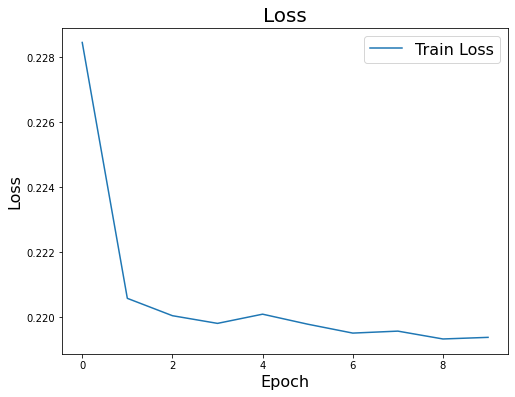

In [26]:
plt.figure(figsize=(8,6))
plt.plot(History.history['loss'], label="Train Loss")
plt.title("Loss", fontsize=20)
plt.xlabel("Epoch", fontsize=16)
plt.ylabel("Loss", fontsize=16)
plt.legend(fontsize=16)
plt.show()

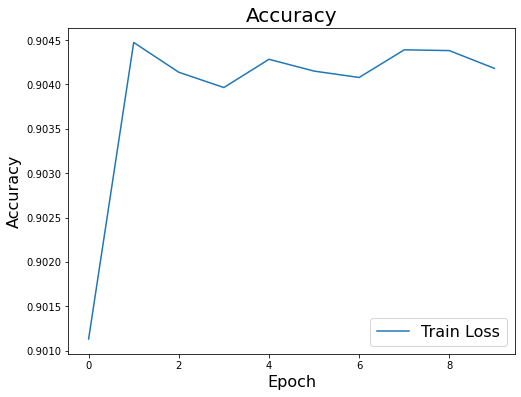

In [27]:
plt.figure(figsize=(8,6))
plt.plot(History.history['accuracy'], label="Train Loss")
plt.title("Accuracy", fontsize=20)
plt.xlabel("Epoch", fontsize=16)
plt.ylabel("Accuracy", fontsize=16)
plt.legend(fontsize=16)
plt.show()

In [40]:
model(train_df.drop('target',axis=1).to_numpy())

<tf.Tensor: shape=(458913, 2), dtype=float32, numpy=
array([[2.0105043e-01, 7.9894960e-01],
       [9.9974686e-01, 2.5319573e-04],
       [9.9966586e-01, 3.3418366e-04],
       ...,
       [9.7704327e-01, 2.2956807e-02],
       [5.1522464e-01, 4.8477536e-01],
       [9.9939239e-01, 6.0760585e-04]], dtype=float32)>

In [48]:
pred = model.predict(train_df.drop('target',axis=1))

14342/14342 [==============================] - 5s 316us/step


In [61]:
a=[]
for i in range(len(pred)):
    a.append(pred[i][1])

In [62]:
a

[0.7989496,
 0.00025319573,
 0.00033418366,
 0.0055368105,
 0.78631413,
 0.928354,
 0.000301272,
 0.0005574256,
 0.00031535391,
 0.9018539,
 0.95696926,
 0.00062189373,
 0.42914838,
 0.004159665,
 0.032387134,
 0.0005597144,
 0.09938531,
 0.0010876651,
 0.012396634,
 0.00029687784,
 0.61101264,
 0.8361828,
 0.9757711,
 0.70438135,
 0.42914838,
 0.0010384945,
 0.4720181,
 0.9631454,
 0.0003353794,
 0.00035132305,
 0.04377076,
 0.004257004,
 0.42914838,
 0.9740268,
 0.97965014,
 0.9587308,
 0.0040102364,
 0.77106416,
 0.008283416,
 0.93863696,
 0.4389426,
 0.7070597,
 0.015731504,
 0.0004339356,
 0.07256348,
 0.0007889794,
 0.8361828,
 0.0012504858,
 0.00042372677,
 0.0004486358,
 0.79363585,
 0.00047365655,
 0.0013943872,
 0.97965014,
 0.563925,
 0.0012974271,
 0.15200888,
 0.9330447,
 0.00038609878,
 0.97965014,
 0.0005480345,
 0.12890565,
 0.0021590209,
 0.02231536,
 0.000258668,
 0.005194868,
 0.7038108,
 0.97826684,
 0.00011454191,
 0.01682258,
 0.9788279,
 0.35508716,
 0.04067561,


In [64]:
train_df

,pred_cat,pred_et,pred_light,pred_rf,pred_xg,pred_cat_lv2,pred_light_lv2,pred_rf_lv2,pred_xg_lv2,target
customer_ID,,,,,,,,,,
05a0a61965bb58ba5bd9ecd821030428b19815ae9eb41fa948b72f00db90eecc,0.641855,0.680755,0.844364,0.812885,0.740397,0.817880,0.790162,0.852429,0.809488,1
6c53bdca2bfe111504cdc430b53cde2322d82745a1bd535bd59be510af66b9aa,0.000592,0.005960,0.000217,0.002201,0.000318,0.001656,0.000737,0.008884,0.000410,0
ca6e87d37c97610085fe109c26825a39634bd614f90f2651fd6119a31b0a7b5f,0.000909,0.011164,0.000572,0.002818,0.000868,0.002270,0.001517,0.009625,0.001172,0
823644b4844c2c4728996a297982c2e80dfb5f2d554db67a467563742eeaba03,0.019719,0.110768,0.006128,0.042437,0.010501,0.008126,0.010424,0.029994,0.008692,0
8190bdee96b0bae22d56166805e7aba9f0c17f8396a1e69ea4b44117fe183aee,0.709153,0.223741,0.800557,0.226124,0.671222,0.785525,0.798872,0.492950,0.821013,1
...,...,...,...,...,...,...,...,...,...,...
87e83b28d831f1b7d90a740b70afafc72ca200816d08e2b87947a9e246067dad,0.458543,0.486927,0.550652,0.583775,0.429267,0.497033,0.443697,0.564339,0.492431,1
76a25f85b8edc6c7b8b323505a83fc41f74e2381fa276a85f252cd89fd75cb1f,0.001520,0.004776,0.000561,0.002209,0.000659,0.002060,0.000850,0.008792,0.000755,0
e693bb0a2d356b3147b2942dc0da064de0cdfdea7d16ad811e41b8175a1157ac,0.061694,0.041578,0.020235,0.109168,0.027742,0.020550,0.034150,0.057137,0.019735,0


# NN

In [73]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))
    
    model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(9,)),
    
    tf.keras.layers.Dense(units=32,activation='relu'),
    tf.keras.layers.Dense(units=64,activation='relu'),
    tf.keras.layers.Dense(units=32,activation='relu'),
    tf.keras.layers.Dense(units=4,activation='relu'),
    
    tf.keras.layers.Dense(units=2,activation='softmax')
    ])
    
    Num_of_Epoch = 50
    Batch_Size = 30
    Learning_Rate = 0.01
    Loss_Function = tf.keras.losses.SparseCategoricalCrossentropy()
    
    Optimizer_Adam = tf.keras.optimizers.Adam(learning_rate = Learning_Rate)
    
    model.compile(optimizer=Optimizer_Adam,loss=Loss_Function, metrics=["accuracy"])
    
    History = model.fit(
    x = X,
    y = y,
    validation_data = (X_val, y_val),
    epochs = Num_of_Epoch,
    batch_size = Batch_Size,
    )
    
    #預測validation
    b=[]
    print('predict vali')
    pred = model.predict(X_val)
    for i in range(len(pred)):
        b.append(pred[i][1])
    preds.append(b)
    
    #預測test
    a=[]
    print('predict test')
    pred_test = model.predict(test_df)
    for i in range(len(pred_test)):
        a.append(pred_test[i][1])
    preds_test.append(a)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_nnt_lv2 = pd.DataFrame({'pred_nn_lv2':pred_train},index=va_indexs)
test_meta_nn_lv2 = pd.DataFrame({'pred_nn_lv2':preds_test},index=test_df.index) 

del model,History


Fold 1
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)

Epoch 1/50
15298/15298 [==============================] - 9s 560us/step - loss: 0.2229 - accuracy: 0.9037 - val_loss: 0.2225 - val_accuracy: 0.9041
Epoch 2/50
15298/15298 [==============================] - 8s 552us/step - loss: 0.2201 - accuracy: 0.9043 - val_loss: 0.2189 - val_accuracy: 0.9032
Epoch 3/50
15298/15298 [==============================] - 9s 558us/step - loss: 0.2196 - accuracy: 0.9044 - val_loss: 0.2194 - val_accuracy: 0.9036
Epoch 4/50
15298/15298 [==============================] - 8s 554us/step - loss: 0.2193 - accuracy: 0.9044 - val_loss: 0.2179 - val_accuracy: 0.9041
Epoch 5/50
15298/15298 [==============================] - 8s 533us/step - loss: 0.2191 - accuracy: 0.9047 - val_loss: 0.2193 - val_accuracy: 0.9043
Epoch 6/50
15298/15298 [==============================] - 8s 536us/step - loss: 0.2190 - accuracy: 0.9046 - val_loss: 0.2222 - val_accuracy: 0.9026
Epoch 7/50
15298/15298 [========

Epoch 4/50
15298/15298 [==============================] - 8s 527us/step - loss: 0.2192 - accuracy: 0.9044 - val_loss: 0.2162 - val_accuracy: 0.9048
Epoch 5/50
15298/15298 [==============================] - 8s 528us/step - loss: 0.2190 - accuracy: 0.9045 - val_loss: 0.2152 - val_accuracy: 0.9050
Epoch 6/50
15298/15298 [==============================] - 8s 544us/step - loss: 0.2192 - accuracy: 0.9044 - val_loss: 0.2145 - val_accuracy: 0.9052
Epoch 7/50
15298/15298 [==============================] - 8s 547us/step - loss: 0.2190 - accuracy: 0.9044 - val_loss: 0.2169 - val_accuracy: 0.9054
Epoch 8/50
15298/15298 [==============================] - 8s 545us/step - loss: 0.2189 - accuracy: 0.9045 - val_loss: 0.2138 - val_accuracy: 0.9041
Epoch 9/50
15298/15298 [==============================] - 8s 546us/step - loss: 0.2191 - accuracy: 0.9044 - val_loss: 0.2144 - val_accuracy: 0.9050
Epoch 10/50
15298/15298 [==============================] - 8s 542us/step - loss: 0.2190 - accuracy: 0.9045 - val

15298/15298 [==============================] - 13s 834us/step - loss: 0.2196 - accuracy: 0.9043 - val_loss: 0.2224 - val_accuracy: 0.9038
Epoch 11/50
15298/15298 [==============================] - 13s 861us/step - loss: 0.2194 - accuracy: 0.9042 - val_loss: 0.2158 - val_accuracy: 0.9051
Epoch 12/50
15298/15298 [==============================] - 13s 863us/step - loss: 0.2195 - accuracy: 0.9042 - val_loss: 0.2202 - val_accuracy: 0.9042
Epoch 13/50
15298/15298 [==============================] - 13s 880us/step - loss: 0.2195 - accuracy: 0.9042 - val_loss: 0.2157 - val_accuracy: 0.9052
Epoch 14/50
15298/15298 [==============================] - 13s 864us/step - loss: 0.2195 - accuracy: 0.9046 - val_loss: 0.2174 - val_accuracy: 0.9052
Epoch 15/50
15298/15298 [==============================] - 13s 842us/step - loss: 0.2194 - accuracy: 0.9044 - val_loss: 0.2220 - val_accuracy: 0.9055
Epoch 16/50
15298/15298 [==============================] - 13s 855us/step - loss: 0.2192 - accuracy: 0.9044 - va

15298/15298 [==============================] - 14s 899us/step - loss: 0.2192 - accuracy: 0.9045 - val_loss: 0.2200 - val_accuracy: 0.9037
Epoch 17/50
15298/15298 [==============================] - 14s 909us/step - loss: 0.2195 - accuracy: 0.9046 - val_loss: 0.2208 - val_accuracy: 0.9037
Epoch 18/50
15298/15298 [==============================] - 14s 931us/step - loss: 0.2194 - accuracy: 0.9045 - val_loss: 0.2191 - val_accuracy: 0.9034
Epoch 19/50
15298/15298 [==============================] - 14s 920us/step - loss: 0.2195 - accuracy: 0.9045 - val_loss: 0.2291 - val_accuracy: 0.9030
Epoch 20/50
15298/15298 [==============================] - 14s 894us/step - loss: 0.2197 - accuracy: 0.9044 - val_loss: 0.2242 - val_accuracy: 0.9028
Epoch 21/50
15298/15298 [==============================] - 14s 888us/step - loss: 0.2194 - accuracy: 0.9045 - val_loss: 0.2189 - val_accuracy: 0.9039
Epoch 22/50
15298/15298 [==============================] - 14s 914us/step - loss: 0.2193 - accuracy: 0.9043 - va

15298/15298 [==============================] - 8s 526us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5720 - val_accuracy: 0.7411
Epoch 23/50
15298/15298 [==============================] - 8s 543us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5720 - val_accuracy: 0.7411
Epoch 24/50
15298/15298 [==============================] - 8s 546us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5720 - val_accuracy: 0.7411
Epoch 25/50
15298/15298 [==============================] - 8s 542us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5720 - val_accuracy: 0.7411
Epoch 26/50
15298/15298 [==============================] - 8s 545us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5723 - val_accuracy: 0.7411
Epoch 27/50
15298/15298 [==============================] - 8s 543us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss: 0.5723 - val_accuracy: 0.7411
Epoch 28/50
15298/15298 [==============================] - 8s 524us/step - loss: 0.5723 - accuracy: 0.7411 - val_loss:

15298/15298 [==============================] - 14s 937us/step - loss: 0.2195 - accuracy: 0.9045 - val_loss: 0.2168 - val_accuracy: 0.9079
Epoch 29/50
15298/15298 [==============================] - 12s 805us/step - loss: 0.2195 - accuracy: 0.9041 - val_loss: 0.2137 - val_accuracy: 0.9080
Epoch 30/50
15298/15298 [==============================] - 14s 888us/step - loss: 0.2193 - accuracy: 0.9045 - val_loss: 0.2163 - val_accuracy: 0.9077
Epoch 31/50
15298/15298 [==============================] - 13s 855us/step - loss: 0.2200 - accuracy: 0.9039 - val_loss: 0.2139 - val_accuracy: 0.9080
Epoch 32/50
15298/15298 [==============================] - 14s 896us/step - loss: 0.2195 - accuracy: 0.9043 - val_loss: 0.2145 - val_accuracy: 0.9078
Epoch 33/50
15298/15298 [==============================] - 12s 817us/step - loss: 0.2200 - accuracy: 0.9038 - val_loss: 0.2152 - val_accuracy: 0.9061
Epoch 34/50
15298/15298 [==============================] - 12s 814us/step - loss: 0.2205 - accuracy: 0.9037 - va

In [74]:
test_meta_nn_lv2

,pred_nn_lv2
customer_ID,
00000469ba478561f23a92a868bd366de6f6527a684c9a2e78fb826dcac3b9b7,0.053312
00001bf2e77ff879fab36aa4fac689b9ba411dae63ae397d4263dafa1daedef5,0.029544
0000210045da4f81e5f122c6bde5c2a617d03eef67f82c5e400fc98e7bd43ce8,0.064368
00003b41e58ede33b8daf61ab56d9952f17c9ad1c3976cf6e56734528702d694,0.210890
00004b22eaeeeb0ec976890c1d9bfc14fd9427e98c4ee9a4693dd914fca22557,0.798566
...,...
ffff952c631f2c911b8a2a8ca56ea6e656309a83d2f64c5d60460dba6dedc41e,0.039956
ffffcf5df59e5e0bba2a5ac4578a34e2b5aa64a1546cd3a4f0ca3de613b0b2ad,0.750455
ffffd61f098cc056dbd7d2a21380c4804bbfe60856f475cb095d2443a68030f1,0.427331


In [76]:
train_meta_nnt_lv2.to_parquet('train_meta_nnt.parquet')
test_meta_nn_lv2.to_parquet('test_meta_nn.parquet')

# Kmean

In [13]:
X=train_df.drop('target',axis=1)
y=train_df['target']
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,10) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(X) 
    kmeanModel.fit(X)     
      
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / X.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / X.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 

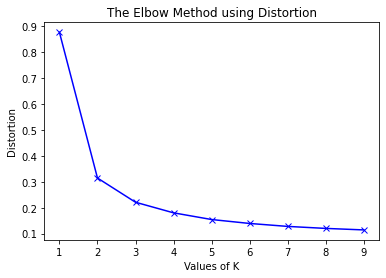

In [14]:
plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

In [15]:
for key, val in mapping2.items():
    print(f'{key} : {val}')

1 : 453592.5187768491
2 : 70157.25535093229
3 : 34279.56323392907
4 : 22675.153872664967
5 : 16998.723992199404
6 : 13933.645897954524
7 : 12053.849523158047
8 : 10752.115893543341
9 : 9934.433446120132


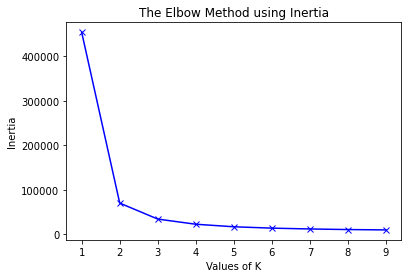

In [16]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

In [17]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))
    
    kmeans = KMeans(n_clusters=2,n_jobs=-1)
    kmeans.fit(X_train)
    
    
    #預測validation
    pred = kmeans.predict(X_val)  
    preds.append(pred)
    
    #預測test
    pred_test = kmeans.predict(test_df)
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_kmean_2 = pd.DataFrame({'predict_kmean_2':pred_train},index=va_indexs)
test_meta_kmean_2 = pd.DataFrame({'predict_kmean_2':preds_test},index=test_df.index) 

del kmeans


Fold 1
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 2
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 3
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 4
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 5
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 6
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 7
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 8
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 9
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 10
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)



In [20]:
train_meta_kmean_2.to_parquet('train_meta_kmean_2.parquet')
test_meta_kmean_2.to_parquet('test_meta_kmean_2.parquet')

In [21]:
X=train_df.drop('target',axis=1)
y=train_df['target']
for_vali = train_df.reset_index()[['customer_ID']]
preds, preds_test,va_indexs = [],[],[]

sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):
    
    print("\nFold {}".format(fold+1))
    X_train, y_train = X.iloc[train_idx,:], y[train_idx]
    X_val, y_val = X.iloc[val_idx,:], y[val_idx]
    print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
        X_train.shape, y_train.shape, X_val.shape, y_val.shape))
    
    kmeans = KMeans(n_clusters=3,n_jobs=-1)
    kmeans.fit(X_train)
    
    
    #預測validation
    pred = kmeans.predict(X_val)  
    preds.append(pred)
    
    #預測test
    pred_test = kmeans.predict(test_df)
    preds_test.append(pred_test)
    
    #紀錄validation的index
    val_idx_costu = for_vali.iloc[val_idx,0]
    va_indexs.append(val_idx_costu)
    
    del X_train, y_train, X_val, y_val
    _ = gc.collect()

del X, y
    
#將validation整合起來並排序
va_indexs = np.concatenate(va_indexs,axis=0)
pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
preds_test = np.mean(preds_test,axis=0) #預測test資料的值

train_meta_kmean_3 = pd.DataFrame({'predict_kmean_3':pred_train},index=va_indexs)
test_meta_kmean_3 = pd.DataFrame({'predict_kmean_3':preds_test},index=test_df.index) 

del kmeans


Fold 1
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 2
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 3
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 4
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 5
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 6
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 7
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 8
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 9
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 10
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)



In [22]:
train_meta_kmean_3.to_parquet('train_meta_kmean_3.parquet')
test_meta_kmean_3.to_parquet('test_meta_kmean_3.parquet')

# KNN

In [100]:
numbers = [2,4,8,16,32,64,128,256,512,1024]
for nub in numbers:
    X=train_df.drop('target',axis=1)
    y=train_df['target']
    for_vali = train_df.reset_index()[['customer_ID']]
    preds, preds_test,va_indexs = [],[],[]

    sk_fold = StratifiedKFold(n_splits=10, shuffle=True, random_state=21)

    for fold, (train_idx, val_idx) in enumerate(sk_fold.split(X, y)):

        print("\nFold {}".format(fold+1))
        X_train, y_train = X.iloc[train_idx,:], y[train_idx]
        X_val, y_val = X.iloc[val_idx,:], y[val_idx]
        print("Train shape: {}, {}, Valid shape: {}, {}\n".format(
            X_train.shape, y_train.shape, X_val.shape, y_val.shape))

        knns = KNeighborsClassifier(n_neighbors=nub,n_jobs=-1)
        knns.fit(X_train,y_train)


        #預測validation
        pred = knns.predict_proba(X_val)[:,1]
        preds.append(pred)

        #預測test
        pred_test = knns.predict_proba(test_df)[:,1]
        preds_test.append(pred_test)

        #紀錄validation的index
        val_idx_costu = for_vali.iloc[val_idx,0]
        va_indexs.append(val_idx_costu)

        del X_train, y_train, X_val, y_val
        _ = gc.collect()

    del X, y

    #將validation整合起來並排序
    va_indexs = np.concatenate(va_indexs,axis=0)
    pred_train = np.concatenate(preds,axis=0)#預測validation資料的值
    preds_test = np.mean(preds_test,axis=0) #預測test資料的值

    train_meta_kmean_3 = pd.DataFrame({f'predict_knn_{nub}':pred_train},index=va_indexs)
    test_meta_kmean_3 = pd.DataFrame({f'predict_knn_{nub}':preds_test},index=test_df.index) 

    train_meta_kmean_3.to_parquet(f'train_meta_knn_{nub}.parquet')
    test_meta_kmean_3.to_parquet(f'test_meta_knn_{nub}.parquet')
    print(f'{nub} is done')

    del knns,train_meta_kmean_3,test_meta_kmean_3



Fold 1
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 2
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 3
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 4
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 5
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 6
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 7
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 8
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 9
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)


Fold 10
Train shape: (413022, 9), (413022,), Valid shape: (45891, 9), (45891,)

2is done

Fold 1
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 2
Train shape: (413021, 9), (413021,), Valid shape: (45892, 9), (45892,)


Fold 3
Train shape: (413021, 